---
title: Analysis with mixOmics
format:
    confluence-html:
        code-fold: true
---

[mixOmics](https://journals.plos.org/ploscompbiol/article?id=10.1371/journal.pcbi.1005752) is a software package for multivariate data analysis. It is specifically designed for exploratory analyses and visualization and can implement several statistical methods. One of those methods is 'sparse partial least squares distriminant analysis' (sPLS-DA) which identifies features that best separate the samples in a study. 

In [1]:
library(mixOmics)
library(vegan)
library(arrow)
library(tibble)
library(stringr)
library(dplyr)

Loading required package: MASS

Loading required package: lattice

Loading required package: ggplot2


Loaded mixOmics 6.22.0
Thank you for using mixOmics!
Tutorials: http://mixomics.org
Bookdown vignette: https://mixomicsteam.github.io/Bookdown
Questions, issues: Follow the prompts at http://mixomics.org/contact-us
Cite us:  citation('mixOmics')


Loading required package: permute

This is vegan 2.6-4


Attaching package: ‘arrow’


The following object is masked from ‘package:utils’:

    timestamp



Attaching package: ‘dplyr’


The following object is masked from ‘package:MASS’:

    select


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




## Functions and parameters

In [2]:
#set.seed(5249)
cpus <- 10
folds <- 10
F0.folds <- 3
F1.folds <- 3
F2.folds <- 3
nrepeat <- 50
#load("mixomics.Rdata")

In [3]:
save_model_data <- function(m, name) {
    f <- paste0("../atlas/stats/mixOmics/", name, ".sample_variates.tsv")
    data <- as.data.frame(m$variates$X)
    data$Sample <- rownames(data)
    write.table(file = f, sep="\t", data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], 
                quote = FALSE, row.names = FALSE)
    for (comp in c(2:m$ncomp)) {
        f <- paste0("../atlas/stats/mixOmics/", name, ".variable_corr.", "comp1.vs.comp", comp, ".tsv")
        data <- as.data.frame(plotVar(m, plot = FALSE, comp = c(1, comp)))[, c("names", "x", "y")]
        colnames(data) <- c("names", "comp1", paste0("comp", comp))
        write.table(file = f, data, sep="\t", quote = FALSE, row.names = FALSE)
    }
}

save_model_stability <- function (p, name) {
    f <- paste0("../atlas/stats/mixOmics/", name, ".stability.tsv")
    data <- data.frame(unlist(p$features$stable))
    colnames(data) <- c("Stability")
    features <- gsub("comp\\d\\.", "", rownames(data))
    comps <- str_split_fixed(rownames(data), "\\.", 2)[,1]
    data$feature <- features
    data$comp <- comps
    data <- data[, c("comp", "feature","Stability")]
    write.table(file = f, x = data, quote = FALSE, sep = "\t", row.names = FALSE)
}

low.count.removal <- function(
                        data, # feature count df of size n (sample) x p (feature)
                        percent=0.01 # cutoff chosen
                        ) 
  {
    keep.feat = which(colSums(data)*100/(sum(colSums(data))) > percent)
    data.filter = data[,keep.feat]
    return(list(data.filter = data.filter, keep.feat = keep.feat))
}

## Read the data

In [4]:
mag <- list()
mag_data <- as.matrix(
    column_to_rownames(
        read_parquet("../atlas/genomes/counts//median_coverage_genomes.parquet"), 
        var="index")
    )
mag$cov <- mag_data

In [5]:
mag_genus <- read.csv("../atlas/genomes/counts/genus.coverage.tsv", sep = "\t", header = TRUE, row.names = 1)
colnames(mag_genus) <- gsub(".t.r", "-t.r", colnames(mag_genus))
mag$cov_genus <- t(mag_genus)

In [6]:
mag_tax = read.table("../atlas/genomes/taxonomy/gtdb_taxonomy.tsv", sep = "\t", header = TRUE, row.names = 1)

In [7]:
pfam <- list()
pfam_data <- read.csv("../atlas/Genecatalog/counts/PFAMs.median_coverage.tsv", sep = "\t", header = TRUE, row.names=1)
colnames(pfam_data) <- gsub(".t.r", "-t.r", colnames(pfam_data))
pfam$cov <- t(pfam_data)

In [8]:
ko <- list()
ko_data <- read.csv("../atlas/Genecatalog/counts/KO.median_coverage.tsv", sep = "\t", header = TRUE, row.names=1)
colnames(ko_data) <- gsub(".t.r", "-t.r", colnames(ko_data))
ko$cov <- t(ko_data)

In [9]:
cazy <- list()
cazy_data <- read.csv("../atlas/Genecatalog/counts/CAZy.median_coverage.tsv", sep = "\t", header = TRUE, row.names=1)
colnames(cazy_data) <- gsub(".t.r", "-t.r", colnames(cazy_data))
cazy$cov <- t(cazy_data)

In [10]:
uniref <- list()
uniref_data <- read.csv("../atlas/taxonomy//UniRef100.median_fold.species.tsv", sep = "\t", header = TRUE, row.names = 1)
uniref_taxonomy <- read.csv("../atlas/taxonomy/UniRef100.median_fold.tsv", sep="\t", header = TRUE)
colnames(uniref_data) <- gsub(".t.r", "-t.r", colnames(uniref_data))
# Remove unclassified and unknown
uc <- rownames(uniref_data)[grep("^uc_", rownames(uniref_data))]
# Remove uncultured
unc <- rownames(uniref_data)[grep("^uncultured", rownames(uniref_data))]
# Remove species with unknown phylum
unk <- uniref_taxonomy[uniref_taxonomy$phylum=="unknown","species"]
uniref_data_filt <- uniref_data[!c(rownames(uniref_data)%in%c(unc, unk, uc)),]
uniref_data_filt <- uniref_data_filt[!c(rownames(uniref_data_filt)%in%c("unknown")), ]
# Keep species with proper name
keep <- grep("^[A-Z][a-z]+ ", rownames(uniref_data_filt))
uniref_data_filt <- uniref_data_filt[keep,]
uniref$cov <- t(uniref_data_filt)

In [11]:
uniref.genus <- list()
uniref_genus_data <- read.csv("../atlas/taxonomy//UniRef100.median_fold.genus.tsv", sep="\t", header = TRUE, row.names = 1)
colnames(uniref_genus_data) <- gsub(".t.r", "-t.r", colnames(uniref_genus_data))
# Remove unclassified and unknown
uc <- rownames(uniref_genus_data)[grep("^uc_", rownames(uniref_genus_data))]
# Remove uncultured
unc <- rownames(uniref_genus_data)[grep("^uncultured", rownames(uniref_genus_data))]
# Remove genera with unknown phylum
unk <- uniref_taxonomy[uniref_taxonomy$phylum=="unknown","genus"]
uniref_genus_filt <- uniref_genus_data[!c(rownames(uniref_genus_data)%in%c(unc, unk, uc)),]
uniref_genus_filt <- uniref_genus_filt[!c(rownames(uniref_genus_filt)%in%c("unknown")), ]
uniref.genus$cov <- t(uniref_genus_filt)

In [12]:
rgi <- list()
rgi_data <- read.csv("../atlas/Genecatalog/counts/rgi.best_hit_aro.median_coverage.tsv", sep="\t", header = TRUE, row.names = 1)
colnames(rgi_data) <- gsub(".t.r", "-t.r", colnames(rgi_data))
rgi$cov <- t(rgi_data)

For samples with technical replicates, replicates to use are chosen based on assembly metrics, i.e. the technical replicate with the highest L50 value is chosen. If there is a tie, then the one with highest total QC:d reads is chosen.

From the [statistical-analyses.ipynb](statistical-analyses.ipynb) notebook we know that we should remove C11-t.r, C12, C19-t.r, H10, H13-t.r, H32, L11-t.r, L29 and L6.

In [13]:
drop_reps <- c("C11-t.r", "C12", "C19-t.r", "H10", "H13-t.r", "H32", "L11-t.r", "L29", "L6")
mag$cov <- mag$cov[!c(rownames(mag$cov)%in%drop_reps),]
pfam$cov <- pfam$cov[!c(rownames(pfam$cov)%in%drop_reps),]
ko$cov <- ko$cov[!c(rownames(ko$cov)%in%drop_reps),]
rgi$cov <- rgi$cov[!c(rownames(rgi$cov)%in%drop_reps),]
cazy$cov <- cazy$cov[!c(rownames(cazy$cov)%in%drop_reps),]
uniref$cov <- uniref$cov[!c(rownames(uniref$cov)%in%drop_reps),]
uniref.genus$cov <- uniref.genus$cov[!c(rownames(uniref.genus$cov)%in%drop_reps),]

In [14]:
cbind(dim(mag$cov),
dim(pfam$cov),
dim(ko$cov),
dim(rgi$cov),
dim(cazy$cov),
dim(uniref$cov),
dim(uniref.genus$cov))

96,96,96,96,96,96,96
262,7363,5926,73,89,4060,1396


In [15]:
# Make all dataframes line up
samples <- rownames(mag$cov)
mag$cov <- mag$cov[samples, ]
pfam$cov <- pfam$cov[samples, ]
ko$cov <- ko$cov[samples, ]
rgi$cov <- rgi$cov[samples, ]
cazy$cov <- cazy$cov[samples, ]
uniref$cov <- uniref$cov[samples, ]
uniref.genus$cov <- uniref.genus$cov[samples, ]

In [16]:
# Read sample info and set up the relevant columns
info <- read.csv("../data/sample_groups.csv", header=T, row.names = 1)
info[c("Generation","Treatment")] <- str_split_fixed(info$group, "_", 2)
info <- info[samples, ]

mag$generation <- factor(info[rownames(mag$cov),"Generation"])
mag$treatment <- factor(info[rownames(mag$cov),"Treatment"])

pfam$generation <- factor(info[rownames(pfam$cov),"Generation"])
pfam$treatment <- factor(info[rownames(pfam$cov),"Treatment"])

ko$generation <- factor(info[rownames(ko$cov),"Generation"])
ko$treatment <- factor(info[rownames(ko$cov),"Treatment"])

rgi$generation <- factor(info[rownames(rgi$cov), "Generation"])
rgi$treatment <- factor(info[rownames(rgi$cov), "Treatment"])

cazy$generation <- factor(info[rownames(cazy$cov),"Generation"])
cazy$treatment <- factor(info[rownames(cazy$cov),"Treatment"])

uniref$generation <- factor(info[rownames(uniref$cov),"Generation"])
uniref$treatment <- factor(info[rownames(uniref$cov),"Treatment"])

uniref.genus$generation <- factor(info[rownames(uniref.genus$cov),"Generation"])
uniref.genus$treatment <- factor(info[rownames(uniref.genus$cov),"Treatment"])

In [17]:
cbind(summary(mag$generation),
summary(pfam$generation),
summary(ko$generation),
summary(cazy$generation),
summary(rgi$generation),
summary(uniref$generation),
summary(uniref.genus$generation))

F0,31,31,31,31,31,31,31
F1,19,19,19,19,19,19,19
F2,46,46,46,46,46,46,46


In [18]:
cbind(summary(mag$treatment),
summary(pfam$treatment),
summary(ko$treatment),
summary(cazy$treatment),
summary(rgi$treatment),
summary(uniref$treatment),
summary(uniref.genus$treatment))

C,33,33,33,33,33,33,33
H,33,33,33,33,33,33,33
L,30,30,30,30,30,30,30


Set the factors

In [19]:
Y.treatment <- info$Treatment
Y.generation <- info$Generation

## alpha diversity

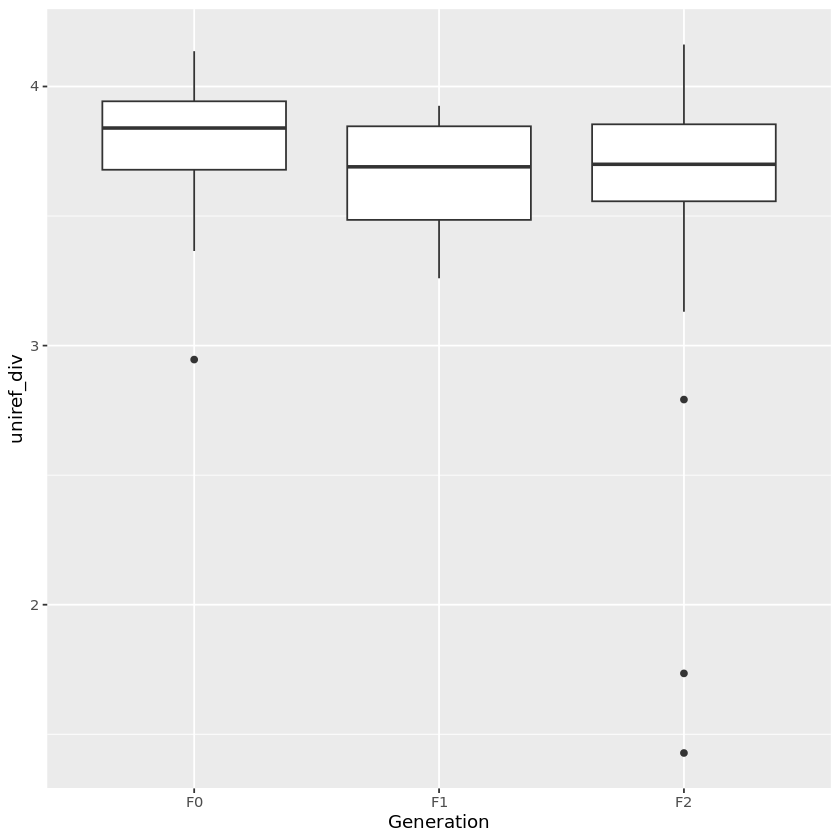

In [20]:
uniref_div <- diversity(uniref$cov)
uniref_genus_div <- diversity(uniref.genus$cov)
mag_div <- diversity(mag$cov)
div_mat <- data.frame(cbind(uniref_div, uniref_genus_div, mag_div))
div_mat$Generation <- info[rownames(div_mat), "Generation"]
ggplot(div_mat, aes(x = Generation, y = uniref_div)) + geom_boxplot()

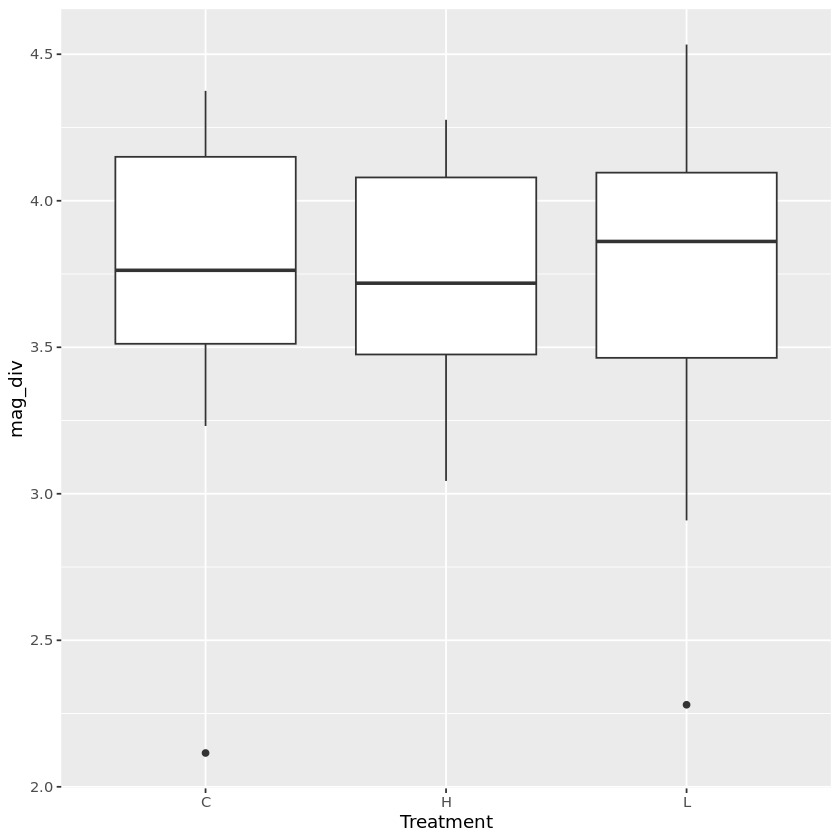

In [21]:
uniref_div <- diversity(uniref$cov)
uniref_genus_div <- diversity(uniref.genus$cov)
mag_div <- diversity(mag$cov)
div_mat <- data.frame(cbind(uniref_div, uniref_genus_div, mag_div))
div_mat$Treatment <- info[rownames(div_mat), "Treatment"]
ggplot(div_mat, aes(x = Treatment, y = mag_div)) + geom_boxplot()

## sparse Partial Least Squares Discriminant Analysis (sPLS-DA)

Below we perform supervised analysis of the samples using MAG abundances and coverage values for UniRef taxa (genus and species level), PFAMs, Kegg orthologs and CAZys. For each dataset we will attempt to find the features that best discriminate between the treatment groups. Because of the large generational differences we run the analysis for each generation, however we also generate a model to find differences between generations in order to get a feeling for how the method performs when there are obvious differences in the data. 

This is a supervised method where first an initial model is generated followed by tuning of the numbers of components and features used. With the final, tuned, model both samples and features can be visualized.

For each dataset the data is prefiltered by summing features across samples and calculating a percentage of each feature in the entire dataset, then removing features that have below a threshold of total percentages. In most cases this threshold is set to the 10% quantile of summed percentages. This is followed by removing features that only occurr in a very limited number of samples (using the `nearZeroVar` function).

As we will see, the method shows a clear signal when attempting to find generational differences (indicated by the low error rate of the model) but that the signal is much weaker when the method is applied within each generation to find differences between treatment groups.

First the number of optimal components is calculated using the `perf()` function, then the number of features (_e.g._ MAGs, PFAMs etc.) per component is computed iteratively using the `tune.splsda()` function which shows the classification error rate averaged across folds and repeats. Not all values of features is tested for each component, instead a sequence of values is set up in 10% incremental steps. For example, if there are a total of 200 features (after filtering low abundance features), optimal values are selected from a sequence between 20 - 200 with a step size of 20.

The `stability` of a given feature is defined as the proportion of cross validation folds (across repeats) where it was selected for to be used for a given component. Features with higher stability values are likely more "important" for the model.

### MAGs

#### MAGs - Generational differences

[1] "30"           "MAGs removed" "232"          "remaining"

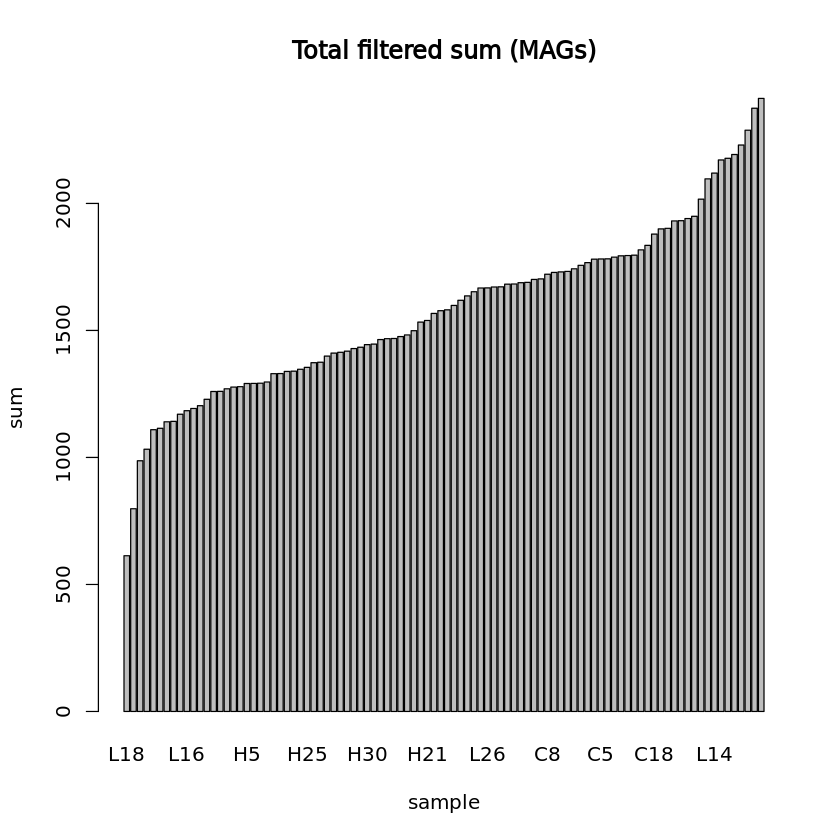

In [32]:
## PARAMS ##
# Initial components
mag.ncomp <- 10
# Percentage of samples in which features must have >0 sum
mag.percent_occ <- 10
# Quantile used for removing low abundance features
mag.quantile_thresh <- 0.1

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(mag$cov[, colSums(mag$cov) > 0])
mag$nz <- mag$cov[, colnames(mag$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(mag$nz) / sum(colSums(mag$nz)) * 100, probs = mag.quantile_thresh)
mag$filtered <- low.count.removal(mag$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
mag$occ <- colSums(mag$filtered>0) / nrow(mag$filtered) * 100
# Keep features occurring in defined percentage of samples
mag$filtered <- mag$filtered[, which(mag$occ >= mag.percent_occ)]

#mag$filtered <- mag$filtered[,-nearZeroVar(mag$filtered, uniqueCut = 5, freqCut = 5)$Position]
paste0(c(dim(mag$cov)[2] - dim(mag$filtered)[2], "MAGs removed", dim(mag$filtered)[2], "remaining"))

# Add offset
mag$offset <- mag$filtered + 1
mag$clr <- logratio.transfo(mag$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.mag <- mag$clr

mag$generation <- factor(info[rownames(mag$clr), "Generation"])
mag$group <- factor(info[rownames(mag$clr), "group"])

mag.lib.size <- apply(mag$filtered, 1, sum) # determine total count for each sample
barplot(sort(mag.lib.size), main="Total filtered sum (MAGs)", ylab="sum", xlab="sample")

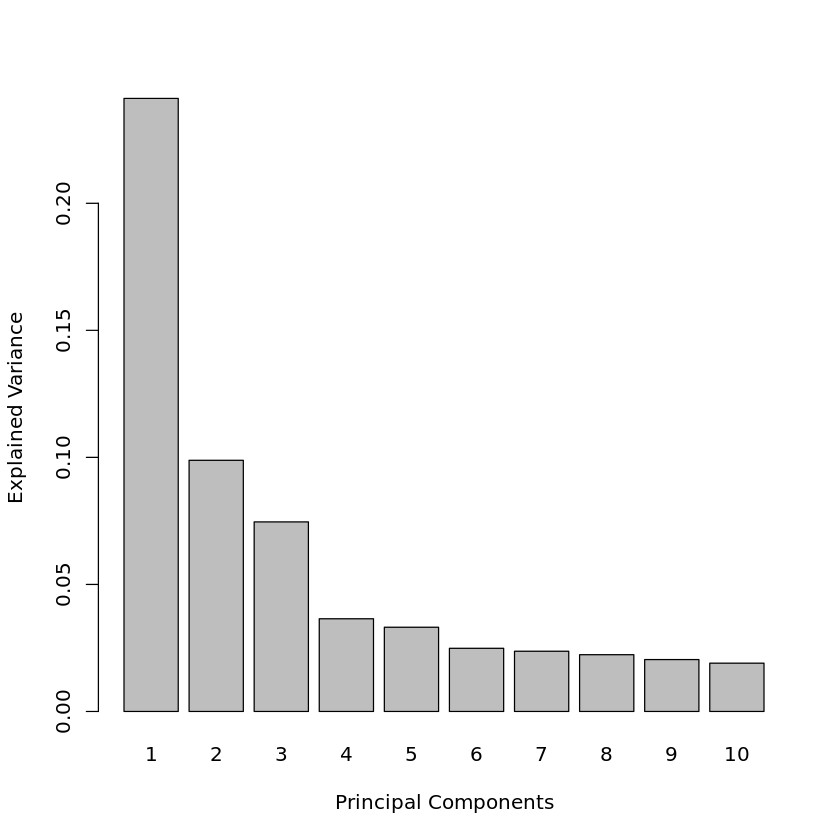

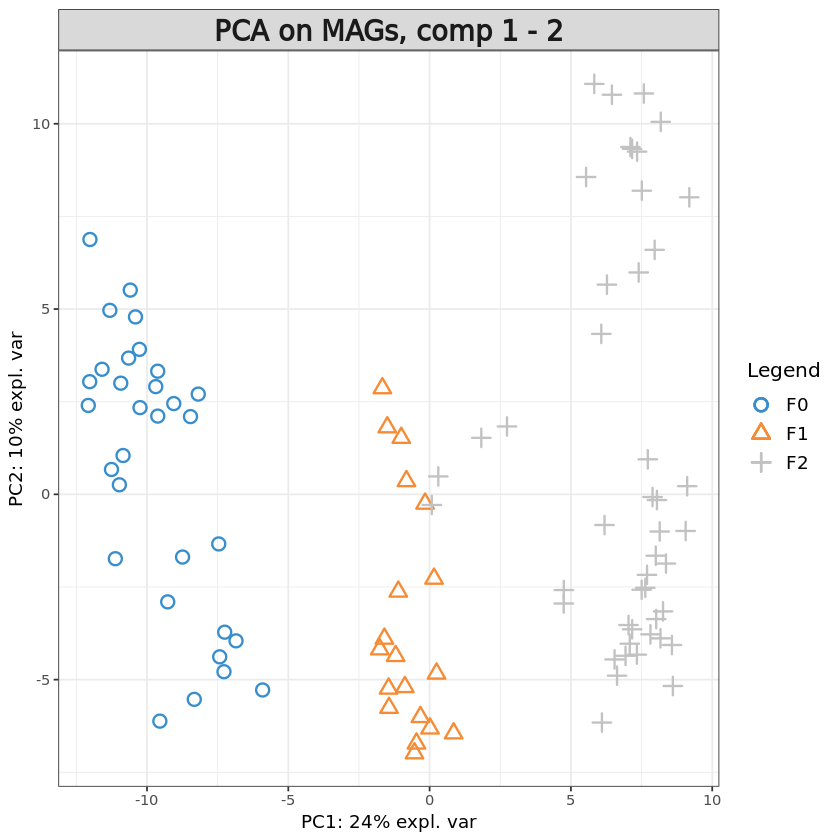

In [33]:
pca.mag = pca(X.mag, ncomp = mag.ncomp, center = TRUE, scale = TRUE) 

plot(pca.mag)
plotIndiv(pca.mag, group = mag$generation, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on MAGs, comp 1 - 2')

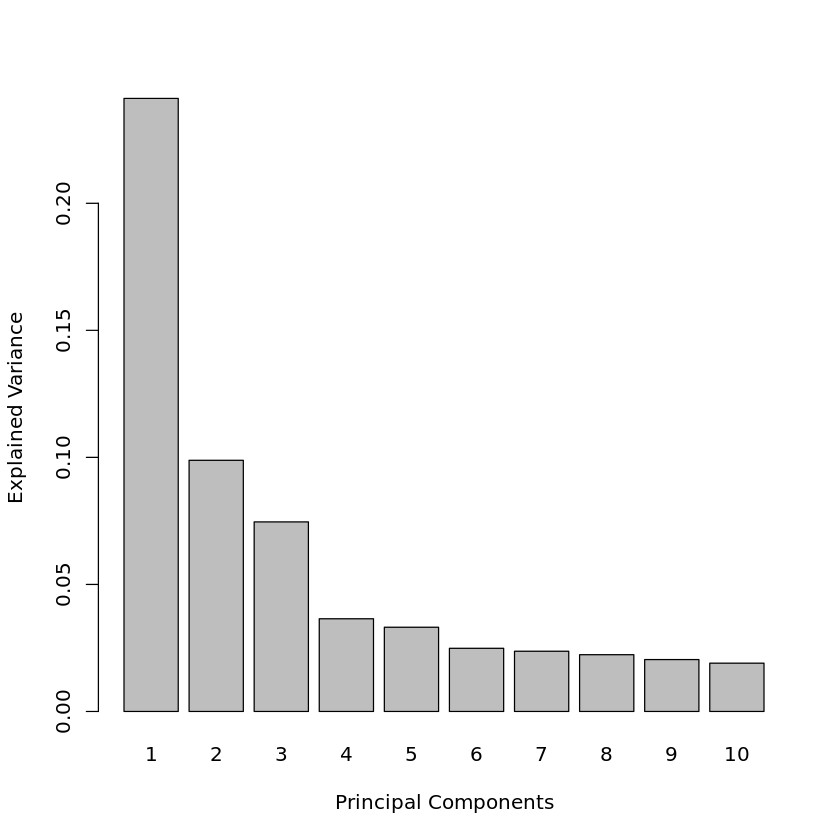

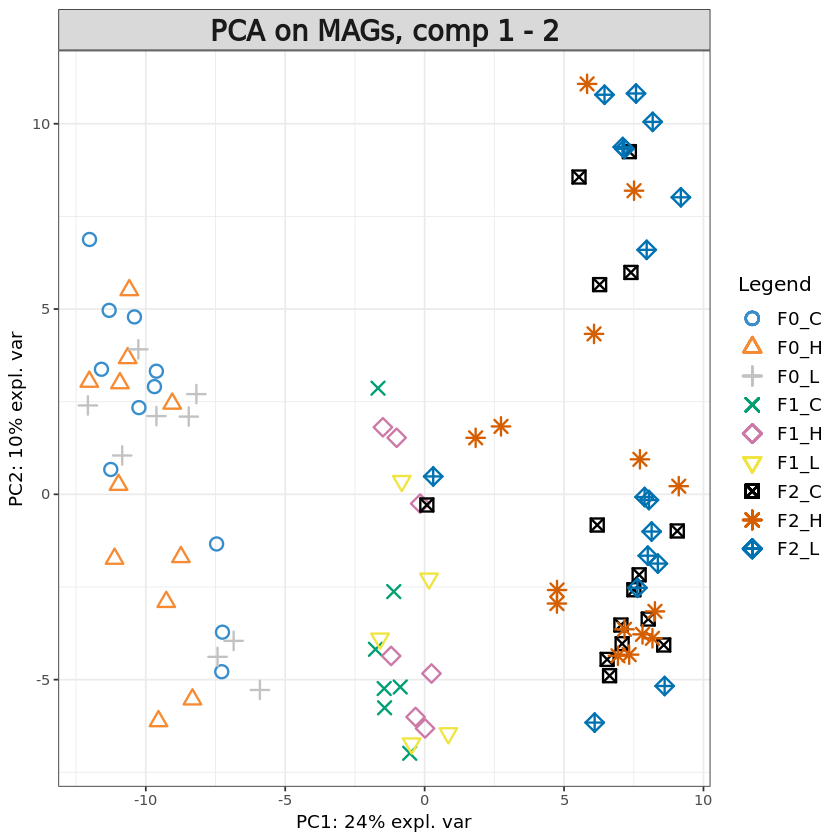

In [34]:
pca.mag.co = pca(X.mag, ncomp = mag.ncomp, center = TRUE, scale = TRUE) 

plot(pca.mag.co)
plotIndiv(pca.mag.co, group = mag$group, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on MAGs, comp 1 - 2')

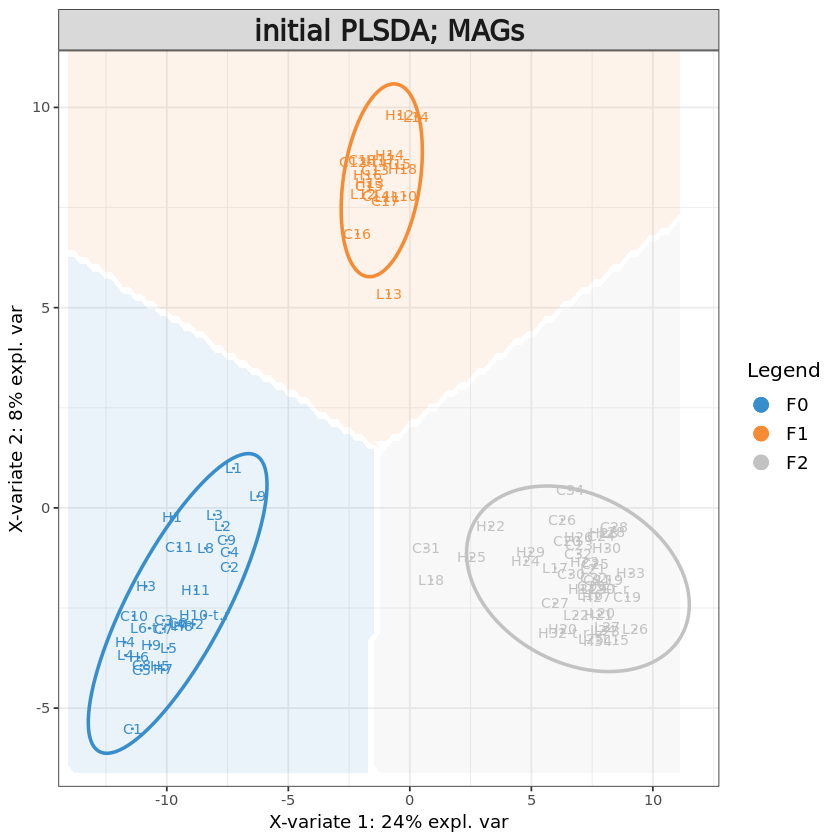

In [35]:
# Initial sPLS-DA model
mag.splsda <- splsda(X.mag, mag$generation, ncomp = mag.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(mag.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(mag.splsda, comp = 1:2, ellipse = TRUE,
          group = mag$generation, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; MAGs")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,2,2,2
BER,2,2,2


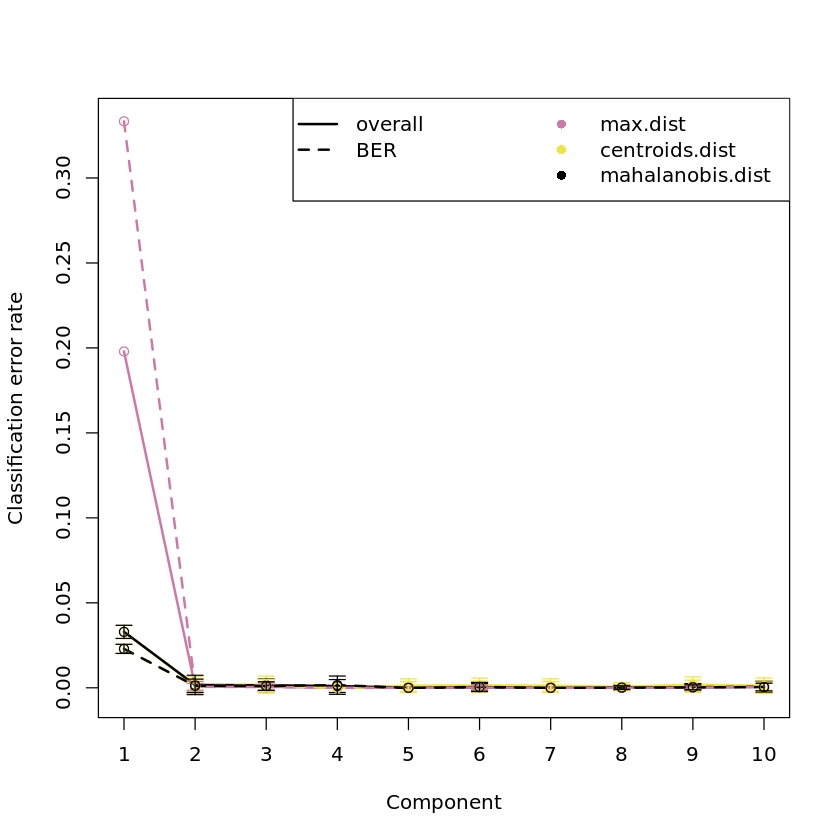

In [28]:
# print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.mag <- perf(mag.splsda, validation = "Mfold", 
                          folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.mag, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.mag$choice.ncomp # what is the optimal value of components according to perf()

The tuning step indicates that only two components are needed to characterize the samples.

In [29]:
# Define parameters for tuning keepX
mag.step <- 0.1
mag.ncomp.tune <- 2
# grid of possible keepX values that will be tested for each component
mag.keepx <- c(10, 20, seq(ceiling(dim(mag$filtered)[2] * mag.step), 
                      round(dim(mag$filtered)[2], digits = -1), 
                      ceiling(dim(mag$filtered)[2] * mag.step)
                     )
                 )
mag.keepx

[1]  10  20  24  48  72  96 120 144 168 192 216

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


[1] 2

comp1 comp2 
   20    20

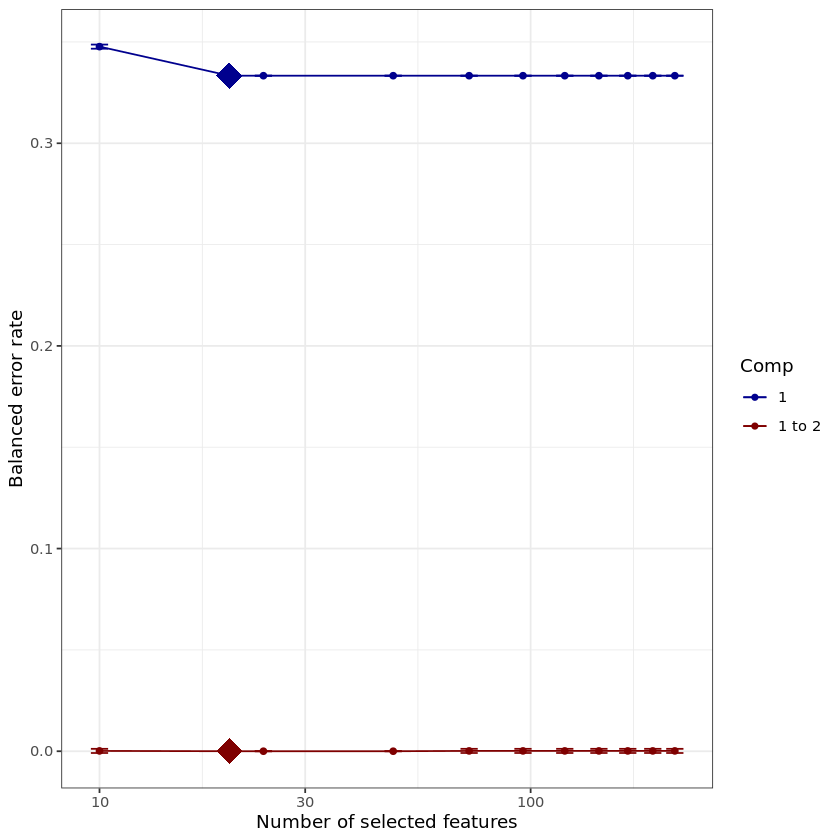

In [30]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.mag <- tune.splsda(X.mag, mag$generation, ncomp = mag.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = mag.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.mag, col = color.jet(mag.ncomp.tune))

tune.splsda.mag$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.mag$choice.keepX # what are the optimal values of variables according to tune.splsda()

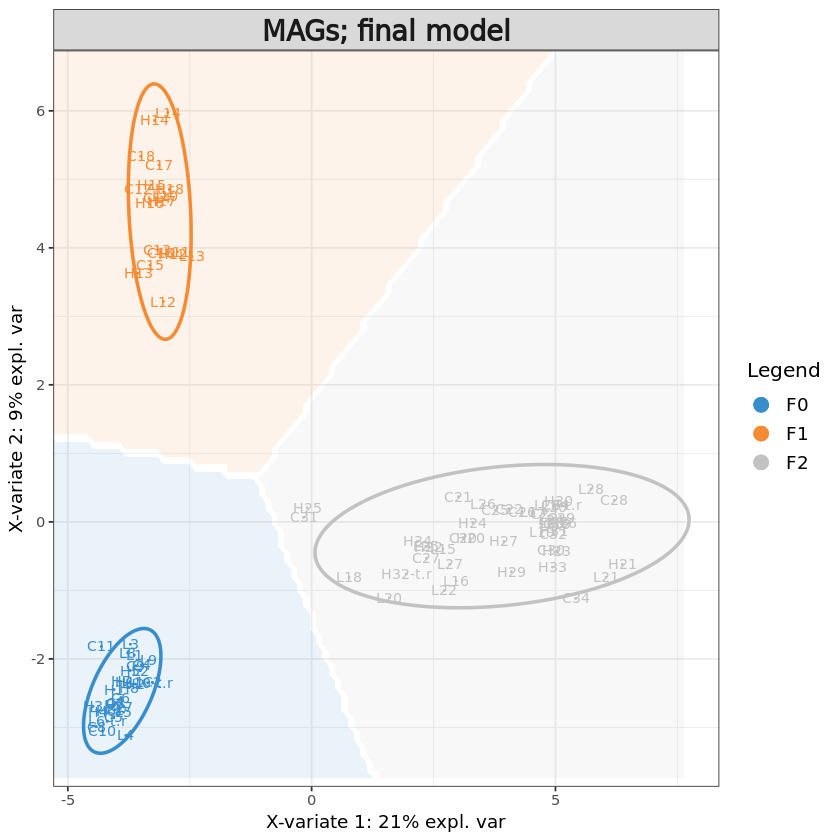

In [36]:
# Define final model
mag$optimal.ncomp <- 2
#mag$optimal.keepX <- tune.splsda.mag$choice.keepX
mag$optimal.keepX <- c(20,20)

# form final model with optimised values for component, using all features
final.splsda.mag <- splsda(X.mag, mag$generation, 
                       ncomp = mag$optimal.ncomp, 
                       keepX = mag$optimal.keepX)

background = background.predict(final.splsda.mag, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.mag, comp = 1:2, 
          group = mag$generation, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'MAGs; final model')

# save sample variates
data <- as.data.frame(final.splsda.mag$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

In [37]:
mag_names <- mag_tax[colnames(final.splsda.mag$X),c("phylum", "family", "species")]
mag_names$names <- paste0(rownames(mag_names)," (", mag_names$family, "; ", mag_names$species, ")")

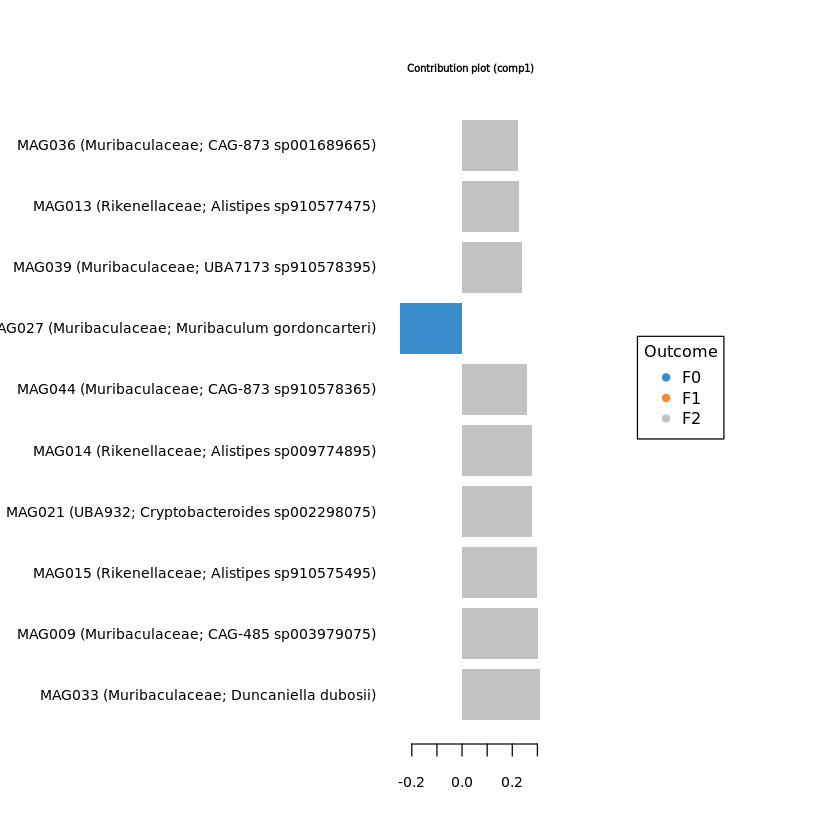

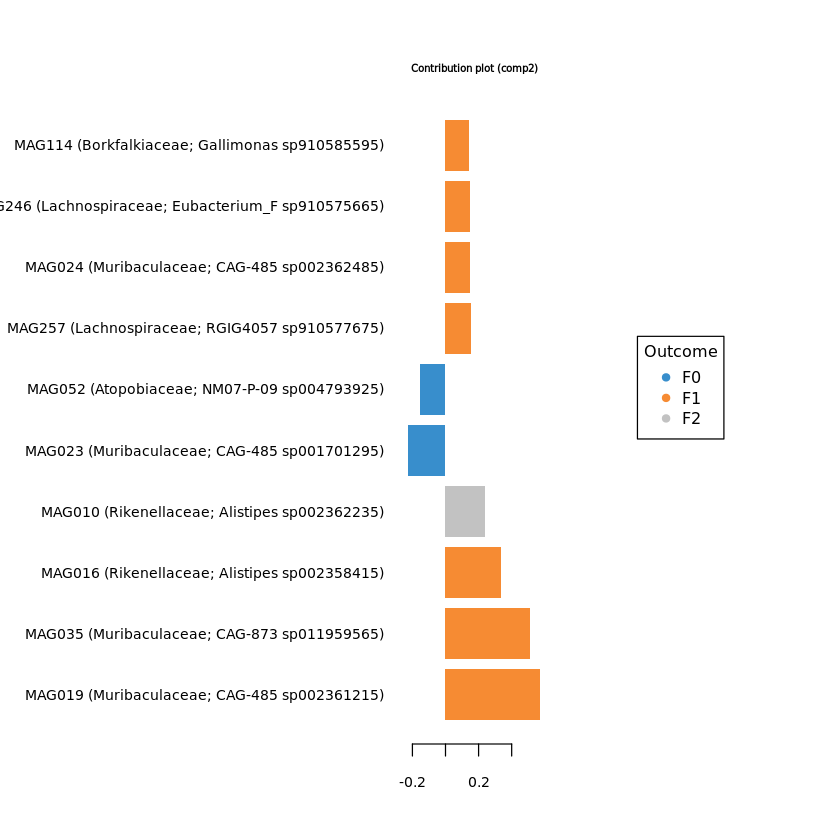

In [38]:
#plotVar(final.splsda.mag, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.mag, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = mag_names$names)
plotLoadings(final.splsda.mag, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = mag_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.mag, comp=1)$value
load_comp2 = selectVar(final.splsda.mag, comp=2)$value
mag.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(mag.load) <- mag.load[,"Row.names"]
colnames(mag.load) <- c("ft","loading_comp1","loading_comp2")
mag.load = mag.load[,c("loading_comp1","loading_comp2")]

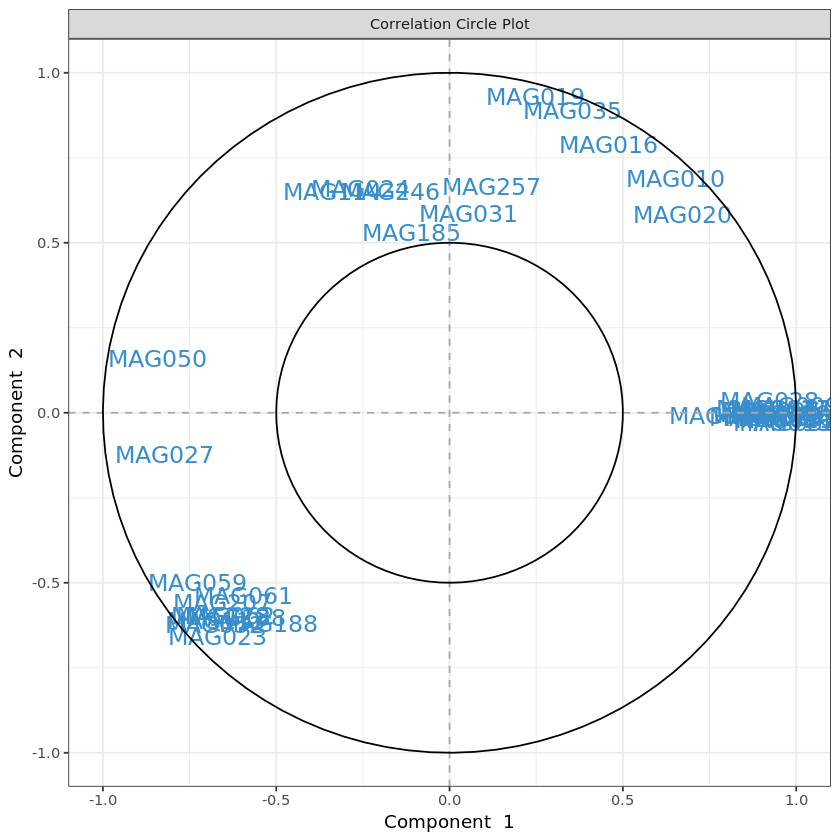

In [39]:
# plot feature correlation
plotVar(final.splsda.mag, cutoff=0.5)
mag.corr <- as.data.frame(plotVar(final.splsda.mag, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
mag.corr <- mag.corr[, c("x","y")]
colnames(mag.corr) <- c("corr_comp1","corr_comp2")

In [327]:
# Calculate feature stability
perf.splsda.mag <- perf(final.splsda.mag, 
                          folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
mag.stab <- merge(data.frame(perf.splsda.mag$features$stable$comp1), 
                  data.frame(perf.splsda.mag$features$stable$comp2), by="Var1", all=T)
rownames(mag.stab) <- mag.stab$Var1
mag.stab <- mag.stab[, c("Freq.x","Freq.y")]
colnames(mag.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [414]:
# merge feature output
mag.out <- merge(mag.load, mag.stab, by="row.names")
rownames(mag.out) <- mag.out[,"Row.names"]
mag.out <- merge(mag.out[, 2:ncol(mag.out)], mag.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.features.tsv", mag.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [42]:
train <- sample(1:nrow(X.mag), ceiling(nrow(X.mag)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.mag), train) # rest is part of the test set

# store matrices into training and test set:
X.mag.train <- X.mag[train, ]
X.mag.test <- X.mag[test,]
Y.mag.train <- info[train,"generation"]
Y.mag.test <- info[test, "generation"]
train.splsda.mag <- splsda(X.mag.train, Y.mag.train, ncomp = mag$optimal.ncomp, keepX = mag$optimal.keepX)
predict.splsda.mag <- predict(train.splsda.mag, X.mag.test, 
                                dist = "max.dist")
predict.comp2.mag <- predict.splsda.mag$class$max.dist[,2]
table(factor(predict.comp2.mag, levels = levels(mag$generation)), Y.mag.test)

    Y.mag.test
     F0 F1 F2
  F0 24  2  0
  F1  0 14  0
  F2  0  0 32

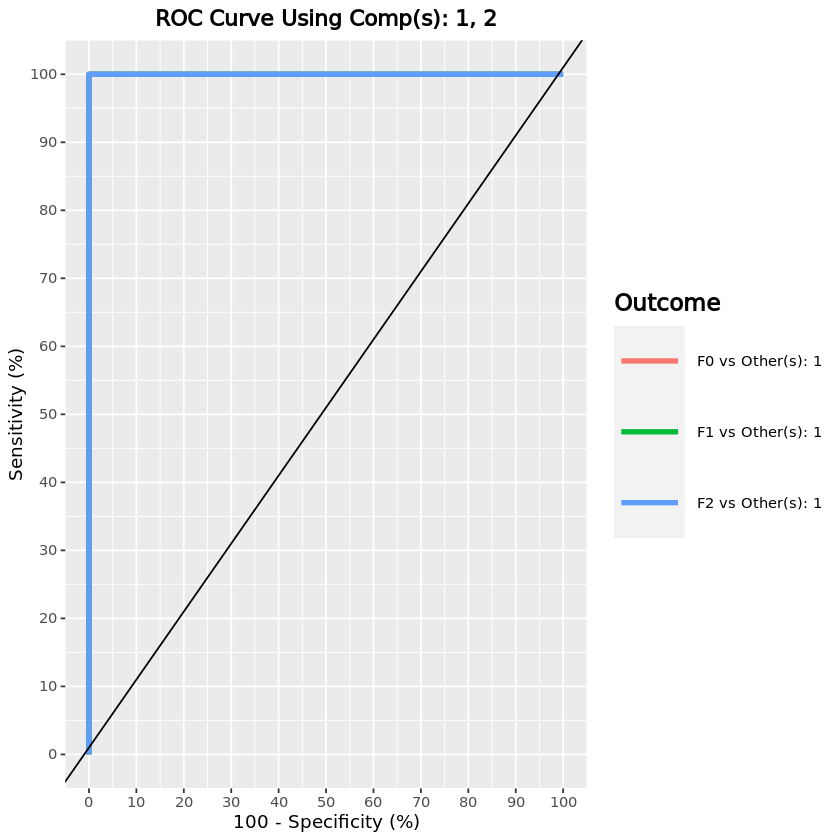

In [46]:
mag.auc.splsda = auroc(final.splsda.mag, roc.comp = 2, print = F) # AUROC for the first component

#### MAGs - F0 generation

[1] "66"           "MAGs removed" "196"          "remaining"

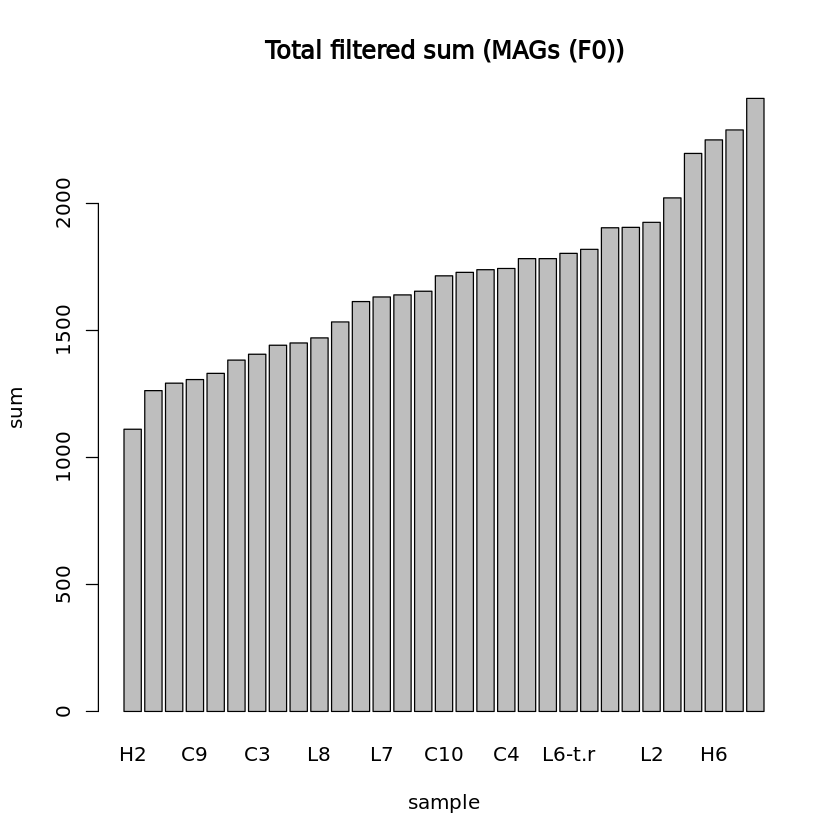

In [47]:
## PARAMS ##
# Initial components
mag.F0.ncomp <- 10
# Percentage of samples in which features must have >0 sum
mag.F0.percent_occ <- 10
# Quantile used for removing low abundance features
mag.F0.quantile_thresh <- 0.1
generation <- "F0"

mag.F0 <- list()
mag.F0$cov <- mag$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(mag.F0$cov[, colSums(mag.F0$cov) > 0])
mag.F0$nz <- mag.F0$cov[, colnames(mag.F0$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(mag.F0$nz) / sum(colSums(mag.F0$nz)) * 100, probs = mag.F0.quantile_thresh)
mag.F0$filtered <- low.count.removal(mag.F0$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
mag.F0$occ <- colSums(mag.F0$filtered>0) / nrow(mag.F0$filtered) * 100
# Keep features occurring in defined percentage of samples
mag.F0$filtered <- mag.F0$filtered[, which(mag.F0$occ >= mag.F0.percent_occ)]

#mag.F0$filtered <- mag.F0$filtered[,-nearZeroVar(mag.F0$filtered)$Position]
paste0(c(dim(mag.F0$cov)[2] - dim(mag.F0$filtered)[2], "MAGs removed", dim(mag.F0$filtered)[2], "remaining"))

# Add offset
mag.F0$offset <- mag.F0$filtered + 1
mag.F0$clr <- logratio.transfo(mag.F0$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.mag.F0 <- mag.F0$clr

mag.F0$treatment <- factor(info[rownames(mag.F0$clr), "Treatment"])

mag.F0.lib.size <- apply(mag.F0$filtered, 1, sum) # determine total count for each sample
barplot(sort(mag.F0.lib.size), main="Total filtered sum (MAGs (F0))", ylab="sum", xlab="sample")

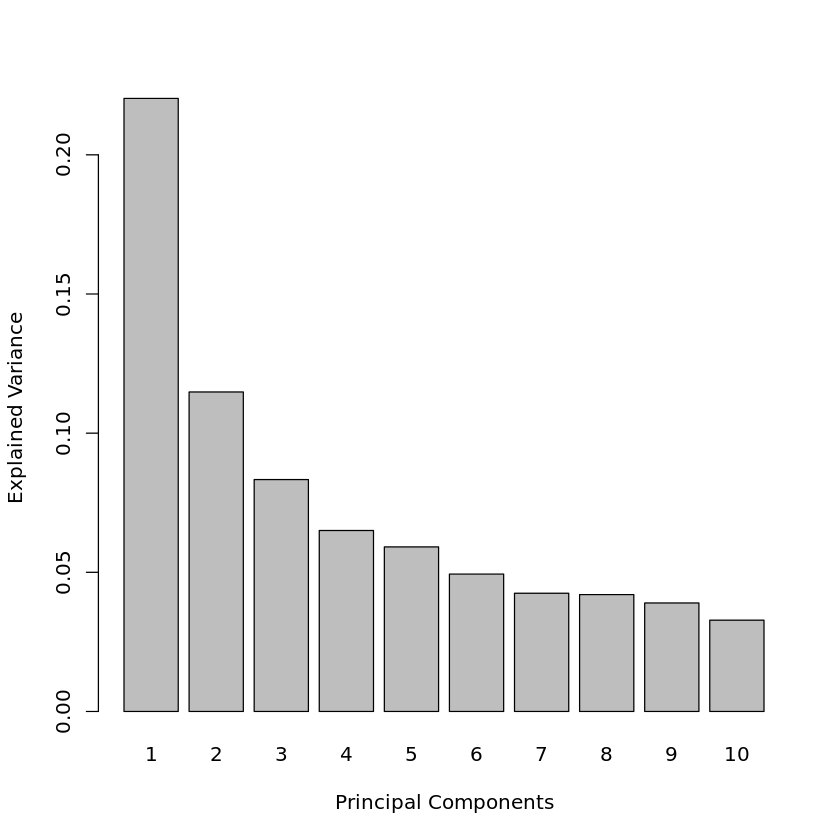

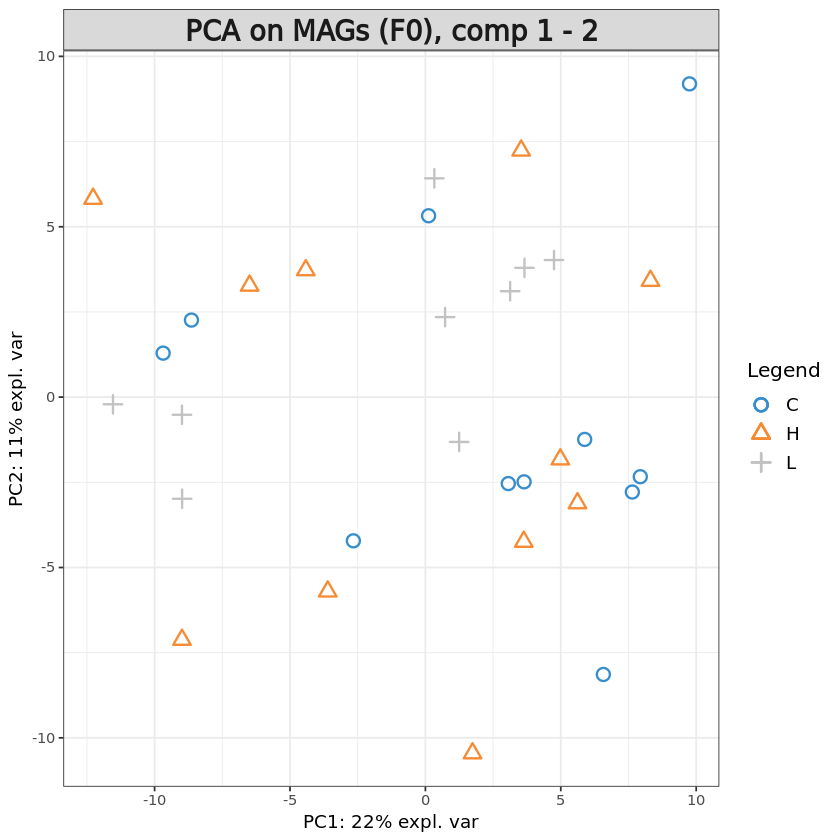

In [48]:
pca.mag.F0 = pca(X.mag.F0, ncomp = mag.F0.ncomp, center = TRUE, scale = TRUE) 

plot(pca.mag.F0)
plotIndiv(pca.mag.F0, group = mag.F0$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on MAGs (F0), comp 1 - 2')

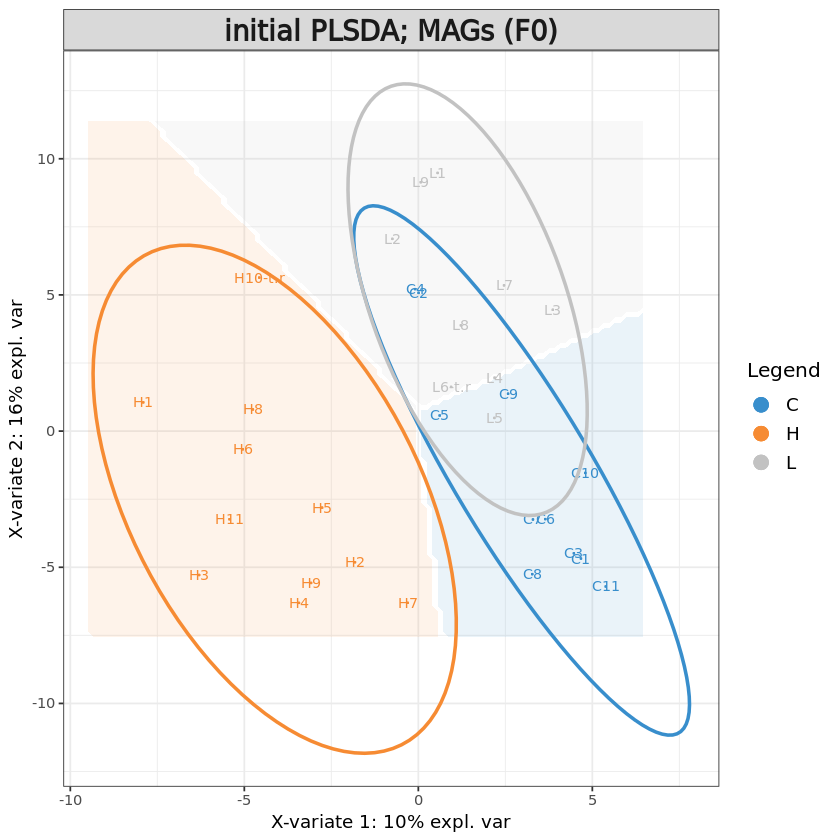

In [49]:
# Initial sPLS-DA model
mag.F0.splsda <- splsda(X.mag.F0, mag.F0$treatment, ncomp = mag.F0.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(mag.F0.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(mag.F0.splsda, comp = 1:2, ellipse = TRUE,
          group = mag.F0$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; MAGs (F0)")

The initial model separates Control + Low treatment groups from High.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,5,5,7
BER,5,5,7


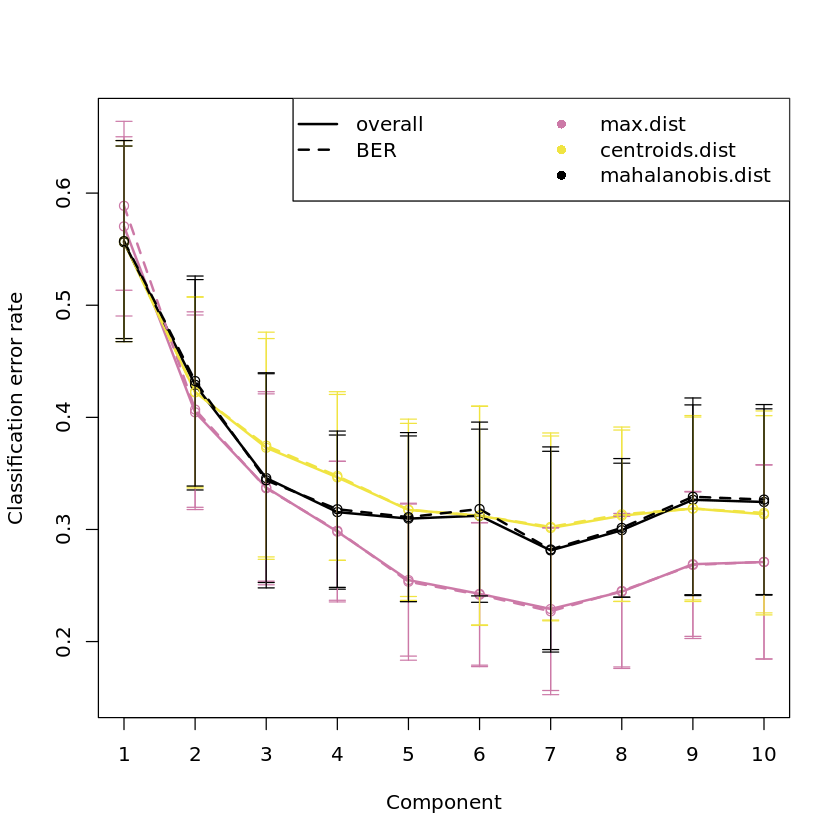

In [25]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.mag.F0 <- perf(mag.F0.splsda, validation = "Mfold", 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.mag.F0, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.mag.F0$choice.ncomp # what is the optimal value of components according to perf()

At 4 components the classification error rate of the model has dropped from 0.6 to ~0.3.

In [26]:
# Define parameters for tuning keepX
mag.F0.step <- 0.05
mag.F0.ncomp.tune <- 5
# grid of possible keepX values that will be tested for each component
mag.F0.keepx <- c(seq(ceiling(dim(mag.F0$filtered)[2] * mag.F0.step), 
                      round(dim(mag.F0$filtered)[2], digits = -1), 
                      ceiling(dim(mag.F0$filtered)[2] * mag.F0.step)
                     )
                 )
mag.F0.keepx

[1]  10  20  30  40  50  60  70  80  90 100 110 120 130 140 150 160 170 180 190
[20] 200

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


[1] 4

comp1 comp2 comp3 comp4 comp5 
   90   160   170   150    20

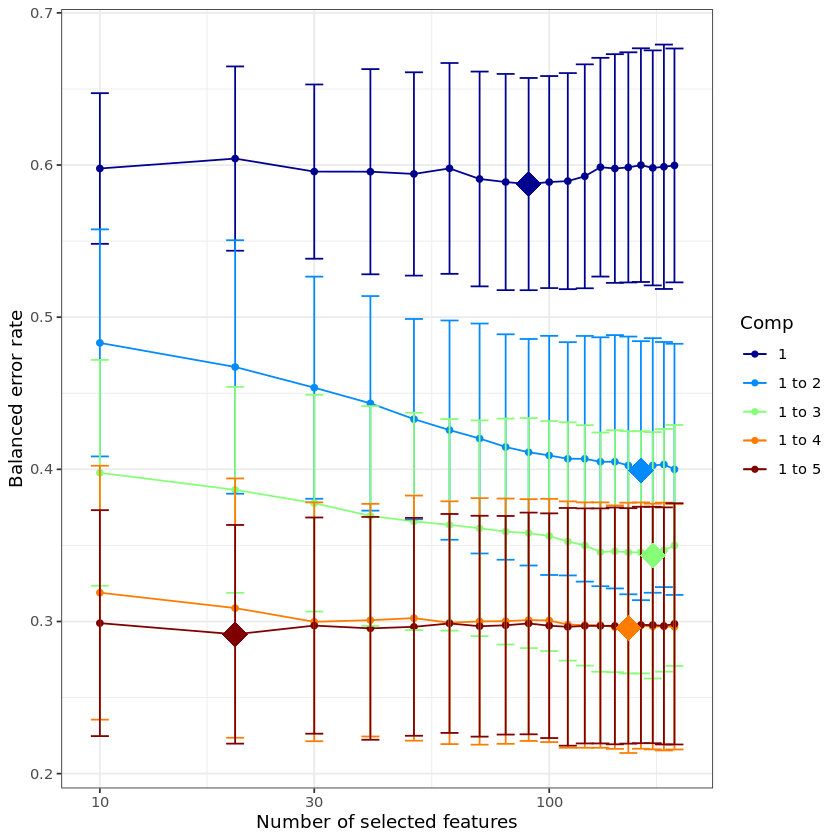

In [27]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.mag.F0 <- tune.splsda(X.mag.F0, mag.F0$treatment, ncomp = mag.F0.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = mag.F0.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.mag.F0, col = color.jet(mag.F0.ncomp.tune))

tune.splsda.mag.F0$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.mag.F0$choice.keepX # what are the optimal values of variables according to tune.splsda()

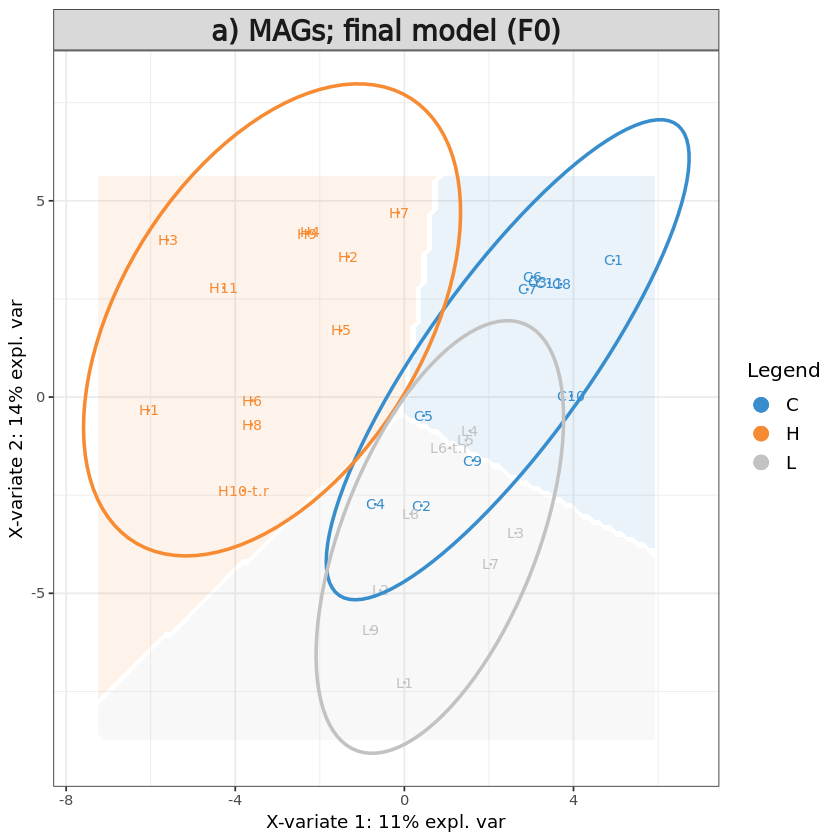

In [439]:
# Define final model
mag.F0$optimal.ncomp <- 4
#mag.F0$optimal.keepX <- tune.splsda.mag.F0$choice.keepX[1:mag.F0$optimal.ncomp]
mag.F0$optimal.keepX <- rep(50, mag.F0$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.mag.F0 <- splsda(X.mag.F0, mag.F0$treatment, 
                       ncomp = mag.F0$optimal.ncomp, 
                       keepX = mag.F0$optimal.keepX)

background = background.predict(final.splsda.mag.F0, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.mag.F0, comp = 1:2, 
          group = mag.F0$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) MAGs; final model (F0)')

# save sample variates
data <- as.data.frame(final.splsda.mag.F0$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F0.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

Using 4 components with 50 features per component gave highly similar results to using the tuned number of features per component.

In [440]:
mag.F0_names <- mag_tax[colnames(final.splsda.mag.F0$X),c("phylum", "family", "species")]
mag.F0_names$names <- paste0(rownames(mag.F0_names)," (", mag.F0_names$family, "; ", mag.F0_names$species, ")")

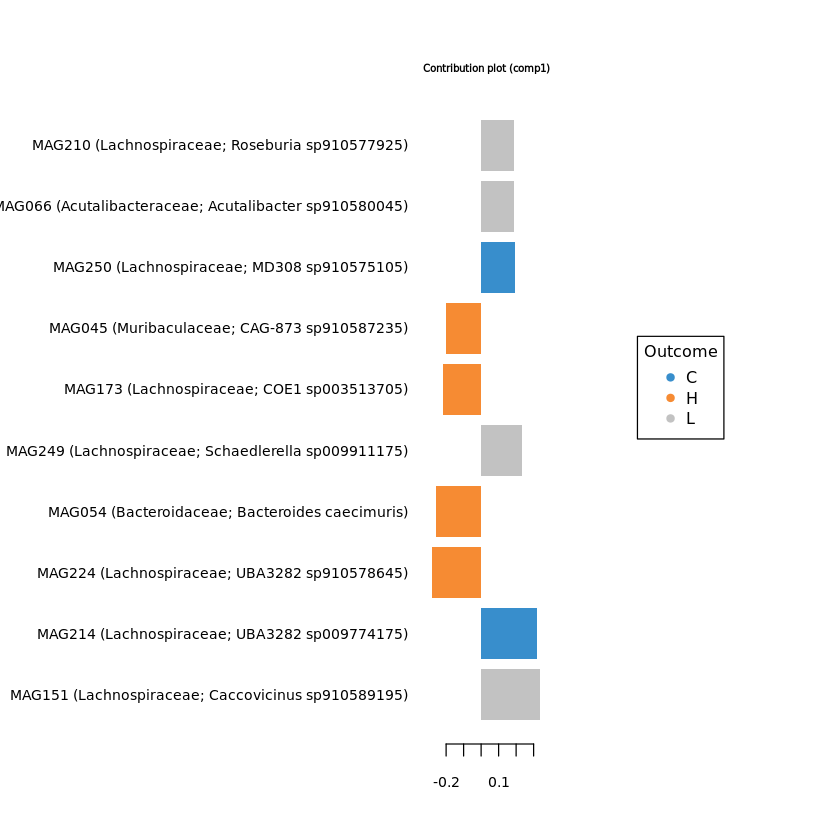

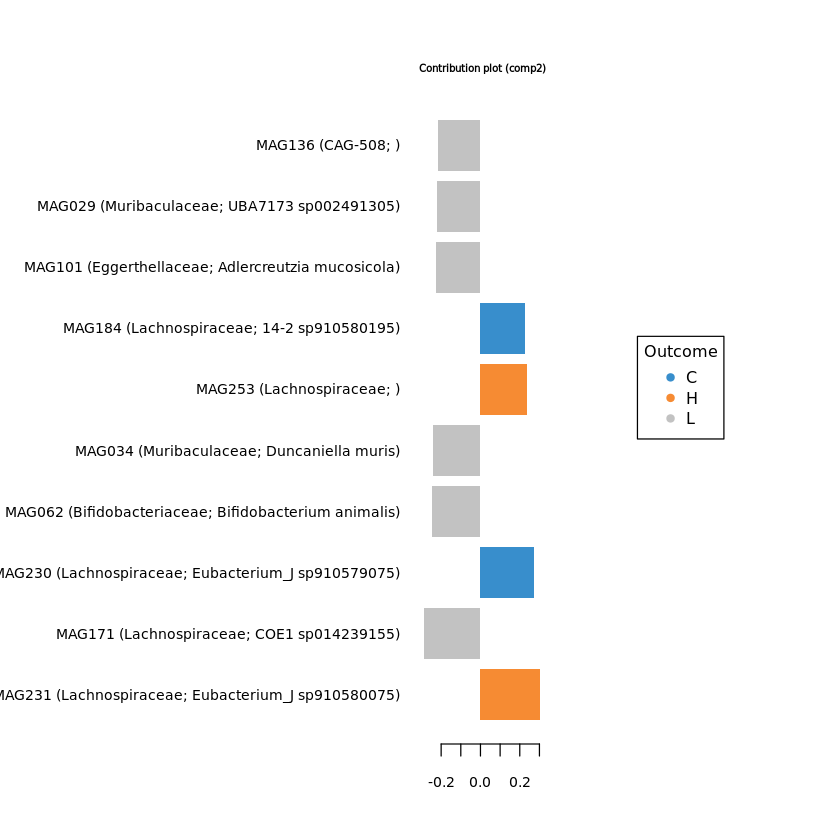

In [441]:
#plotVar(final.splsda.mag.F0, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.mag.F0, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = mag.F0_names$names)
plotLoadings(final.splsda.mag.F0, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = mag.F0_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.mag.F0, comp=1)$value
load_comp2 = selectVar(final.splsda.mag.F0, comp=2)$value
F0.mag.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F0.mag.load) <- F0.mag.load[,"Row.names"]
colnames(F0.mag.load) <- c("ft","loading_comp1","loading_comp2")
F0.mag.load = F0.mag.load[,c("loading_comp1","loading_comp2")]

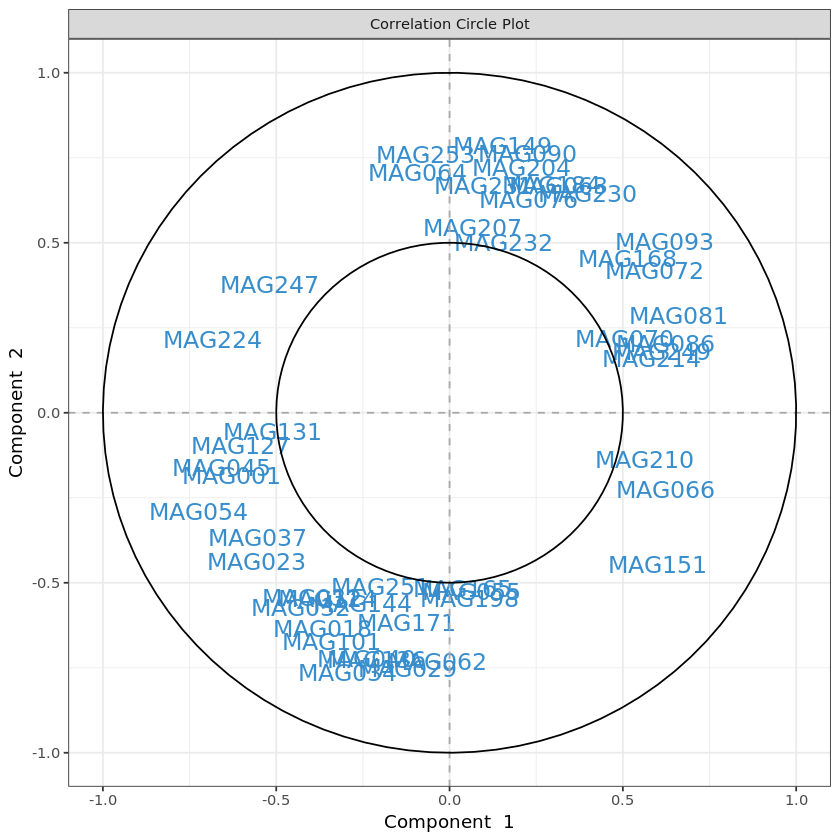

In [442]:
# plot feature correlation
plotVar(final.splsda.mag.F0, cutoff=0.5)
mag.F0.corr <- as.data.frame(plotVar(final.splsda.mag.F0, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
mag.F0.corr <- mag.F0.corr[, c("x","y")]
colnames(mag.F0.corr) <- c("corr_comp1","corr_comp2")

In [54]:
# Calculate feature stability
perf.splsda.mag.F0 <- perf(final.splsda.mag.F0, 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F0.mag.stab <- merge(data.frame(perf.splsda.mag.F0$features$stable$comp1), 
                  data.frame(perf.splsda.mag.F0$features$stable$comp2), by="Var1", all=T)
rownames(F0.mag.stab) <- F0.mag.stab$Var1
F0.mag.stab <- F0.mag.stab[, c("Freq.x","Freq.y")]
colnames(F0.mag.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%


In [444]:
# merge feature output
F0.mag.out <- merge(F0.mag.load, F0.mag.stab, by="row.names")
rownames(F0.mag.out) <- F0.mag.out[,"Row.names"]
F0.mag.out <- merge(F0.mag.out[, 2:ncol(F0.mag.out)], mag.F0.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F0.features.tsv", F0.mag.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [56]:
train <- sample(1:nrow(X.mag.F0), ceiling(nrow(X.mag.F0)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.mag.F0), train) # rest is part of the test set

# store matrices into training and test set:
X.mag.F0.train <- X.mag.F0[train, ]
X.mag.F0.test <- X.mag.F0[test,]
Y.mag.F0.train <- info[train,"treatment"]
Y.mag.F0.test <- info[test, "treatment"]
train.splsda.mag.F0 <- splsda(X.mag.F0.train, Y.mag.F0.train, ncomp = mag.F0$optimal.ncomp, keepX = mag.F0$optimal.keepX)
predict.splsda.mag.F0 <- predict(train.splsda.mag.F0, X.mag.F0.test, 
                                dist = "max.dist")
predict.comp2.mag.F0 <- predict.splsda.mag.F0$class$max.dist[,2]
table(factor(predict.comp2.mag.F0, levels = levels(mag.F0$treatment)), Y.mag.F0.test)

   Y.mag.F0.test
    C H L
  C 2 2 0
  H 0 1 1
  L 7 6 4

$Comp1
                 AUC   p-value
C vs Other(s) 0.9045 2.383e-04
H vs Other(s) 0.9864 9.979e-06
L vs Other(s) 0.5909 4.334e-01

$Comp2
                 AUC   p-value
C vs Other(s) 0.8773 6.108e-04
H vs Other(s) 1.0000 5.586e-06
L vs Other(s) 0.9545 8.975e-05

$Comp3
              AUC   p-value
C vs Other(s)   1 5.586e-06
H vs Other(s)   1 5.586e-06
L vs Other(s)   1 1.644e-05

$Comp4
              AUC   p-value
C vs Other(s)   1 5.586e-06
H vs Other(s)   1 5.586e-06
L vs Other(s)   1 1.644e-05



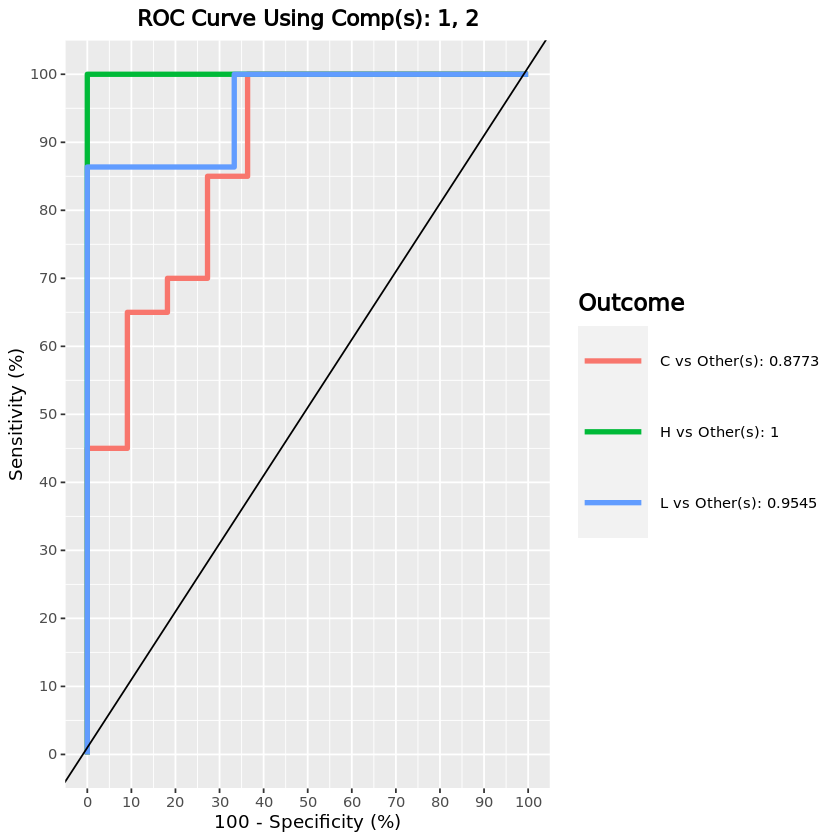

In [64]:
F0.mag.auc.splsda = auroc(final.splsda.mag.F0, roc.comp = 2, print = T) # AUROC for the first component

#### MAGs - F0 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [65]:
mag.F0_2 <- list()
F0_info_2 <- info[rownames(mag.F0$cov),]
F0_info_2$treatment <- gsub(x = F0_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
mag.F0_2$cov <- mag.F0$cov[rownames(F0_info_2),]
mag.F0_2$filtered <- mag.F0$filtered[rownames(F0_info_2),]

mag.F0_2$clr <- mag.F0$clr[rownames(F0_info_2), ]
X.mag.F0_2 <- mag.F0_2$clr

mag.F0_2$treatment <- factor(F0_info_2[rownames(mag.F0_2$clr), "treatment"])

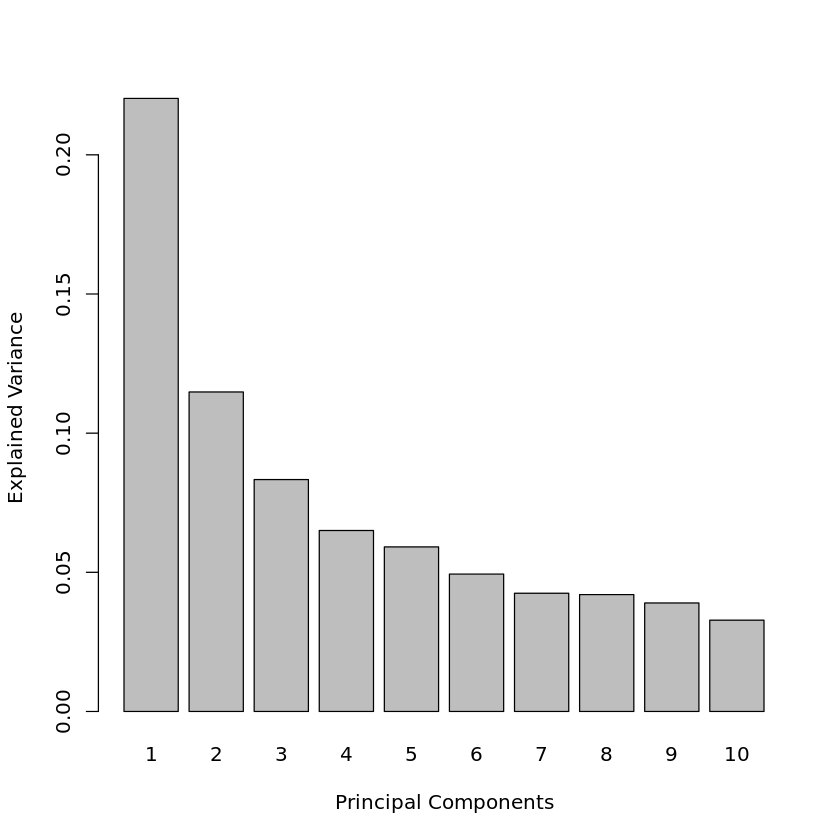

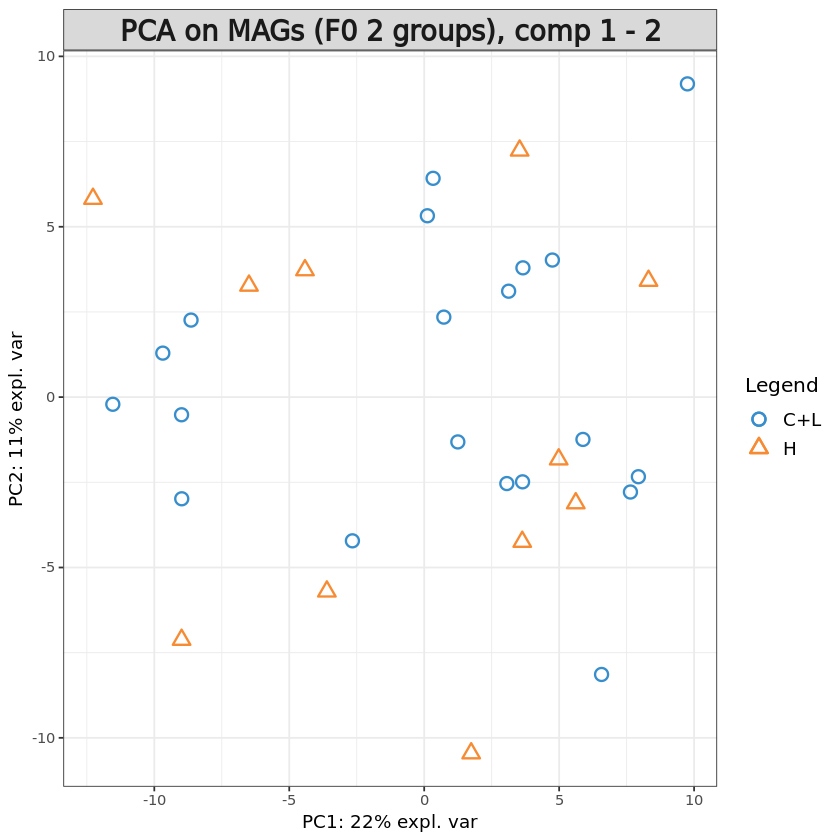

In [66]:
pca.mag.F0_2 = pca(X.mag.F0_2, ncomp = 10, center = TRUE, scale = TRUE) 

plot(pca.mag.F0_2)
plotIndiv(pca.mag.F0_2, group = mag.F0_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on MAGs (F0 2 groups), comp 1 - 2')

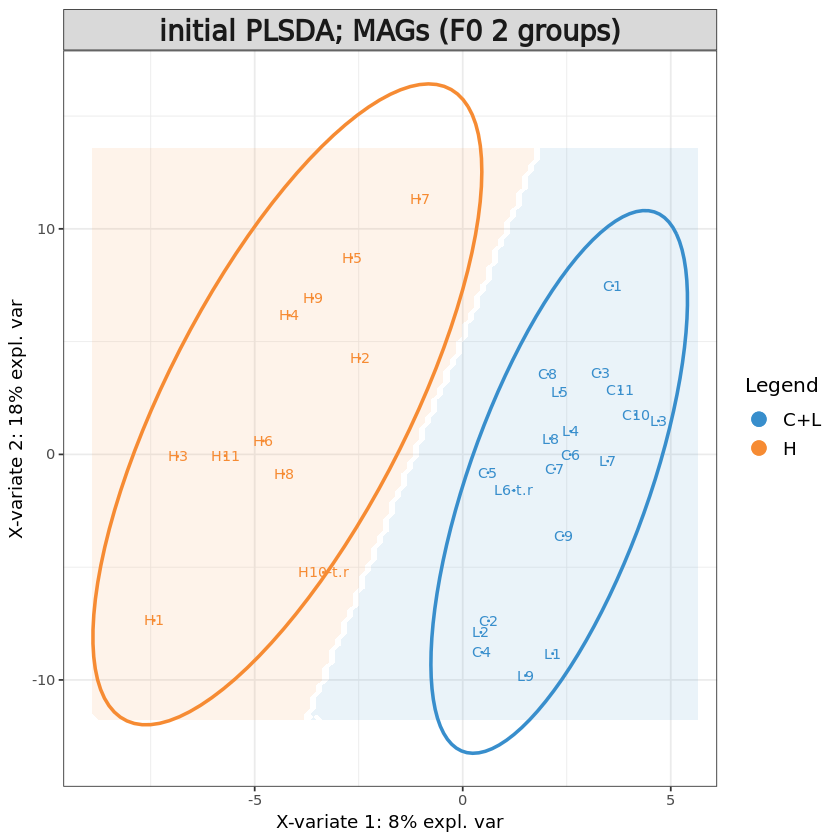

In [67]:
# Initial sPLS-DA model
mag.F0_2.splsda <- splsda(X.mag.F0_2, mag.F0_2$treatment, ncomp = 10)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(mag.F0_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(mag.F0_2.splsda, comp = 1:2, ellipse = TRUE,
          group = mag.F0_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; MAGs (F0 2 groups)")

The initial model separates the two treatment groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,3,3,3
BER,3,3,3


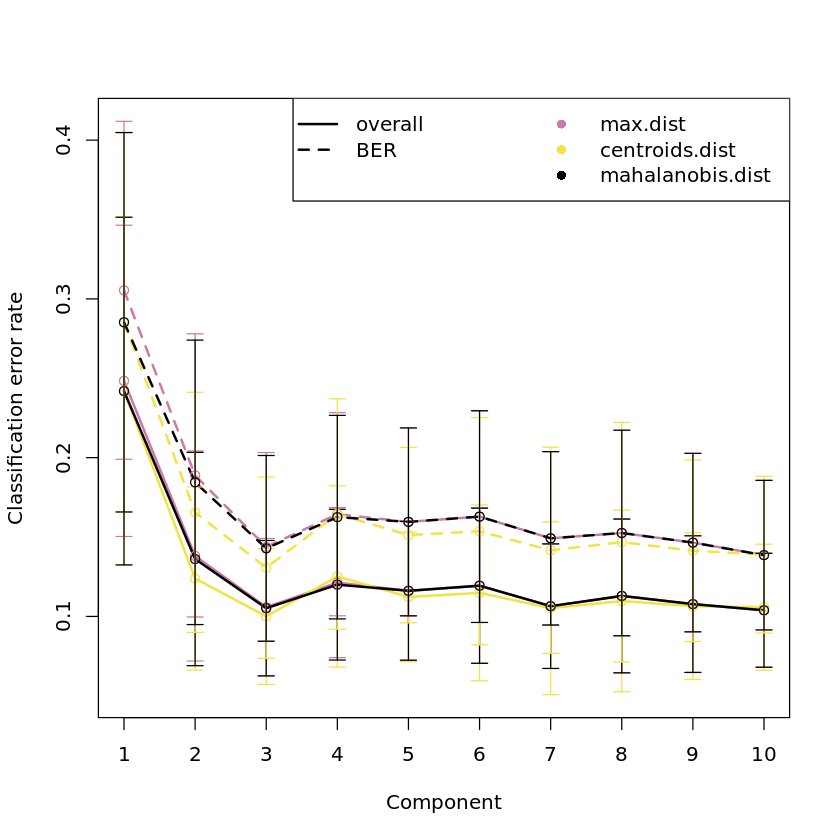

In [175]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.mag.F0_2 <- perf(mag.F0_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.mag.F0_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.mag.F0_2$choice.ncomp # what is the optimal value of components according to perf()

We set number of components to 3 and tune number of features used.

In [176]:
# Define parameters for tuning keepX
mag.F0_2.step <- 0.05
mag.F0_2.ncomp.tune <- 3
# grid of possible keepX values that will be tested for each component
mag.F0_2.keepx <- c(seq(ceiling(dim(mag.F0_2$filtered)[2] * mag.F0_2.step), 
                      round(dim(mag.F0_2$filtered)[2], digits = -1), 
                      ceiling(dim(mag.F0_2$filtered)[2] * mag.F0_2.step)
                     )
                 )
mag.F0_2.keepx

[1]  10  20  30  40  50  60  70  80  90 100 110 120 130 140 150 160 170 180 190
[20] 200

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


[1] 2

comp1 comp2 comp3 
  190    40    60

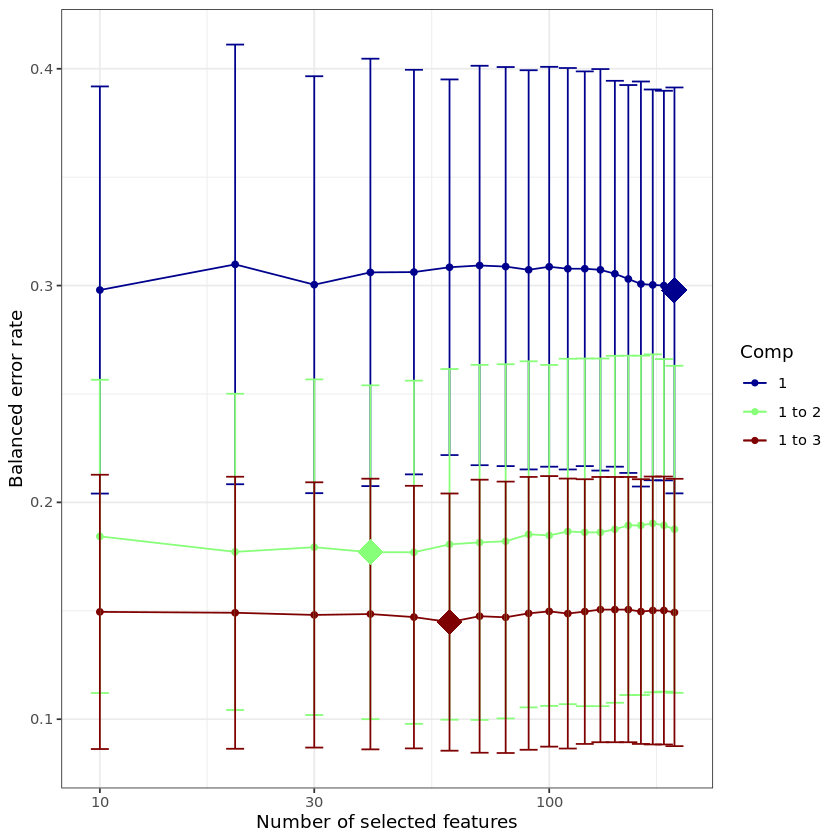

In [177]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.mag.F0_2 <- tune.splsda(X.mag.F0_2, mag.F0_2$treatment, ncomp = mag.F0_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = mag.F0_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.mag.F0_2, col = color.jet(mag.F0_2.ncomp.tune))

tune.splsda.mag.F0_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.mag.F0_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

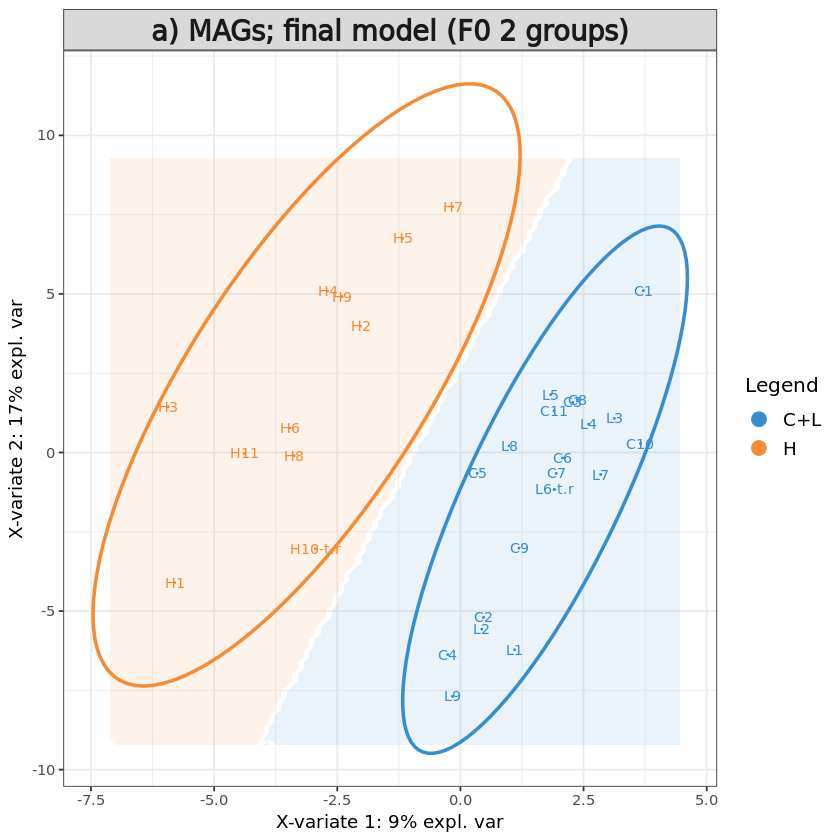

In [68]:
# Define final model
mag.F0_2$optimal.ncomp <- 2
#mag.F0_2$optimal.keepX <- tune.splsda.mag.F0_2$choice.keepX[1:mag.F0_2$optimal.ncomp]
mag.F0_2$optimal.keepX <- rep(50, mag.F0_2$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.mag.F0_2 <- splsda(X.mag.F0_2, mag.F0_2$treatment, 
                       ncomp = mag.F0_2$optimal.ncomp, 
                       keepX = mag.F0_2$optimal.keepX)

background = background.predict(final.splsda.mag.F0_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.mag.F0_2, comp = 1:2, 
          group = mag.F0_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) MAGs; final model (F0 2 groups)')

# save sample variates
data <- as.data.frame(final.splsda.mag.F0$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F0_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

In [69]:
mag.F0_2_names <- mag_tax[colnames(final.splsda.mag.F0_2$X),c("phylum", "family", "species")]
mag.F0_2_names$names <- paste0(rownames(mag.F0_2_names)," (", mag.F0_2_names$family, "; ", mag.F0_2_names$species, ")")

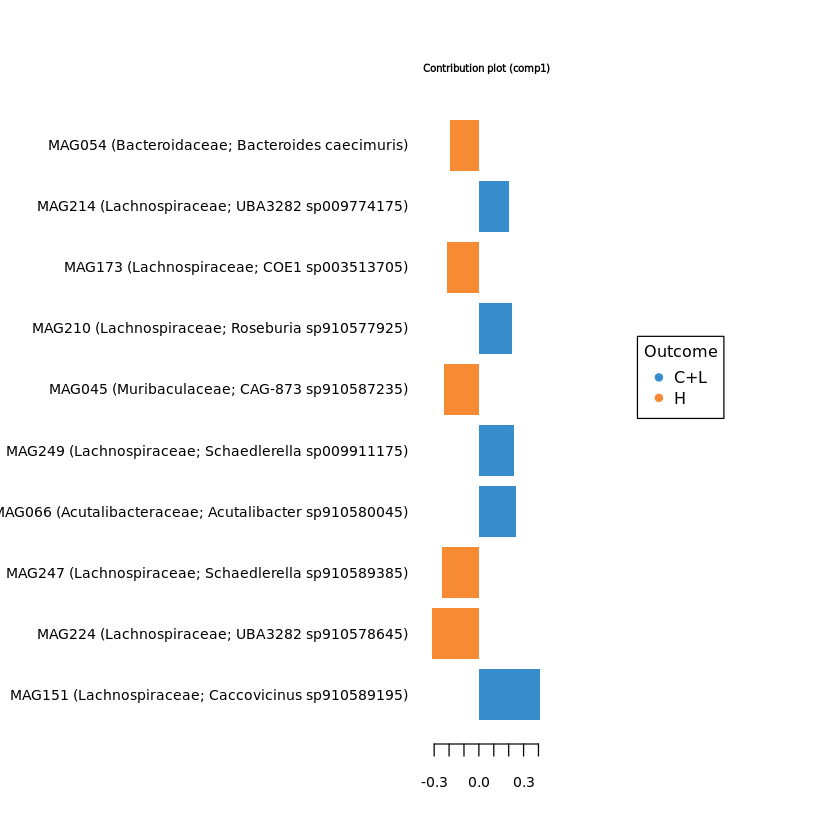

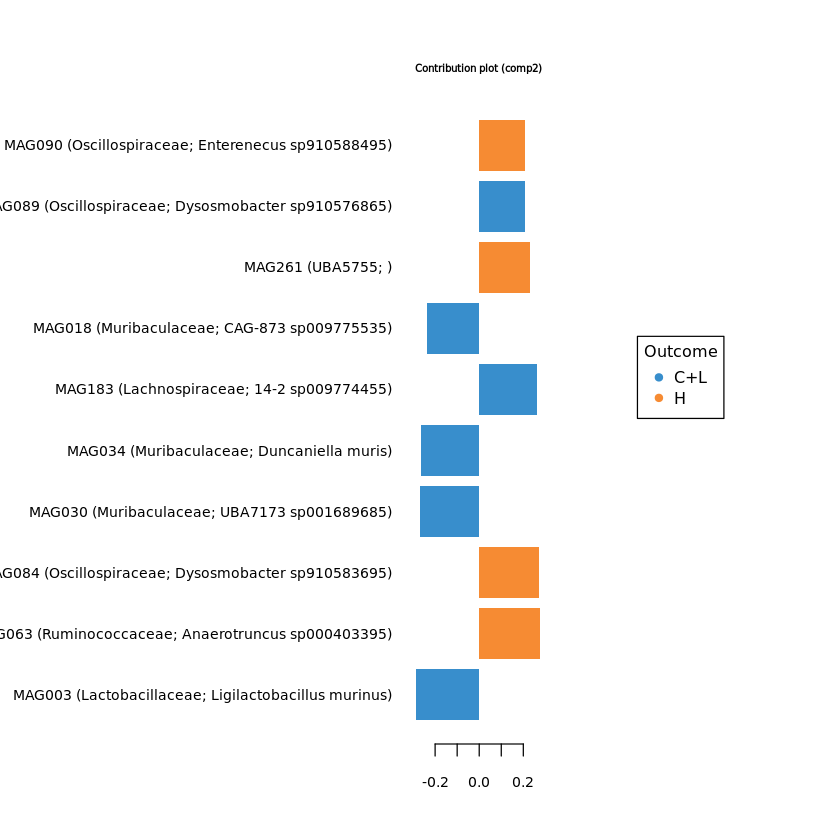

In [373]:
#plotVar(final.splsda.mag.F0_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.mag.F0_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = mag.F0_2_names$names)
plotLoadings(final.splsda.mag.F0_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = mag.F0_2_names$names)
# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.mag.F0_2, comp=1)$value
load_comp2 = selectVar(final.splsda.mag.F0_2, comp=2)$value
F0_2.mag.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F0_2.mag.load) <- F0_2.mag.load[,"Row.names"]
colnames(F0_2.mag.load) <- c("ft","loading_comp1","loading_comp2")
F0_2.mag.load = F0_2.mag.load[,c("loading_comp1","loading_comp2")]

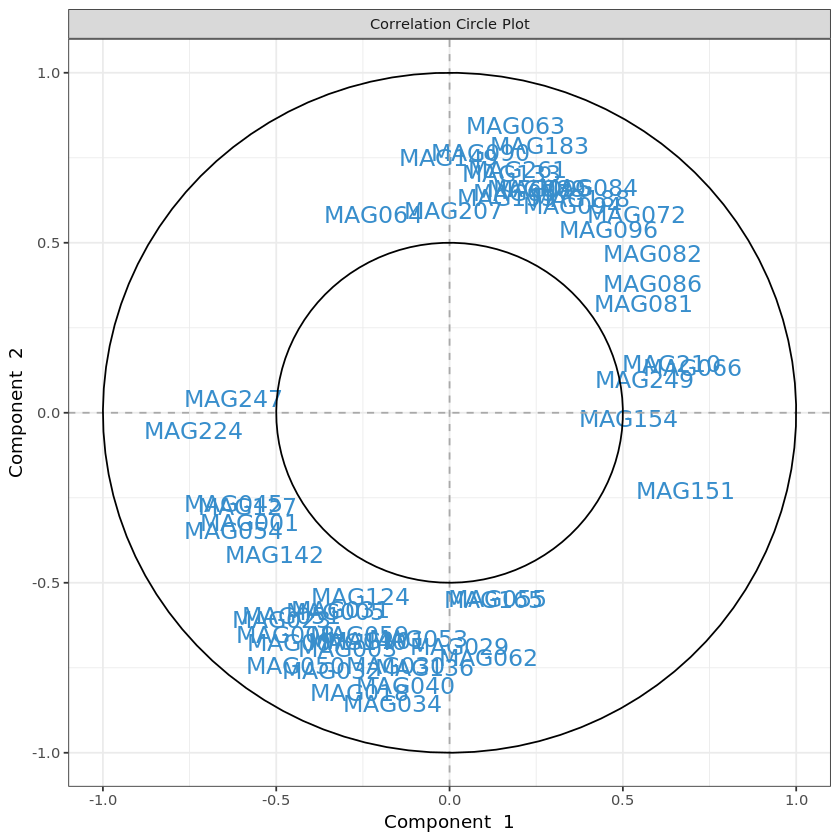

In [374]:
# plot feature correlation
plotVar(final.splsda.mag.F0_2, cutoff=0.5)
mag.F0_2.corr <- as.data.frame(plotVar(final.splsda.mag.F0_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
mag.F0_2.corr <- mag.F0_2.corr[, c("x","y")]
colnames(mag.F0_2.corr) <- c("corr_comp1","corr_comp2")

In [72]:
# Calculate feature stability
perf.splsda.mag.F0_2 <- perf(final.splsda.mag.F0_2, 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F0_2.mag.stab <- merge(data.frame(perf.splsda.mag.F0_2$features$stable$comp1), 
                  data.frame(perf.splsda.mag.F0_2$features$stable$comp2), by="Var1", all=T)
rownames(F0_2.mag.stab) <- F0_2.mag.stab$Var1
F0_2.mag.stab <- F0_2.mag.stab[, c("Freq.x","Freq.y")]
colnames(F0_2.mag.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [422]:
# merge feature output
F0_2.mag.out <- merge(F0_2.mag.load, F0_2.mag.stab, by="row.names")
rownames(F0_2.mag.out) <- F0_2.mag.out[,"Row.names"]
F0_2.mag.out <- merge(F0_2.mag.out[, 2:ncol(F0_2.mag.out)], mag.F0_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F0_2.features.tsv", F0_2.mag.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [74]:
train <- sample(1:nrow(X.mag.F0_2), ceiling(nrow(X.mag.F0_2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.mag.F0_2), train) # rest is part of the test set

# store matrices into training and test set:
X.mag.F0_2.train <- X.mag.F0_2[train, ]
X.mag.F0_2.test <- X.mag.F0_2[test,]
Y.mag.F0_2.train <- F0_info_2[train,"treatment"]
Y.mag.F0_2.test <- F0_info_2[test, "treatment"]
train.splsda.mag.F0_2 <- splsda(X.mag.F0_2.train, Y.mag.F0_2.train, ncomp = mag.F0_2$optimal.ncomp, keepX = mag.F0_2$optimal.keepX)
predict.splsda.mag.F0_2 <- predict(train.splsda.mag.F0_2, X.mag.F0_2.test, 
                                dist = "max.dist")
predict.comp2.mag.F0_2 <- predict.splsda.mag.F0_2$class$max.dist[,2]
table(factor(predict.comp2.mag.F0_2, levels = levels(mag.F0_2$treatment)), Y.mag.F0_2.test)

     Y.mag.F0_2.test
      C+L  H
  C+L  15  0
  H     2  6

$Comp1
            AUC   p-value
C+L vs H 0.9909 8.238e-06

$Comp2
         AUC   p-value
C+L vs H   1 5.586e-06



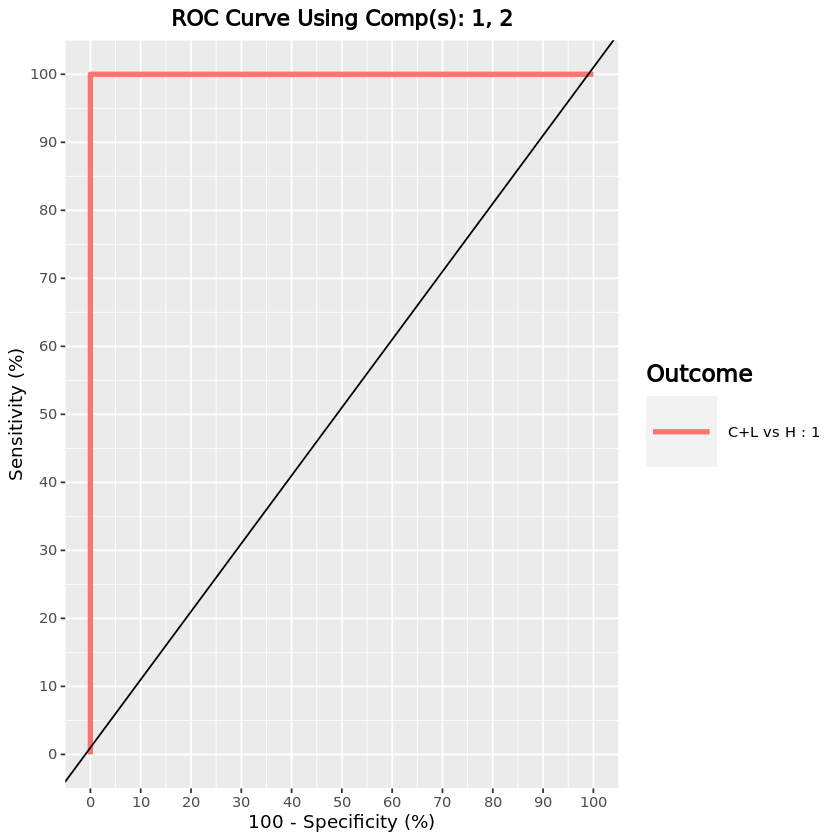

In [77]:
F0_2.mag.auc.splsda = auroc(final.splsda.mag.F0_2, roc.comp = 2, print = T) # AUROC for the first component

#### MAGs - F1 generation

[1] "70"           "MAGs removed" "192"          "remaining"

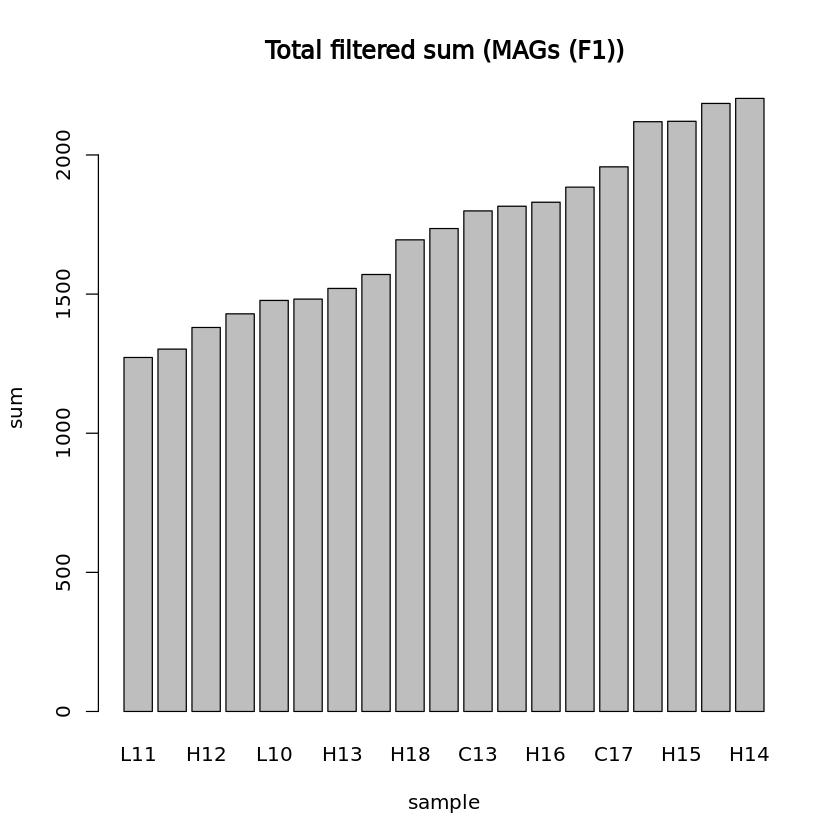

In [78]:
## PARAMS ##
# Initial components
mag.F1.ncomp <- 5
# Percentage of samples in which features must have >0 sum
mag.F1.percent_occ <- 10
# Quantile used for removing low abundance features
mag.F1.quantile_thresh <- 0.1
generation <- "F1"

mag.F1 <- list()
mag.F1$cov <- mag$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(mag.F1$cov[, colSums(mag.F1$cov) > 0])
mag.F1$nz <- mag.F1$cov[, colnames(mag.F1$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(mag.F1$nz) / sum(colSums(mag.F1$nz)) * 100, probs = mag.F1.quantile_thresh)
mag.F1$filtered <- low.count.removal(mag.F1$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
mag.F1$occ <- colSums(mag.F1$filtered>0) / nrow(mag.F1$filtered) * 100
# Keep features occurring in defined percentage of samples
mag.F1$filtered <- mag.F1$filtered[, which(mag.F1$occ >= mag.F1.percent_occ)]

#mag.F1$filtered <- mag.F1$filtered[,-nearZeroVar(mag.F1$filtered)$Position]
paste0(c(dim(mag.F1$cov)[2] - dim(mag.F1$filtered)[2], "MAGs removed", dim(mag.F1$filtered)[2], "remaining"))

# Add offset
mag.F1$offset <- mag.F1$filtered + 1
mag.F1$clr <- logratio.transfo(mag.F1$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.mag.F1 <- mag.F1$clr

mag.F1$treatment <- factor(info[rownames(mag.F1$clr), "Treatment"])
mag.F1.lib.size <- apply(mag.F1$filtered, 1, sum) # determine total count for each sample
barplot(sort(mag.F1.lib.size), main="Total filtered sum (MAGs (F1))", ylab="sum", xlab="sample")

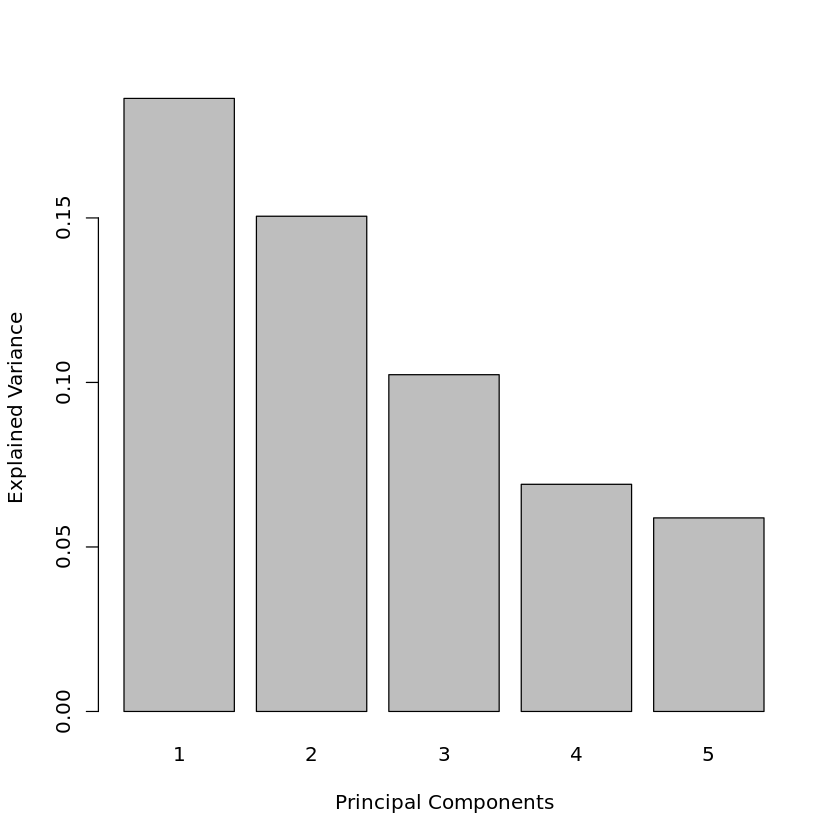

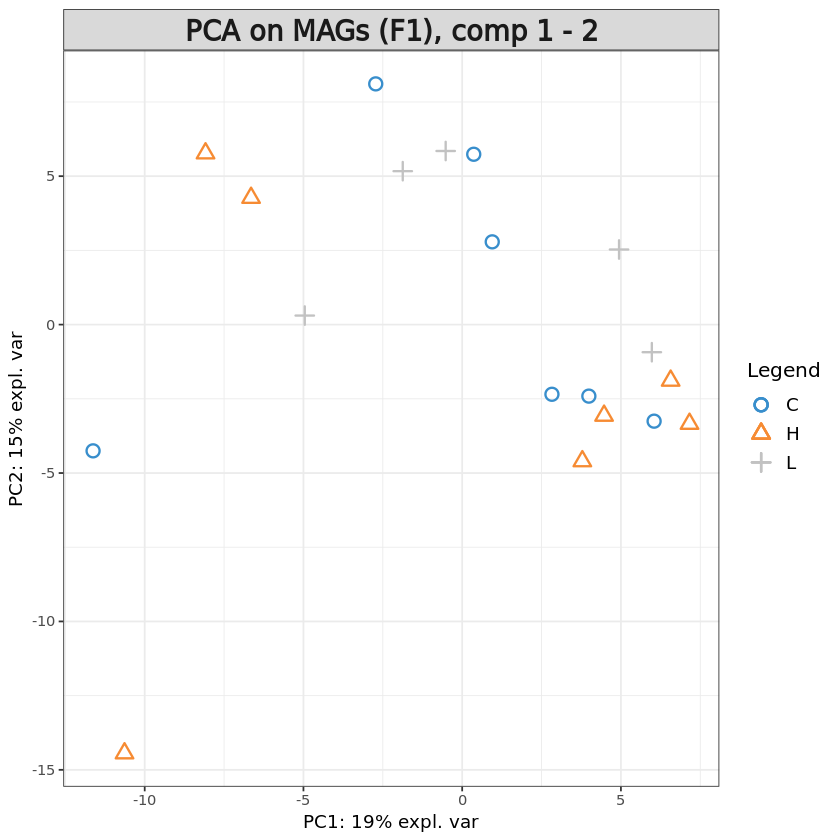

In [79]:
pca.mag.F1 = pca(X.mag.F1, ncomp = mag.F1.ncomp, center = TRUE, scale = TRUE) 

plot(pca.mag.F1)
plotIndiv(pca.mag.F1, group = mag.F1$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on MAGs (F1), comp 1 - 2')

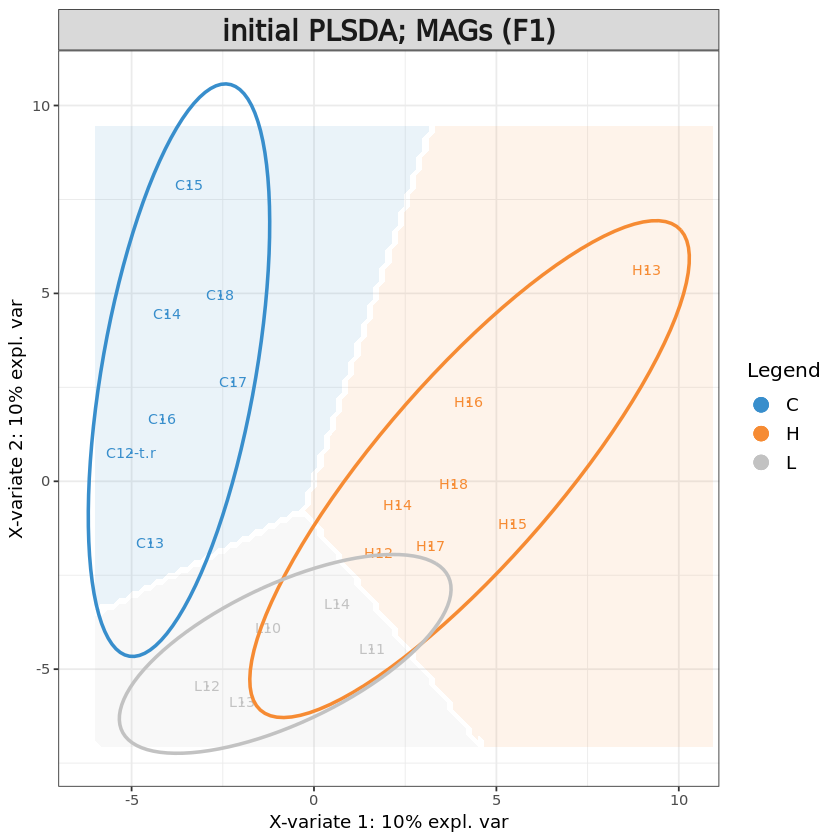

In [80]:
# Initial sPLS-DA model
mag.F1.splsda <- splsda(X.mag.F1, mag.F1$treatment, ncomp = mag.F1.ncomp)  # set ncomp to 10 for performance assessment later

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(mag.F1.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(mag.F1.splsda, comp = 1:2, ellipse = TRUE,
          group = mag.F1$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; MAGs (F1)")

Here in the initial model, the L + H groups overlap to some extent.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,1,1,4
BER,1,1,4


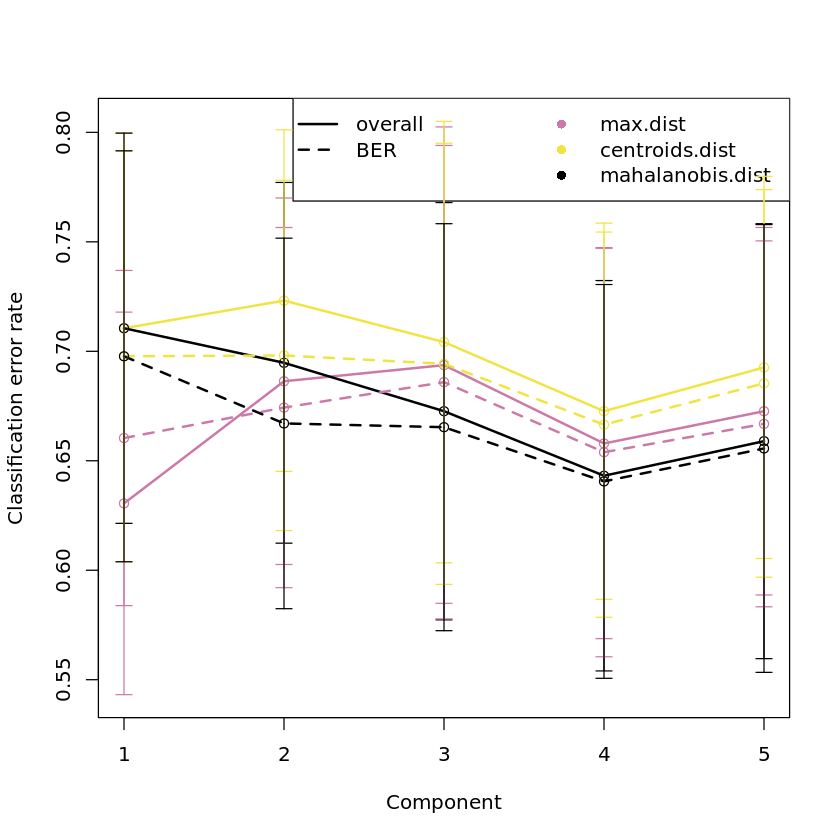

In [46]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.mag.F1 <- perf(mag.F1.splsda, validation = "Mfold", 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.mag.F1, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.mag.F1$choice.ncomp # what is the optimal value of components according to perf()

For MAGs in the F1 generation there appears to be no gain in accuracy when increasing components.

In [47]:
# Define parameters for tuning keepX
mag.F1.step <- 0.05
mag.F1.ncomp.tune <- 2
# grid of possible keepX values that will be tested for each component
mag.F1.keepx <- c(seq(ceiling(dim(mag.F1$filtered)[2] * mag.F1.step), 
                      round(dim(mag.F1$filtered)[2], digits = -1), 
                      ceiling(dim(mag.F1$filtered)[2] * mag.F1.step)
                     )
                 )
mag.F1.keepx

[1]  10  20  30  40  50  60  70  80  90 100 110 120 130 140 150 160 170 180 190

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


[1] 1

comp1 comp2 
   10   130

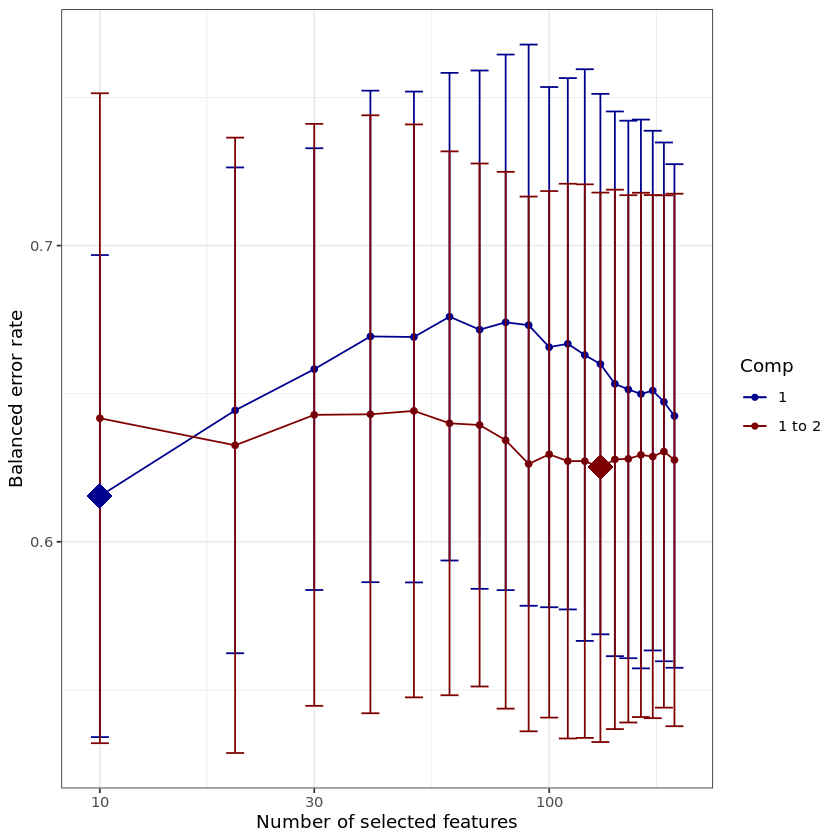

In [48]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.mag.F1 <- tune.splsda(X.mag.F1, mag.F1$treatment, ncomp = mag.F1.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = mag.F1.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.mag.F1, col = color.jet(mag.F1.ncomp.tune))

tune.splsda.mag.F1$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.mag.F1$choice.keepX # what are the optimal values of variables according to tune.splsda()

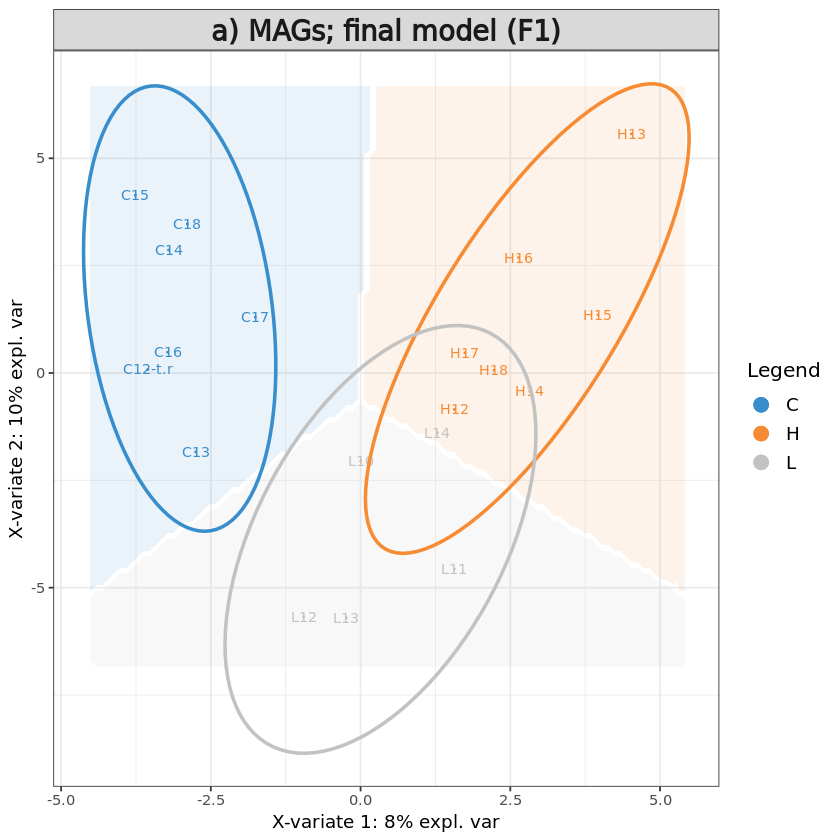

In [81]:
# Define final model
mag.F1$optimal.ncomp <- 2
#mag.F1$optimal.keepX <- tune.splsda.mag.F1$choice.keepX[1:mag.F1$optimal.ncomp]
mag.F1$optimal.keepX <- rep(50, mag.F1$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.mag.F1 <- splsda(X.mag.F1, mag.F1$treatment, 
                       ncomp = mag.F1$optimal.ncomp, 
                       keepX = mag.F1$optimal.keepX)

background = background.predict(final.splsda.mag.F1, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.mag.F1, comp = 1:2, 
          group = mag.F1$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) MAGs; final model (F1)')

# save sample variates
data <- as.data.frame(final.splsda.mag.F1$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F1.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

Here component 1 separates C from L and H, but the two treatment groups overlap to some extent.

In [82]:
mag.F1_names <- mag_tax[colnames(final.splsda.mag.F1$X),c("phylum", "family", "species")]
mag.F1_names$names <- paste0(rownames(mag.F1_names)," (", mag.F1_names$family, "; ", mag.F1_names$species, ")")

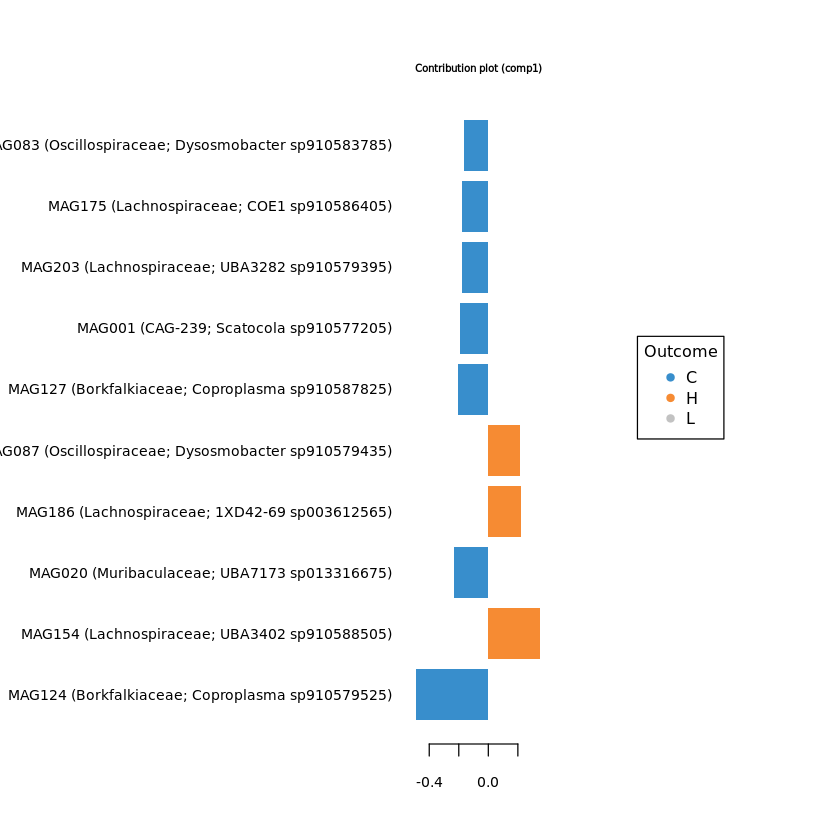

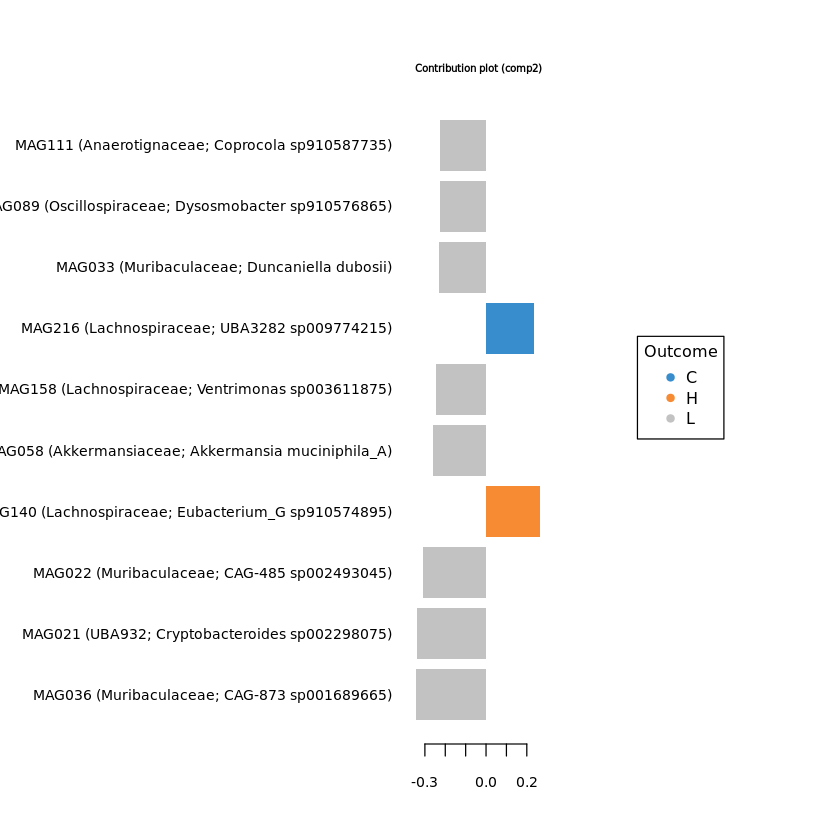

In [369]:
#plotVar(final.splsda.mag.F1, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.mag.F1, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = mag.F1_names$names)
plotLoadings(final.splsda.mag.F1, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = mag.F1_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.mag.F1, comp=1)$value
load_comp2 = selectVar(final.splsda.mag.F1, comp=2)$value
F1.mag.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F1.mag.load) <- F1.mag.load[,"Row.names"]
colnames(F1.mag.load) <- c("ft","loading_comp1","loading_comp2")
F1.mag.load = F1.mag.load[,c("loading_comp1","loading_comp2")]

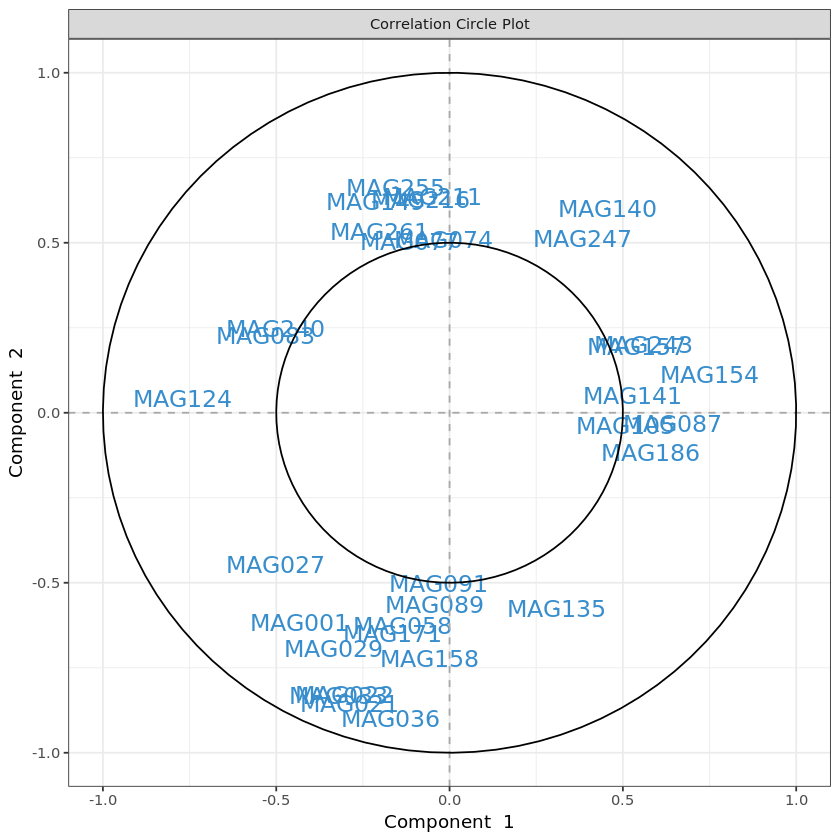

In [84]:
# plot feature correlation
plotVar(final.splsda.mag.F1, cutoff=0.5)
mag.F1.corr <- as.data.frame(plotVar(final.splsda.mag.F1, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
mag.F1.corr <- mag.F1.corr[, c("x","y")]
colnames(mag.F1.corr) <- c("corr_comp1","corr_comp2")

In [364]:
# Calculate feature stability
perf.splsda.mag.F1 <- perf(final.splsda.mag.F1, 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F1.mag.stab <- merge(data.frame(perf.splsda.mag.F1$features$stable$comp1), 
                  data.frame(perf.splsda.mag.F1$features$stable$comp2), by="Var1", all=T)
rownames(F1.mag.stab) <- F1.mag.stab$Var1
F1.mag.stab <- F1.mag.stab[, c("Freq.x","Freq.y")]
colnames(F1.mag.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [420]:
# merge feature output
F1.mag.out <- merge(F1.mag.load, F1.mag.stab, by="row.names")
rownames(F1.mag.out) <- F1.mag.out[,"Row.names"]
F1.mag.out <- merge(F1.mag.out[, 2:ncol(F1.mag.out)], mag.F1.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F1.features.tsv", F1.mag.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [87]:
train <- sample(1:nrow(X.mag.F1), ceiling(nrow(X.mag.F1)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.mag.F1), train) # rest is part of the test set

# store matrices into training and test set:
X.mag.F1.train <- X.mag.F1[train, ]
X.mag.F1.test <- X.mag.F1[test,]
Y.mag.F1.train <- info[train,"treatment"]
Y.mag.F1.test <- info[test, "treatment"]
train.splsda.mag.F1 <- splsda(X.mag.F1.train, Y.mag.F1.train, ncomp = mag.F1$optimal.ncomp, keepX = mag.F1$optimal.keepX)
predict.splsda.mag.F1 <- predict(train.splsda.mag.F1, X.mag.F1.test, 
                                dist = "max.dist")
predict.comp2.mag.F1 <- predict.splsda.mag.F1$class$max.dist[,2]
table(factor(predict.comp2.mag.F1, levels = levels(mag.F1$treatment)), Y.mag.F1.test)

   Y.mag.F1.test
    C H L
  C 0 0 0
  H 2 1 0
  L 2 6 3

$Comp1
                 AUC   p-value
C vs Other(s) 1.0000 0.0003857
H vs Other(s) 0.9881 0.0005300
L vs Other(s) 0.5143 0.9262000

$Comp2
              AUC   p-value
C vs Other(s)   1 0.0003857
H vs Other(s)   1 0.0003857
L vs Other(s)   1 0.0011940



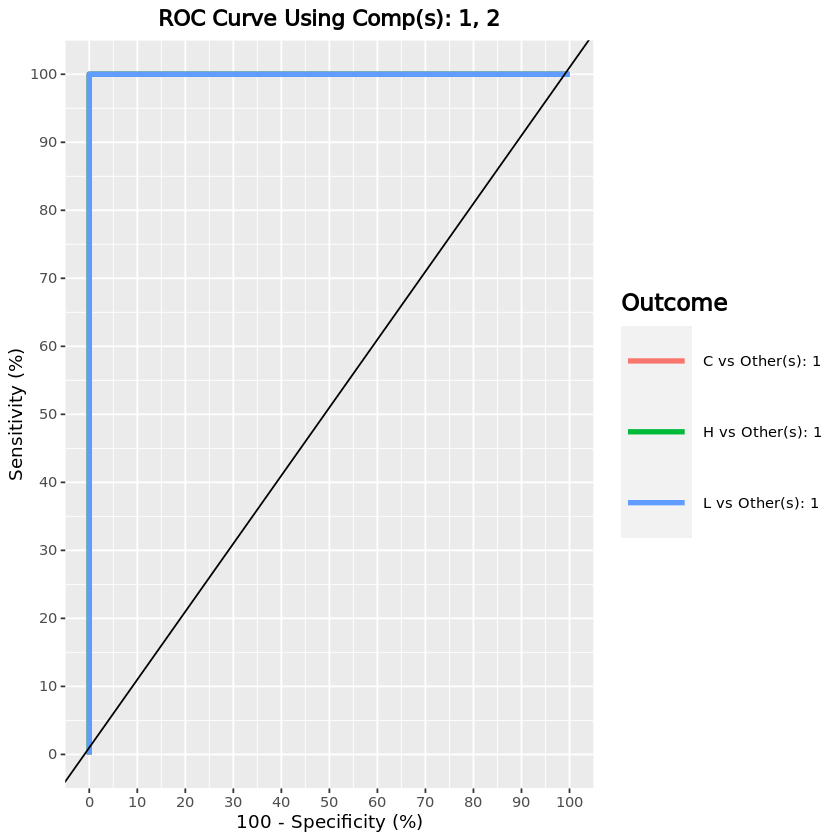

In [90]:
F1.mag.auc.splsda = auroc(final.splsda.mag.F1, roc.comp = 2, print = T) # AUROC for the first component

#### MAGs - F1 generation (C vs L+H)

What if we instead compare C against a combined set of L + H?

In [91]:
mag.F1_2 <- list()
F1_info_2 <- info[rownames(mag.F1$cov),]
F1_info_2$treatment <- gsub(x = F1_info_2$Treatment, pattern = "[HL]", replacement = "L+H")
mag.F1_2$cov <- mag.F1$cov[rownames(F1_info_2),]
mag.F1_2$filtered <- mag.F1$filtered[rownames(F1_info_2),]

mag.F1_2$clr <- mag.F1$clr[rownames(F1_info_2), ]
X.mag.F1_2 <- mag.F1_2$clr

mag.F1_2$treatment <- factor(F1_info_2[rownames(mag.F1_2$clr), "treatment"])

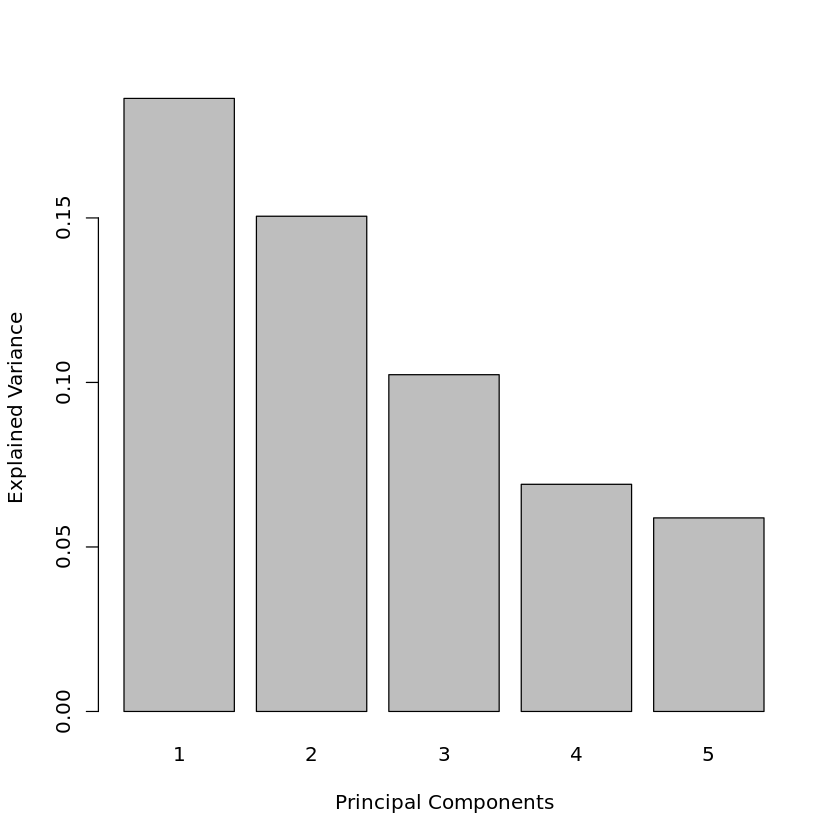

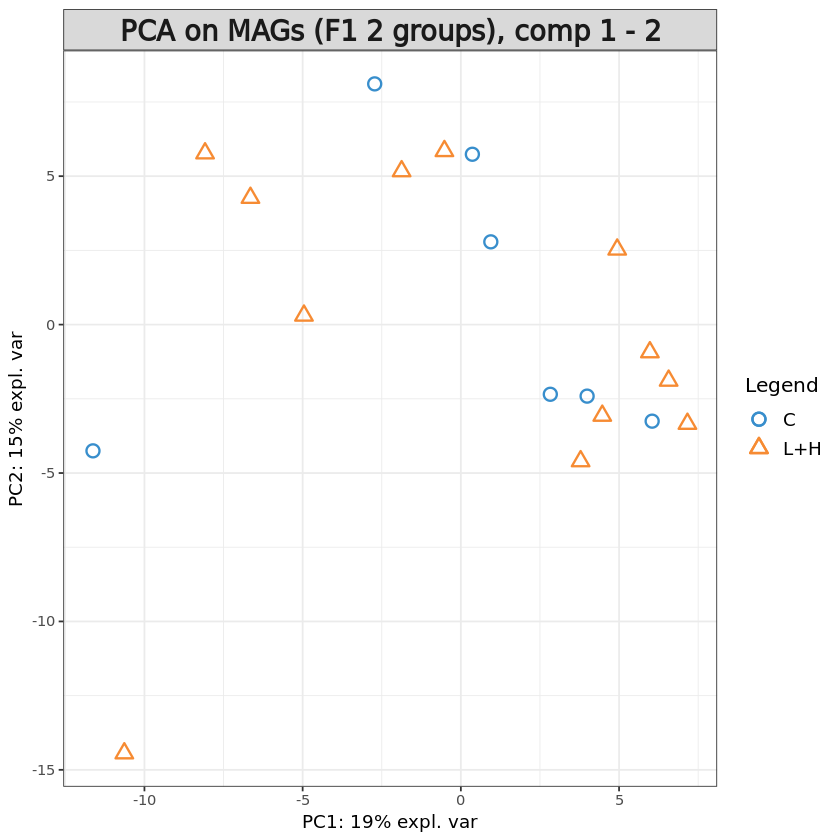

In [92]:
pca.mag.F1_2 = pca(X.mag.F1_2, ncomp = 5, center = TRUE, scale = TRUE) 

plot(pca.mag.F1_2)
plotIndiv(pca.mag.F1_2, group = mag.F1_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on MAGs (F1 2 groups), comp 1 - 2')

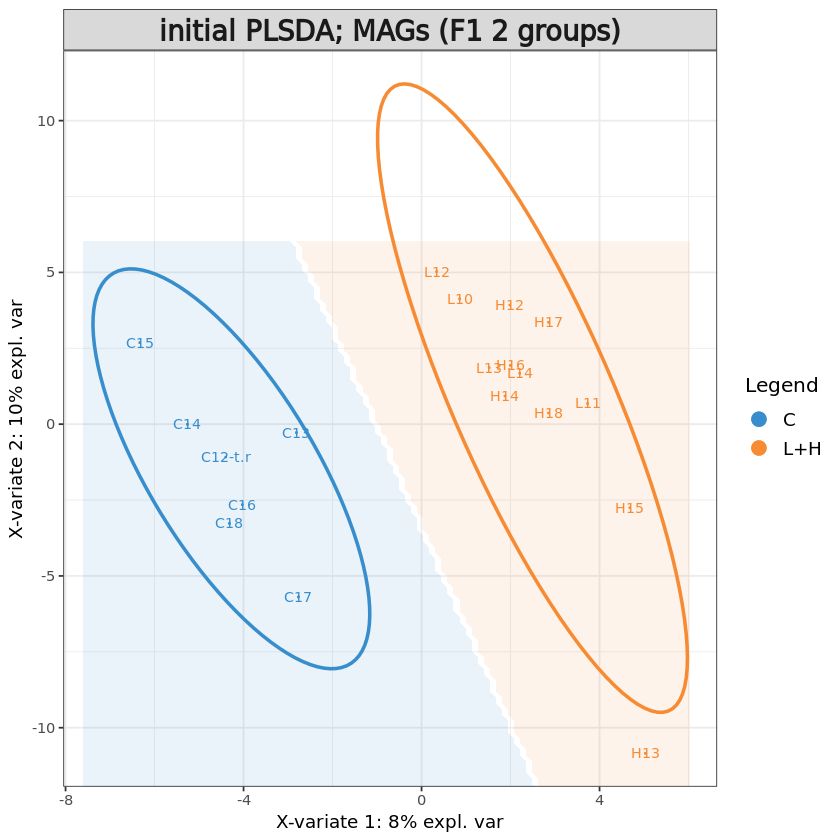

In [93]:
# Initial sPLS-DA model
mag.F1_2.splsda <- splsda(X.mag.F1_2, mag.F1_2$treatment, ncomp = 5)  # set ncomp to 10 for performance assessment later

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(mag.F1_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(mag.F1_2.splsda, comp = 1:2, ellipse = TRUE,
          group = mag.F1_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; MAGs (F1 2 groups)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,2,2,2
BER,2,2,2


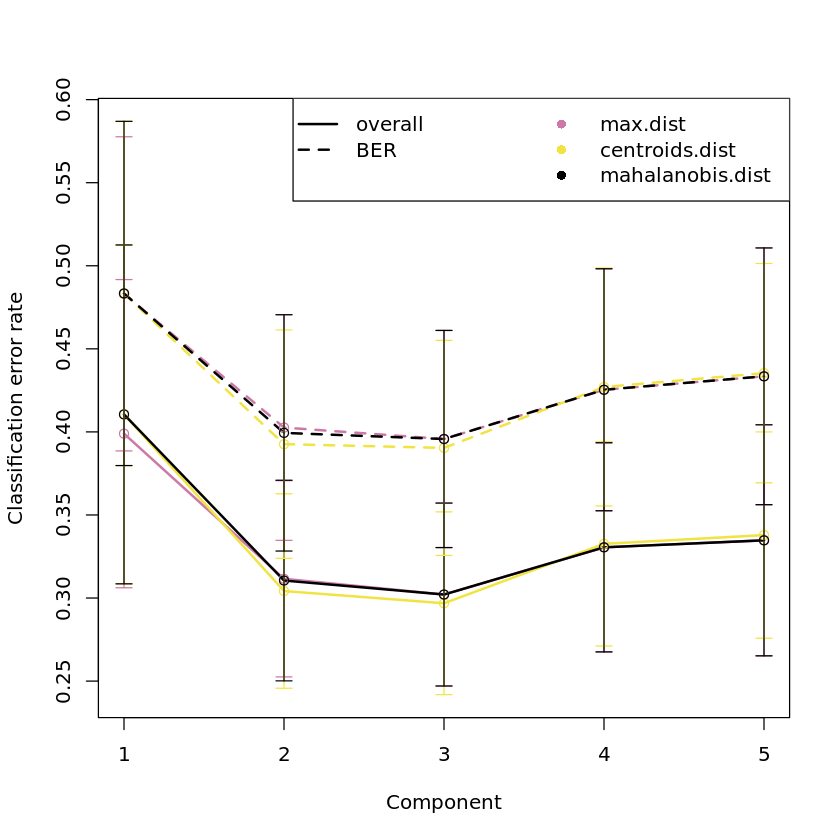

In [66]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.mag.F1_2 <- perf(mag.F1_2.splsda, validation = "Mfold", 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.mag.F1_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.mag.F1_2$choice.ncomp # what is the optimal value of components according to perf()

This shows a lower error rate.

In [67]:
# Define parameters for tuning keepX
mag.F1_2.step <- 0.05
mag.F1_2.ncomp.tune <- 2
# grid of possible keepX values that will be tested for each component
mag.F1_2.keepx <- c(seq(ceiling(dim(mag.F1_2$filtered)[2] * mag.F1_2.step), 
                      round(dim(mag.F1_2$filtered)[2], digits = -1), 
                      ceiling(dim(mag.F1_2$filtered)[2] * mag.F1_2.step)
                     )
                 )
mag.F1_2.keepx

[1]  10  20  30  40  50  60  70  80  90 100 110 120 130 140 150 160 170 180 190

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


[1] 1

comp1 comp2 
   10   110

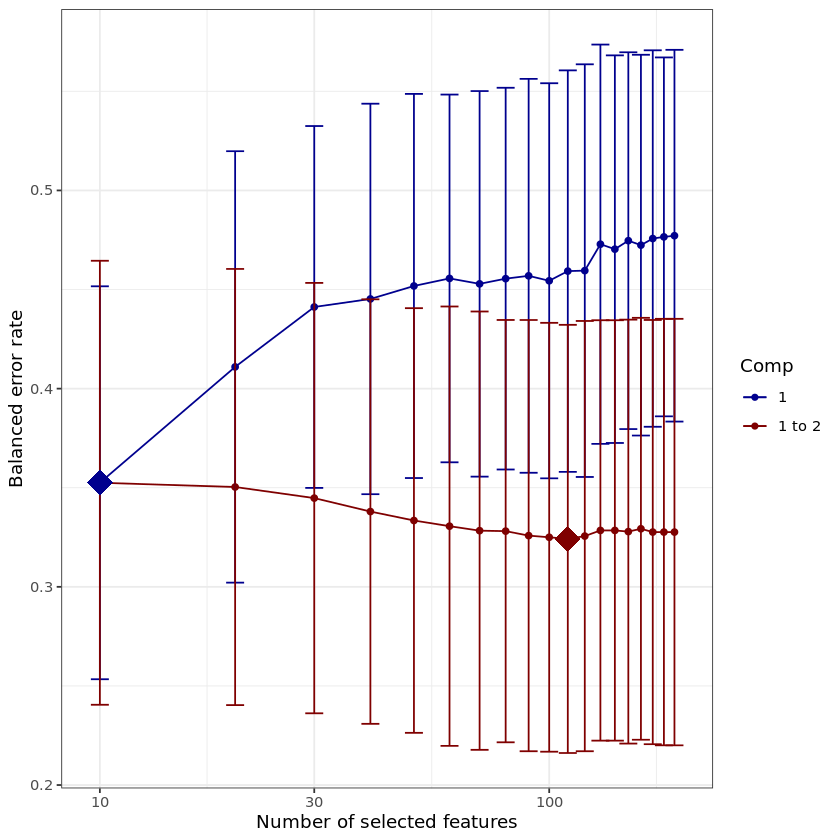

In [68]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.mag.F1_2 <- tune.splsda(X.mag.F1_2, mag.F1_2$treatment, ncomp = mag.F1_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = mag.F1_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.mag.F1_2, col = color.jet(mag.F1_2.ncomp.tune))

tune.splsda.mag.F1_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.mag.F1_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

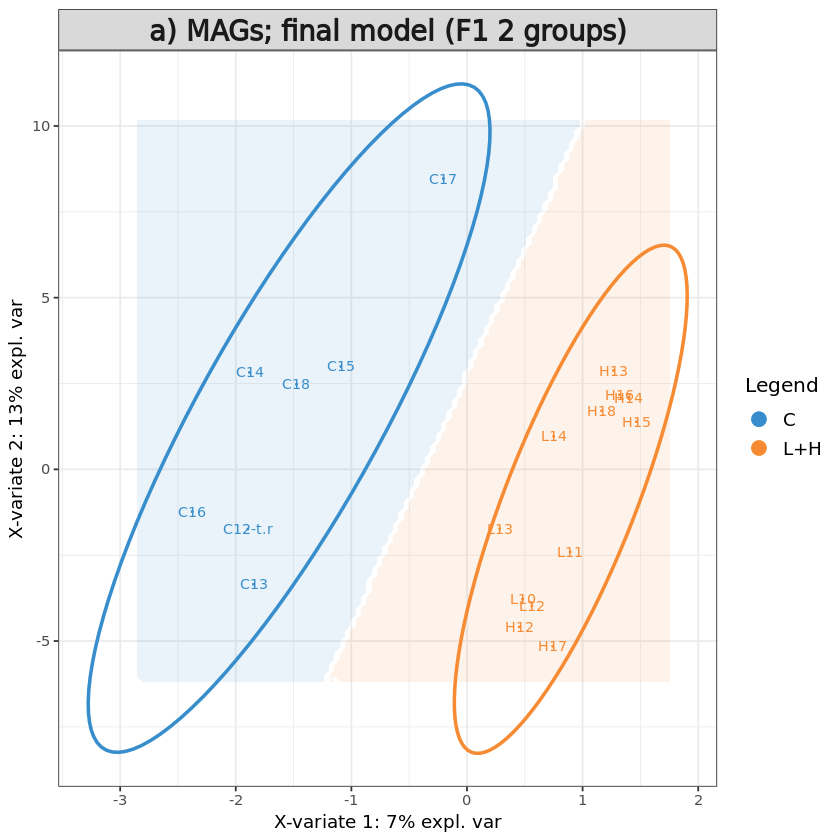

In [94]:
# Define final model
mag.F1_2$optimal.ncomp <- 2
#mag.F1_2$optimal.keepX <- tune.splsda.mag.F1_2$choice.keepX[1:mag.F1_2$optimal.ncomp]
#mag.F1_2$optimal.keepX <- rep(50, mag.F1_2$optimal.ncomp)
mag.F1_2$optimal.keepX <- c(10, 50)

# form final model with optimised values for component, using all features
final.splsda.mag.F1_2 <- splsda(X.mag.F1_2, mag.F1_2$treatment, 
                       ncomp = mag.F1_2$optimal.ncomp, 
                       keepX = mag.F1_2$optimal.keepX)

background = background.predict(final.splsda.mag.F1_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.mag.F1_2, comp = 1:2, 
          group = mag.F1_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) MAGs; final model (F1 2 groups)')

# save sample variates
data <- as.data.frame(final.splsda.mag.F1$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F1_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

Here there's a clear separation between C and H+L

In [95]:
mag.F1_2_names <- mag_tax[colnames(final.splsda.mag.F1_2$X),c("phylum", "family", "species")]
mag.F1_2_names$names <- paste0(rownames(mag.F1_2_names)," (", mag.F1_2_names$family, "; ", mag.F1_2_names$species, ")")

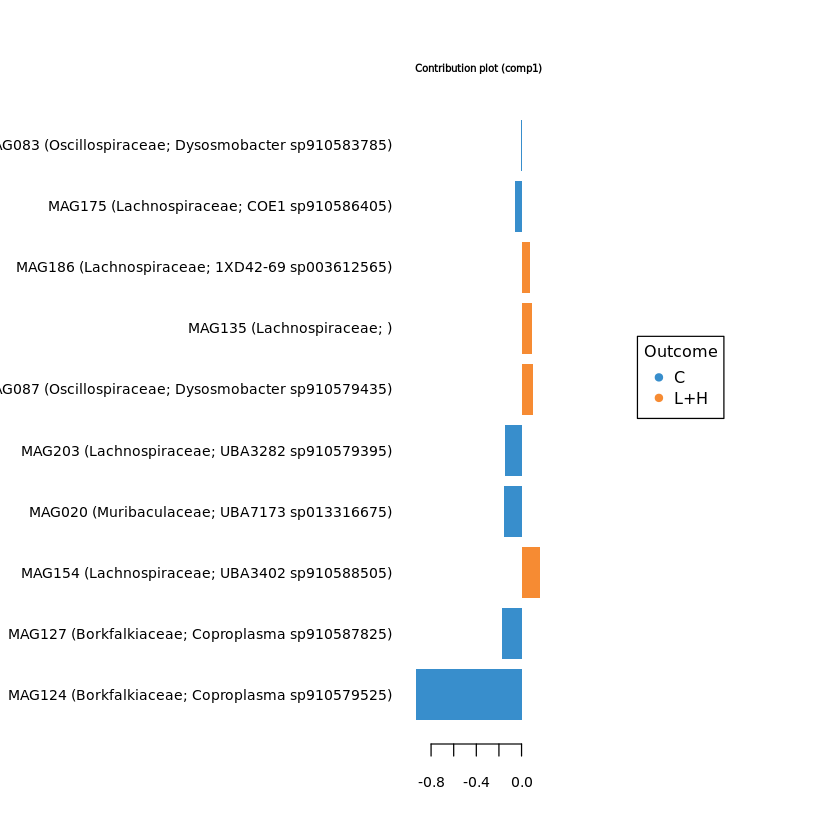

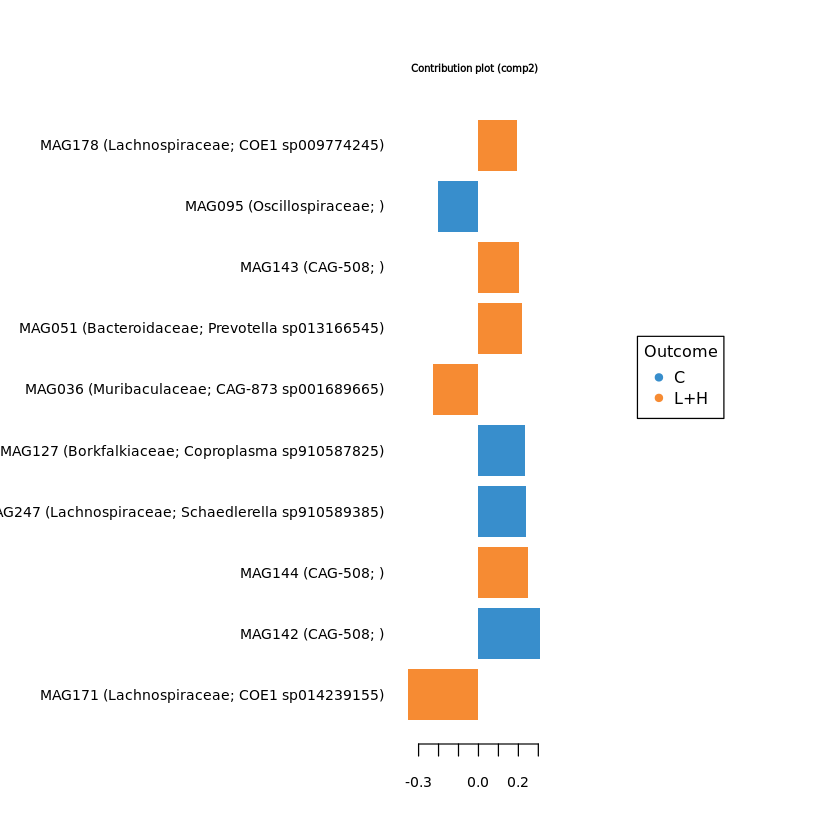

In [96]:
#plotVar(final.splsda.mag.F1_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.mag.F1_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = mag.F1_2_names$names)
plotLoadings(final.splsda.mag.F1_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = mag.F1_2_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.mag.F1_2, comp=1)$value
load_comp2 = selectVar(final.splsda.mag.F1_2, comp=2)$value
F1_2.mag.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F1_2.mag.load) <- F1_2.mag.load[,"Row.names"]
colnames(F1_2.mag.load) <- c("ft","loading_comp1","loading_comp2")
F1_2.mag.load = F1_2.mag.load[,c("loading_comp1","loading_comp2")]

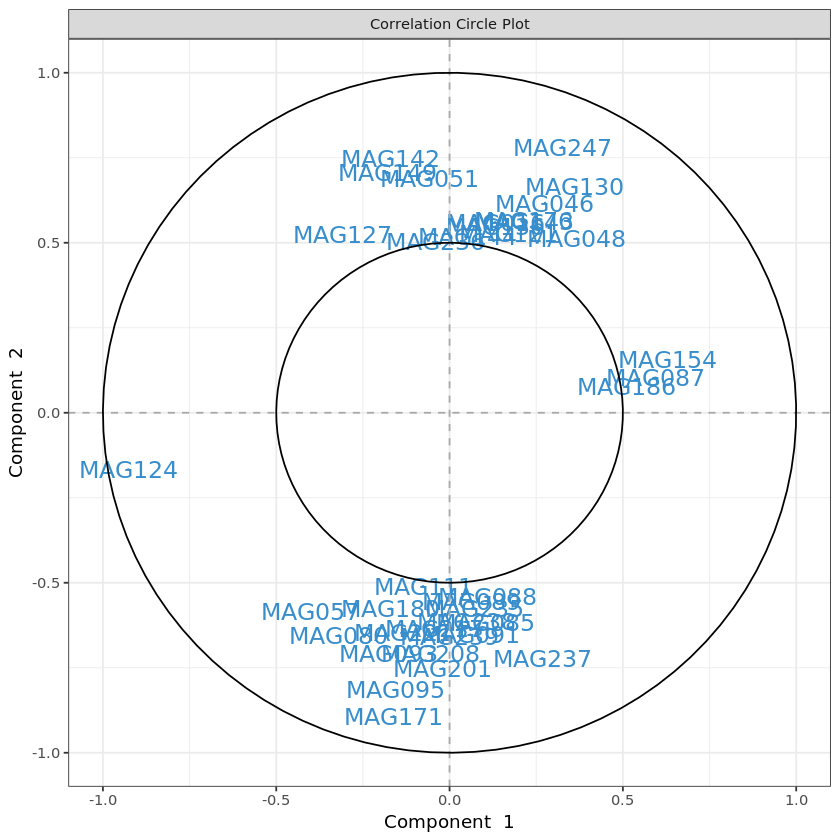

In [97]:
# plot feature correlation
plotVar(final.splsda.mag.F1_2, cutoff=0.5)
mag.F1_2.corr <- as.data.frame(plotVar(final.splsda.mag.F1_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
mag.F1_2.corr <- mag.F1_2.corr[, c("x","y")]
colnames(mag.F1_2.corr) <- c("corr_comp1","corr_comp2")

In [378]:
# Calculate feature stability
perf.splsda.mag.F1_2 <- perf(final.splsda.mag.F1_2, 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F1_2.mag.stab <- merge(data.frame(perf.splsda.mag.F1_2$features$stable$comp1), 
                  data.frame(perf.splsda.mag.F1_2$features$stable$comp2), by="Var1", all=T)
rownames(F1_2.mag.stab) <- F1_2.mag.stab$Var1
F1_2.mag.stab <- F1_2.mag.stab[, c("Freq.x","Freq.y")]
colnames(F1_2.mag.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [423]:
# merge feature output
F1_2.mag.out <- merge(F1_2.mag.load, F1_2.mag.stab, by="row.names")
rownames(F1_2.mag.out) <- F1_2.mag.out[,"Row.names"]
F1_2.mag.out <- merge(F1_2.mag.out[, 2:ncol(F1_2.mag.out)], mag.F1_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F1_2.features.tsv", F1_2.mag.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [100]:
train <- sample(1:nrow(X.mag.F1_2), ceiling(nrow(X.mag.F1_2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.mag.F1_2), train) # rest is part of the test set

# store matrices into training and test set:
X.mag.F1_2.train <- X.mag.F1_2[train, ]
X.mag.F1_2.test <- X.mag.F1_2[test,]
Y.mag.F1_2.train <- F1_info_2[train,"treatment"]
Y.mag.F1_2.test <- F1_info_2[test, "treatment"]
train.splsda.mag.F1_2 <- splsda(X.mag.F1_2.train, Y.mag.F1_2.train, ncomp = mag.F1_2$optimal.ncomp, keepX = mag.F1_2$optimal.keepX)
predict.splsda.mag.F1_2 <- predict(train.splsda.mag.F1_2, X.mag.F1_2.test, 
                                dist = "max.dist")
predict.comp2.mag.F1_2 <- predict.splsda.mag.F1_2$class$max.dist[,2]
table(factor(predict.comp2.mag.F1_2, levels = levels(mag.F1_2$treatment)), Y.mag.F1_2.test)

     Y.mag.F1_2.test
      C L+H
  C   1   6
  L+H 4   3

$Comp1
         AUC   p-value
C vs L+H   1 0.0003857

$Comp2
         AUC   p-value
C vs L+H   1 0.0003857



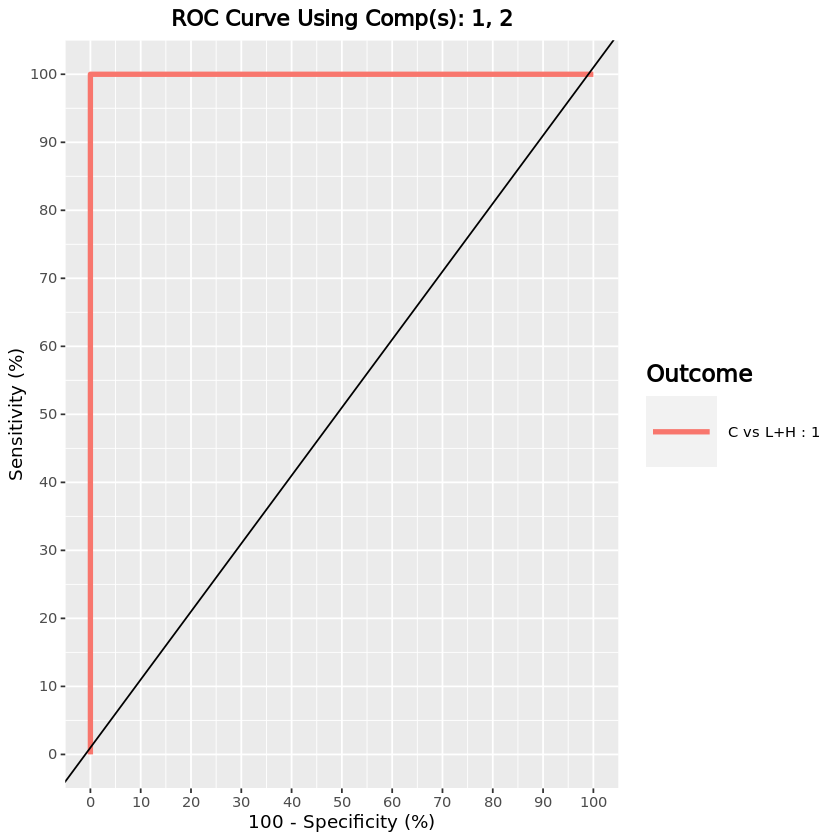

In [101]:
F1_2.mag.auc.splsda = auroc(final.splsda.mag.F1_2, roc.comp = 2, print = T) # AUROC for the first component

#### MAGs - F1 generation (C+L vs H)

In [102]:
mag.F1_3 <- list()
F1_info_3 <- info[rownames(mag.F1$cov),]
F1_info_3$treatment <- gsub(x = F1_info_3$Treatment, pattern = "[CL]", replacement = "C+L")
mag.F1_3$cov <- mag.F1$cov[rownames(F1_info_3),]
mag.F1_3$filtered <- mag.F1$filtered[rownames(F1_info_3),]

mag.F1_3$clr <- mag.F1$clr[rownames(F1_info_3), ]
X.mag.F1_3 <- mag.F1_3$clr

mag.F1_3$treatment <- factor(F1_info_3[rownames(mag.F1_3$clr), "treatment"])

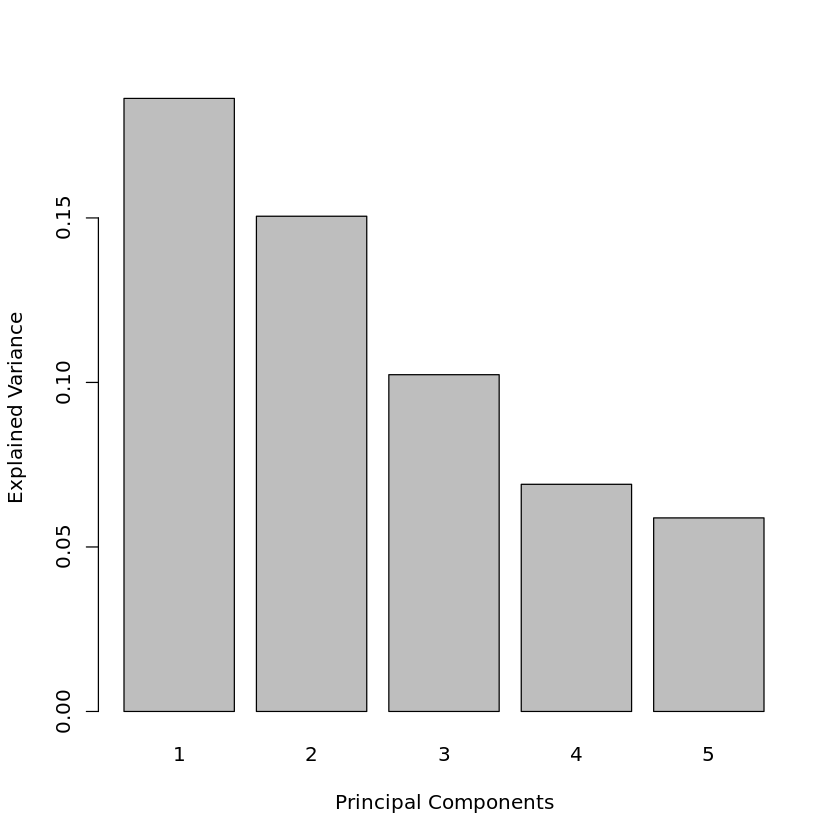

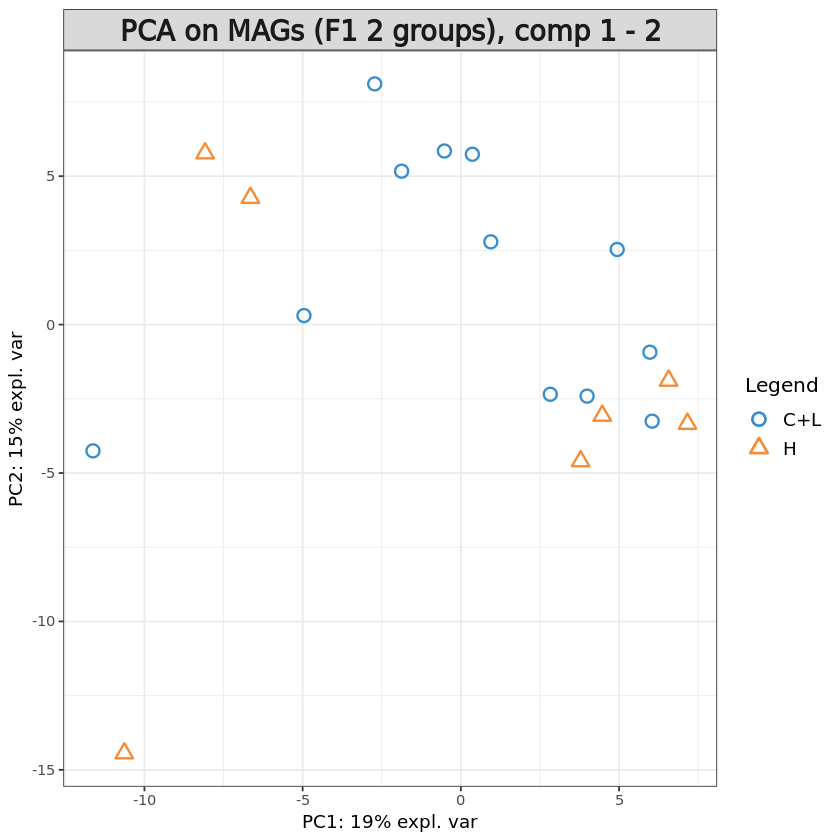

In [103]:
pca.mag.F1_3 = pca(X.mag.F1_3, ncomp = 5, center = TRUE, scale = TRUE) 

plot(pca.mag.F1_3)
plotIndiv(pca.mag.F1_3, group = mag.F1_3$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on MAGs (F1 2 groups), comp 1 - 2')

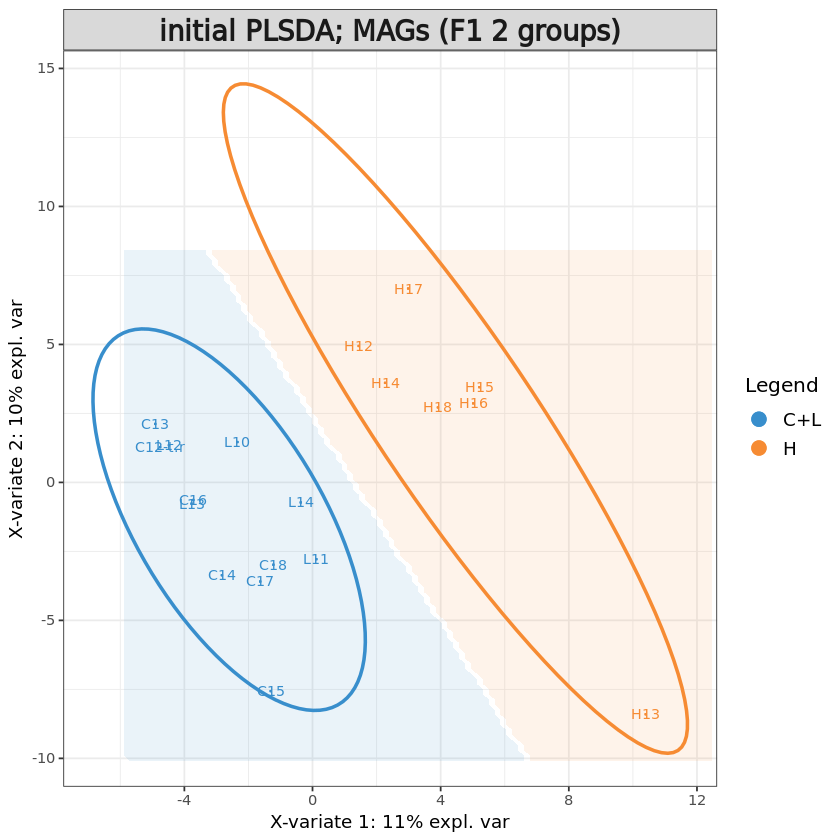

In [104]:
# Initial sPLS-DA model
mag.F1_3.splsda <- splsda(X.mag.F1_3, mag.F1_3$treatment, ncomp = 5)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(mag.F1_3.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(mag.F1_3.splsda, comp = 1:2, ellipse = TRUE,
          group = mag.F1_3$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; MAGs (F1 2 groups)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,3,3,3
BER,3,3,3


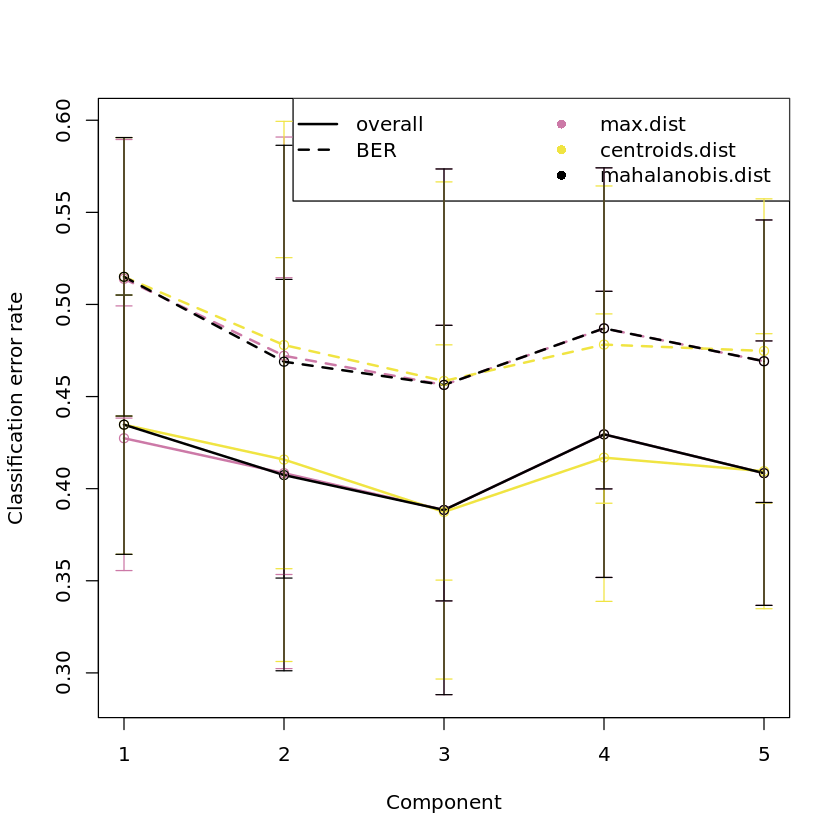

In [89]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.mag.F1_3 <- perf(mag.F1_3.splsda, validation = "Mfold", 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.mag.F1_3, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.mag.F1_3$choice.ncomp # what is the optimal value of components according to perf()

This shows a lower error rate, however still not great.

In [90]:
# Define parameters for tuning keepX
mag.F1_3.step <- 0.05
mag.F1_3.ncomp.tune <- 3
# grid of possible keepX values that will be tested for each component
mag.F1_3.keepx <- c(seq(ceiling(dim(mag.F1_3$filtered)[2] * mag.F1_3.step), 
                      round(dim(mag.F1_3$filtered)[2], digits = -1), 
                      ceiling(dim(mag.F1_3$filtered)[2] * mag.F1_3.step)
                     )
                 )
mag.F1_3.keepx

[1]  10  20  30  40  50  60  70  80  90 100 110 120 130 140 150 160 170 180 190

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


[1] 2

comp1 comp2 comp3 
   10   190    50

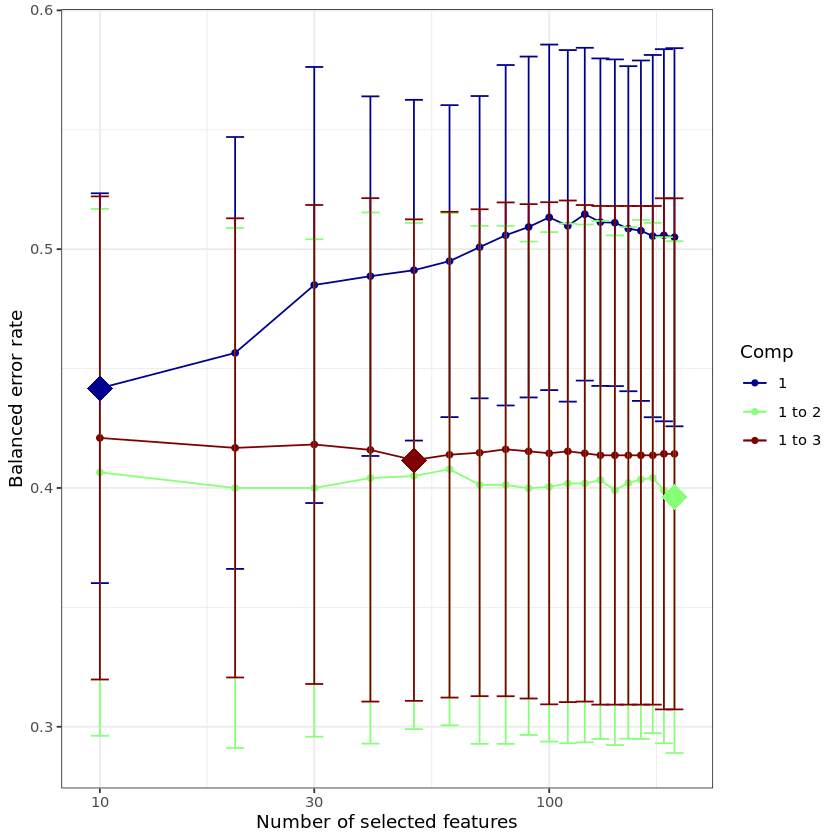

In [91]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.mag.F1_3 <- tune.splsda(X.mag.F1_3, mag.F1_3$treatment, ncomp = mag.F1_3.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = mag.F1_3.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.mag.F1_3, col = color.jet(mag.F1_3.ncomp.tune))

tune.splsda.mag.F1_3$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.mag.F1_3$choice.keepX # what are the optimal values of variables according to tune.splsda()

Tuning suggests to use 10 and 190 features. As before there's no clear drop in error rate however and the standard deviation of the model is very high.

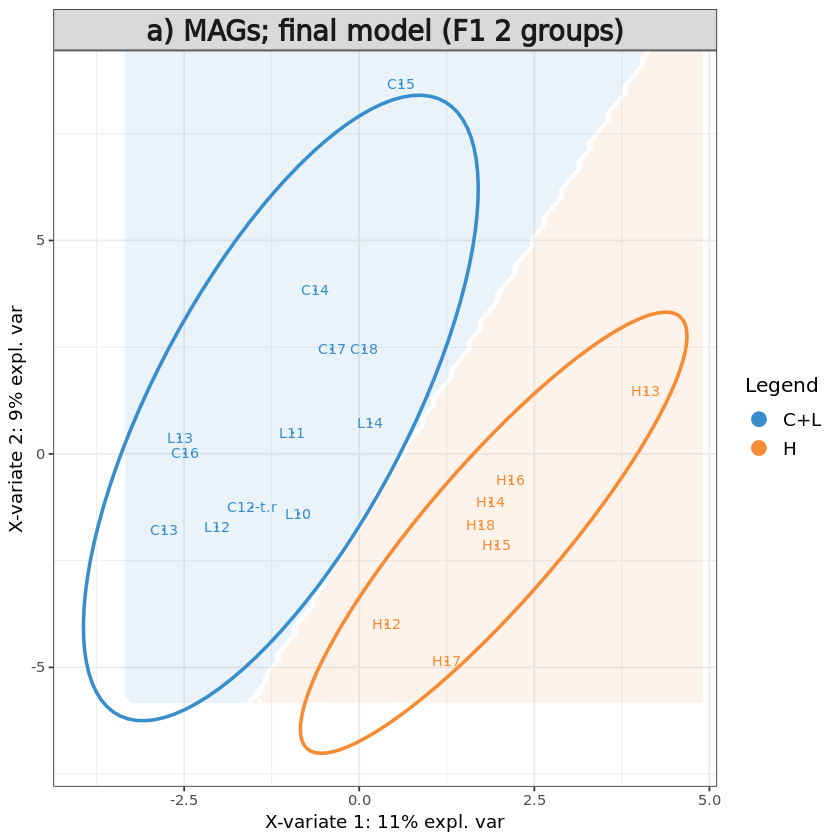

In [105]:
# Define final model
mag.F1_3$optimal.ncomp <- 2
#mag.F1_3$optimal.keepX <- tune.splsda.mag.F1_3$choice.keepX[1:mag.F1_3$optimal.ncomp]
#mag.F1_3$optimal.keepX <- rep(50, mag.F1_3$optimal.ncomp)
mag.F1_3$optimal.keepX <- c(10, 50)

# form final model with optimised values for component, using all features
final.splsda.mag.F1_3 <- splsda(X.mag.F1_3, mag.F1_3$treatment, 
                       ncomp = mag.F1_3$optimal.ncomp, 
                       keepX = mag.F1_3$optimal.keepX)

background = background.predict(final.splsda.mag.F1_3, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.mag.F1_3, comp = 1:2, 
          group = mag.F1_3$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) MAGs; final model (F1 2 groups)')

# save sample variates
data <- as.data.frame(final.splsda.mag.F1$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F1_3.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

Here there's a clear separation between C+L and H.

In [106]:
mag.F1_3_names <- mag_tax[colnames(final.splsda.mag.F1_3$X),c("phylum", "family", "species")]
mag.F1_3_names$names <- paste0(rownames(mag.F1_3_names)," (", mag.F1_3_names$family, "; ", mag.F1_3_names$species, ")")

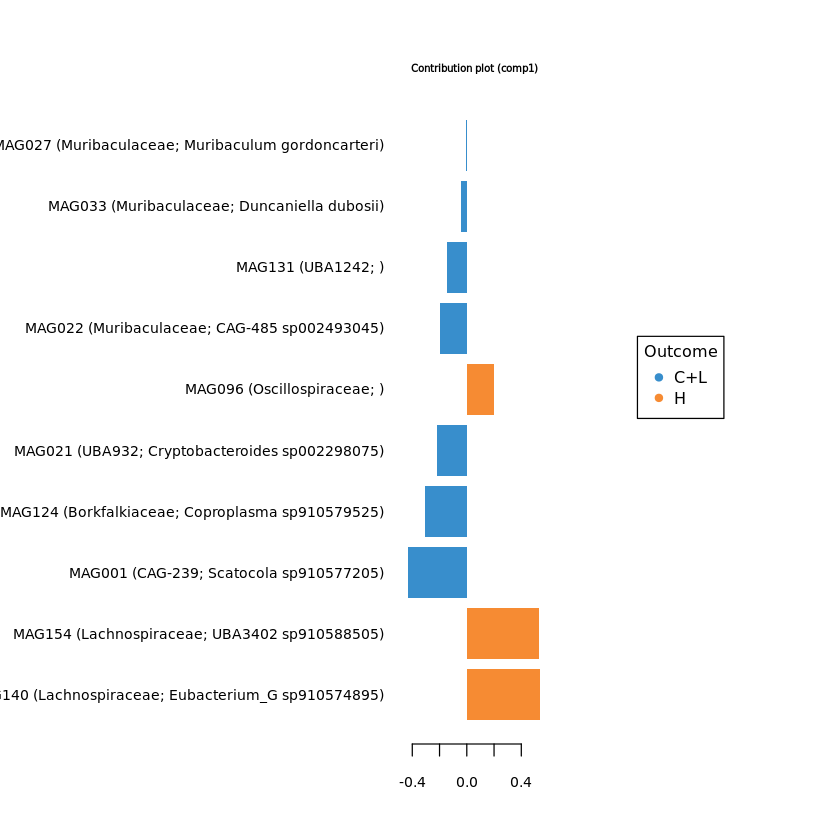

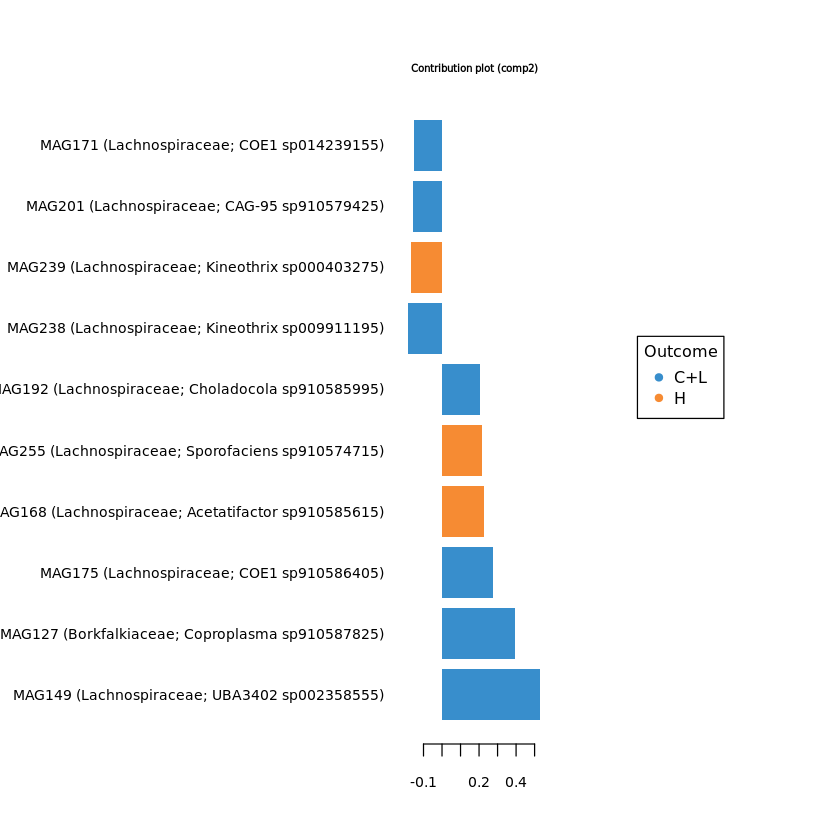

In [107]:
#plotVar(final.splsda.mag.F1_3, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.mag.F1_3, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = mag.F1_3_names$names)
plotLoadings(final.splsda.mag.F1_3, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = mag.F1_3_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.mag.F1_3, comp=1)$value
load_comp2 = selectVar(final.splsda.mag.F1_3, comp=2)$value
F1_3.mag.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F1_3.mag.load) <- F1_3.mag.load[,"Row.names"]
colnames(F1_3.mag.load) <- c("ft","loading_comp1","loading_comp2")
F1_3.mag.load = F1_3.mag.load[,c("loading_comp1","loading_comp2")]

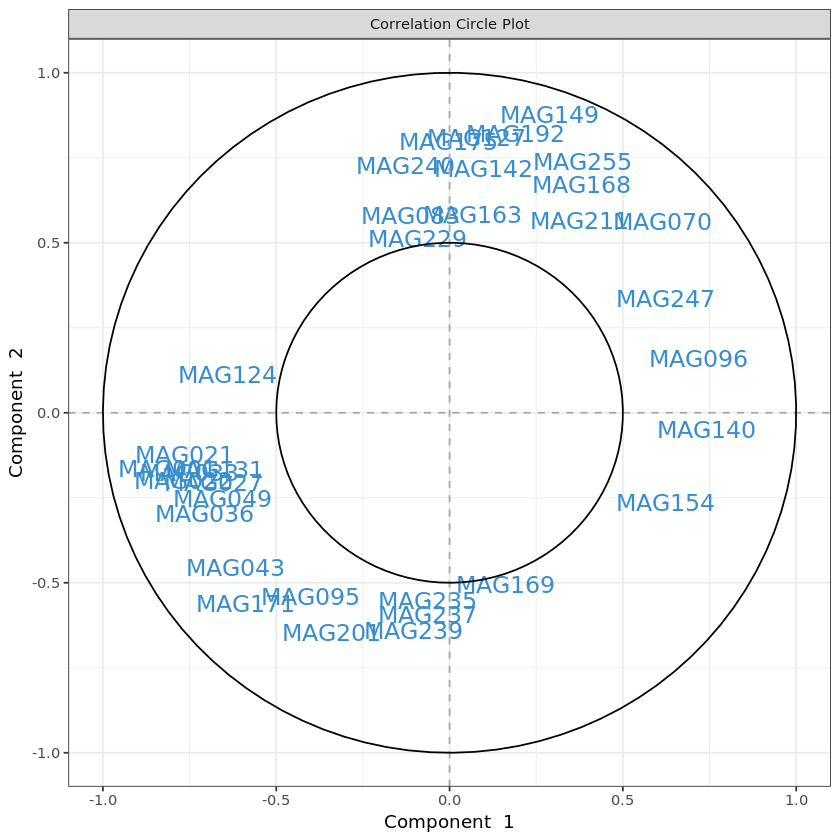

In [108]:
# plot feature correlation
plotVar(final.splsda.mag.F1_3, cutoff=0.5)
mag.F1_3.corr <- as.data.frame(plotVar(final.splsda.mag.F1_3, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
mag.F1_3.corr <- mag.F1_3.corr[, c("x","y")]
colnames(mag.F1_3.corr) <- c("corr_comp1","corr_comp2")

In [109]:
# Calculate feature stability
perf.splsda.mag.F1_3 <- perf(final.splsda.mag.F1_3, 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F1_3.mag.stab <- merge(data.frame(perf.splsda.mag.F1_3$features$stable$comp1), 
                  data.frame(perf.splsda.mag.F1_3$features$stable$comp2), by="Var1", all=T)
rownames(F1_3.mag.stab) <- F1_3.mag.stab$Var1
F1_3.mag.stab <- F1_3.mag.stab[, c("Freq.x","Freq.y")]
colnames(F1_3.mag.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [424]:
# merge feature output
F1_3.mag.out <- merge(F1_3.mag.load, F1_3.mag.stab, by="row.names")
rownames(F1_3.mag.out) <- F1_3.mag.out[,"Row.names"]
F1_3.mag.out <- merge(F1_3.mag.out[, 2:ncol(F1_3.mag.out)], mag.F1_3.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F1_3.features.tsv", F1_3.mag.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

     Y.mag.F1_3.test
      C+L H
  C+L   5 4
  H     4 1

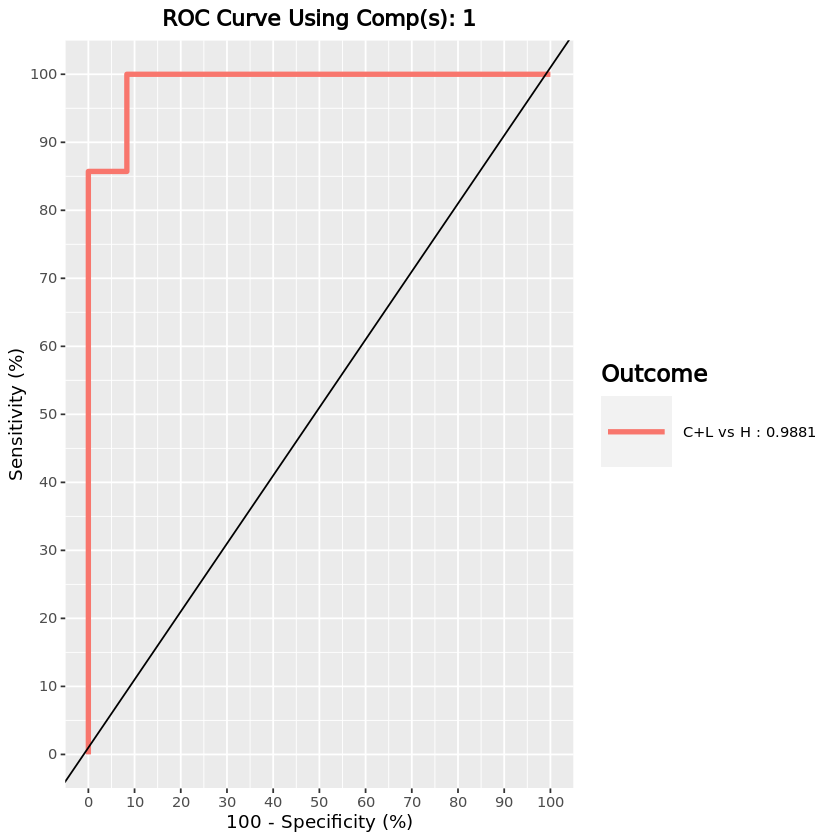

In [111]:
train <- sample(1:nrow(X.mag.F1_3), ceiling(nrow(X.mag.F1_3)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.mag.F1_3), train) # rest is part of the test set

# store matrices into training and test set:
X.mag.F1_3.train <- X.mag.F1_3[train, ]
X.mag.F1_3.test <- X.mag.F1_3[test,]
Y.mag.F1_3.train <- F1_info_3[train,"treatment"]
Y.mag.F1_3.test <- F1_info_3[test, "treatment"]
train.splsda.mag.F1_3 <- splsda(X.mag.F1_3.train, Y.mag.F1_3.train, ncomp = mag.F1_3$optimal.ncomp, keepX = mag.F1_3$optimal.keepX)
predict.splsda.mag.F1_3 <- predict(train.splsda.mag.F1_3, X.mag.F1_3.test, 
                                dist = "max.dist")
predict.comp2.mag.F1_3 <- predict.splsda.mag.F1_3$class$max.dist[,2]
table(factor(predict.comp2.mag.F1_3, levels = levels(mag.F1_3$treatment)), Y.mag.F1_3.test)
F1_3.mag.auc.splsda = auroc(final.splsda.mag.F1_3, roc.comp = 1, print = FALSE)

$Comp1
            AUC p-value
C+L vs H 0.9881 0.00053

$Comp2
         AUC   p-value
C+L vs H   1 0.0003857



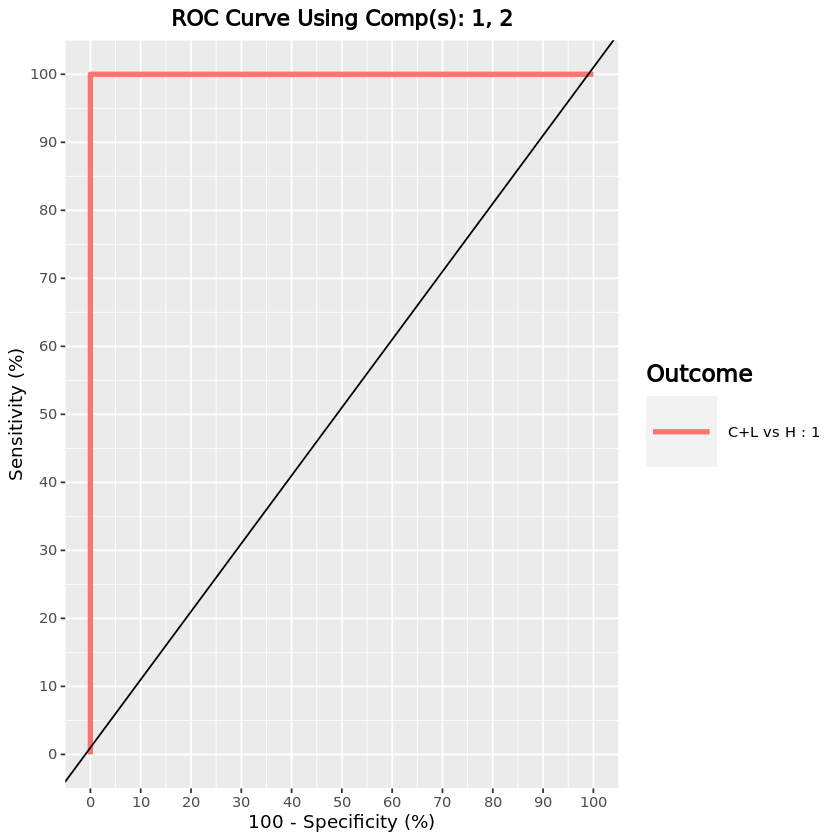

In [112]:
F1_3.mag.auc.splsda = auroc(final.splsda.mag.F1_3, roc.comp = 2, print = T) # AUROC for the first component

#### MAGs - F2 generation

[1] "50"           "MAGs removed" "212"          "remaining"

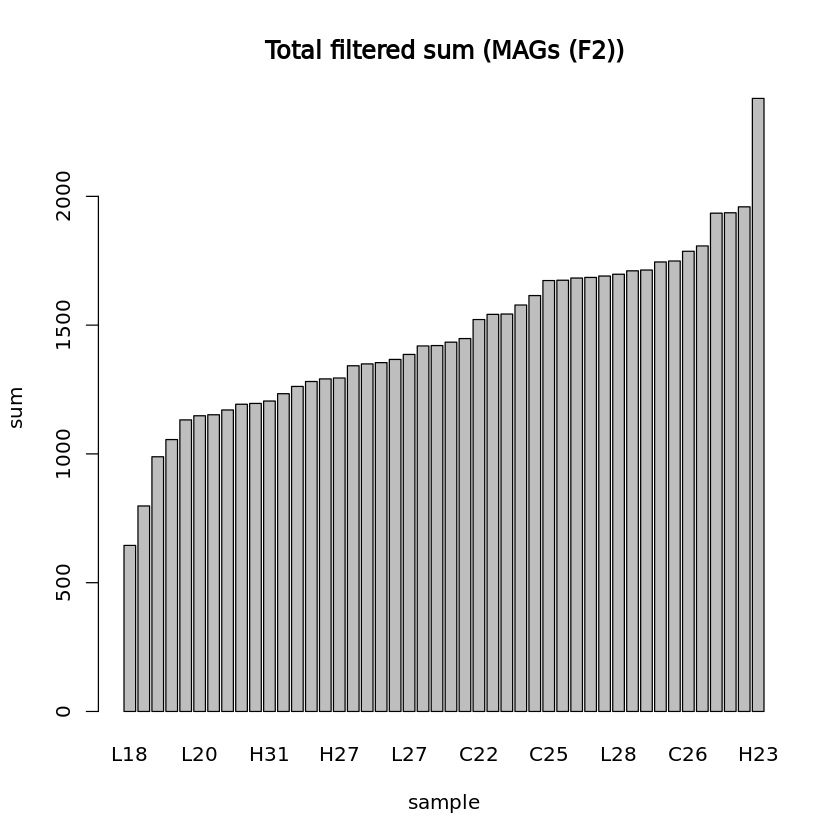

In [21]:
## PARAMS ##
# Initial components
mag.F2.ncomp <- 10
# Percentage of samples in which features must have >0 sum
mag.F2.percent_occ <- 10
# Quantile used for removing low abundance features
mag.F2.quantile_thresh <- 0.1
generation <- "F2"

mag.F2 <- list()
mag.F2$cov <- mag$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(mag.F2$cov[, colSums(mag.F2$cov) > 0])
mag.F2$nz <- mag.F2$cov[, colnames(mag.F2$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(mag.F2$nz) / sum(colSums(mag.F2$nz)) * 100, probs = mag.F2.quantile_thresh)
mag.F2$filtered <- low.count.removal(mag.F2$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
mag.F2$occ <- colSums(mag.F2$filtered>0) / nrow(mag.F2$filtered) * 100
# Keep features occurring in defined percentage of samples
mag.F2$filtered <- mag.F2$filtered[, which(mag.F2$occ >= mag.F2.percent_occ)]

#mag.F2$filtered <- mag.F2$filtered[,-nearZeroVar(mag.F2$filtered)$Position]
paste0(c(dim(mag.F2$cov)[2] - dim(mag.F2$filtered)[2], "MAGs removed", dim(mag.F2$filtered)[2], "remaining"))

# Add offset
mag.F2$offset <- mag.F2$filtered + 1
mag.F2$clr <- logratio.transfo(mag.F2$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.mag.F2 <- mag.F2$clr

mag.F2$treatment <- factor(info[rownames(mag.F2$clr), "Treatment"])

mag.F2.lib.size <- apply(mag.F2$filtered, 1, sum) # determine total count for each sample
barplot(sort(mag.F2.lib.size), main="Total filtered sum (MAGs (F2))", ylab="sum", xlab="sample")

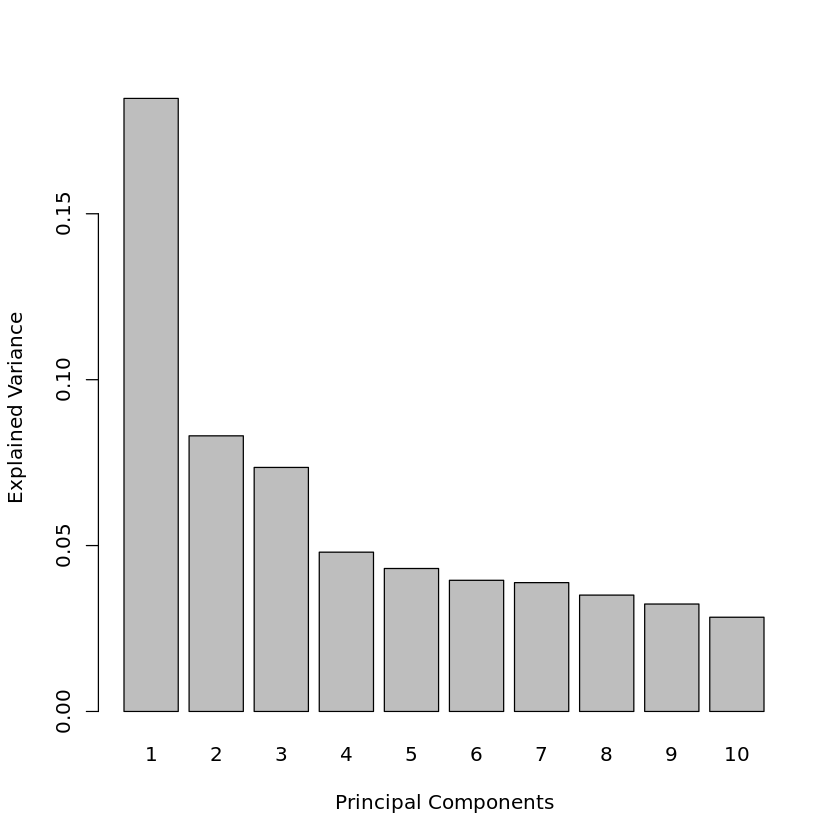

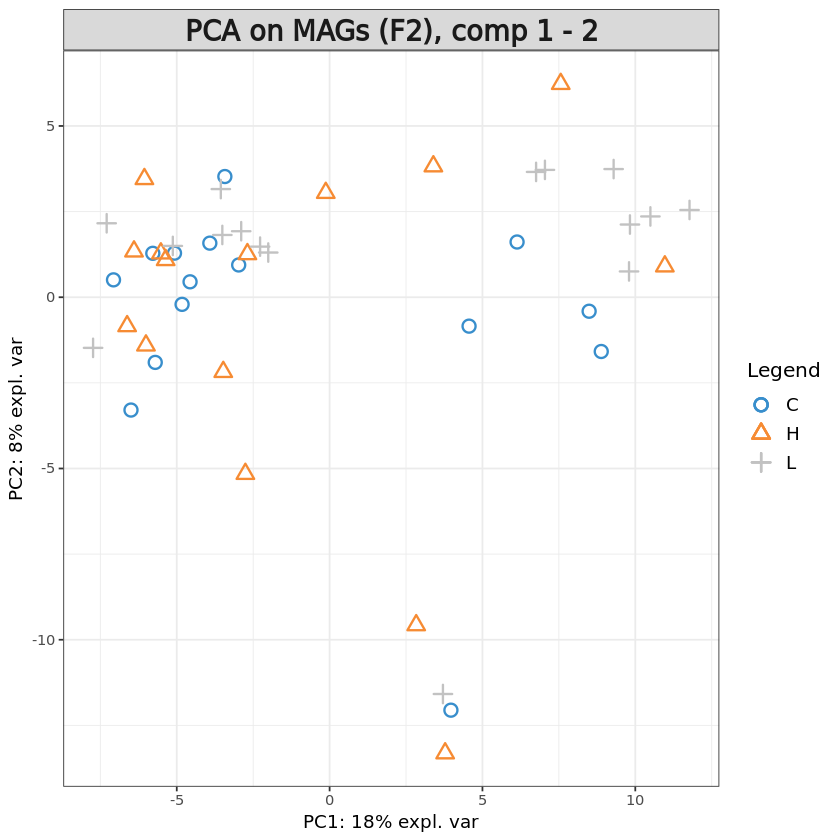

In [22]:
pca.mag.F2 = pca(X.mag.F2, ncomp = mag.F2.ncomp, center = TRUE, scale = TRUE) 

plot(pca.mag.F2)
plotIndiv(pca.mag.F2, group = mag.F2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on MAGs (F2), comp 1 - 2')

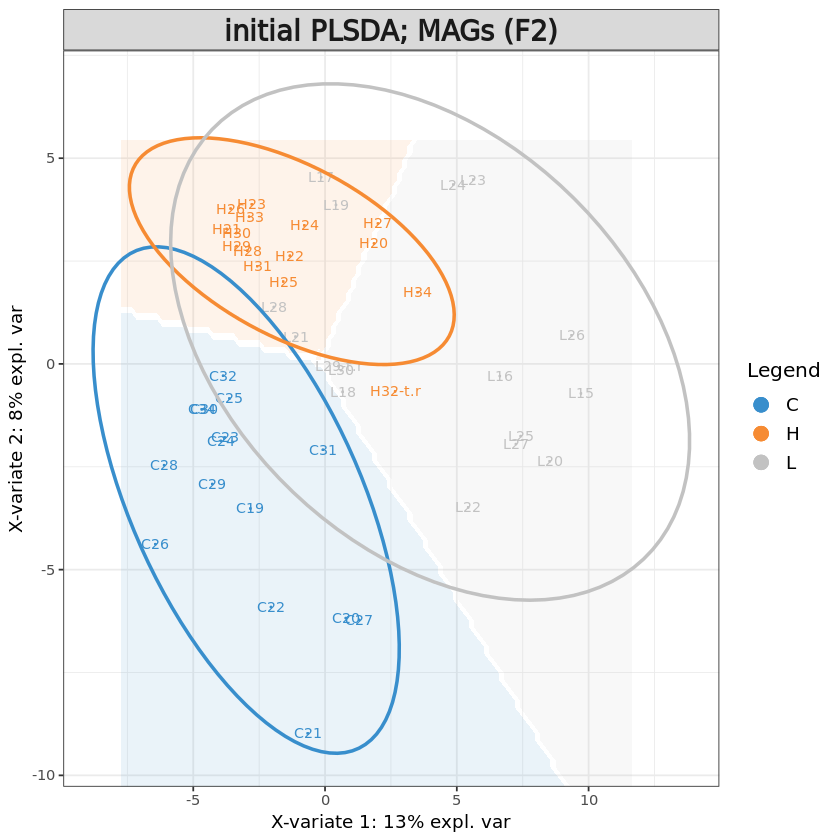

In [23]:
# Initial sPLS-DA model
mag.F2.splsda <- splsda(X.mag.F2, mag.F2$treatment, ncomp = mag.F2.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(mag.F2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(mag.F2.splsda, comp = 1:2, ellipse = TRUE,
          group = mag.F2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; MAGs (F2)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,4,6,6
BER,4,6,6


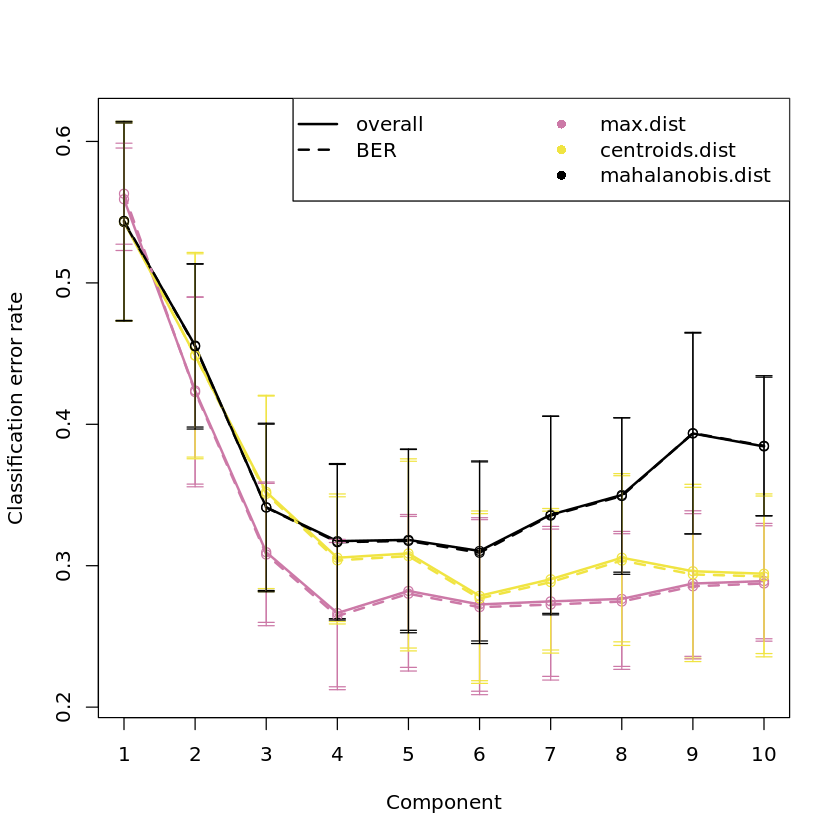

In [24]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.mag.F2 <- perf(mag.F2.splsda, validation = "Mfold", 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.mag.F2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.mag.F2$choice.ncomp # what is the optimal value of components according to perf()

In [25]:
# Define parameters for tuning keepX
mag.F2.step <- 0.05
mag.F2.ncomp.tune <- 4
# grid of possible keepX values that will be tested for each component
mag.F2.keepx <- c(seq(ceiling(dim(mag.F2$filtered)[2] * mag.F2.step), 
                      round(dim(mag.F2$filtered)[2], digits = -1), 
                      ceiling(dim(mag.F2$filtered)[2] * mag.F2.step)
                     )
                 )
mag.F2.keepx

[1]  11  22  33  44  55  66  77  88  99 110 121 132 143 154 165 176 187 198 209

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%


[1] 4

comp1 comp2 comp3 comp4 
   11   209   209   110

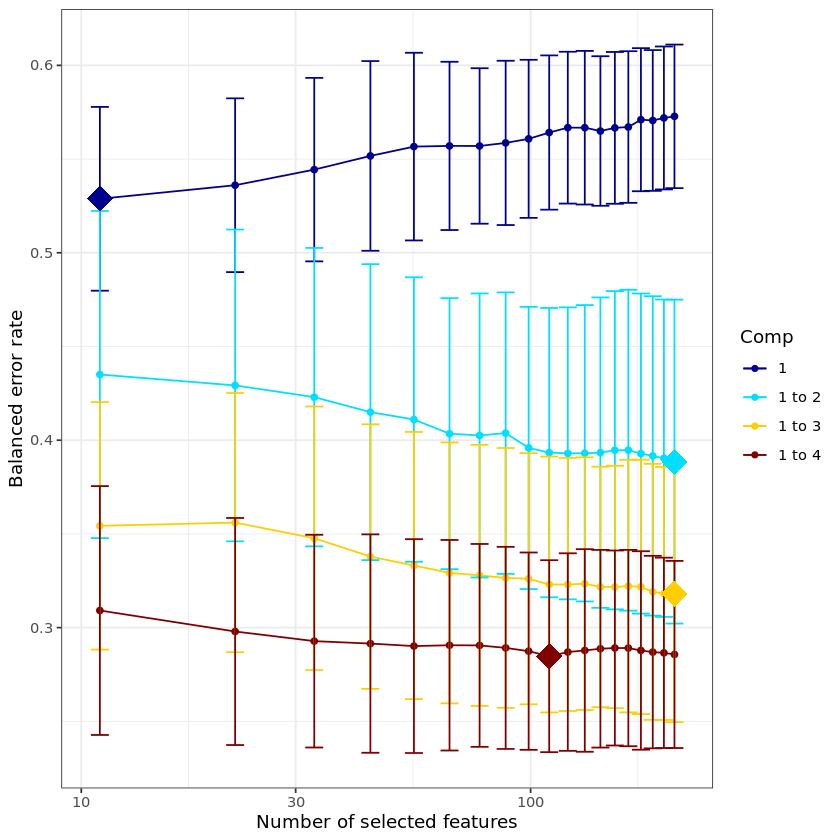

In [26]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.mag.F2 <- tune.splsda(X.mag.F2, mag.F2$treatment, ncomp = mag.F2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = mag.F2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.mag.F2, col = color.jet(mag.F2.ncomp.tune))

tune.splsda.mag.F2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.mag.F2$choice.keepX # what are the optimal values of variables according to tune.splsda()

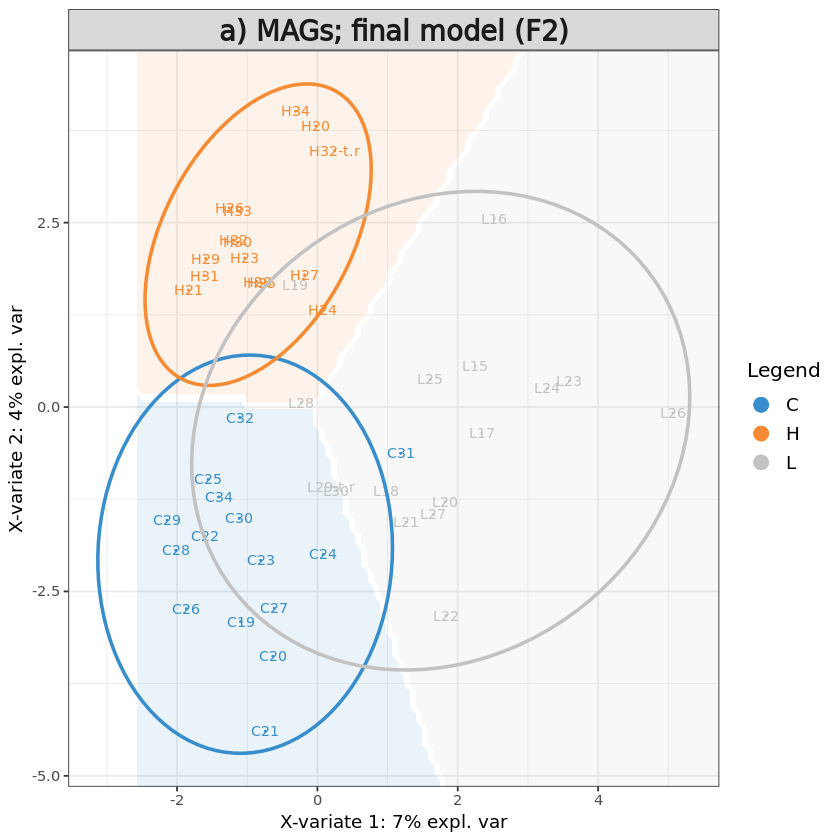

In [36]:
# Define final model
mag.F2$optimal.ncomp <- 4
mag.F2$optimal.keepX <- tune.splsda.mag.F2$choice.keepX[1:mag.F2$optimal.ncomp]
#mag.F2$optimal.keepX <- rep(50, mag.F2$optimal.ncomp)
mag.F2$optimal.keepX <- c(10, 50, 50, 50)

# form final model with optimised values for component, using all features
final.splsda.mag.F2 <- splsda(X.mag.F2, mag.F2$treatment, 
                       ncomp = mag.F2$optimal.ncomp, 
                       keepX = mag.F2$optimal.keepX)

background = background.predict(final.splsda.mag.F2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.mag.F2, comp = 1:2, 
          group = mag.F2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) MAGs; final model (F2)')

# save sample variates
data <- as.data.frame(final.splsda.mag.F2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

In [37]:
mag.F2_names <- mag_tax[colnames(final.splsda.mag.F2$X),c("phylum", "family", "species")]
mag.F2_names$names <- paste0(rownames(mag.F2_names)," (", mag.F2_names$family, "; ", mag.F2_names$species, ")")

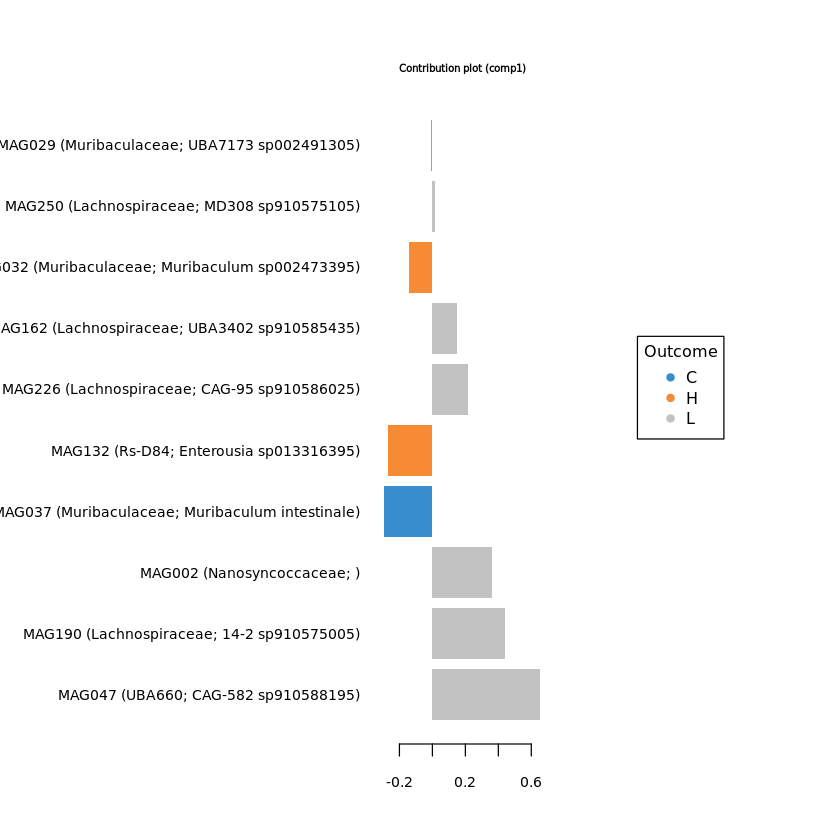

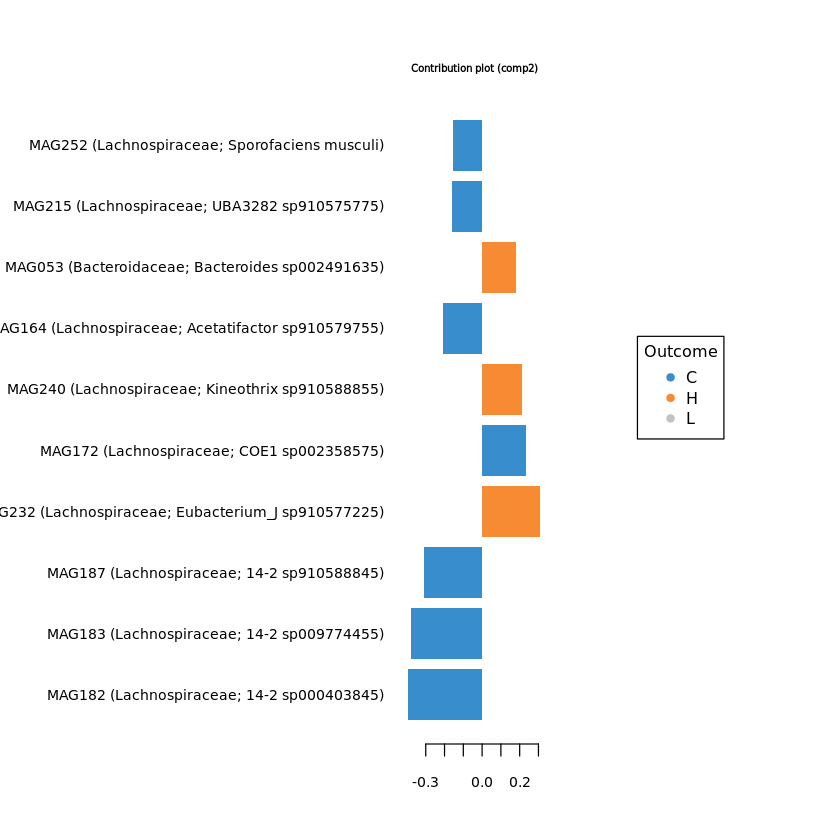

In [38]:
#plotVar(final.splsda.mag.F2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.mag.F2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = mag.F2_names$names)
plotLoadings(final.splsda.mag.F2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = mag.F2_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.mag.F2, comp=1)$value
load_comp2 = selectVar(final.splsda.mag.F2, comp=2)$value
F2.mag.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F2.mag.load) <- F2.mag.load[,"Row.names"]
colnames(F2.mag.load) <- c("ft","loading_comp1","loading_comp2")
F2.mag.load = F2.mag.load[,c("loading_comp1","loading_comp2")]

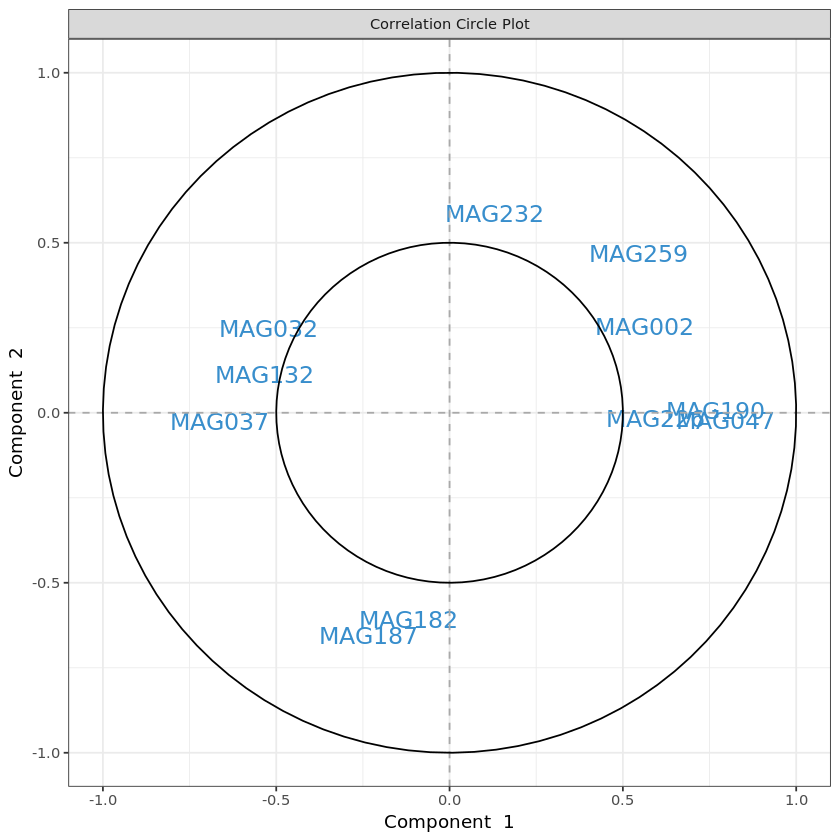

In [39]:
# plot feature correlation
plotVar(final.splsda.mag.F2, cutoff=0.5)
mag.F2.corr <- as.data.frame(plotVar(final.splsda.mag.F2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
mag.F2.corr <- mag.F2.corr[, c("x","y")]
colnames(mag.F2.corr) <- c("corr_comp1","corr_comp2")

In [24]:
# Calculate feature stability
perf.splsda.mag.F2 <- perf(final.splsda.mag.F2, 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F2.mag.stab <- merge(data.frame(perf.splsda.mag.F2$features$stable$comp1), 
                  data.frame(perf.splsda.mag.F2$features$stable$comp2), by="Var1", all=T)
rownames(F2.mag.stab) <- F2.mag.stab$Var1
F2.mag.stab <- F2.mag.stab[, c("Freq.x","Freq.y")]
colnames(F2.mag.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%


In [425]:
# merge feature output
F2.mag.out <- merge(F2.mag.load, F2.mag.stab, by="row.names")
rownames(F2.mag.out) <- F2.mag.out[,"Row.names"]
F2.mag.out <- merge(F2.mag.out[, 2:ncol(F2.mag.out)], mag.F2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F2.features.tsv", F2.mag.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [113]:
train <- sample(1:nrow(X.mag.F2), ceiling(nrow(X.mag.F2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.mag.F2), train) # rest is part of the test set

# store matrices into training and test set:
X.mag.F2.train <- X.mag.F2[train, ]
X.mag.F2.test <- X.mag.F2[test,]
Y.mag.F2.train <- info[train,"treatment"]
Y.mag.F2.test <- info[test, "treatment"]
train.splsda.mag.F2 <- splsda(X.mag.F2.train, Y.mag.F2.train, ncomp = mag.F2$optimal.ncomp, keepX = mag.F2$optimal.keepX)
predict.splsda.mag.F2 <- predict(train.splsda.mag.F2, X.mag.F2.test, 
                                dist = "max.dist")
predict.comp2.mag.F2 <- predict.splsda.mag.F2$class$max.dist[,2]
table(factor(predict.comp2.mag.F2, levels = levels(mag.F2$treatment)), Y.mag.F2.test)

   Y.mag.F2.test
     C  H  L
  C 10  7  7
  H  2  2  0
  L  1  2  3

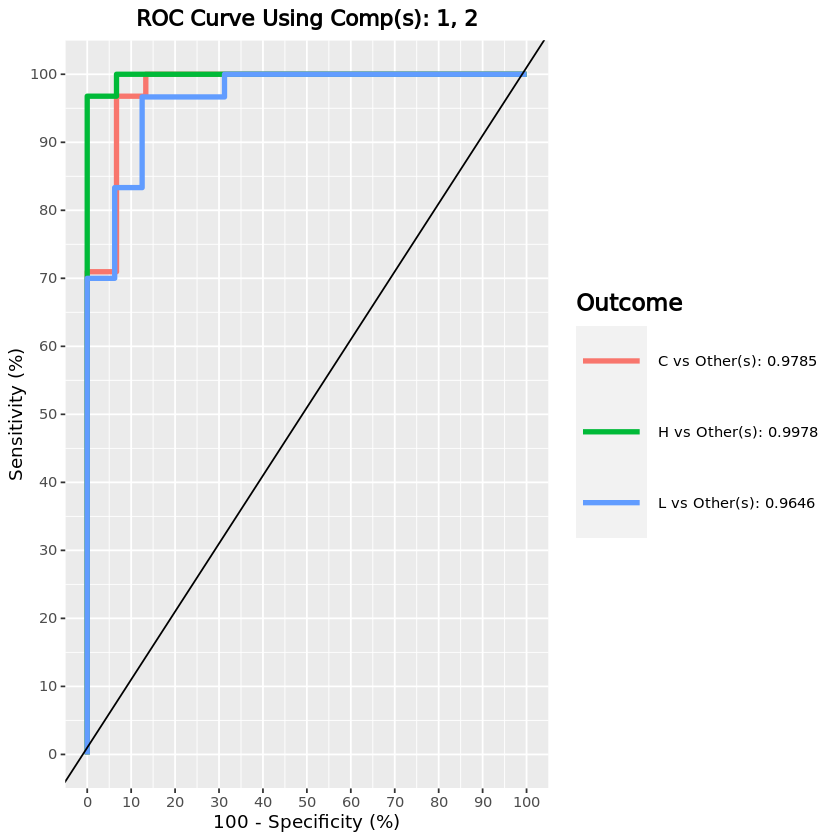

In [115]:
F2.mag.auc.splsda = auroc(final.splsda.mag.F2, roc.comp = 2, print = FALSE)

#### MAGs - F2 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [116]:
mag.F2_2 <- list()
F2_info_2 <- info[rownames(mag.F2$cov),]
F2_info_2$treatment <- gsub(x = F2_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
mag.F2_2$cov <- mag.F2$cov[rownames(F2_info_2),]
mag.F2_2$filtered <- mag.F2$filtered[rownames(F2_info_2),]

mag.F2_2$clr <- mag.F2$clr[rownames(F2_info_2), ]
X.mag.F2_2 <- mag.F2_2$clr

mag.F2_2$treatment <- factor(F2_info_2[rownames(mag.F2_2$clr), "treatment"])

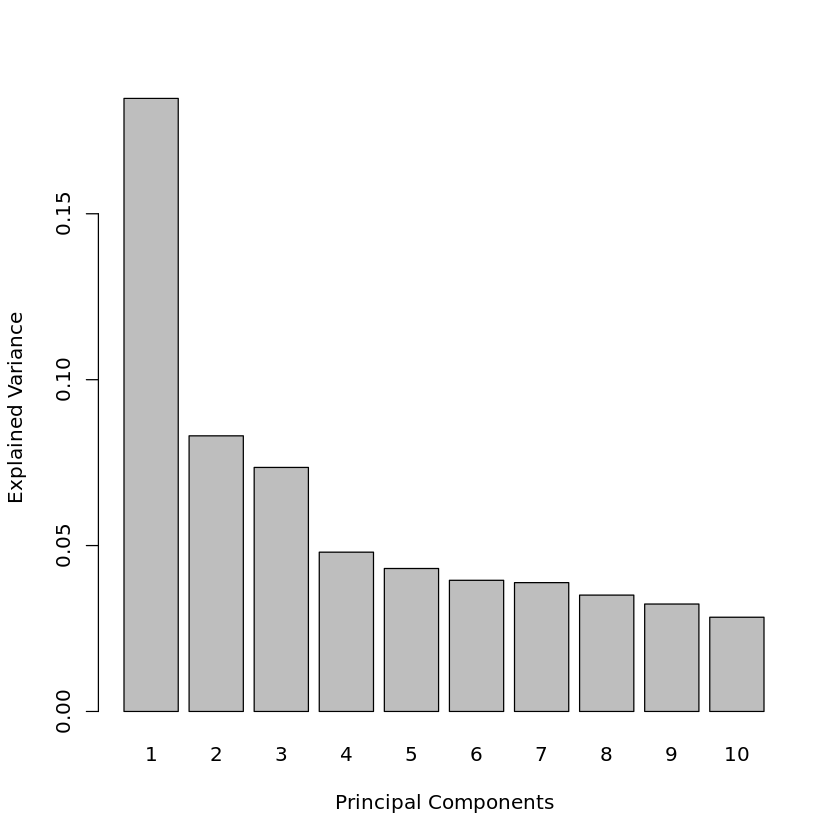

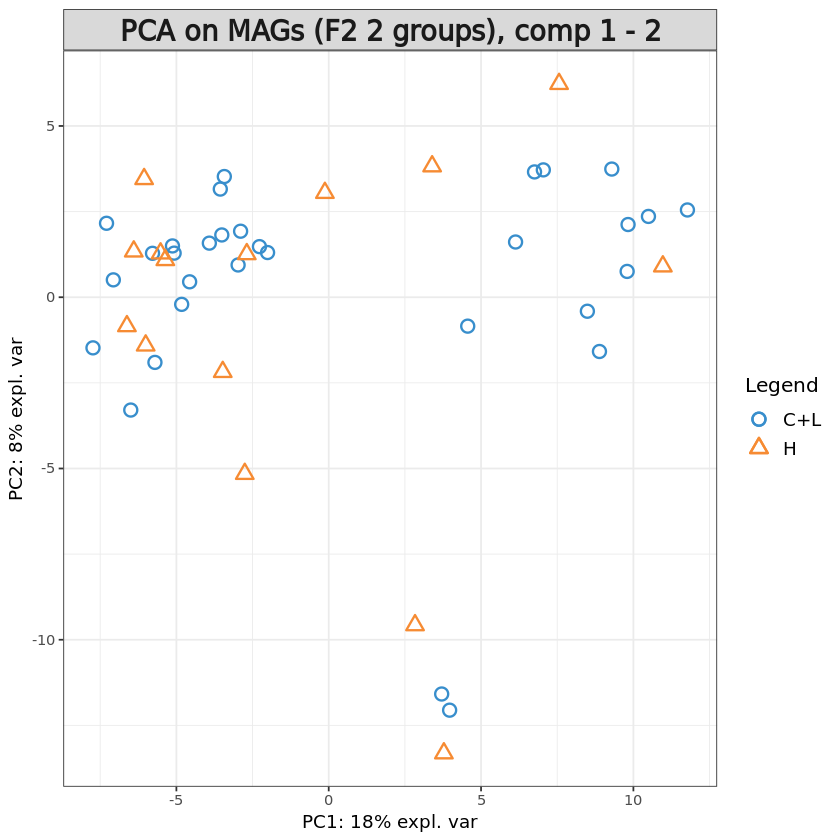

In [117]:
pca.mag.F2_2 = pca(X.mag.F2_2, ncomp = 10, center = TRUE, scale = TRUE) 

plot(pca.mag.F2_2)
plotIndiv(pca.mag.F2_2, group = mag.F2_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on MAGs (F2 2 groups), comp 1 - 2')

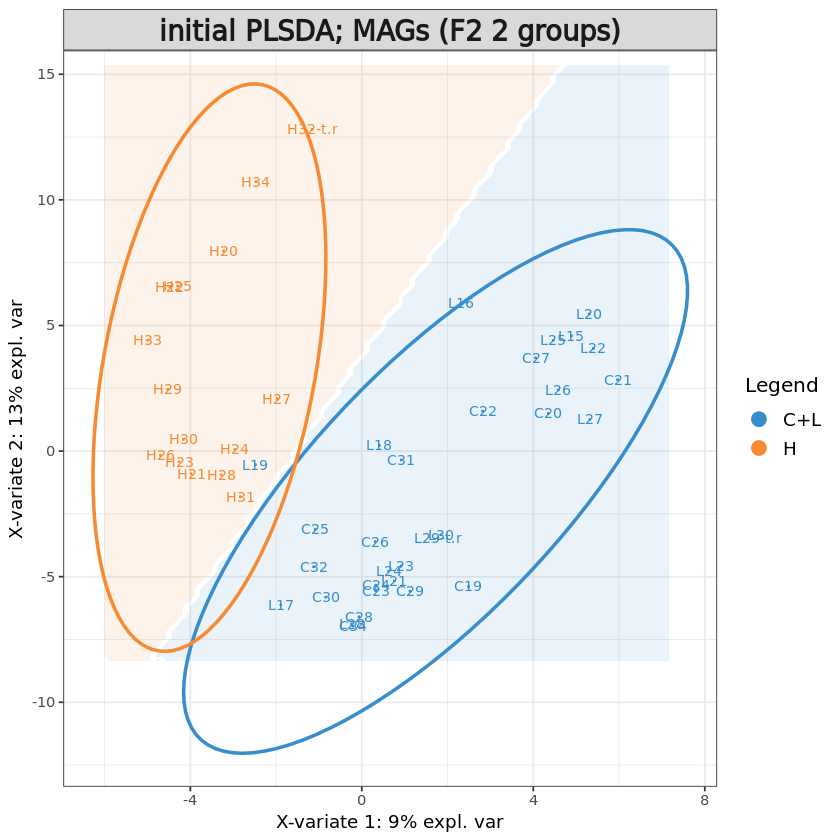

In [118]:
# Initial sPLS-DA model
mag.F2_2.splsda <- splsda(X.mag.F2_2, mag.F2_2$treatment, ncomp = 10)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(mag.F2_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(mag.F2_2.splsda, comp = 1:2, ellipse = TRUE,
          group = mag.F2_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; MAGs (F2 2 groups)")

The initial model separates the two treatment groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,3,3,3
BER,3,3,3


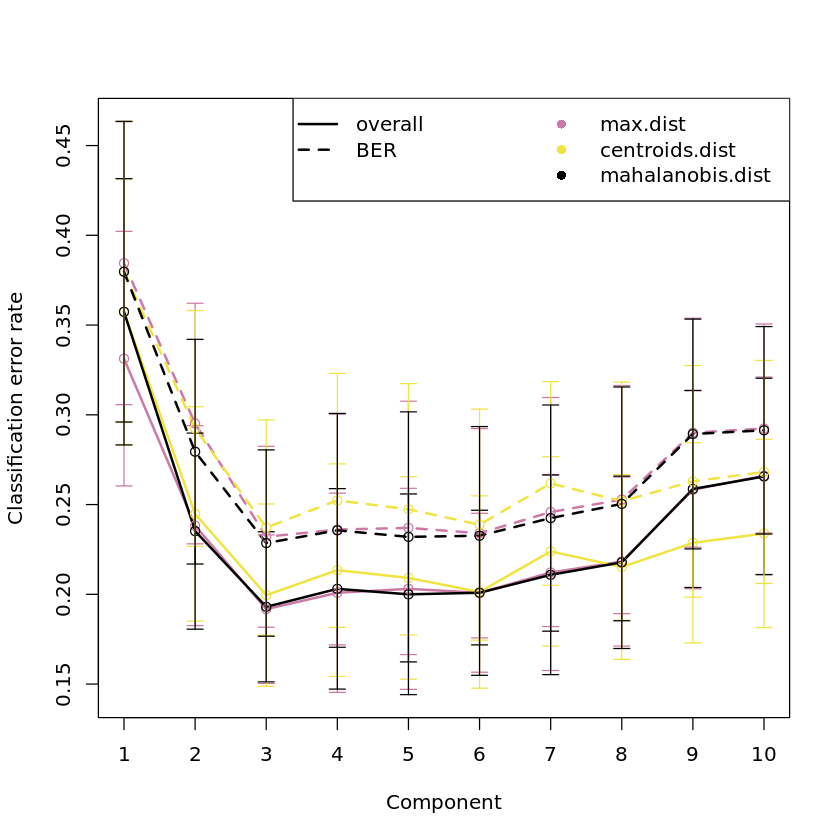

In [119]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.mag.F2_2 <- perf(mag.F2_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.mag.F2_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.mag.F2_2$choice.ncomp # what is the optimal value of components according to perf()

In [120]:
# Define parameters for tuning keepX
mag.F2_2.step <- 0.05
mag.F2_2.ncomp.tune <- 3
# grid of possible keepX values that will be tested for each component
mag.F2_2.keepx <- c(seq(ceiling(dim(mag.F2_2$filtered)[2] * mag.F2_2.step), 
                      round(dim(mag.F2_2$filtered)[2], digits = -1), 
                      ceiling(dim(mag.F2_2$filtered)[2] * mag.F2_2.step)
                     )
                 )
mag.F2_2.keepx

[1]  11  22  33  44  55  66  77  88  99 110 121 132 143 154 165 176 187 198 209

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


[1] 2

comp1 comp2 comp3 
  154    99   165

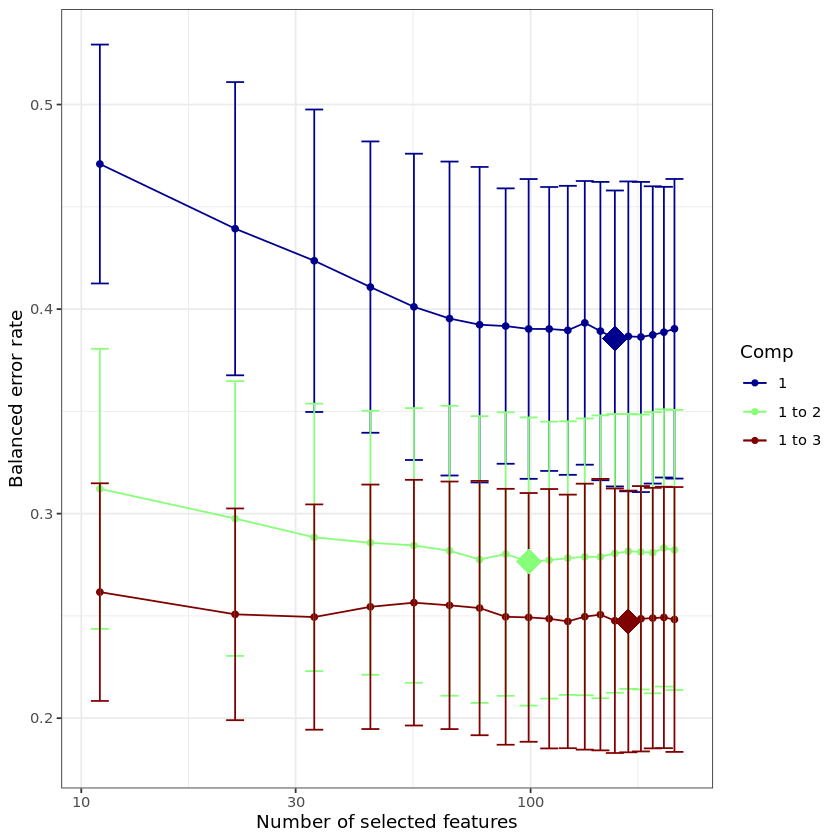

In [121]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.mag.F2_2 <- tune.splsda(X.mag.F2_2, mag.F2_2$treatment, ncomp = mag.F2_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = mag.F2_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.mag.F2_2, col = color.jet(mag.F2_2.ncomp.tune))

tune.splsda.mag.F2_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.mag.F2_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

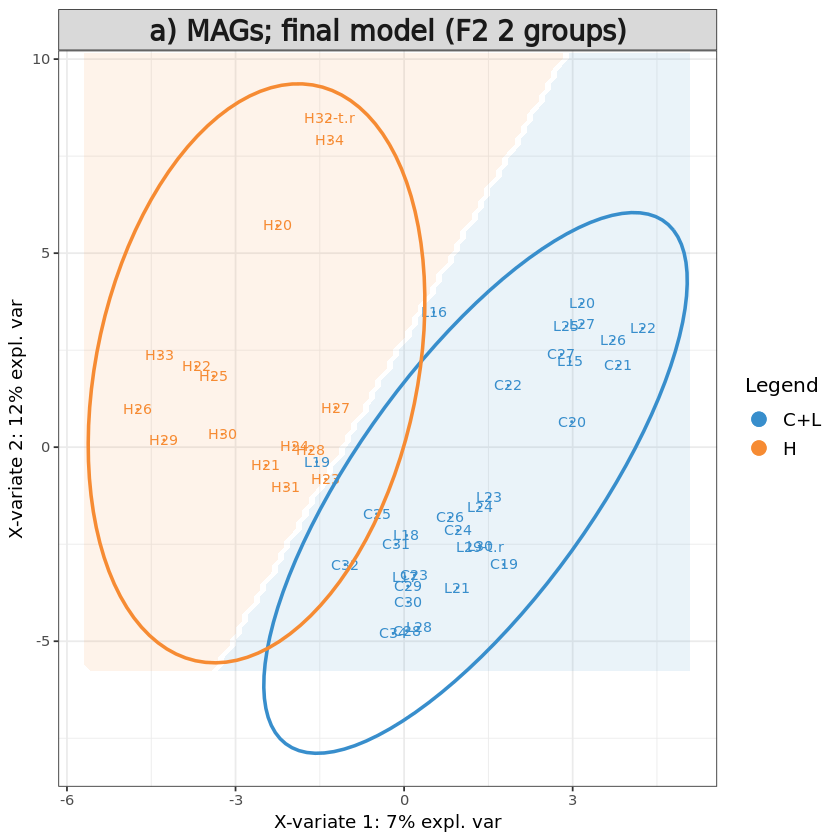

In [123]:
# Define final model
mag.F2_2$optimal.ncomp <- 2
#mag.F2_2$optimal.keepX <- tune.splsda.mag.F2_2$choice.keepX[1:mag.F2_2$optimal.ncomp]
mag.F2_2$optimal.keepX <- rep(50, mag.F2_2$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.mag.F2_2 <- splsda(X.mag.F2_2, mag.F2_2$treatment, 
                       ncomp = mag.F2_2$optimal.ncomp, 
                       keepX = mag.F2_2$optimal.keepX)

background = background.predict(final.splsda.mag.F2_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.mag.F2_2, comp = 1:2, 
          group = mag.F2_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) MAGs; final model (F2 2 groups)')

# save sample variates
data <- as.data.frame(final.splsda.mag.F2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F2_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

In [124]:
mag.F2_2_names <- mag_tax[colnames(final.splsda.mag.F2_2$X),c("phylum", "family", "species")]
mag.F2_2_names$names <- paste0(rownames(mag.F2_2_names)," (", mag.F2_2_names$family, "; ", mag.F2_2_names$species, ")")

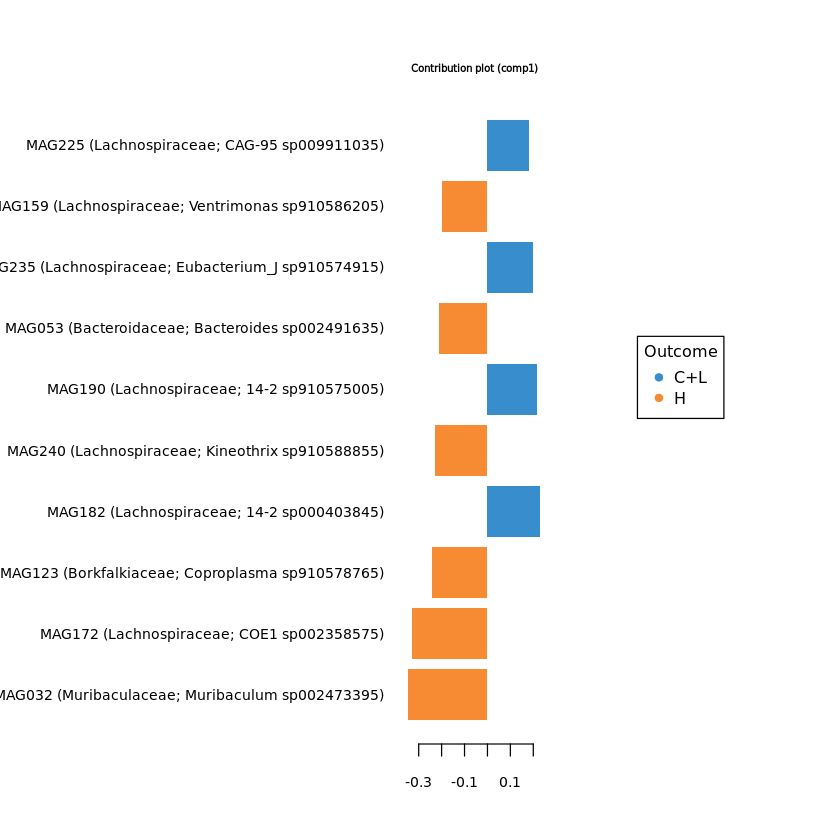

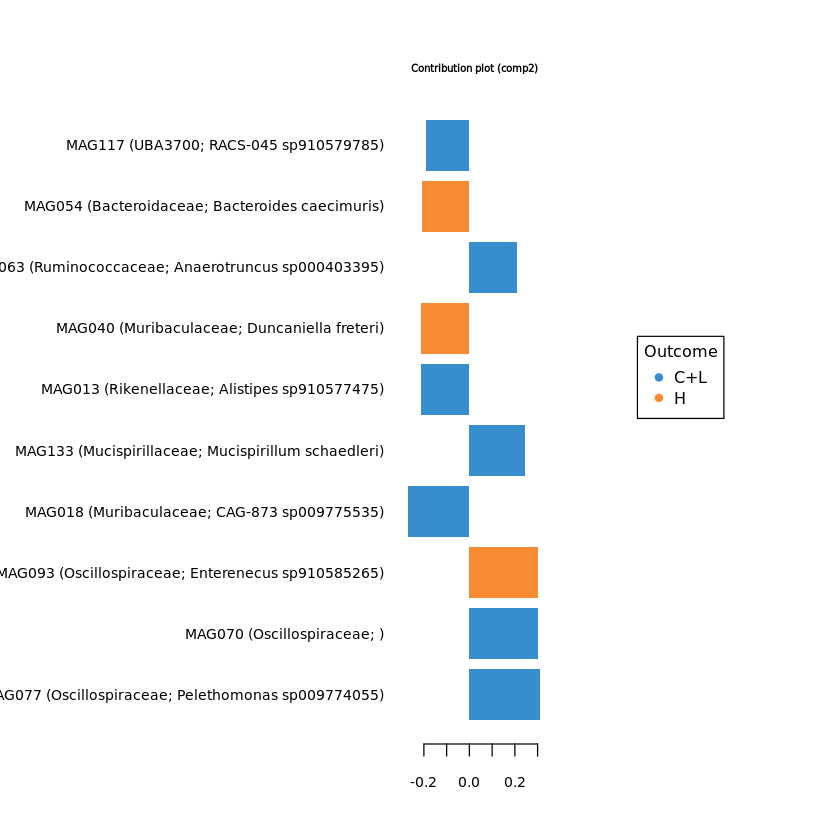

In [125]:
#plotVar(final.splsda.mag.F2_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.mag.F2_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = mag.F2_2_names$names)
plotLoadings(final.splsda.mag.F2_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = mag.F2_2_names$names)
# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.mag.F2_2, comp=1)$value
load_comp2 = selectVar(final.splsda.mag.F2_2, comp=2)$value
F2_2.mag.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F2_2.mag.load) <- F2_2.mag.load[,"Row.names"]
colnames(F2_2.mag.load) <- c("ft","loading_comp1","loading_comp2")
F2_2.mag.load = F2_2.mag.load[,c("loading_comp1","loading_comp2")]

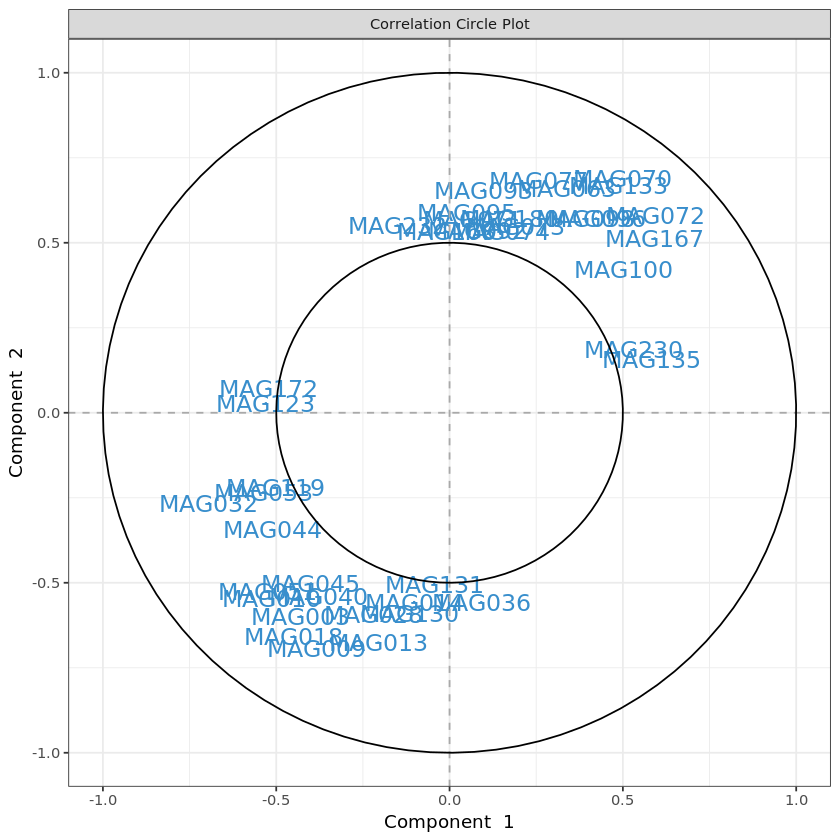

In [126]:
# plot feature correlation
plotVar(final.splsda.mag.F2_2, cutoff=0.5)
mag.F2_2.corr <- as.data.frame(plotVar(final.splsda.mag.F2_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
mag.F2_2.corr <- mag.F2_2.corr[, c("x","y")]
colnames(mag.F2_2.corr) <- c("corr_comp1","corr_comp2")

In [127]:
# Calculate feature stability
perf.splsda.mag.F2_2 <- perf(final.splsda.mag.F2_2, 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F2_2.mag.stab <- merge(data.frame(perf.splsda.mag.F2_2$features$stable$comp1), 
                  data.frame(perf.splsda.mag.F2_2$features$stable$comp2), by="Var1", all=T)
rownames(F2_2.mag.stab) <- F2_2.mag.stab$Var1
F2_2.mag.stab <- F2_2.mag.stab[, c("Freq.x","Freq.y")]
colnames(F2_2.mag.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [426]:
# merge feature output
F2_2.mag.out <- merge(F2_2.mag.load, F2_2.mag.stab, by="row.names")
rownames(F2_2.mag.out) <- F2_2.mag.out[,"Row.names"]
F2_2.mag.out <- merge(F2_2.mag.out[, 2:ncol(F2_2.mag.out)], mag.F2_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.mag.F2_2.features.tsv", F2_2.mag.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [130]:
train <- sample(1:nrow(X.mag.F2_2), ceiling(nrow(X.mag.F2_2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.mag.F2_2), train) # rest is part of the test set

# store matrices into training and test set:
X.mag.F2_2.train <- X.mag.F2_2[train, ]
X.mag.F2_2.test <- X.mag.F2_2[test,]
Y.mag.F2_2.train <- F2_info_2[train,"treatment"]
Y.mag.F2_2.test <- F2_info_2[test, "treatment"]
train.splsda.mag.F2_2 <- splsda(X.mag.F2_2.train, Y.mag.F2_2.train, ncomp = mag.F2_2$optimal.ncomp, keepX = mag.F2_2$optimal.keepX)
predict.splsda.mag.F2_2 <- predict(train.splsda.mag.F2_2, X.mag.F2_2.test, 
                                dist = "max.dist")
predict.comp2.mag.F2_2 <- predict.splsda.mag.F2_2$class$max.dist[,2]
table(factor(predict.comp2.mag.F2_2, levels = levels(mag.F2_2$treatment)), Y.mag.F2_2.test)

     Y.mag.F2_2.test
      C+L  H
  C+L  21 10
  H     1  2

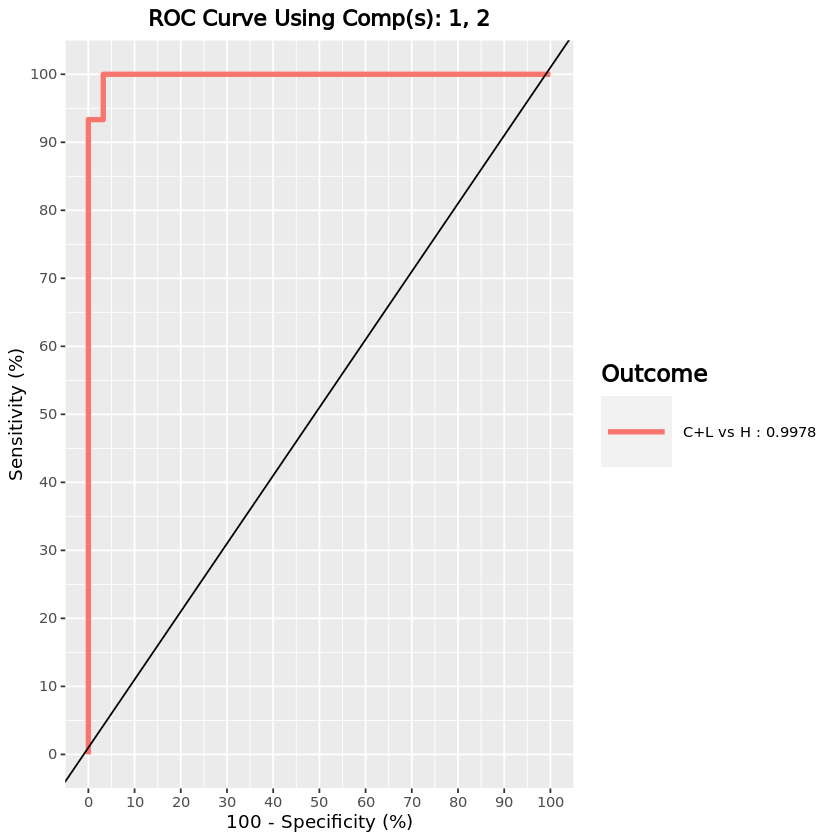

In [133]:
F2_2.mag.auc.splsda = auroc(final.splsda.mag.F2_2, roc.comp = 2, print = FALSE)

### UniRef - species

#### Generational differences

[1] "3521"            "species removed" "539"             "remaining"

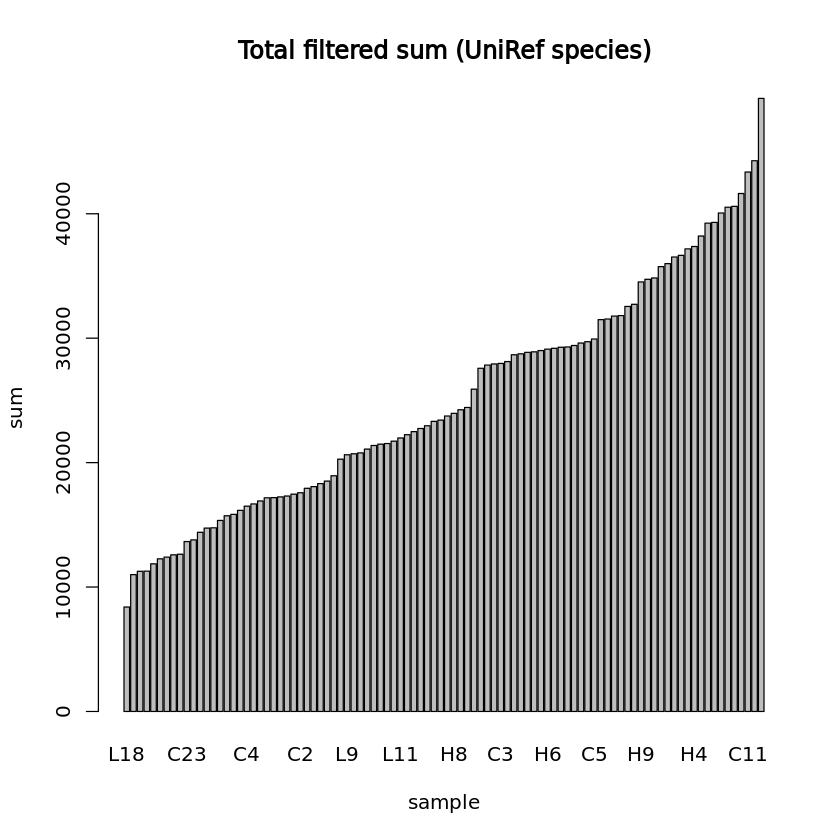

In [134]:
## PARAMS ##
# Initial components
uniref.ncomp <- 10
# Percentage of samples in which features must have >0 sum
uniref.percent_occ <- 10
# Quantile used for removing low abundance features
uniref.quantile_thresh <- 0.1

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(uniref$cov[, colSums(uniref$cov) > 0])
uniref$nz <- uniref$cov[, colnames(uniref$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(uniref$nz) / sum(colSums(uniref$nz)) * 100, probs = uniref.quantile_thresh)
uniref$filtered <- low.count.removal(uniref$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
uniref$occ <- colSums(uniref$filtered>0) / nrow(uniref$filtered) * 100
# Keep features occurring in defined percentage of samples
uniref$filtered <- uniref$filtered[, which(uniref$occ >= uniref.percent_occ)]

#uniref$filtered <- uniref$filtered[,-nearZeroVar(uniref$filtered, uniqueCut = 5, freqCut = 5)$Position]
paste0(c(dim(uniref$cov)[2] - dim(uniref$filtered)[2], "species removed", dim(uniref$filtered)[2], "remaining"))

# Add offset
uniref$offset <- uniref$filtered + 1
uniref$clr <- logratio.transfo(uniref$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.uniref <- uniref$clr

uniref$generation <- factor(info[rownames(uniref$clr), "Generation"])

uniref.lib.size <- apply(uniref$filtered, 1, sum) # determine total count for each sample
barplot(sort(uniref.lib.size), main="Total filtered sum (UniRef species)", ylab="sum", xlab="sample")

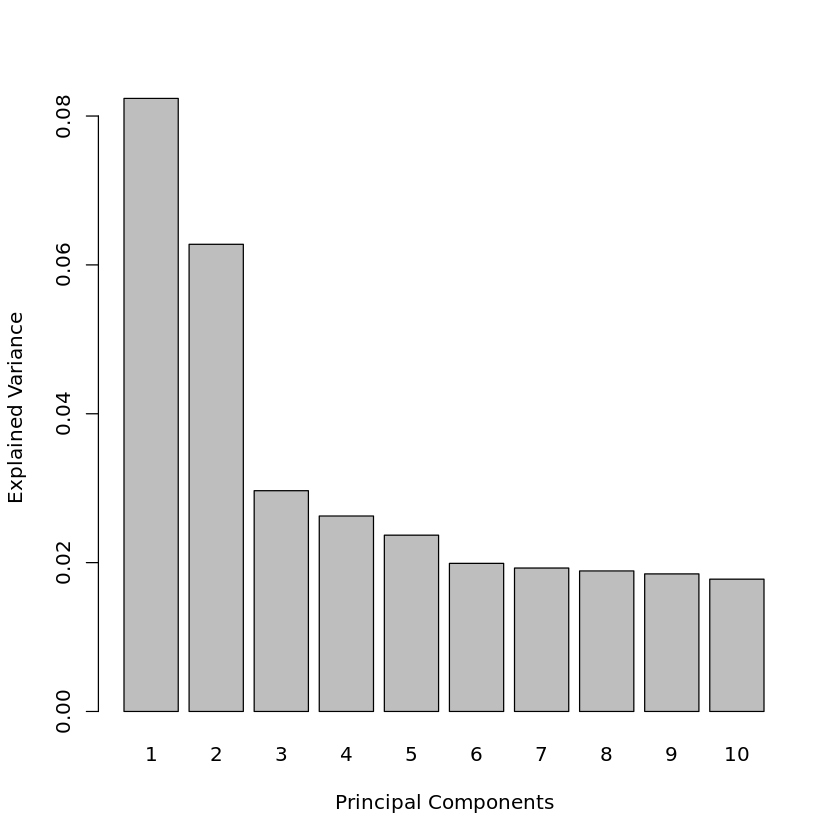

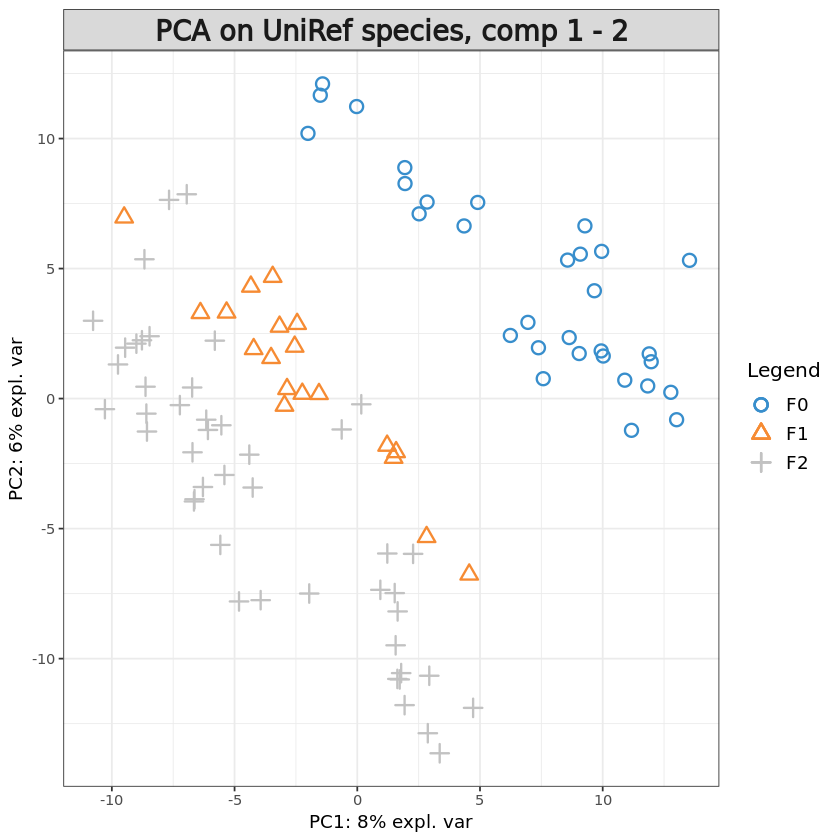

In [135]:
pca.uniref = pca(X.uniref, ncomp = uniref.ncomp, center = TRUE, scale = TRUE) 

plot(pca.uniref)
plotIndiv(pca.uniref, group = uniref$generation, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on UniRef species, comp 1 - 2')

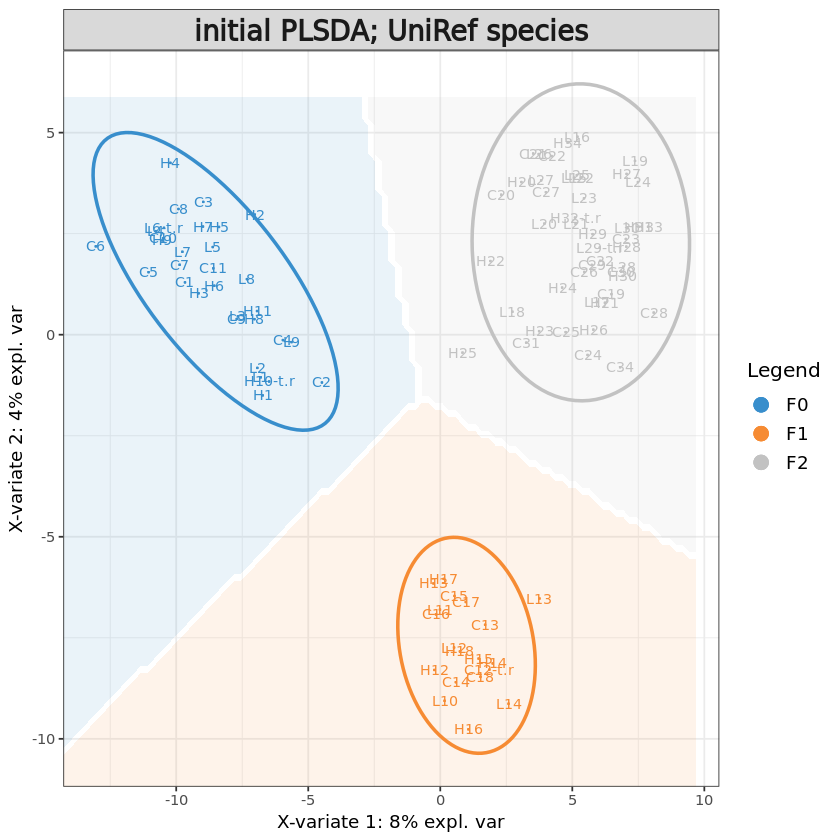

In [136]:
# Initial sPLS-DA model
uniref.splsda <- splsda(X.uniref, uniref$generation, ncomp = uniref.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref$generation, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef species")

In [140]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref <- perf(uniref.splsda, validation = "Mfold", 
                          folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref$choice.ncomp # what is the optimal value of components according to perf()

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |=======                                                               |   9%

In [141]:
# Define parameters for tuning keepX
uniref.step <- 0.1
uniref.ncomp.tune <- 2
# grid of possible keepX values that will be tested for each component
uniref.keepx <- c(10, 20, seq(ceiling(dim(uniref$filtered)[2] * uniref.step), 
                      round(dim(uniref$filtered)[2], digits = -1), 
                      ceiling(dim(uniref$filtered)[2] * uniref.step)
                     )
                 )
uniref.keepx

[1]  10  20  54 108 162 216 270 324 378 432 486 540

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


[1] 2

comp1 comp2 
  270    54

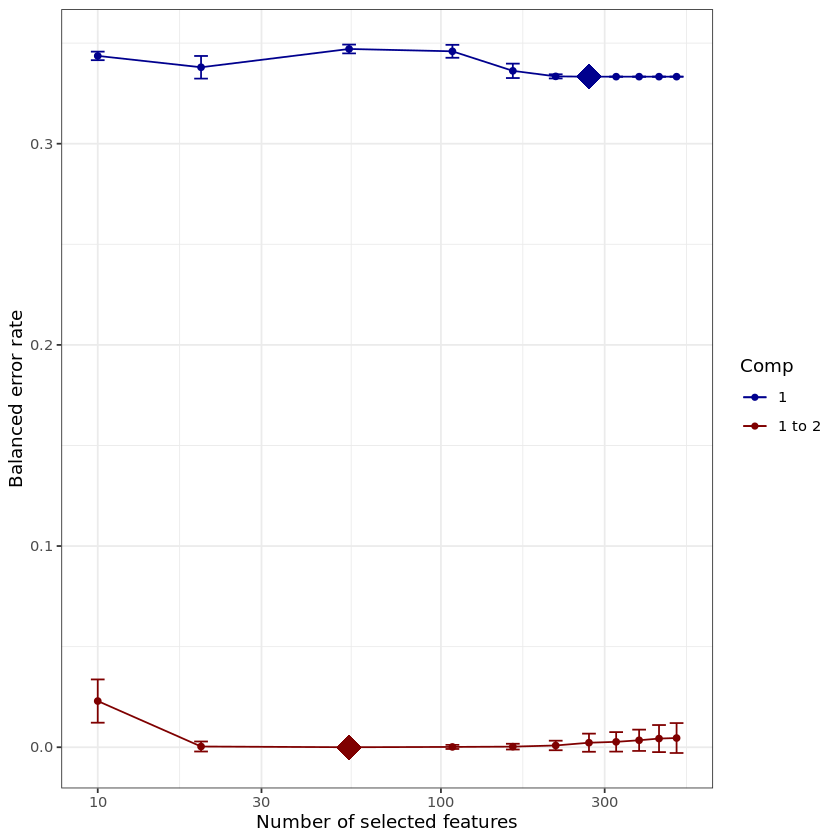

In [138]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref <- tune.splsda(X.uniref, uniref$generation, ncomp = uniref.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref, col = color.jet(uniref.ncomp.tune))

tune.splsda.uniref$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref$choice.keepX # what are the optimal values of variables according to tune.splsda()

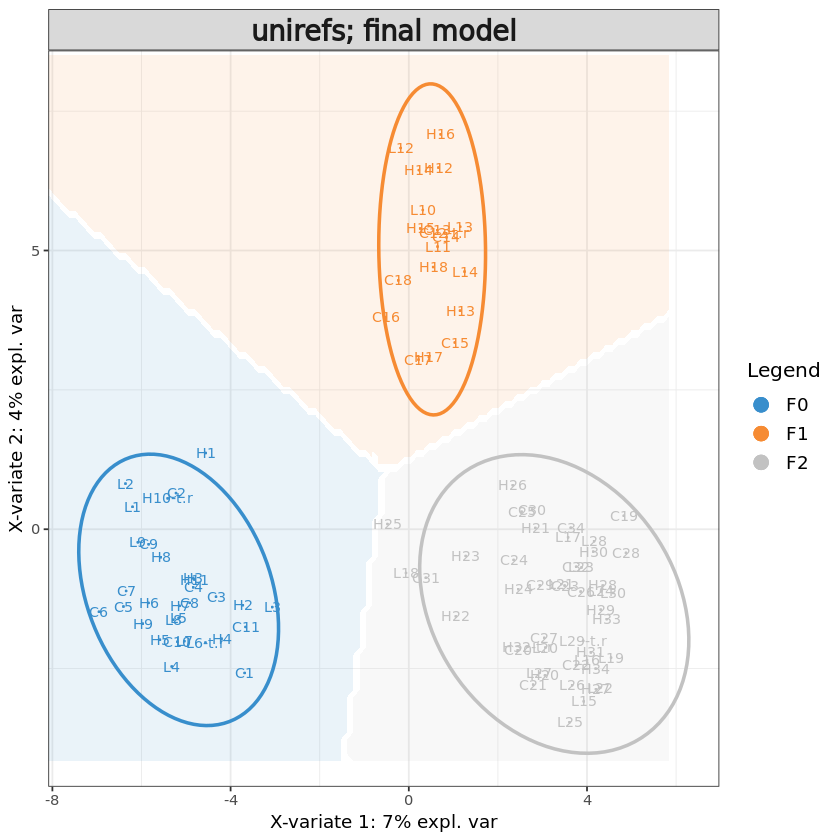

In [142]:
# Define final model
uniref$optimal.ncomp <- 2
#uniref$optimal.keepX <- tune.splsda.uniref$choice.keepX
uniref$optimal.keepX <- c(50,50)

# form final model with optimised values for component, using all features
final.splsda.uniref <- splsda(X.uniref, uniref$generation, 
                       ncomp = uniref$optimal.ncomp, 
                       keepX = uniref$optimal.keepX)

background = background.predict(final.splsda.uniref, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref, comp = 1:2, 
          group = uniref$generation, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'unirefs; final model')

# save sample variates
data <- as.data.frame(final.splsda.uniref$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

In [159]:
uniref_names <- uniref_taxonomy[uniref_taxonomy$species%in%colnames(final.splsda.uniref$X),c("phylum","family","species")]
uniref_names$names <- paste0(uniref_names$species," (", uniref_names$phylum, ")")

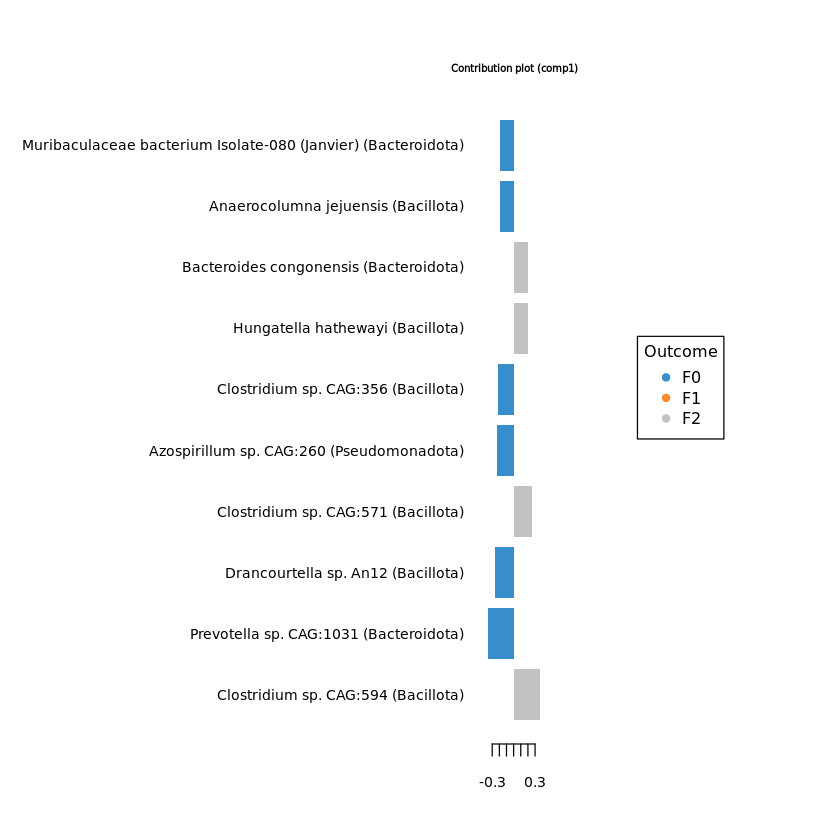

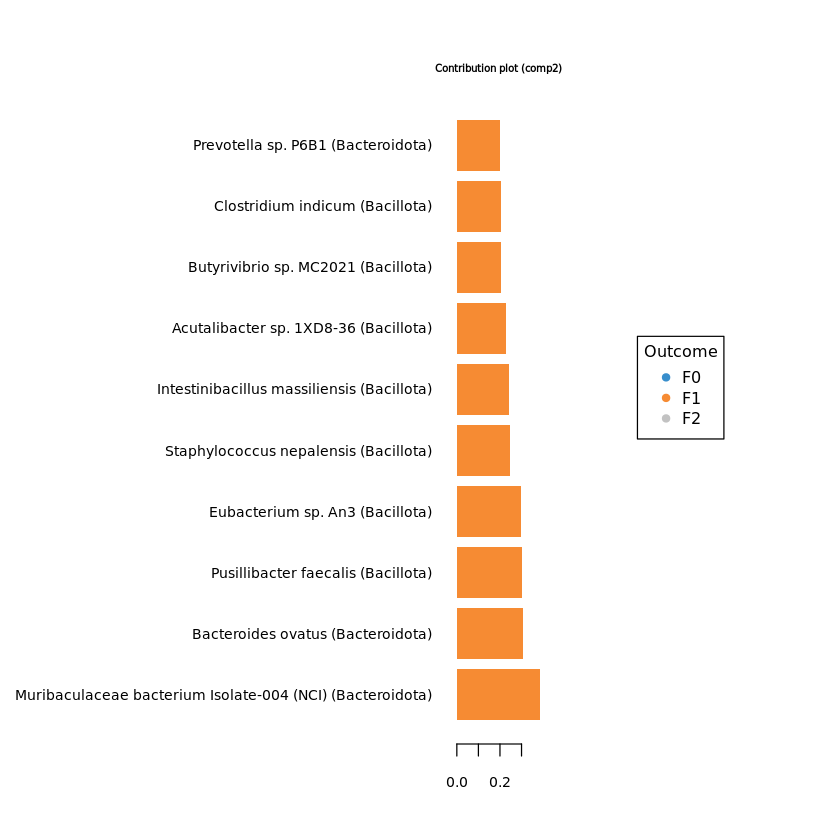

In [160]:
#plotVar(final.splsda.uniref, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = uniref_names$names)
plotLoadings(final.splsda.uniref, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = uniref_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref, comp=2)$value
uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(uniref.load) <- uniref.load[,"Row.names"]
colnames(uniref.load) <- c("ft","loading_comp1","loading_comp2")
uniref.load = uniref.load[,c("loading_comp1","loading_comp2")]

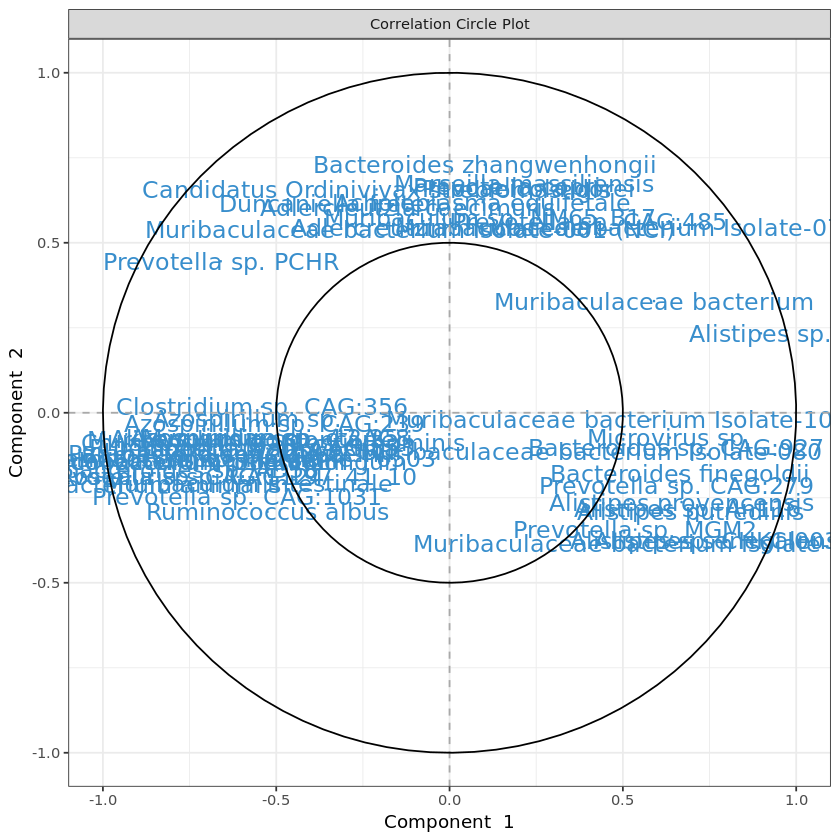

In [161]:
# plot feature correlation
plotVar(final.splsda.uniref, cutoff=0.5)
uniref.corr <- as.data.frame(plotVar(final.splsda.uniref, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.corr <- uniref.corr[, c("x","y")]
colnames(uniref.corr) <- c("corr_comp1","corr_comp2")

In [162]:
# Calculate feature stability
perf.splsda.uniref <- perf(final.splsda.uniref, 
                          folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
uniref.stab <- merge(data.frame(perf.splsda.uniref$features$stable$comp1), 
                  data.frame(perf.splsda.uniref$features$stable$comp2), by="Var1", all=T)
rownames(uniref.stab) <- uniref.stab$Var1
uniref.stab <- uniref.stab[, c("Freq.x","Freq.y")]
colnames(uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [427]:
# merge feature output
uniref.out <- merge(uniref.load, uniref.stab, by="row.names")
rownames(uniref.out) <- uniref.out[,"Row.names"]
uniref.out <- merge(uniref.out[, 2:ncol(uniref.out)], uniref.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.features.tsv", uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [164]:
train <- sample(1:nrow(X.uniref), ceiling(nrow(X.uniref)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.train <- X.uniref[train, ]
X.uniref.test <- X.uniref[test,]
Y.uniref.train <- info[train,"generation"]
Y.uniref.test <- info[test, "generation"]
train.splsda.uniref <- splsda(X.uniref.train, Y.uniref.train, ncomp = uniref$optimal.ncomp, keepX = uniref$optimal.keepX)
predict.splsda.uniref <- predict(train.splsda.uniref, X.uniref.test, 
                                dist = "max.dist")
predict.comp2.uniref <- predict.splsda.uniref$class$max.dist[,2]
table(factor(predict.comp2.uniref, levels = levels(uniref$generation)), Y.uniref.test)

    Y.uniref.test
     F0 F1 F2
  F0 23  0  1
  F1  0  8  1
  F2  0  7 32

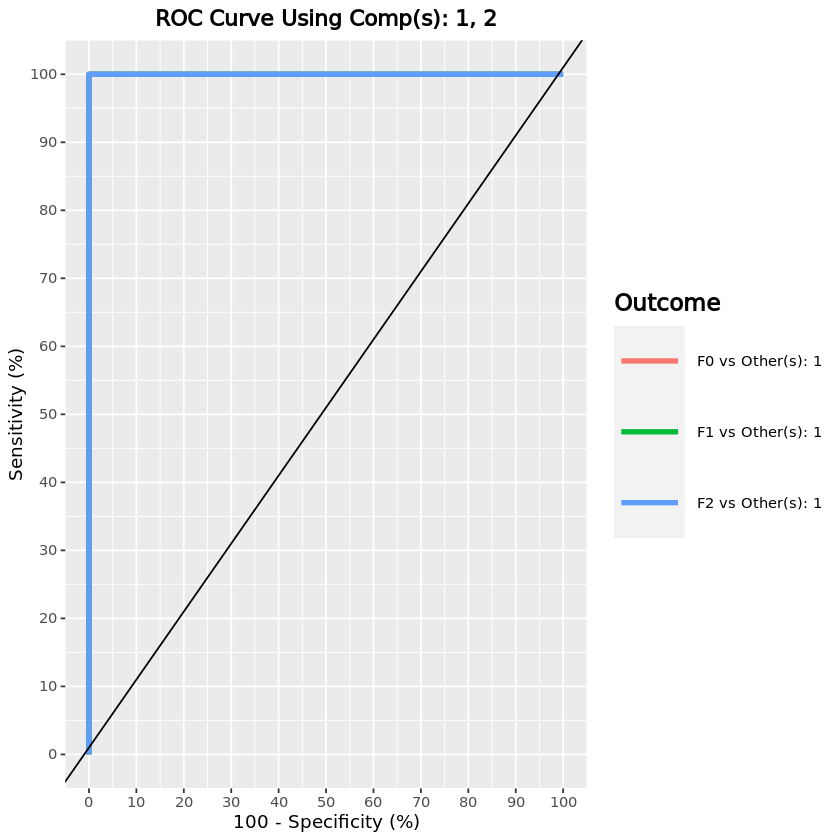

In [165]:
uniref.auc.splsda = auroc(final.splsda.uniref, roc.comp = 2, print = F) # AUROC for the first component

#### UniRef species - F0 generation

[1] "3480"            "species removed" "580"             "remaining"

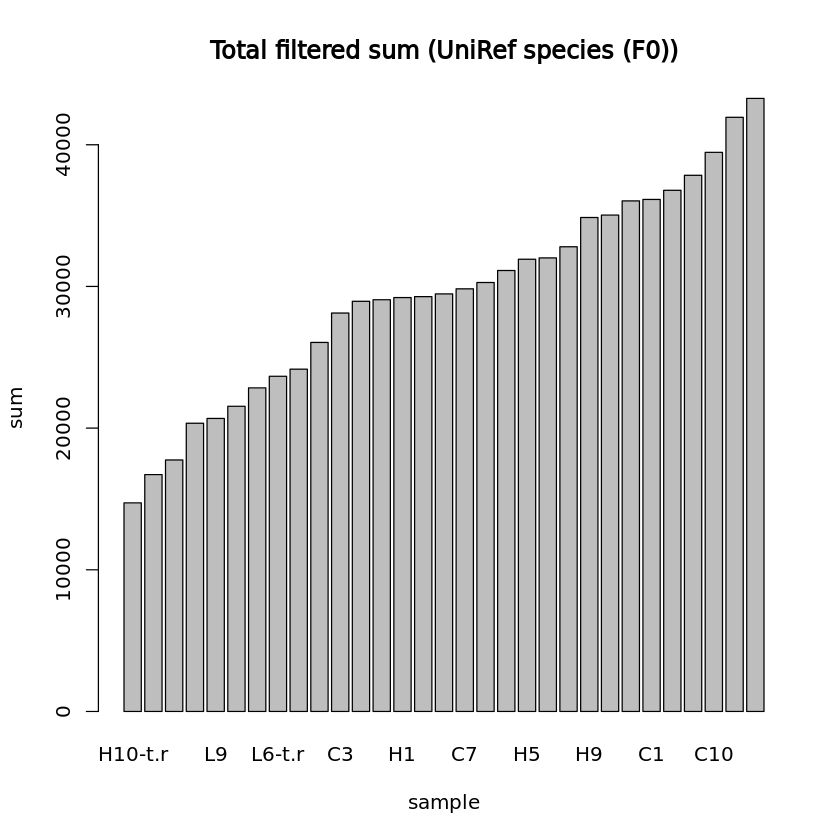

In [166]:
## PARAMS ##
# Initial components
uniref.F0.ncomp <- 10
# Percentage of samples in which features must have >0 sum
uniref.F0.percent_occ <- 10
# Quantile used for removing low abundance features
uniref.F0.quantile_thresh <- 0.1
generation <- "F0"

uniref.F0 <- list()
uniref.F0$cov <- uniref$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(uniref.F0$cov[, colSums(uniref.F0$cov) > 0])
uniref.F0$nz <- uniref.F0$cov[, colnames(uniref.F0$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(uniref.F0$nz) / sum(colSums(uniref.F0$nz)) * 100, probs = uniref.F0.quantile_thresh)
uniref.F0$filtered <- low.count.removal(uniref.F0$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
uniref.F0$occ <- colSums(uniref.F0$filtered>0) / nrow(uniref.F0$filtered) * 100
# Keep features occurring in defined percentage of samples
uniref.F0$filtered <- uniref.F0$filtered[, which(uniref.F0$occ >= uniref.F0.percent_occ)]

#uniref.F0$filtered <- uniref.F0$filtered[,-nearZeroVar(uniref.F0$filtered)$Position]
paste0(c(dim(uniref.F0$cov)[2] - dim(uniref.F0$filtered)[2], "species removed", dim(uniref.F0$filtered)[2], "remaining"))

# Add offset
uniref.F0$offset <- uniref.F0$filtered + 1
uniref.F0$clr <- logratio.transfo(uniref.F0$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.uniref.F0 <- uniref.F0$clr

uniref.F0$treatment <- factor(info[rownames(uniref.F0$clr), "Treatment"])
uniref.F0.lib.size <- apply(uniref.F0$filtered, 1, sum) # determine total count for each sample
barplot(sort(uniref.F0.lib.size), main="Total filtered sum (UniRef species (F0))", ylab="sum", xlab="sample")

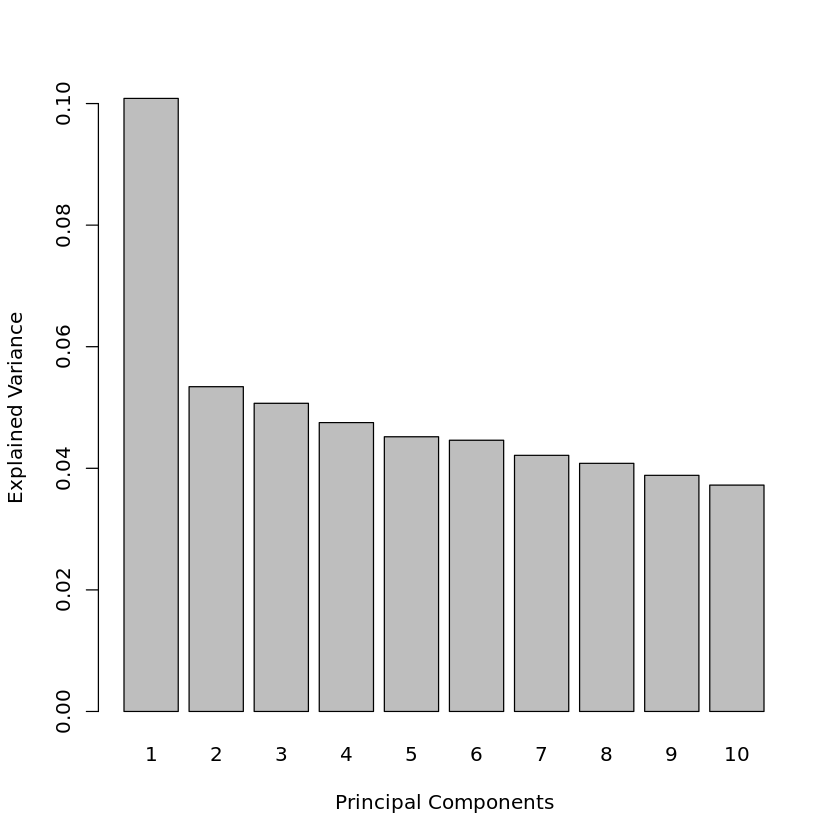

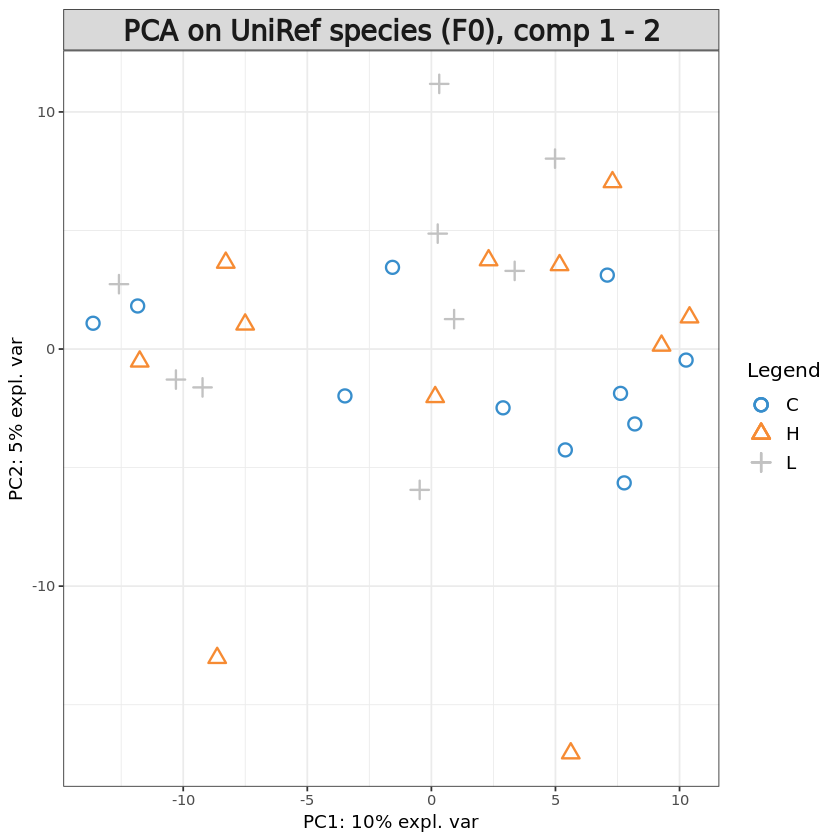

In [167]:
pca.uniref.F0 = pca(X.uniref.F0, ncomp = uniref.F0.ncomp, center = TRUE, scale = TRUE) 

plot(pca.uniref.F0)
plotIndiv(pca.uniref.F0, group = uniref.F0$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on UniRef species (F0), comp 1 - 2')

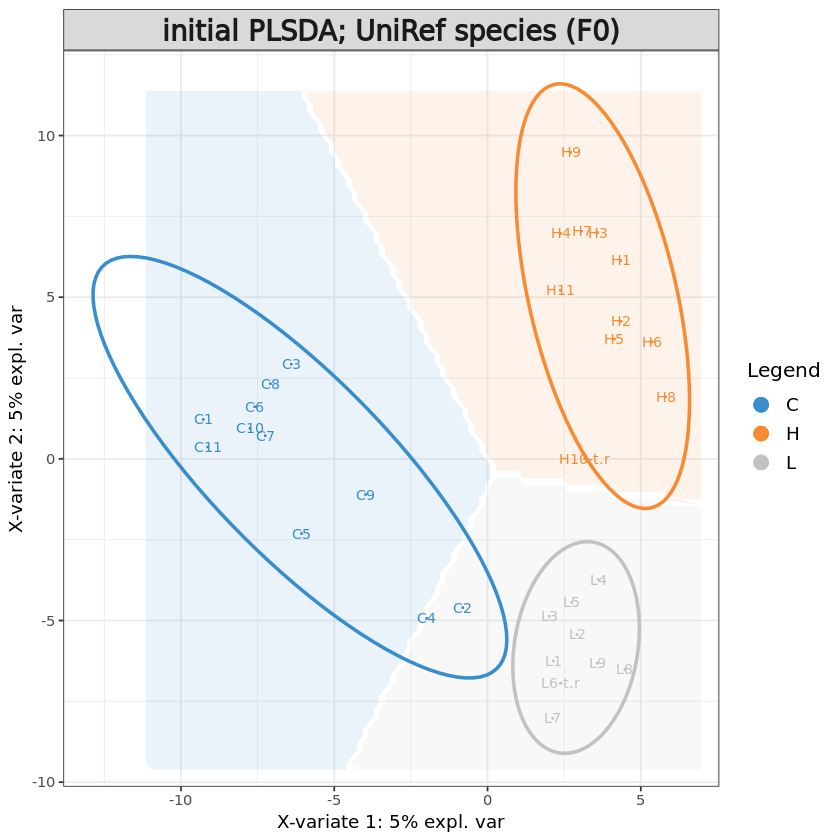

In [168]:
# Initial sPLS-DA model
uniref.F0.splsda <- splsda(X.uniref.F0, uniref.F0$treatment, ncomp = uniref.F0.ncomp)  # set ncomp to 10 for performance assessment later

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.F0.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.F0.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.F0$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef species (F0)")

The initial model does separate the sample groups, with component 1 characterizing Control vs H+L and Component 2 characterizing L vs H.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,9,2,2
BER,9,2,2


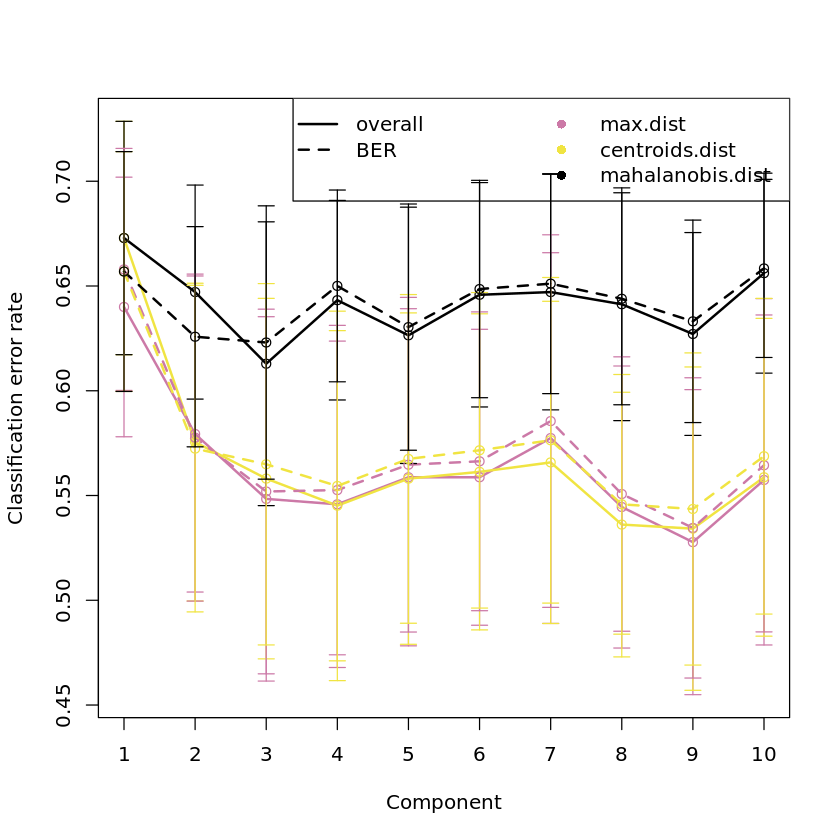

In [35]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.F0 <- perf(uniref.F0.splsda, validation = "Mfold", 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.F0, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.F0$choice.ncomp # what is the optimal value of components according to perf()

Tuning the `ncomp` parameter suggests that 2 components is best here. We will however tune the number of features for up to 9 components.

In [169]:
# Define parameters for tuning keepX
uniref.F0.step <- 0.05
uniref.F0.ncomp.tune <- 9
# grid of possible keepX values that will be tested for each component
uniref.F0.keepx <- c(10, 20, seq(ceiling(dim(uniref.F0$filtered)[2] * uniref.F0.step), 
                      round(dim(uniref.F0$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.F0$filtered)[2] * uniref.F0.step)
                     )
                 )
uniref.F0.keepx

[1]  10  20  29  58  87 116 145 174 203 232 261 290 319 348 377 406 435 464 493
[20] 522 551 580

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%


[1] 2

comp1 comp2 comp3 comp4 comp5 comp6 comp7 comp8 comp9 
  145    87   145   493    10    29    20    10    10

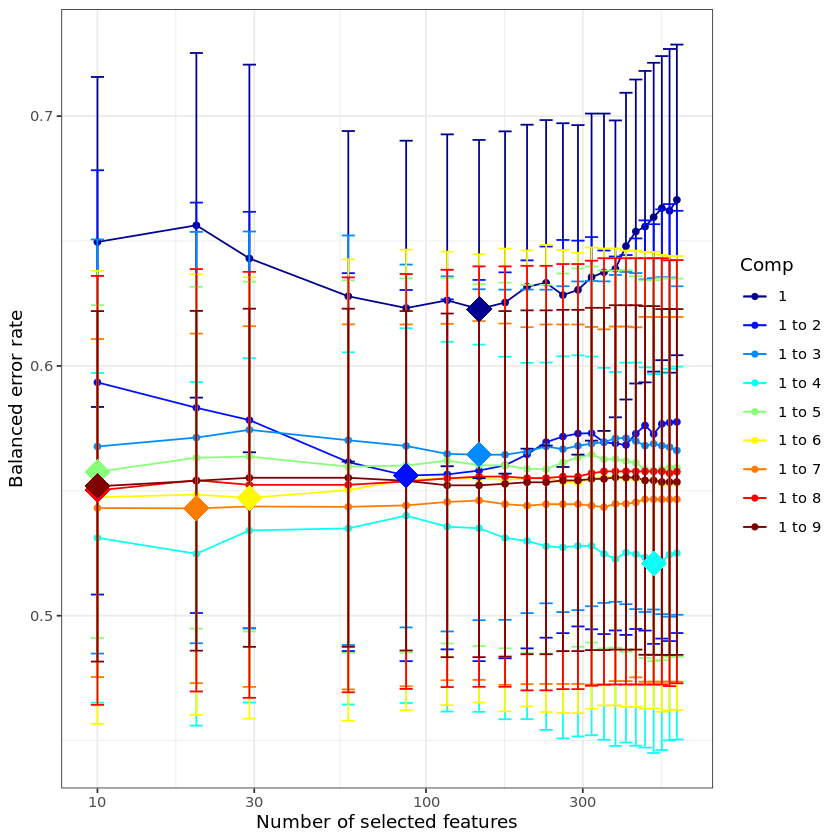

In [170]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.F0 <- tune.splsda(X.uniref.F0, uniref.F0$treatment, ncomp = uniref.F0.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.F0.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.F0, col = color.jet(uniref.F0.ncomp.tune))

tune.splsda.uniref.F0$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.F0$choice.keepX # what are the optimal values of variables according to tune.splsda()

As before, the error rates are high here with large standard deviations for the different keepX values tested. We will use only 2 components.

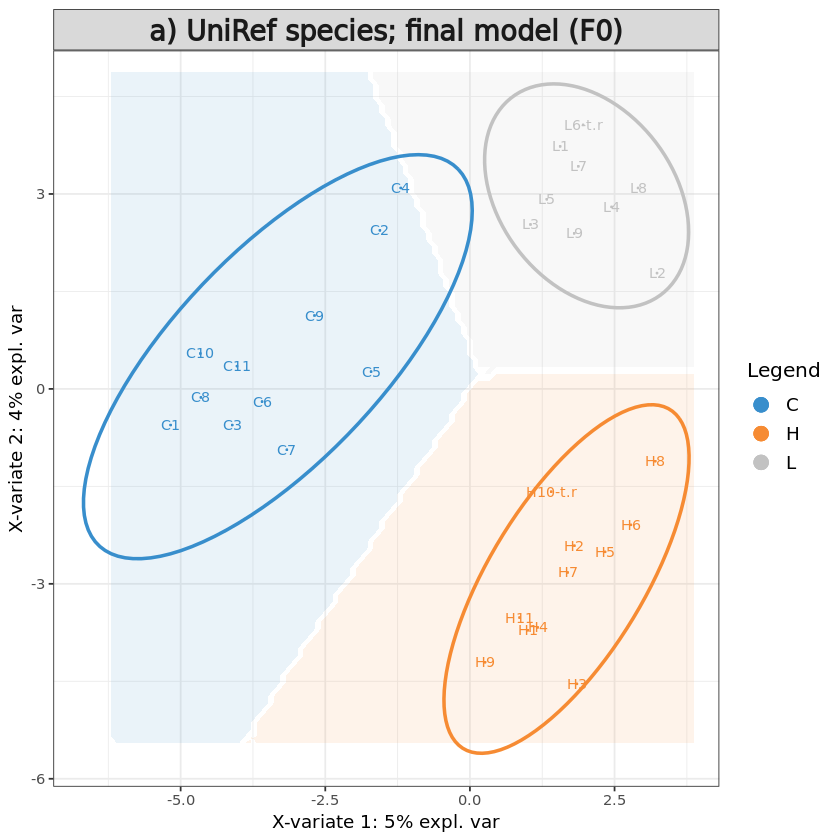

In [272]:
# Define final model
uniref.F0$optimal.ncomp <- 2
#uniref.F0$optimal.keepX <- tune.splsda.uniref.F0$choice.keepX[1:uniref.F0$optimal.ncomp]
uniref.F0$optimal.keepX <- rep(50, uniref.F0$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.uniref.F0 <- splsda(X.uniref.F0, uniref.F0$treatment, 
                       ncomp = uniref.F0$optimal.ncomp, 
                       keepX = uniref.F0$optimal.keepX)

background = background.predict(final.splsda.uniref.F0, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.F0, comp = 1:2, 
          group = uniref.F0$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) UniRef species; final model (F0)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.F0$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F0.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

In [273]:
uniref.F0_names <- uniref_taxonomy[uniref_taxonomy$species%in%colnames(final.splsda.uniref.F0$X),c("phylum","family","species")]
uniref.F0_names$names <- paste0(uniref.F0_names$species," (", uniref.F0_names$phylum, ")")

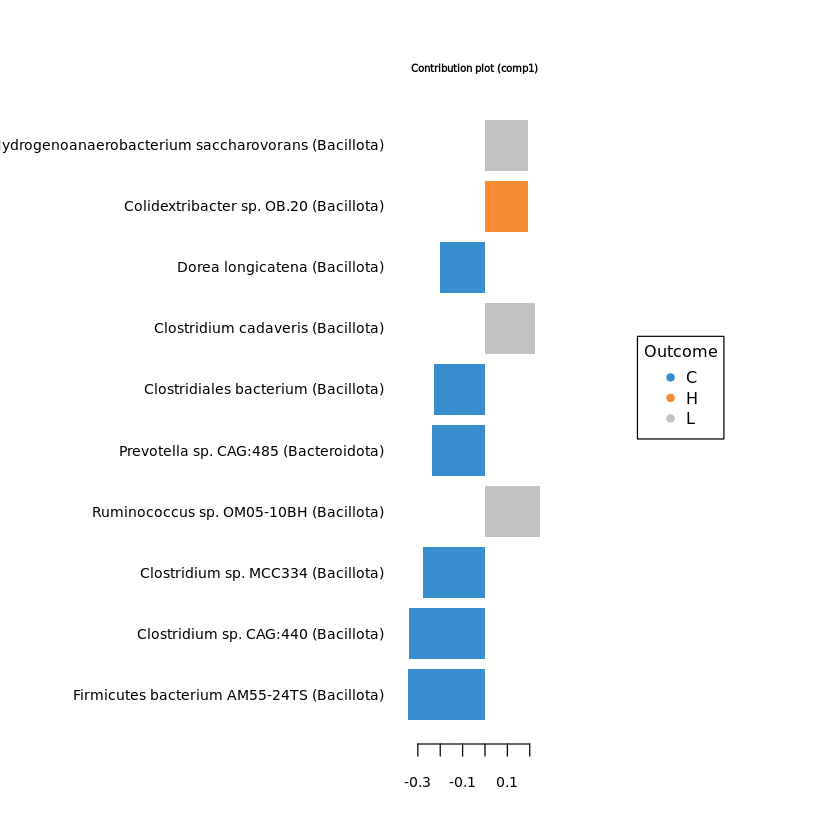

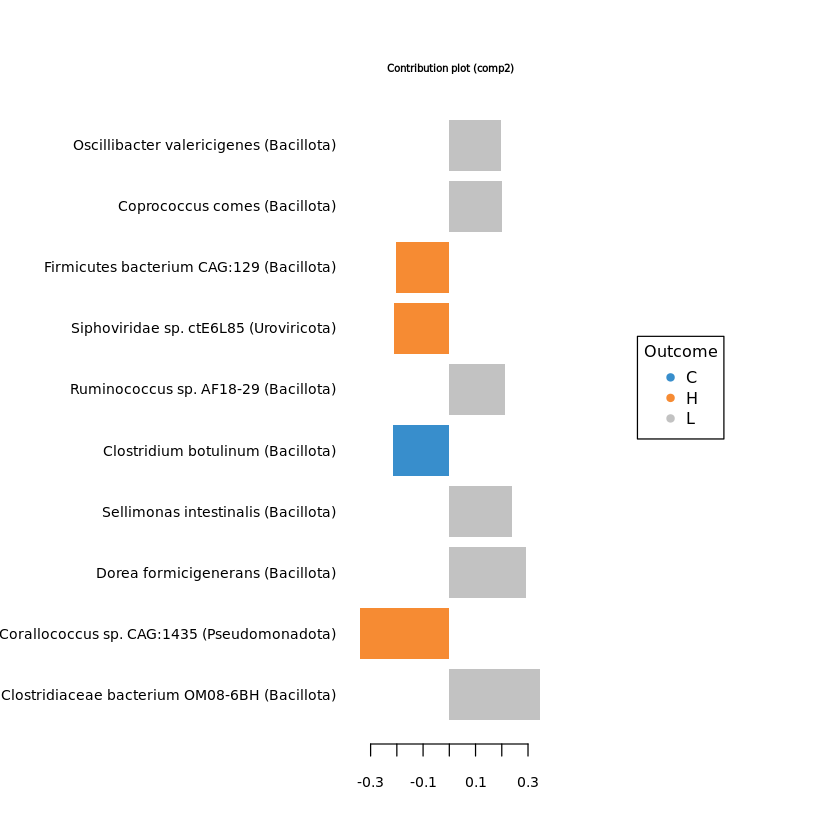

In [274]:
#plotVar(final.splsda.uniref.F0, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.F0, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = uniref.F0_names$names)
plotLoadings(final.splsda.uniref.F0, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = uniref.F0_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.F0, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.F0, comp=2)$value
F0.uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F0.uniref.load) <- F0.uniref.load[,"Row.names"]
colnames(F0.uniref.load) <- c("ft","loading_comp1","loading_comp2")
F0.uniref.load = F0.uniref.load[,c("loading_comp1","loading_comp2")]

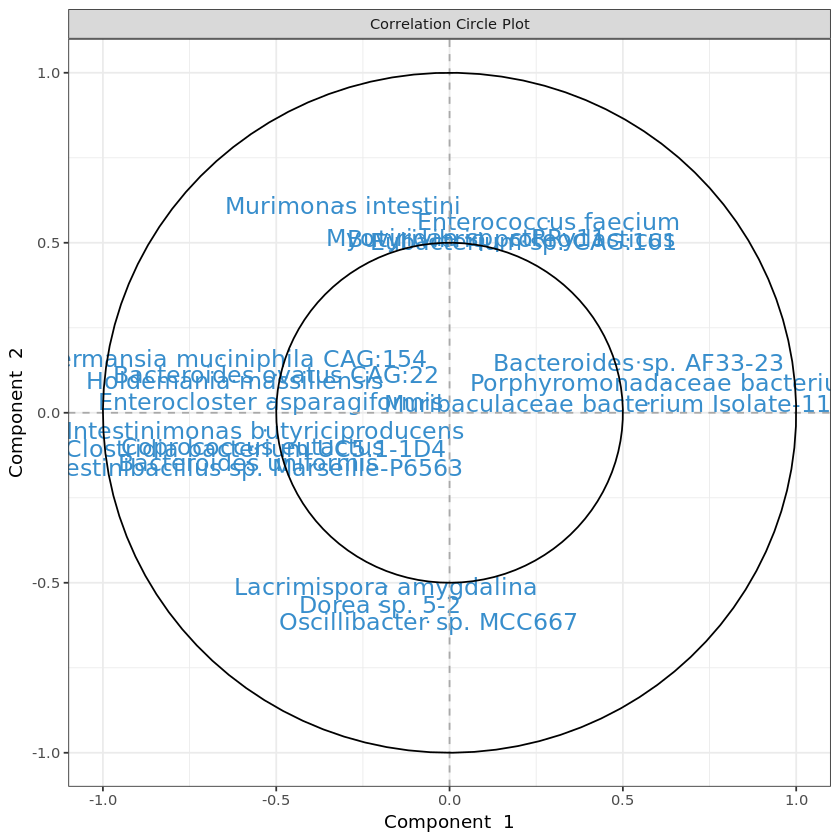

In [275]:
# plot feature correlation
plotVar(final.splsda.uniref.F0, cutoff=0.5)
uniref.F0.corr <- as.data.frame(plotVar(final.splsda.uniref.F0, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.F0.corr <- uniref.F0.corr[, c("x","y")]
colnames(uniref.F0.corr) <- c("corr_comp1","corr_comp2")

In [276]:
# Calculate feature stability
perf.splsda.uniref.F0 <- perf(final.splsda.uniref.F0, 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F0.uniref.stab <- merge(data.frame(perf.splsda.uniref.F0$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.F0$features$stable$comp2), by="Var1", all=T)
rownames(F0.uniref.stab) <- F0.uniref.stab$Var1
F0.uniref.stab <- F0.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F0.uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [432]:
# merge feature output
F0.uniref.out <- merge(F0.uniref.load, F0.uniref.stab, by="row.names")
rownames(F0.uniref.out) <- F0.uniref.out[,"Row.names"]
F0.uniref.out <- merge(F0.uniref.out[, 2:ncol(F0.uniref.out)], uniref.F0.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F0.features.tsv", F0.uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [279]:
train <- sample(1:nrow(X.uniref.F0), ceiling(nrow(X.uniref.F0)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.F0), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.F0.train <- X.uniref.F0[train, ]
X.uniref.F0.test <- X.uniref.F0[test,]
Y.uniref.F0.train <- info[train,"treatment"]
Y.uniref.F0.test <- info[test, "treatment"]
train.splsda.uniref.F0 <- splsda(X.uniref.F0.train, Y.uniref.F0.train, ncomp = uniref.F0$optimal.ncomp, keepX = uniref.F0$optimal.keepX)
predict.splsda.uniref.F0 <- predict(train.splsda.uniref.F0, X.uniref.F0.test, 
                                dist = "max.dist")
predict.comp2.uniref.F0 <- predict.splsda.uniref.F0$class$max.dist[,2]
table(factor(predict.comp2.uniref.F0, levels = levels(uniref.F0$treatment)), Y.uniref.F0.test)

   Y.uniref.F0.test
    C H L
  C 4 1 3
  H 0 3 0
  L 5 4 3

$Comp1
                 AUC   p-value
C vs Other(s) 1.0000 5.586e-06
H vs Other(s) 0.7091 5.754e-02
L vs Other(s) 0.8232 5.349e-03

$Comp2
              AUC   p-value
C vs Other(s)   1 5.586e-06
H vs Other(s)   1 5.586e-06
L vs Other(s)   1 1.644e-05



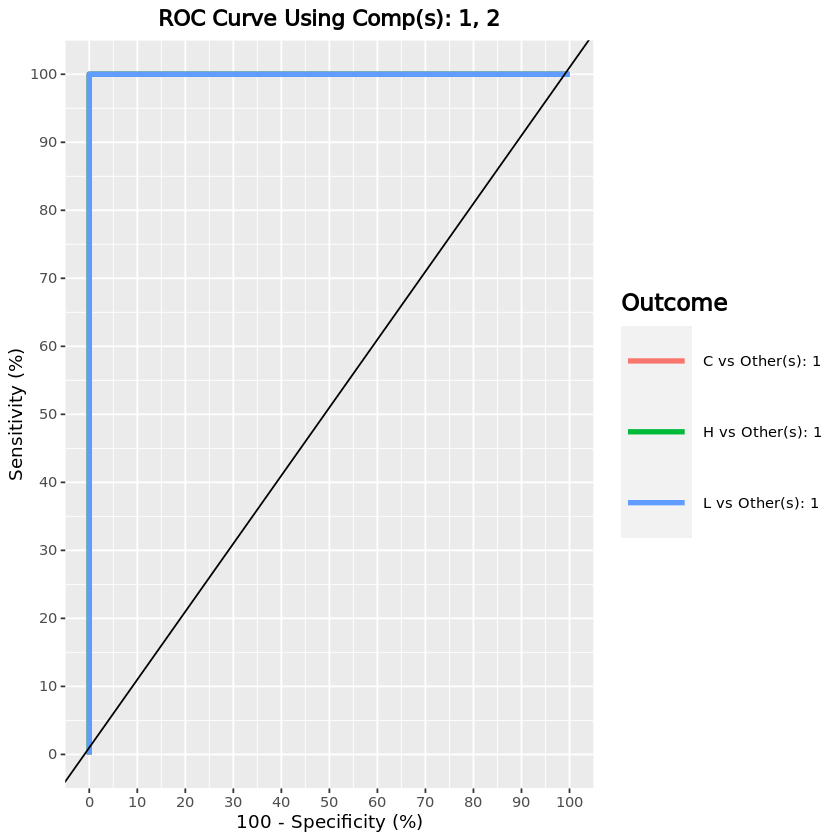

In [280]:
F0.uniref.auc.splsda = auroc(final.splsda.uniref.F0, roc.comp = 2, print = T) # AUROC for the first component

#### UniRef species - F0 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [188]:
uniref.F0_2 <- list()
F0_info_2 <- info[rownames(uniref.F0$cov),]
F0_info_2$treatment <- gsub(x = F0_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
uniref.F0_2$cov <- uniref.F0$cov[rownames(F0_info_2),]
uniref.F0_2$filtered <- uniref.F0$filtered[rownames(F0_info_2),]

uniref.F0_2$clr <- uniref.F0$clr[rownames(F0_info_2), ]
X.uniref.F0_2 <- uniref.F0_2$clr

uniref.F0_2$treatment <- factor(F0_info_2[rownames(uniref.F0_2$clr), "treatment"])

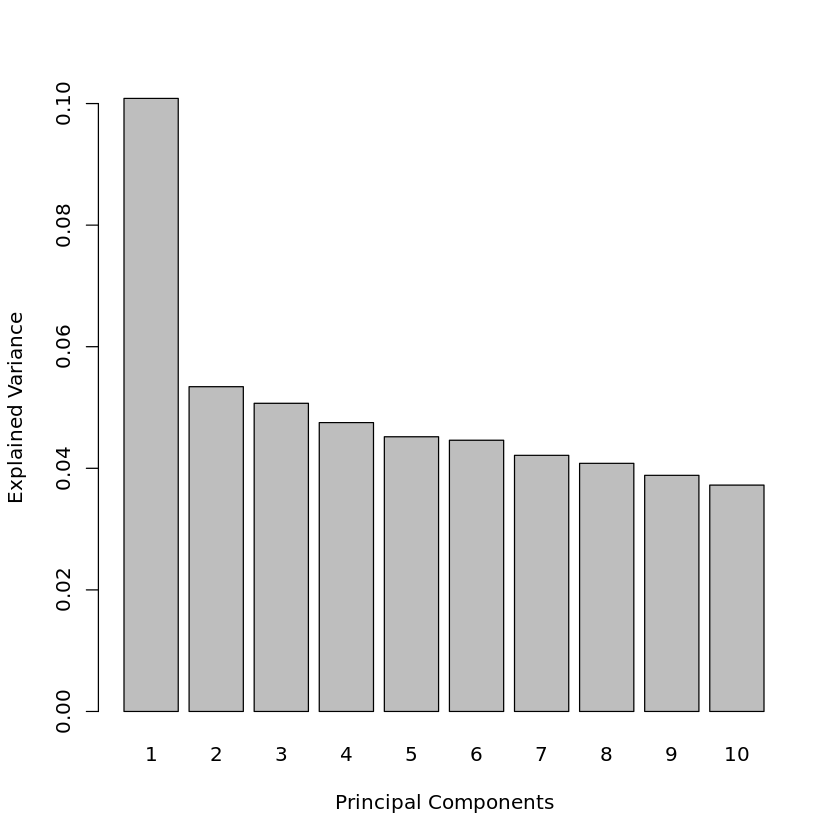

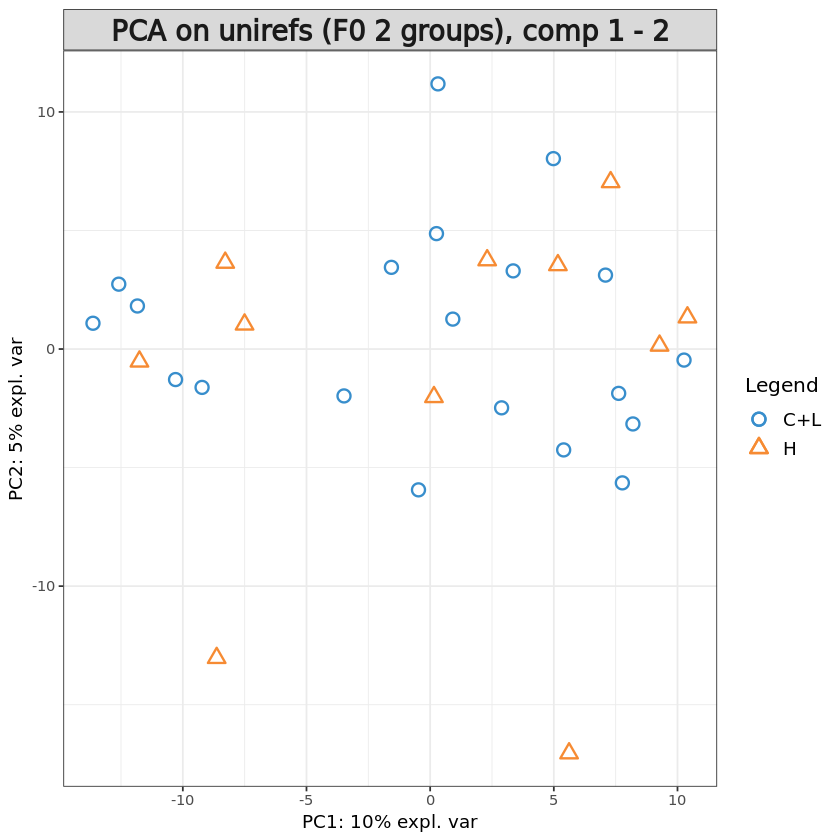

In [189]:
pca.uniref.F0_2 = pca(X.uniref.F0_2, ncomp = 10, center = TRUE, scale = TRUE) 

plot(pca.uniref.F0_2)
plotIndiv(pca.uniref.F0_2, group = uniref.F0_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on unirefs (F0 2 groups), comp 1 - 2')

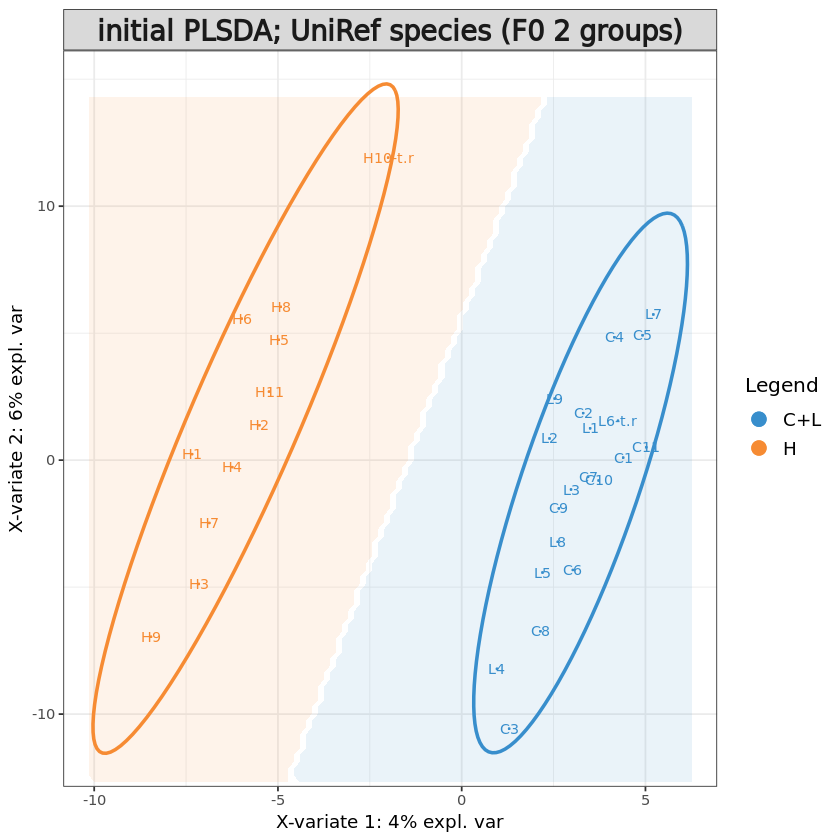

In [190]:
# Initial sPLS-DA model
uniref.F0_2.splsda <- splsda(X.uniref.F0_2, uniref.F0_2$treatment, ncomp = 10)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.F0_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.F0_2.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.F0_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef species (F0 2 groups)")

The initial model separates the two treatment groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,1,1,1
BER,1,1,1


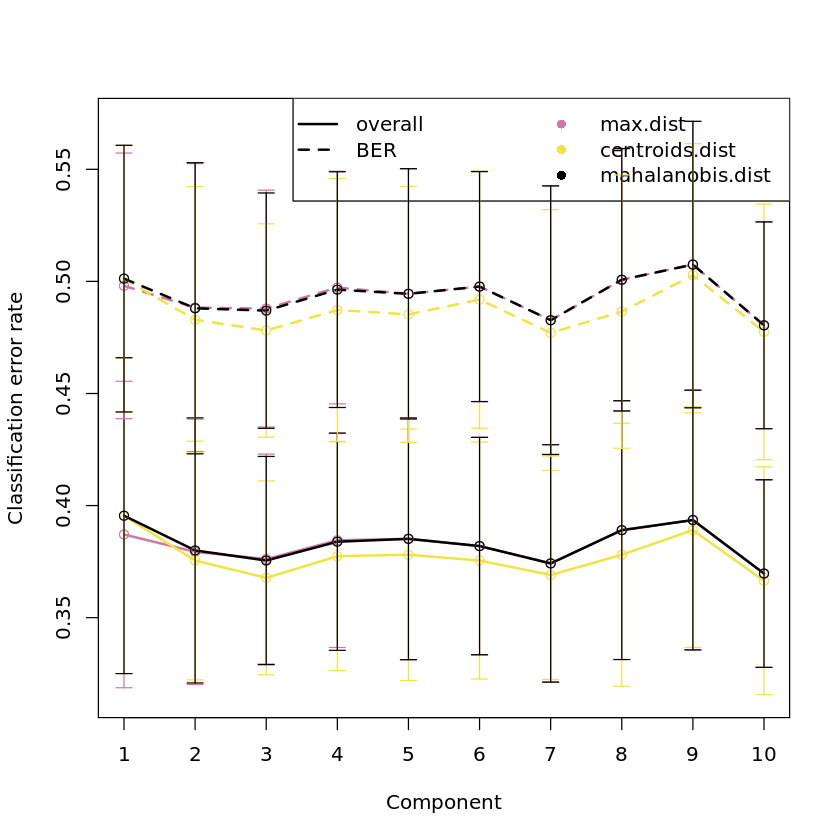

In [191]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.F0_2 <- perf(uniref.F0_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.F0_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.F0_2$choice.ncomp # what is the optimal value of components according to perf()

In [193]:
# Define parameters for tuning keepX
uniref.F0_2.step <- 0.05
uniref.F0_2.ncomp.tune <- 2
# grid of possible keepX values that will be tested for each component
uniref.F0_2.keepx <- c(10, 20, seq(ceiling(dim(uniref.F0_2$filtered)[2] * uniref.F0_2.step), 
                      round(dim(uniref.F0_2$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.F0_2$filtered)[2] * uniref.F0_2.step)
                     )
                 )
uniref.F0_2.keepx

[1]  10  20  29  58  87 116 145 174 203 232 261 290 319 348 377 406 435 464 493
[20] 522 551 580

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


[1] 1

comp1 comp2 
   10    10

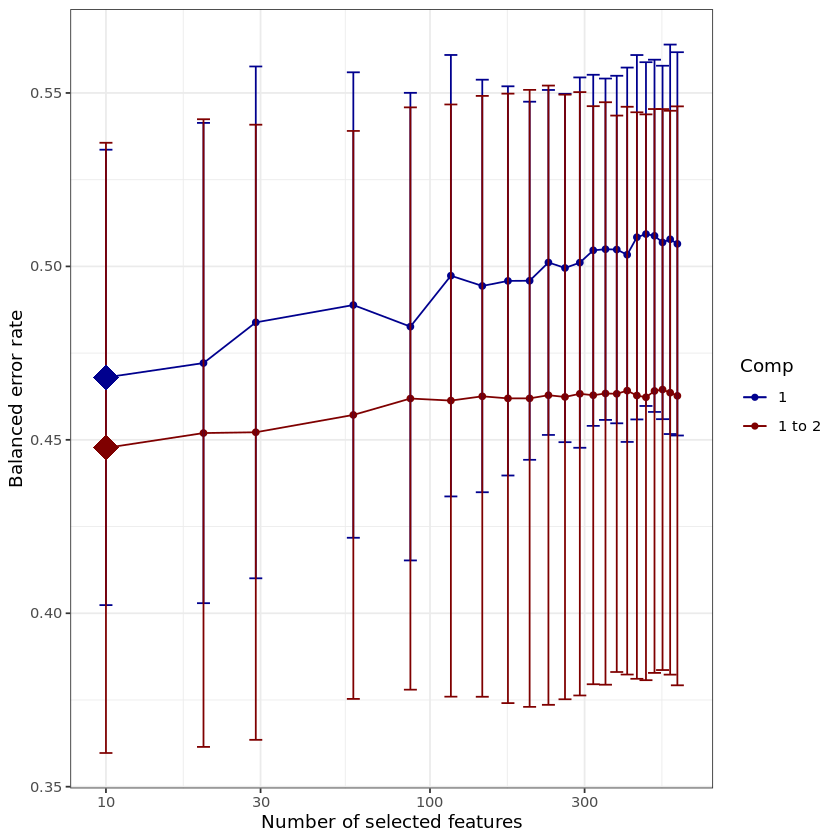

In [194]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.F0_2 <- tune.splsda(X.uniref.F0_2, uniref.F0_2$treatment, ncomp = uniref.F0_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.F0_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.F0_2, col = color.jet(uniref.F0_2.ncomp.tune))

tune.splsda.uniref.F0_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.F0_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

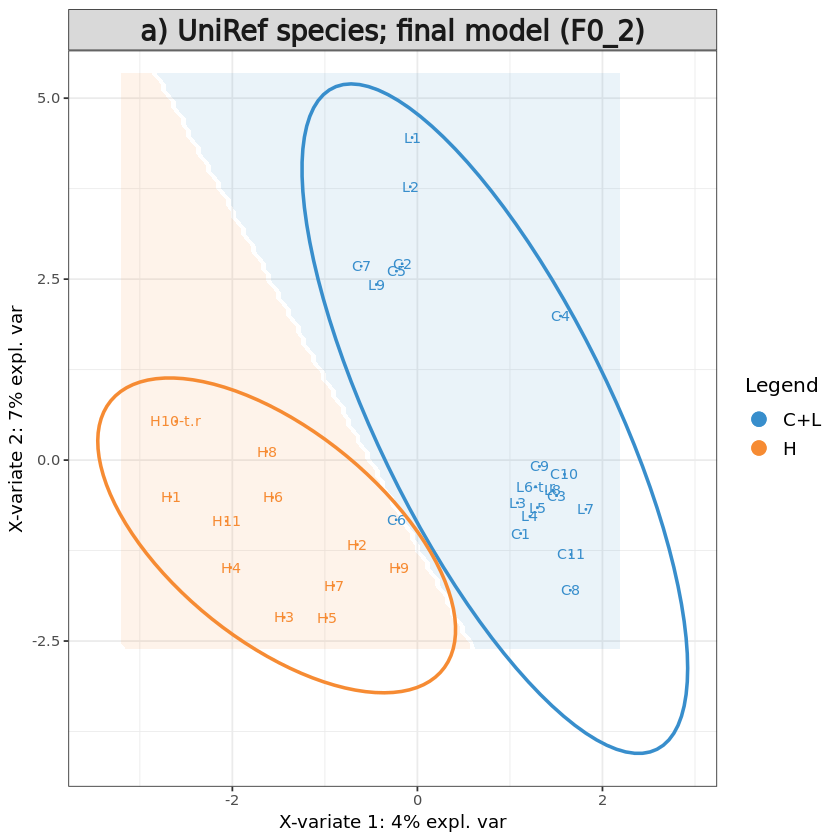

In [281]:
# Define final model
uniref.F0_2$optimal.ncomp <- 2
uniref.F0_2$optimal.keepX <- tune.splsda.uniref.F0_2$choice.keepX[1:uniref.F0_2$optimal.ncomp]
#uniref.F0_2$optimal.keepX <- rep(50, uniref.F0_2$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.uniref.F0_2 <- splsda(X.uniref.F0_2, uniref.F0_2$treatment, 
                       ncomp = uniref.F0_2$optimal.ncomp, 
                       keepX = uniref.F0_2$optimal.keepX)

background = background.predict(final.splsda.uniref.F0_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.F0_2, comp = 1:2, 
          group = uniref.F0_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) UniRef species; final model (F0_2)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.F0_2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F0_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

In [282]:
uniref.F0_2_names <- uniref_taxonomy[uniref_taxonomy$species%in%colnames(final.splsda.uniref.F0_2$X),c("phylum","family","species")]
uniref.F0_2_names$names <- paste0(uniref.F0_2_names$species," (", uniref.F0_2_names$phylum, ")")

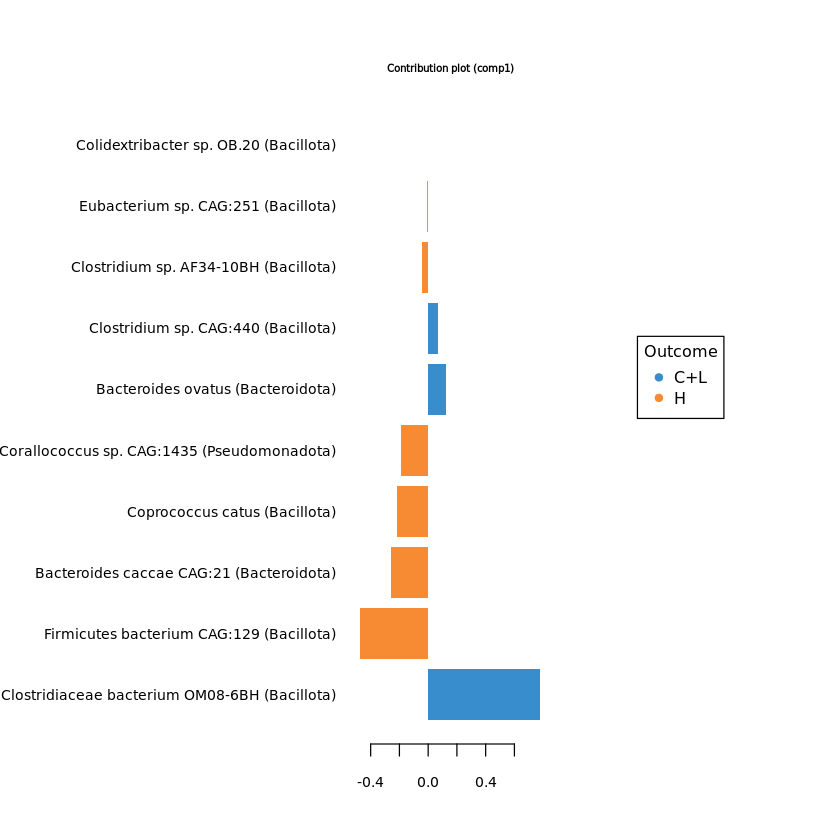

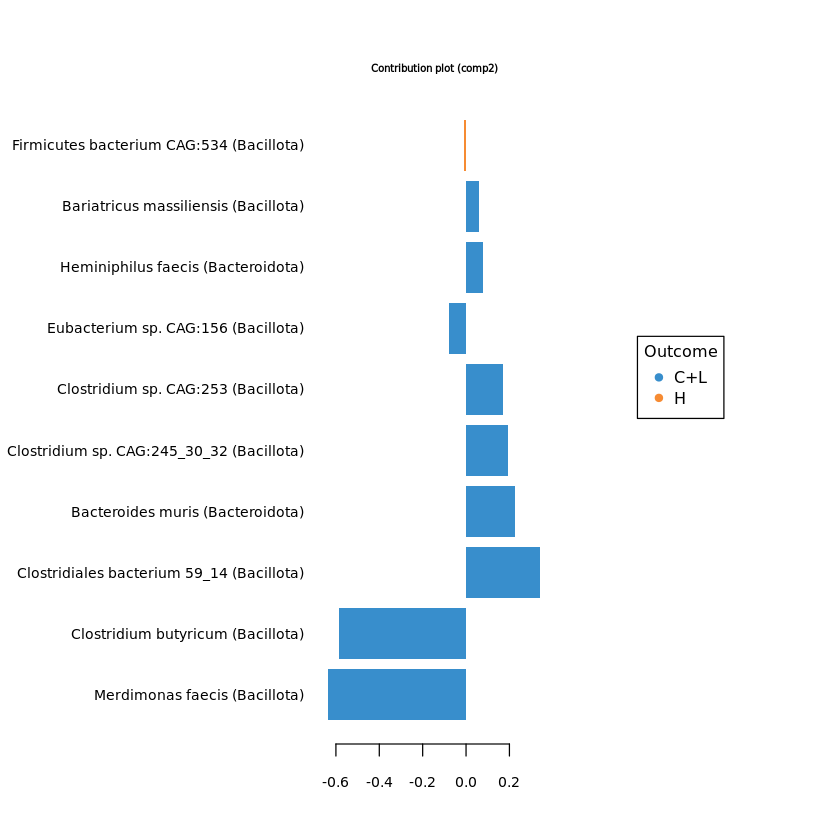

In [283]:
#plotVar(final.splsda.uniref.F0_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.F0_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = uniref.F0_2_names$names)
plotLoadings(final.splsda.uniref.F0_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = uniref.F0_2_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.F0_2, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.F0_2, comp=2)$value
F0_2.uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F0_2.uniref.load) <- F0_2.uniref.load[,"Row.names"]
colnames(F0_2.uniref.load) <- c("ft","loading_comp1","loading_comp2")
F0_2.uniref.load = F0_2.uniref.load[,c("loading_comp1","loading_comp2")]

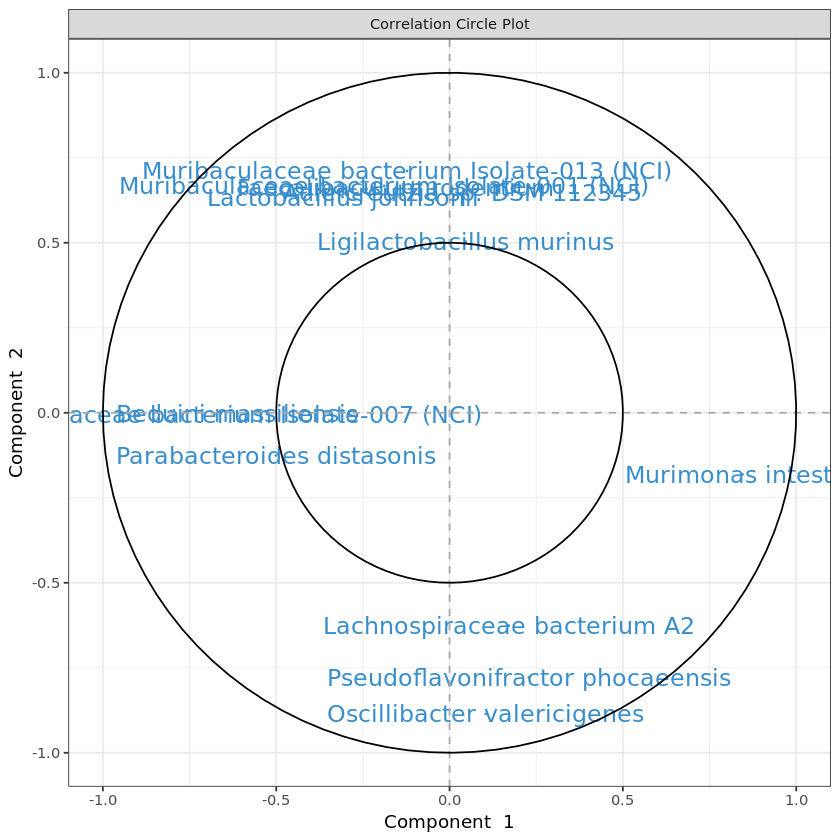

In [284]:
# plot feature correlation
plotVar(final.splsda.uniref.F0_2, cutoff=0.5)
uniref.F0_2.corr <- as.data.frame(plotVar(final.splsda.uniref.F0_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.F0_2.corr <- uniref.F0_2.corr[, c("x","y")]
colnames(uniref.F0_2.corr) <- c("corr_comp1","corr_comp2")

In [285]:
# Calculate feature stability
perf.splsda.uniref.F0_2 <- perf(final.splsda.uniref.F0_2, 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F0_2.uniref.stab <- merge(data.frame(perf.splsda.uniref.F0_2$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.F0_2$features$stable$comp2), by="Var1", all=T)
rownames(F0_2.uniref.stab) <- F0_2.uniref.stab$Var1
F0_2.uniref.stab <- F0_2.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F0_2.uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [430]:
F0_2.uniref.stab <- merge(data.frame(perf.splsda.uniref.F0_2$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.F0_2$features$stable$comp2), by="Var1", all=T)
rownames(F0_2.uniref.stab) <- F0_2.uniref.stab$Var1
F0_2.uniref.stab <- F0_2.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F0_2.uniref.stab) <- c("stability_comp1","stability_comp2")
# merge feature output
F0_2.uniref.out <- merge(F0_2.uniref.load, F0_2.uniref.stab, by="row.names")
rownames(F0_2.uniref.out) <- F0_2.uniref.out[,"Row.names"]
F0_2.uniref.out <- merge(F0_2.uniref.out[, 2:ncol(F0_2.uniref.out)], uniref.F0_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F0_2.features.tsv", F0_2.uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [287]:
train <- sample(1:nrow(X.uniref.F0_2), ceiling(nrow(X.uniref.F0_2)/3)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.F0_2), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.F0_2.train <- X.uniref.F0_2[train, ]
X.uniref.F0_2.test <- X.uniref.F0_2[test,]
Y.uniref.F0_2.train <- F0_info_2[train,"treatment"]
Y.uniref.F0_2.test <- F0_info_2[test, "treatment"]
train.splsda.uniref.F0_2 <- splsda(X.uniref.F0_2.train, Y.uniref.F0_2.train, ncomp = uniref.F0_2$optimal.ncomp, keepX = uniref.F0_2$optimal.keepX)
predict.splsda.uniref.F0_2 <- predict(train.splsda.uniref.F0_2, X.uniref.F0_2.test, 
                                dist = "max.dist")
predict.comp2.uniref.F0_2 <- predict.splsda.uniref.F0_2$class$max.dist[,2]
table(factor(predict.comp2.uniref.F0_2, levels = levels(uniref.F0_2$treatment)), Y.uniref.F0_2.test)

     Y.uniref.F0_2.test
      C+L  H
  C+L   3  3
  H    11  3

$Comp1
            AUC   p-value
C+L vs H 0.9818 1.207e-05

$Comp2
         AUC   p-value
C+L vs H   1 5.586e-06



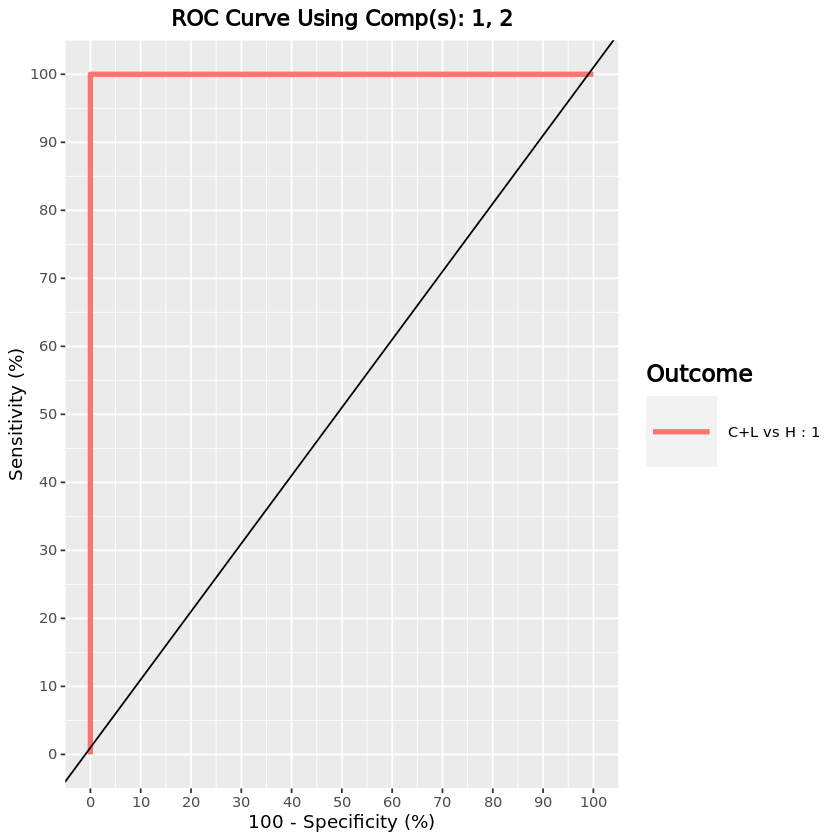

In [288]:
F0_2.uniref.auc.splsda = auroc(final.splsda.uniref.F0_2, roc.comp = 2, print = T)

#### UniRef species - F1 generation

[1] "3518"            "species removed" "542"             "remaining"

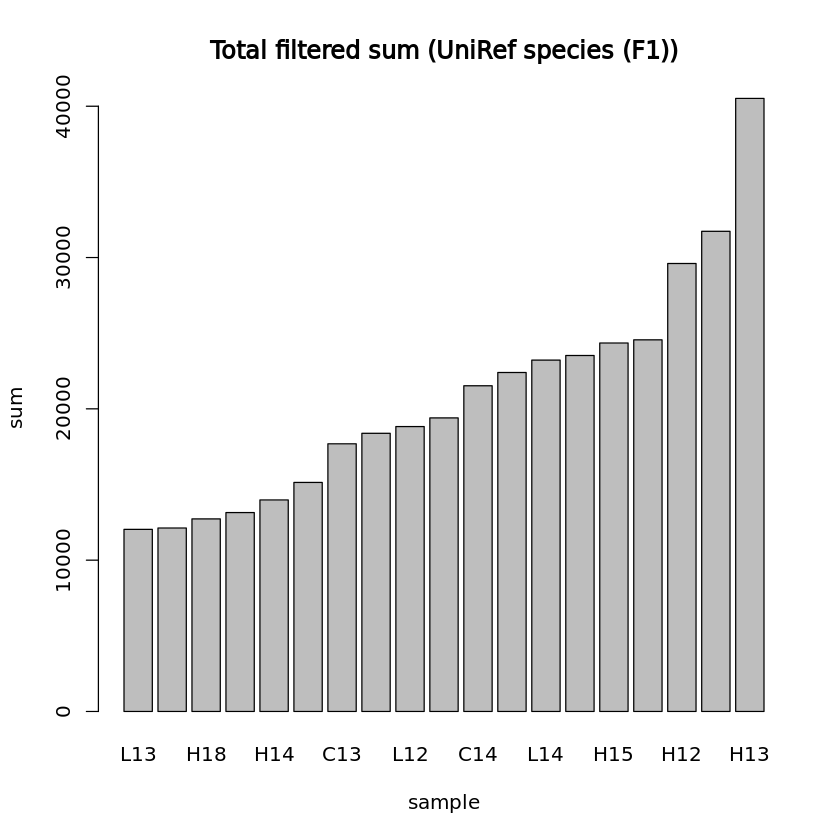

In [216]:
## PARAMS ##
# Initial components
uniref.F1.ncomp <- 5
# Percentage of samples in which features must have >0 sum
uniref.F1.percent_occ <- 10
# Quantile used for removing low abundance features
uniref.F1.quantile_thresh <- 0.1
generation <- "F1"

uniref.F1 <- list()
uniref.F1$cov <- uniref$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(uniref.F1$cov[, colSums(uniref.F1$cov) > 0])
uniref.F1$nz <- uniref.F1$cov[, colnames(uniref.F1$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(uniref.F1$nz) / sum(colSums(uniref.F1$nz)) * 100, probs = uniref.F1.quantile_thresh)
uniref.F1$filtered <- low.count.removal(uniref.F1$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
uniref.F1$occ <- colSums(uniref.F1$filtered>0) / nrow(uniref.F1$filtered) * 100
# Keep features occurring in defined percentage of samples
uniref.F1$filtered <- uniref.F1$filtered[, which(uniref.F1$occ >= uniref.F1.percent_occ)]

#uniref.F1$filtered <- uniref.F1$filtered[,-nearZeroVar(uniref.F1$filtered)$Position]
paste0(c(dim(uniref.F1$cov)[2] - dim(uniref.F1$filtered)[2], "species removed", dim(uniref.F1$filtered)[2], "remaining"))

# Add offset
uniref.F1$offset <- uniref.F1$filtered + 1
uniref.F1$clr <- logratio.transfo(uniref.F1$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.uniref.F1 <- uniref.F1$clr

uniref.F1$treatment <- factor(info[rownames(uniref.F1$clr), "Treatment"])
uniref.F1.lib.size <- apply(uniref.F1$filtered, 1, sum) # determine total count for each sample
barplot(sort(uniref.F1.lib.size), main="Total filtered sum (UniRef species (F1))", ylab="sum", xlab="sample")

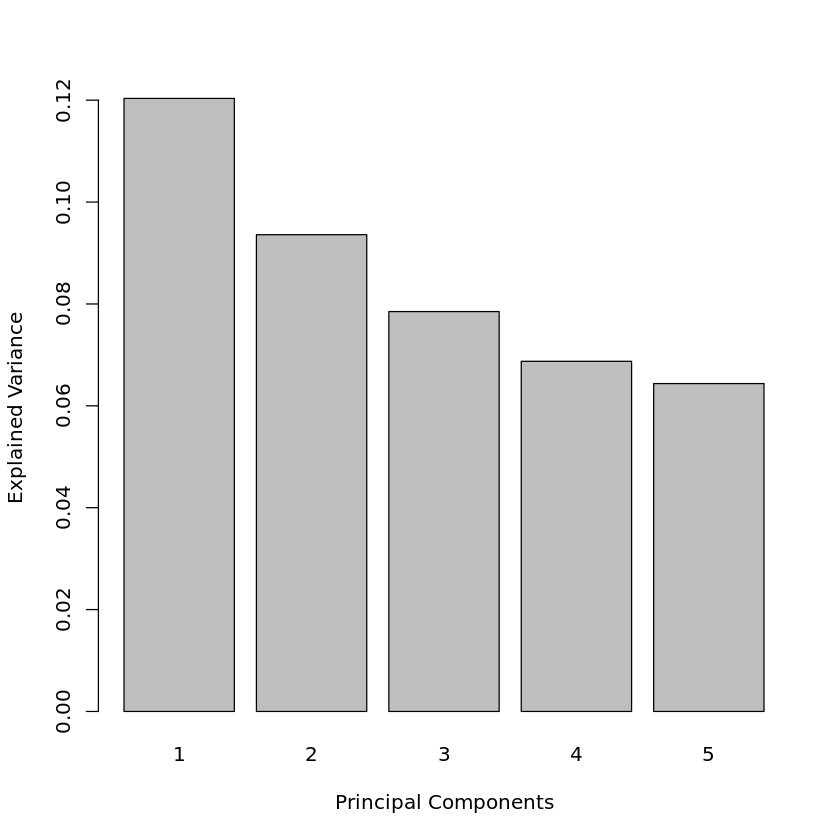

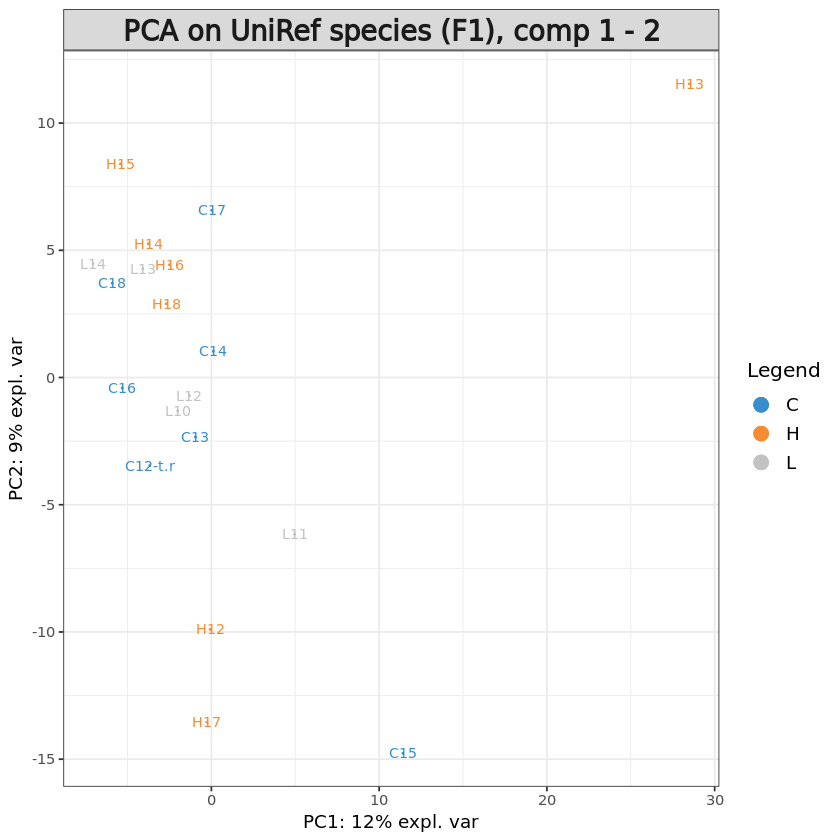

In [217]:
pca.uniref.F1 = pca(X.uniref.F1, ncomp = uniref.F1.ncomp, center = TRUE, scale = TRUE) 

plot(pca.uniref.F1)
plotIndiv(pca.uniref.F1, group = uniref.F1$treatment, ind.names = TRUE, # plot the samples projected
          legend = TRUE, title = 'PCA on UniRef species (F1), comp 1 - 2')

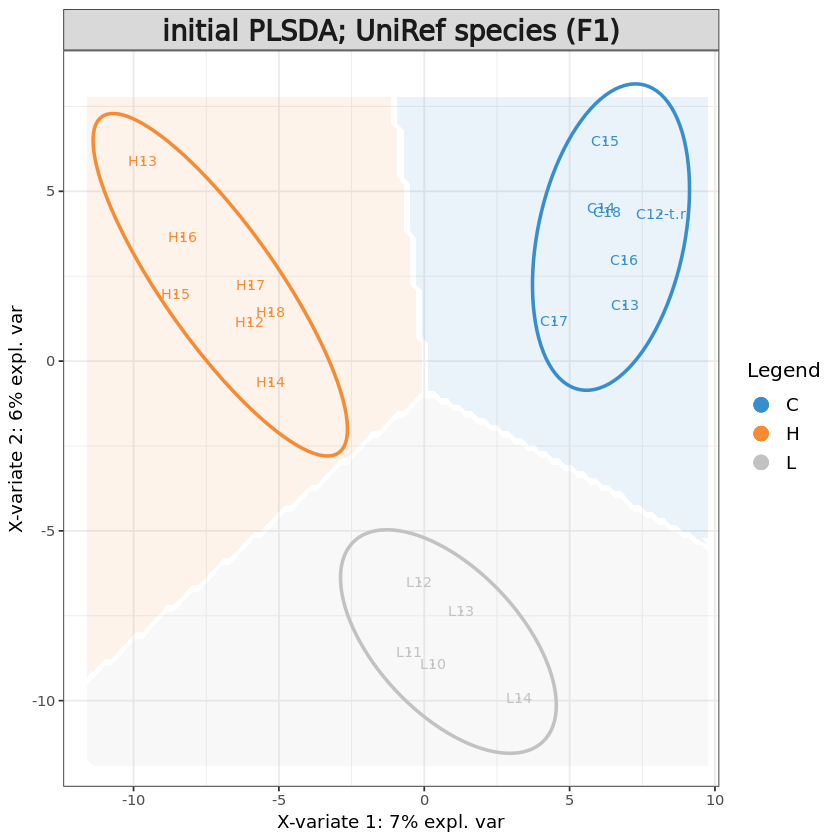

In [218]:
# Initial sPLS-DA model
uniref.F1.splsda <- splsda(X.uniref.F1, uniref.F1$treatment, ncomp = uniref.F1.ncomp)  # set ncomp to 10 for performance assessment later

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.F1.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.F1.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.F1$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef species (F1)")

The initial model does separate the sample groups, with component 1 characterizing Control vs H+L and Component 2 characterizing L vs H.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,5,3,1
BER,5,3,1


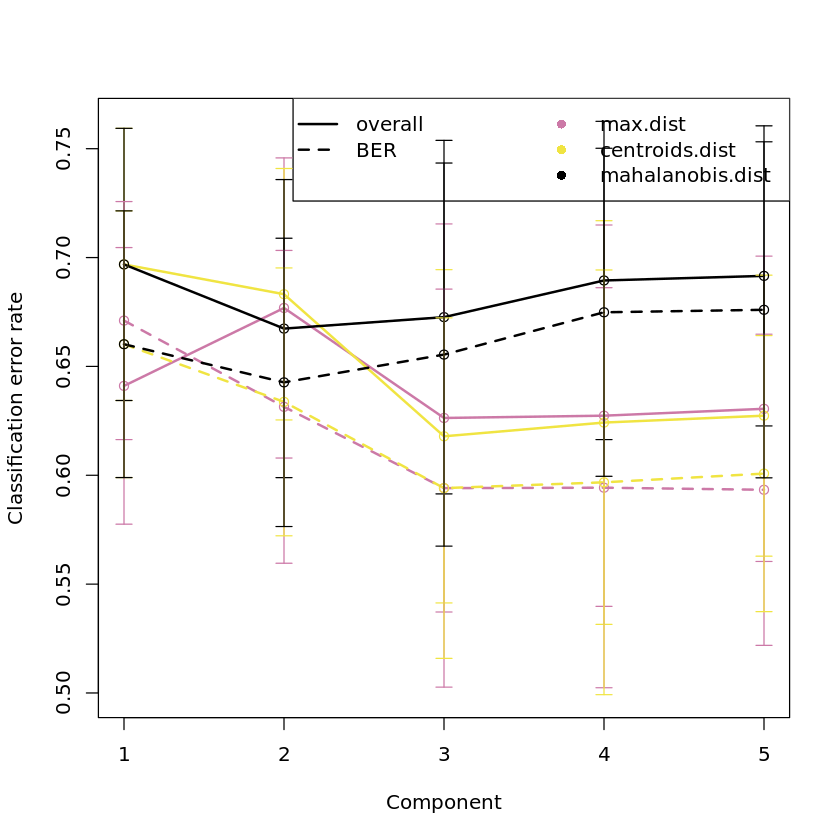

In [219]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.F1 <- perf(uniref.F1.splsda, validation = "Mfold", 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.F1, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.F1$choice.ncomp # what is the optimal value of components according to perf()

Tuning the `ncomp` parameter suggests that 3 components is best here.

In [220]:
# Define parameters for tuning keepX
uniref.F1.step <- 0.05
uniref.F1.ncomp.tune <- 5
# grid of possible keepX values that will be tested for each component
uniref.F1.keepx <- c(10, 20, seq(ceiling(dim(uniref.F1$filtered)[2] * uniref.F1.step), 
                      round(dim(uniref.F1$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.F1$filtered)[2] * uniref.F1.step)
                     )
                 )
uniref.F1.keepx

[1]  10  20  28  56  84 112 140 168 196 224 252 280 308 336 364 392 420 448 476
[20] 504 532

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


[1] 1

comp1 comp2 comp3 comp4 comp5 
   28    20   532    28    20

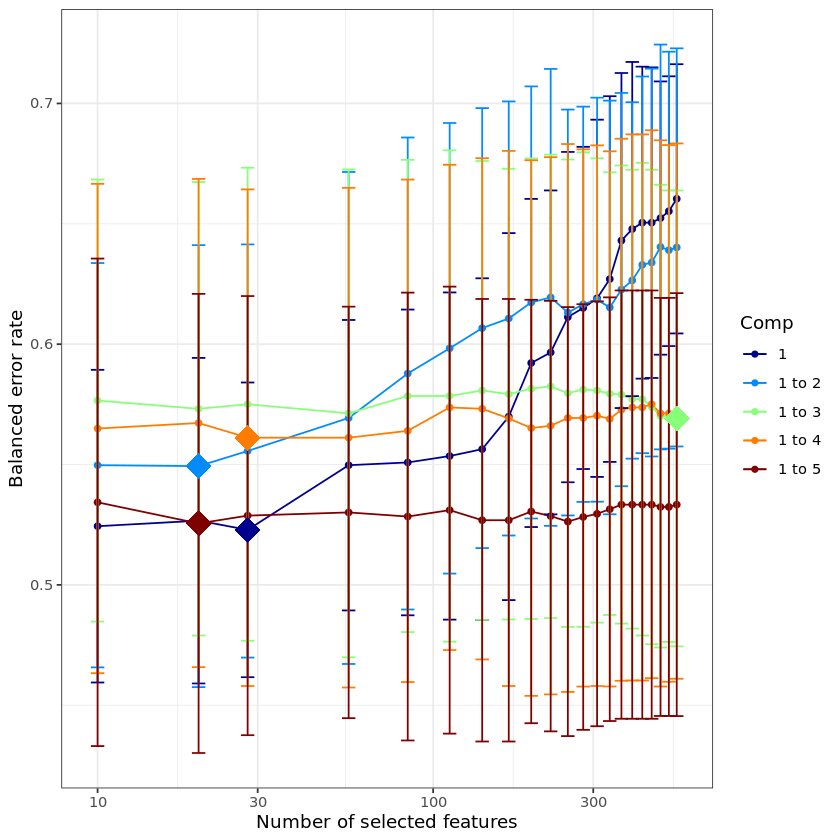

In [221]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.F1 <- tune.splsda(X.uniref.F1, uniref.F1$treatment, ncomp = uniref.F1.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.F1.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.F1, col = color.jet(uniref.F1.ncomp.tune))

tune.splsda.uniref.F1$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.F1$choice.keepX # what are the optimal values of variables according to tune.splsda()

As before, the error rates are high here with large standard deviations for the different keepX values tested. In fact the samples less separated by treatment when using the tuned keepX values than when using all features as in the initial model. Therefore we will set keepX to 50 for each component.

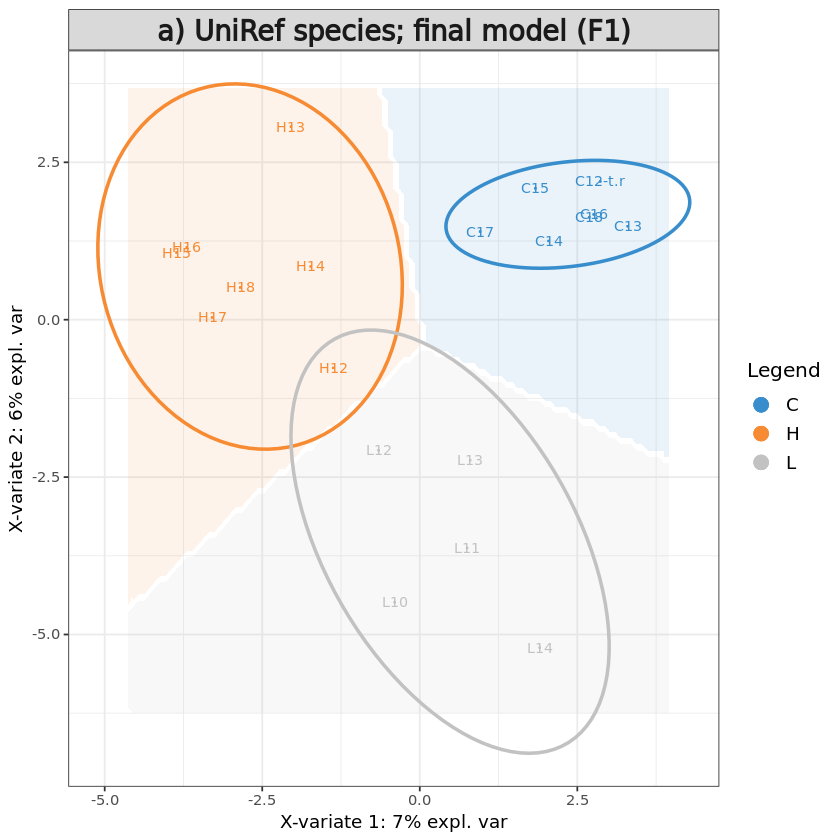

In [223]:
# Define final model
uniref.F1$optimal.ncomp <- 2
uniref.F1$optimal.keepX <- tune.splsda.uniref.F1$choice.keepX[1:uniref.F1$optimal.ncomp]
#uniref.F1$optimal.keepX <- rep(50, uniref.F1$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.uniref.F1 <- splsda(X.uniref.F1, uniref.F1$treatment, 
                       ncomp = uniref.F1$optimal.ncomp, 
                       keepX = uniref.F1$optimal.keepX)

background = background.predict(final.splsda.uniref.F1, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.F1, comp = 1:2, 
          group = uniref.F1$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) UniRef species; final model (F1)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.F1$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F1.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

In [224]:
uniref.F1_names <- uniref_taxonomy[uniref_taxonomy$species%in%colnames(final.splsda.uniref.F1$X),c("phylum","family","species")]
uniref.F1_names$names <- paste0(uniref.F1_names$species," (", uniref.F1_names$phylum, ")")

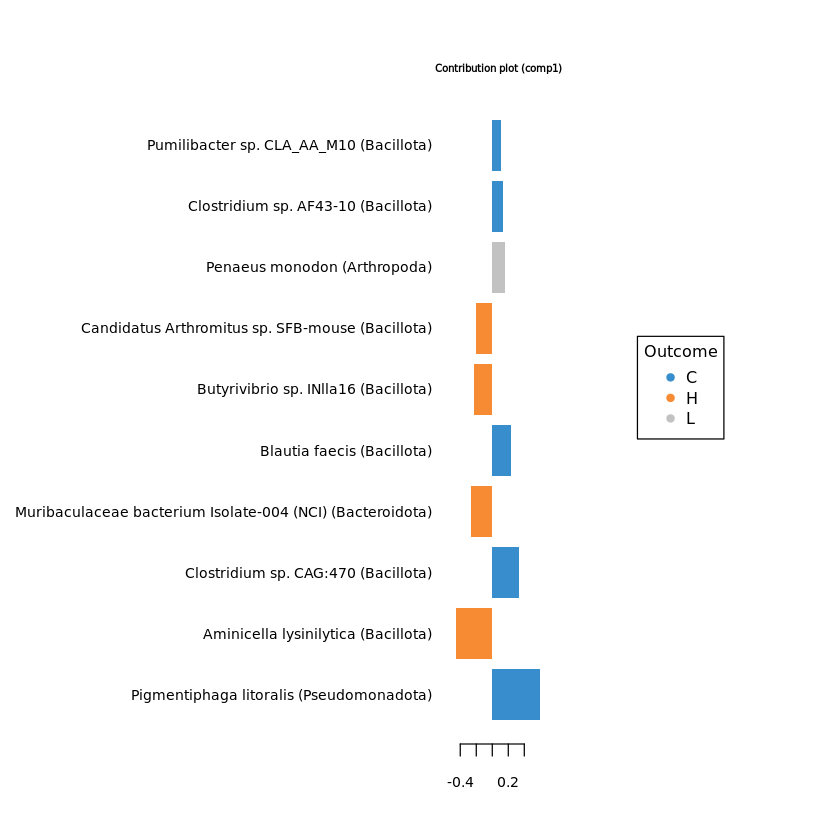

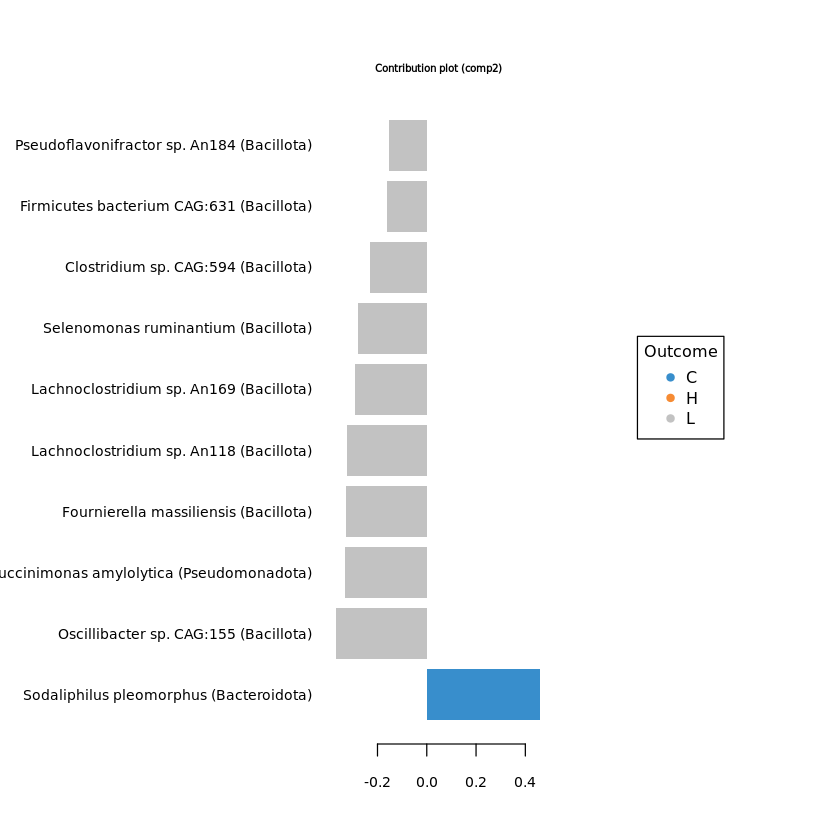

In [264]:
#plotVar(final.splsda.uniref.F1, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.F1, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = uniref.F1_names$names)
plotLoadings(final.splsda.uniref.F1, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = uniref.F1_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.F1, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.F1, comp=2)$value
F1.uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F1.uniref.load) <- F1.uniref.load[,"Row.names"]
colnames(F1.uniref.load) <- c("ft","loading_comp1","loading_comp2")
F1.uniref.load = F1.uniref.load[,c("loading_comp1","loading_comp2")]

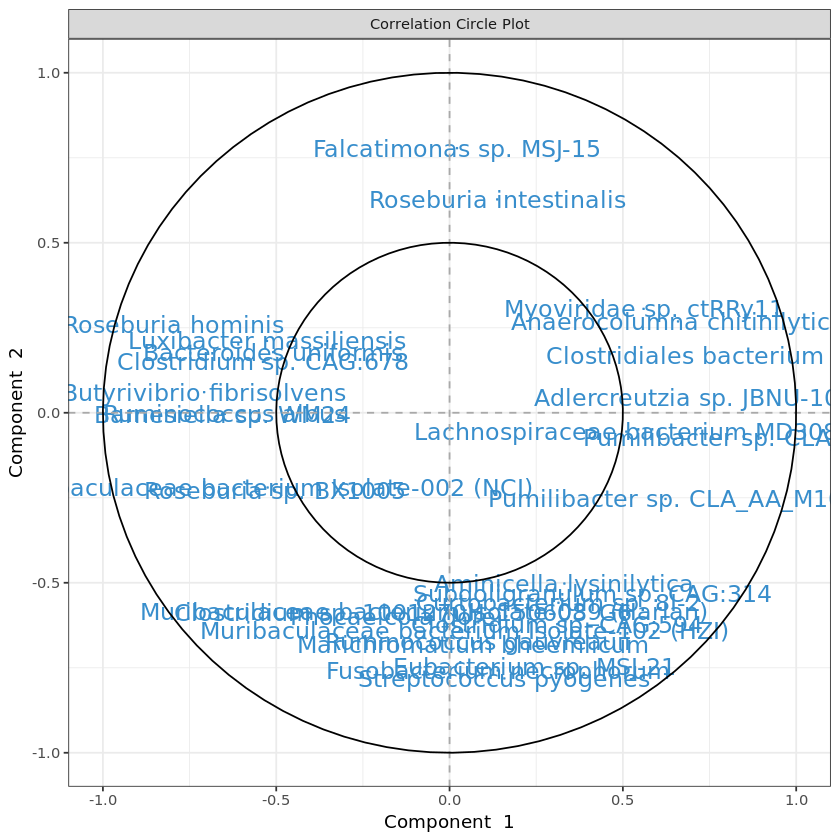

In [226]:
# plot feature correlation
plotVar(final.splsda.uniref.F1, cutoff=0.5)
uniref.F1.corr <- as.data.frame(plotVar(final.splsda.uniref.F1, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.F1.corr <- uniref.F1.corr[, c("x","y")]
colnames(uniref.F1.corr) <- c("corr_comp1","corr_comp2")

In [263]:
# Calculate feature stability
perf.splsda.uniref.F1 <- perf(final.splsda.uniref.F1, 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F1.uniref.stab <- merge(data.frame(perf.splsda.uniref.F1$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.F1$features$stable$comp2), by="Var1", all=T)
rownames(F1.uniref.stab) <- F1.uniref.stab$Var1
F1.uniref.stab <- F1.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F1.uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [429]:
# merge feature output
F1.uniref.out <- merge(F1.uniref.load, F1.uniref.stab, by="row.names")
rownames(F1.uniref.out) <- F1.uniref.out[,"Row.names"]
F1.uniref.out <- merge(F1.uniref.out[, 2:ncol(F1.uniref.out)], uniref.F1.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F1.features.tsv", F1.uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [235]:
train <- sample(1:nrow(X.uniref.F1), ceiling(nrow(X.uniref.F1)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.F1), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.F1.train <- X.uniref.F1[train, ]
X.uniref.F1.test <- X.uniref.F1[test,]
Y.uniref.F1.train <- info[train,"treatment"]
Y.uniref.F1.test <- info[test, "treatment"]
train.splsda.uniref.F1 <- splsda(X.uniref.F1.train, Y.uniref.F1.train, ncomp = uniref.F1$optimal.ncomp, keepX = uniref.F1$optimal.keepX)
predict.splsda.uniref.F1 <- predict(train.splsda.uniref.F1, X.uniref.F1.test, 
                                dist = "max.dist")
predict.comp2.uniref.F1 <- predict.splsda.uniref.F1$class$max.dist[,2]
table(factor(predict.comp2.uniref.F1, levels = levels(uniref.F1$treatment)), Y.uniref.F1.test)

   Y.uniref.F1.test
    C H L
  C 0 4 4
  H 2 3 1
  L 0 0 0

$Comp1
                 AUC   p-value
C vs Other(s) 0.9762 0.0007232
H vs Other(s) 1.0000 0.0003857
L vs Other(s) 0.5286 0.8531000

$Comp2
              AUC   p-value
C vs Other(s)   1 0.0003857
H vs Other(s)   1 0.0003857
L vs Other(s)   1 0.0011940



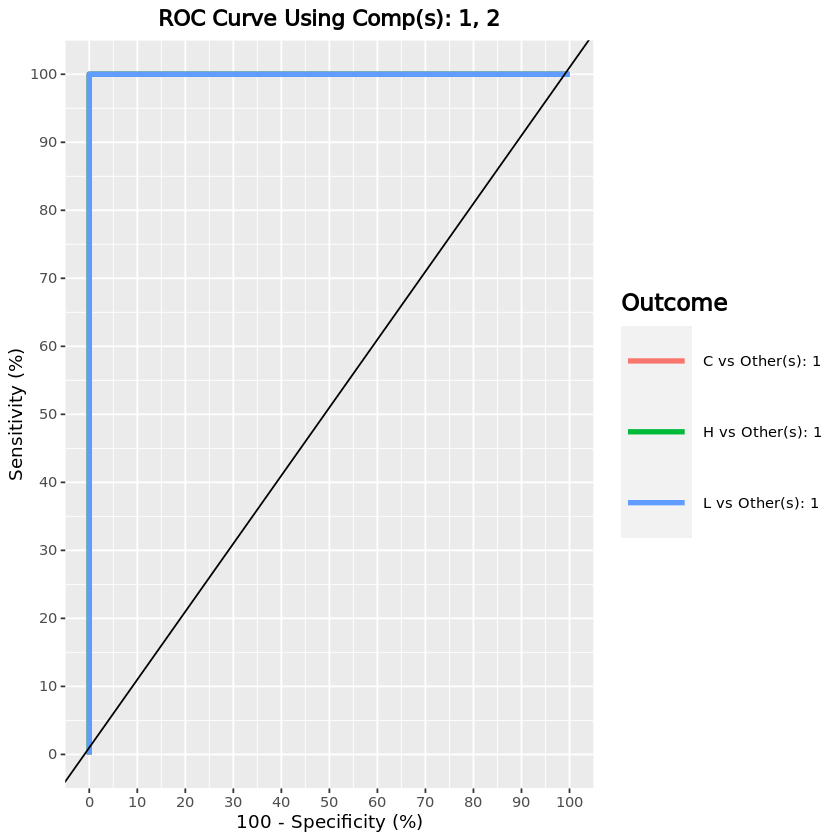

In [261]:
F1.uniref.auc.splsda = auroc(final.splsda.uniref.F1, roc.comp = 2, print = T)

#### UniRef species - F1 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [240]:
uniref.F1_2 <- list()
F1_info_2 <- info[rownames(uniref.F1$cov),]
F1_info_2$treatment <- gsub(x = F1_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
uniref.F1_2$cov <- uniref.F1$cov[rownames(F1_info_2),]
uniref.F1_2$filtered <- uniref.F1$filtered[rownames(F1_info_2),]

uniref.F1_2$clr <- uniref.F1$clr[rownames(F1_info_2), ]
X.uniref.F1_2 <- uniref.F1_2$clr

uniref.F1_2$treatment <- factor(F1_info_2[rownames(uniref.F1_2$clr), "treatment"])

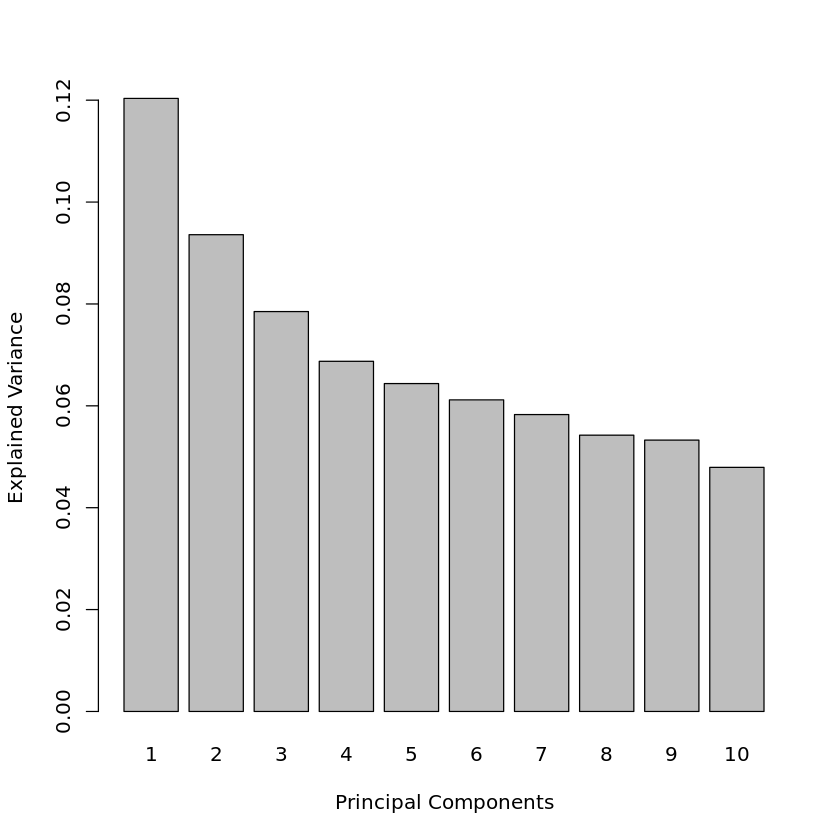

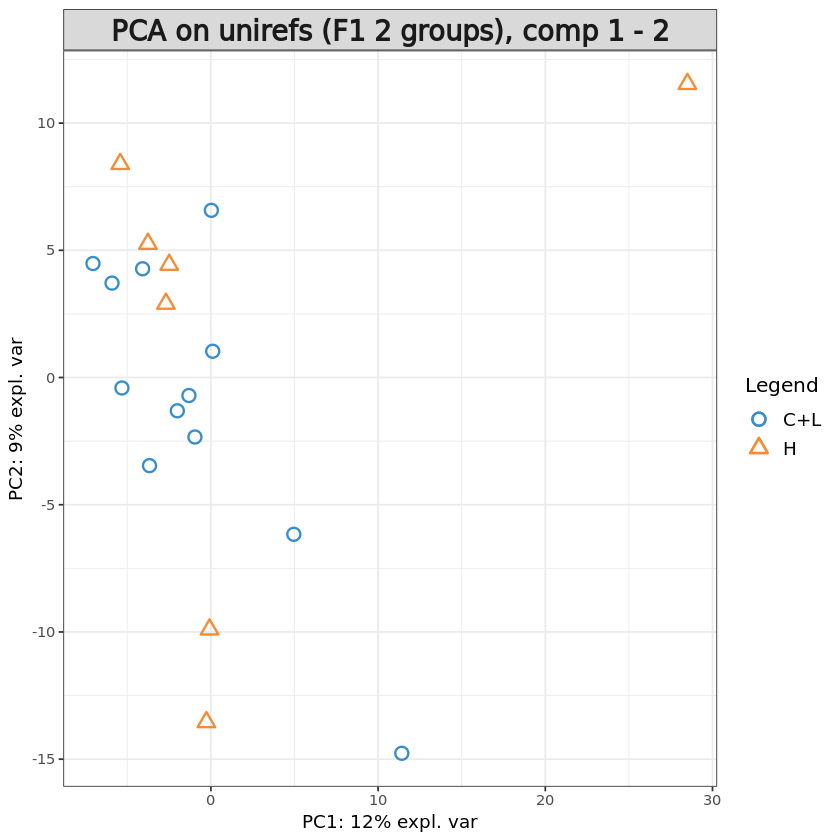

In [241]:
pca.uniref.F1_2 = pca(X.uniref.F1_2, ncomp = 10, center = TRUE, scale = TRUE) 

plot(pca.uniref.F1_2)
plotIndiv(pca.uniref.F1_2, group = uniref.F1_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on unirefs (F1 2 groups), comp 1 - 2')

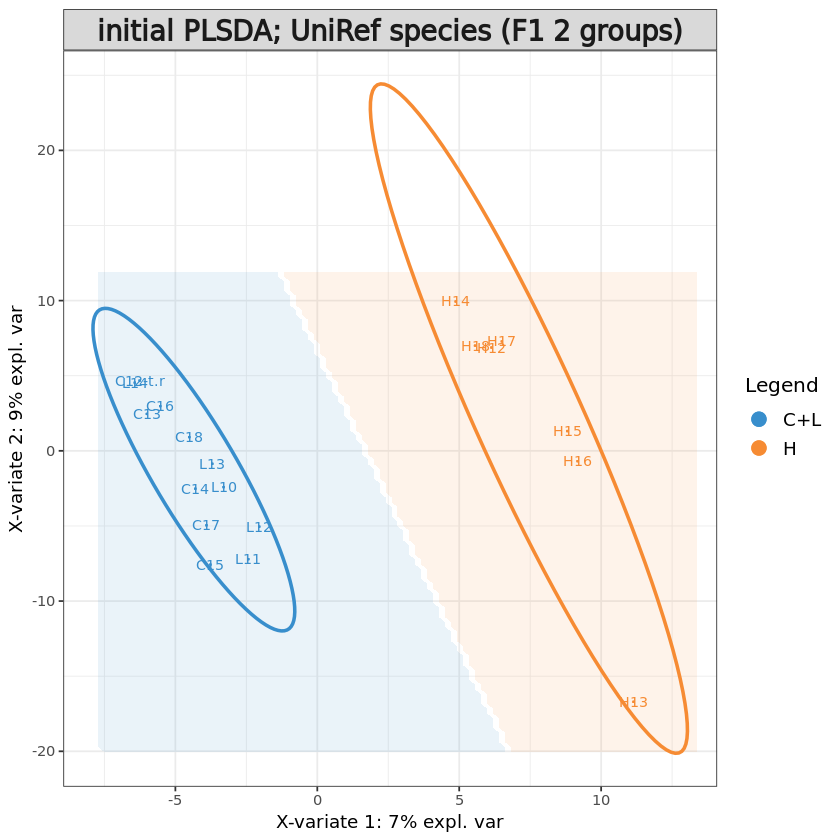

In [242]:
# Initial sPLS-DA model
uniref.F1_2.splsda <- splsda(X.uniref.F1_2, uniref.F1_2$treatment, ncomp = 5)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.F1_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.F1_2.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.F1_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef species (F1 2 groups)")

The initial model separates the two treatment groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,4,4,4
BER,4,4,4


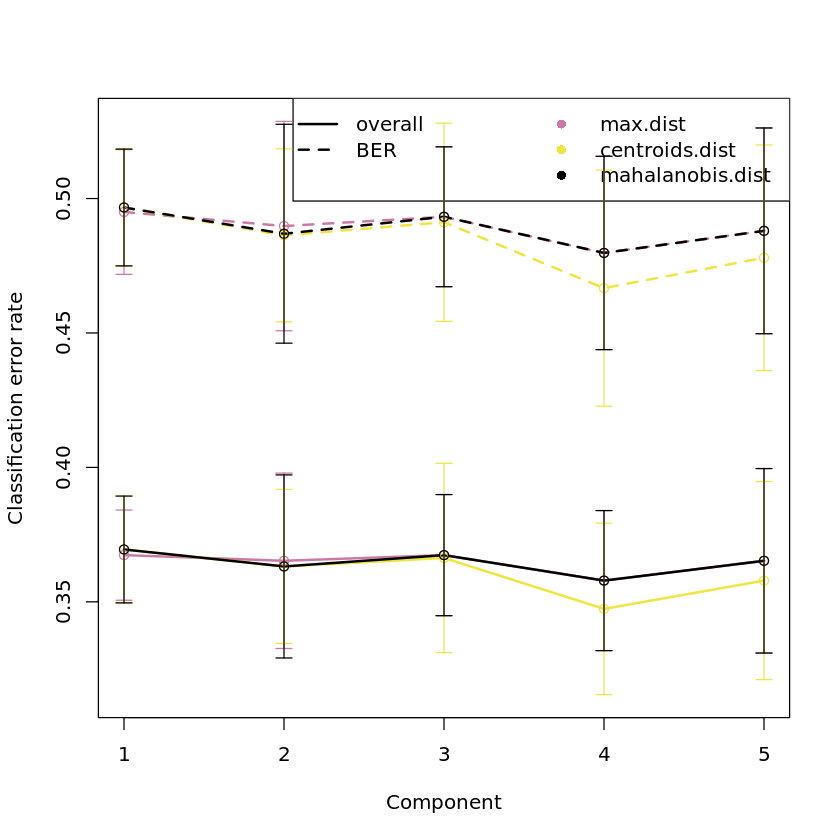

In [243]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.F1_2 <- perf(uniref.F1_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.F1_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.F1_2$choice.ncomp # what is the optimal value of components according to perf()

In [246]:
# Define parameters for tuning keepX
uniref.F1_2.step <- 0.05
uniref.F1_2.ncomp.tune <- 2
# grid of possible keepX values that will be tested for each component
uniref.F1_2.keepx <- c(10, 20, seq(ceiling(dim(uniref.F1_2$filtered)[2] * uniref.F1_2.step), 
                      round(dim(uniref.F1_2$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.F1_2$filtered)[2] * uniref.F1_2.step)
                     )
                 )
uniref.F1_2.keepx

[1]  10  20  28  56  84 112 140 168 196 224 252 280 308 336 364 392 420 448 476
[20] 504 532

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


[1] 1

comp1 comp2 
   10    10

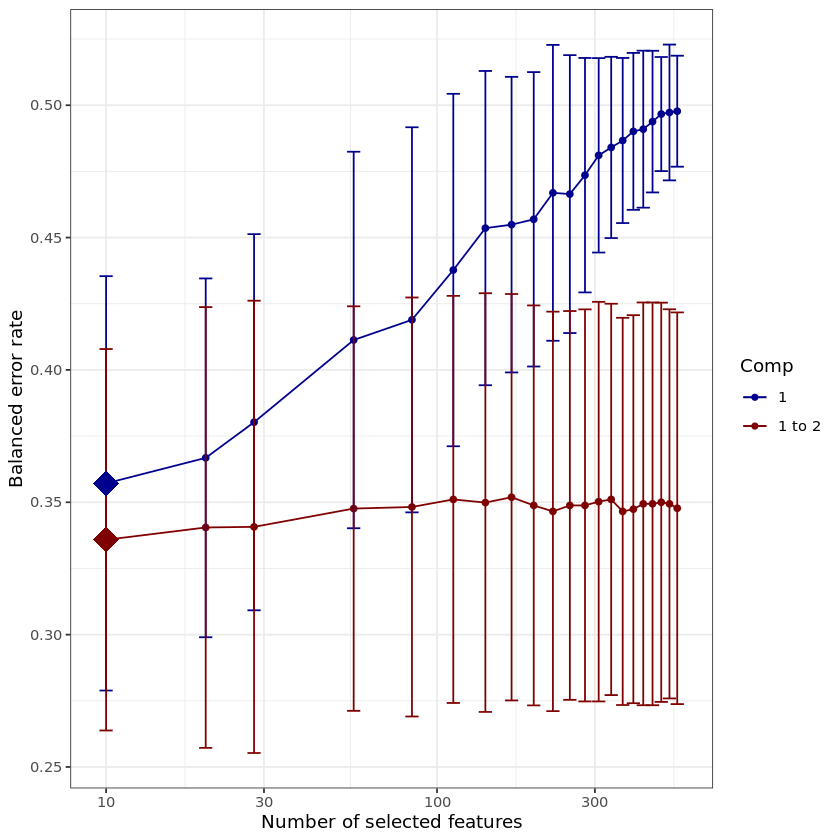

In [247]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.F1_2 <- tune.splsda(X.uniref.F1_2, uniref.F1_2$treatment, ncomp = uniref.F1_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.F1_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.F1_2, col = color.jet(uniref.F1_2.ncomp.tune))

tune.splsda.uniref.F1_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.F1_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

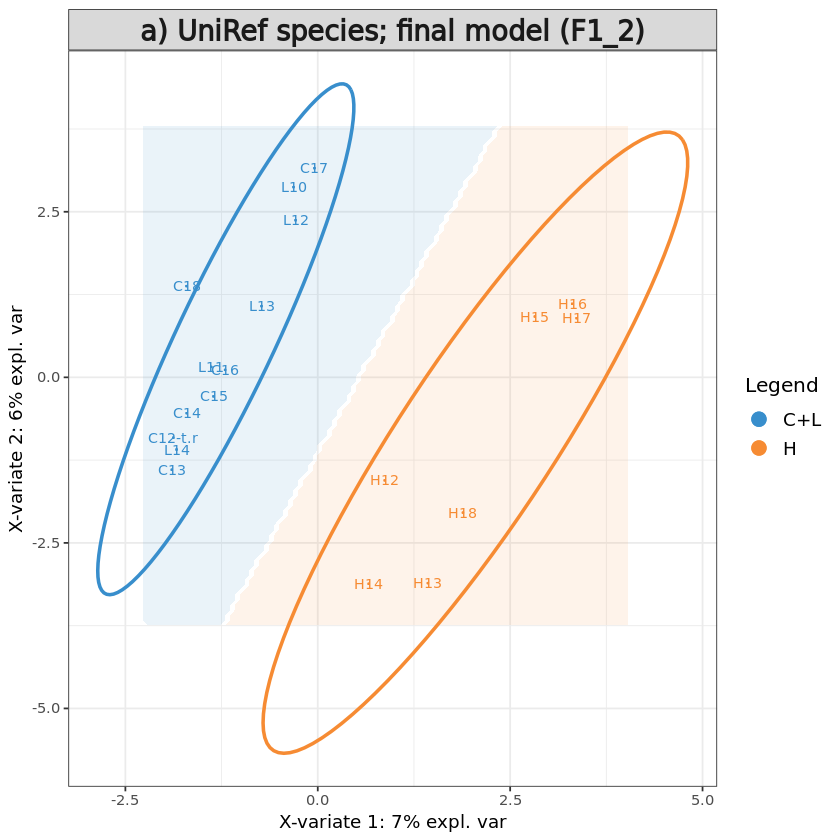

In [248]:
# Define final model
uniref.F1_2$optimal.ncomp <- 2
uniref.F1_2$optimal.keepX <- tune.splsda.uniref.F1_2$choice.keepX[1:uniref.F1_2$optimal.ncomp]
#uniref.F1_2$optimal.keepX <- rep(50, uniref.F1_2$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.uniref.F1_2 <- splsda(X.uniref.F1_2, uniref.F1_2$treatment, 
                       ncomp = uniref.F1_2$optimal.ncomp, 
                       keepX = uniref.F1_2$optimal.keepX)

background = background.predict(final.splsda.uniref.F1_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.F1_2, comp = 1:2, 
          group = uniref.F1_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) UniRef species; final model (F1_2)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.F1_2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F1_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

In [251]:
uniref.F1_2_names <- uniref_taxonomy[uniref_taxonomy$species%in%colnames(final.splsda.uniref.F1_2$X),c("phylum","family","species")]
uniref.F1_2_names$names <- paste0(uniref.F1_2_names$species," (", uniref.F1_2_names$phylum, ")")

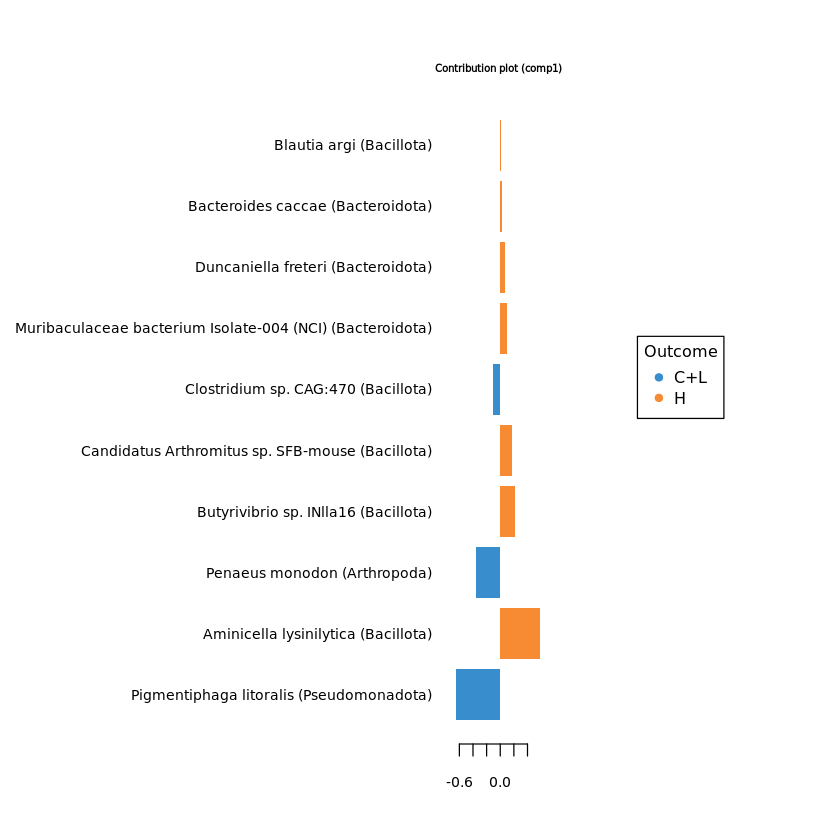

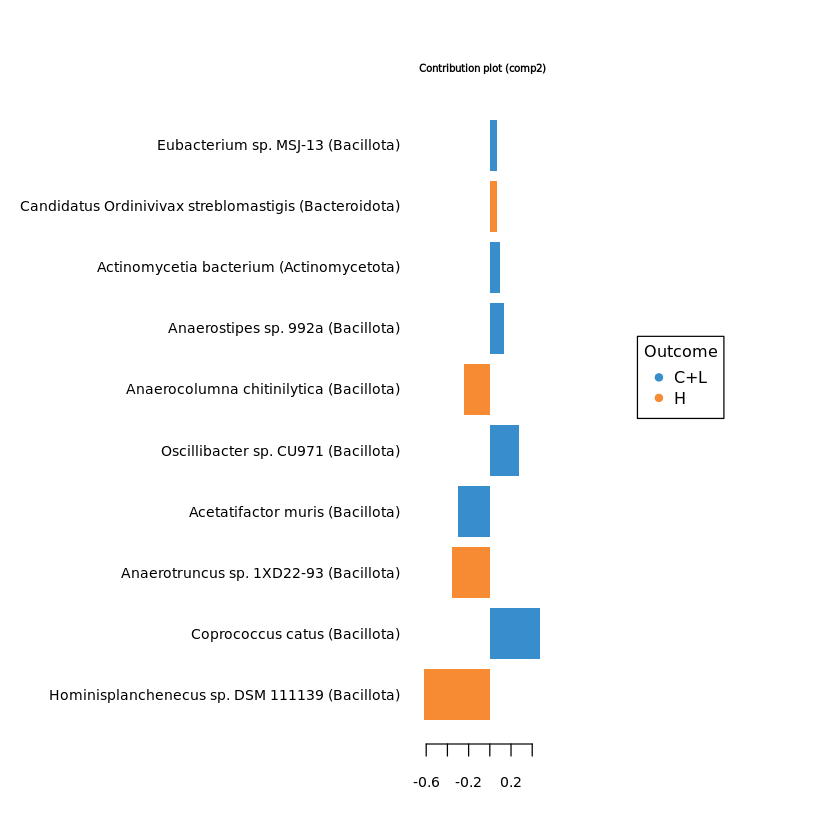

In [252]:
#plotVar(final.splsda.uniref.F1_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.F1_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = uniref.F1_2_names$names)
plotLoadings(final.splsda.uniref.F1_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = uniref.F1_2_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.F1_2, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.F1_2, comp=2)$value
F1_2.uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F1_2.uniref.load) <- F1_2.uniref.load[,"Row.names"]
colnames(F1_2.uniref.load) <- c("ft","loading_comp1","loading_comp2")
F1_2.uniref.load = F1_2.uniref.load[,c("loading_comp1","loading_comp2")]

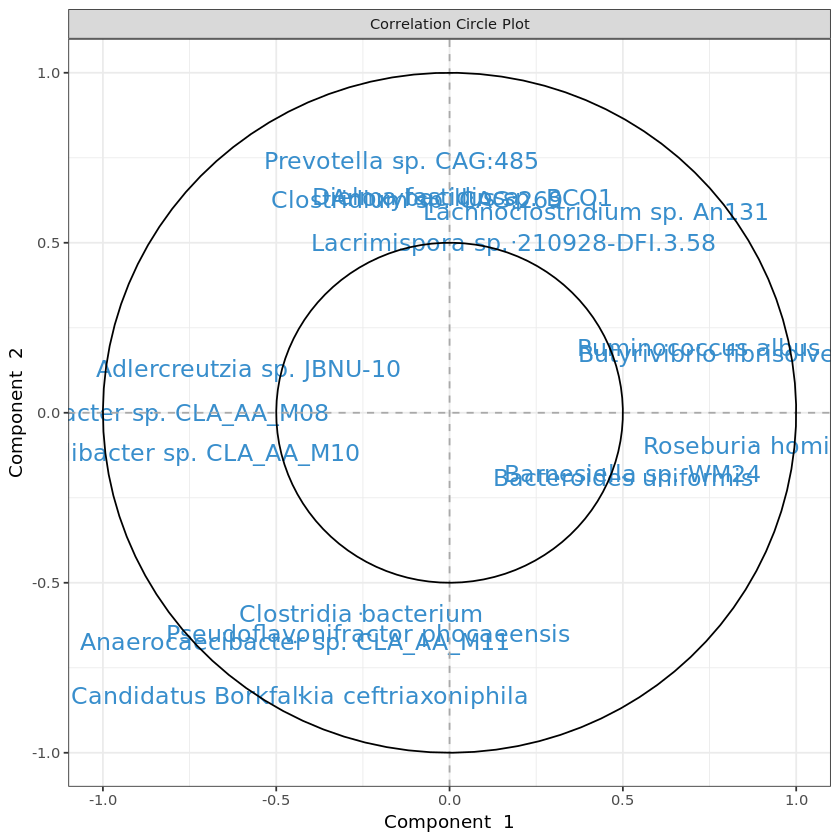

In [253]:
# plot feature correlation
plotVar(final.splsda.uniref.F1_2, cutoff=0.5)
uniref.F1_2.corr <- as.data.frame(plotVar(final.splsda.uniref.F1_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.F1_2.corr <- uniref.F1_2.corr[, c("x","y")]
colnames(uniref.F1_2.corr) <- c("corr_comp1","corr_comp2")

In [254]:
# Calculate feature stability
perf.splsda.uniref.F1_2 <- perf(final.splsda.uniref.F1_2, 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F1_2.uniref.stab <- merge(data.frame(perf.splsda.uniref.F1_2$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.F1_2$features$stable$comp2), by="Var1", all=T)
rownames(F1_2.uniref.stab) <- F1_2.uniref.stab$Var1
F1_2.uniref.stab <- F1_2.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F1_2.uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [428]:
# merge feature output
F1_2.uniref.out <- merge(F1_2.uniref.load, F1_2.uniref.stab, by="row.names")
rownames(F1_2.uniref.out) <- F1_2.uniref.out[,"Row.names"]
F1_2.uniref.out <- merge(F1_2.uniref.out[, 2:ncol(F1_2.uniref.out)], uniref.F1_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F1_2.features.tsv", F1_2.uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [259]:
train <- sample(1:nrow(X.uniref.F1_2), ceiling(nrow(X.uniref.F1_2)/3)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.F1_2), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.F1_2.train <- X.uniref.F1_2[train, ]
X.uniref.F1_2.test <- X.uniref.F1_2[test,]
Y.uniref.F1_2.train <- F1_info_2[train,"treatment"]
Y.uniref.F1_2.test <- F1_info_2[test, "treatment"]
train.splsda.uniref.F1_2 <- splsda(X.uniref.F1_2.train, Y.uniref.F1_2.train, ncomp = uniref.F1_2$optimal.ncomp, keepX = uniref.F1_2$optimal.keepX)
predict.splsda.uniref.F1_2 <- predict(train.splsda.uniref.F1_2, X.uniref.F1_2.test, 
                                dist = "max.dist")
predict.comp2.uniref.F1_2 <- predict.splsda.uniref.F1_2$class$max.dist[,2]
table(factor(predict.comp2.uniref.F1_2, levels = levels(uniref.F1_2$treatment)), Y.uniref.F1_2.test)

     Y.uniref.F1_2.test
      C+L H
  C+L   6 5
  H     1 0

$Comp1
         AUC   p-value
C+L vs H   1 0.0003857

$Comp2
         AUC   p-value
C+L vs H   1 0.0003857



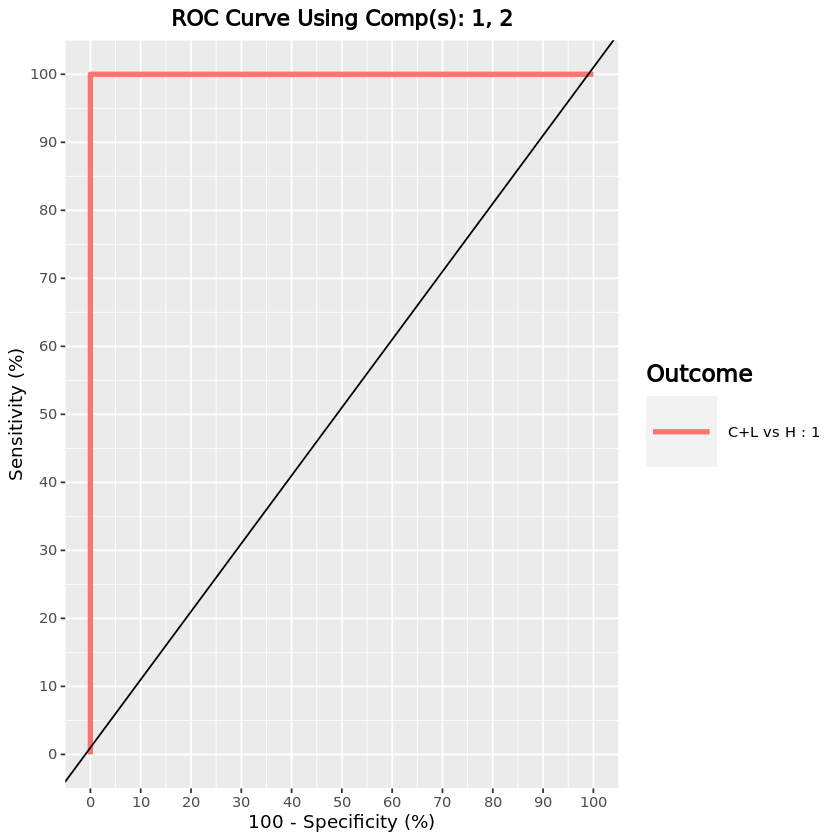

In [260]:
F1_2.uniref.auc.splsda = auroc(final.splsda.uniref.F1_2, roc.comp = 2, print = T)

#### UniRef species - F2 generation

[1] "3535"            "species removed" "525"             "remaining"

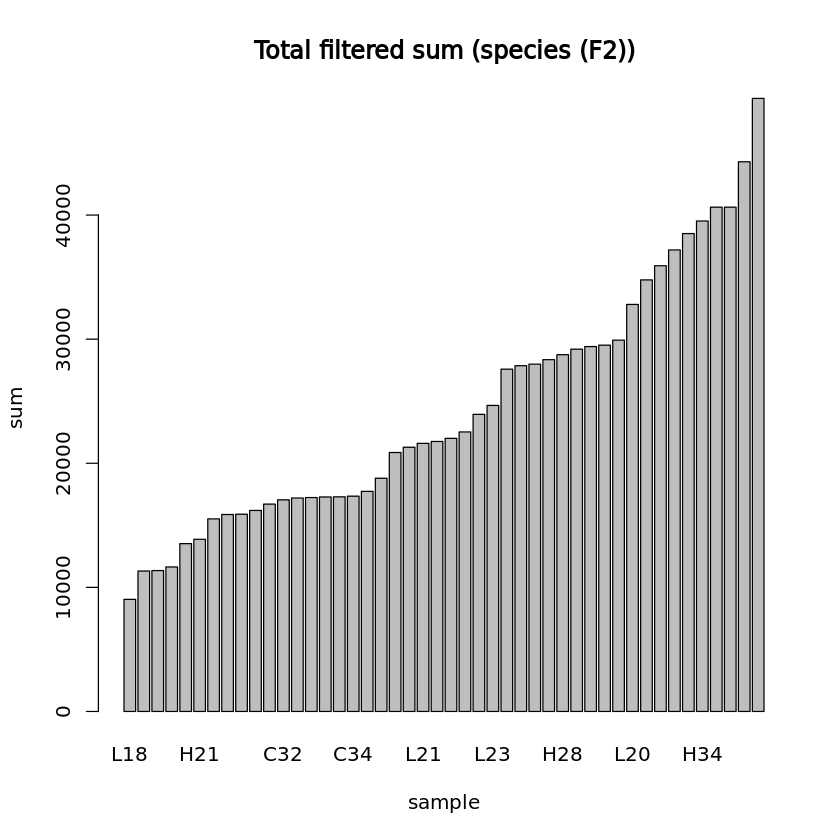

In [289]:
## PARAMS ##
# Initial components
uniref.F2.ncomp <- 10
# Percentage of samples in which features must have >0 sum
uniref.F2.percent_occ <- 10
# Quantile used for removing low abundance features
uniref.F2.quantile_thresh <- 0.1
generation <- "F2"

uniref.F2 <- list()
uniref.F2$cov <- uniref$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(uniref.F2$cov[, colSums(uniref.F2$cov) > 0])
uniref.F2$nz <- uniref.F2$cov[, colnames(uniref.F2$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(uniref.F2$nz) / sum(colSums(uniref.F2$nz)) * 100, probs = uniref.F2.quantile_thresh)
uniref.F2$filtered <- low.count.removal(uniref.F2$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
uniref.F2$occ <- colSums(uniref.F2$filtered>0) / nrow(uniref.F2$filtered) * 100
# Keep features occurring in defined percentage of samples
uniref.F2$filtered <- uniref.F2$filtered[, which(uniref.F2$occ >= uniref.F2.percent_occ)]

#uniref.F2$filtered <- uniref.F2$filtered[,-nearZeroVar(uniref.F2$filtered)$Position]
paste0(c(dim(uniref.F2$cov)[2] - dim(uniref.F2$filtered)[2], "species removed", dim(uniref.F2$filtered)[2], "remaining"))

# Add offset
uniref.F2$offset <- uniref.F2$filtered + 1
uniref.F2$clr <- logratio.transfo(uniref.F2$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.uniref.F2 <- uniref.F2$clr

uniref.F2$treatment <- factor(info[rownames(uniref.F2$clr), "Treatment"])
uniref.F2.lib.size <- apply(uniref.F2$filtered, 1, sum) # determine total count for each sample
barplot(sort(uniref.F2.lib.size), main="Total filtered sum (species (F2))", ylab="sum", xlab="sample")

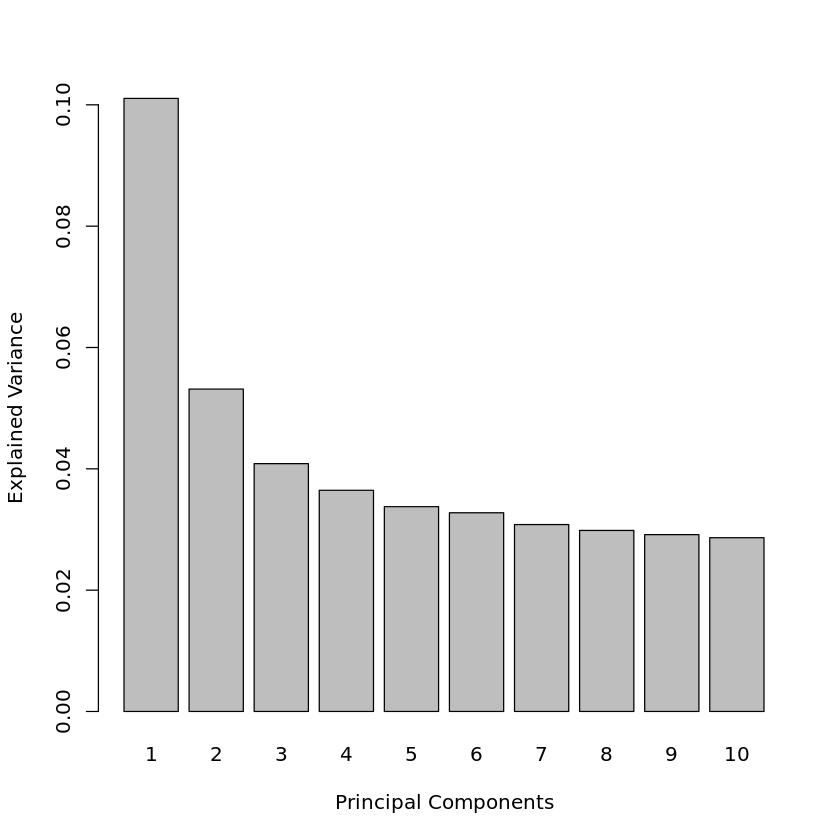

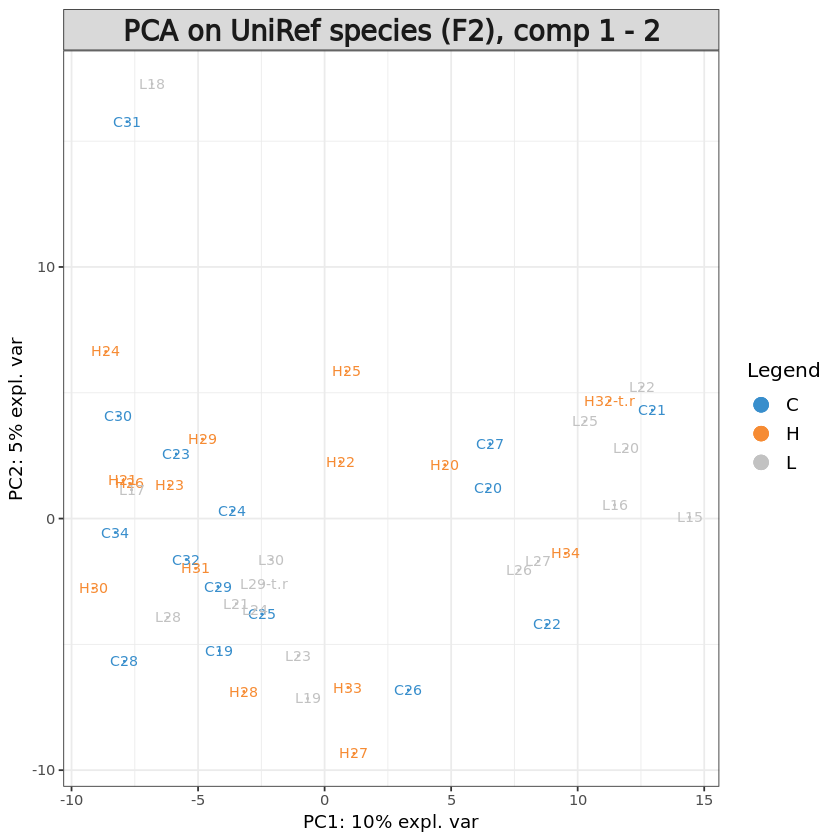

In [290]:
pca.uniref.F2 = pca(X.uniref.F2, ncomp = uniref.F2.ncomp, center = TRUE, scale = TRUE) 

plot(pca.uniref.F2)
plotIndiv(pca.uniref.F2, group = uniref.F2$treatment, ind.names = TRUE, # plot the samples projected
          legend = TRUE, title = 'PCA on UniRef species (F2), comp 1 - 2')

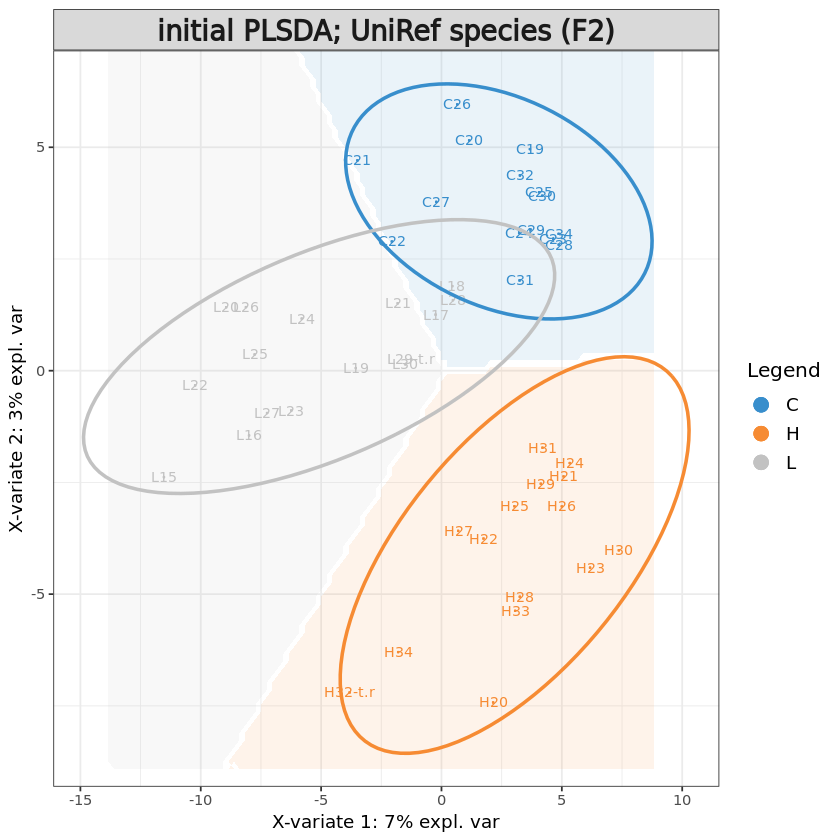

In [291]:
# Initial sPLS-DA model
uniref.F2.splsda <- splsda(X.uniref.F2, uniref.F2$treatment, ncomp = uniref.F2.ncomp)  # set ncomp to 10 for performance assessment later

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.F2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.F2.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.F2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef species (F2)")

The initial model does separate the sample groups to some degree however with overlap between C and L groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,4,1,1
BER,4,1,1


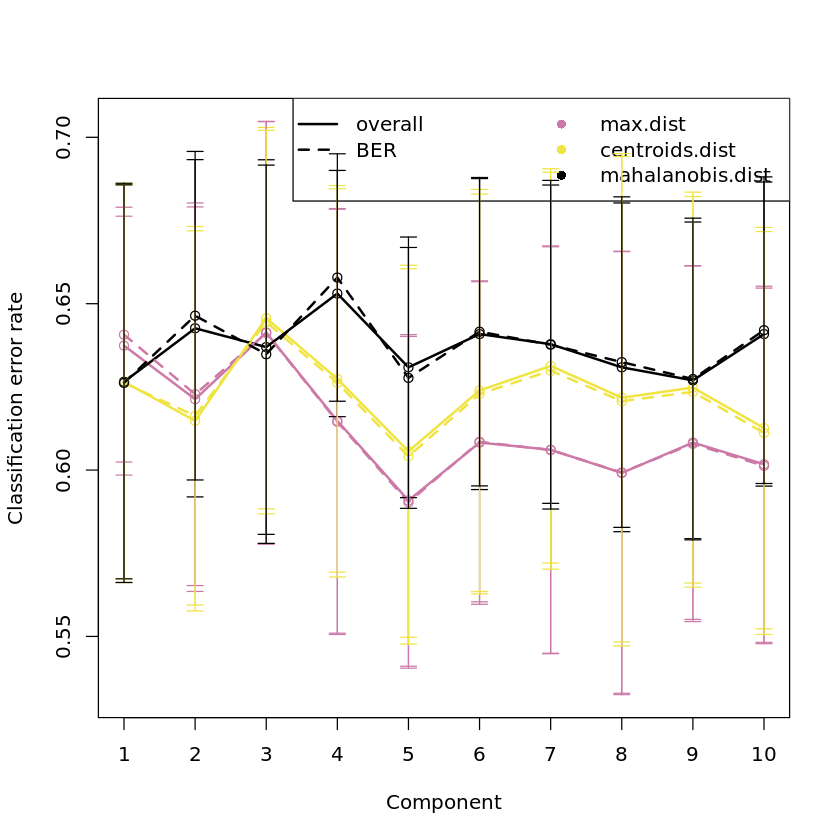

In [292]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.F2 <- perf(uniref.F2.splsda, validation = "Mfold", 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.F2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.F2$choice.ncomp # what is the optimal value of components according to perf()

Tuning the `ncomp` parameter suggests that 7 components is best here.

In [293]:
# Define parameters for tuning keepX
uniref.F2.step <- 0.05
uniref.F2.ncomp.tune <- 4
# grid of possible keepX values that will be tested for each component
uniref.F2.keepx <- c(10, 20, seq(ceiling(dim(uniref.F2$filtered)[2] * uniref.F2.step), 
                      round(dim(uniref.F2$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.F2$filtered)[2] * uniref.F2.step)
                     )
                 )
uniref.F2.keepx

[1]  10  20  27  54  81 108 135 162 189 216 243 270 297 324 351 378 405 432 459
[20] 486 513

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%


[1] 3

comp1 comp2 comp3 comp4 
   27    81    81   459

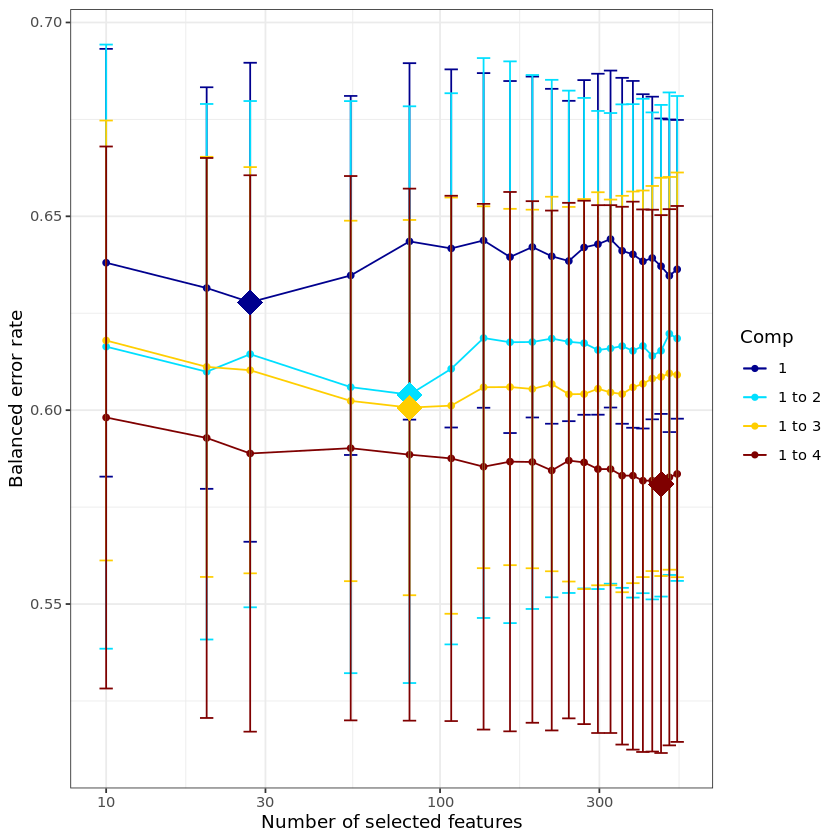

In [294]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.F2 <- tune.splsda(X.uniref.F2, uniref.F2$treatment, ncomp = uniref.F2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.F2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.F2, col = color.jet(uniref.F2.ncomp.tune))

tune.splsda.uniref.F2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.F2$choice.keepX # what are the optimal values of variables according to tune.splsda()

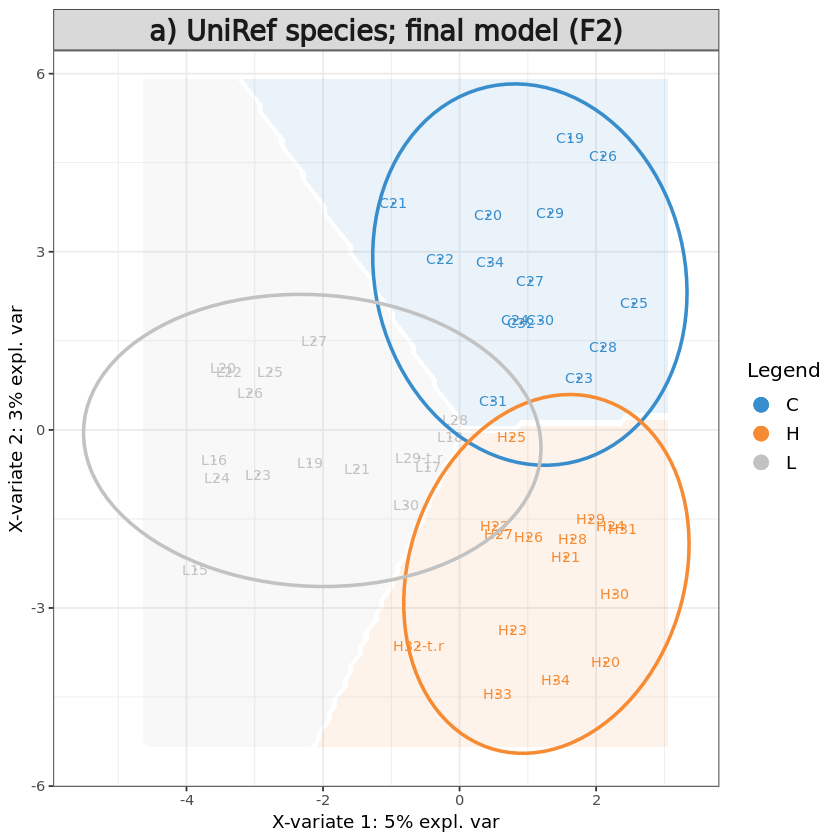

In [306]:
# Define final model
uniref.F2$optimal.ncomp <- 2
#uniref.F2$optimal.keepX <- tune.splsda.uniref.F2$choice.keepX[1:uniref.F2$optimal.ncomp]
#uniref.F2$optimal.keepX <- rep(50, uniref.F2$optimal.ncomp)
uniref.F2$optimal.keepX <- c(30, 75)

# form final model with optimised values for component, using all features
final.splsda.uniref.F2 <- splsda(X.uniref.F2, uniref.F2$treatment, 
                       ncomp = uniref.F2$optimal.ncomp, 
                       keepX = uniref.F2$optimal.keepX)

background = background.predict(final.splsda.uniref.F2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.F2, comp = 1:2, 
          group = uniref.F2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) UniRef species; final model (F2)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.F2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

In [296]:
uniref.F2_names <- uniref_taxonomy[uniref_taxonomy$species%in%colnames(final.splsda.uniref.F2$X),c("phylum","family","species")]
uniref.F2_names$names <- paste0(uniref.F2_names$species," (", uniref.F2_names$phylum, ")")

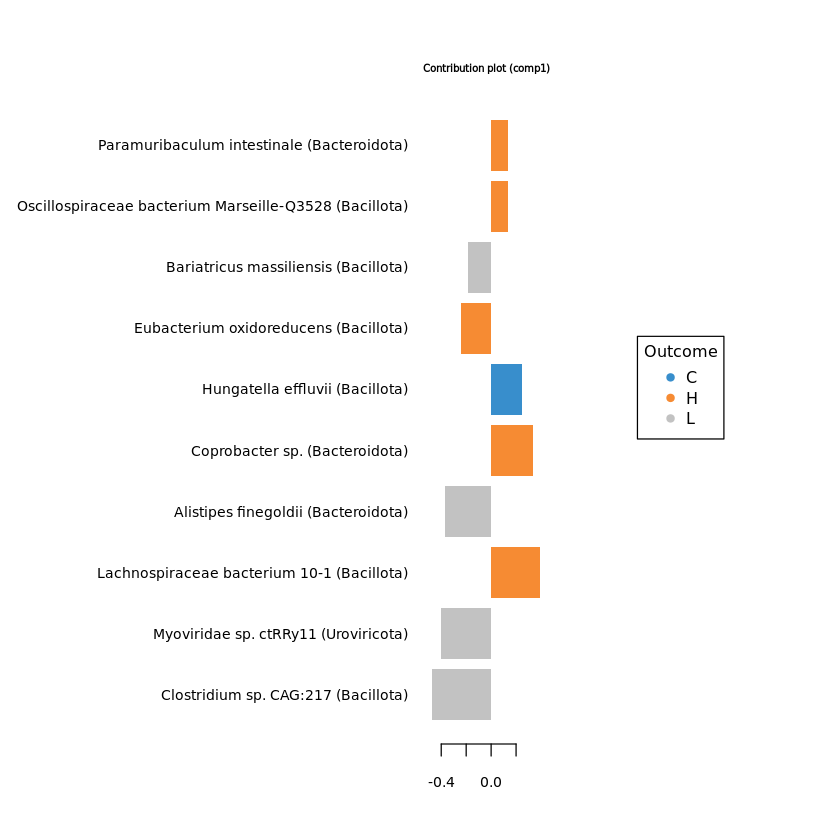

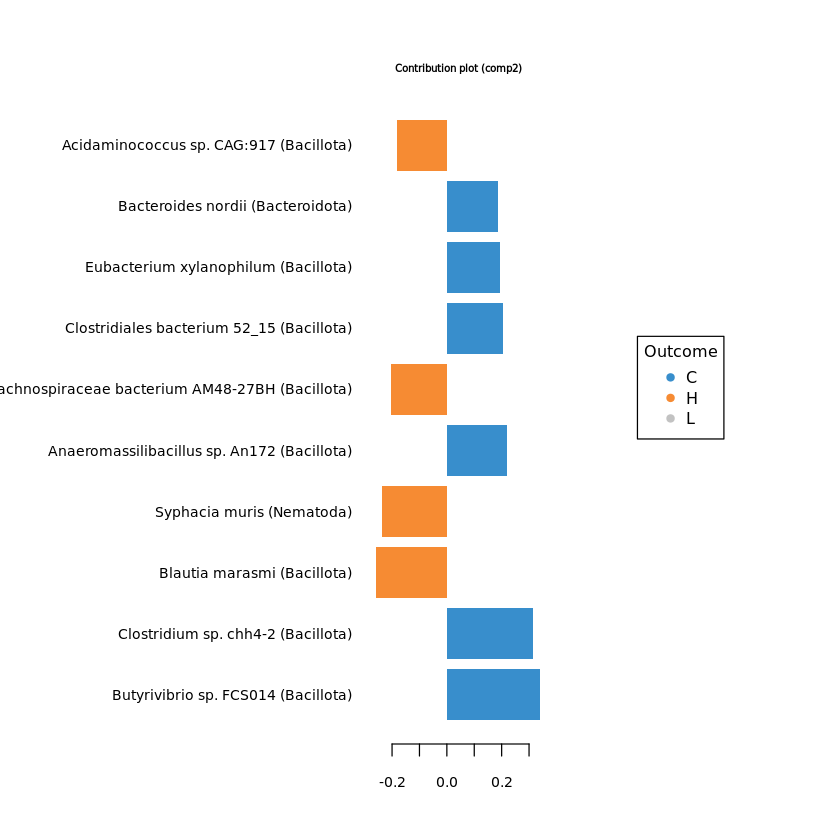

In [297]:
#plotVar(final.splsda.uniref.F2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.F2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = uniref.F2_names$names)
plotLoadings(final.splsda.uniref.F2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = uniref.F2_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.F2, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.F2, comp=2)$value
F2.uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F2.uniref.load) <- F2.uniref.load[,"Row.names"]
colnames(F2.uniref.load) <- c("ft","loading_comp1","loading_comp2")
F2.uniref.load = F2.uniref.load[,c("loading_comp1","loading_comp2")]

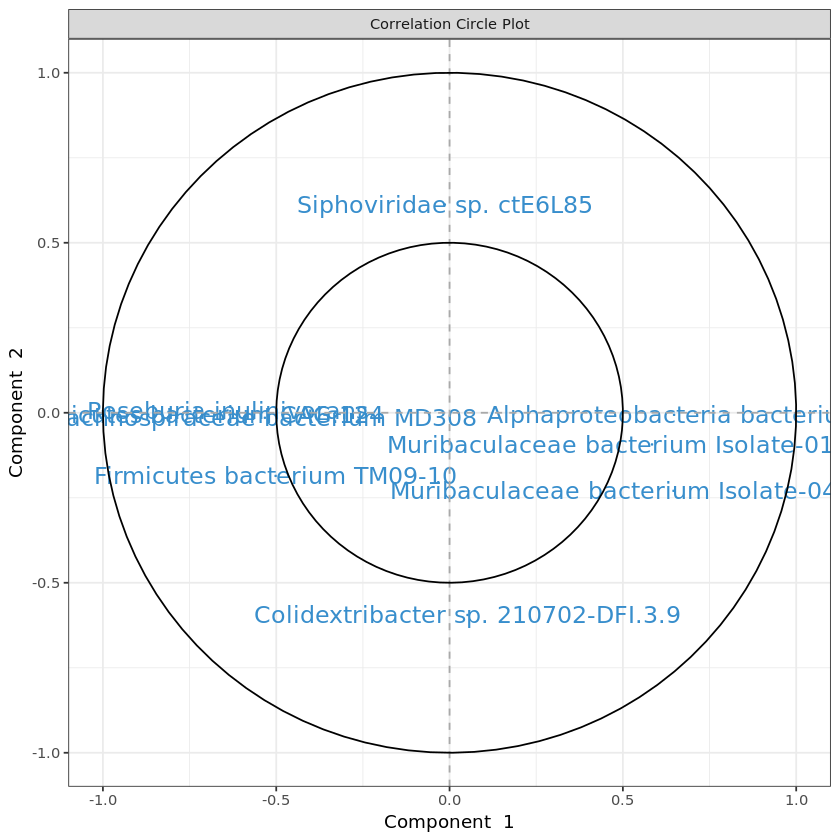

In [307]:
# plot feature correlation
plotVar(final.splsda.uniref.F2, cutoff=0.5)
uniref.F2.corr <- as.data.frame(plotVar(final.splsda.uniref.F2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.F2.corr <- uniref.F2.corr[, c("x","y")]
colnames(uniref.F2.corr) <- c("corr_comp1","corr_comp2")

In [308]:
# Calculate feature stability
perf.splsda.uniref.F2 <- perf(final.splsda.uniref.F2, 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F2.uniref.stab <- merge(data.frame(perf.splsda.uniref.F2$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.F2$features$stable$comp2), by="Var1", all=T)
rownames(F2.uniref.stab) <- F2.uniref.stab$Var1
F2.uniref.stab <- F2.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F2.uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [410]:
F2.uniref.stab <- merge(data.frame(perf.splsda.uniref.F2$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.F2$features$stable$comp2), by="Var1", all=T)
rownames(F2.uniref.stab) <- F2.uniref.stab$Var1
F2.uniref.stab <- F2.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F2.uniref.stab) <- c("stability_comp1","stability_comp2")

In [411]:
# merge feature output
F2.uniref.out <- merge(F2.uniref.load, F2.uniref.stab, by="row.names")
rownames(F2.uniref.out) <- F2.uniref.out[,"Row.names"]
F2.uniref.out <- merge(F2.uniref.out[, 2:ncol(F2.uniref.out)], uniref.F2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F2.features.tsv", F2.uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [310]:
train <- sample(1:nrow(X.uniref.F2), ceiling(nrow(X.uniref.F2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.F2), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.F2.train <- X.uniref.F2[train, ]
X.uniref.F2.test <- X.uniref.F2[test,]
Y.uniref.F2.train <- info[train,"treatment"]
Y.uniref.F2.test <- info[test, "treatment"]
train.splsda.uniref.F2 <- splsda(X.uniref.F2.train, Y.uniref.F2.train, ncomp = uniref.F2$optimal.ncomp, keepX = uniref.F2$optimal.keepX)
predict.splsda.uniref.F2 <- predict(train.splsda.uniref.F2, X.uniref.F2.test, 
                                dist = "max.dist")
predict.comp2.uniref.F2 <- predict.splsda.uniref.F2$class$max.dist[,2]
table(factor(predict.comp2.uniref.F2, levels = levels(uniref.F2$treatment)), Y.uniref.F2.test)

   Y.uniref.F2.test
    C H L
  C 5 5 7
  H 6 5 6
  L 0 0 0

$Comp1
                 AUC   p-value
C vs Other(s) 0.7011 2.846e-02
H vs Other(s) 0.7914 1.498e-03
L vs Other(s) 0.9771 1.281e-07

$Comp2
                 AUC   p-value
C vs Other(s) 1.0000 5.093e-08
H vs Other(s) 1.0000 5.093e-08
L vs Other(s) 0.9812 9.950e-08



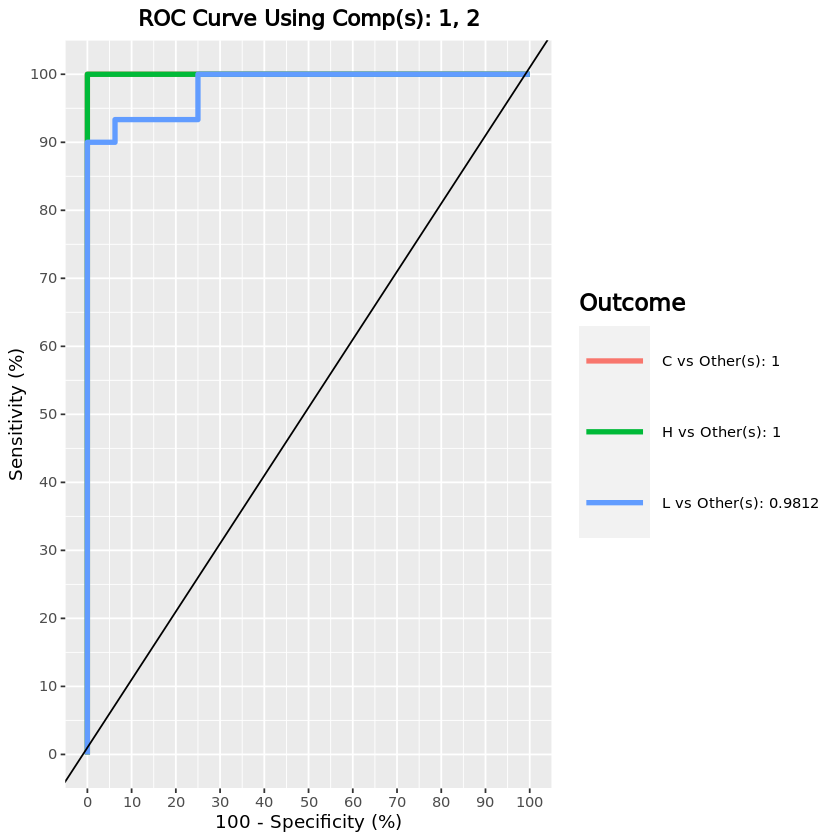

In [311]:
F2.uniref.auc.splsda = auroc(final.splsda.uniref.F2, roc.comp = 2, print = T)

#### UniRef species - F2 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [319]:
uniref.F2_2 <- list()
F2_info_2 <- info[rownames(uniref.F2$cov),]
F2_info_2$treatment <- gsub(x = F2_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
uniref.F2_2$cov <- uniref.F2$cov[rownames(F2_info_2),]
uniref.F2_2$filtered <- uniref.F2$filtered[rownames(F2_info_2),]

uniref.F2_2$clr <- uniref.F2$clr[rownames(F2_info_2), ]
X.uniref.F2_2 <- uniref.F2_2$clr

uniref.F2_2$treatment <- factor(F2_info_2[rownames(uniref.F2_2$clr), "treatment"])

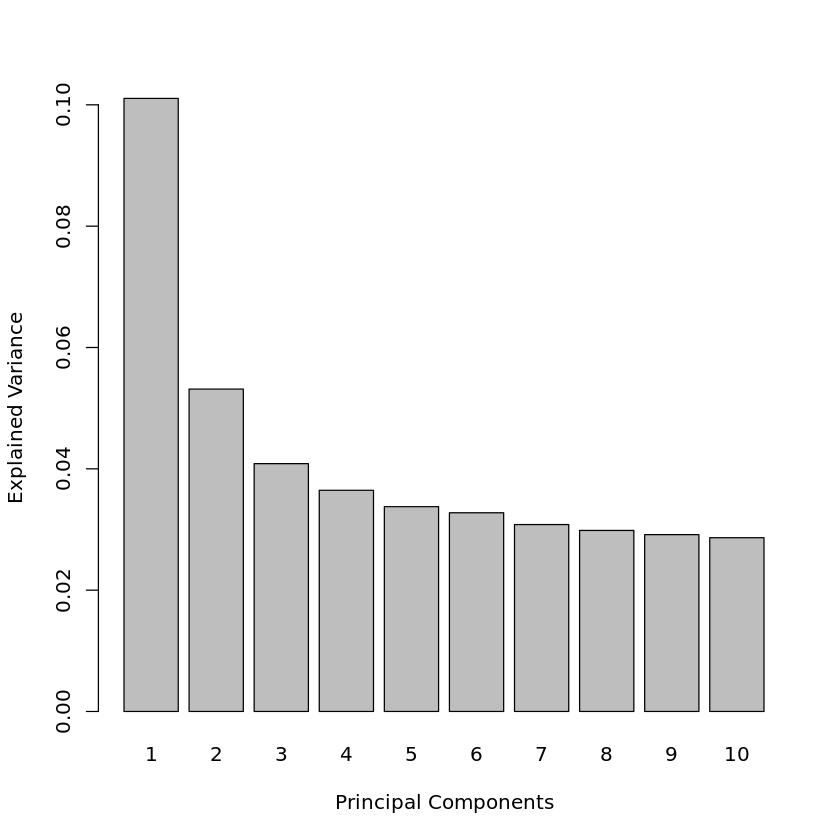

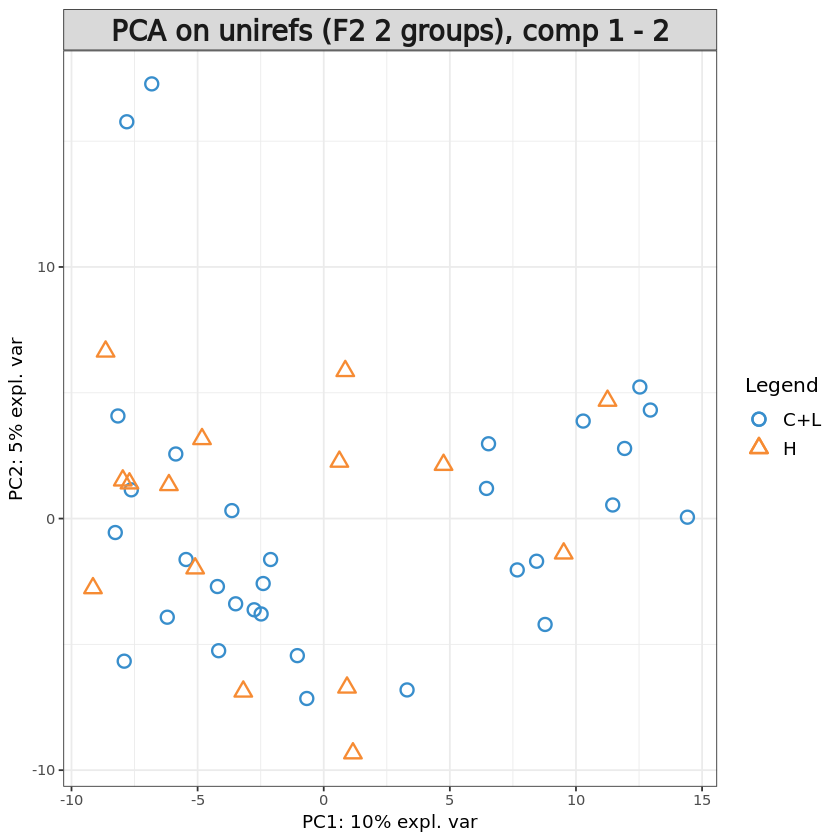

In [320]:
pca.uniref.F2_2 = pca(X.uniref.F2_2, ncomp = 10, center = TRUE, scale = TRUE) 

plot(pca.uniref.F2_2)
plotIndiv(pca.uniref.F2_2, group = uniref.F2_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on unirefs (F2 2 groups), comp 1 - 2')

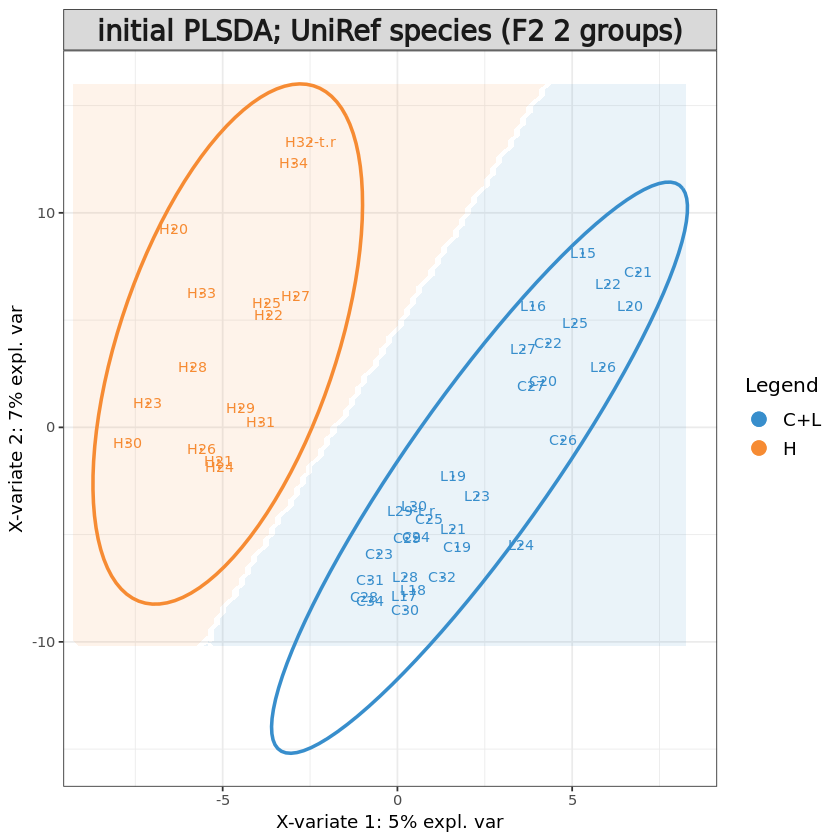

In [321]:
# Initial sPLS-DA model
uniref.F2_2.splsda <- splsda(X.uniref.F2_2, uniref.F2_2$treatment, ncomp = 5)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.F2_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.F2_2.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.F2_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef species (F2 2 groups)")

The initial model separates the two treatment groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,1,1,1
BER,1,1,1


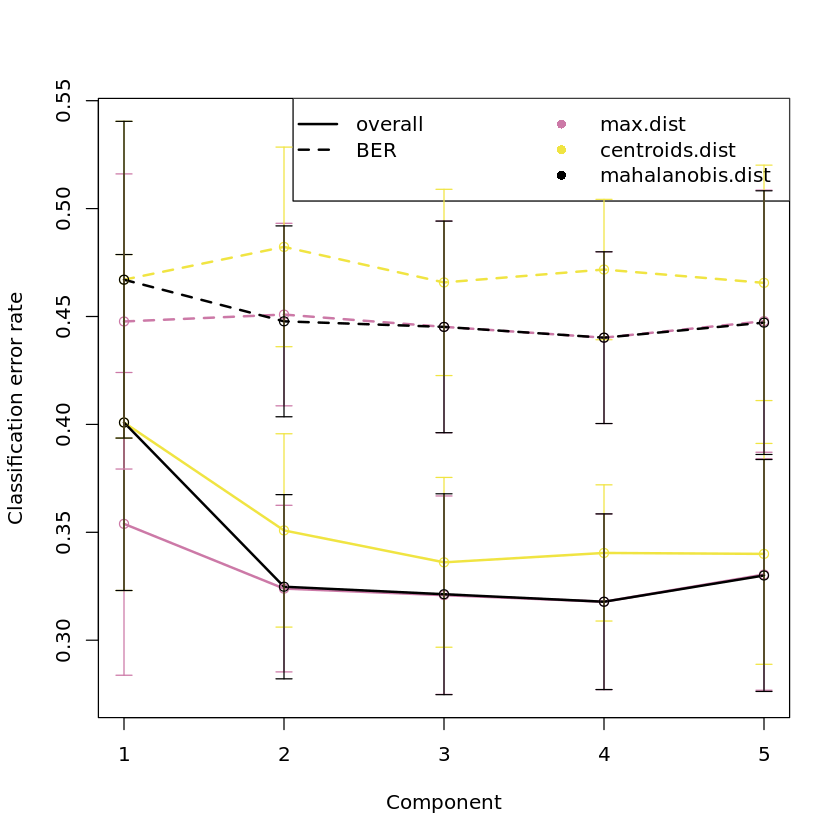

In [322]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.F2_2 <- perf(uniref.F2_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.F2_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.F2_2$choice.ncomp # what is the optimal value of components according to perf()

In [433]:
# Define parameters for tuning keepX
uniref.F2_2.step <- 0.05
uniref.F2_2.ncomp.tune <- 2
# grid of possible keepX values that will be tested for each component
uniref.F2_2.keepx <- c(10, 20, seq(ceiling(dim(uniref.F2_2$filtered)[2] * uniref.F2_2.step), 
                      round(dim(uniref.F2_2$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.F2_2$filtered)[2] * uniref.F2_2.step)
                     )
                 )
uniref.F2_2.keepx

[1]  10  20  27  54  81 108 135 162 189 216 243 270 297 324 351 378 405 432 459
[20] 486 513

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


[1] 2

comp1 comp2 
  486    10

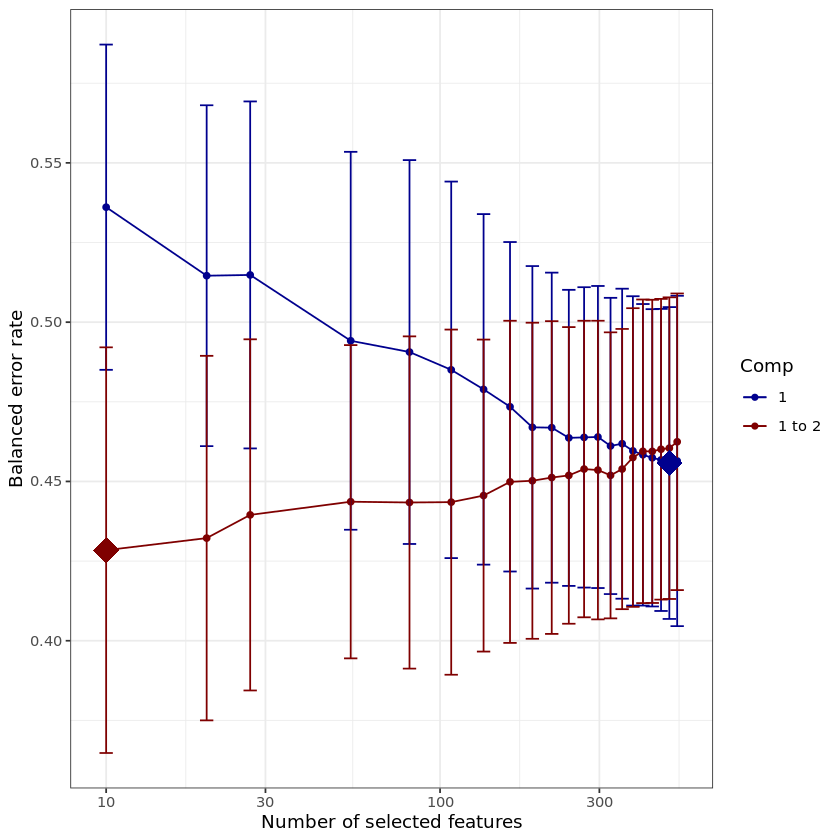

In [434]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.F2_2 <- tune.splsda(X.uniref.F2_2, uniref.F2_2$treatment, ncomp = uniref.F2_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.F2_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.F2_2, col = color.jet(uniref.F2_2.ncomp.tune))

tune.splsda.uniref.F2_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.F2_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

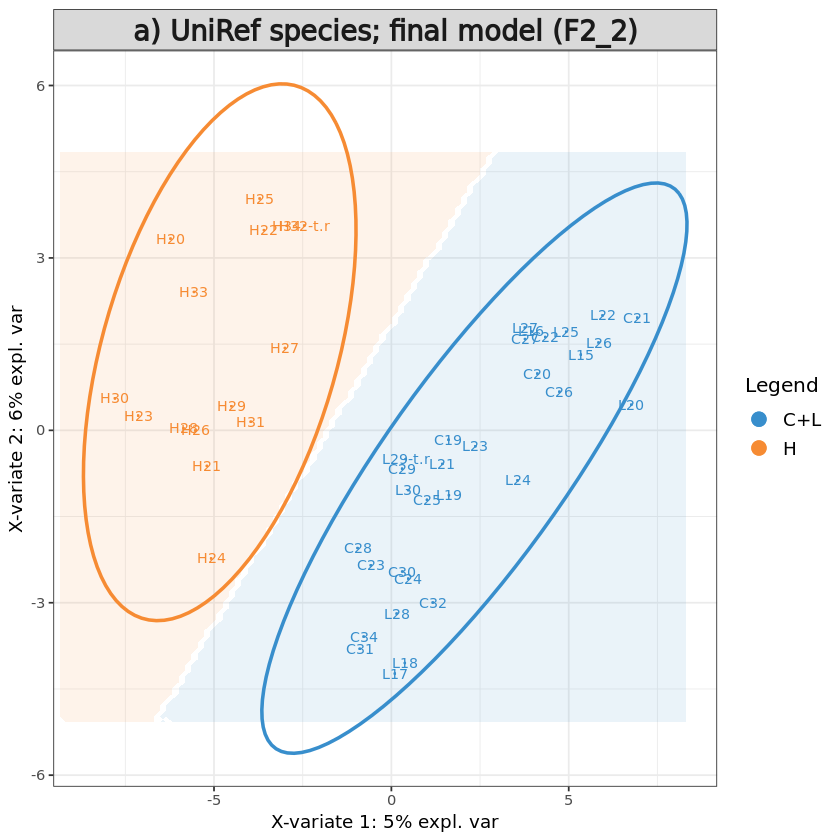

In [446]:
# Define final model
uniref.F2_2$optimal.ncomp <- 2
uniref.F2_2$optimal.keepX <- tune.splsda.uniref.F2_2$choice.keepX[1:uniref.F2_2$optimal.ncomp]
#uniref.F2_2$optimal.keepX <- rep(50, uniref.F2_2$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.uniref.F2_2 <- splsda(X.uniref.F2_2, uniref.F2_2$treatment, 
                       ncomp = uniref.F2_2$optimal.ncomp, 
                       keepX = uniref.F2_2$optimal.keepX)

background = background.predict(final.splsda.uniref.F2_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.F2_2, comp = 1:2, 
          group = uniref.F2_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) UniRef species; final model (F2_2)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.F2_2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F2_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

In [447]:
uniref.F2_2_names <- uniref_taxonomy[uniref_taxonomy$species%in%colnames(final.splsda.uniref.F2_2$X),c("phylum","family","species")]
uniref.F2_2_names$names <- paste0(uniref.F2_2_names$species," (", uniref.F2_2_names$phylum, ")")

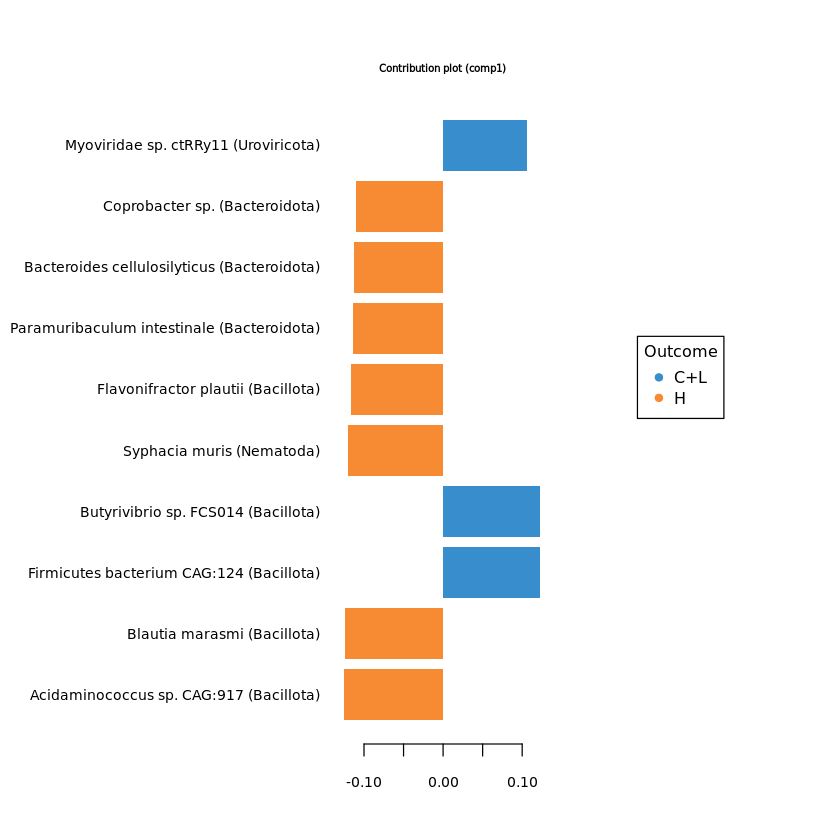

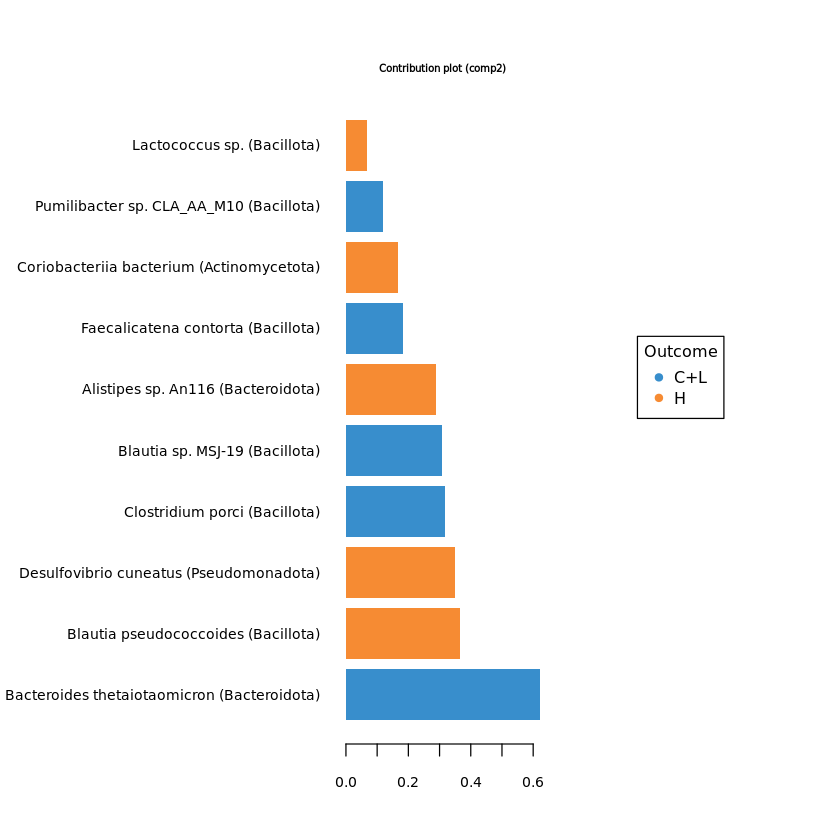

In [448]:
#plotVar(final.splsda.uniref.F2_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.F2_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = uniref.F2_2_names$names)
plotLoadings(final.splsda.uniref.F2_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = uniref.F2_2_names$names)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.F2_2, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.F2_2, comp=2)$value
F2_2.uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F2_2.uniref.load) <- F2_2.uniref.load[,"Row.names"]
colnames(F2_2.uniref.load) <- c("ft","loading_comp1","loading_comp2")
F2_2.uniref.load = F2_2.uniref.load[,c("loading_comp1","loading_comp2")]

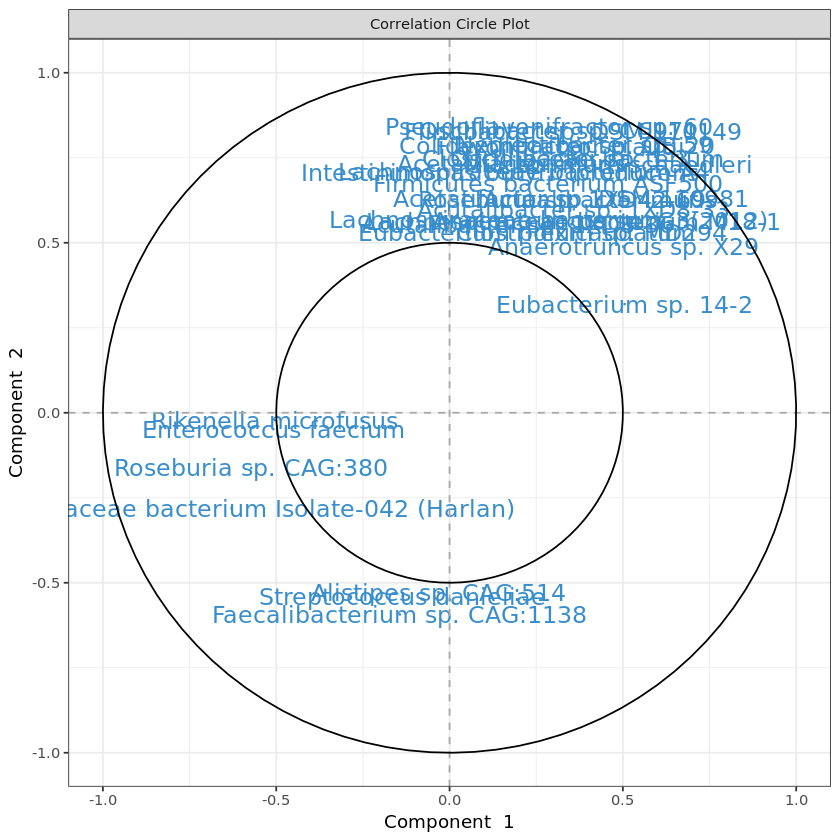

In [449]:
# plot feature correlation
plotVar(final.splsda.uniref.F2_2, cutoff=0.5)
uniref.F2_2.corr <- as.data.frame(plotVar(final.splsda.uniref.F2_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.F2_2.corr <- uniref.F2_2.corr[, c("x","y")]
colnames(uniref.F2_2.corr) <- c("corr_comp1","corr_comp2")

In [450]:
# Calculate feature stability
perf.splsda.uniref.F2_2 <- perf(final.splsda.uniref.F2_2, 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F2_2.uniref.stab <- merge(data.frame(perf.splsda.uniref.F2_2$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.F2_2$features$stable$comp2), by="Var1", all=T)
rownames(F2_2.uniref.stab) <- F2_2.uniref.stab$Var1
F2_2.uniref.stab <- F2_2.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F2_2.uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [451]:
# merge feature output
F2_2.uniref.out <- merge(F2_2.uniref.load, F2_2.uniref.stab, by="row.names")
rownames(F2_2.uniref.out) <- F2_2.uniref.out[,"Row.names"]
F2_2.uniref.out <- merge(F2_2.uniref.out[, 2:ncol(F2_2.uniref.out)], uniref.F2_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.F2_2.features.tsv", F2_2.uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [452]:
train <- sample(1:nrow(X.uniref.F2_2), ceiling(nrow(X.uniref.F2_2)/3)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.F2_2), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.F2_2.train <- X.uniref.F2_2[train, ]
X.uniref.F2_2.test <- X.uniref.F2_2[test,]
Y.uniref.F2_2.train <- F2_info_2[train,"treatment"]
Y.uniref.F2_2.test <- F2_info_2[test, "treatment"]
train.splsda.uniref.F2_2 <- splsda(X.uniref.F2_2.train, Y.uniref.F2_2.train, ncomp = uniref.F2_2$optimal.ncomp, keepX = uniref.F2_2$optimal.keepX)
predict.splsda.uniref.F2_2 <- predict(train.splsda.uniref.F2_2, X.uniref.F2_2.test, 
                                dist = "max.dist")
predict.comp2.uniref.F2_2 <- predict.splsda.uniref.F2_2$class$max.dist[,2]
table(factor(predict.comp2.uniref.F2_2, levels = levels(uniref.F2_2$treatment)), Y.uniref.F2_2.test)

     Y.uniref.F2_2.test
      C+L  H
  C+L   8  5
  H    12  5

$Comp1
         AUC   p-value
C+L vs H   1 5.093e-08

$Comp2
         AUC   p-value
C+L vs H   1 5.093e-08



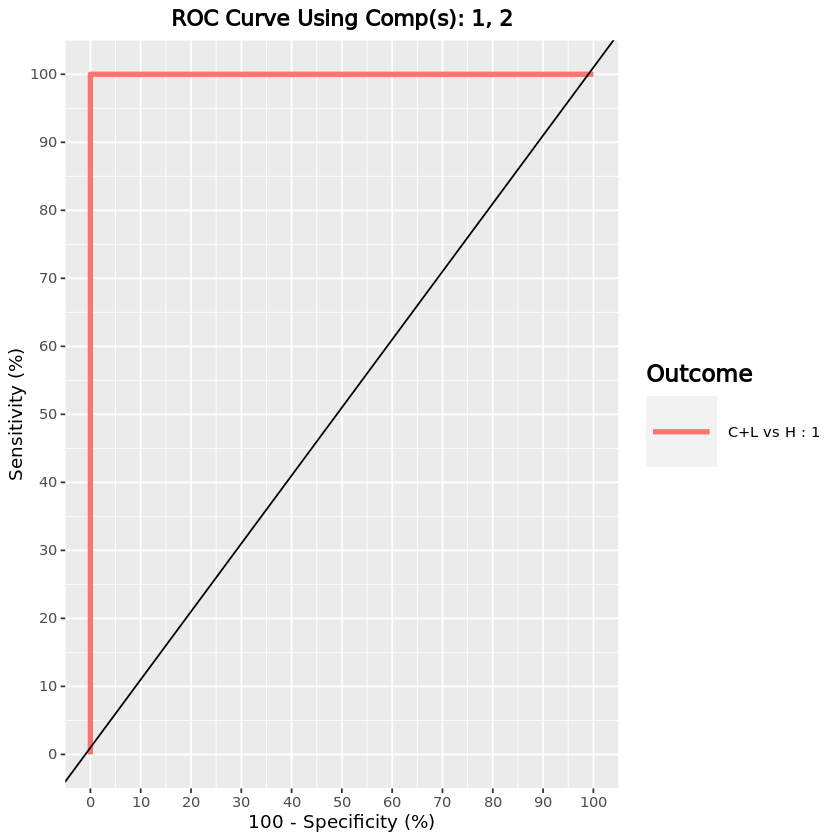

In [453]:
F2_2.uniref.auc.splsda = auroc(final.splsda.uniref.F2_2, roc.comp = 2, print = T)

### UniRef - genera

#### UniRef genera - Generational differences

[1] "1180"           "genera removed" "216"            "remaining"

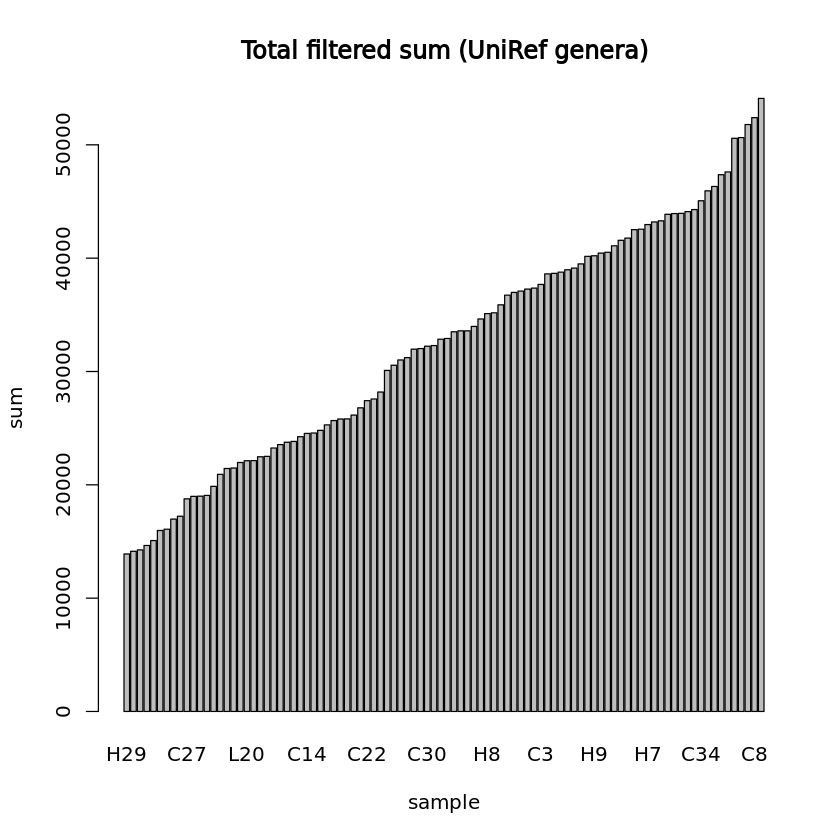

In [312]:
## PARAMS ##
# Initial components
uniref.genus.ncomp <- 10
# Percentage of samples in which features must have >0 sum
uniref.genus.percent_occ <- 10
# Quantile used for removing low abundance features
uniref.genus.quantile_thresh <- 0.1

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(uniref.genus$cov[, colSums(uniref.genus$cov) > 0])
uniref.genus$nz <- uniref.genus$cov[, colnames(uniref.genus$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(uniref.genus$nz) / sum(colSums(uniref.genus$nz)) * 100, probs = uniref.genus.quantile_thresh)
uniref.genus$filtered <- low.count.removal(uniref.genus$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
uniref.genus$occ <- colSums(uniref.genus$filtered>0) / nrow(uniref.genus$filtered) * 100
# Keep features occurring in defined percentage of samples
uniref.genus$filtered <- uniref.genus$filtered[, which(uniref.genus$occ >= uniref.genus.percent_occ)]

#uniref.genus$filtered <- uniref.genus$filtered[,-nearZeroVar(uniref.genus$filtered, uniqueCut = 5, freqCut = 5)$Position]
paste0(c(dim(uniref.genus$cov)[2] - dim(uniref.genus$filtered)[2], "genera removed", dim(uniref.genus$filtered)[2], "remaining"))

# Add offset
uniref.genus$offset <- uniref.genus$filtered + 1
uniref.genus$clr <- logratio.transfo(uniref.genus$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.uniref.genus <- uniref.genus$clr

uniref.genus$generation <- factor(info[rownames(uniref.genus$clr), "Generation"])

uniref.genus.lib.size <- apply(uniref.genus$filtered, 1, sum) # determine total count for each sample
barplot(sort(uniref.genus.lib.size), main="Total filtered sum (UniRef genera)", ylab="sum", xlab="sample")

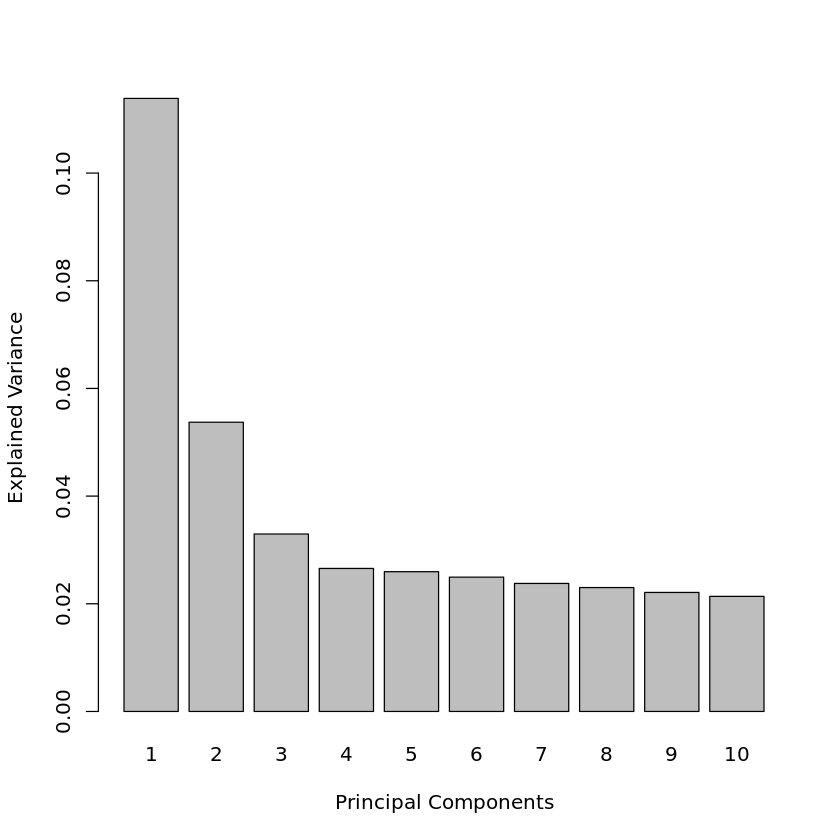

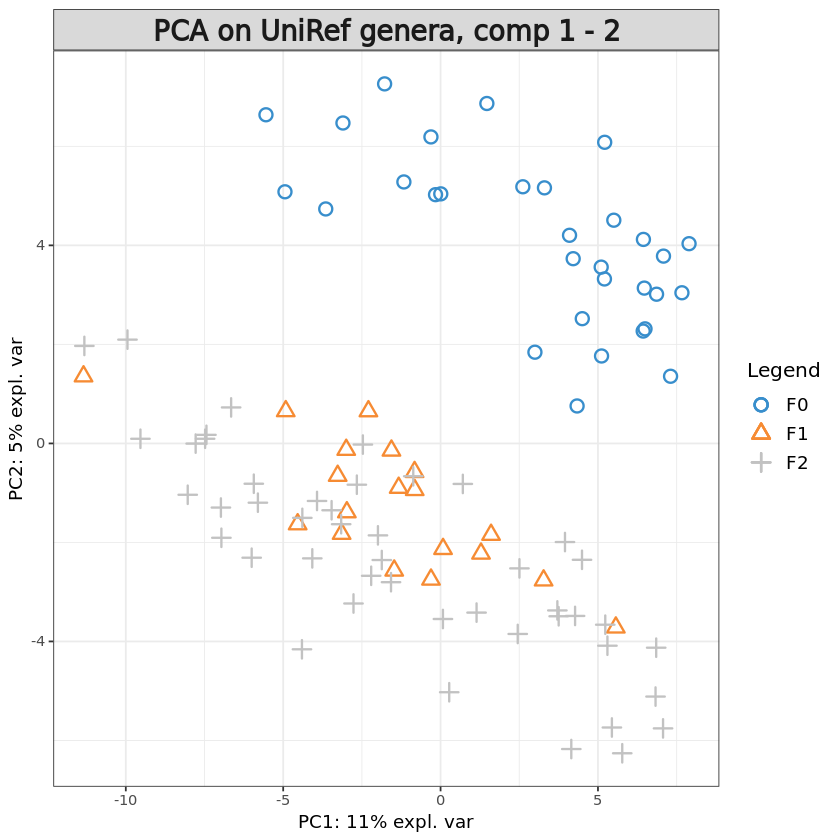

In [313]:
pca.uniref.genus = pca(X.uniref.genus, ncomp = uniref.genus.ncomp, center = TRUE, scale = TRUE) 

plot(pca.uniref.genus)
plotIndiv(pca.uniref.genus, group = uniref.genus$generation, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on UniRef genera, comp 1 - 2')

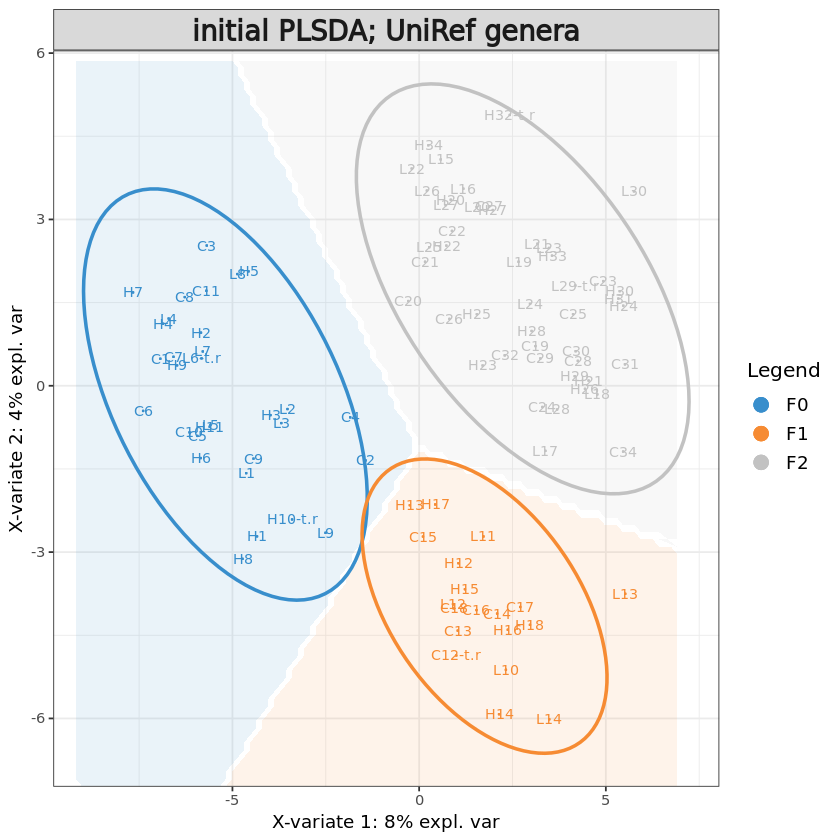

In [314]:
# Initial sPLS-DA model
uniref.genus.splsda <- splsda(X.uniref.genus, uniref.genus$generation, ncomp = uniref.genus.ncomp)  # set ncomp to 10 for performance assessment later

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.genus.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.genus.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.genus$generation, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef genera")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,7,3,4
BER,7,3,4


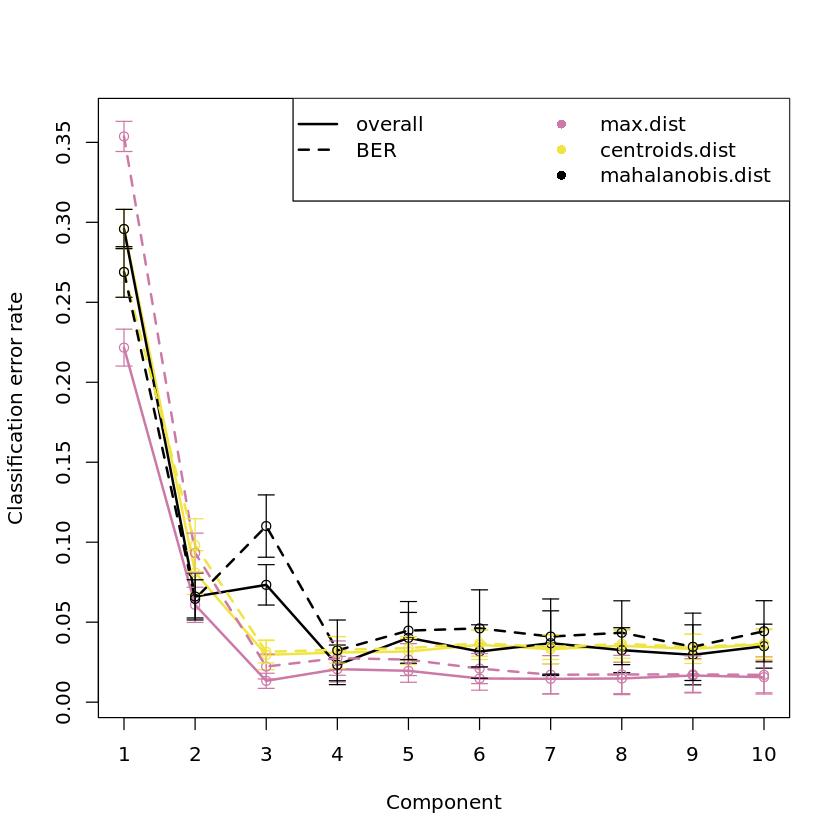

In [315]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.genus <- perf(uniref.genus.splsda, validation = "Mfold", 
                          folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.genus, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.genus$choice.ncomp # what is the optimal value of components according to perf()

Here we see that the classification error rate drops sharply after the first few components. Already with 3 components there is a very low error rate.

In [316]:
# Define parameters for tuning keepX
uniref.genus.step <- 0.1
uniref.genus.ncomp.tune <- 3
# grid of possible keepX values that will be tested for each component
uniref.genus.keepx <- c(10, seq(ceiling(dim(uniref.genus$filtered)[2] * uniref.genus.step), 
                      round(dim(uniref.genus$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.genus$filtered)[2] * uniref.genus.step)
                     )
                 )
uniref.genus.keepx

[1]  10  22  44  66  88 110 132 154 176 198 220

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


[1] 3

comp1 comp2 comp3 
   88    66    22

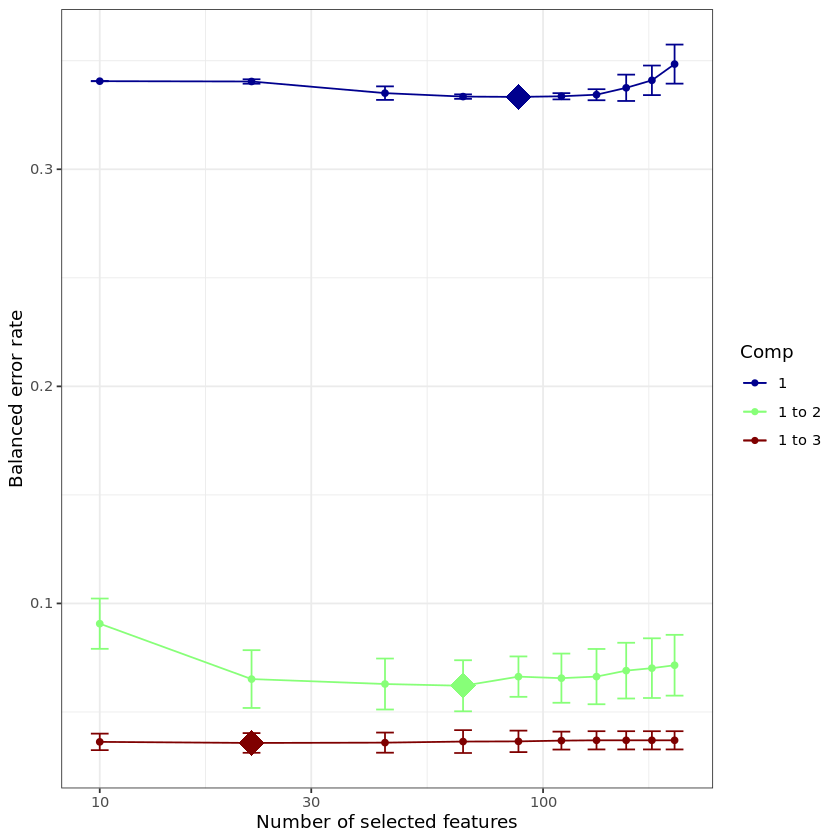

In [317]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.genus <- tune.splsda(X.uniref.genus, uniref.genus$generation, ncomp = uniref.genus.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.genus.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.genus, col = color.jet(uniref.genus.ncomp.tune))

tune.splsda.uniref.genus$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.genus$choice.keepX # what are the optimal values of variables according to tune.splsda()

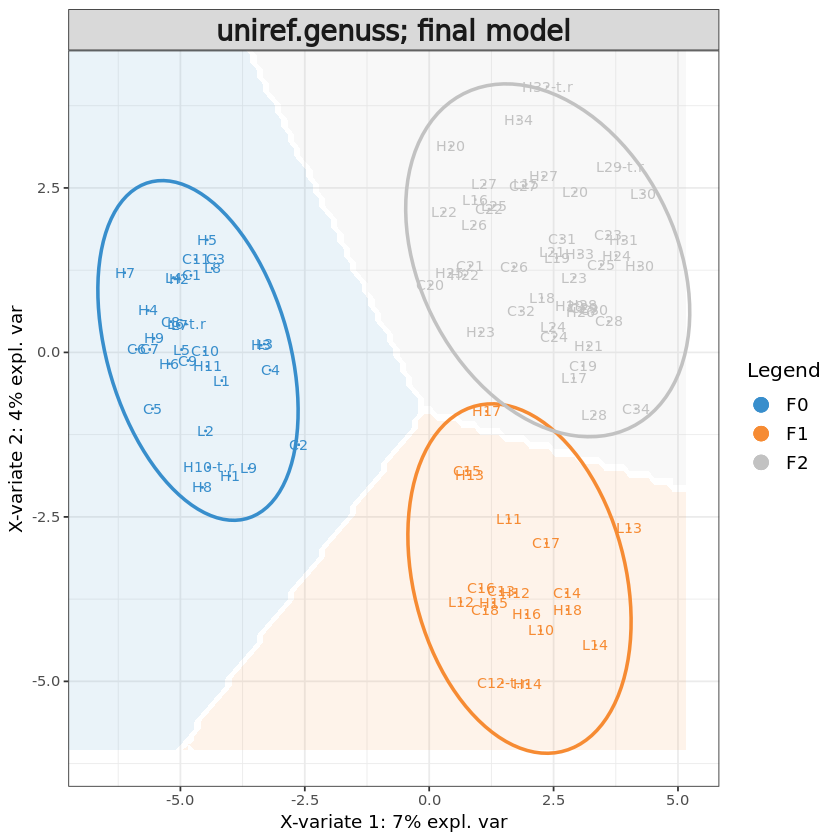

In [454]:
# Define final model
uniref.genus$optimal.ncomp <- 3
uniref.genus$optimal.keepX <- tune.splsda.uniref.genus$choice.keepX
#uniref.genus$optimal.keepX <- c(50,50)

# form final model with optimised values for component, using all features
final.splsda.uniref.genus <- splsda(X.uniref.genus, uniref.genus$generation, 
                       ncomp = uniref.genus$optimal.ncomp, 
                       keepX = uniref.genus$optimal.keepX)

background = background.predict(final.splsda.uniref.genus, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.genus, comp = 1:2, 
          group = uniref.genus$generation, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'uniref.genuss; final model')

# save sample variates
data <- as.data.frame(final.splsda.uniref.genus$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

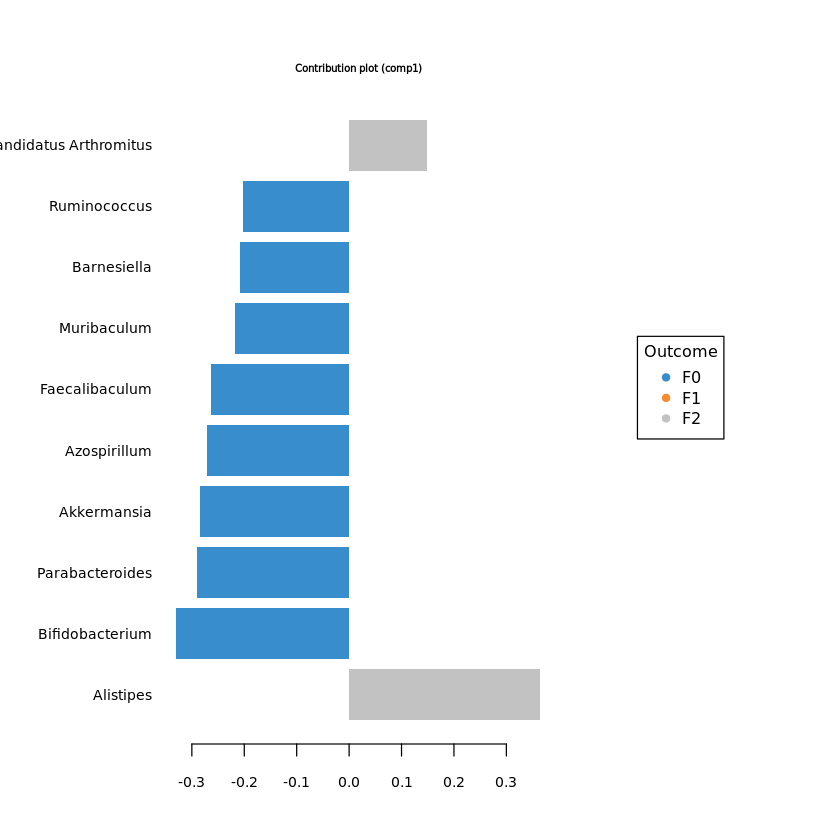

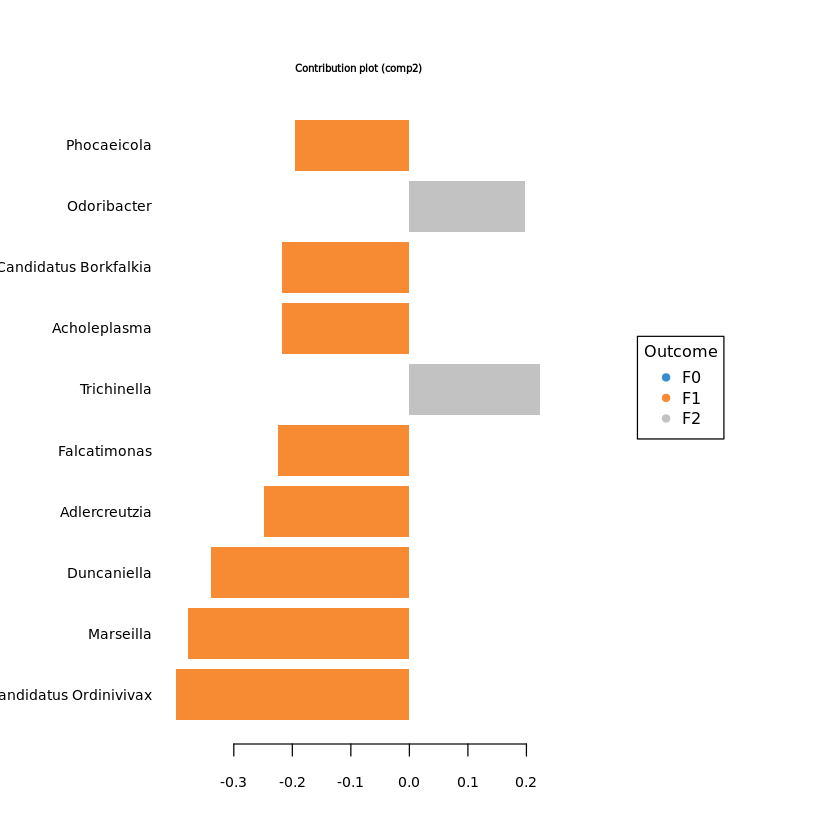

In [455]:
#plotVar(final.splsda.uniref.genus, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.genus, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10)
plotLoadings(final.splsda.uniref.genus, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.genus, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.genus, comp=2)$value
uniref.genus.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(uniref.genus.load) <- uniref.genus.load[,"Row.names"]
colnames(uniref.genus.load) <- c("ft","loading_comp1","loading_comp2")
uniref.genus.load = uniref.genus.load[,c("loading_comp1","loading_comp2")]

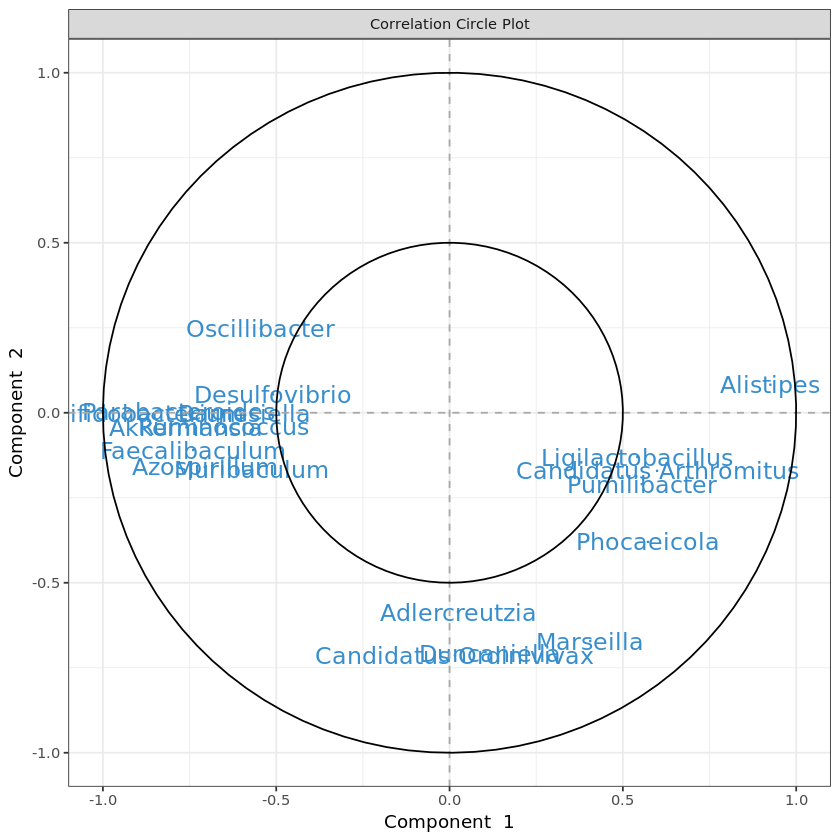

In [456]:
# plot feature correlation
plotVar(final.splsda.uniref.genus, cutoff=0.5)
uniref.genus.corr <- as.data.frame(plotVar(final.splsda.uniref.genus, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.genus.corr <- uniref.genus.corr[, c("x","y")]
colnames(uniref.genus.corr) <- c("corr_comp1","corr_comp2")

In [457]:
# Calculate feature stability
perf.splsda.uniref.genus <- perf(final.splsda.uniref.genus, 
                          folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
uniref.genus.stab <- merge(data.frame(perf.splsda.uniref.genus$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.genus$features$stable$comp2), by="Var1", all=T)
rownames(uniref.genus.stab) <- uniref.genus.stab$Var1
uniref.genus.stab <- uniref.genus.stab[, c("Freq.x","Freq.y")]
colnames(uniref.genus.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


In [427]:
# merge feature output
uniref.genus.out <- merge(uniref.genus.load, uniref.genus.stab, by="row.names")
rownames(uniref.genus.out) <- uniref.genus.out[,"Row.names"]
uniref.genus.out <- merge(uniref.genus.out[, 2:ncol(uniref.genus.out)], uniref.genus.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.features.tsv", uniref.genus.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [164]:
train <- sample(1:nrow(X.uniref.genus), ceiling(nrow(X.uniref.genus)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.genus), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.genus.train <- X.uniref.genus[train, ]
X.uniref.genus.test <- X.uniref.genus[test,]
Y.uniref.genus.train <- info[train,"generation"]
Y.uniref.genus.test <- info[test, "generation"]
train.splsda.uniref.genus <- splsda(X.uniref.genus.train, Y.uniref.genus.train, ncomp = uniref.genus$optimal.ncomp, keepX = uniref.genus$optimal.keepX)
predict.splsda.uniref.genus <- predict(train.splsda.uniref.genus, X.uniref.genus.test, 
                                dist = "max.dist")
predict.comp2.uniref.genus <- predict.splsda.uniref.genus$class$max.dist[,2]
table(factor(predict.comp2.uniref.genus, levels = levels(uniref.genus$generation)), Y.uniref.genus.test)

    Y.uniref.test
     F0 F1 F2
  F0 23  0  1
  F1  0  8  1
  F2  0  7 32

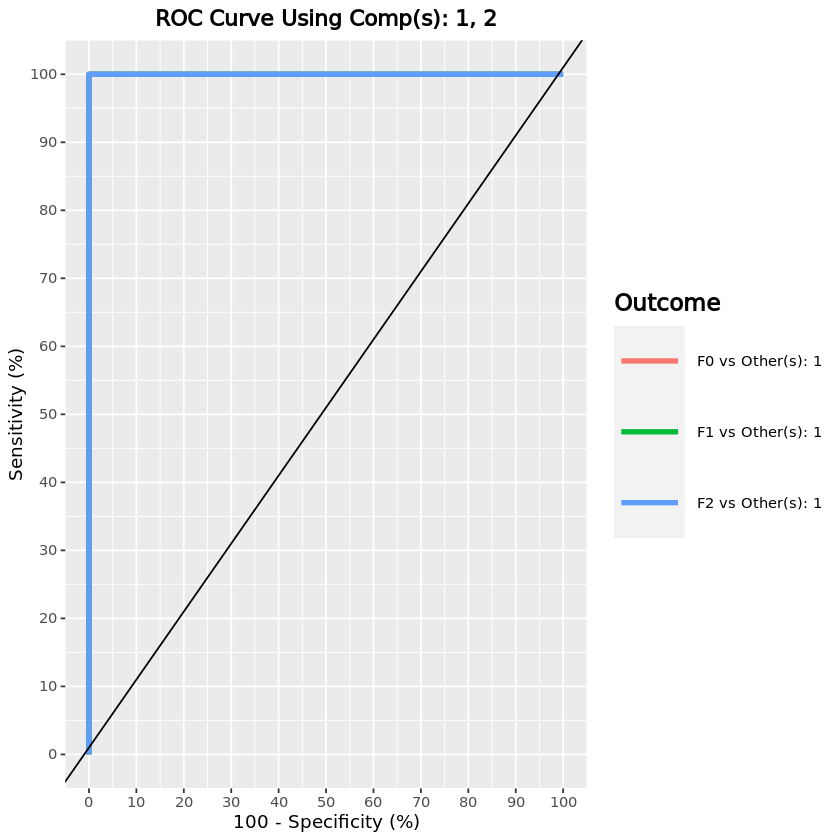

In [165]:
uniref.genus.auc.splsda = auroc(final.splsda.uniref.genus, roc.comp = 2, print = F) # AUROC for the first component

#### UniRef genera - F0 generation

[1] "1163"           "genera removed" "233"            "remaining"

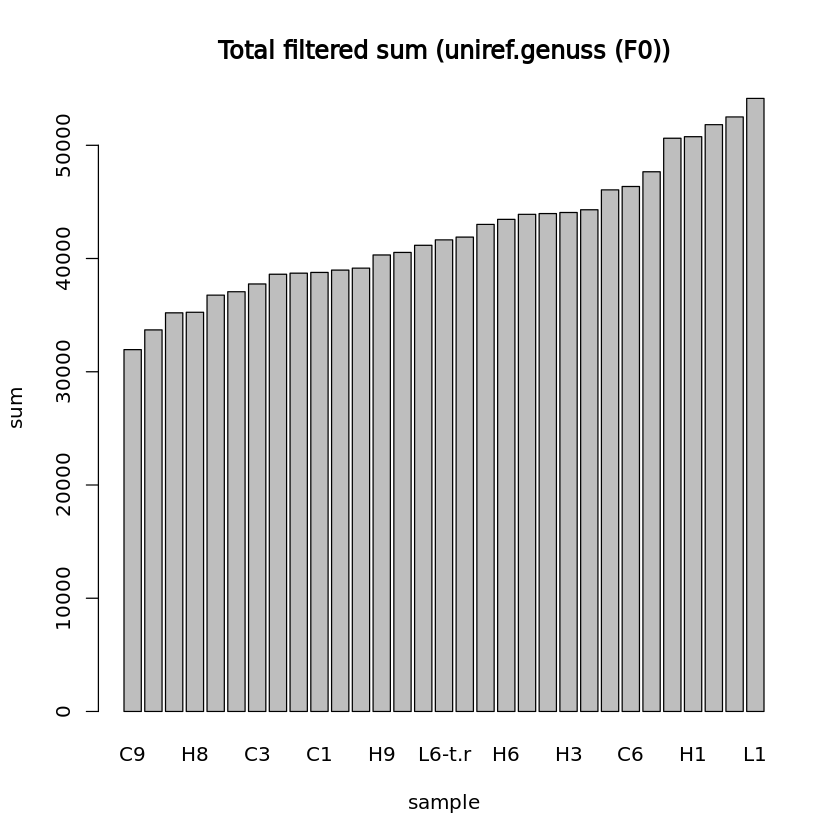

In [458]:
## PARAMS ##
# Initial components
uniref.genus.F0.ncomp <- 10
# Percentage of samples in which features must have >0 sum
uniref.genus.F0.percent_occ <- 10
# Quantile used for removing low abundance features
uniref.genus.F0.quantile_thresh <- 0.1
generation <- "F0"

uniref.genus.F0 <- list()
uniref.genus.F0$cov <- uniref.genus$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(uniref.genus.F0$cov[, colSums(uniref.genus.F0$cov) > 0])
uniref.genus.F0$nz <- uniref.genus.F0$cov[, colnames(uniref.genus.F0$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(uniref.genus.F0$nz) / sum(colSums(uniref.genus.F0$nz)) * 100, probs = uniref.genus.F0.quantile_thresh)
uniref.genus.F0$filtered <- low.count.removal(uniref.genus.F0$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
uniref.genus.F0$occ <- colSums(uniref.genus.F0$filtered>0) / nrow(uniref.genus.F0$filtered) * 100
# Keep features occurring in defined percentage of samples
uniref.genus.F0$filtered <- uniref.genus.F0$filtered[, which(uniref.genus.F0$occ >= uniref.genus.F0.percent_occ)]

#uniref.genus.F0$filtered <- uniref.genus.F0$filtered[,-nearZeroVar(uniref.genus.F0$filtered)$Position]
paste0(c(dim(uniref.genus.F0$cov)[2] - dim(uniref.genus.F0$filtered)[2], "genera removed", dim(uniref.genus.F0$filtered)[2], "remaining"))

# Add offset
uniref.genus.F0$offset <- uniref.genus.F0$filtered + 1
uniref.genus.F0$clr <- logratio.transfo(uniref.genus.F0$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.uniref.genus.F0 <- uniref.genus.F0$clr

uniref.genus.F0$treatment <- factor(info[rownames(uniref.genus.F0$clr), "Treatment"])

uniref.genus.F0.lib.size <- apply(uniref.genus.F0$filtered, 1, sum) # determine total count for each sample
barplot(sort(uniref.genus.F0.lib.size), main="Total filtered sum (uniref.genuss (F0))", ylab="sum", xlab="sample")

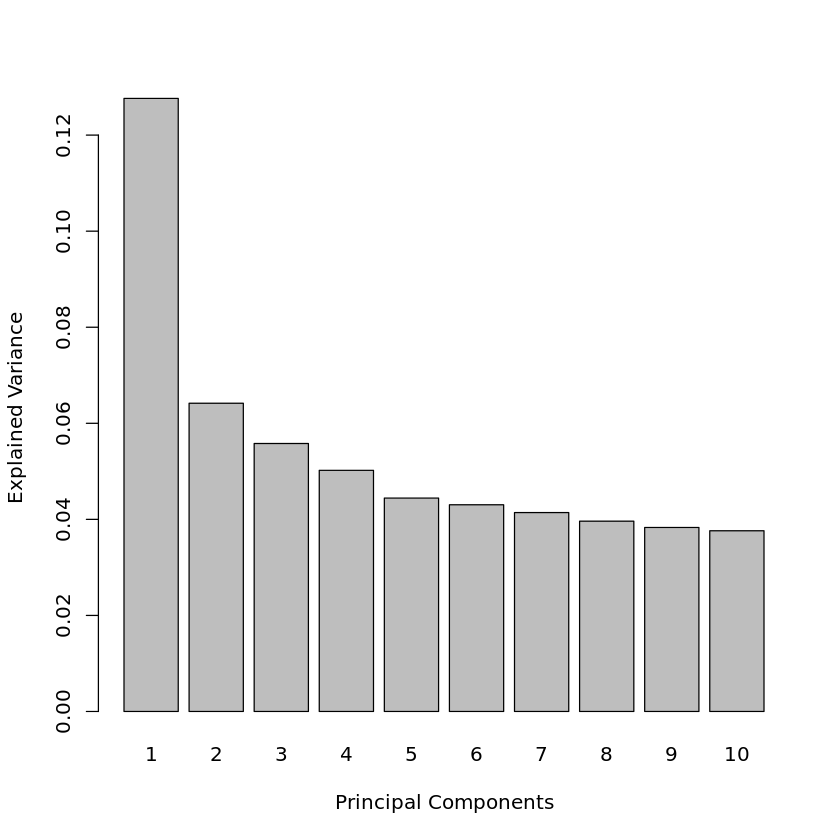

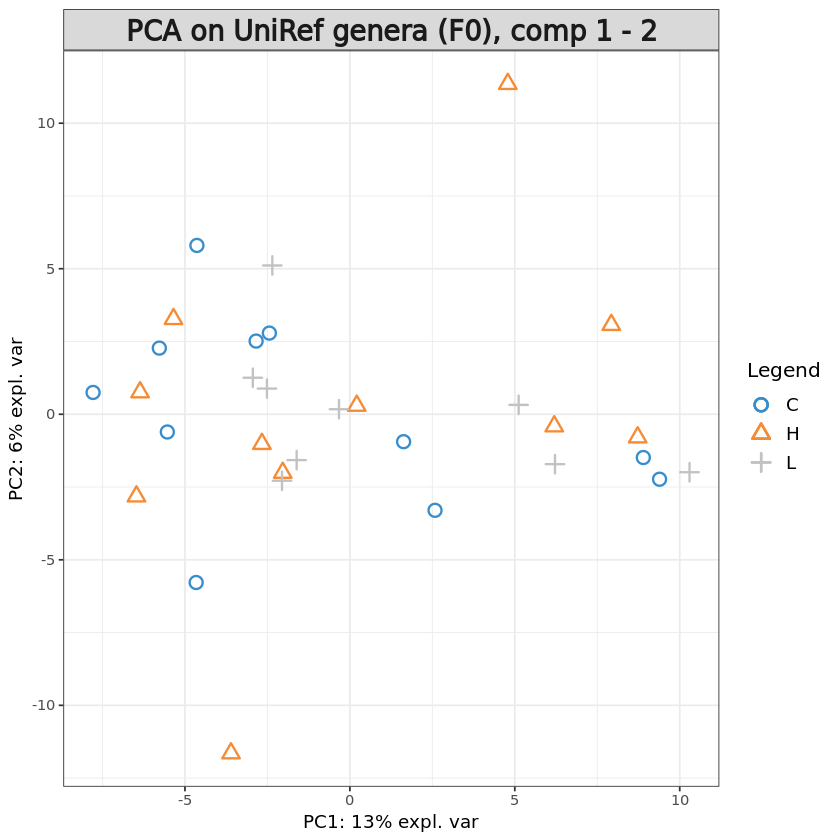

In [459]:
pca.uniref.genus.F0 = pca(X.uniref.genus.F0, ncomp = uniref.genus.F0.ncomp, center = TRUE, scale = TRUE) 

plot(pca.uniref.genus.F0)
plotIndiv(pca.uniref.genus.F0, group = uniref.genus.F0$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on UniRef genera (F0), comp 1 - 2')

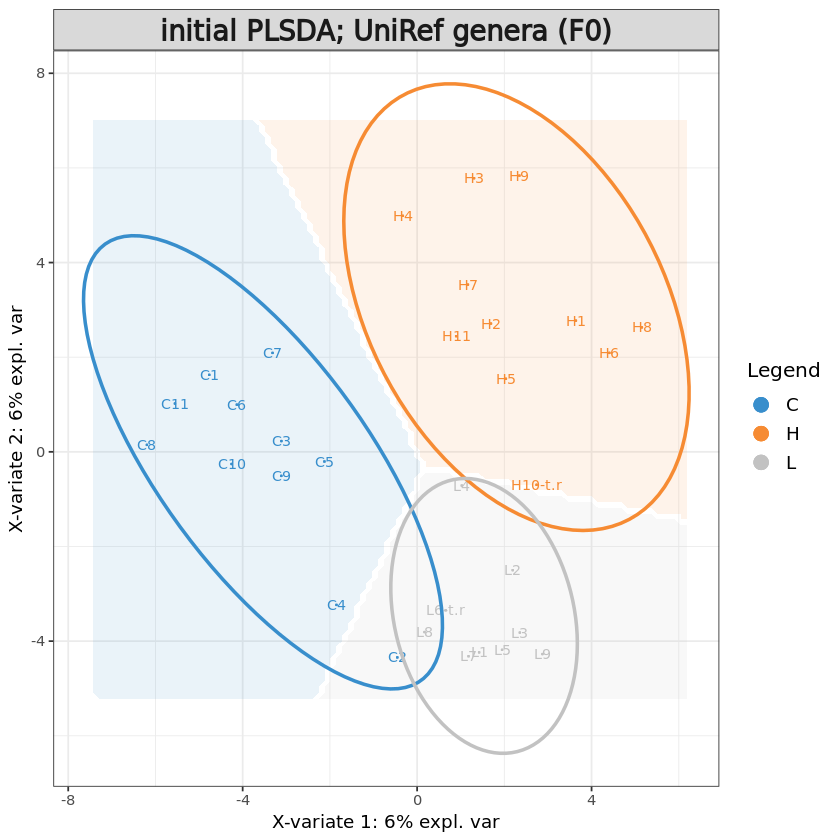

In [460]:
# Initial sPLS-DA model
uniref.genus.F0.splsda <- splsda(X.uniref.genus.F0, uniref.genus.F0$treatment, ncomp = uniref.genus.F0.ncomp)  # set ncomp to 10 for performance assessment later

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.genus.F0.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.genus.F0.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.genus.F0$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef genera (F0)")

Here we see that the initial model is already pretty good at separating the different treatments.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,2,1,1
BER,2,1,1


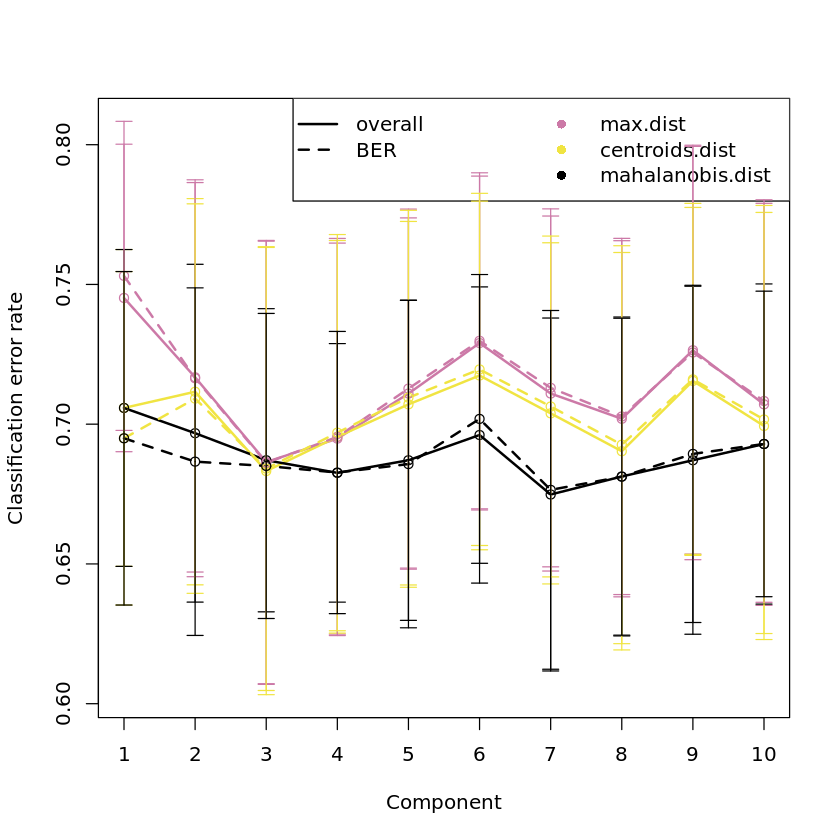

In [461]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.genus.F0 <- perf(uniref.genus.F0.splsda, validation = "Mfold", 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.genus.F0, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.genus.F0$choice.ncomp # what is the optimal value of components according to perf()

The error rates are higher for the F0 generation compared to when using species abundances.

In [474]:
# Define parameters for tuning keepX
uniref.genus.F0.step <- 0.05
uniref.genus.F0.ncomp.tune <- 3
# grid of possible keepX values that will be tested for each component
#uniref.genus.F0.keepx <- c(10, 20, seq(ceiling(dim(uniref.genus.F0$filtered)[2] * uniref.genus.F0.step), 
#                      round(dim(uniref.genus.F0$filtered)[2], digits = -1), 
#                      ceiling(dim(uniref.genus.F0$filtered)[2] * uniref.genus.F0.step)
#                     )
#                 )
uniref.genus.F0.keepx <- c(seq(10,100, 5), 150,200)
uniref.genus.F0.keepx

[1]  10  15  20  25  30  35  40  45  50  55  60  65  70  75  80  85  90  95 100
[20] 150 200

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


[1] 2

comp1 comp2 comp3 
   10    75   150

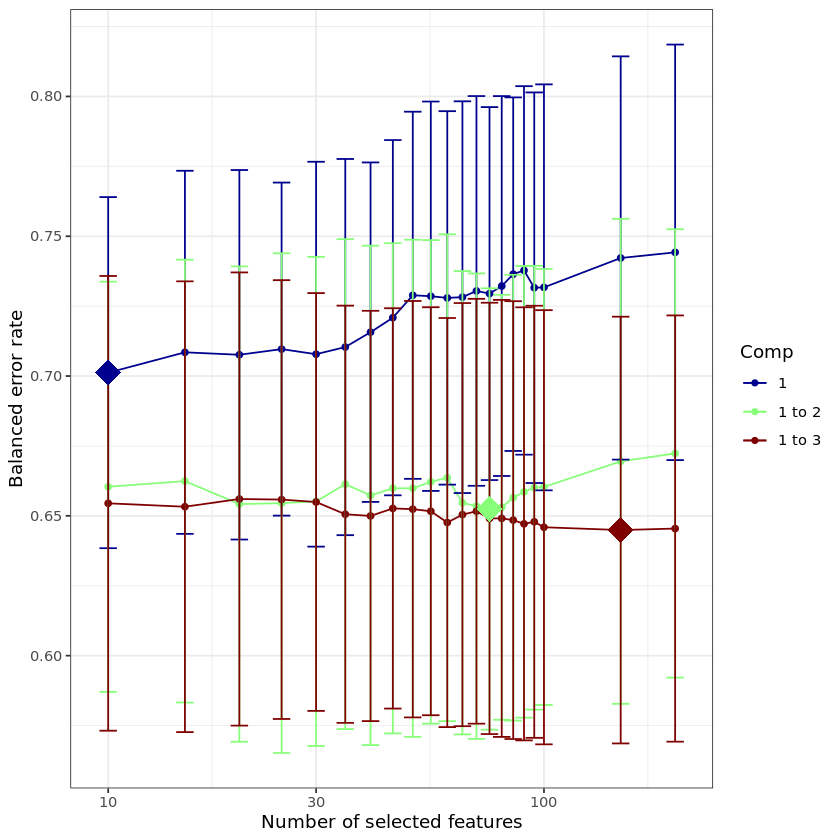

In [475]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.genus.F0 <- tune.splsda(X.uniref.genus.F0, uniref.genus.F0$treatment, ncomp = uniref.genus.F0.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.genus.F0.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.genus.F0, col = color.jet(uniref.genus.F0.ncomp.tune))

tune.splsda.uniref.genus.F0$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.genus.F0$choice.keepX # what are the optimal values of variables according to tune.splsda()

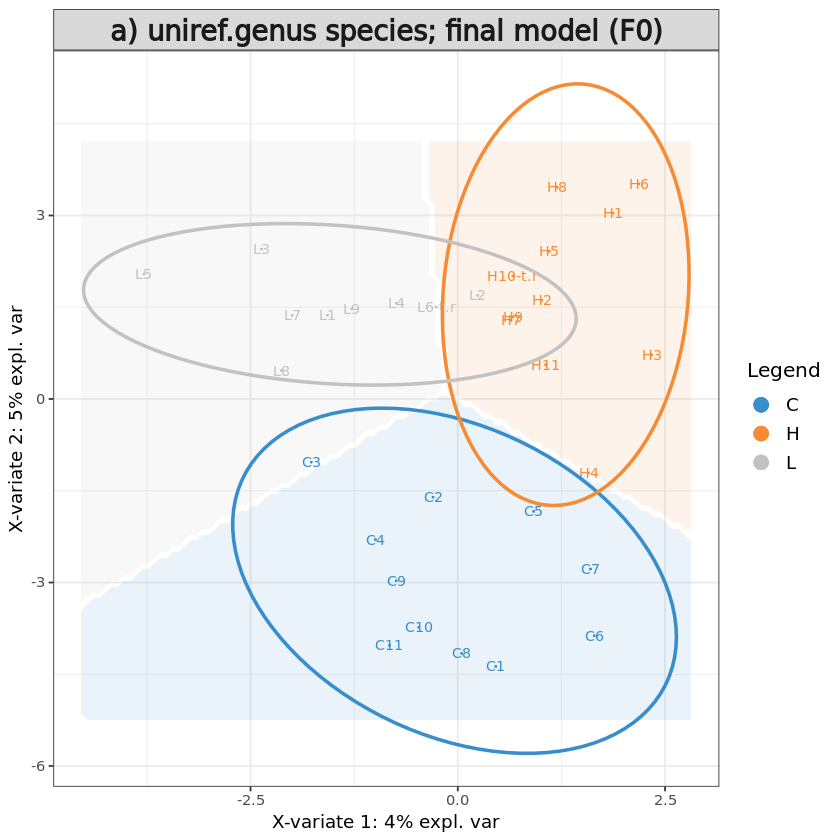

In [477]:
# Define final model
uniref.genus.F0$optimal.ncomp <- 2
uniref.genus.F0$optimal.keepX <- tune.splsda.uniref.genus.F0$choice.keepX[1:uniref.genus.F0$optimal.ncomp]
#uniref.genus.F0$optimal.keepX <- rep(20, uniref.genus.F0$optimal.ncomp)
#uniref.genus.F0$optimal.keepX <- c(10, 10, 10)

# form final model with optimised values for component, using all features
final.splsda.uniref.genus.F0 <- splsda(X.uniref.genus.F0, uniref.genus.F0$treatment, 
                       ncomp = uniref.genus.F0$optimal.ncomp, 
                       keepX = uniref.genus.F0$optimal.keepX)

background = background.predict(final.splsda.uniref.genus.F0, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.genus.F0, comp = 1:2, 
          group = uniref.genus.F0$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) uniref.genus species; final model (F0)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.genus.F0$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F0.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

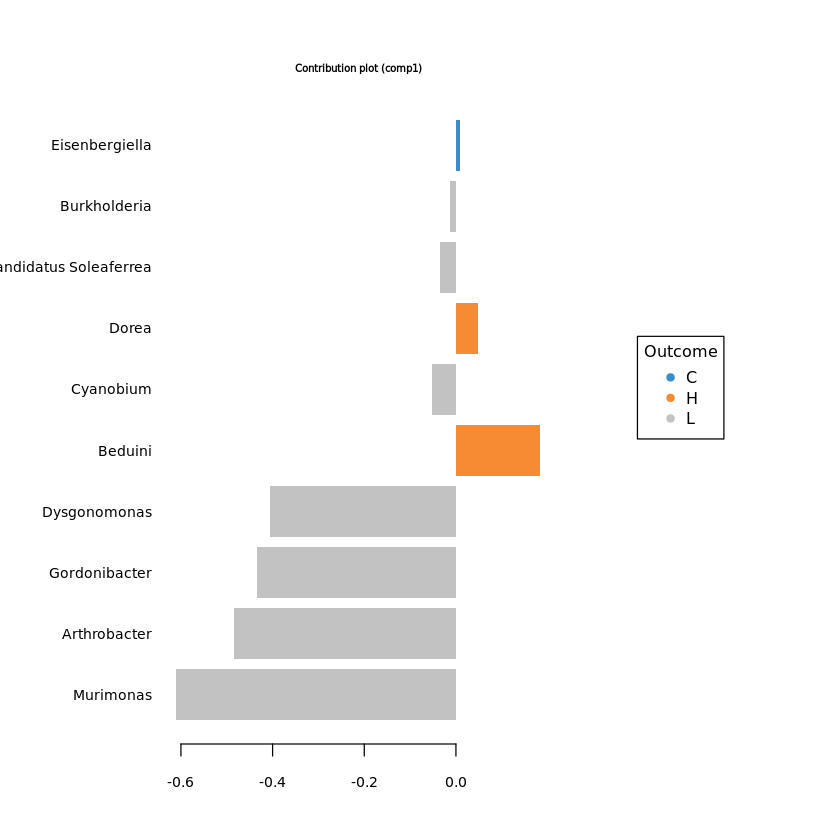

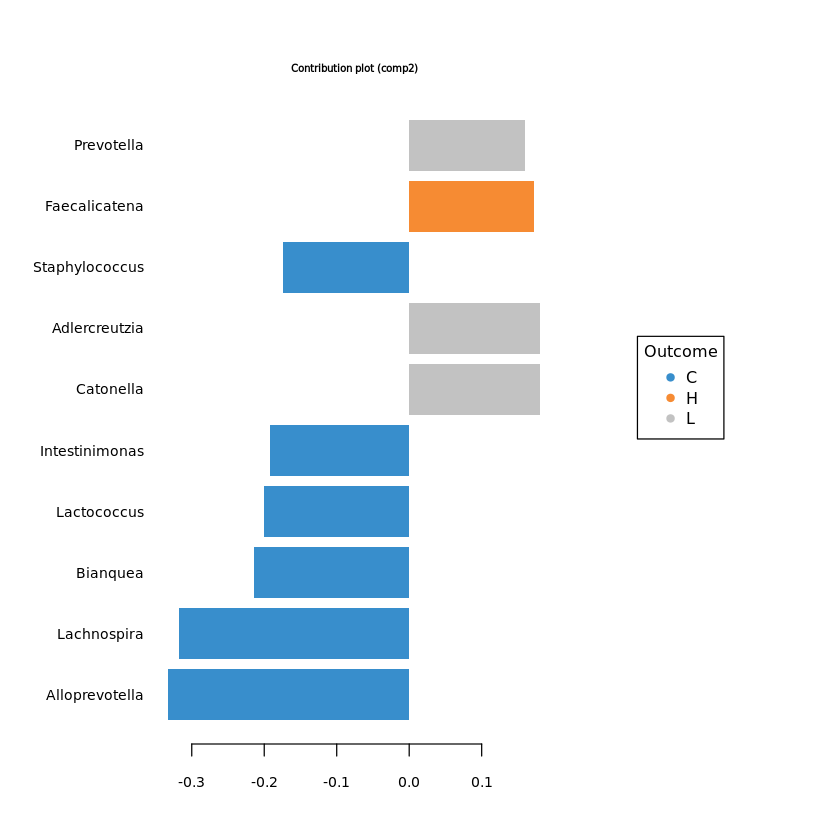

In [479]:
#plotVar(final.splsda.uniref.genus.F0, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.genus.F0, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.uniref.genus.F0, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.genus.F0, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.genus.F0, comp=2)$value
F0.uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F0.uniref.load) <- F0.uniref.load[,"Row.names"]
colnames(F0.uniref.load) <- c("ft","loading_comp1","loading_comp2")
F0.uniref.load = F0.uniref.load[,c("loading_comp1","loading_comp2")]

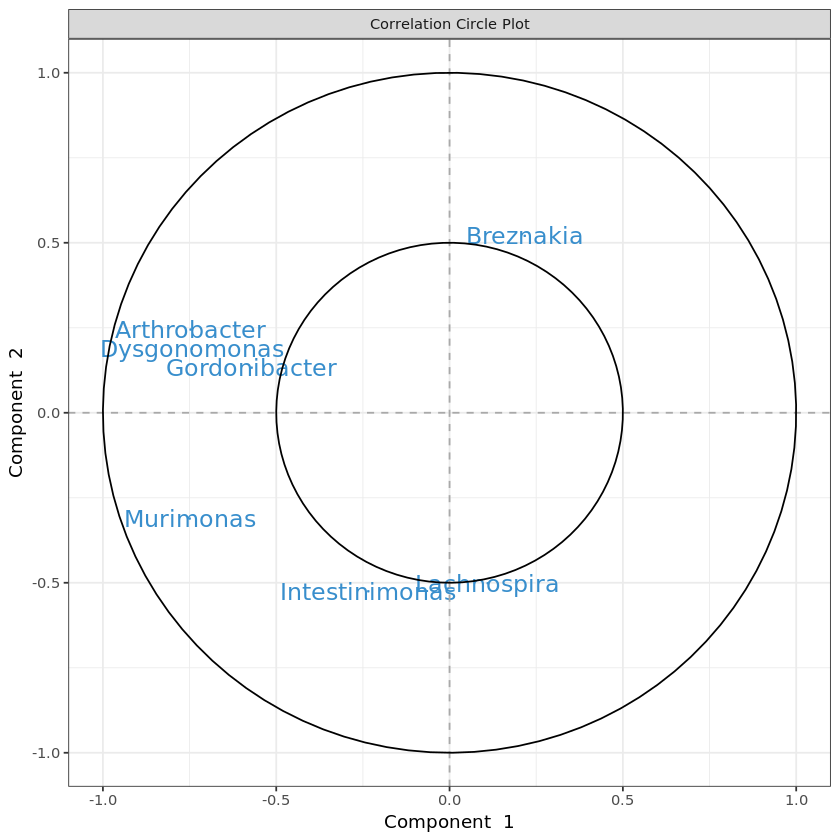

In [480]:
# plot feature correlation
plotVar(final.splsda.uniref.genus.F0, cutoff=0.5)
uniref.genus.F0.corr <- as.data.frame(plotVar(final.splsda.uniref.genus.F0, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.genus.F0.corr <- uniref.genus.F0.corr[, c("x","y")]
colnames(uniref.genus.F0.corr) <- c("corr_comp1","corr_comp2")

In [481]:
# Calculate feature stability
perf.splsda.uniref.genus.F0 <- perf(final.splsda.uniref.genus.F0, 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F0.uniref.stab <- merge(data.frame(perf.splsda.uniref.genus.F0$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.genus.F0$features$stable$comp2), by="Var1", all=T)
rownames(F0.uniref.stab) <- F0.uniref.stab$Var1
F0.uniref.stab <- F0.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F0.uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [482]:
# merge feature output
F0.uniref.out <- merge(F0.uniref.load, F0.uniref.stab, by="row.names")
rownames(F0.uniref.out) <- F0.uniref.out[,"Row.names"]
F0.uniref.out <- merge(F0.uniref.out[, 2:ncol(F0.uniref.out)], uniref.genus.F0.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F0.features.tsv", F0.uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [483]:
train <- sample(1:nrow(X.uniref.genus.F0), ceiling(nrow(X.uniref.genus.F0)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.genus.F0), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.genus.F0.train <- X.uniref.genus.F0[train, ]
X.uniref.genus.F0.test <- X.uniref.genus.F0[test,]
Y.uniref.genus.F0.train <- info[train,"treatment"]
Y.uniref.genus.F0.test <- info[test, "treatment"]
train.splsda.uniref.genus.F0 <- splsda(X.uniref.genus.F0.train, Y.uniref.genus.F0.train, ncomp = uniref.genus.F0$optimal.ncomp, keepX = uniref.genus.F0$optimal.keepX)
predict.splsda.uniref.genus.F0 <- predict(train.splsda.uniref.genus.F0, X.uniref.genus.F0.test, 
                                dist = "max.dist")
predict.comp2.uniref.genus.F0 <- predict.splsda.uniref.genus.F0$class$max.dist[,2]
table(factor(predict.comp2.uniref.genus.F0, levels = levels(uniref.genus.F0$treatment)), Y.uniref.genus.F0.test)

   Y.uniref.genus.F0.test
    C H L
  C 6 8 5
  H 0 0 0
  L 0 1 3

$Comp1
                 AUC   p-value
C vs Other(s) 0.5500 0.6497000
H vs Other(s) 0.9136 0.0001719
L vs Other(s) 0.9040 0.0004985

$Comp2
                 AUC   p-value
C vs Other(s) 0.9955 6.789e-06
H vs Other(s) 0.9955 6.789e-06
L vs Other(s) 0.9848 2.943e-05



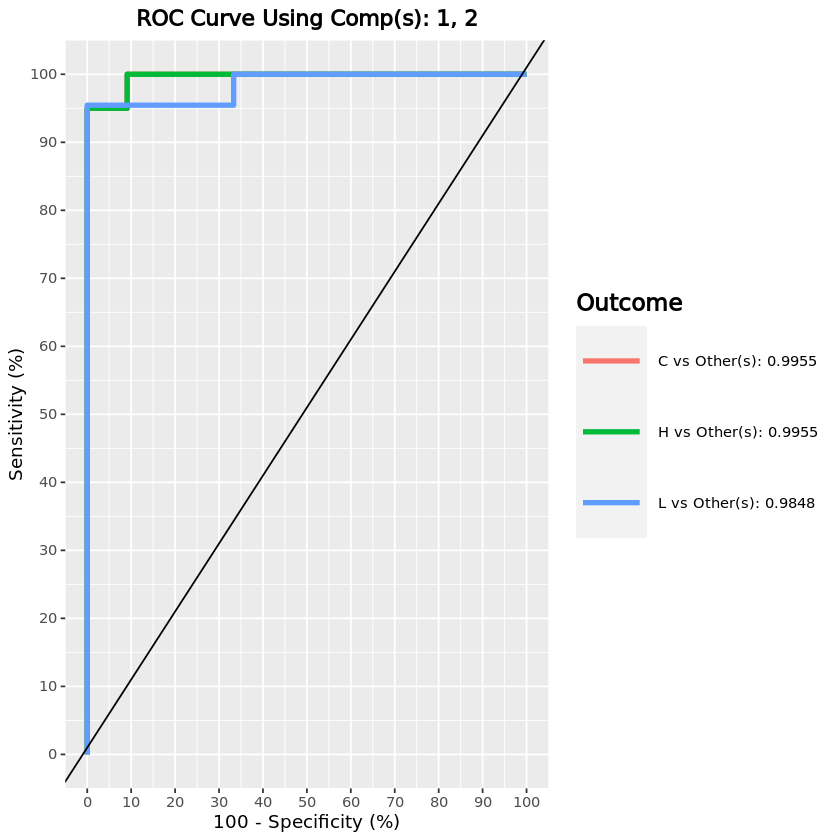

In [484]:
F0.uniref.auc.splsda = auroc(final.splsda.uniref.genus.F0, roc.comp = 2, print = T) # AUROC for the first component

#### UniRef genera - F0 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [485]:
uniref.genus.F0_2 <- list()
F0_info_2 <- info[rownames(uniref.genus.F0$cov),]
F0_info_2$treatment <- gsub(x = F0_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
uniref.genus.F0_2$cov <- uniref.genus.F0$cov[rownames(F0_info_2),]
uniref.genus.F0_2$filtered <- uniref.genus.F0$filtered[rownames(F0_info_2),]

uniref.genus.F0_2$clr <- uniref.genus.F0$clr[rownames(F0_info_2), ]
X.uniref.genus.F0_2 <- uniref.genus.F0_2$clr

uniref.genus.F0_2$treatment <- factor(F0_info_2[rownames(uniref.genus.F0_2$clr), "treatment"])

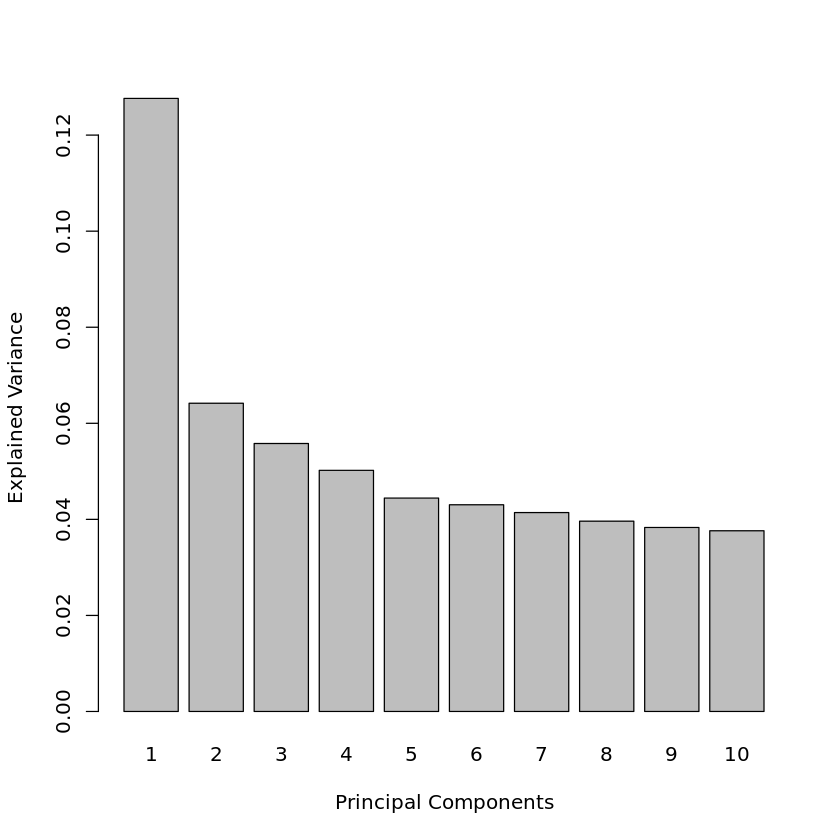

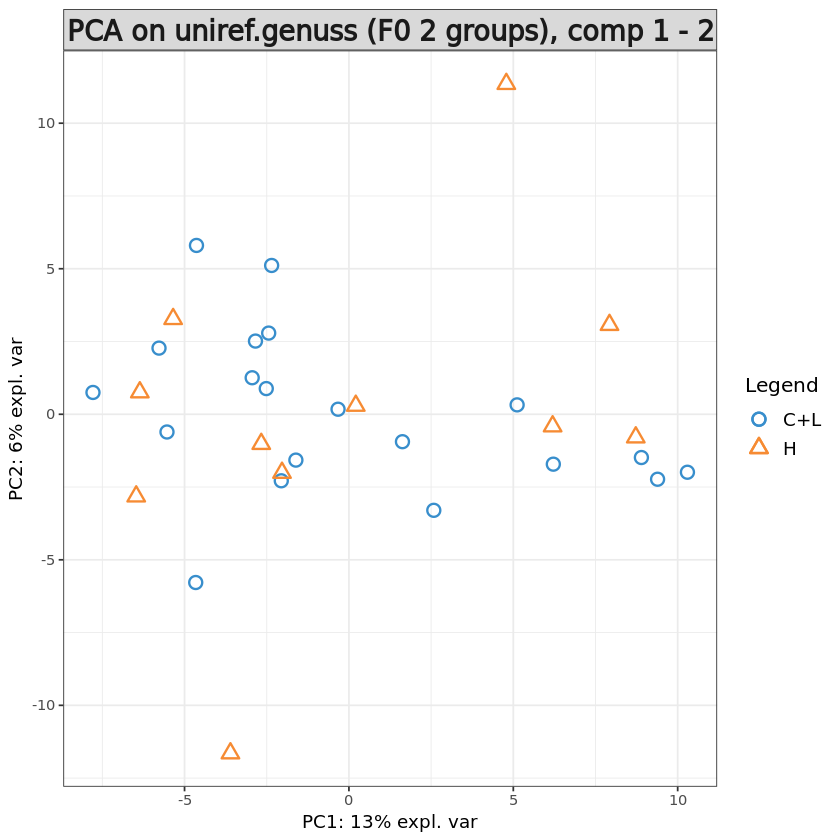

In [486]:
pca.uniref.genus.F0_2 = pca(X.uniref.genus.F0_2, ncomp = 10, center = TRUE, scale = TRUE) 

plot(pca.uniref.genus.F0_2)
plotIndiv(pca.uniref.genus.F0_2, group = uniref.genus.F0_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on uniref.genuss (F0 2 groups), comp 1 - 2')

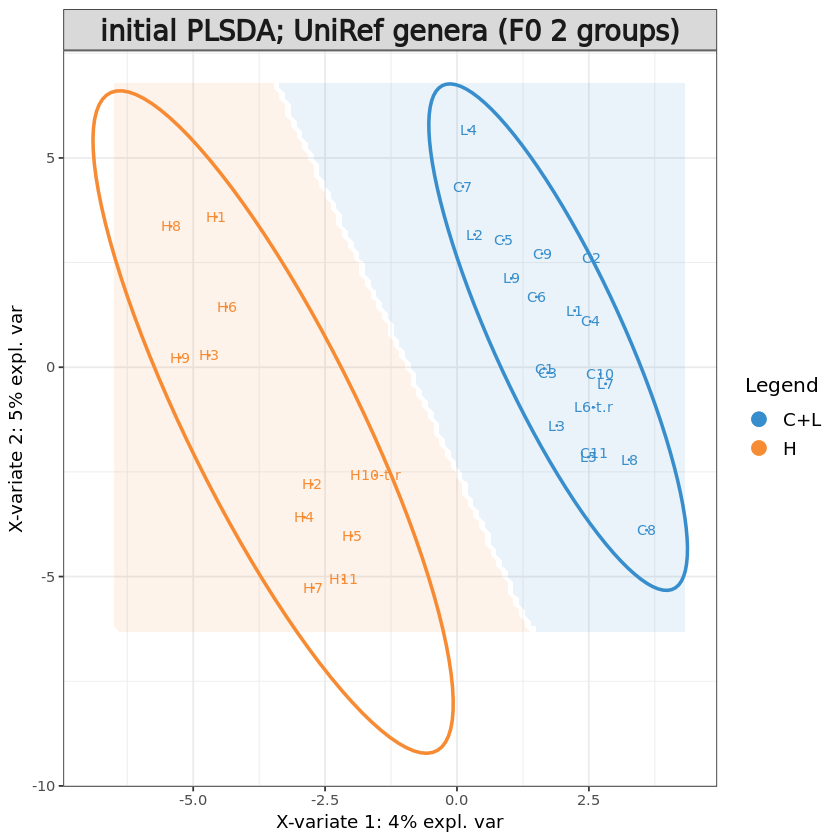

In [489]:
# Initial sPLS-DA model
uniref.genus.F0_2.splsda <- splsda(X.uniref.genus.F0_2, uniref.genus.F0_2$treatment, ncomp = 10)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.genus.F0_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.genus.F0_2.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.genus.F0_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef genera (F0 2 groups)")

The initial model separates the two treatment groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,1,2,2
BER,1,2,2


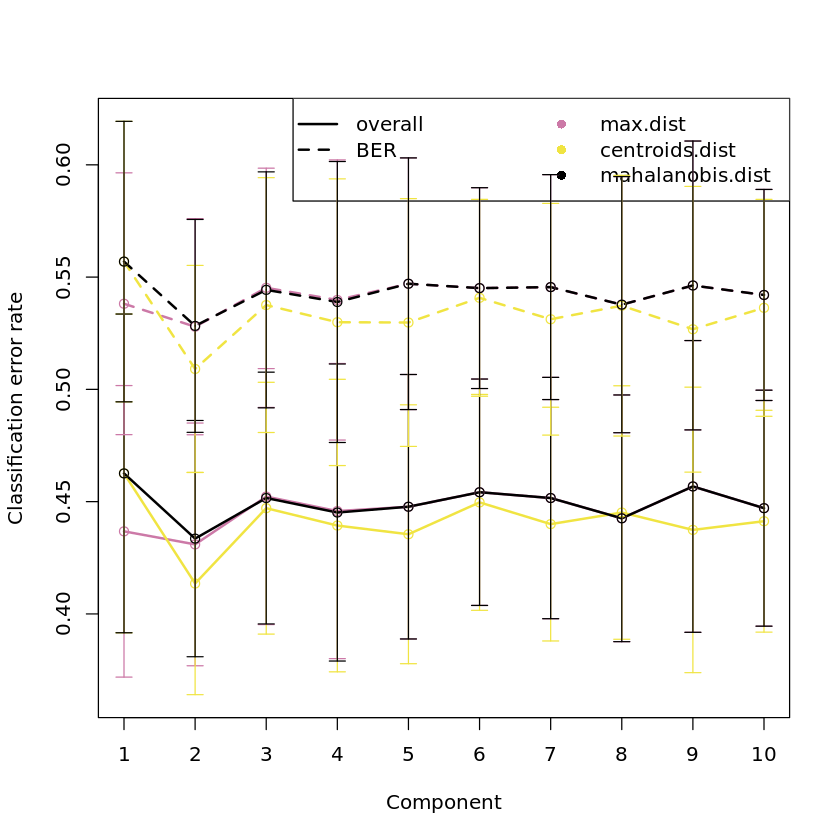

In [488]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.genus.F0_2 <- perf(uniref.genus.F0_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.genus.F0_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.genus.F0_2$choice.ncomp # what is the optimal value of components according to perf()

In [491]:
# Define parameters for tuning keepX
uniref.genus.F0_2.step <- 0.05
uniref.genus.F0_2.ncomp.tune <- 2
# grid of possible keepX values that will be tested for each component
uniref.genus.F0_2.keepx <- c(10, 20, seq(ceiling(dim(uniref.genus.F0_2$filtered)[2] * uniref.genus.F0_2.step), 
                      round(dim(uniref.genus.F0_2$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.genus.F0_2$filtered)[2] * uniref.genus.F0_2.step)
                     )
                 )
uniref.genus.F0_2.keepx <- c(seq(10, 100, 5), 150, 200)
uniref.genus.F0_2.keepx

[1]  10  15  20  25  30  35  40  45  50  55  60  65  70  75  80  85  90  95 100
[20] 150 200

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


[1] 1

comp1 comp2 
   10    25

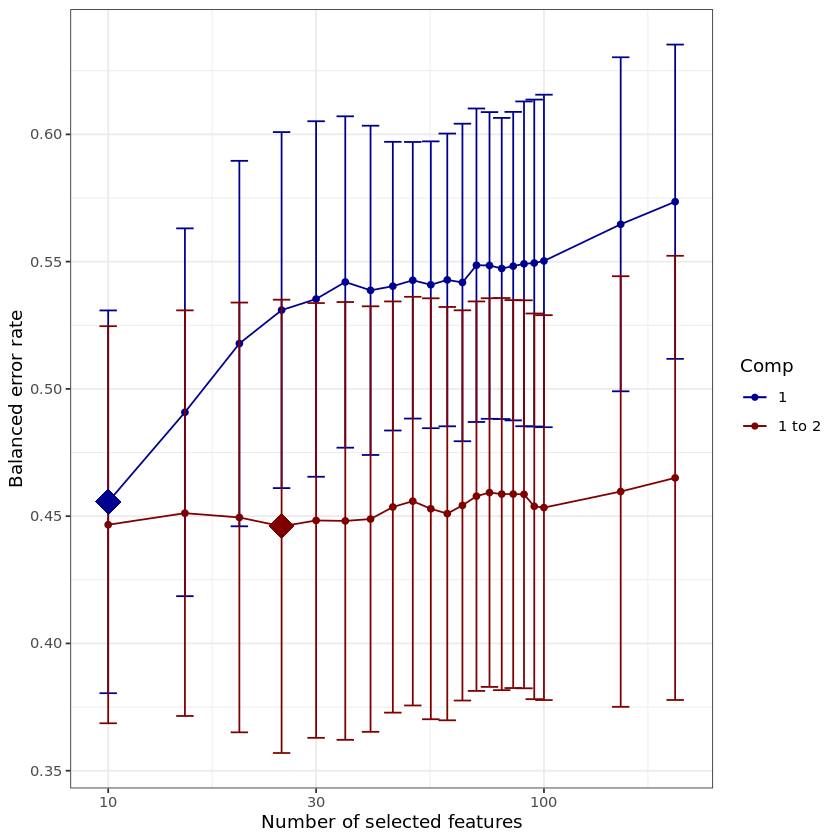

In [492]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.genus.F0_2 <- tune.splsda(X.uniref.genus.F0_2, uniref.genus.F0_2$treatment, ncomp = uniref.genus.F0_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.genus.F0_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.genus.F0_2, col = color.jet(uniref.genus.F0_2.ncomp.tune))

tune.splsda.uniref.genus.F0_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.genus.F0_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

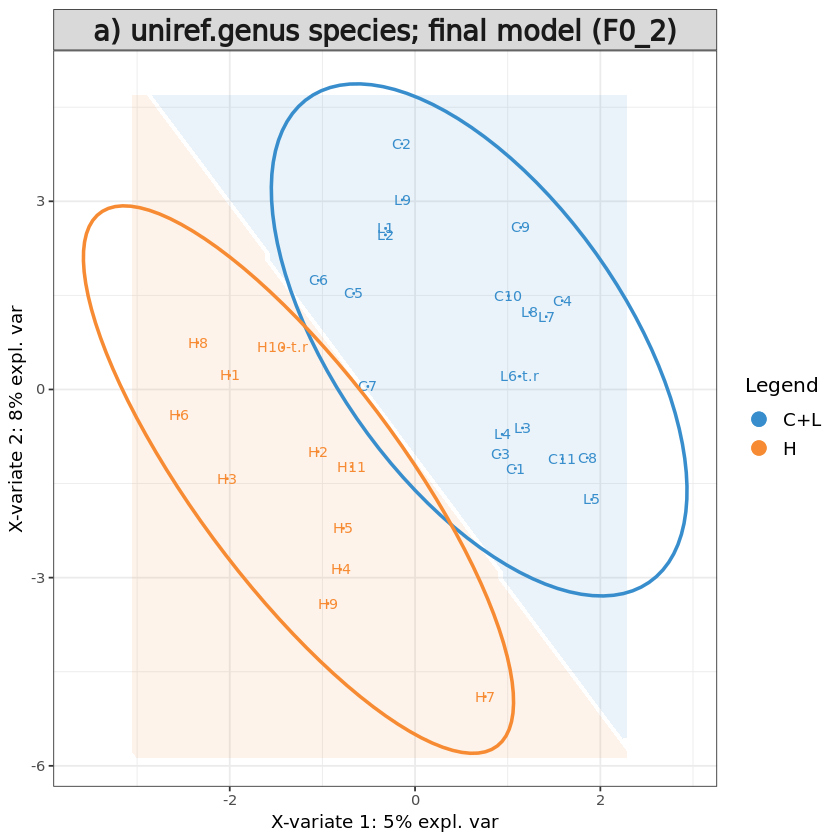

In [493]:
# Define final model
uniref.genus.F0_2$optimal.ncomp <- 2
uniref.genus.F0_2$optimal.keepX <- tune.splsda.uniref.genus.F0_2$choice.keepX[1:uniref.genus.F0_2$optimal.ncomp]
#uniref.genus.F0_2$optimal.keepX <- rep(50, uniref.genus.F0_2$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.uniref.genus.F0_2 <- splsda(X.uniref.genus.F0_2, uniref.genus.F0_2$treatment, 
                       ncomp = uniref.genus.F0_2$optimal.ncomp, 
                       keepX = uniref.genus.F0_2$optimal.keepX)

background = background.predict(final.splsda.uniref.genus.F0_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.genus.F0_2, comp = 1:2, 
          group = uniref.genus.F0_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) uniref.genus species; final model (F0_2)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.genus.F0_2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F0_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

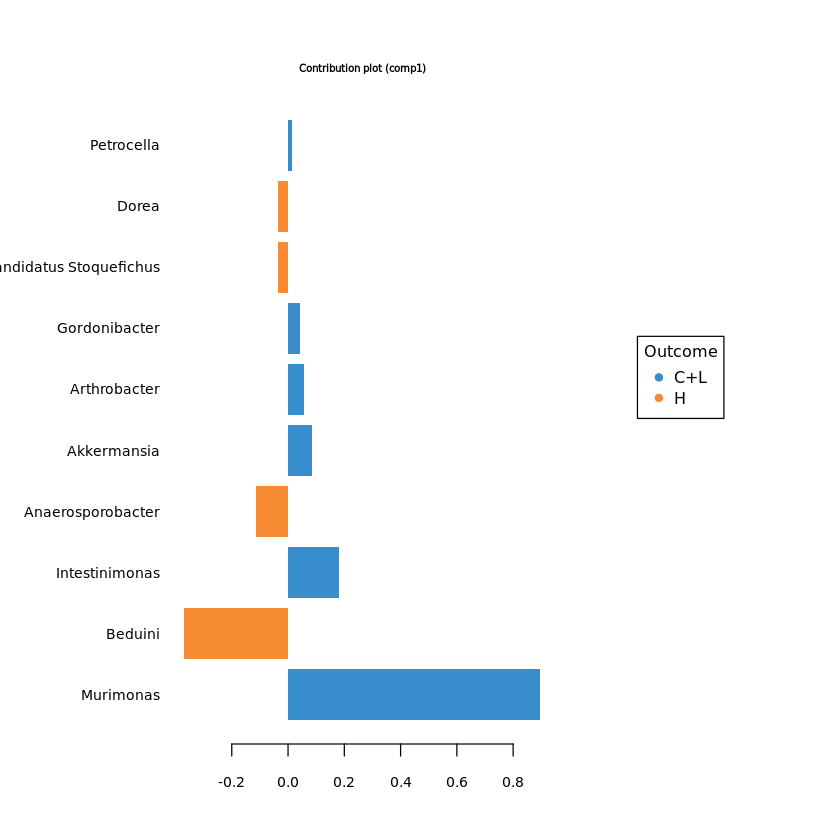

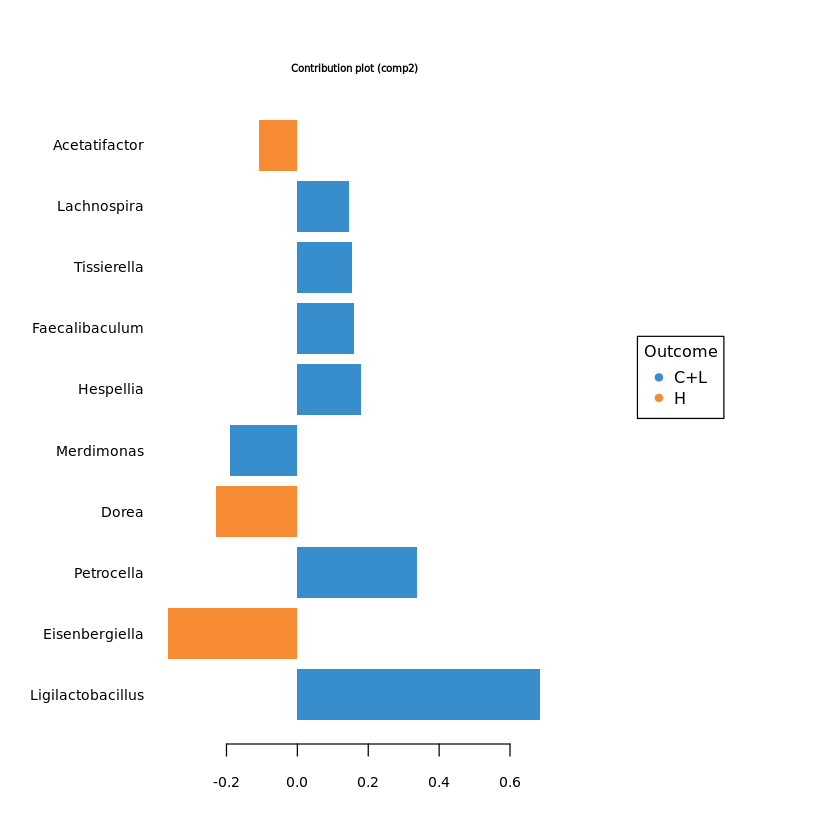

In [494]:
#plotVar(final.splsda.uniref.genus.F0_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.genus.F0_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.uniref.genus.F0_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.genus.F0_2, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.genus.F0_2, comp=2)$value
F0_2.uniref.genus.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F0_2.uniref.genus.load) <- F0_2.uniref.genus.load[,"Row.names"]
colnames(F0_2.uniref.genus.load) <- c("ft","loading_comp1","loading_comp2")
F0_2.uniref.genus.load = F0_2.uniref.genus.load[,c("loading_comp1","loading_comp2")]

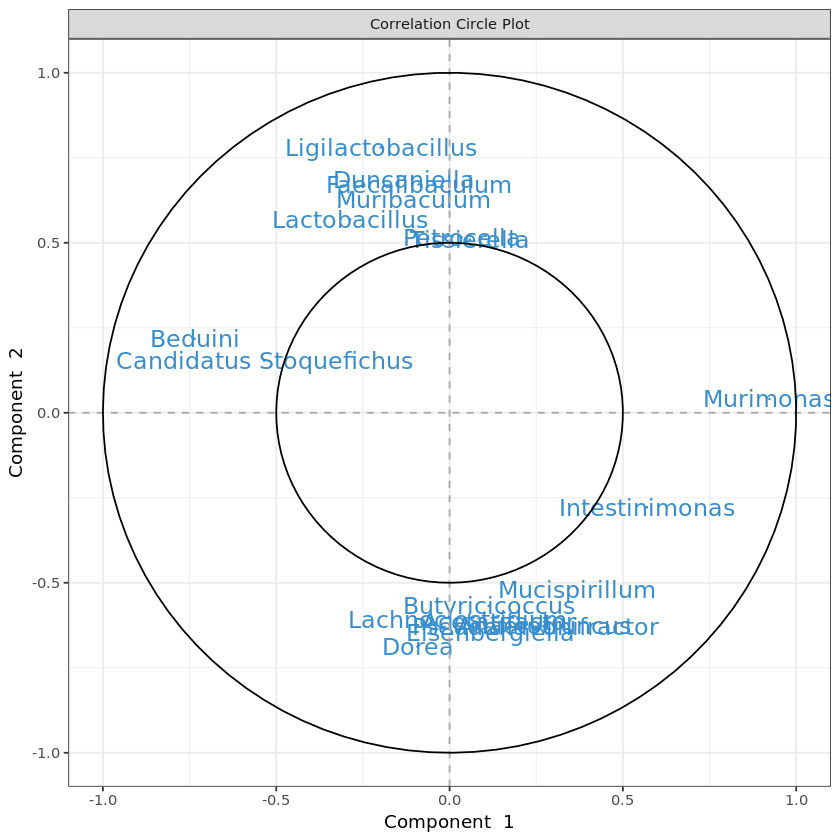

In [495]:
# plot feature correlation
plotVar(final.splsda.uniref.genus.F0_2, cutoff=0.5)
uniref.genus.F0_2.corr <- as.data.frame(plotVar(final.splsda.uniref.genus.F0_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.genus.F0_2.corr <- uniref.genus.F0_2.corr[, c("x","y")]
colnames(uniref.genus.F0_2.corr) <- c("corr_comp1","corr_comp2")

In [496]:
# Calculate feature stability
perf.splsda.uniref.genus.F0_2 <- perf(final.splsda.uniref.genus.F0_2, 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F0_2.uniref.genus.stab <- merge(data.frame(perf.splsda.uniref.genus.F0_2$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.genus.F0_2$features$stable$comp2), by="Var1", all=T)
rownames(F0_2.uniref.genus.stab) <- F0_2.uniref.genus.stab$Var1
F0_2.uniref.genus.stab <- F0_2.uniref.genus.stab[, c("Freq.x","Freq.y")]
colnames(F0_2.uniref.genus.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [497]:
F0_2.uniref.genus.stab <- merge(data.frame(perf.splsda.uniref.genus.F0_2$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.genus.F0_2$features$stable$comp2), by="Var1", all=T)
rownames(F0_2.uniref.genus.stab) <- F0_2.uniref.genus.stab$Var1
F0_2.uniref.genus.stab <- F0_2.uniref.genus.stab[, c("Freq.x","Freq.y")]
colnames(F0_2.uniref.genus.stab) <- c("stability_comp1","stability_comp2")
# merge feature output
F0_2.uniref.genus.out <- merge(F0_2.uniref.genus.load, F0_2.uniref.genus.stab, by="row.names")
rownames(F0_2.uniref.genus.out) <- F0_2.uniref.genus.out[,"Row.names"]
F0_2.uniref.genus.out <- merge(F0_2.uniref.genus.out[, 2:ncol(F0_2.uniref.genus.out)], uniref.genus.F0_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F0_2.features.tsv", F0_2.uniref.genus.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [498]:
train <- sample(1:nrow(X.uniref.genus.F0_2), ceiling(nrow(X.uniref.genus.F0_2)/3)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.genus.F0_2), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.genus.F0_2.train <- X.uniref.genus.F0_2[train, ]
X.uniref.genus.F0_2.test <- X.uniref.genus.F0_2[test,]
Y.uniref.genus.F0_2.train <- F0_info_2[train,"treatment"]
Y.uniref.genus.F0_2.test <- F0_info_2[test, "treatment"]
train.splsda.uniref.genus.F0_2 <- splsda(X.uniref.genus.F0_2.train, Y.uniref.genus.F0_2.train, ncomp = uniref.genus.F0_2$optimal.ncomp, keepX = uniref.genus.F0_2$optimal.keepX)
predict.splsda.uniref.genus.F0_2 <- predict(train.splsda.uniref.genus.F0_2, X.uniref.genus.F0_2.test, 
                                dist = "max.dist")
predict.comp2.uniref.genus.F0_2 <- predict.splsda.uniref.genus.F0_2$class$max.dist[,2]
table(factor(predict.comp2.uniref.genus.F0_2, levels = levels(uniref.genus.F0_2$treatment)), Y.uniref.genus.F0_2.test)

     Y.uniref.genus.F0_2.test
      C+L H
  C+L   9 4
  H     6 1

$Comp1
          AUC   p-value
C+L vs H 0.95 4.364e-05

$Comp2
         AUC   p-value
C+L vs H   1 5.586e-06



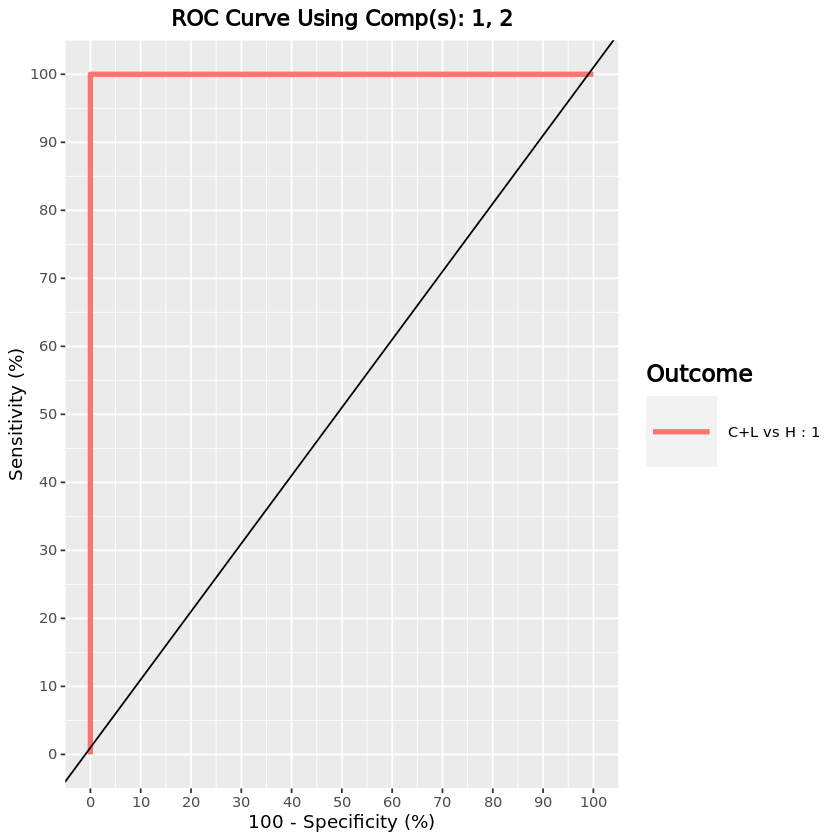

In [499]:
F0_2.uniref.genus.auc.splsda = auroc(final.splsda.uniref.genus.F0_2, roc.comp = 2, print = T)

#### UniRef genera - F1 generation

[1] "1171"           "genera removed" "225"            "remaining"

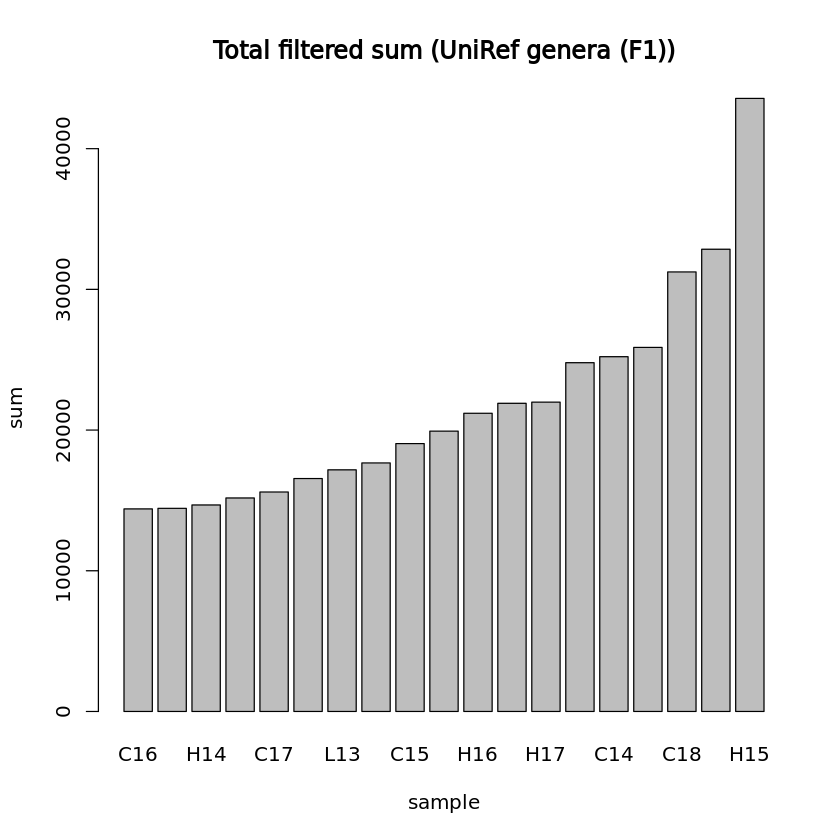

In [500]:
## PARAMS ##
# Initial components
uniref.genus.F1.ncomp <- 5
# Percentage of samples in which features must have >0 sum
uniref.genus.F1.percent_occ <- 10
# Quantile used for removing low abundance features
uniref.genus.F1.quantile_thresh <- 0.1
generation <- "F1"

uniref.genus.F1 <- list()
uniref.genus.F1$cov <- uniref.genus$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(uniref.genus.F1$cov[, colSums(uniref.genus.F1$cov) > 0])
uniref.genus.F1$nz <- uniref.genus.F1$cov[, colnames(uniref.genus.F1$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(uniref.genus.F1$nz) / sum(colSums(uniref.genus.F1$nz)) * 100, probs = uniref.genus.F1.quantile_thresh)
uniref.genus.F1$filtered <- low.count.removal(uniref.genus.F1$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
uniref.genus.F1$occ <- colSums(uniref.genus.F1$filtered>0) / nrow(uniref.genus.F1$filtered) * 100
# Keep features occurring in defined percentage of samples
uniref.genus.F1$filtered <- uniref.genus.F1$filtered[, which(uniref.genus.F1$occ >= uniref.genus.F1.percent_occ)]

#uniref.genus.F1$filtered <- uniref.genus.F1$filtered[,-nearZeroVar(uniref.genus.F1$filtered)$Position]
paste0(c(dim(uniref.genus.F1$cov)[2] - dim(uniref.genus.F1$filtered)[2], "genera removed", dim(uniref.genus.F1$filtered)[2], "remaining"))

# Add offset
uniref.genus.F1$offset <- uniref.genus.F1$filtered + 1
uniref.genus.F1$clr <- logratio.transfo(uniref.genus.F1$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.uniref.genus.F1 <- uniref.genus.F1$clr

uniref.genus.F1$treatment <- factor(info[rownames(uniref.genus.F1$clr), "Treatment"])

uniref.genus.F1.lib.size <- apply(uniref.genus.F1$filtered, 1, sum) # determine total count for each sample
barplot(sort(uniref.genus.F1.lib.size), main="Total filtered sum (UniRef genera (F1))", ylab="sum", xlab="sample")

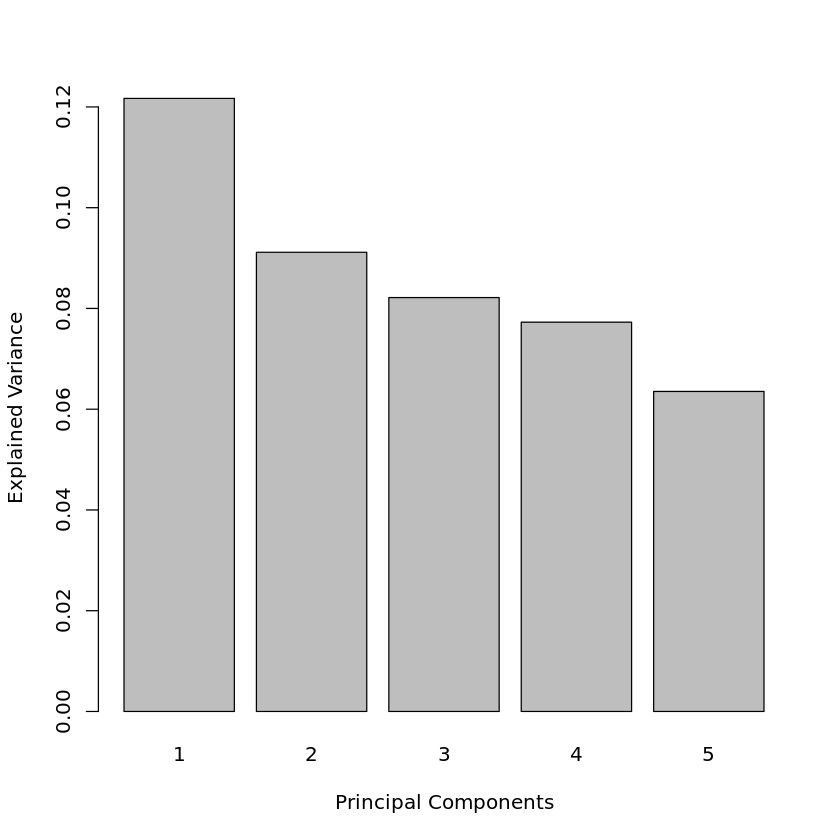

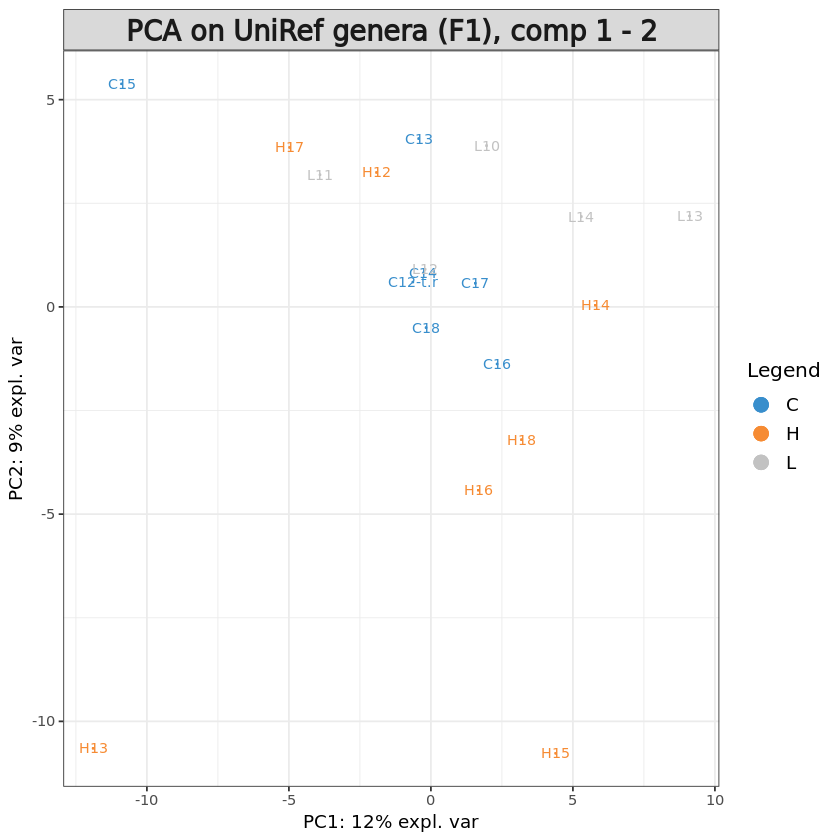

In [501]:
pca.uniref.genus.F1 = pca(X.uniref.genus.F1, ncomp = uniref.genus.F1.ncomp, center = TRUE, scale = TRUE) 

plot(pca.uniref.genus.F1)
plotIndiv(pca.uniref.genus.F1, group = uniref.genus.F1$treatment, ind.names = TRUE, # plot the samples projected
          legend = TRUE, title = 'PCA on UniRef genera (F1), comp 1 - 2')

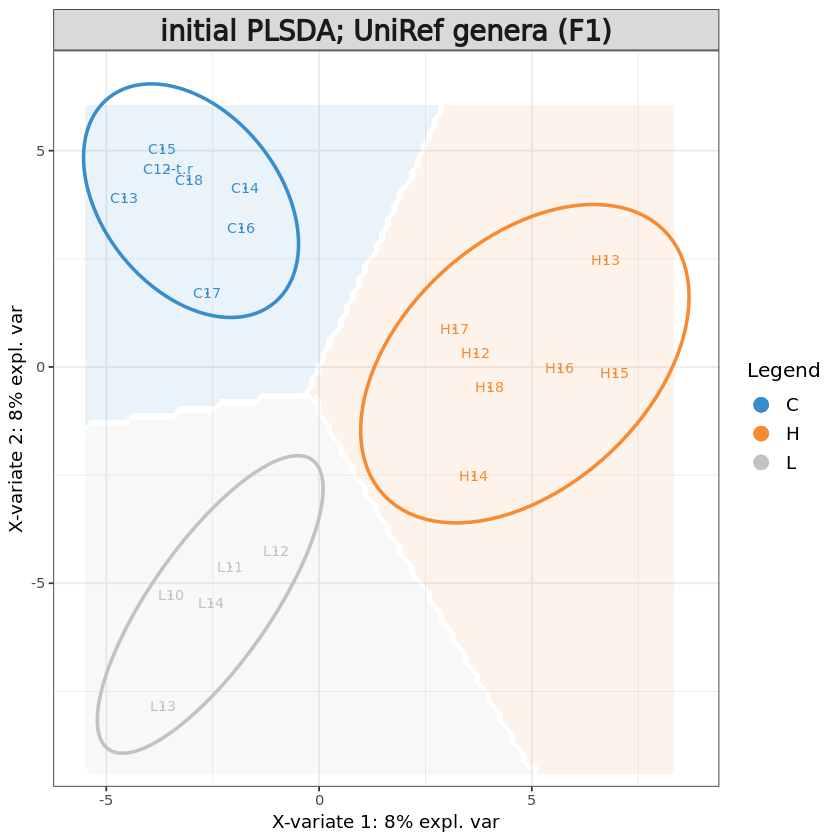

In [502]:
# Initial sPLS-DA model
uniref.genus.F1.splsda <- splsda(X.uniref.genus.F1, uniref.genus.F1$treatment, ncomp = uniref.genus.F1.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.genus.F1.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.genus.F1.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.genus.F1$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef genera (F1)")

Similar to the F0 generation, there is already a good separation in the initial model here. The overall pattern also looks the same with component 1 characterizing the High treatment group, and component 2 characterizing the Low.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,3,3,3
BER,3,3,3


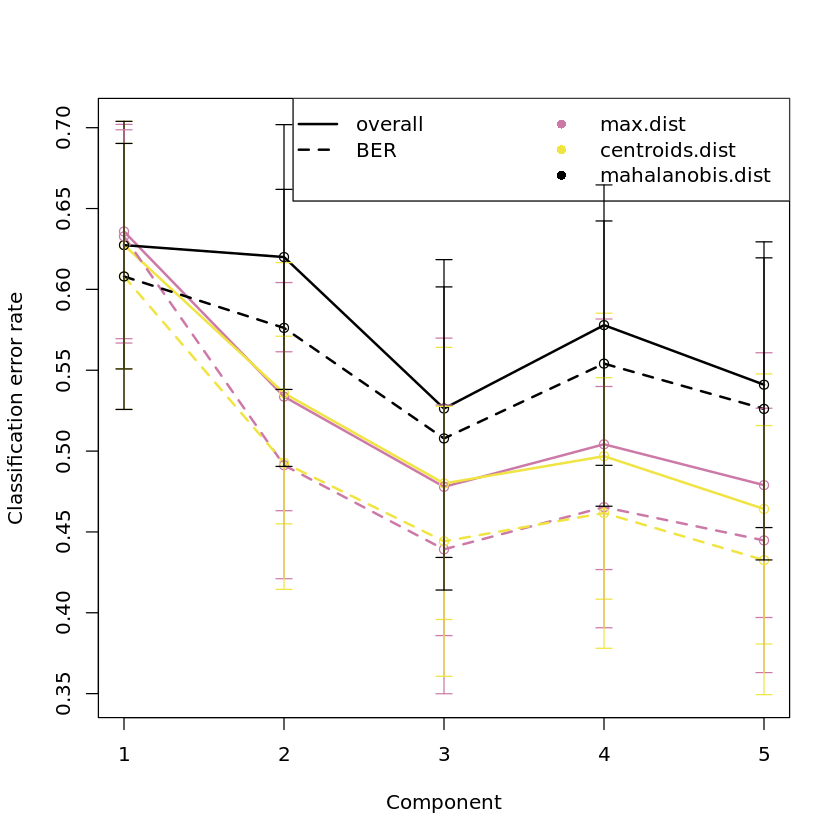

In [22]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.genus.F1 <- perf(uniref.genus.F1.splsda, validation = "Mfold", 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.genus.F1, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.genus.F1$choice.ncomp # what is the optimal value of components according to perf()

In [24]:
# Define parameters for tuning keepX
uniref.genus.F1.step <- 0.05
uniref.genus.F1.ncomp.tune <- 3
# grid of possible keepX values that will be tested for each component
uniref.genus.F1.keepx <- c(seq(ceiling(dim(uniref.genus.F1$filtered)[2] * uniref.genus.F1.step), 
                      round(dim(uniref.genus.F1$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.genus.F1$filtered)[2] * uniref.genus.F1.step)
                     )
                 )
uniref.genus.F1.keepx <- c(seq(10,100, 5), 150, 200)
uniref.genus.F1.keepx

[1]  10  15  20  25  30  35  40  45  50  55  60  65  70  75  80  85  90  95 100
[20] 150 200

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


[1] 3

comp1 comp2 comp3 
  150   150   150

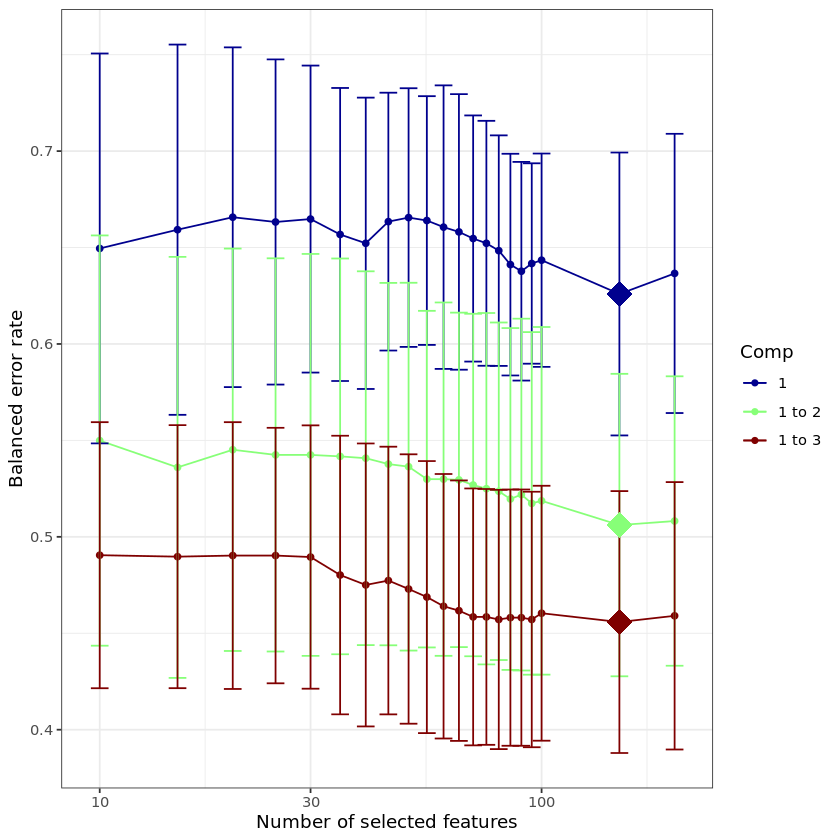

In [25]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.genus.F1 <- tune.splsda(X.uniref.genus.F1, uniref.genus.F1$treatment, ncomp = uniref.genus.F1.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.genus.F1.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.genus.F1, col = color.jet(uniref.genus.F1.ncomp.tune))

tune.splsda.uniref.genus.F1$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.genus.F1$choice.keepX # what are the optimal values of variables according to tune.splsda()

High error rate here as well. With 75 features per component we obtain separation by treatment in the model.

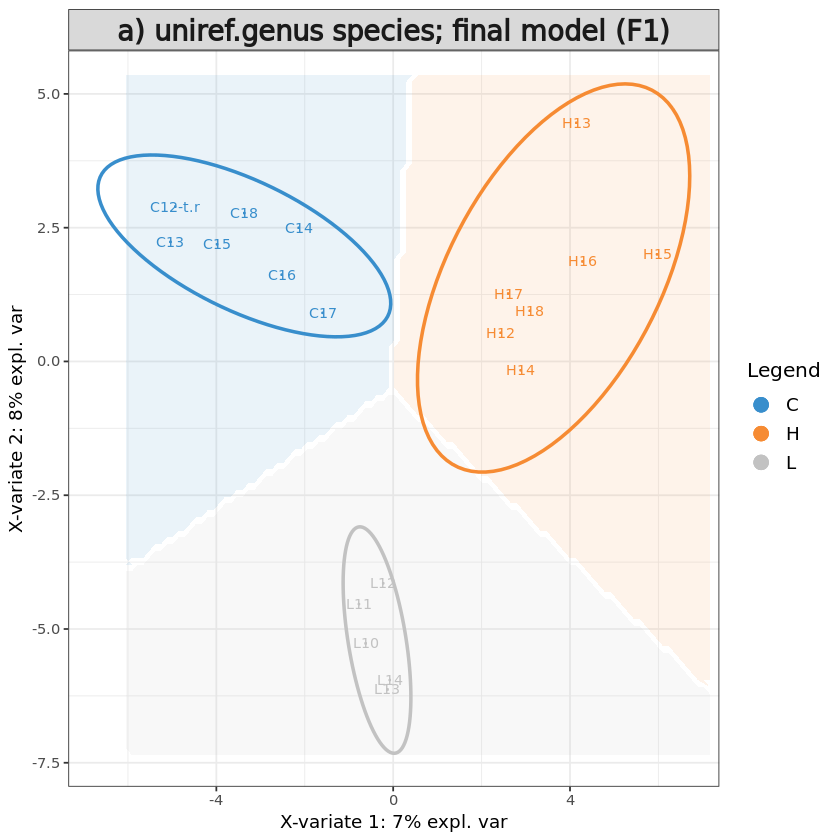

In [27]:
# Define final model
uniref.genus.F1$optimal.ncomp <- 2
uniref.genus.F1$optimal.keepX <- tune.splsda.uniref.genus.F1$choice.keepX[1:uniref.genus.F1$optimal.ncomp]
uniref.genus.F1$optimal.keepX <- rep(75, uniref.genus.F1$optimal.ncomp)
#uniref.genus.F1$optimal.keepX <- c(10, 10, 10)

# form final model with optimised values for component, using all features
final.splsda.uniref.genus.F1 <- splsda(X.uniref.genus.F1, uniref.genus.F1$treatment, 
                       ncomp = uniref.genus.F1$optimal.ncomp, 
                       keepX = uniref.genus.F1$optimal.keepX)

background = background.predict(final.splsda.uniref.genus.F1, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.genus.F1, comp = 1:2, 
          group = uniref.genus.F1$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) uniref.genus species; final model (F1)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.genus.F1$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F1.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

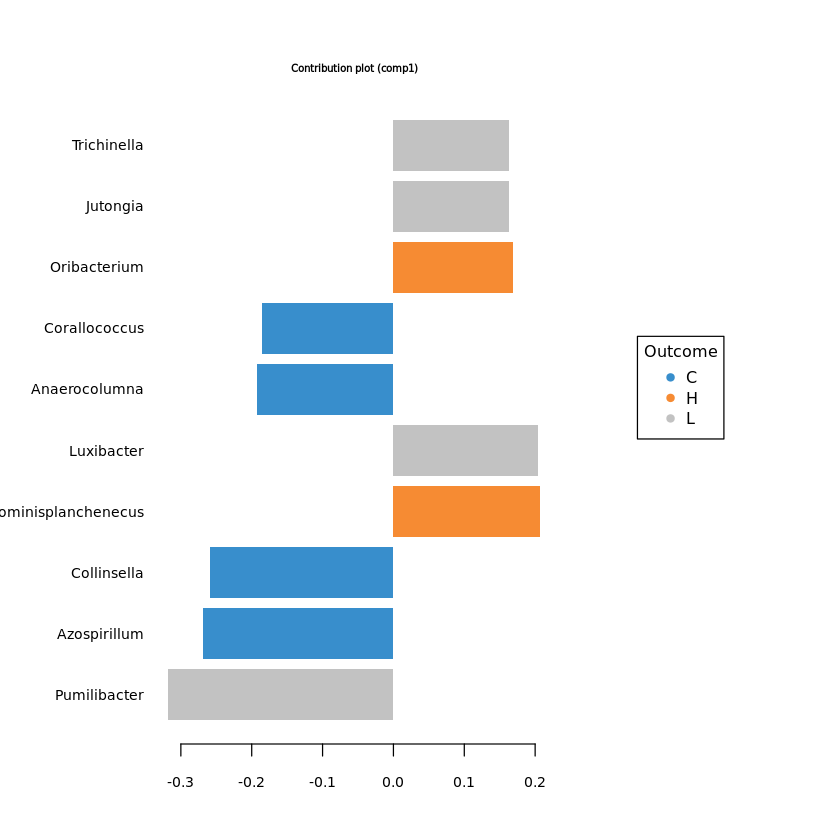

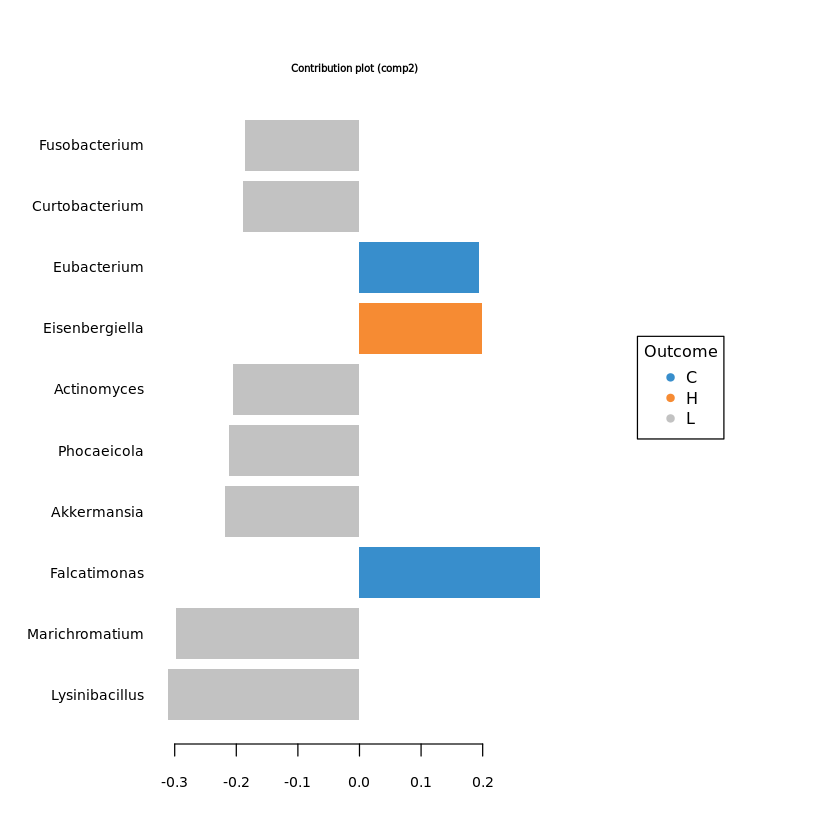

In [28]:
#plotVar(final.splsda.uniref.genus.F1, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.genus.F1, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.uniref.genus.F1, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.genus.F1, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.genus.F1, comp=2)$value
F1.uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F1.uniref.load) <- F1.uniref.load[,"Row.names"]
colnames(F1.uniref.load) <- c("ft","loading_comp1","loading_comp2")
F1.uniref.load = F1.uniref.load[,c("loading_comp1","loading_comp2")]

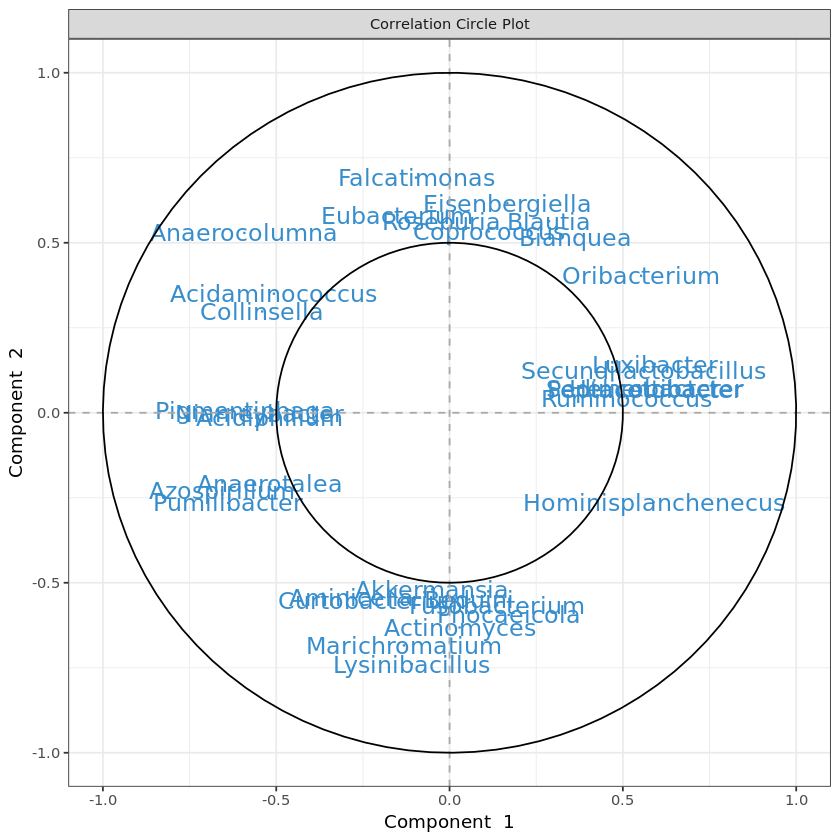

In [29]:
# plot feature correlation
plotVar(final.splsda.uniref.genus.F1, cutoff=0.5)
uniref.genus.F1.corr <- as.data.frame(plotVar(final.splsda.uniref.genus.F1, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.genus.F1.corr <- uniref.genus.F1.corr[, c("x","y")]
colnames(uniref.genus.F1.corr) <- c("corr_comp1","corr_comp2")

In [30]:
# Calculate feature stability
perf.splsda.uniref.genus.F1 <- perf(final.splsda.uniref.genus.F1, 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F1.uniref.stab <- merge(data.frame(perf.splsda.uniref.genus.F1$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.genus.F1$features$stable$comp2), by="Var1", all=T)
rownames(F1.uniref.stab) <- F1.uniref.stab$Var1
F1.uniref.stab <- F1.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F1.uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [31]:
# merge feature output
F1.uniref.out <- merge(F1.uniref.load, F1.uniref.stab, by="row.names")
rownames(F1.uniref.out) <- F1.uniref.out[,"Row.names"]
F1.uniref.out <- merge(F1.uniref.out[, 2:ncol(F1.uniref.out)], uniref.genus.F1.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F1.features.tsv", F1.uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [32]:
train <- sample(1:nrow(X.uniref.genus.F1), ceiling(nrow(X.uniref.genus.F1)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.genus.F1), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.genus.F1.train <- X.uniref.genus.F1[train, ]
X.uniref.genus.F1.test <- X.uniref.genus.F1[test,]
Y.uniref.genus.F1.train <- info[train,"treatment"]
Y.uniref.genus.F1.test <- info[test, "treatment"]
train.splsda.uniref.genus.F1 <- splsda(X.uniref.genus.F1.train, Y.uniref.genus.F1.train, ncomp = uniref.genus.F1$optimal.ncomp, keepX = uniref.genus.F1$optimal.keepX)
predict.splsda.uniref.genus.F1 <- predict(train.splsda.uniref.genus.F1, X.uniref.genus.F1.test, 
                                dist = "max.dist")
predict.comp2.uniref.genus.F1 <- predict.splsda.uniref.genus.F1$class$max.dist[,2]
table(factor(predict.comp2.uniref.genus.F1, levels = levels(uniref.genus.F1$treatment)), Y.uniref.genus.F1.test)

   Y.uniref.genus.F1.test
    C H L
  C 0 0 0
  H 0 0 0
  L 3 6 5

$Comp1
              AUC   p-value
C vs Other(s) 1.0 0.0003857
H vs Other(s) 1.0 0.0003857
L vs Other(s) 0.5 1.0000000

$Comp2
              AUC   p-value
C vs Other(s)   1 0.0003857
H vs Other(s)   1 0.0003857
L vs Other(s)   1 0.0011940



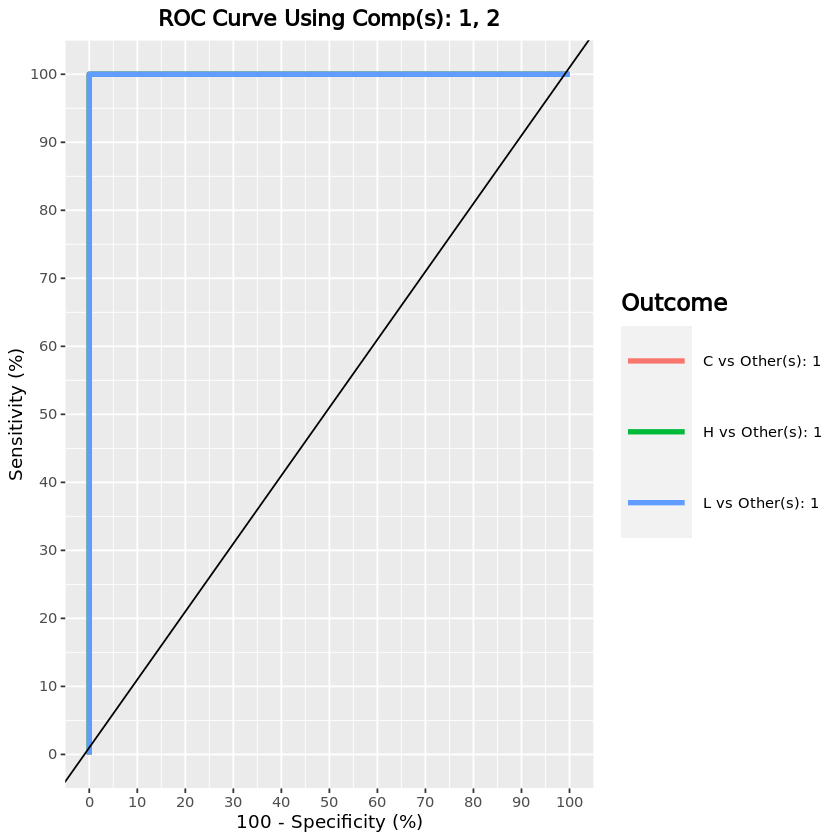

In [33]:
F1.uniref.auc.splsda = auroc(final.splsda.uniref.genus.F1, roc.comp = 2, print = T) # AUROC for the first component

#### UniRef genera - F1 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [34]:
uniref.genus.F1_2 <- list()
F1_info_2 <- info[rownames(uniref.genus.F1$cov),]
F1_info_2$treatment <- gsub(x = F1_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
uniref.genus.F1_2$cov <- uniref.genus.F1$cov[rownames(F1_info_2),]
uniref.genus.F1_2$filtered <- uniref.genus.F1$filtered[rownames(F1_info_2),]

uniref.genus.F1_2$clr <- uniref.genus.F1$clr[rownames(F1_info_2), ]
X.uniref.genus.F1_2 <- uniref.genus.F1_2$clr

uniref.genus.F1_2$treatment <- factor(F1_info_2[rownames(uniref.genus.F1_2$clr), "treatment"])

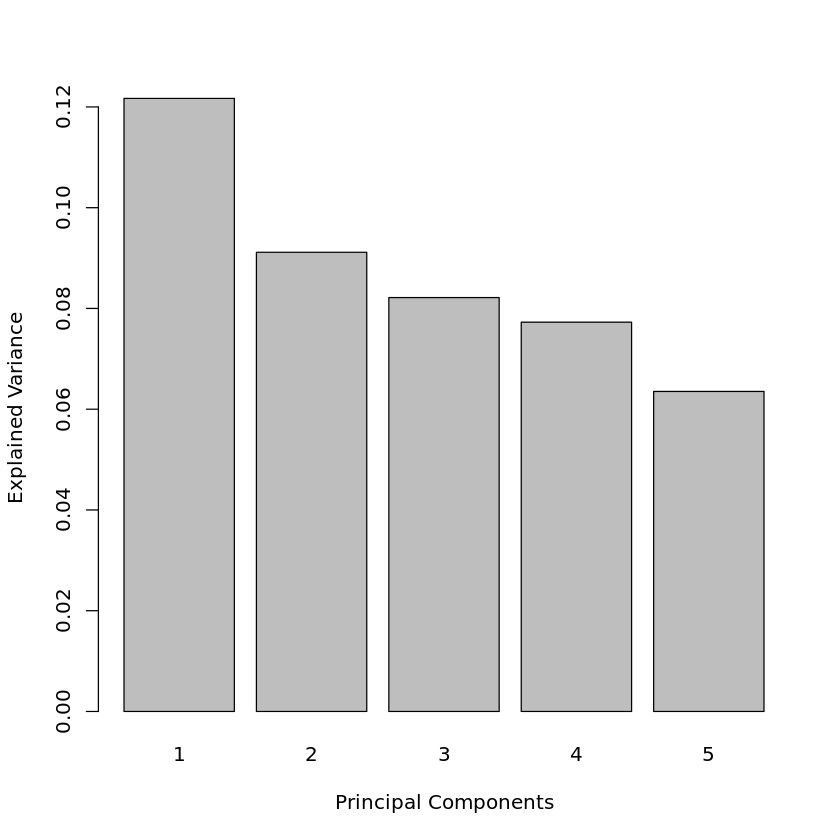

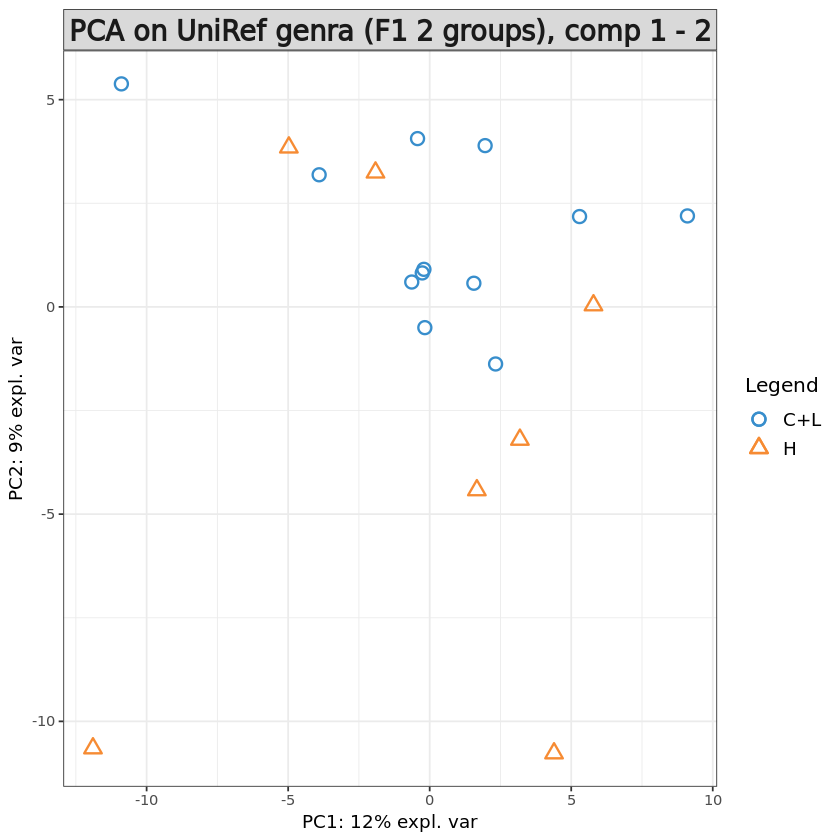

In [35]:
pca.uniref.genus.F1_2 = pca(X.uniref.genus.F1_2, ncomp = 5, center = TRUE, scale = TRUE) 

plot(pca.uniref.genus.F1_2)
plotIndiv(pca.uniref.genus.F1_2, group = uniref.genus.F1_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on UniRef genra (F1 2 groups), comp 1 - 2')

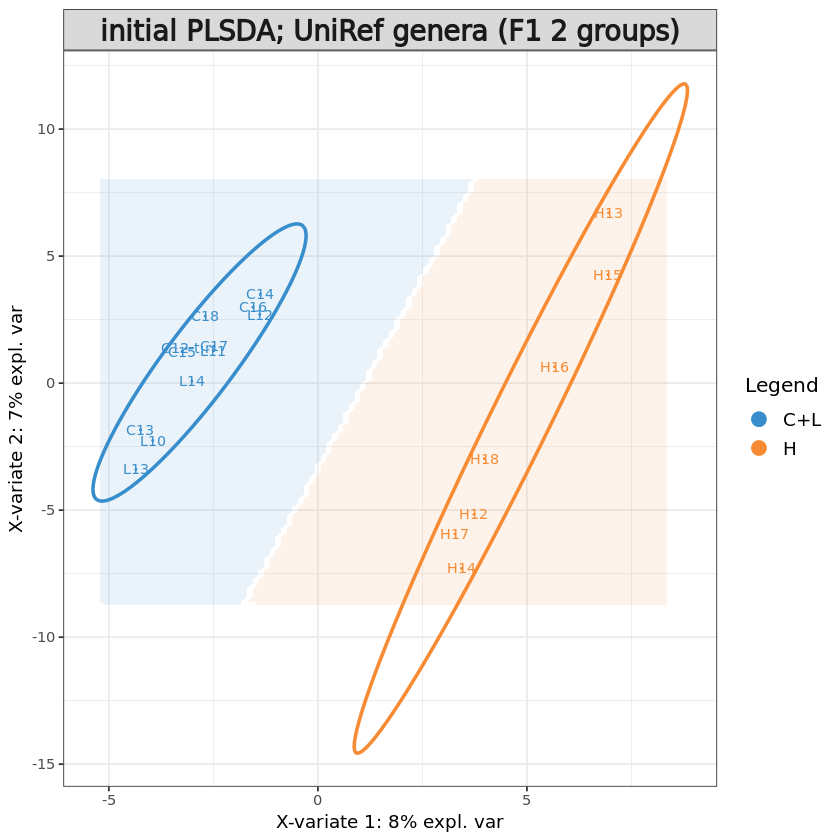

In [36]:
# Initial sPLS-DA model
uniref.genus.F1_2.splsda <- splsda(X.uniref.genus.F1_2, uniref.genus.F1_2$treatment, ncomp = 5)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.genus.F1_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.genus.F1_2.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.genus.F1_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef genera (F1 2 groups)")

The initial model separates the two treatment groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,3,3,3
BER,3,3,3


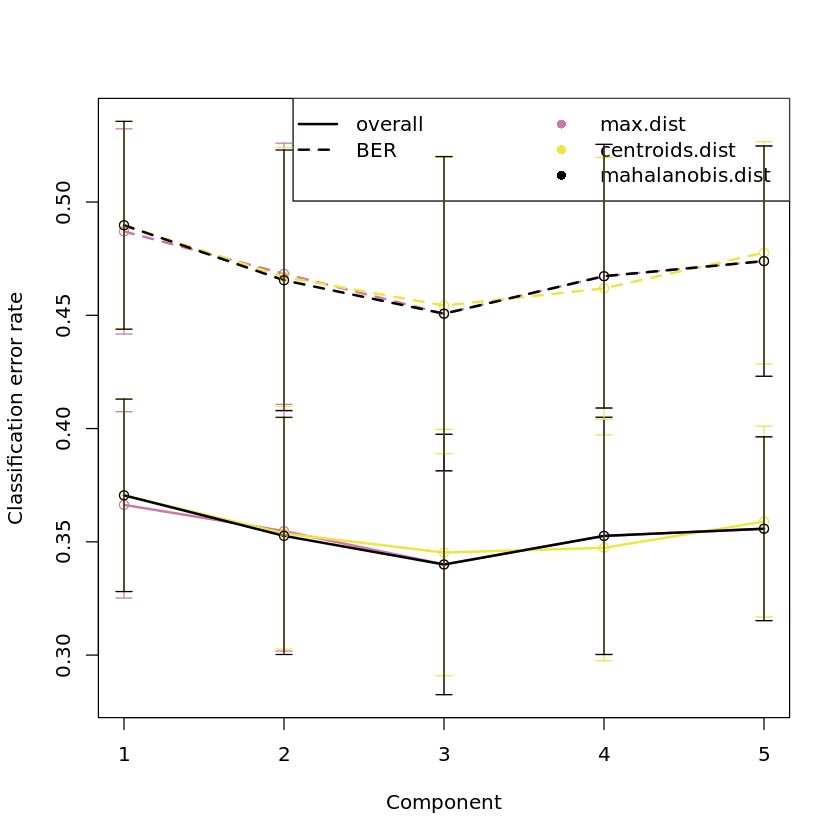

In [37]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.genus.F1_2 <- perf(uniref.genus.F1_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.genus.F1_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.genus.F1_2$choice.ncomp # what is the optimal value of components according to perf()

Even with only two treatment groups there is a very high error rate in the model.

In [38]:
# Define parameters for tuning keepX
uniref.genus.F1_2.step <- 0.05
uniref.genus.F1_2.ncomp.tune <- 3
# grid of possible keepX values that will be tested for each component
uniref.genus.F1_2.keepx <- c(seq(ceiling(dim(uniref.genus.F1_2$filtered)[2] * uniref.genus.F1_2.step), 
                      round(dim(uniref.genus.F1_2$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.genus.F1_2$filtered)[2] * uniref.genus.F1_2.step)
                     )
                 )

uniref.genus.F1_2.keepx <- c(seq(10,100,5), 150, 200)

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


[1] 1

comp1 comp2 comp3 
   10    95    10

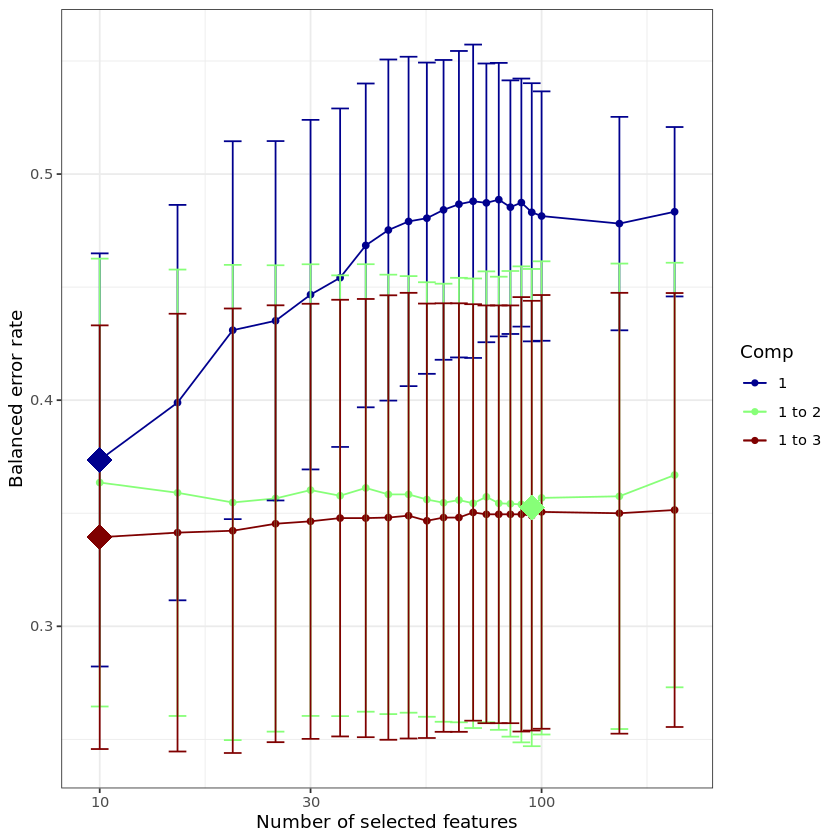

In [39]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.genus.F1_2 <- tune.splsda(X.uniref.genus.F1_2, uniref.genus.F1_2$treatment, ncomp = uniref.genus.F1_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.genus.F1_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.genus.F1_2, col = color.jet(uniref.genus.F1_2.ncomp.tune))

tune.splsda.uniref.genus.F1_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.genus.F1_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

The error rate is slightly lower when using only two treatment groups, however still rather high. Using 10 features per component gives a good separation of treatment groups.

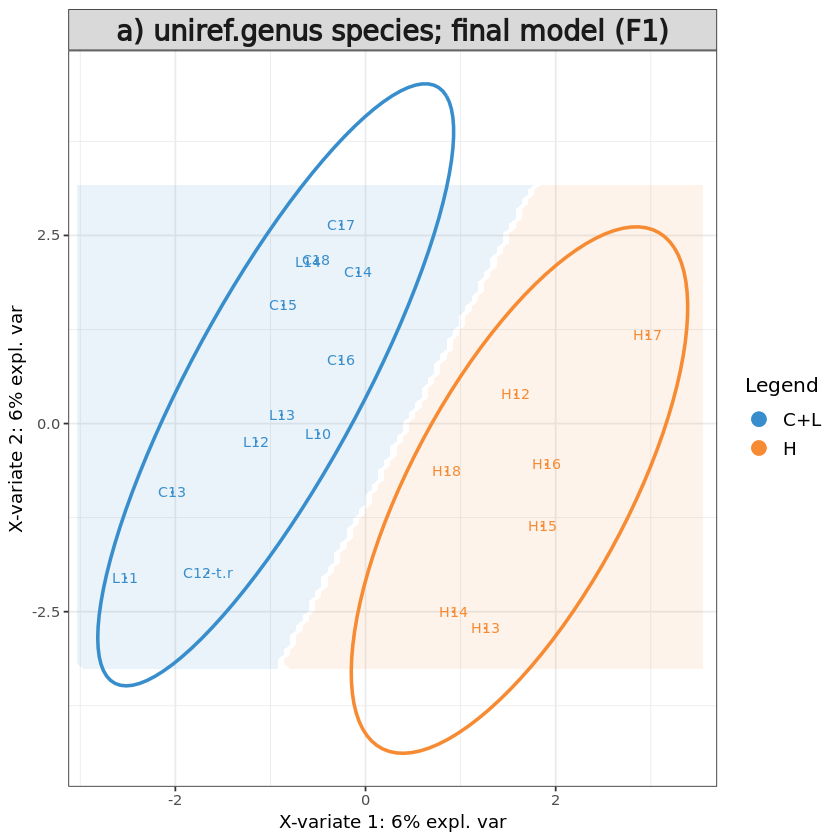

In [40]:
# Define final model
uniref.genus.F1_2$optimal.ncomp <- 2
uniref.genus.F1_2$optimal.keepX <- tune.splsda.uniref.genus.F1_2$choice.keepX[1:uniref.genus.F1_2$optimal.ncomp]
uniref.genus.F1_2$optimal.keepX <- rep(10, uniref.genus.F1_2$optimal.ncomp)
#uniref.genus.F1_2$optimal.keepX <- c(10, 10, 10)

# form final model with optimised values for component, using all features
final.splsda.uniref.genus.F1_2 <- splsda(X.uniref.genus.F1_2, uniref.genus.F1_2$treatment, 
                       ncomp = uniref.genus.F1_2$optimal.ncomp, 
                       keepX = uniref.genus.F1_2$optimal.keepX)

background = background.predict(final.splsda.uniref.genus.F1_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.genus.F1_2, comp = 1:2, 
          group = uniref.genus.F1_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) uniref.genus species; final model (F1)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.genus.F1_2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F1_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

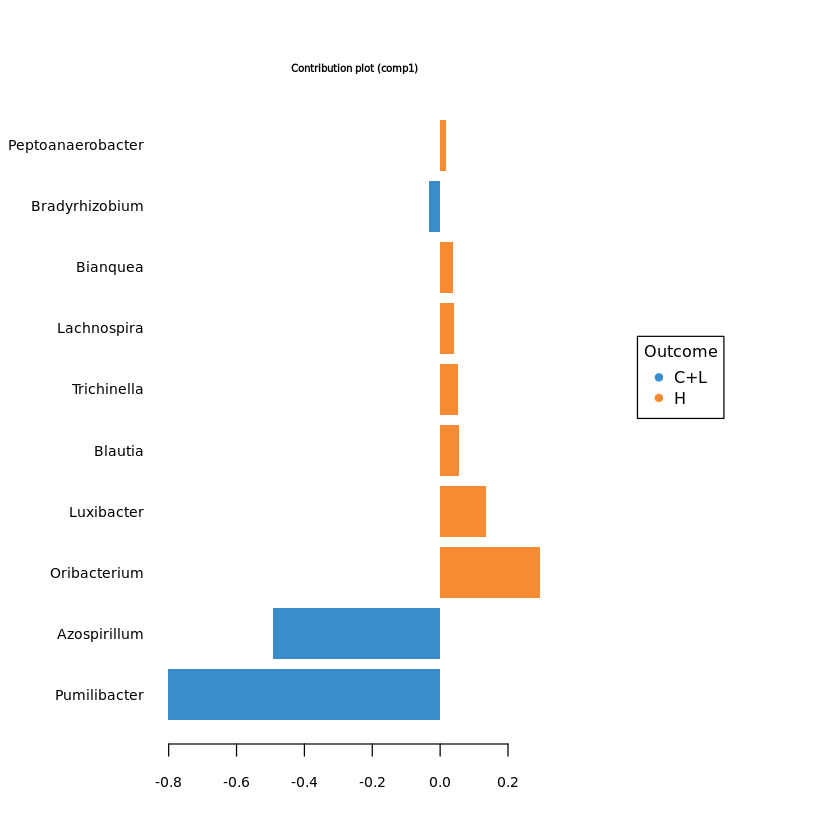

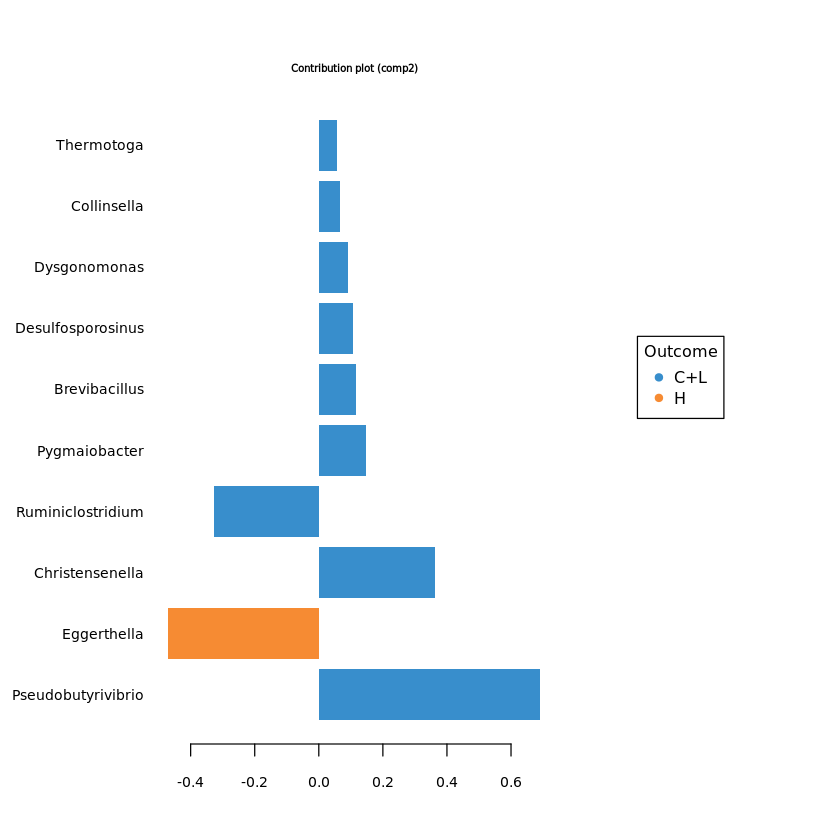

In [41]:
#plotVar(final.splsda.uniref.genus.F1_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.genus.F1_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.uniref.genus.F1_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.genus.F1_2, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.genus.F1_2, comp=2)$value
F1.uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F1.uniref.load) <- F1.uniref.load[,"Row.names"]
colnames(F1.uniref.load) <- c("ft","loading_comp1","loading_comp2")
F1.uniref.load = F1.uniref.load[,c("loading_comp1","loading_comp2")]

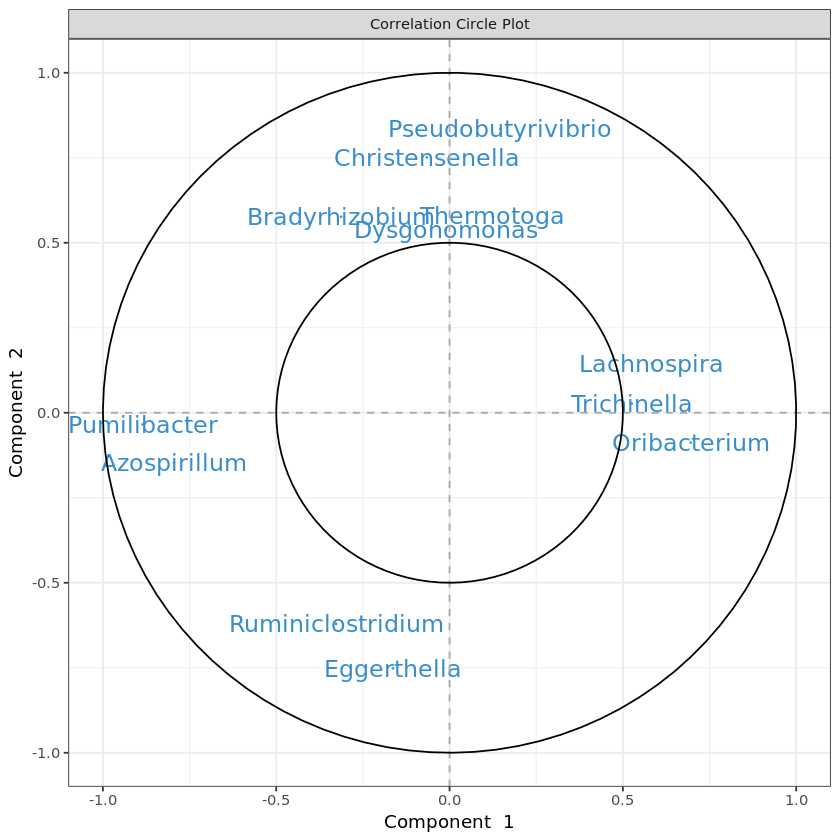

In [42]:
# plot feature correlation
plotVar(final.splsda.uniref.genus.F1_2, cutoff=0.5)
uniref.genus.F1_2.corr <- as.data.frame(plotVar(final.splsda.uniref.genus.F1_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.genus.F1_2.corr <- uniref.genus.F1_2.corr[, c("x","y")]
colnames(uniref.genus.F1_2.corr) <- c("corr_comp1","corr_comp2")

In [43]:
# Calculate feature stability
perf.splsda.uniref.genus.F1_2 <- perf(final.splsda.uniref.genus.F1_2, 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F1.uniref.stab <- merge(data.frame(perf.splsda.uniref.genus.F1_2$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.genus.F1_2$features$stable$comp2), by="Var1", all=T)
rownames(F1.uniref.stab) <- F1.uniref.stab$Var1
F1.uniref.stab <- F1.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F1.uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [44]:
# merge feature output
F1.uniref.out <- merge(F1.uniref.load, F1.uniref.stab, by="row.names")
rownames(F1.uniref.out) <- F1.uniref.out[,"Row.names"]
F1.uniref.out <- merge(F1.uniref.out[, 2:ncol(F1.uniref.out)], uniref.genus.F1_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F1_2.features.tsv", F1.uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [45]:
train <- sample(1:nrow(X.uniref.genus.F1_2), ceiling(nrow(X.uniref.genus.F1_2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.genus.F1_2), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.genus.F1_2.train <- X.uniref.genus.F1_2[train, ]
X.uniref.genus.F1_2.test <- X.uniref.genus.F1_2[test,]
Y.uniref.genus.F1_2.train <- info[train,"treatment"]
Y.uniref.genus.F1_2.test <- info[test, "treatment"]
train.splsda.uniref.genus.F1_2 <- splsda(X.uniref.genus.F1_2.train, Y.uniref.genus.F1_2.train, ncomp = uniref.genus.F1_2$optimal.ncomp, keepX = uniref.genus.F1_2$optimal.keepX)
predict.splsda.uniref.genus.F1_2 <- predict(train.splsda.uniref.genus.F1_2, X.uniref.genus.F1_2.test, 
                                dist = "max.dist")
predict.comp2.uniref.genus.F1_2 <- predict.splsda.uniref.genus.F1_2$class$max.dist[,2]
table(factor(predict.comp2.uniref.genus.F1_2, levels = levels(uniref.genus.F1_2$treatment)), Y.uniref.genus.F1_2.test)

     Y.uniref.genus.F1_2.test
      C H L
  C+L 0 0 0
  H   3 5 6

$Comp1
         AUC   p-value
C+L vs H   1 0.0003857

$Comp2
         AUC   p-value
C+L vs H   1 0.0003857



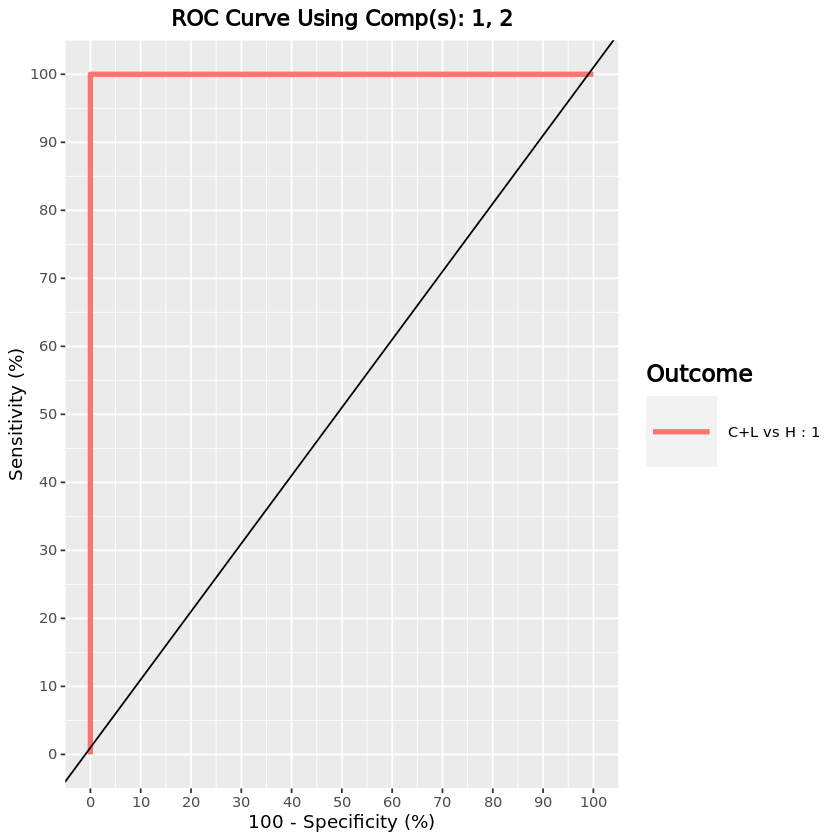

In [46]:
F1.uniref.auc.splsda = auroc(final.splsda.uniref.genus.F1_2, roc.comp = 2, print = T) # AUROC for the first component

#### UniRef genera - F2 generation

[1] "1185"           "genera removed" "211"            "remaining"

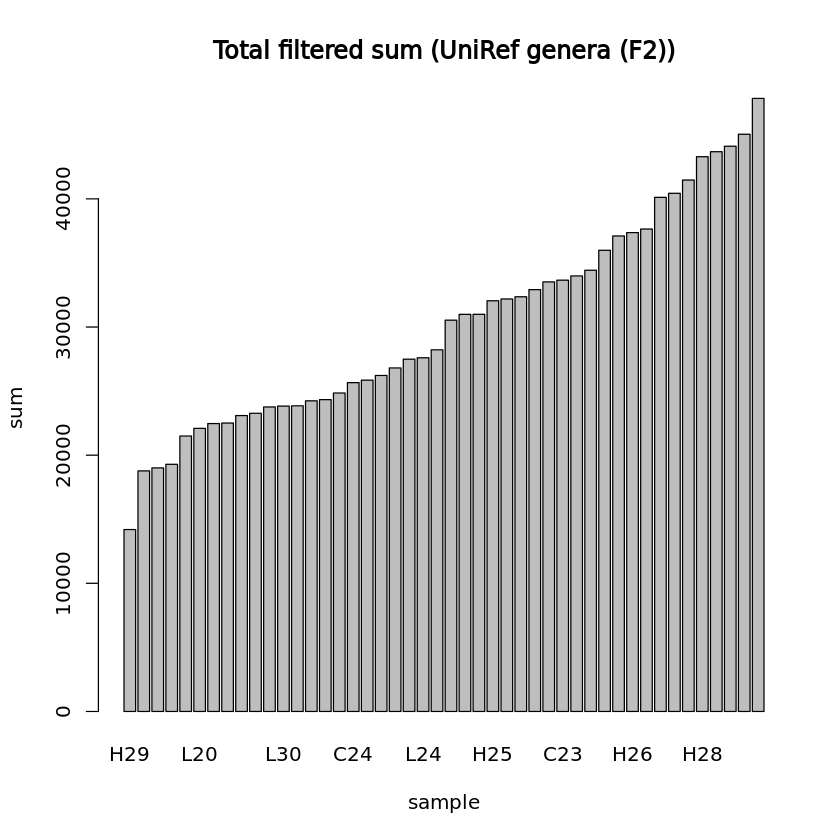

In [47]:
## PARAMS ##
# Initial components
uniref.genus.F2.ncomp <- 10
# Percentage of samples in which features must have >0 sum
uniref.genus.F2.percent_occ <- 10
# Quantile used for removing low abundance features
uniref.genus.F2.quantile_thresh <- 0.1
generation <- "F2"

uniref.genus.F2 <- list()
uniref.genus.F2$cov <- uniref.genus$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(uniref.genus.F2$cov[, colSums(uniref.genus.F2$cov) > 0])
uniref.genus.F2$nz <- uniref.genus.F2$cov[, colnames(uniref.genus.F2$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(uniref.genus.F2$nz) / sum(colSums(uniref.genus.F2$nz)) * 100, probs = uniref.genus.F2.quantile_thresh)
uniref.genus.F2$filtered <- low.count.removal(uniref.genus.F2$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
uniref.genus.F2$occ <- colSums(uniref.genus.F2$filtered>0) / nrow(uniref.genus.F2$filtered) * 100
# Keep features occurring in defined percentage of samples
uniref.genus.F2$filtered <- uniref.genus.F2$filtered[, which(uniref.genus.F2$occ >= uniref.genus.F2.percent_occ)]

#uniref.genus.F2$filtered <- uniref.genus.F2$filtered[,-nearZeroVar(uniref.genus.F2$filtered)$Position]
paste0(c(dim(uniref.genus.F2$cov)[2] - dim(uniref.genus.F2$filtered)[2], "genera removed", dim(uniref.genus.F2$filtered)[2], "remaining"))

# Add offset
uniref.genus.F2$offset <- uniref.genus.F2$filtered + 1
uniref.genus.F2$clr <- logratio.transfo(uniref.genus.F2$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.uniref.genus.F2 <- uniref.genus.F2$clr

uniref.genus.F2$treatment <- factor(info[rownames(uniref.genus.F2$clr), "Treatment"])

uniref.genus.F2.lib.size <- apply(uniref.genus.F2$filtered, 1, sum) # determine total count for each sample
barplot(sort(uniref.genus.F2.lib.size), main="Total filtered sum (UniRef genera (F2))", ylab="sum", xlab="sample")

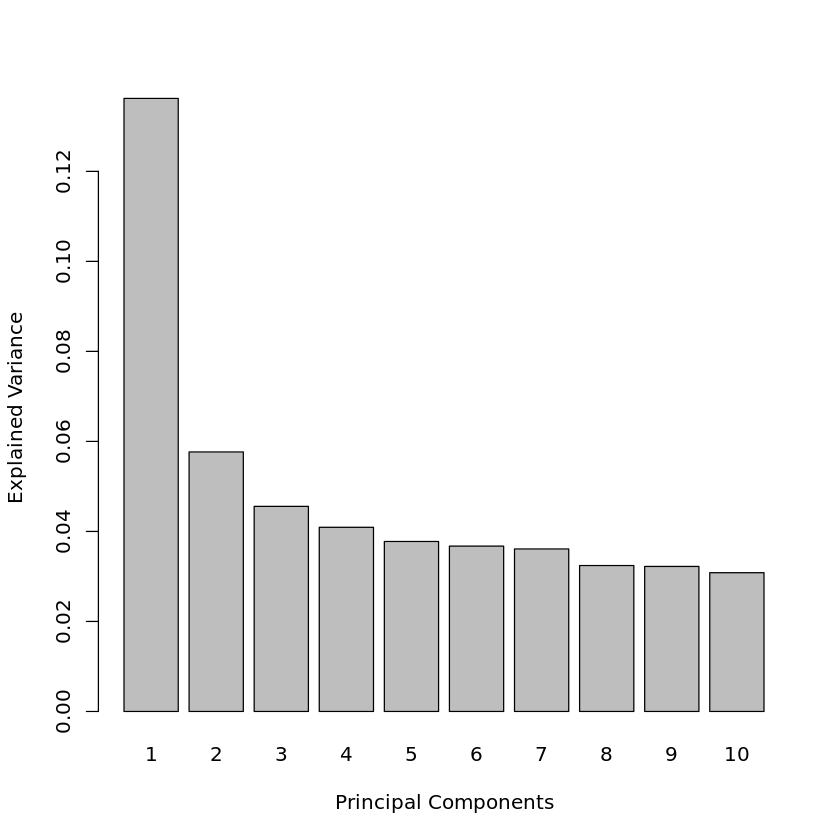

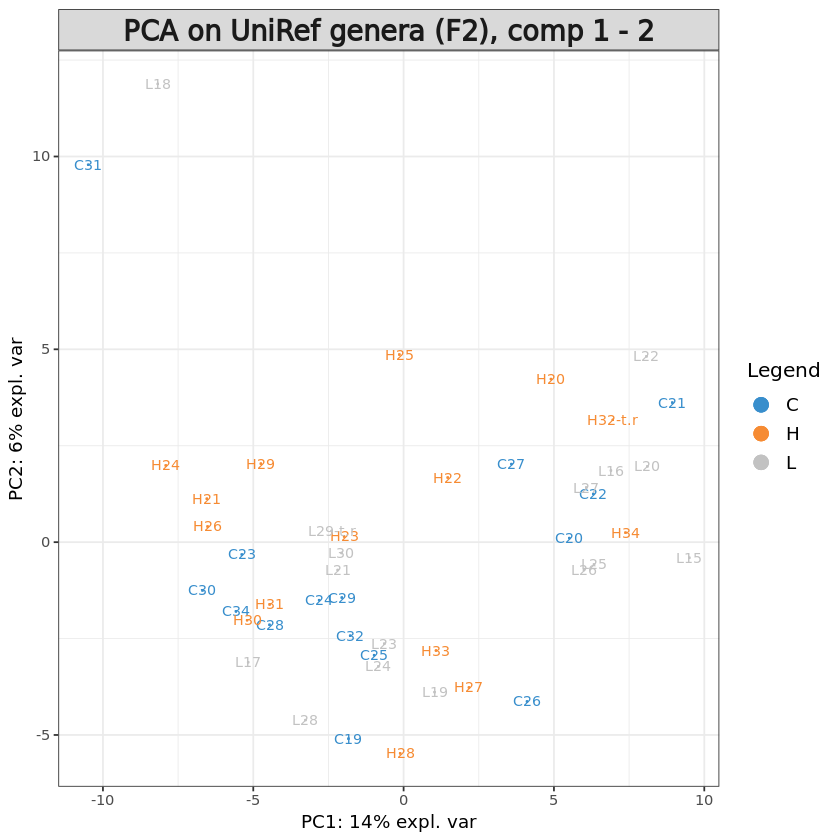

In [48]:
pca.uniref.genus.F2 = pca(X.uniref.genus.F2, ncomp = uniref.genus.F2.ncomp, center = TRUE, scale = TRUE) 

plot(pca.uniref.genus.F2)
plotIndiv(pca.uniref.genus.F2, group = uniref.genus.F2$treatment, ind.names = TRUE, # plot the samples projected
          legend = TRUE, title = 'PCA on UniRef genera (F2), comp 1 - 2')

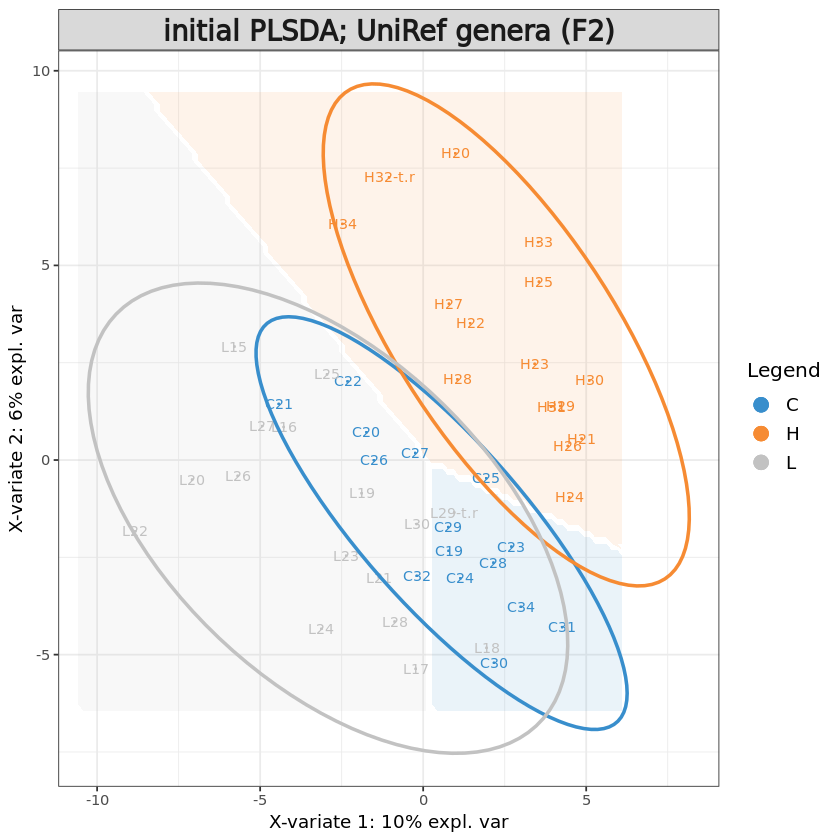

In [49]:
# Initial sPLS-DA model
uniref.genus.F2.splsda <- splsda(X.uniref.genus.F2, uniref.genus.F2$treatment, ncomp = uniref.genus.F2.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.genus.F2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.genus.F2.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.genus.F2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef genera (F2)")

In this case the separation in the initial model is not as good.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,3,1,1
BER,3,1,1


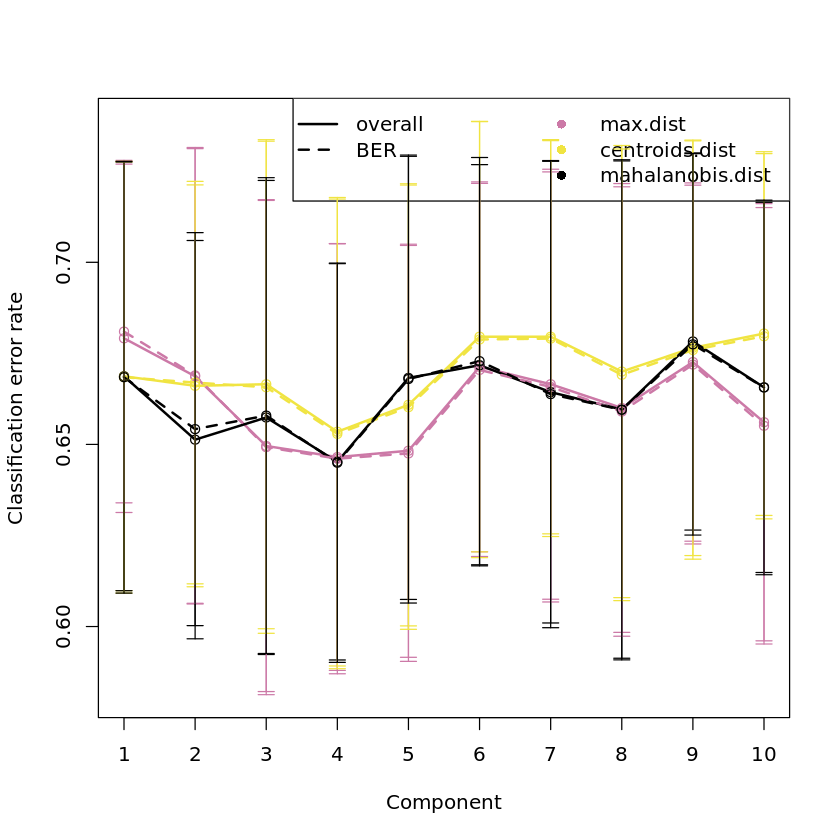

In [22]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.genus.F2 <- perf(uniref.genus.F2.splsda, validation = "Mfold", 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.genus.F2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.genus.F2$choice.ncomp # what is the optimal value of components according to perf()

In [23]:
# Define parameters for tuning keepX
uniref.genus.F2.step <- 0.05
uniref.genus.F2.ncomp.tune <- 3
# grid of possible keepX values that will be tested for each component
uniref.genus.F2.keepx <- c(seq(ceiling(dim(uniref.genus.F2$filtered)[2] * uniref.genus.F2.step), 
                      round(dim(uniref.genus.F2$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.genus.F2$filtered)[2] * uniref.genus.F2.step)
                     )
                 )
uniref.genus.F2.keepx <- c(seq(10,100, 5), 150, 200)
uniref.genus.F2.keepx

[1]  10  15  20  25  30  35  40  45  50  55  60  65  70  75  80  85  90  95 100
[20] 150 200

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


[1] 1

comp1 comp2 comp3 
   20   150   100

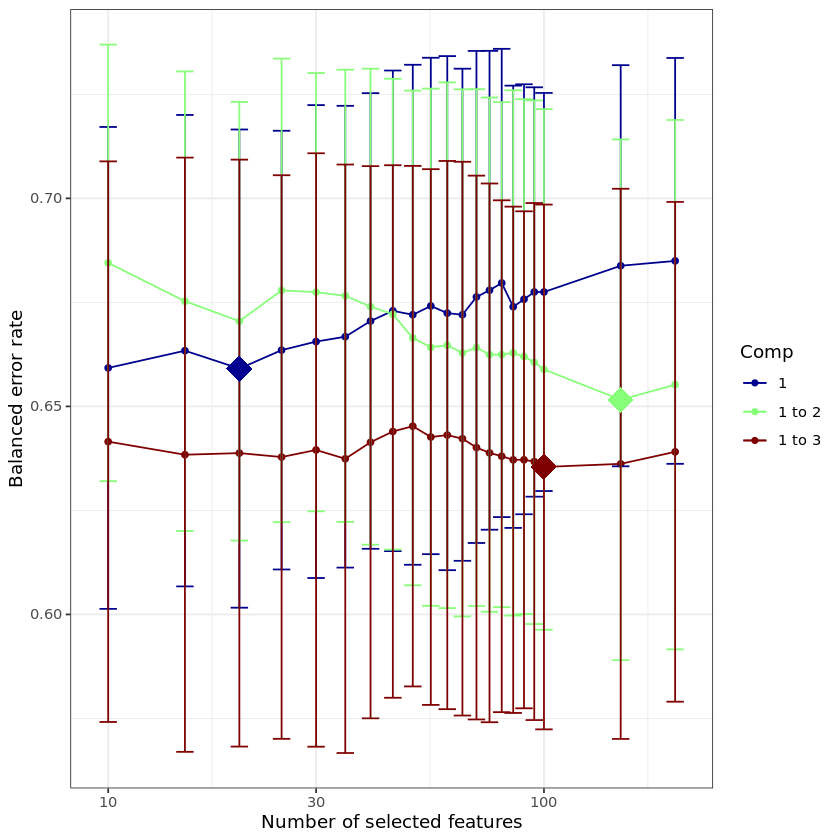

In [24]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.genus.F2 <- tune.splsda(X.uniref.genus.F2, uniref.genus.F2$treatment, ncomp = uniref.genus.F2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.genus.F2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.genus.F2, col = color.jet(uniref.genus.F2.ncomp.tune))

tune.splsda.uniref.genus.F2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.genus.F2$choice.keepX # what are the optimal values of variables according to tune.splsda()

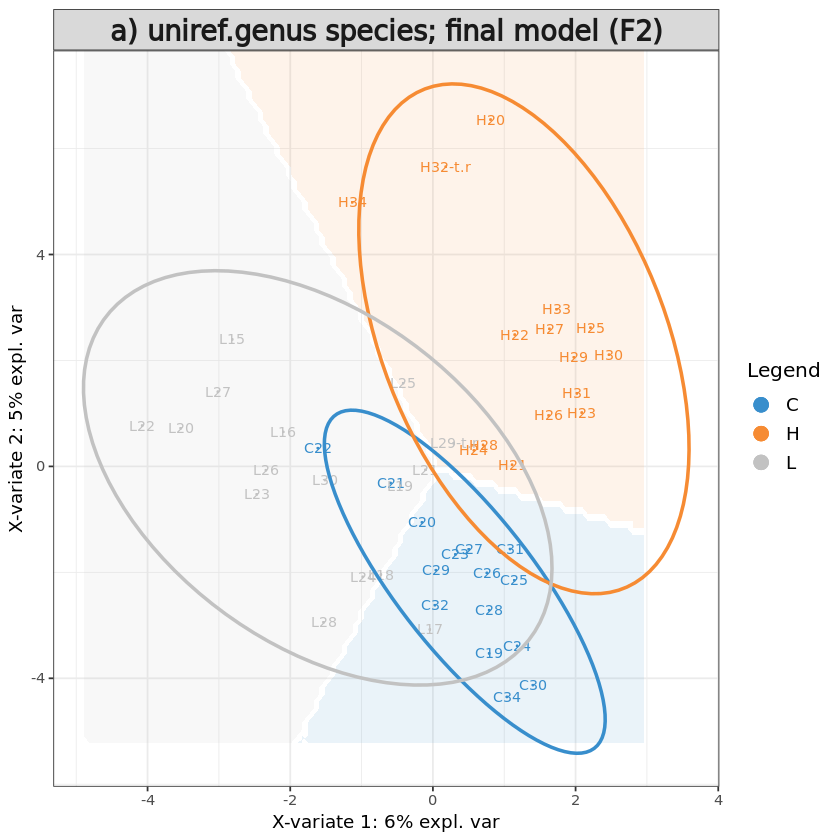

In [27]:
# Define final model
uniref.genus.F2$optimal.ncomp <- 2
#uniref.genus.F2$optimal.keepX <- tune.splsda.uniref.genus.F2$choice.keepX[1:uniref.genus.F2$optimal.ncomp]
#uniref.genus.F2$optimal.keepX <- rep(50, uniref.genus.F2$optimal.ncomp)
uniref.genus.F2$optimal.keepX <- c(20, 100)

# form final model with optimised values for component, using all features
final.splsda.uniref.genus.F2 <- splsda(X.uniref.genus.F2, uniref.genus.F2$treatment, 
                       ncomp = uniref.genus.F2$optimal.ncomp, 
                       keepX = uniref.genus.F2$optimal.keepX)

background = background.predict(final.splsda.uniref.genus.F2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.genus.F2, comp = 1:2, 
          group = uniref.genus.F2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) uniref.genus species; final model (F2)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.genus.F2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

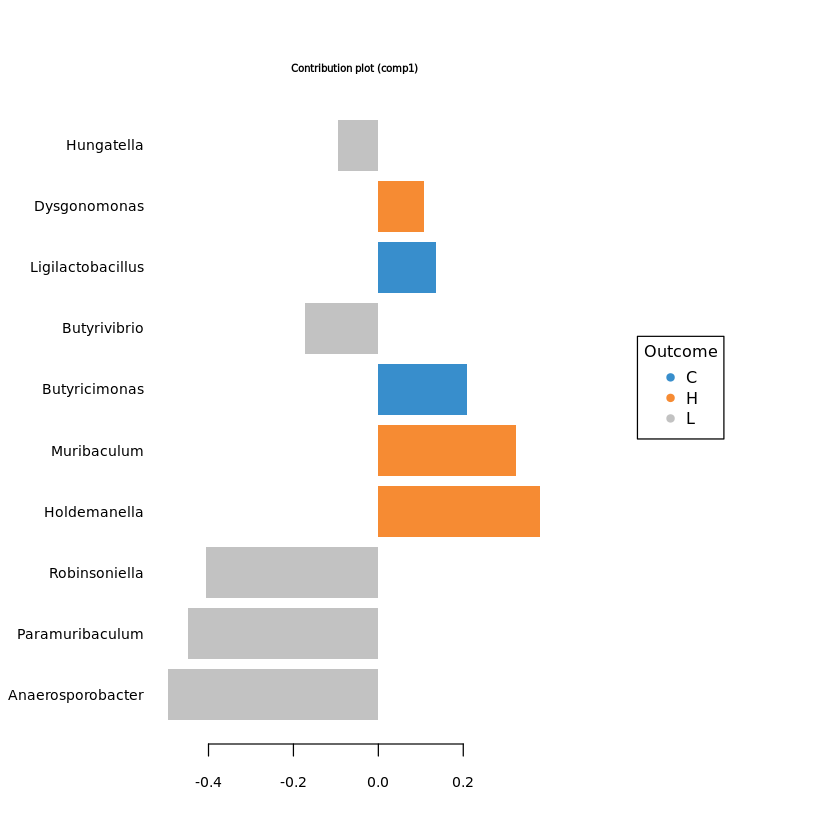

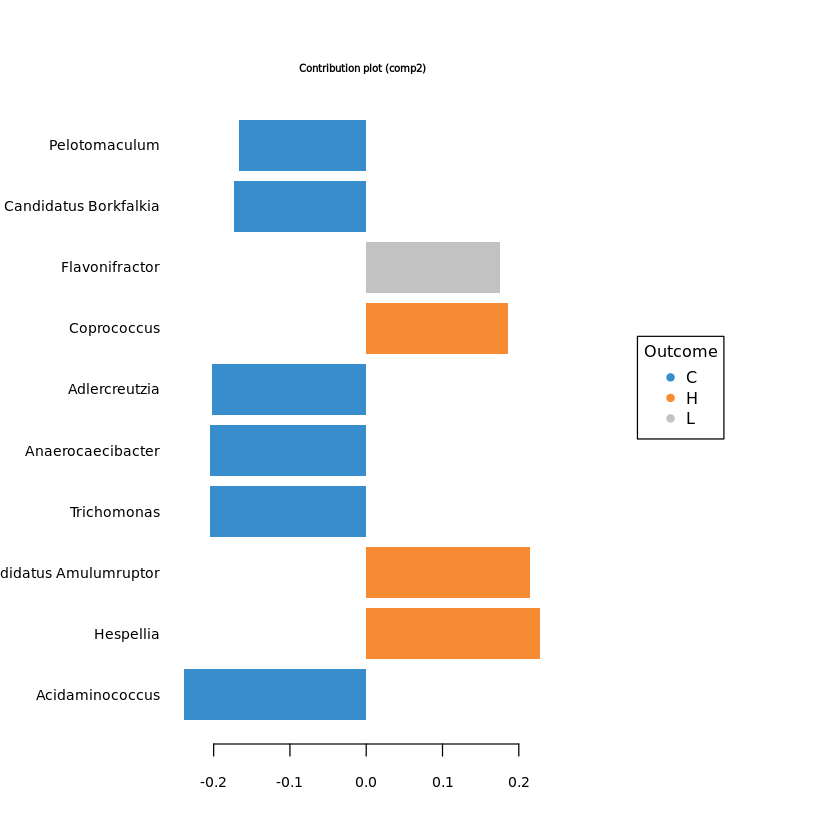

In [28]:
#plotVar(final.splsda.uniref.genus.F2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.genus.F2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.uniref.genus.F2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.genus.F2, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.genus.F2, comp=2)$value
F2.uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F2.uniref.load) <- F2.uniref.load[,"Row.names"]
colnames(F2.uniref.load) <- c("ft","loading_comp1","loading_comp2")
F2.uniref.load = F2.uniref.load[,c("loading_comp1","loading_comp2")]

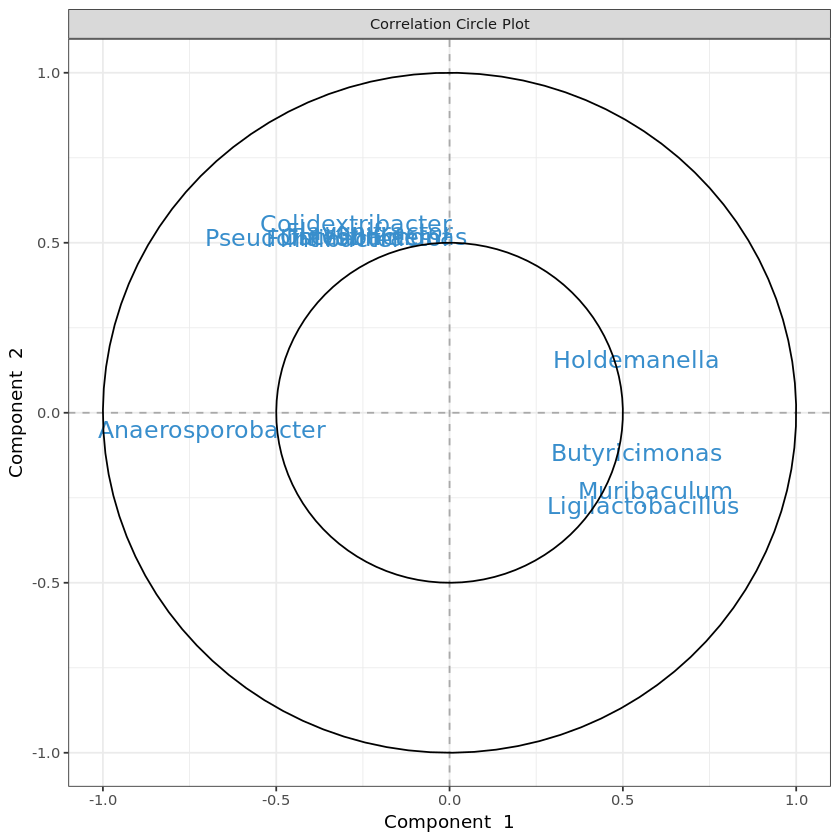

In [29]:
# plot feature correlation
plotVar(final.splsda.uniref.genus.F2, cutoff=0.5)
uniref.genus.F2.corr <- as.data.frame(plotVar(final.splsda.uniref.genus.F2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.genus.F2.corr <- uniref.genus.F2.corr[, c("x","y")]
colnames(uniref.genus.F2.corr) <- c("corr_comp1","corr_comp2")

In [30]:
# Calculate feature stability
perf.splsda.uniref.genus.F2 <- perf(final.splsda.uniref.genus.F2, 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F2.uniref.stab <- merge(data.frame(perf.splsda.uniref.genus.F2$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.genus.F2$features$stable$comp2), by="Var1", all=T)
rownames(F2.uniref.stab) <- F2.uniref.stab$Var1
F2.uniref.stab <- F2.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F2.uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [31]:
# merge feature output
F2.uniref.out <- merge(F2.uniref.load, F2.uniref.stab, by="row.names")
rownames(F2.uniref.out) <- F2.uniref.out[,"Row.names"]
F2.uniref.out <- merge(F2.uniref.out[, 2:ncol(F2.uniref.out)], uniref.genus.F2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F2.features.tsv", F2.uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [32]:
train <- sample(1:nrow(X.uniref.genus.F2), ceiling(nrow(X.uniref.genus.F2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.genus.F2), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.genus.F2.train <- X.uniref.genus.F2[train, ]
X.uniref.genus.F2.test <- X.uniref.genus.F2[test,]
Y.uniref.genus.F2.train <- info[train,"treatment"]
Y.uniref.genus.F2.test <- info[test, "treatment"]
train.splsda.uniref.genus.F2 <- splsda(X.uniref.genus.F2.train, Y.uniref.genus.F2.train, ncomp = uniref.genus.F2$optimal.ncomp, keepX = uniref.genus.F2$optimal.keepX)
predict.splsda.uniref.genus.F2 <- predict(train.splsda.uniref.genus.F2, X.uniref.genus.F2.test, 
                                dist = "max.dist")
predict.comp2.uniref.genus.F2 <- predict.splsda.uniref.genus.F2$class$max.dist[,2]
table(factor(predict.comp2.uniref.genus.F2, levels = levels(uniref.genus.F2$treatment)), Y.uniref.genus.F2.test)

   Y.uniref.genus.F2.test
    C H L
  C 6 2 5
  H 2 2 1
  L 6 7 3

$Comp1
                 AUC   p-value
C vs Other(s) 0.5828 3.670e-01
H vs Other(s) 0.8753 4.333e-05
L vs Other(s) 0.9438 8.993e-07

$Comp2
                 AUC   p-value
C vs Other(s) 0.9161 5.783e-06
H vs Other(s) 0.9978 5.809e-08
L vs Other(s) 0.9500 6.304e-07



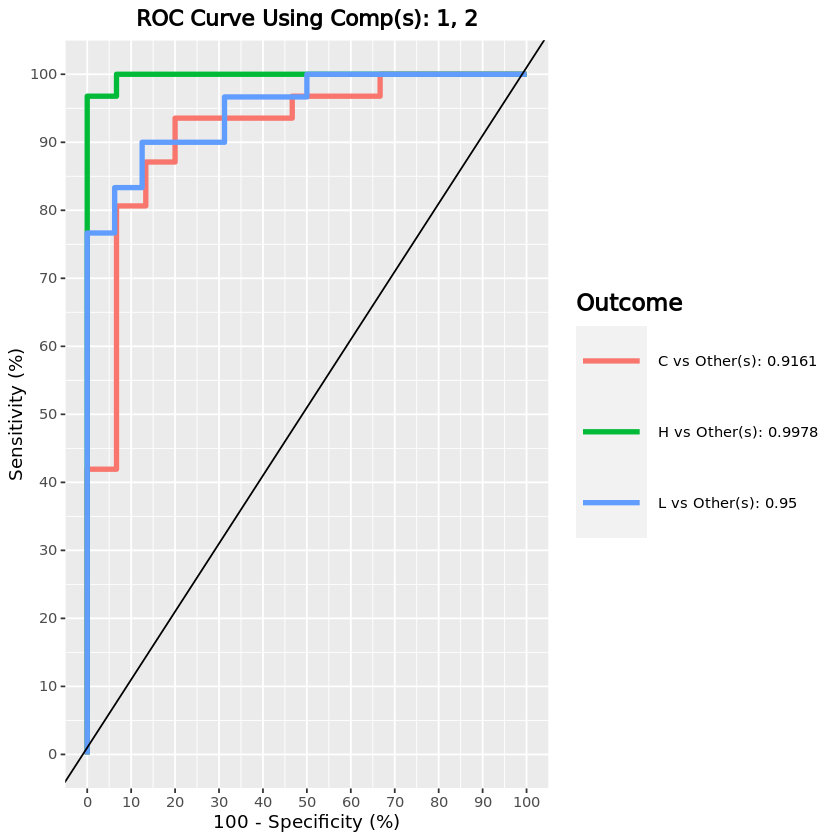

In [33]:
F2.uniref.auc.splsda = auroc(final.splsda.uniref.genus.F2, roc.comp = 2, print = T) # AUROC for the first component

#### UniRef genera - F2 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [34]:
uniref.genus.F2_2 <- list()
F2_info_2 <- info[rownames(uniref.genus.F2$cov),]
F2_info_2$treatment <- gsub(x = F2_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
uniref.genus.F2_2$cov <- uniref.genus.F2$cov[rownames(F2_info_2),]
uniref.genus.F2_2$filtered <- uniref.genus.F2$filtered[rownames(F2_info_2),]

uniref.genus.F2_2$clr <- uniref.genus.F2$clr[rownames(F2_info_2), ]
X.uniref.genus.F2_2 <- uniref.genus.F2_2$clr

uniref.genus.F2_2$treatment <- factor(F2_info_2[rownames(uniref.genus.F2_2$clr), "treatment"])

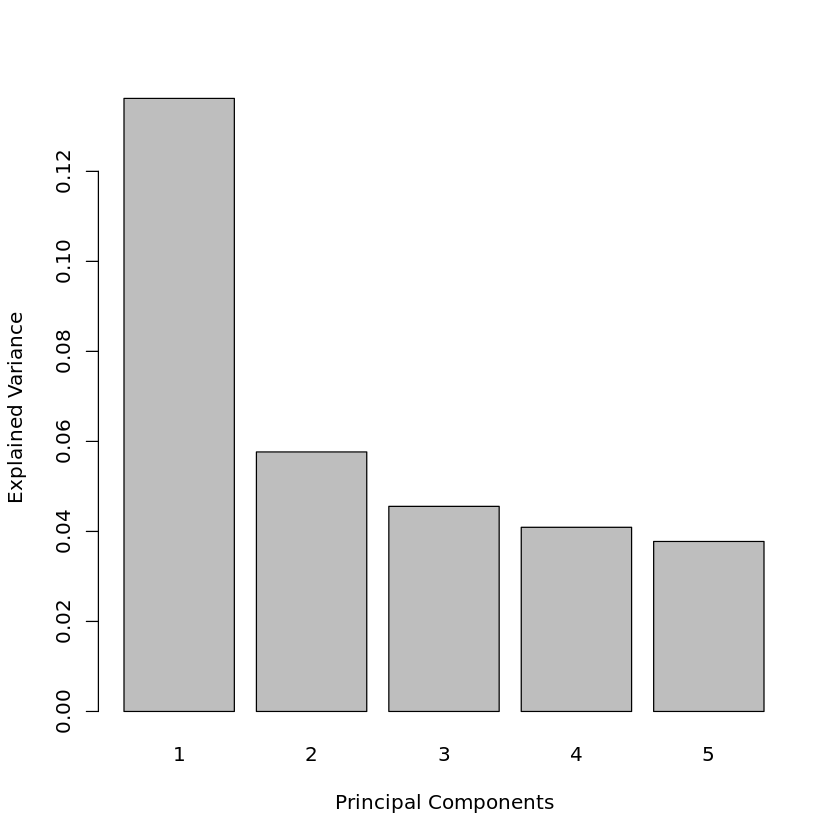

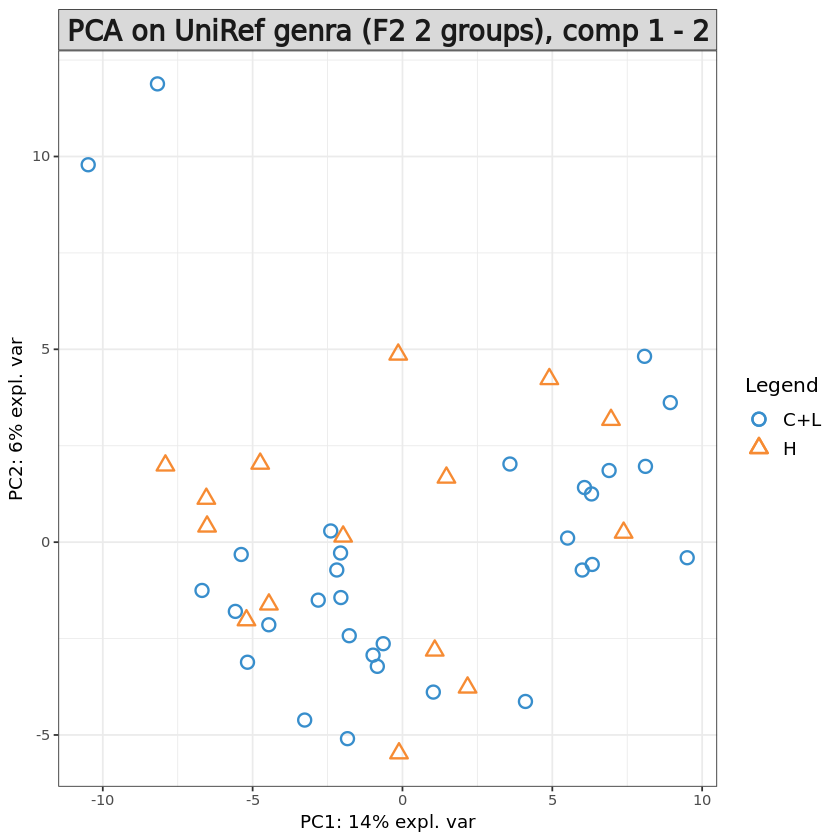

In [35]:
pca.uniref.genus.F2_2 = pca(X.uniref.genus.F2_2, ncomp = 5, center = TRUE, scale = TRUE) 

plot(pca.uniref.genus.F2_2)
plotIndiv(pca.uniref.genus.F2_2, group = uniref.genus.F2_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on UniRef genra (F2 2 groups), comp 1 - 2')

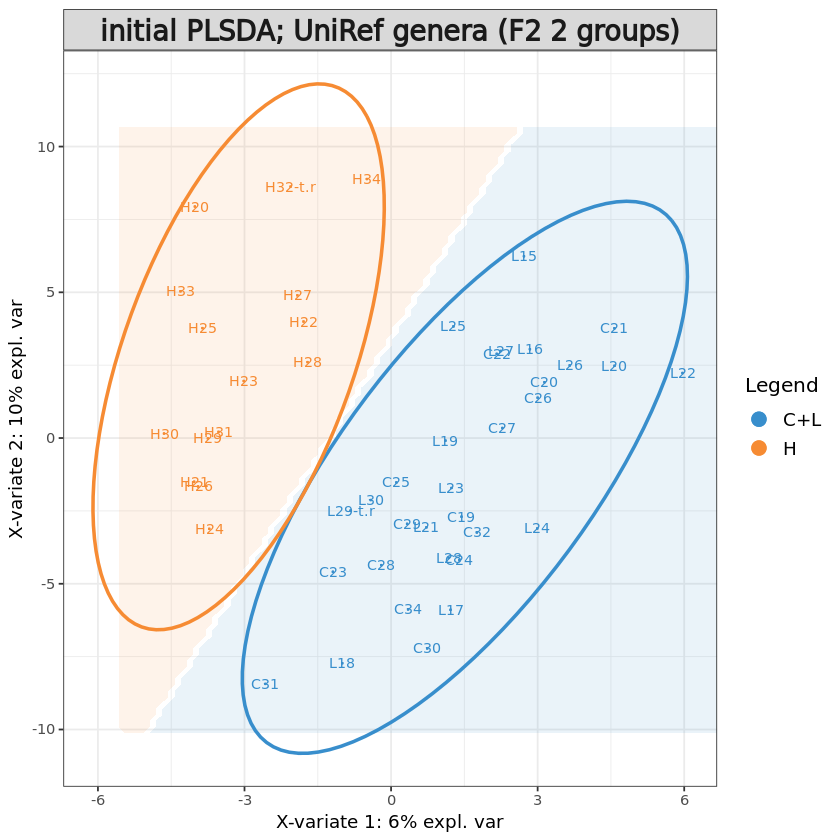

In [36]:
# Initial sPLS-DA model
uniref.genus.F2_2.splsda <- splsda(X.uniref.genus.F2_2, uniref.genus.F2_2$treatment, ncomp = 5)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(uniref.genus.F2_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(uniref.genus.F2_2.splsda, comp = 1:2, ellipse = TRUE,
          group = uniref.genus.F2_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; UniRef genera (F2 2 groups)")

The initial model separates the two treatment groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,1,1,1
BER,1,1,1


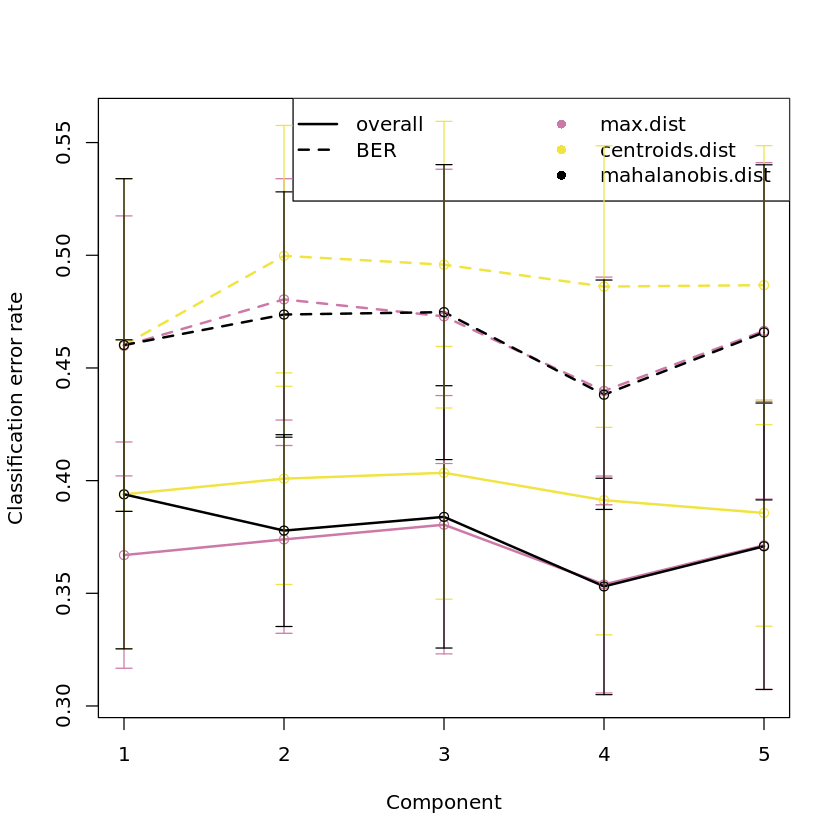

In [37]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.uniref.genus.F2_2 <- perf(uniref.genus.F2_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.uniref.genus.F2_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.uniref.genus.F2_2$choice.ncomp # what is the optimal value of components according to perf()

Even with only two treatment groups there is a very high error rate in the model.

In [38]:
# Define parameters for tuning keepX
uniref.genus.F2_2.step <- 0.05
uniref.genus.F2_2.ncomp.tune <- 3
# grid of possible keepX values that will be tested for each component
uniref.genus.F2_2.keepx <- c(seq(ceiling(dim(uniref.genus.F2_2$filtered)[2] * uniref.genus.F2_2.step), 
                      round(dim(uniref.genus.F2_2$filtered)[2], digits = -1), 
                      ceiling(dim(uniref.genus.F2_2$filtered)[2] * uniref.genus.F2_2.step)
                     )
                 )

uniref.genus.F2_2.keepx <- c(seq(10,100,5), 150, 200)

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


[1] 1

comp1 comp2 comp3 
  200    15   200

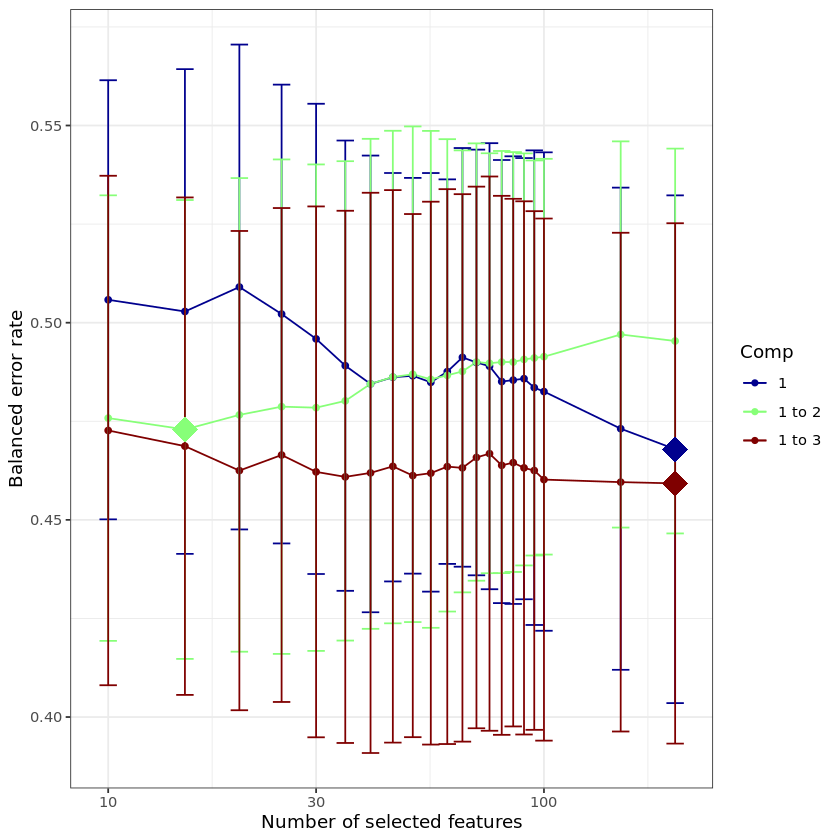

In [39]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.uniref.genus.F2_2 <- tune.splsda(X.uniref.genus.F2_2, uniref.genus.F2_2$treatment, ncomp = uniref.genus.F2_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = uniref.genus.F2_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.uniref.genus.F2_2, col = color.jet(uniref.genus.F2_2.ncomp.tune))

tune.splsda.uniref.genus.F2_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.uniref.genus.F2_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

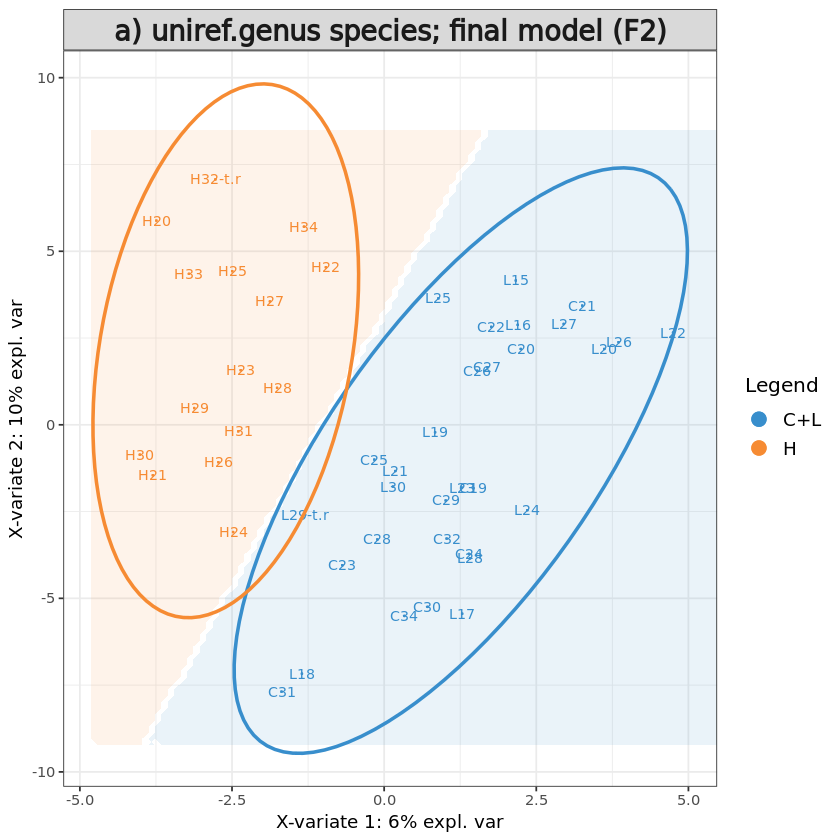

In [45]:
# Define final model
uniref.genus.F2_2$optimal.ncomp <- 2
uniref.genus.F2_2$optimal.keepX <- tune.splsda.uniref.genus.F2_2$choice.keepX[1:uniref.genus.F2_2$optimal.ncomp]
#uniref.genus.F2_2$optimal.keepX <- rep(10, uniref.genus.F2_2$optimal.ncomp)
uniref.genus.F2_2$optimal.keepX <- c(75,75)

# form final model with optimised values for component, using all features
final.splsda.uniref.genus.F2_2 <- splsda(X.uniref.genus.F2_2, uniref.genus.F2_2$treatment, 
                       ncomp = uniref.genus.F2_2$optimal.ncomp, 
                       keepX = uniref.genus.F2_2$optimal.keepX)

background = background.predict(final.splsda.uniref.genus.F2_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.uniref.genus.F2_2, comp = 1:2, 
          group = uniref.genus.F2_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) uniref.genus species; final model (F2)')

# save sample variates
data <- as.data.frame(final.splsda.uniref.genus.F2_2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F2_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

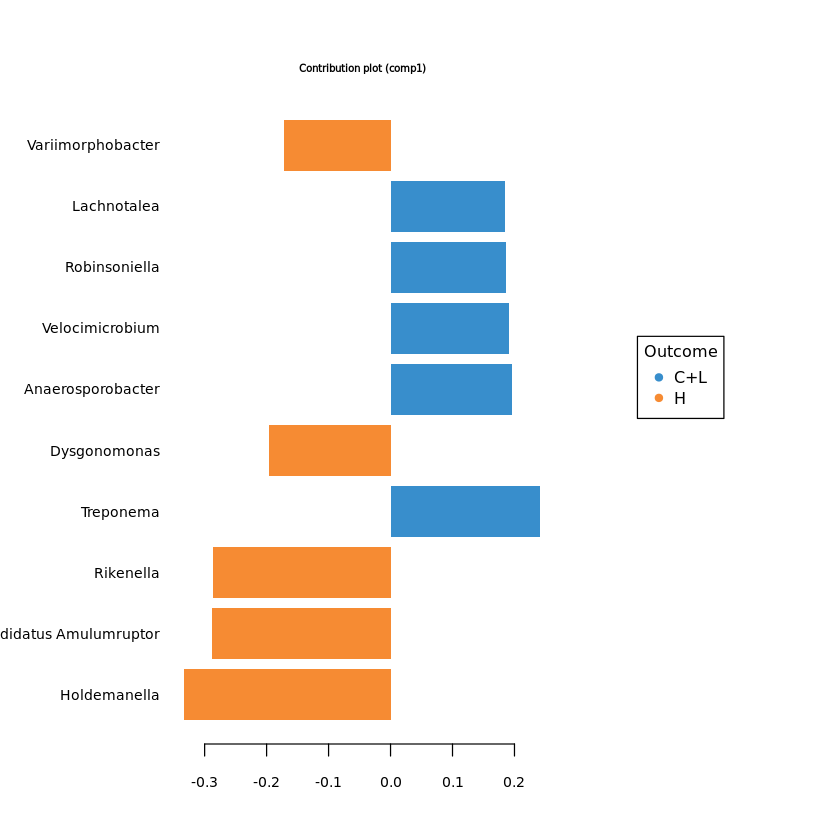

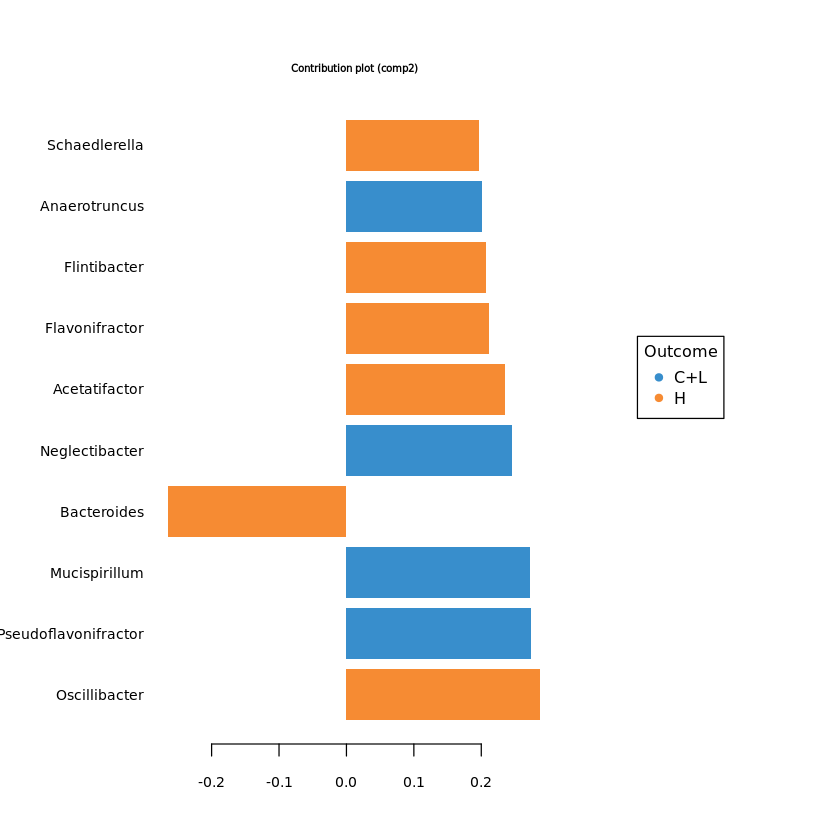

In [46]:
#plotVar(final.splsda.uniref.genus.F2_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.uniref.genus.F2_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.uniref.genus.F2_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.uniref.genus.F2_2, comp=1)$value
load_comp2 = selectVar(final.splsda.uniref.genus.F2_2, comp=2)$value
F2.uniref.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F2.uniref.load) <- F2.uniref.load[,"Row.names"]
colnames(F2.uniref.load) <- c("ft","loading_comp1","loading_comp2")
F2.uniref.load = F2.uniref.load[,c("loading_comp1","loading_comp2")]

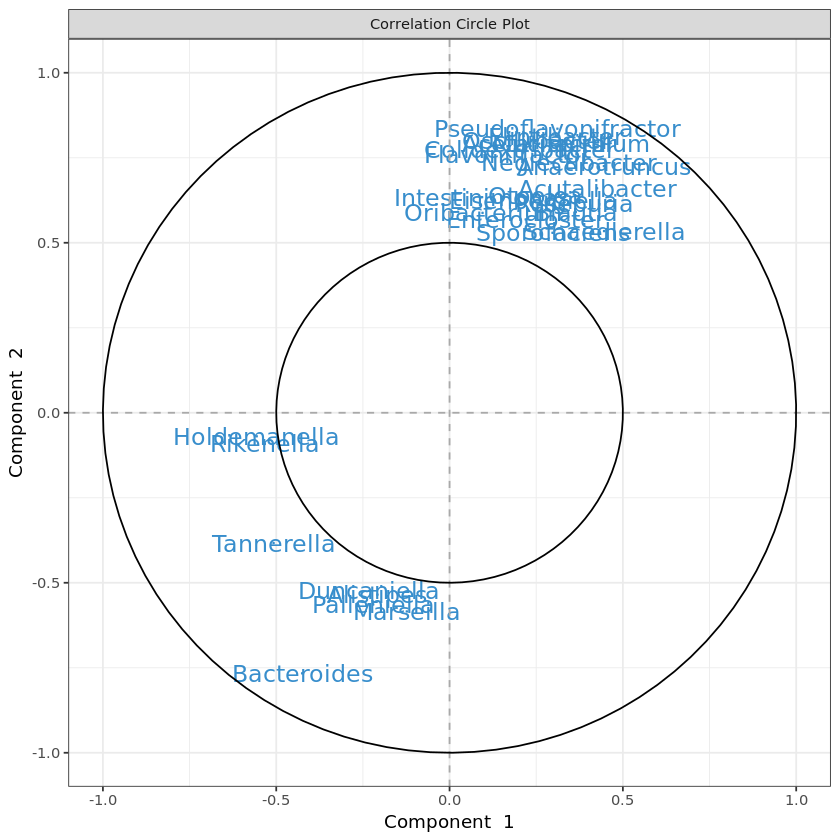

In [47]:
# plot feature correlation
plotVar(final.splsda.uniref.genus.F2_2, cutoff=0.5)
uniref.genus.F2_2.corr <- as.data.frame(plotVar(final.splsda.uniref.genus.F2_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
uniref.genus.F2_2.corr <- uniref.genus.F2_2.corr[, c("x","y")]
colnames(uniref.genus.F2_2.corr) <- c("corr_comp1","corr_comp2")

In [48]:
# Calculate feature stability
perf.splsda.uniref.genus.F2_2 <- perf(final.splsda.uniref.genus.F2_2, 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F2.uniref.stab <- merge(data.frame(perf.splsda.uniref.genus.F2_2$features$stable$comp1), 
                  data.frame(perf.splsda.uniref.genus.F2_2$features$stable$comp2), by="Var1", all=T)
rownames(F2.uniref.stab) <- F2.uniref.stab$Var1
F2.uniref.stab <- F2.uniref.stab[, c("Freq.x","Freq.y")]
colnames(F2.uniref.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [49]:
# merge feature output
F2.uniref.out <- merge(F2.uniref.load, F2.uniref.stab, by="row.names")
rownames(F2.uniref.out) <- F2.uniref.out[,"Row.names"]
F2.uniref.out <- merge(F2.uniref.out[, 2:ncol(F2.uniref.out)], uniref.genus.F2_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.uniref.genus.F2_2.features.tsv", F2.uniref.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [51]:
train <- sample(1:nrow(X.uniref.genus.F2_2), ceiling(nrow(X.uniref.genus.F2_2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.uniref.genus.F2_2), train) # rest is part of the test set

# store matrices into training and test set:
X.uniref.genus.F2_2.train <- X.uniref.genus.F2_2[train, ]
X.uniref.genus.F2_2.test <- X.uniref.genus.F2_2[test,]
Y.uniref.genus.F2_2.train <- F2_info_2[train,"treatment"]
Y.uniref.genus.F2_2.test <- F2_info_2[test, "treatment"]
train.splsda.uniref.genus.F2_2 <- splsda(X.uniref.genus.F2_2.train, Y.uniref.genus.F2_2.train, ncomp = uniref.genus.F2_2$optimal.ncomp, keepX = uniref.genus.F2_2$optimal.keepX)
predict.splsda.uniref.genus.F2_2 <- predict(train.splsda.uniref.genus.F2_2, X.uniref.genus.F2_2.test, 
                                dist = "max.dist")
predict.comp2.uniref.genus.F2_2 <- predict.splsda.uniref.genus.F2_2$class$max.dist[,2]
table(factor(predict.comp2.uniref.genus.F2_2, levels = levels(uniref.genus.F2_2$treatment)), Y.uniref.genus.F2_2.test)

     Y.uniref.genus.F2_2.test
      C+L  H
  C+L  11  5
  H    12  6

$Comp1
            AUC   p-value
C+L vs H 0.9892 9.775e-08

$Comp2
         AUC   p-value
C+L vs H   1 5.093e-08



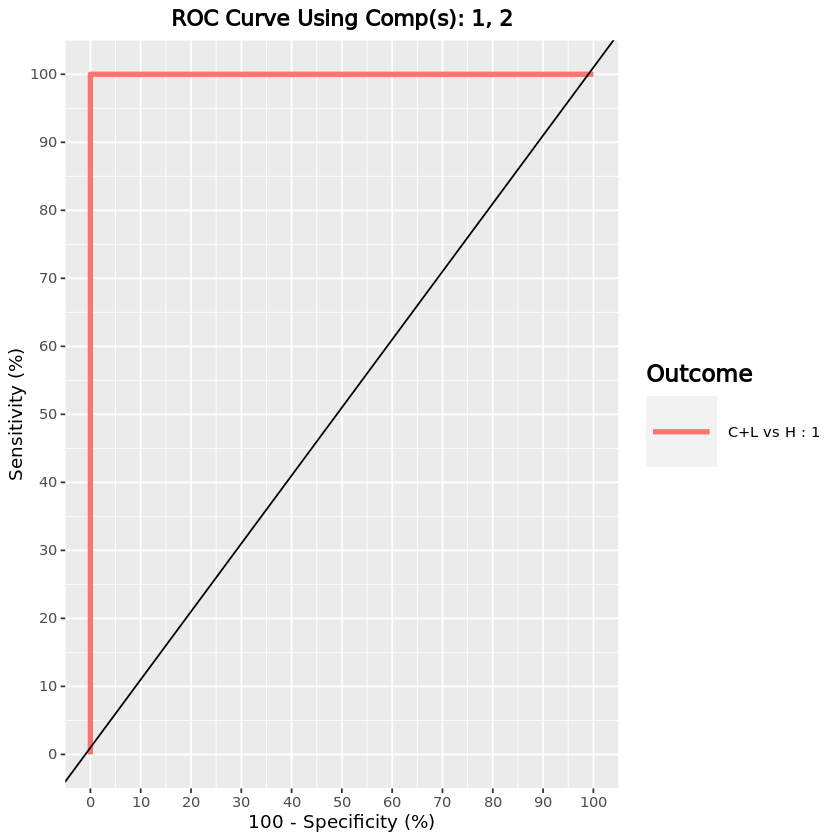

In [52]:
F2.uniref.auc.splsda = auroc(final.splsda.uniref.genus.F2_2, roc.comp = 2, print = T) # AUROC for the first component

### PFAMs

#### PFAMs - Generational differences

In [53]:
## PARAMS ##
# Initial components
pfam.ncomp <- 10
# Percentage of samples in which features must have >0 sum
pfam.percent_occ <- 10
# Quantile used for removing low abundance features
pfam.quantile_thresh <- 0.1

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(pfam$cov[, colSums(pfam$cov) > 0])
pfam$nz <- pfam$cov[, colnames(pfam$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(pfam$nz) / sum(colSums(pfam$nz)) * 100, probs = pfam.quantile_thresh)
pfam$filtered <- low.count.removal(pfam$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
pfam$occ <- colSums(pfam$filtered>0) / nrow(pfam$filtered) * 100
# Keep features occurring in defined percentage of samples
pfam$filtered <- pfam$filtered[, which(pfam$occ >= pfam.percent_occ)]

#pfam$filtered <- pfam$filtered[,-nearZeroVar(pfam$filtered, uniqueCut = 5, freqCut = 5)$Position]
paste0(c(dim(pfam$cov)[2] - dim(pfam$filtered)[2], "pfams removed", dim(pfam$filtered)[2], "remaining"))

# Add offset
pfam$offset <- pfam$filtered + 1
pfam$clr <- logratio.transfo(pfam$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.pfam <- pfam$clr

pfam$generation <- factor(info[rownames(pfam$clr), "Generation"])

pfam.lib.size <- apply(pfam$filtered, 1, sum) # determine total count for each sample
#barplot(sort(pfam.lib.size), main="Total filtered sum (pfams)", ylab="sum", xlab="sample")

[1] "826"           "pfams removed" "6537"          "remaining"

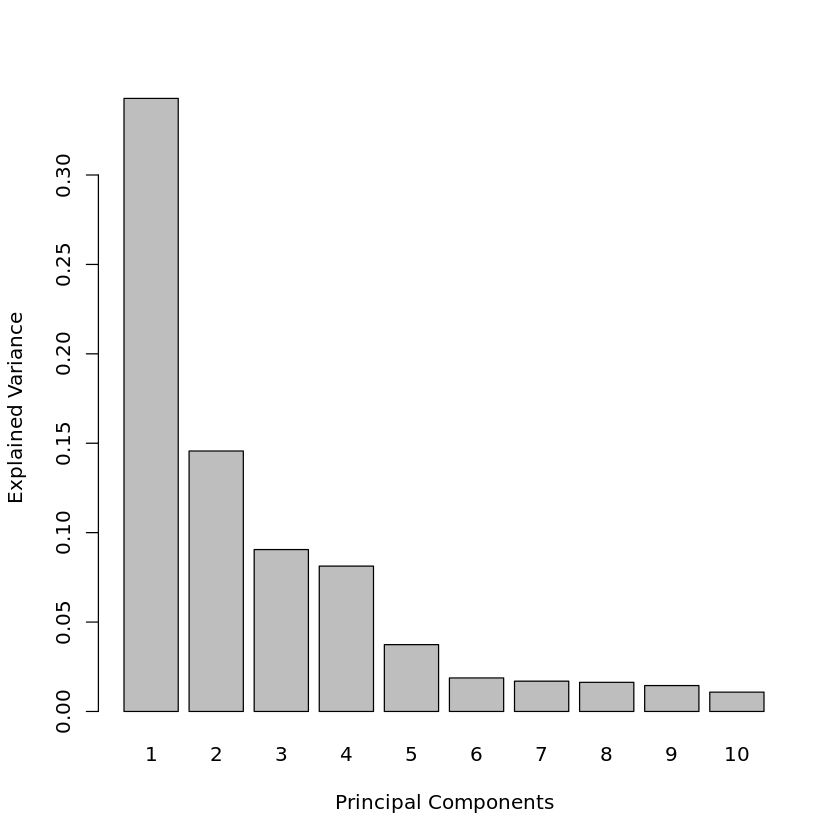

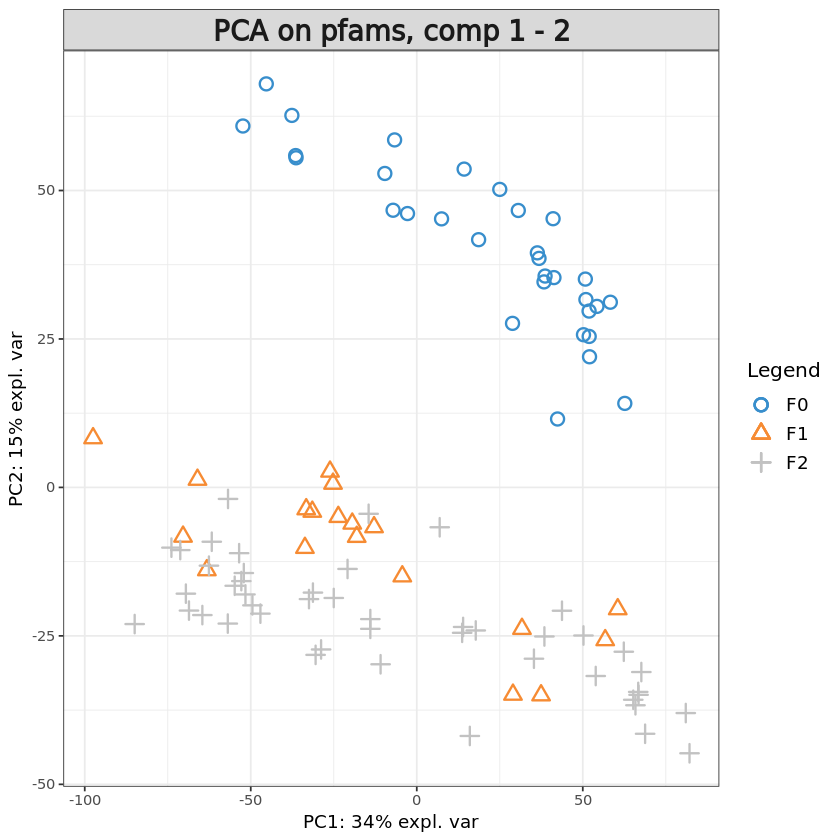

In [54]:
pca.pfam = pca(X.pfam, ncomp = pfam.ncomp, center = TRUE, scale = TRUE) 

plot(pca.pfam)
plotIndiv(pca.pfam, group = pfam$generation, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on pfams, comp 1 - 2')

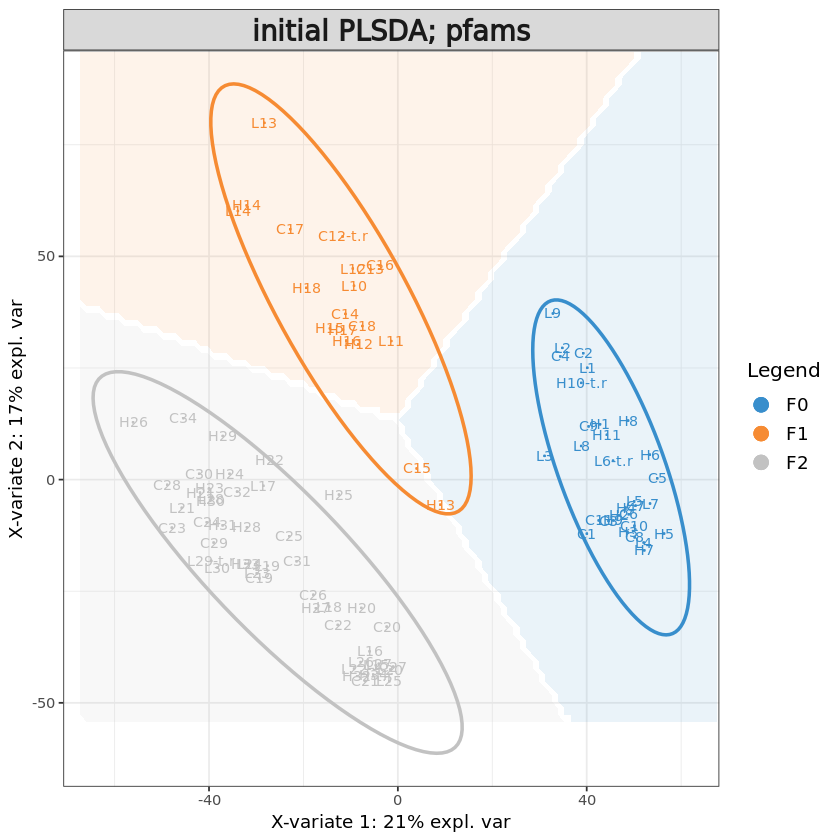

In [55]:
# Initial sPLS-DA model
pfam.splsda <- splsda(X.pfam, pfam$generation, ncomp = pfam.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(pfam.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(pfam.splsda, comp = 1:2, ellipse = TRUE,
          group = pfam$generation, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; pfams")

The initial model clearly separates samples based on generation.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,4,4,4
BER,4,4,4


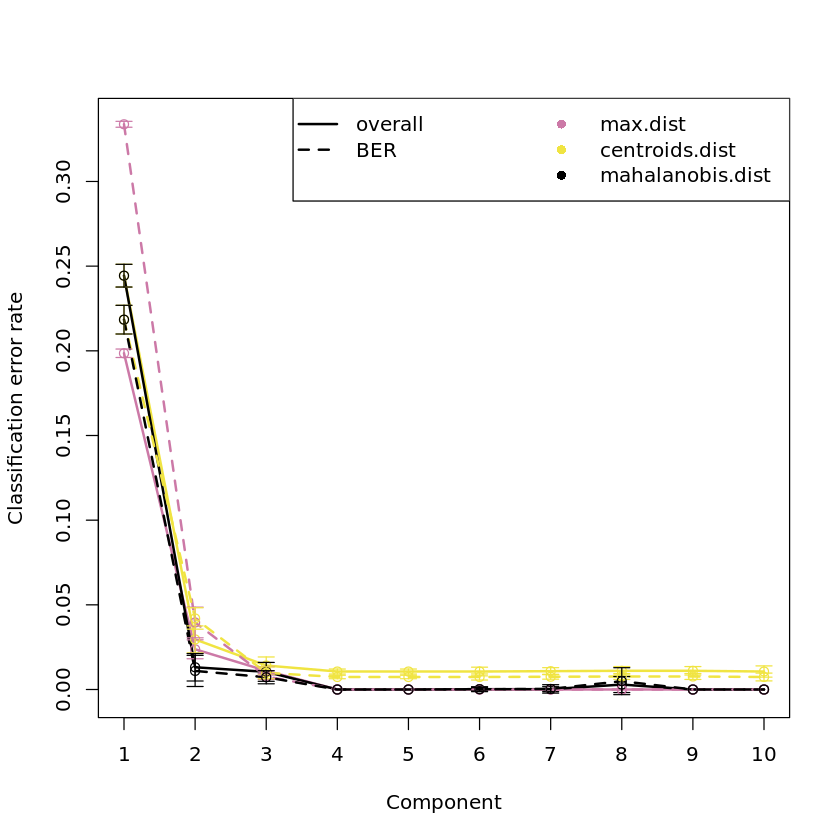

In [56]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.pfam <- perf(pfam.splsda, validation = "Mfold", 
                          folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.pfam, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.pfam$choice.ncomp # what is the optimal value of components according to perf()

The tuning step indicates that with 2 components there is very low error rate in the model. The perf function suggests to use 4 components.

In [64]:
# Define parameters for tuning keepX
pfam.step <- 0.1
pfam.ncomp.tune <- 4
# grid of possible keepX values that will be tested for each component
#pfam.keepx <- c(10, 100, seq(ceiling(dim(pfam$filtered)[2] * pfam.step), 
#                      round(dim(pfam$filtered)[2], digits = -1), 
#                      ceiling(dim(pfam$filtered)[2] * pfam.step)
#                     )
#                 )
pfam.keepx <- c(seq(10,100, 10), seq(1000, 6500, 500))
pfam.keepx

[1]   10   20   30   40   50   60   70   80   90  100 1000 1500 2000 2500 3000
[16] 3500 4000 4500 5000 5500 6000 6500

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%


[1] 3

comp1 comp2 comp3 comp4 
   10    30    10    10

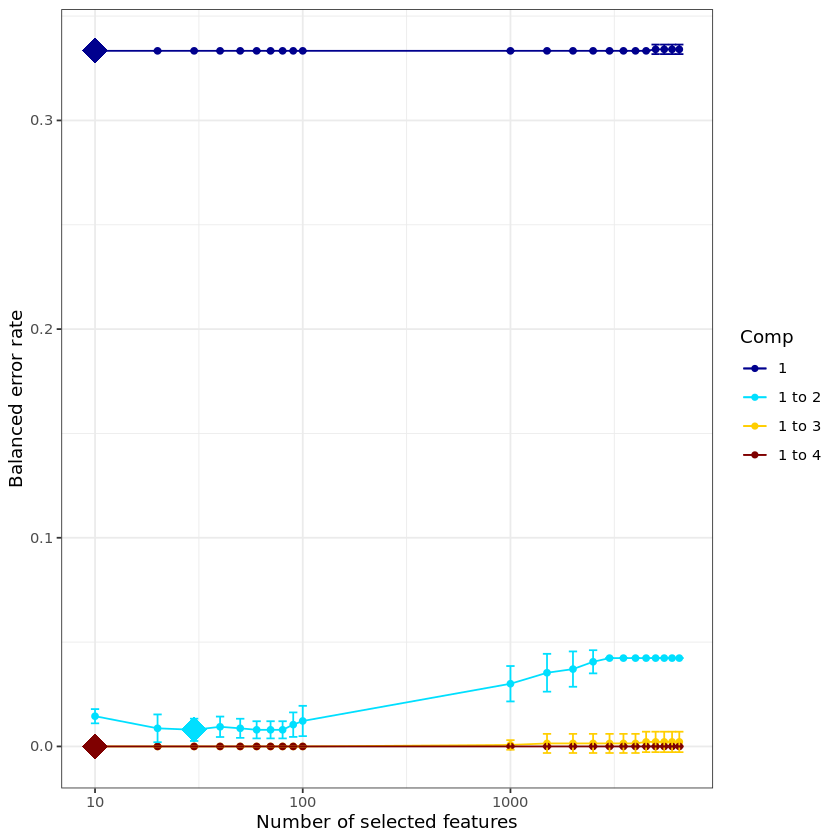

In [65]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.pfam <- tune.splsda(X.pfam, pfam$generation, ncomp = pfam.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = folds, nrepeat = 10, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = pfam.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.pfam, col = color.jet(pfam.ncomp.tune))

tune.splsda.pfam$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.pfam$choice.keepX # what are the optimal values of variables according to tune.splsda()

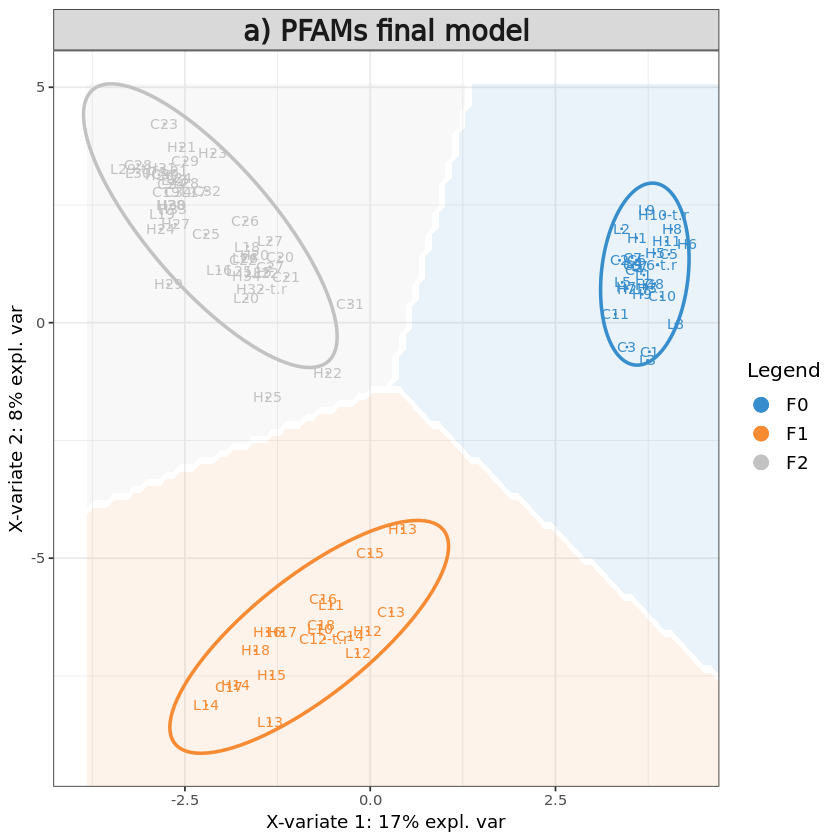

In [73]:
# Define final model
pfam$optimal.ncomp <- 2
pfam$optimal.keepX <- tune.splsda.pfam$choice.keepX[1:pfam$optimal.ncomp]
#pfam$optimal.keepX <- rep(100, pfam$optimal.ncomp)
#pfam$optimal.keepX <- c(10, 100)

# form final model with optimised values for component, using all features
final.splsda.pfam <- splsda(X.pfam, pfam$generation, 
                       ncomp = pfam$optimal.ncomp,
                       keepX = pfam$optimal.keepX)

background = background.predict(final.splsda.pfam, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.pfam, comp = 1:2, 
          group = pfam$generation, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) PFAMs final model')

# save sample variates
data <- as.data.frame(final.splsda.pfam$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

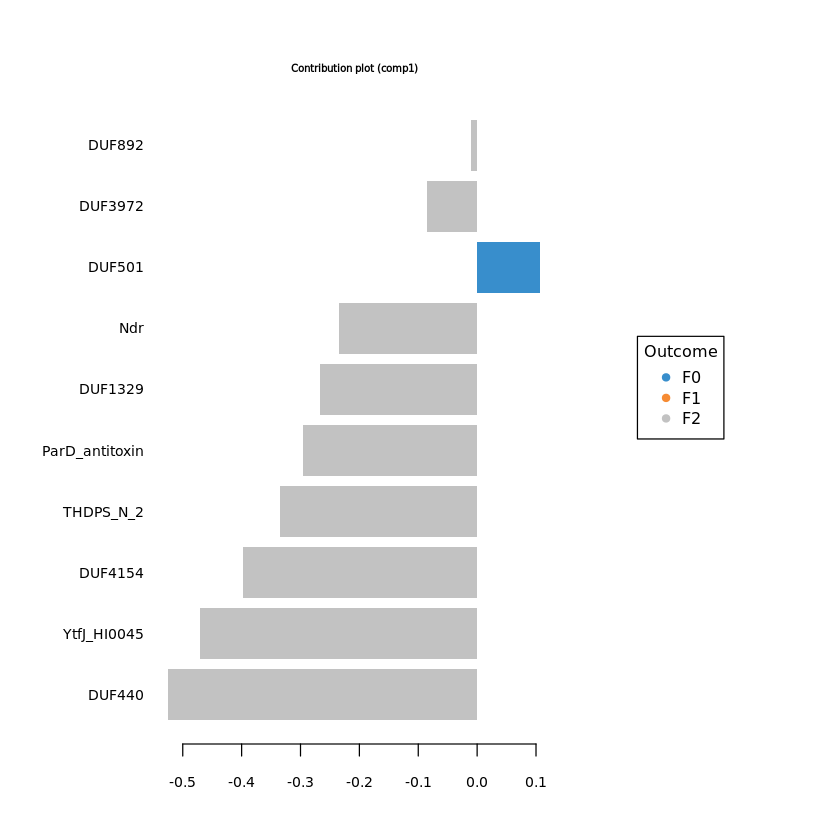

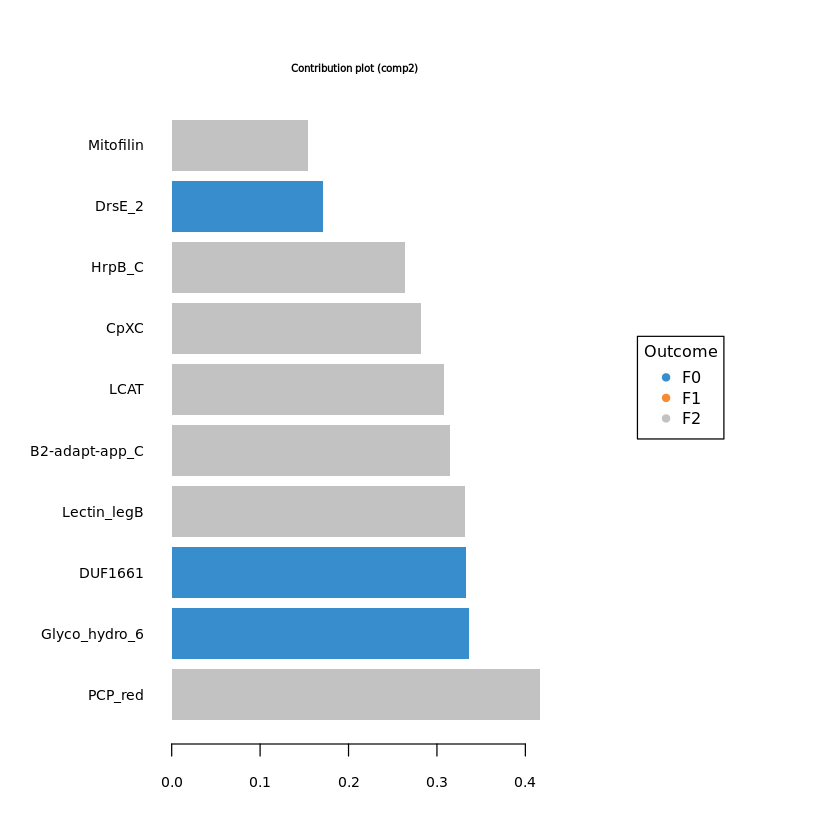

In [74]:
#plotVar(final.splsda.pfam, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.pfam, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10)
plotLoadings(final.splsda.pfam, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.pfam, comp=1)$value
load_comp2 = selectVar(final.splsda.pfam, comp=2)$value
pfam.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(pfam.load) <- pfam.load[,"Row.names"]
colnames(pfam.load) <- c("ft","loading_comp1","loading_comp2")
pfam.load = pfam.load[,c("loading_comp1","loading_comp2")]

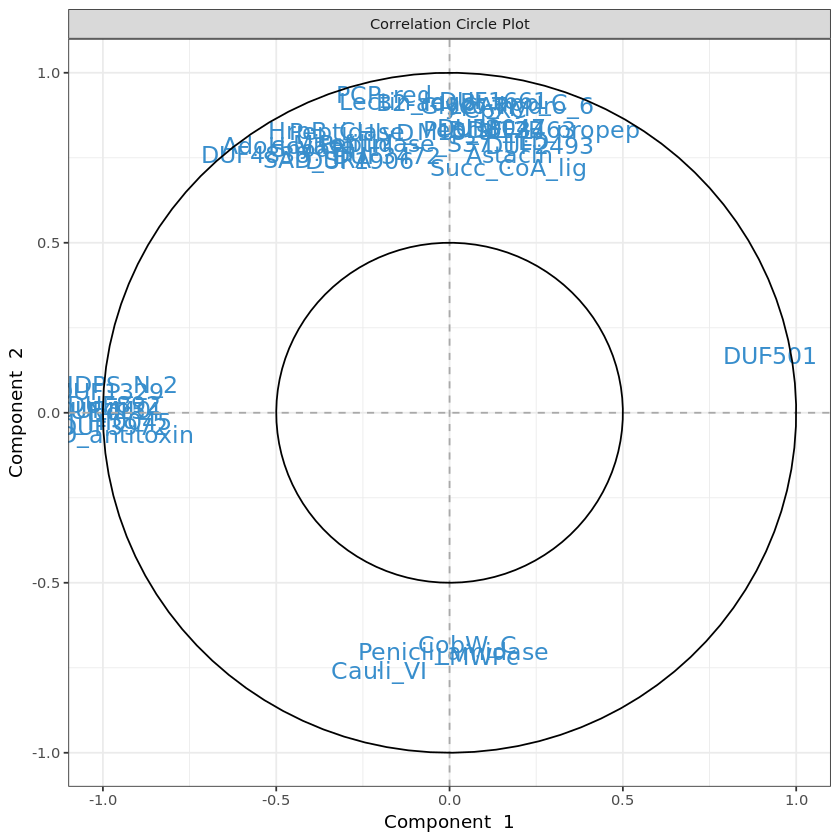

In [75]:
# plot feature correlation
plotVar(final.splsda.pfam, cutoff=0.5)
pfam.corr <- as.data.frame(plotVar(final.splsda.pfam, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
pfam.corr <- pfam.corr[, c("x","y")]
colnames(pfam.corr) <- c("corr_comp1","corr_comp2")

In [76]:
# Calculate feature stability
perf.splsda.pfam <- perf(final.splsda.pfam, 
                          folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
pfam.stab <- merge(data.frame(perf.splsda.pfam$features$stable$comp1), 
                  data.frame(perf.splsda.pfam$features$stable$comp2), by="Var1", all=T)
rownames(pfam.stab) <- pfam.stab$Var1
pfam.stab <- pfam.stab[, c("Freq.x","Freq.y")]
colnames(pfam.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [77]:
# merge feature output
pfam.out <- merge(pfam.load, pfam.stab, by="row.names")
rownames(pfam.out) <- pfam.out[,"Row.names"]
pfam.out <- merge(pfam.out[, 2:ncol(pfam.out)], pfam.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.features.tsv", pfam.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [78]:
train <- sample(1:nrow(X.pfam), ceiling(nrow(X.pfam)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.pfam), train) # rest is part of the test set

# store matrices into training and test set:
X.pfam.train <- X.pfam[train, ]
X.pfam.test <- X.pfam[test,]
Y.pfam.train <- info[train,"generation"]
Y.pfam.test <- info[test, "generation"]
train.splsda.pfam <- splsda(X.pfam.train, Y.pfam.train, ncomp = pfam$optimal.ncomp, keepX = pfam$optimal.keepX)
predict.splsda.pfam <- predict(train.splsda.pfam, X.pfam.test, 
                                dist = "max.dist")
predict.comp2.pfam <- predict.splsda.pfam$class$max.dist[,2]
table(factor(predict.comp2.pfam, levels = levels(pfam$generation)), Y.pfam.test)

    Y.pfam.test
     F0 F1 F2
  F0 26  0  1
  F1  0 13  1
  F2  0  0 31

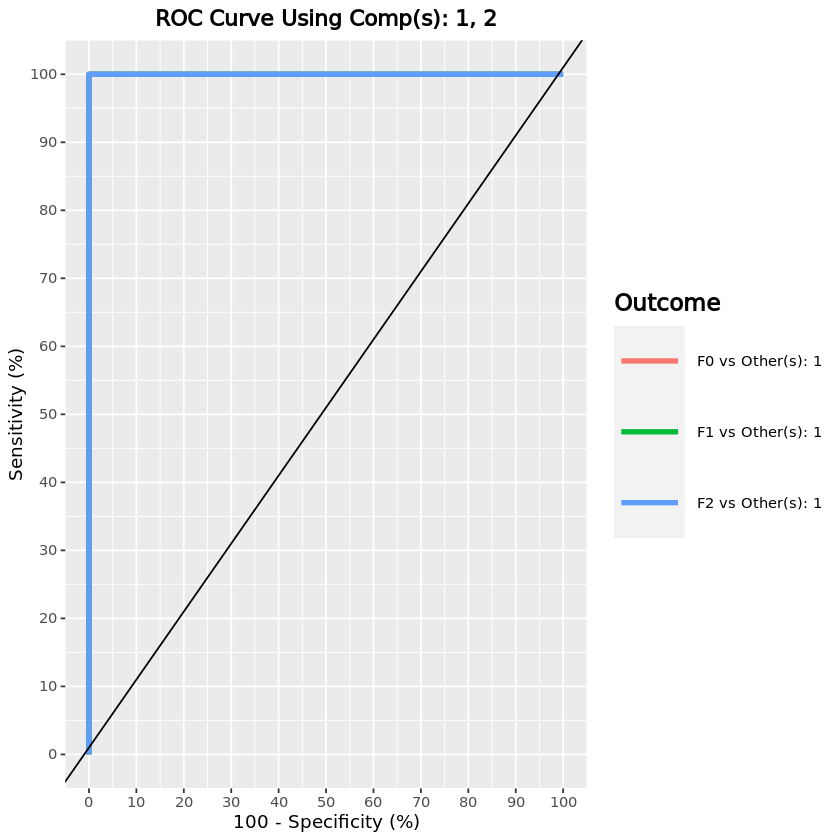

In [79]:
pfam.auc.splsda = auroc(final.splsda.pfam, roc.comp = 2, print = F) # AUROC for the first component

#### PFAMs - F0 generation

[1] "1368"          "pfams removed" "5995"          "remaining"

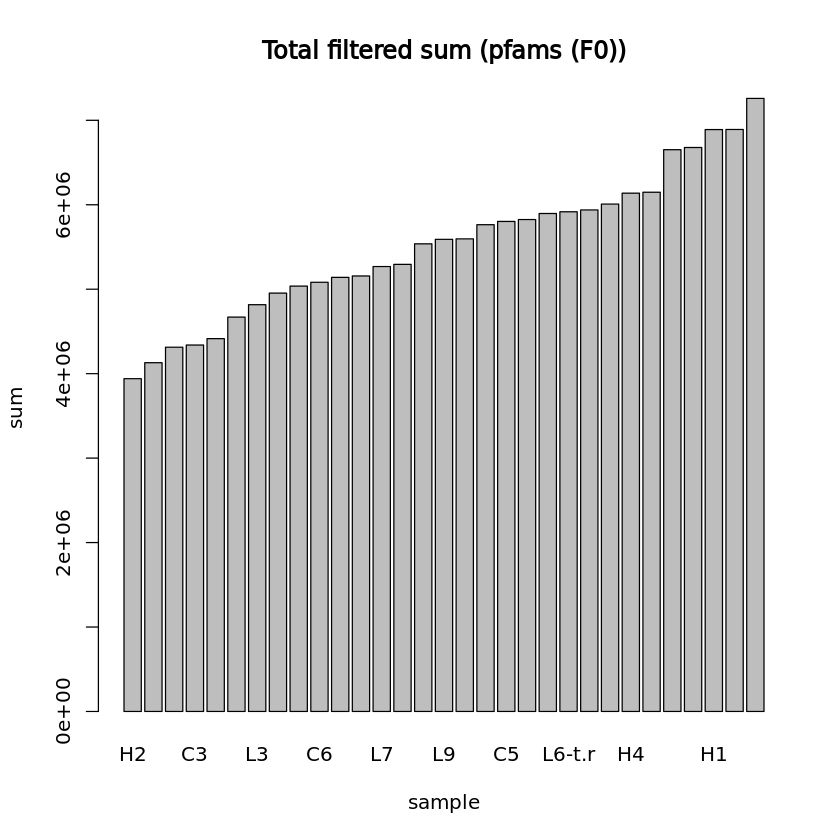

In [80]:
## PARAMS ##
# Initial components
pfam.F0.ncomp <- 10
# Percentage of samples in which features must have >0 sum
pfam.F0.percent_occ <- 10
# Quantile used for removing low abundance features
pfam.F0.quantile_thresh <- 0.1
generation <- "F0"

pfam.F0 <- list()
pfam.F0$cov <- pfam$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(pfam.F0$cov[, colSums(pfam.F0$cov) > 0])
pfam.F0$nz <- pfam.F0$cov[, colnames(pfam.F0$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(pfam.F0$nz) / sum(colSums(pfam.F0$nz)) * 100, probs = pfam.F0.quantile_thresh)
pfam.F0$filtered <- low.count.removal(pfam.F0$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
pfam.F0$occ <- colSums(pfam.F0$filtered>0) / nrow(pfam.F0$filtered) * 100
# Keep features occurring in defined percentage of samples
pfam.F0$filtered <- pfam.F0$filtered[, which(pfam.F0$occ >= pfam.F0.percent_occ)]

#pfam.F0$filtered <- pfam.F0$filtered[,-nearZeroVar(pfam.F0$filtered)$Position]
paste0(c(dim(pfam.F0$cov)[2] - dim(pfam.F0$filtered)[2], "pfams removed", dim(pfam.F0$filtered)[2], "remaining"))

# Add offset
pfam.F0$offset <- pfam.F0$filtered + 1
pfam.F0$clr <- logratio.transfo(pfam.F0$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.pfam.F0 <- pfam.F0$clr

pfam.F0$treatment <- factor(info[rownames(pfam.F0$clr), "Treatment"])

pfam.F0.lib.size <- apply(pfam.F0$filtered, 1, sum) # determine total count for each sample
barplot(sort(pfam.F0.lib.size), main="Total filtered sum (pfams (F0))", ylab="sum", xlab="sample")

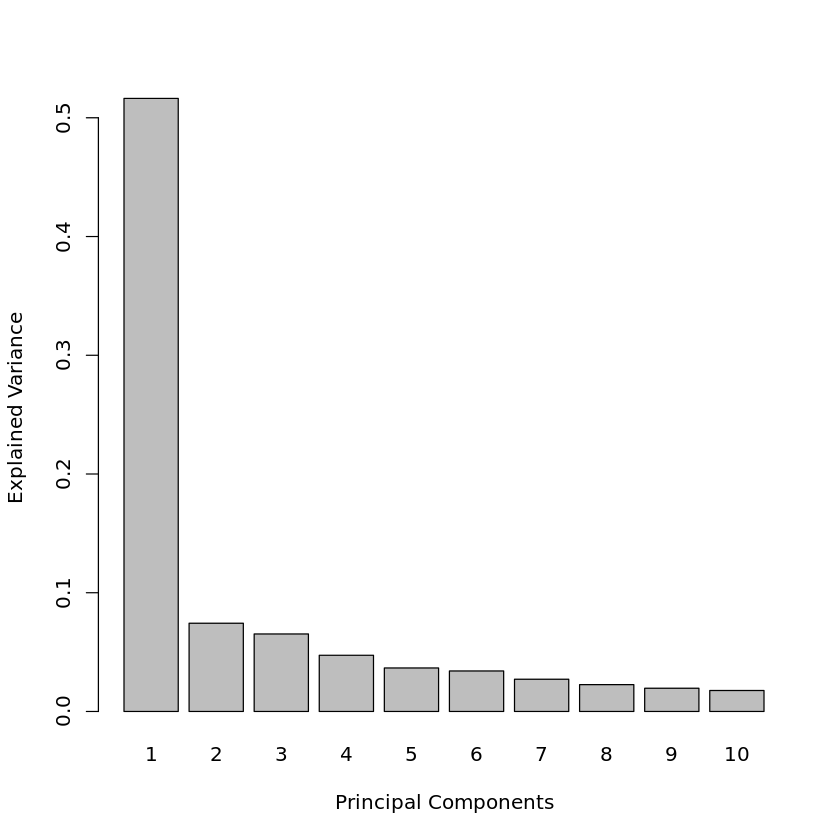

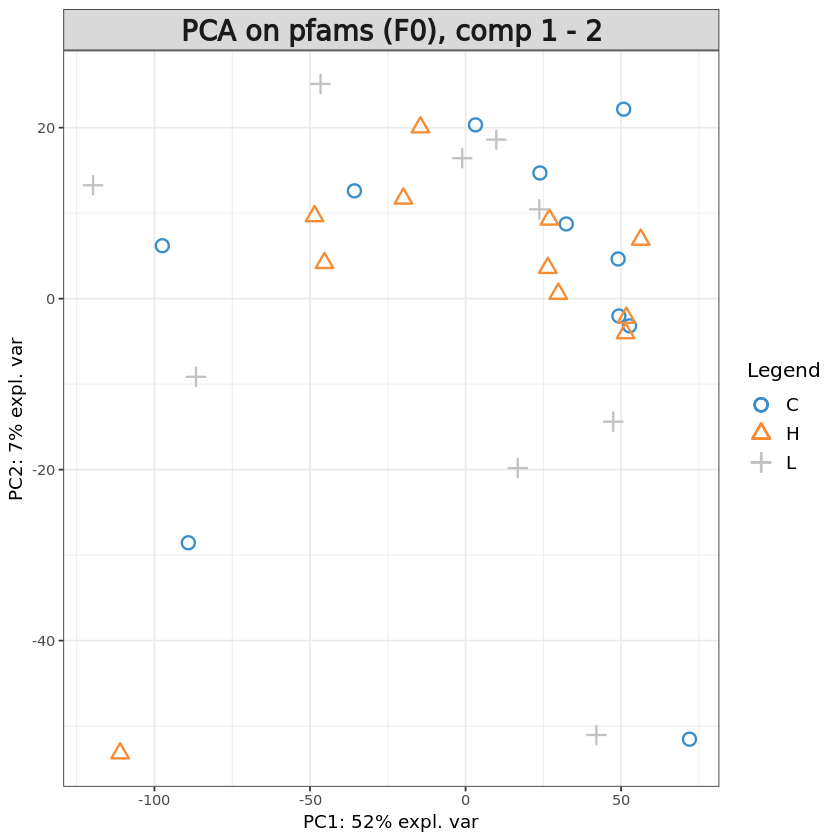

In [81]:
pca.pfam.F0 = pca(X.pfam.F0, ncomp = pfam.F0.ncomp, center = TRUE, scale = TRUE) 

plot(pca.pfam.F0)
plotIndiv(pca.pfam.F0, group = pfam.F0$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on pfams (F0), comp 1 - 2')

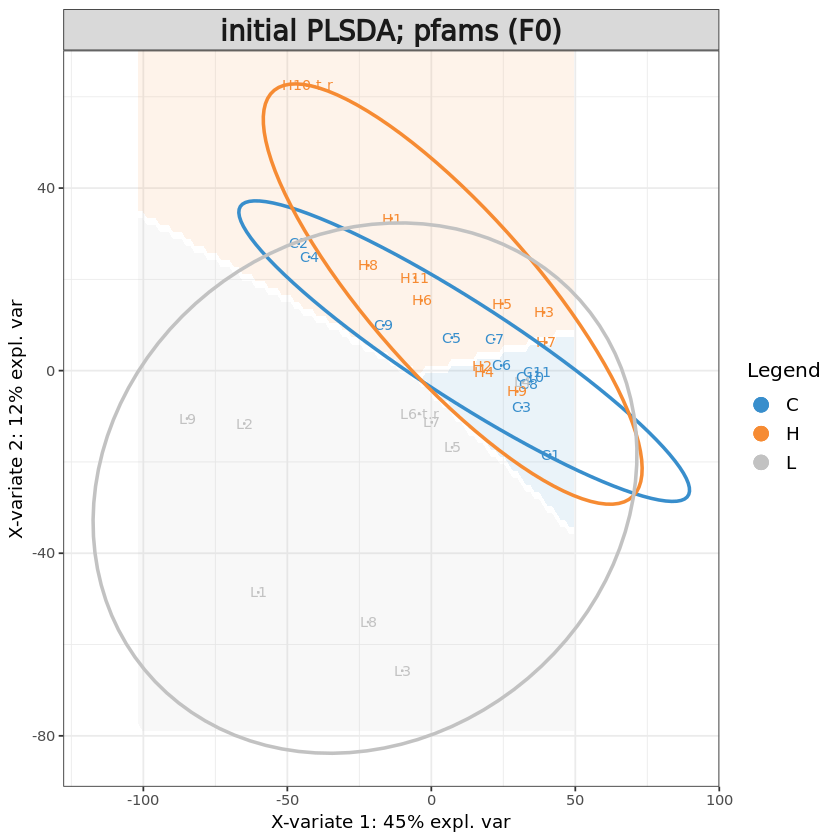

In [82]:
# Initial sPLS-DA model
pfam.F0.splsda <- splsda(X.pfam.F0, pfam.F0$treatment, ncomp = pfam.F0.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(pfam.F0.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(pfam.F0.splsda, comp = 1:2, ellipse = TRUE,
          group = pfam.F0$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; pfams (F0)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,5,3,4
BER,5,3,4


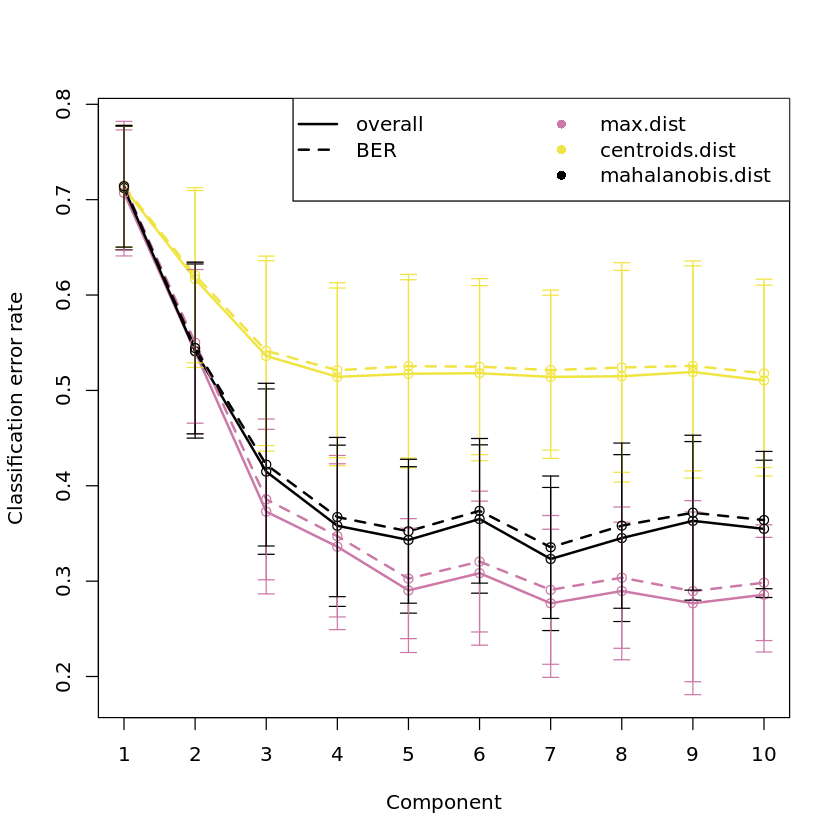

In [83]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.pfam.F0 <- perf(pfam.F0.splsda, validation = "Mfold", 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.pfam.F0, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.pfam.F0$choice.ncomp # what is the optimal value of components according to perf()

In [85]:
# Define parameters for tuning keepX
pfam.F0.step <- 0.05
pfam.F0.ncomp.tune <- 5
# grid of possible keepX values that will be tested for each component
pfam.F0.keepx <- c(seq(10, 200, 20), seq(ceiling(dim(pfam.F0$filtered)[2] * pfam.F0.step), 
                      round(dim(pfam.F0$filtered)[2], digits = -1), 
                      ceiling(dim(pfam.F0$filtered)[2] * pfam.F0.step)
                     )
                 )
pfam.F0.keepx

[1]   10   30   50   70   90  110  130  150  170  190  300  600  900 1200 1500
[16] 1800 2100 2400 2700 3000 3300 3600 3900 4200 4500 4800 5100 5400 5700 6000

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


[1] 5

comp1 comp2 comp3 comp4 comp5 
   10   300   130   300   600

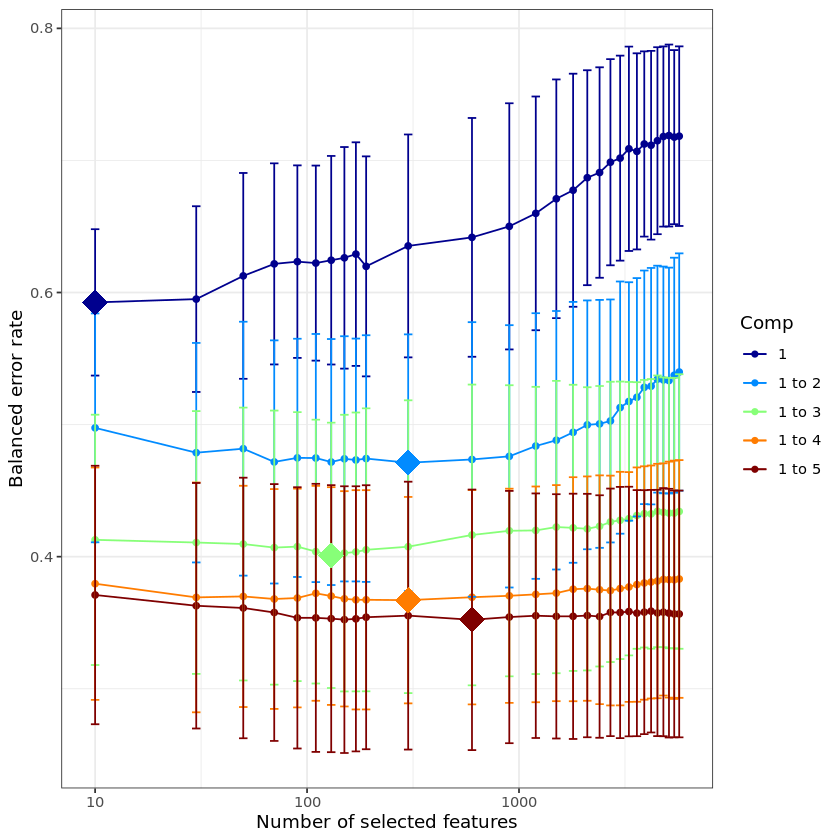

In [86]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.pfam.F0 <- tune.splsda(X.pfam.F0, pfam.F0$treatment, ncomp = pfam.F0.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = pfam.F0.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.pfam.F0, col = color.jet(pfam.F0.ncomp.tune))

tune.splsda.pfam.F0$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.pfam.F0$choice.keepX # what are the optimal values of variables according to tune.splsda()

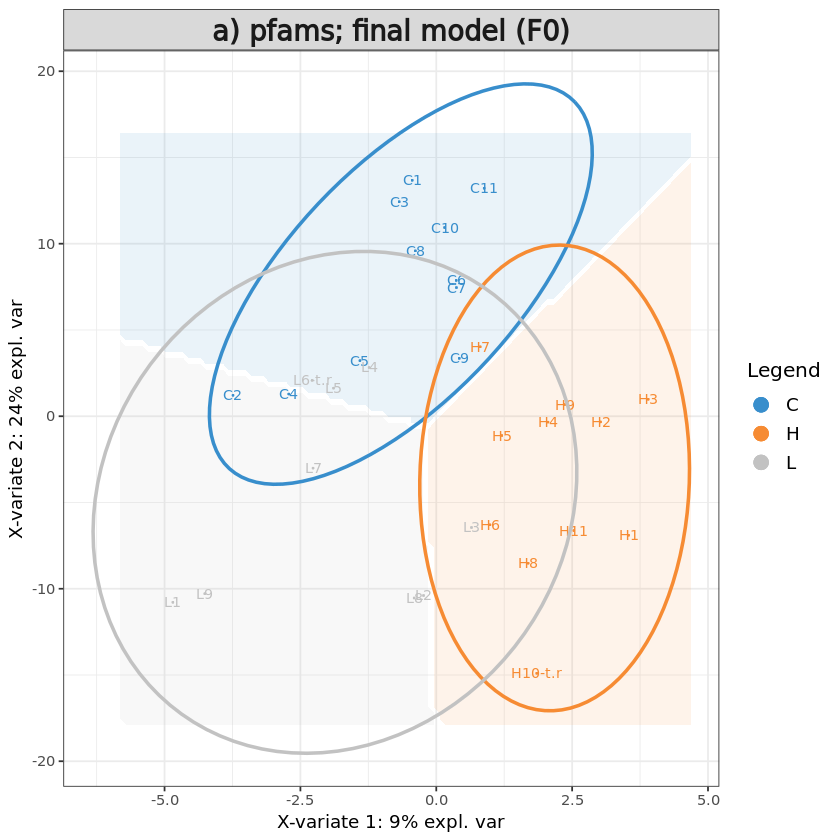

In [87]:
# Define final model
pfam.F0$optimal.ncomp <- 5
pfam.F0$optimal.keepX <- tune.splsda.pfam.F0$choice.keepX[1:pfam.F0$optimal.ncomp]
#pfam.F0$optimal.keepX <- rep(50, pfam.F0$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.pfam.F0 <- splsda(X.pfam.F0, pfam.F0$treatment, 
                       ncomp = pfam.F0$optimal.ncomp, 
                       keepX = pfam.F0$optimal.keepX)

background = background.predict(final.splsda.pfam.F0, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.pfam.F0, comp = 1:2, 
          group = pfam.F0$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) pfams; final model (F0)')

# save sample variates
data <- as.data.frame(final.splsda.pfam.F0$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F0.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

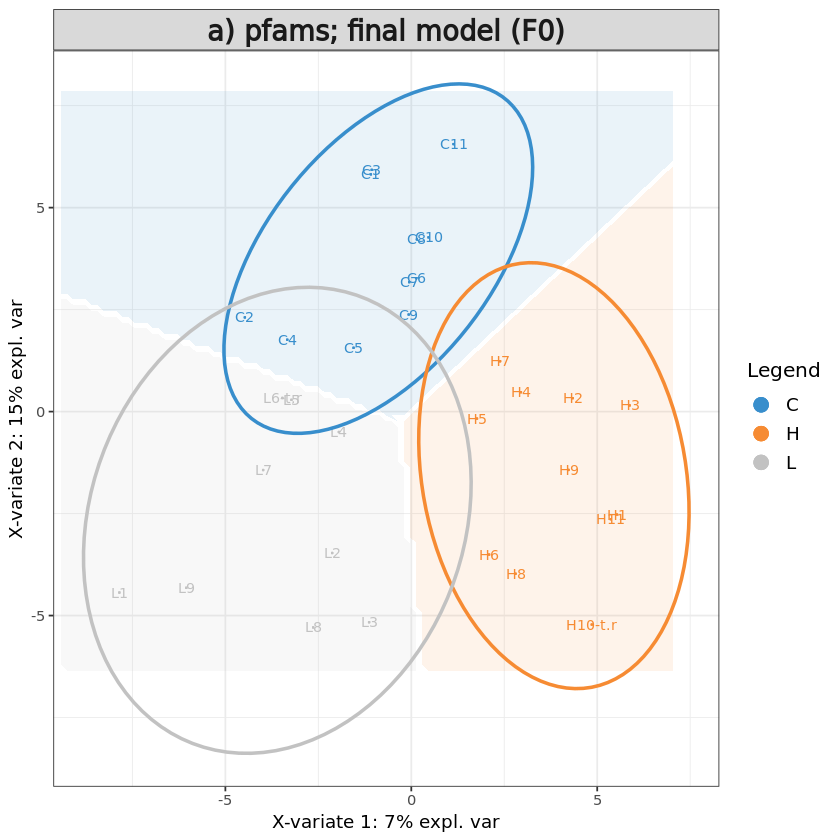

In [88]:
# Define final model
pfam.F0$optimal.ncomp <- 4
#pfam.F0$optimal.keepX <- tune.splsda.pfam.F0$choice.keepX[1:pfam.F0$optimal.ncomp]
pfam.F0$optimal.keepX <- rep(50, pfam.F0$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.pfam.F0 <- splsda(X.pfam.F0, pfam.F0$treatment, 
                       ncomp = pfam.F0$optimal.ncomp, 
                       keepX = pfam.F0$optimal.keepX)

background = background.predict(final.splsda.pfam.F0, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.pfam.F0, comp = 1:2, 
          group = pfam.F0$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) pfams; final model (F0)')

# save sample variates
data <- as.data.frame(final.splsda.pfam.F0$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F0.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

Using 4 components with 50 features per component gave highly similar results to using the tuned number of features per component.

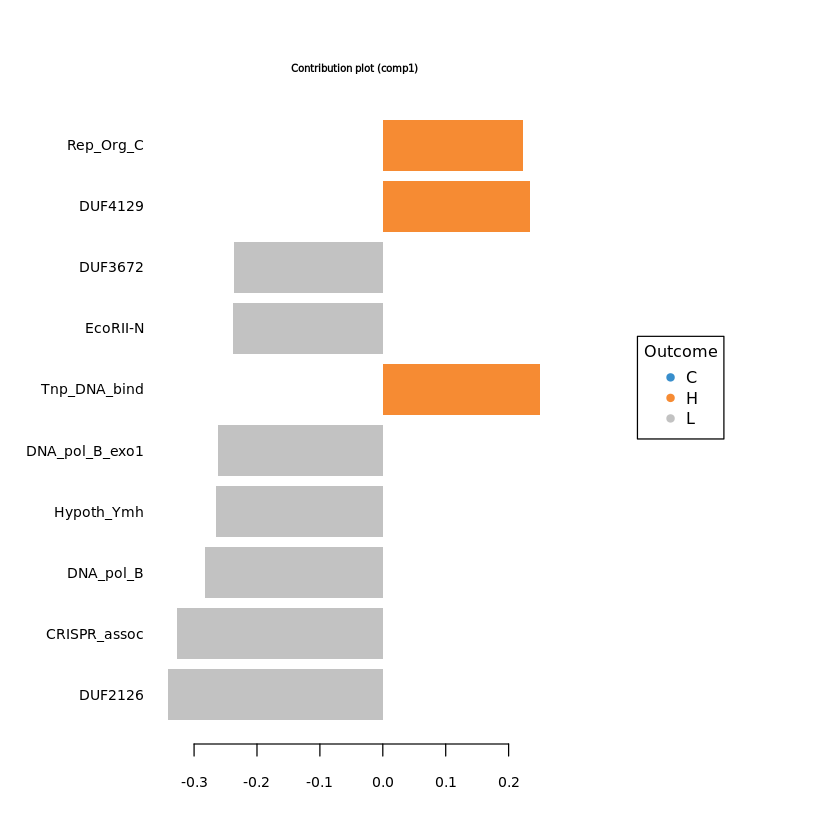

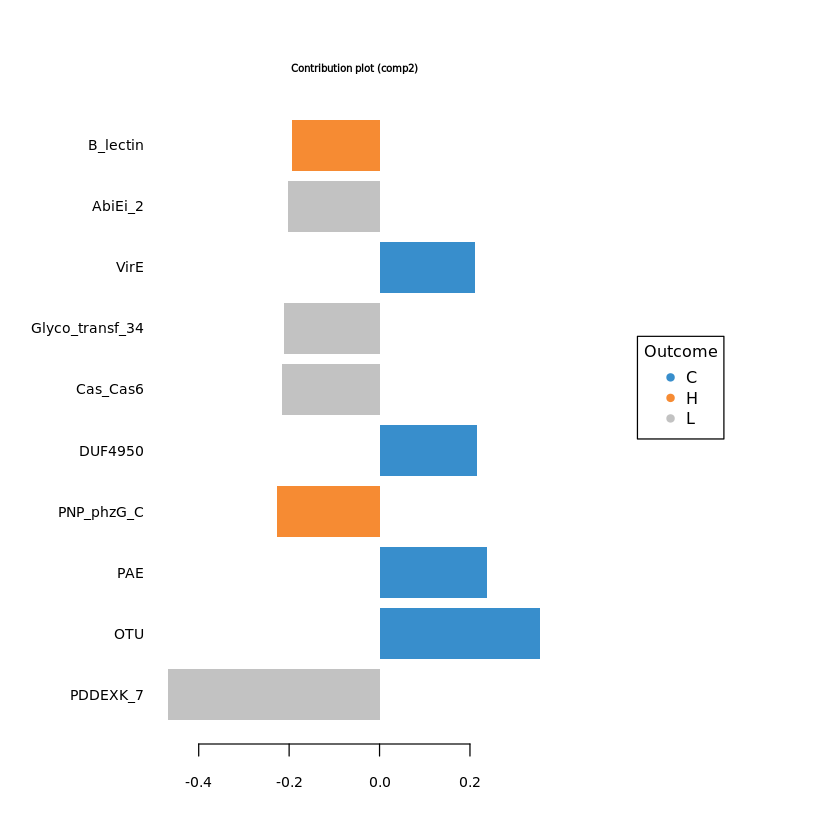

In [90]:
#plotVar(final.splsda.pfam.F0, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.pfam.F0, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10)
plotLoadings(final.splsda.pfam.F0, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.pfam.F0, comp=1)$value
load_comp2 = selectVar(final.splsda.pfam.F0, comp=2)$value
F0.pfam.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F0.pfam.load) <- F0.pfam.load[,"Row.names"]
colnames(F0.pfam.load) <- c("ft","loading_comp1","loading_comp2")
F0.pfam.load = F0.pfam.load[,c("loading_comp1","loading_comp2")]

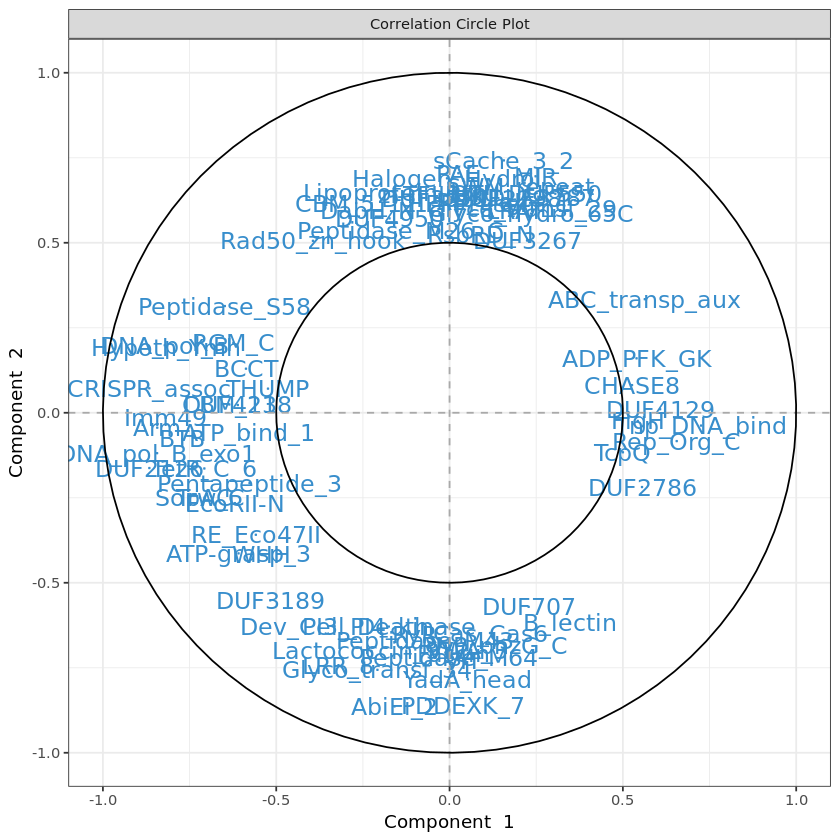

In [91]:
# plot feature correlation
plotVar(final.splsda.pfam.F0, cutoff=0.5)
pfam.F0.corr <- as.data.frame(plotVar(final.splsda.pfam.F0, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
pfam.F0.corr <- pfam.F0.corr[, c("x","y")]
colnames(pfam.F0.corr) <- c("corr_comp1","corr_comp2")

In [92]:
# Calculate feature stability
perf.splsda.pfam.F0 <- perf(final.splsda.pfam.F0, 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F0.pfam.stab <- merge(data.frame(perf.splsda.pfam.F0$features$stable$comp1), 
                  data.frame(perf.splsda.pfam.F0$features$stable$comp2), by="Var1", all=T)
rownames(F0.pfam.stab) <- F0.pfam.stab$Var1
F0.pfam.stab <- F0.pfam.stab[, c("Freq.x","Freq.y")]
colnames(F0.pfam.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%


In [93]:
# merge feature output
F0.pfam.out <- merge(F0.pfam.load, F0.pfam.stab, by="row.names")
rownames(F0.pfam.out) <- F0.pfam.out[,"Row.names"]
F0.pfam.out <- merge(F0.pfam.out[, 2:ncol(F0.pfam.out)], pfam.F0.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F0.features.tsv", F0.pfam.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [94]:
train <- sample(1:nrow(X.pfam.F0), ceiling(nrow(X.pfam.F0)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.pfam.F0), train) # rest is part of the test set

# store matrices into training and test set:
X.pfam.F0.train <- X.pfam.F0[train, ]
X.pfam.F0.test <- X.pfam.F0[test,]
Y.pfam.F0.train <- info[train,"treatment"]
Y.pfam.F0.test <- info[test, "treatment"]
train.splsda.pfam.F0 <- splsda(X.pfam.F0.train, Y.pfam.F0.train, ncomp = pfam.F0$optimal.ncomp, keepX = pfam.F0$optimal.keepX)
predict.splsda.pfam.F0 <- predict(train.splsda.pfam.F0, X.pfam.F0.test, 
                                dist = "max.dist")
predict.comp2.pfam.F0 <- predict.splsda.pfam.F0$class$max.dist[,2]
table(factor(predict.comp2.pfam.F0, levels = levels(pfam.F0$treatment)), Y.pfam.F0.test)

   Y.pfam.F0.test
    C H L
  C 0 0 0
  H 6 6 5
  L 4 0 2

$Comp1
                 AUC   p-value
C vs Other(s) 0.6091 3.217e-01
H vs Other(s) 1.0000 5.586e-06
L vs Other(s) 0.9343 1.821e-04

$Comp2
                 AUC   p-value
C vs Other(s) 1.0000 5.586e-06
H vs Other(s) 1.0000 5.586e-06
L vs Other(s) 0.9949 2.000e-05

$Comp3
              AUC   p-value
C vs Other(s)   1 5.586e-06
H vs Other(s)   1 5.586e-06
L vs Other(s)   1 1.644e-05

$Comp4
              AUC   p-value
C vs Other(s)   1 5.586e-06
H vs Other(s)   1 5.586e-06
L vs Other(s)   1 1.644e-05



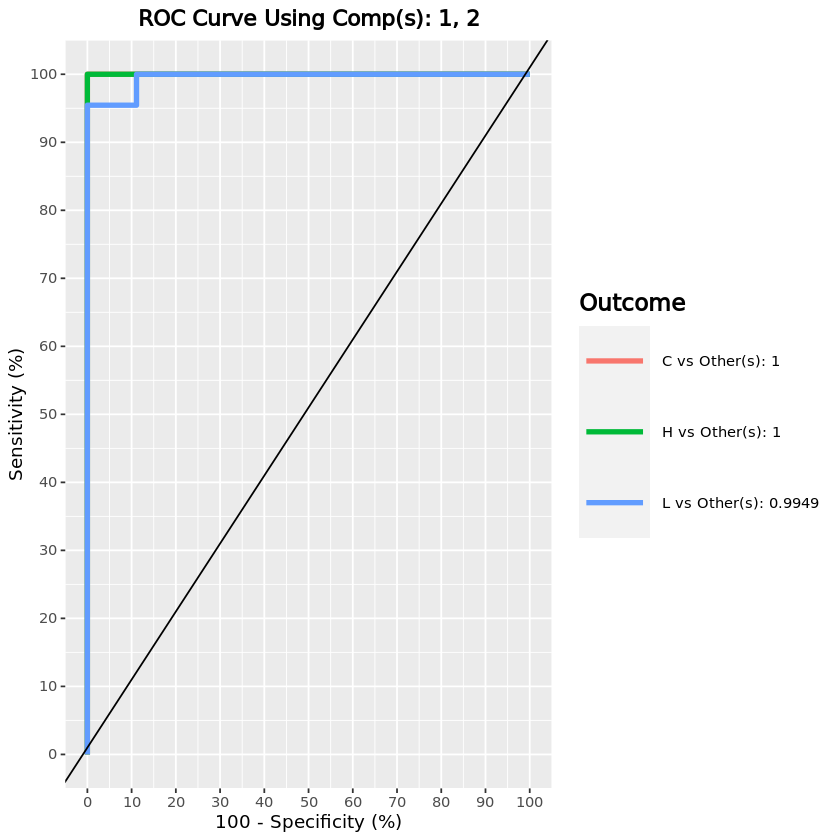

In [95]:
F0.pfam.auc.splsda = auroc(final.splsda.pfam.F0, roc.comp = 2, print = T) # AUROC for the first component

#### pfams - F0 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [3]:
pfam.F0_2 <- list()
F0_info_2 <- info[rownames(pfam.F0$cov),]
F0_info_2$treatment <- gsub(x = F0_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
pfam.F0_2$cov <- pfam.F0$cov[rownames(F0_info_2),]
pfam.F0_2$filtered <- pfam.F0$filtered[rownames(F0_info_2),]

pfam.F0_2$clr <- pfam.F0$clr[rownames(F0_info_2), ]
X.pfam.F0_2 <- pfam.F0_2$clr

pfam.F0_2$treatment <- factor(F0_info_2[rownames(pfam.F0_2$clr), "treatment"])

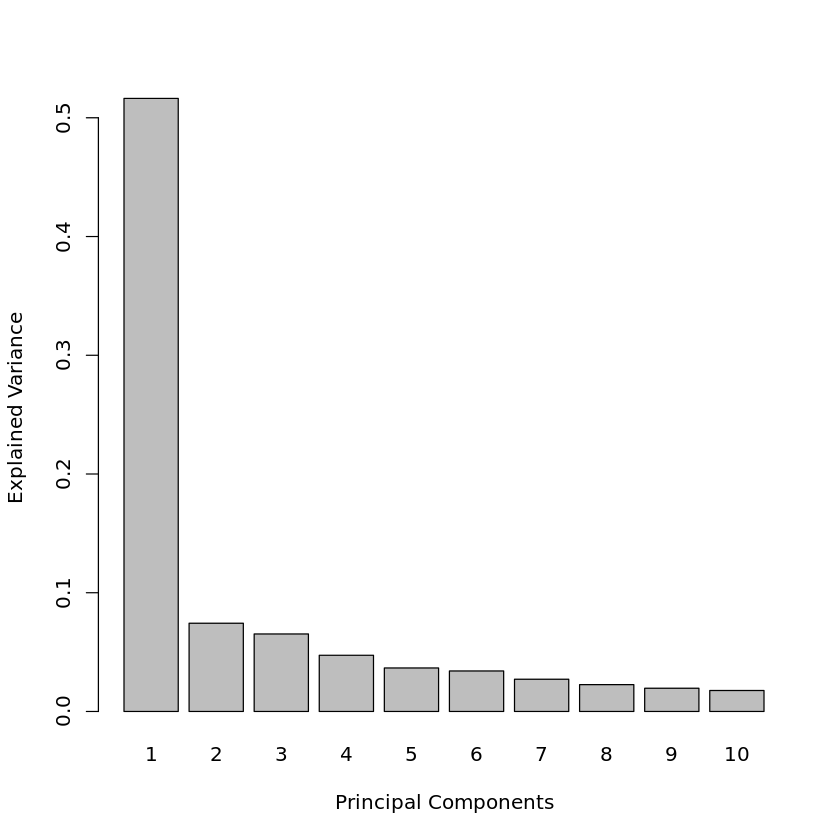

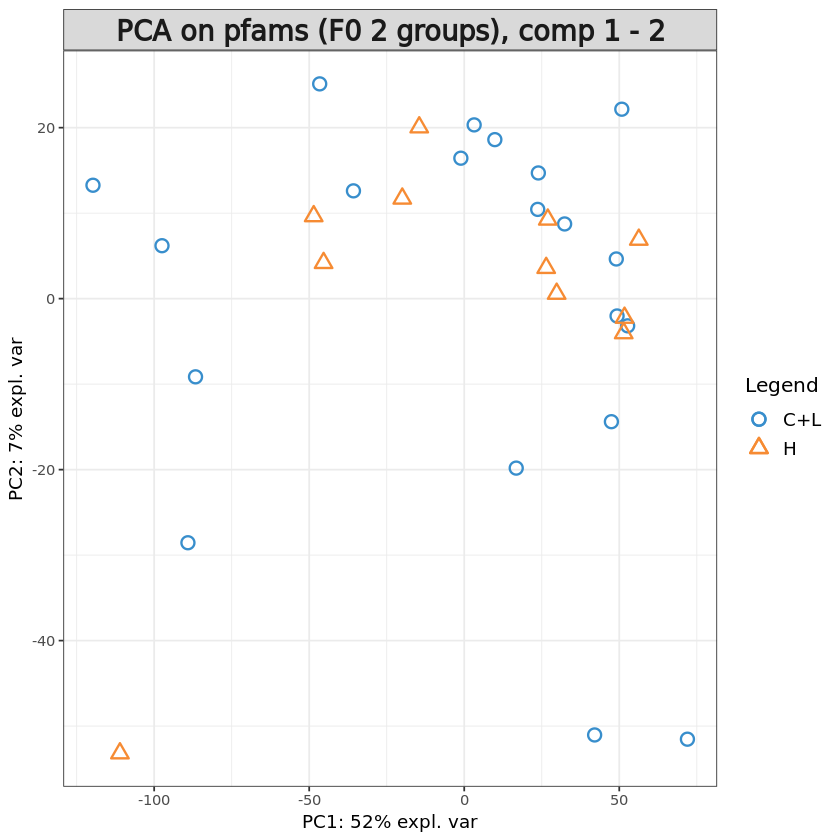

In [4]:
pca.pfam.F0_2 = pca(X.pfam.F0_2, ncomp = 10, center = TRUE, scale = TRUE) 

plot(pca.pfam.F0_2)
plotIndiv(pca.pfam.F0_2, group = pfam.F0_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on pfams (F0 2 groups), comp 1 - 2')

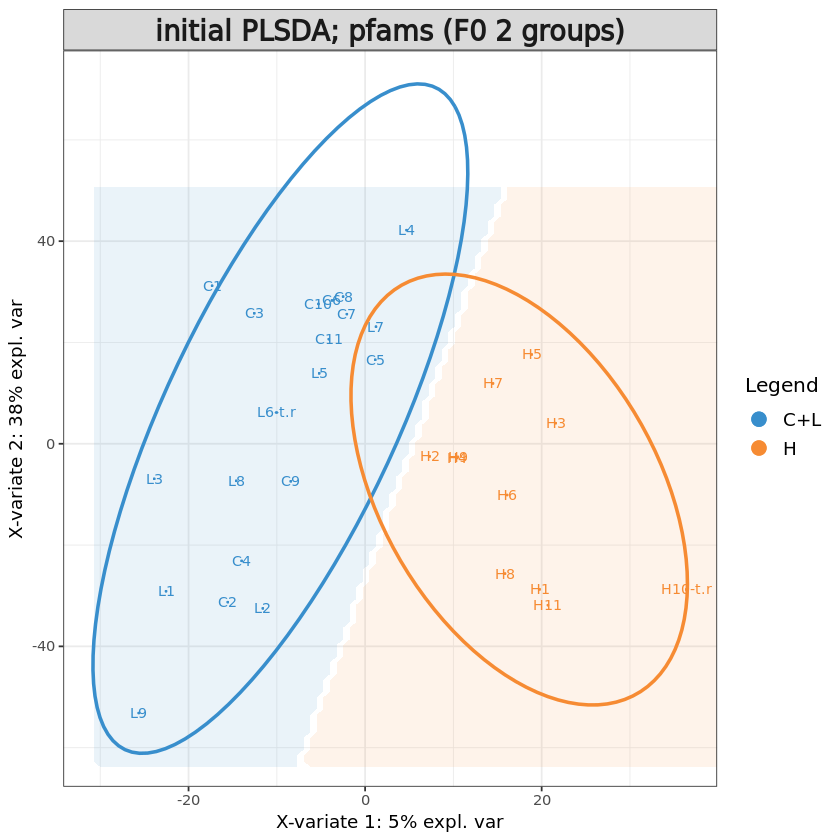

In [5]:
# Initial sPLS-DA model
pfam.F0_2.splsda <- splsda(X.pfam.F0_2, pfam.F0_2$treatment, ncomp = 10)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(pfam.F0_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(pfam.F0_2.splsda, comp = 1:2, ellipse = TRUE,
          group = pfam.F0_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; pfams (F0 2 groups)")

The initial model separates the two treatment groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,5,5,5
BER,5,5,5


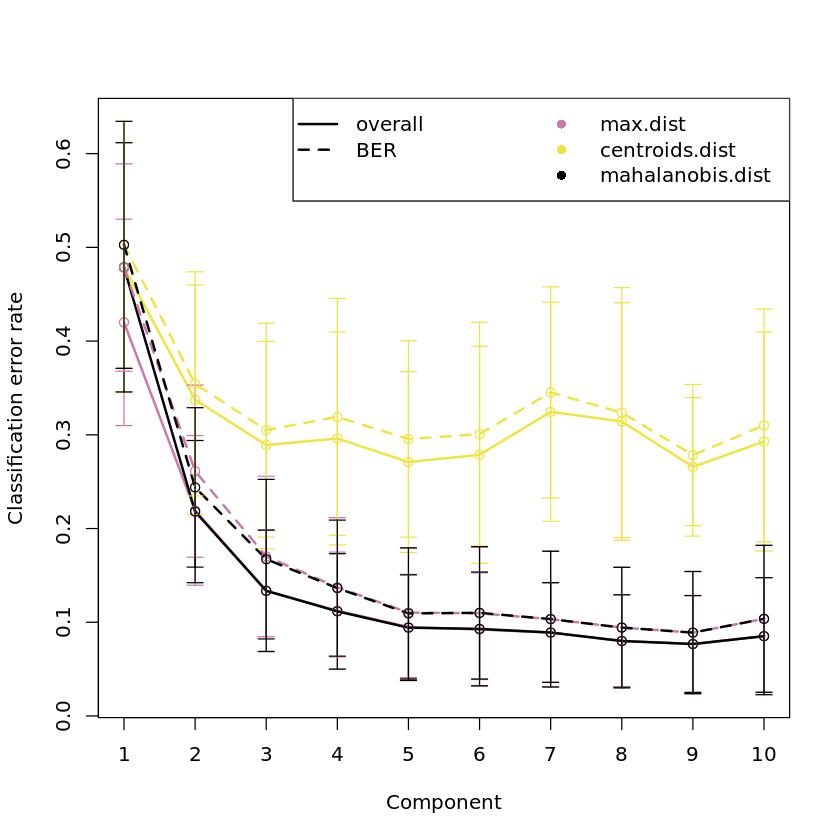

In [6]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.pfam.F0_2 <- perf(pfam.F0_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.pfam.F0_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.pfam.F0_2$choice.ncomp # what is the optimal value of components according to perf()

We set number of components to 3 and tune number of features used.

In [8]:
# Define parameters for tuning keepX
pfam.F0_2.step <- 0.05
pfam.F0_2.ncomp.tune <- 5
# grid of possible keepX values that will be tested for each component
pfam.F0_2.keepx <- c(seq(10, 200, 20), seq(ceiling(dim(pfam.F0$filtered)[2] * pfam.F0.step), 
                      round(dim(pfam.F0$filtered)[2], digits = -1), 
                      ceiling(dim(pfam.F0$filtered)[2] * pfam.F0.step)
                     )
                 )
pfam.F0_2.keepx

[1]   10   30   50   70   90  110  130  150  170  190  300  600  900 1200 1500
[16] 1800 2100 2400 2700 3000 3300 3600 3900 4200 4500 4800 5100 5400 5700 6000

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


[1] 4

comp1 comp2 comp3 comp4 comp5 
   50   150  1200    10    10

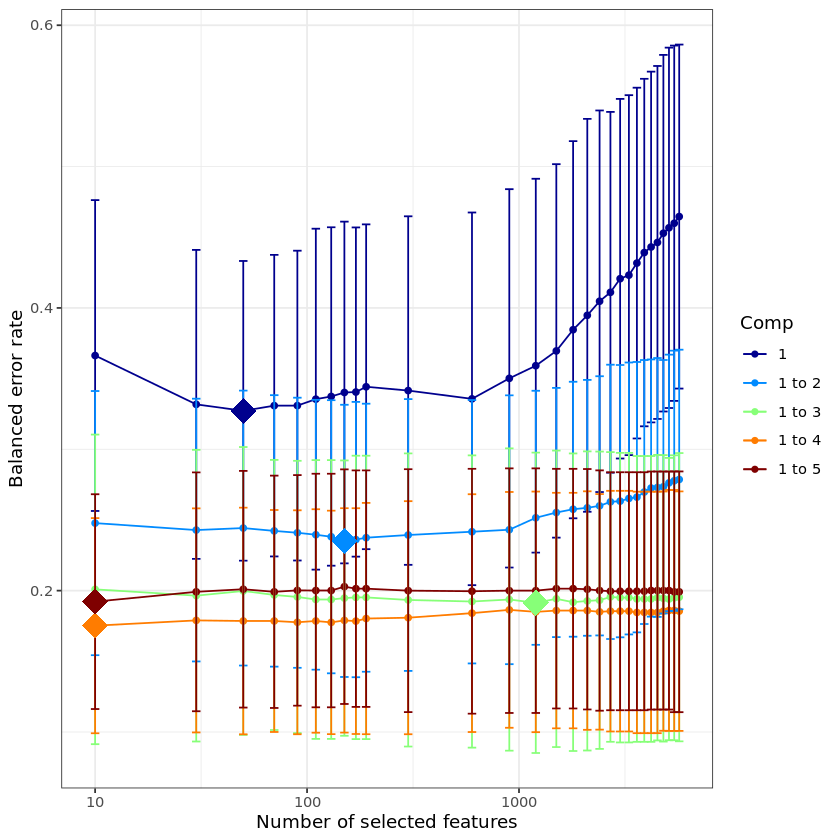

In [9]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.pfam.F0_2 <- tune.splsda(X.pfam.F0_2, pfam.F0_2$treatment, ncomp = pfam.F0_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = pfam.F0_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.pfam.F0_2, col = color.jet(pfam.F0_2.ncomp.tune))

tune.splsda.pfam.F0_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.pfam.F0_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

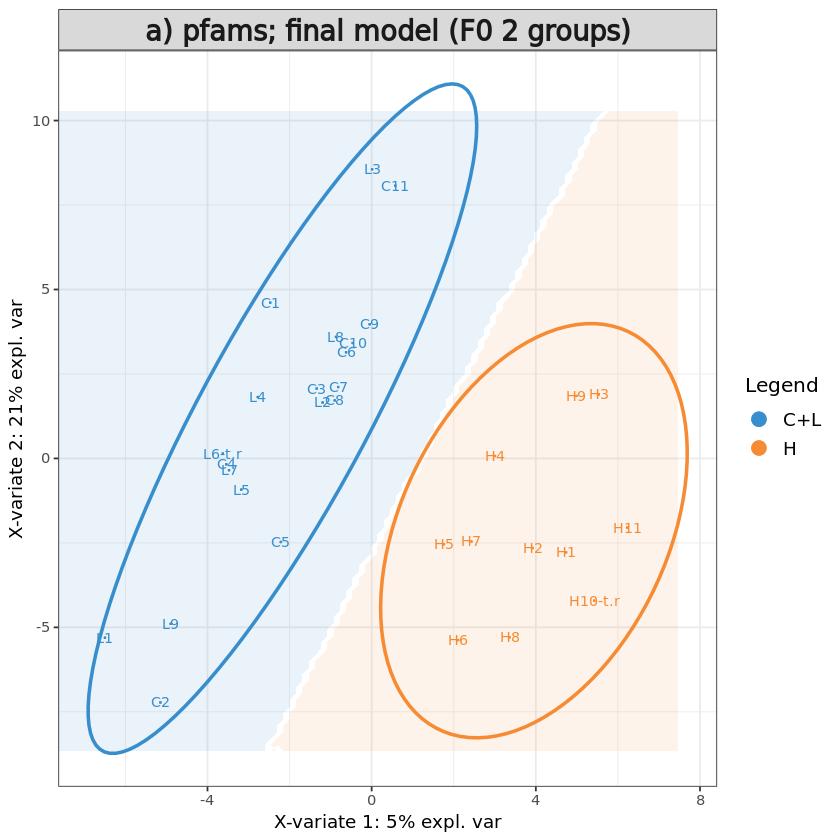

In [10]:
# Define final model
pfam.F0_2$optimal.ncomp <- 4
#pfam.F0_2$optimal.keepX <- tune.splsda.pfam.F0_2$choice.keepX[1:pfam.F0_2$optimal.ncomp]
pfam.F0_2$optimal.keepX <- rep(50, pfam.F0_2$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.pfam.F0_2 <- splsda(X.pfam.F0_2, pfam.F0_2$treatment, 
                       ncomp = pfam.F0_2$optimal.ncomp, 
                       keepX = pfam.F0_2$optimal.keepX)

background = background.predict(final.splsda.pfam.F0_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.pfam.F0_2, comp = 1:2, 
          group = pfam.F0_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) pfams; final model (F0 2 groups)')

# save sample variates
data <- as.data.frame(final.splsda.pfam.F0$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F0_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

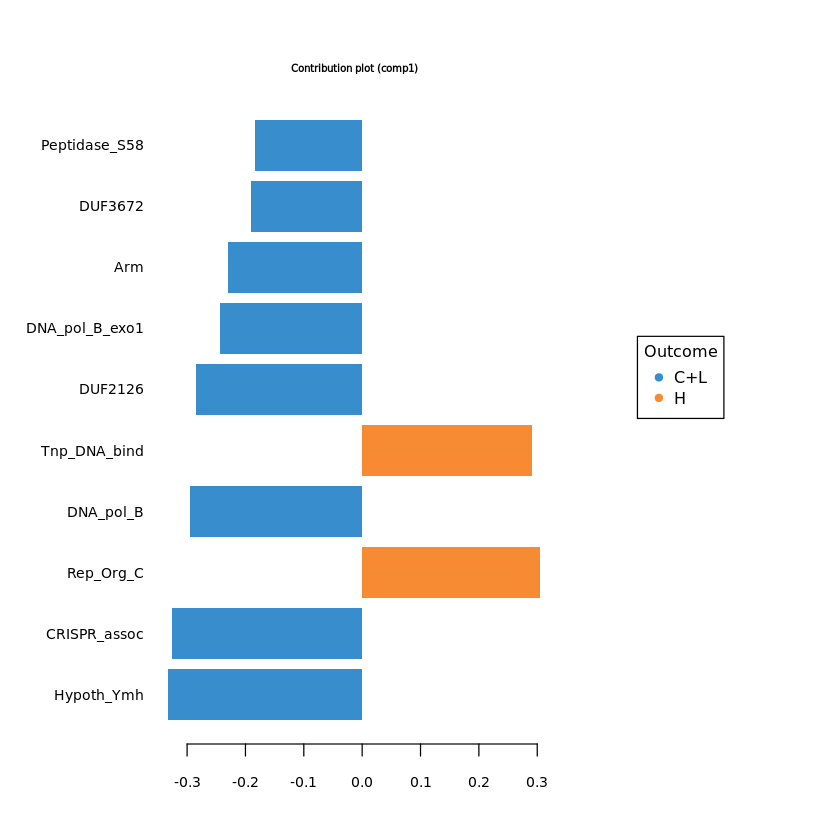

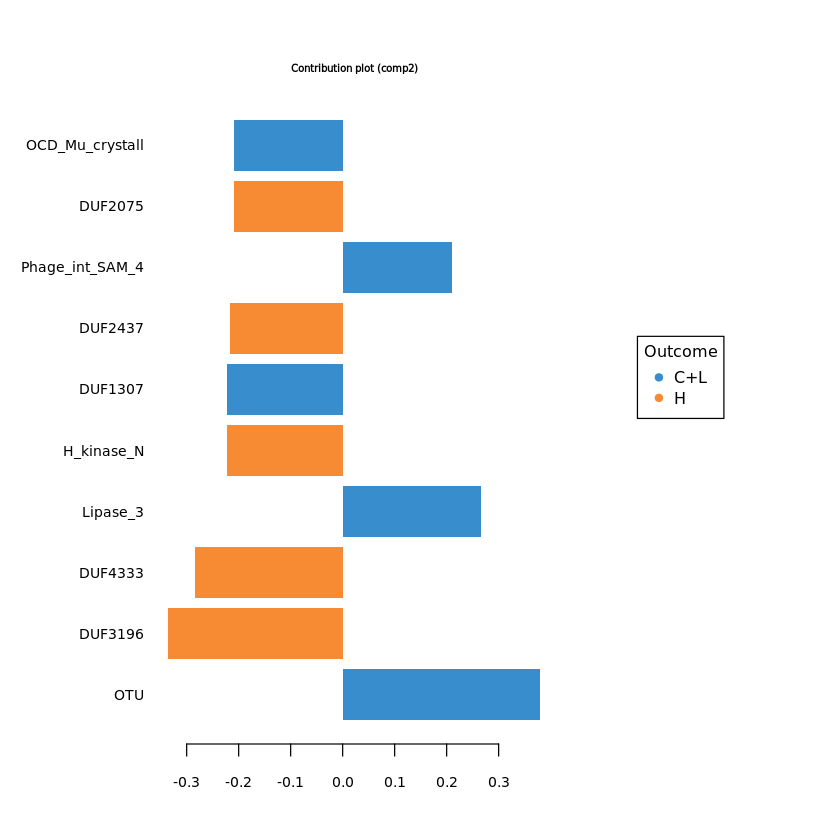

In [12]:
#plotVar(final.splsda.pfam.F0_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.pfam.F0_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.pfam.F0_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)
# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.pfam.F0_2, comp=1)$value
load_comp2 = selectVar(final.splsda.pfam.F0_2, comp=2)$value
F0_2.pfam.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F0_2.pfam.load) <- F0_2.pfam.load[,"Row.names"]
colnames(F0_2.pfam.load) <- c("ft","loading_comp1","loading_comp2")
F0_2.pfam.load = F0_2.pfam.load[,c("loading_comp1","loading_comp2")]

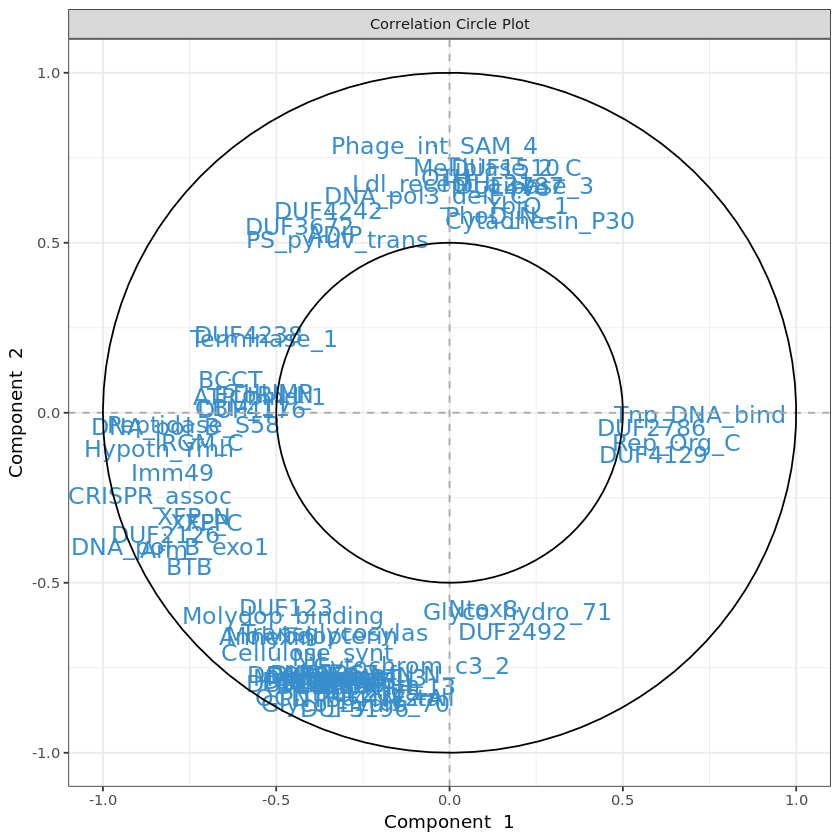

In [13]:
# plot feature correlation
plotVar(final.splsda.pfam.F0_2, cutoff=0.5)
pfam.F0_2.corr <- as.data.frame(plotVar(final.splsda.pfam.F0_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
pfam.F0_2.corr <- pfam.F0_2.corr[, c("x","y")]
colnames(pfam.F0_2.corr) <- c("corr_comp1","corr_comp2")

In [14]:
# Calculate feature stability
perf.splsda.pfam.F0_2 <- perf(final.splsda.pfam.F0_2, 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F0_2.pfam.stab <- merge(data.frame(perf.splsda.pfam.F0_2$features$stable$comp1), 
                  data.frame(perf.splsda.pfam.F0_2$features$stable$comp2), by="Var1", all=T)
rownames(F0_2.pfam.stab) <- F0_2.pfam.stab$Var1
F0_2.pfam.stab <- F0_2.pfam.stab[, c("Freq.x","Freq.y")]
colnames(F0_2.pfam.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%


In [15]:
# merge feature output
F0_2.pfam.out <- merge(F0_2.pfam.load, F0_2.pfam.stab, by="row.names")
rownames(F0_2.pfam.out) <- F0_2.pfam.out[,"Row.names"]
F0_2.pfam.out <- merge(F0_2.pfam.out[, 2:ncol(F0_2.pfam.out)], pfam.F0_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F0_2.features.tsv", F0_2.pfam.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [16]:
train <- sample(1:nrow(X.pfam.F0_2), ceiling(nrow(X.pfam.F0_2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.pfam.F0_2), train) # rest is part of the test set

# store matrices into training and test set:
X.pfam.F0_2.train <- X.pfam.F0_2[train, ]
X.pfam.F0_2.test <- X.pfam.F0_2[test,]
Y.pfam.F0_2.train <- F0_info_2[train,"treatment"]
Y.pfam.F0_2.test <- F0_info_2[test, "treatment"]
train.splsda.pfam.F0_2 <- splsda(X.pfam.F0_2.train, Y.pfam.F0_2.train, ncomp = pfam.F0_2$optimal.ncomp, keepX = pfam.F0_2$optimal.keepX)
predict.splsda.pfam.F0_2 <- predict(train.splsda.pfam.F0_2, X.pfam.F0_2.test, 
                                dist = "max.dist")
predict.comp2.pfam.F0_2 <- predict.splsda.pfam.F0_2$class$max.dist[,2]
table(factor(predict.comp2.pfam.F0_2, levels = levels(pfam.F0_2$treatment)), Y.pfam.F0_2.test)

     Y.pfam.F0_2.test
      C+L  H
  C+L  12  6
  H     4  1

$Comp1
         AUC   p-value
C+L vs H   1 5.586e-06

$Comp2
         AUC   p-value
C+L vs H   1 5.586e-06

$Comp3
         AUC   p-value
C+L vs H   1 5.586e-06

$Comp4
         AUC   p-value
C+L vs H   1 5.586e-06



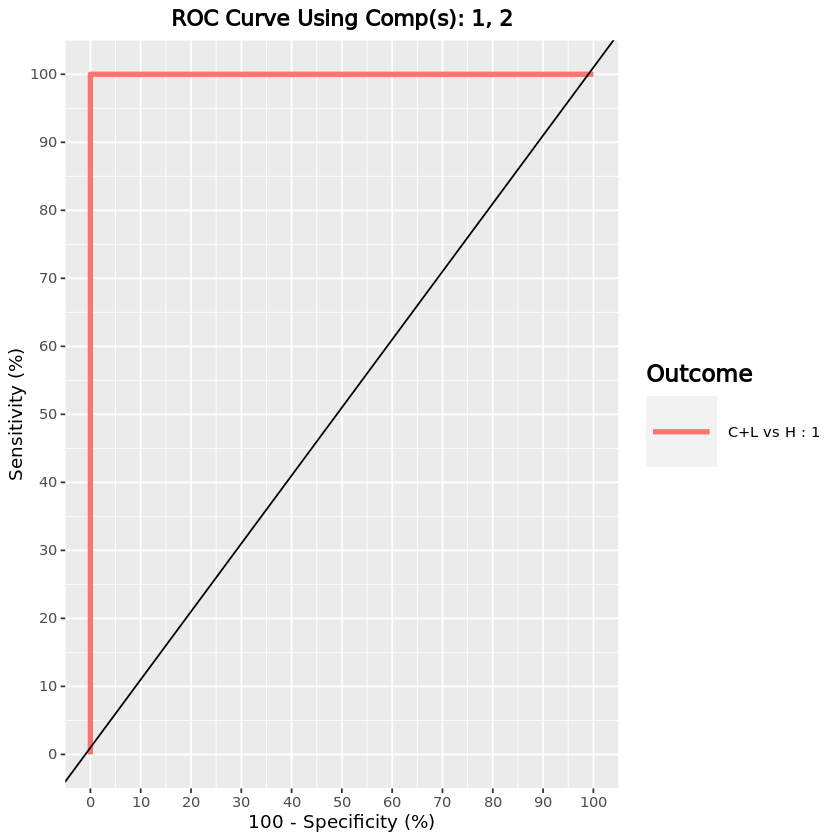

In [17]:
F0_2.pfam.auc.splsda = auroc(final.splsda.pfam.F0_2, roc.comp = 2, print = T) # AUROC for the first component

#### pfams - F1 generation

[1] "1454"          "pfams removed" "5909"          "remaining"

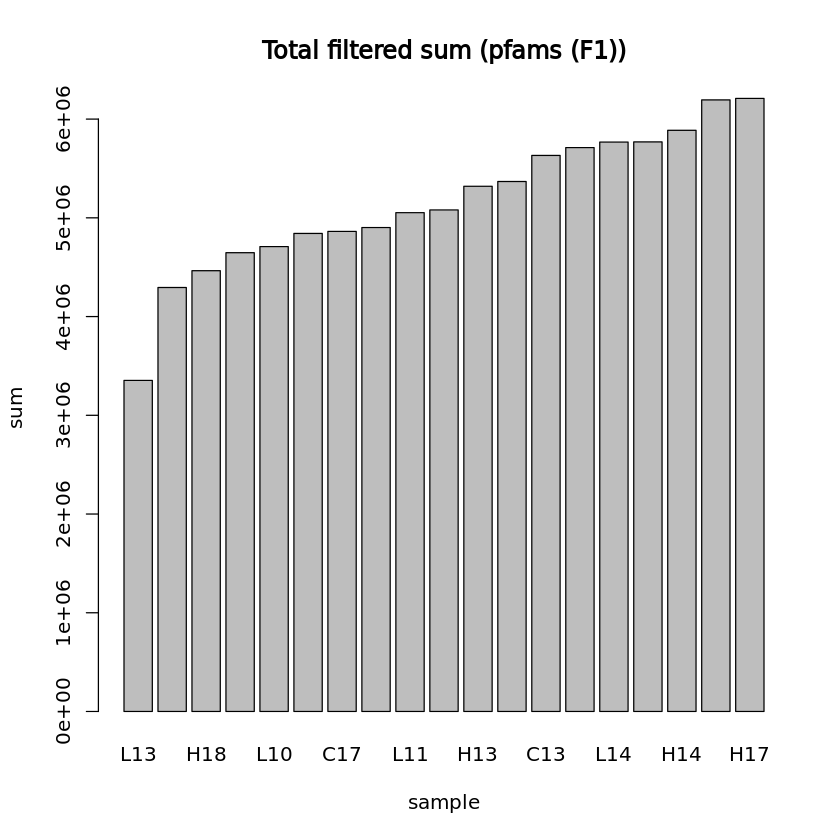

In [18]:
## PARAMS ##
# Initial components
pfam.F1.ncomp <- 5
# Percentage of samples in which features must have >0 sum
pfam.F1.percent_occ <- 10
# Quantile used for removing low abundance features
pfam.F1.quantile_thresh <- 0.1
generation <- "F1"

pfam.F1 <- list()
pfam.F1$cov <- pfam$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(pfam.F1$cov[, colSums(pfam.F1$cov) > 0])
pfam.F1$nz <- pfam.F1$cov[, colnames(pfam.F1$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(pfam.F1$nz) / sum(colSums(pfam.F1$nz)) * 100, probs = pfam.F1.quantile_thresh)
pfam.F1$filtered <- low.count.removal(pfam.F1$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
pfam.F1$occ <- colSums(pfam.F1$filtered>0) / nrow(pfam.F1$filtered) * 100
# Keep features occurring in defined percentage of samples
pfam.F1$filtered <- pfam.F1$filtered[, which(pfam.F1$occ >= pfam.F1.percent_occ)]

#pfam.F1$filtered <- pfam.F1$filtered[,-nearZeroVar(pfam.F1$filtered)$Position]
paste0(c(dim(pfam.F1$cov)[2] - dim(pfam.F1$filtered)[2], "pfams removed", dim(pfam.F1$filtered)[2], "remaining"))

# Add offset
pfam.F1$offset <- pfam.F1$filtered + 1
pfam.F1$clr <- logratio.transfo(pfam.F1$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.pfam.F1 <- pfam.F1$clr

pfam.F1$treatment <- factor(info[rownames(pfam.F1$clr), "Treatment"])
pfam.F1.lib.size <- apply(pfam.F1$filtered, 1, sum) # determine total count for each sample
barplot(sort(pfam.F1.lib.size), main="Total filtered sum (pfams (F1))", ylab="sum", xlab="sample")

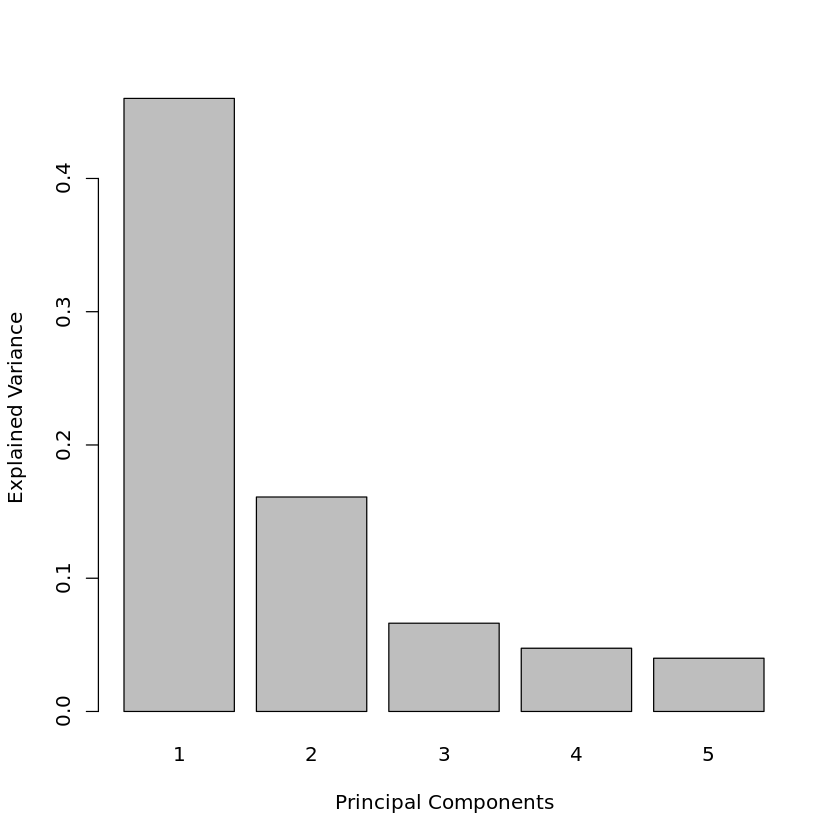

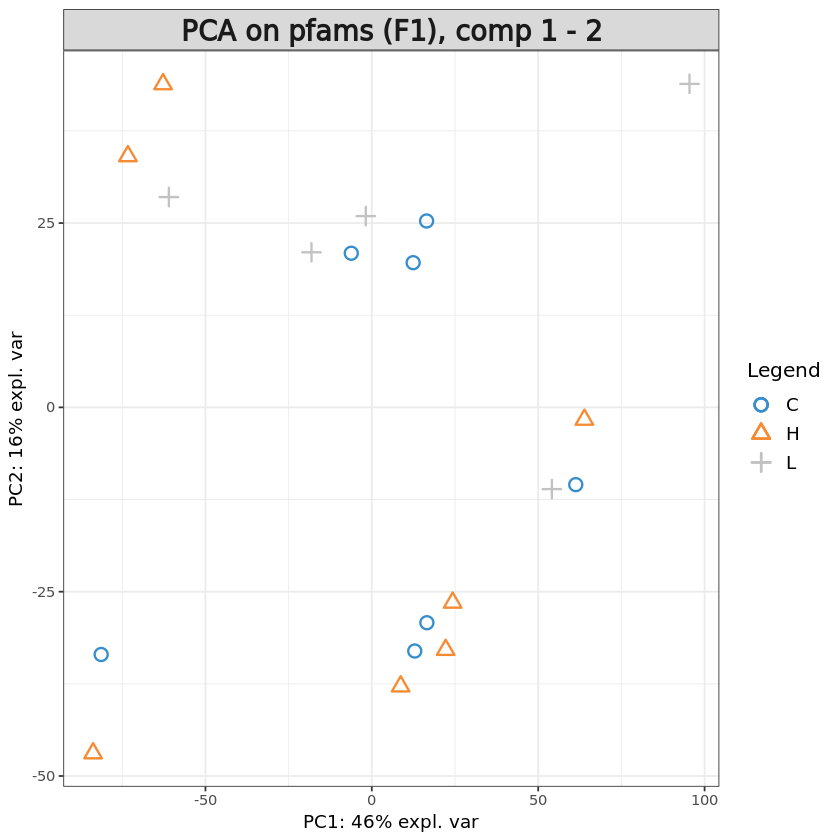

In [19]:
pca.pfam.F1 = pca(X.pfam.F1, ncomp = pfam.F1.ncomp, center = TRUE, scale = TRUE) 

plot(pca.pfam.F1)
plotIndiv(pca.pfam.F1, group = pfam.F1$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on pfams (F1), comp 1 - 2')

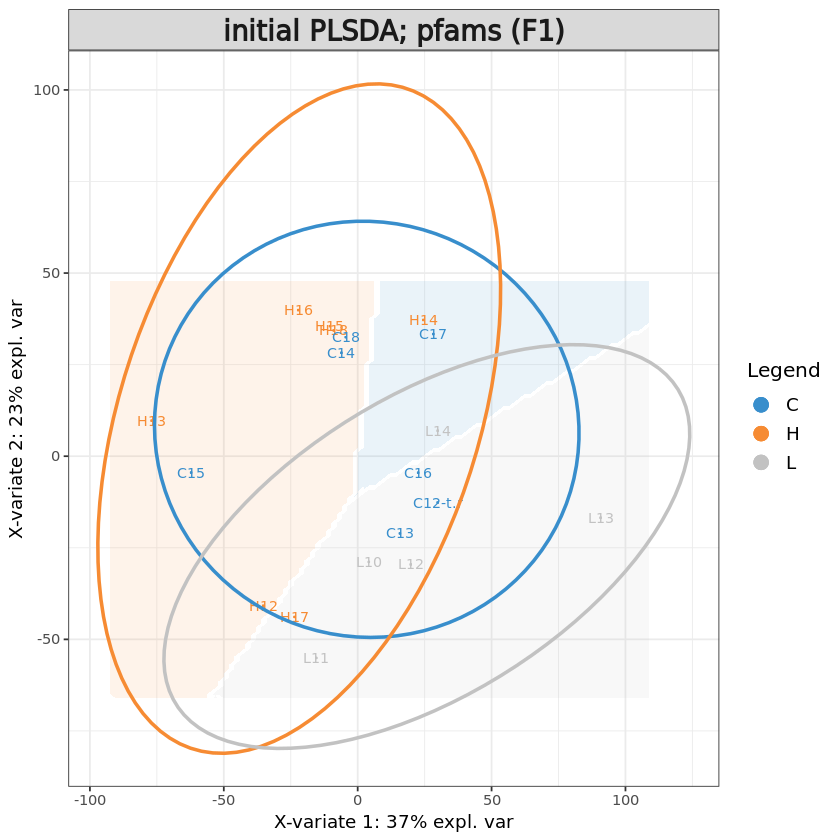

In [20]:
# Initial sPLS-DA model
pfam.F1.splsda <- splsda(X.pfam.F1, pfam.F1$treatment, ncomp = pfam.F1.ncomp)  # set ncomp to 10 for performance assessment later

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(pfam.F1.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(pfam.F1.splsda, comp = 1:2, ellipse = TRUE,
          group = pfam.F1$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; pfams (F1)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,3,5,3
BER,3,5,3


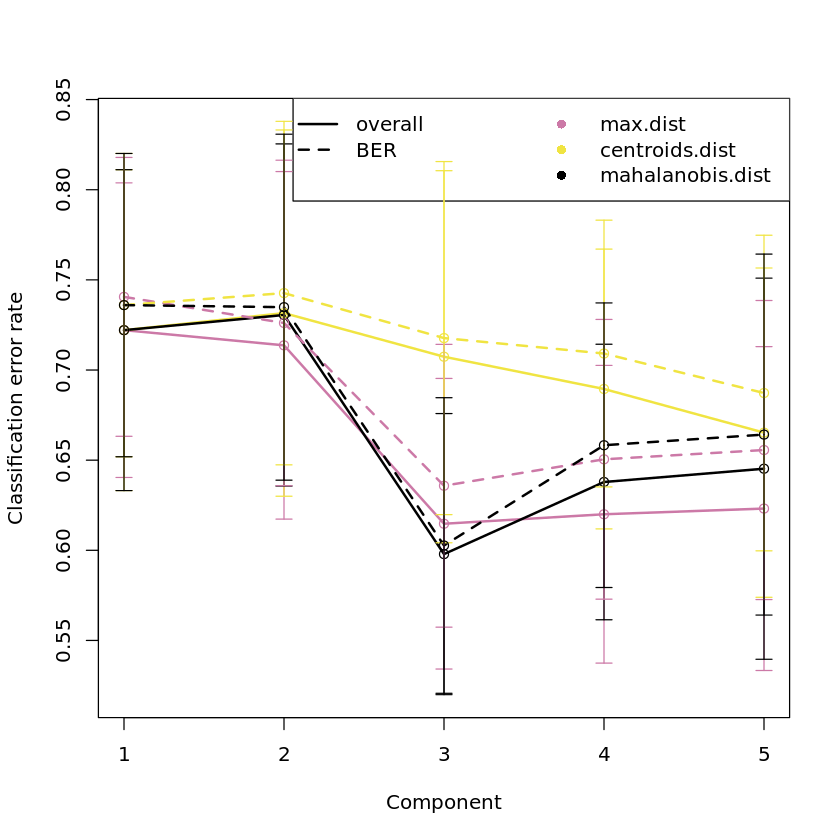

In [21]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.pfam.F1 <- perf(pfam.F1.splsda, validation = "Mfold", 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.pfam.F1, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.pfam.F1$choice.ncomp # what is the optimal value of components according to perf()

For pfams in the F1 generation there appears to be no gain in accuracy when increasing components.

In [23]:
# Define parameters for tuning keepX
pfam.F1.step <- 0.05
pfam.F1.ncomp.tune <- 3
# grid of possible keepX values that will be tested for each component
pfam.F1.keepx <- c(seq(10, 250, 10), seq(ceiling(dim(pfam.F1$filtered)[2] * pfam.F1.step), 
                      round(dim(pfam.F1$filtered)[2], digits = -1), 
                      ceiling(dim(pfam.F1$filtered)[2] * pfam.F1.step)
                     )
                 )
pfam.F1.keepx

[1]   10   20   30   40   50   60   70   80   90  100  110  120  130  140  150
[16]  160  170  180  190  200  210  220  230  240  250  296  592  888 1184 1480
[31] 1776 2072 2368 2664 2960 3256 3552 3848 4144 4440 4736 5032 5328 5624

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


[1] 1

comp1 comp2 comp3 
   30    30   130

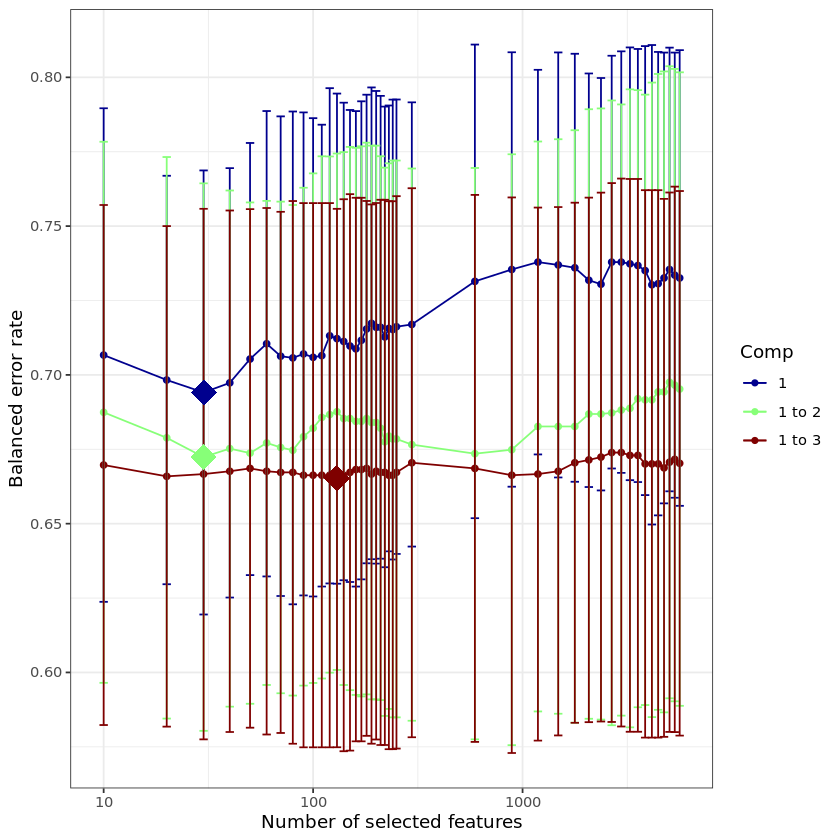

In [24]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.pfam.F1 <- tune.splsda(X.pfam.F1, pfam.F1$treatment, ncomp = pfam.F1.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = pfam.F1.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.pfam.F1, col = color.jet(pfam.F1.ncomp.tune))

tune.splsda.pfam.F1$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.pfam.F1$choice.keepX # what are the optimal values of variables according to tune.splsda()

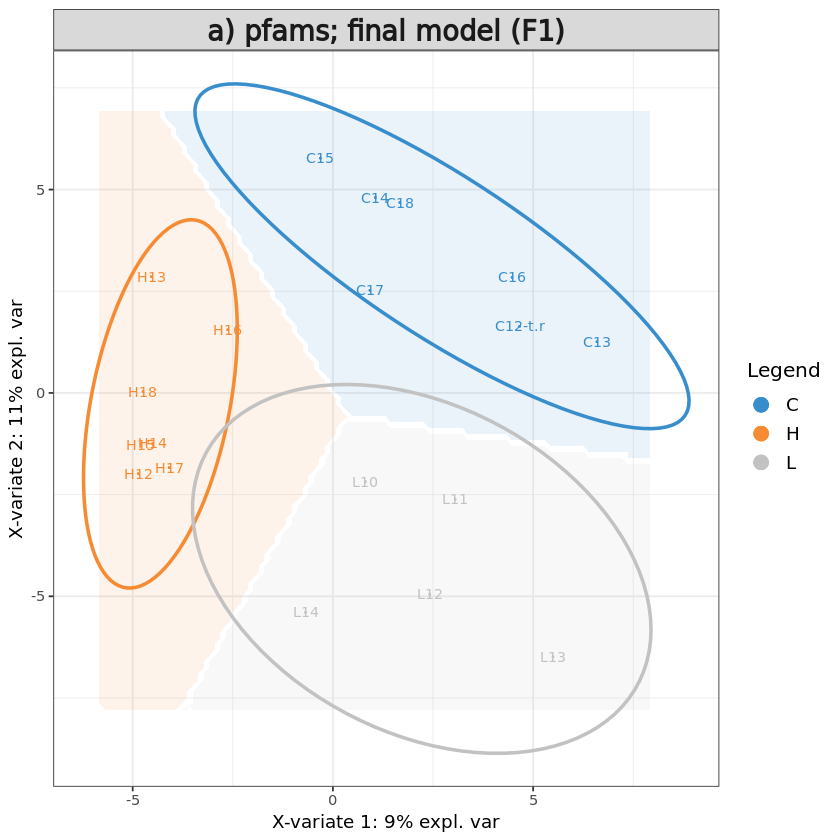

In [25]:
# Define final model
pfam.F1$optimal.ncomp <- 3
#pfam.F1$optimal.keepX <- tune.splsda.pfam.F1$choice.keepX[1:pfam.F1$optimal.ncomp]
pfam.F1$optimal.keepX <- rep(50, pfam.F1$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.pfam.F1 <- splsda(X.pfam.F1, pfam.F1$treatment, 
                       ncomp = pfam.F1$optimal.ncomp, 
                       keepX = pfam.F1$optimal.keepX)

background = background.predict(final.splsda.pfam.F1, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.pfam.F1, comp = 1:2, 
          group = pfam.F1$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) pfams; final model (F1)')

# save sample variates
data <- as.data.frame(final.splsda.pfam.F1$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F1.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

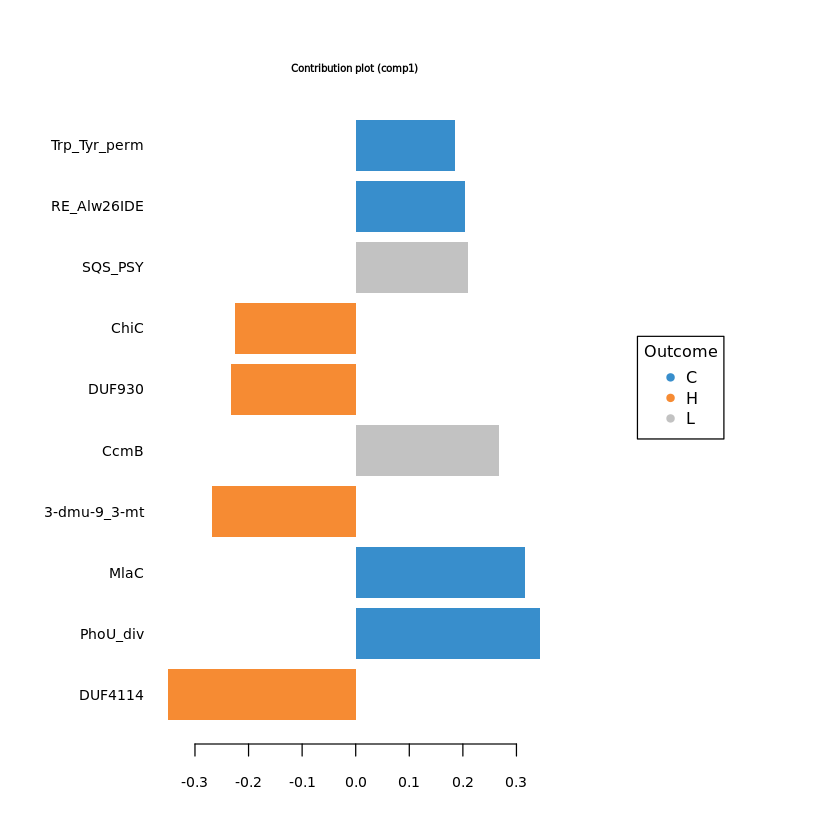

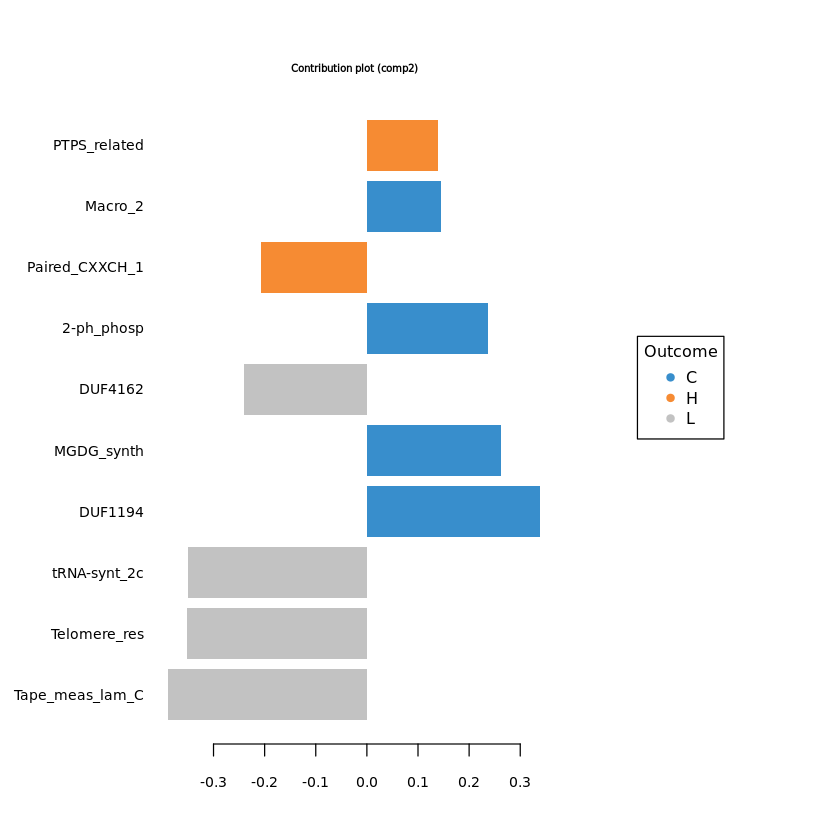

In [26]:
#plotVar(final.splsda.pfam.F1, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.pfam.F1, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.pfam.F1, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.pfam.F1, comp=1)$value
load_comp2 = selectVar(final.splsda.pfam.F1, comp=2)$value
F1.pfam.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F1.pfam.load) <- F1.pfam.load[,"Row.names"]
colnames(F1.pfam.load) <- c("ft","loading_comp1","loading_comp2")
F1.pfam.load = F1.pfam.load[,c("loading_comp1","loading_comp2")]

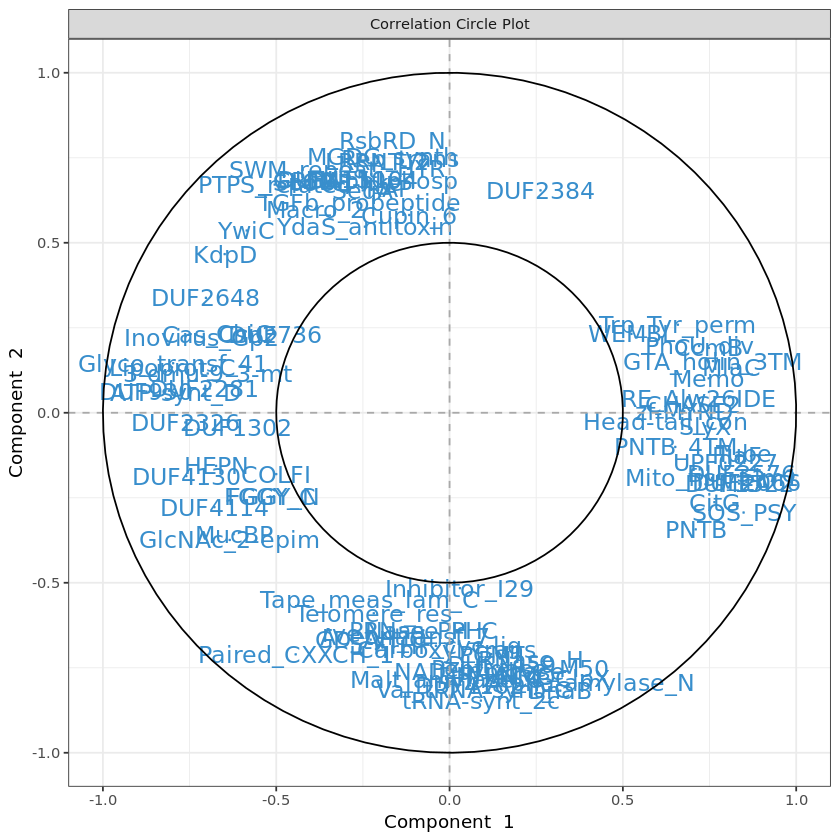

In [27]:
# plot feature correlation
plotVar(final.splsda.pfam.F1, cutoff=0.5)
pfam.F1.corr <- as.data.frame(plotVar(final.splsda.pfam.F1, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
pfam.F1.corr <- pfam.F1.corr[, c("x","y")]
colnames(pfam.F1.corr) <- c("corr_comp1","corr_comp2")

In [28]:
# Calculate feature stability
perf.splsda.pfam.F1 <- perf(final.splsda.pfam.F1, 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F1.pfam.stab <- merge(data.frame(perf.splsda.pfam.F1$features$stable$comp1), 
                  data.frame(perf.splsda.pfam.F1$features$stable$comp2), by="Var1", all=T)
rownames(F1.pfam.stab) <- F1.pfam.stab$Var1
F1.pfam.stab <- F1.pfam.stab[, c("Freq.x","Freq.y")]
colnames(F1.pfam.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


In [29]:
# merge feature output
F1.pfam.out <- merge(F1.pfam.load, F1.pfam.stab, by="row.names")
rownames(F1.pfam.out) <- F1.pfam.out[,"Row.names"]
F1.pfam.out <- merge(F1.pfam.out[, 2:ncol(F1.pfam.out)], pfam.F1.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F1.features.tsv", F1.pfam.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [30]:
train <- sample(1:nrow(X.pfam.F1), ceiling(nrow(X.pfam.F1)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.pfam.F1), train) # rest is part of the test set

# store matrices into training and test set:
X.pfam.F1.train <- X.pfam.F1[train, ]
X.pfam.F1.test <- X.pfam.F1[test,]
Y.pfam.F1.train <- info[train,"treatment"]
Y.pfam.F1.test <- info[test, "treatment"]
train.splsda.pfam.F1 <- splsda(X.pfam.F1.train, Y.pfam.F1.train, ncomp = pfam.F1$optimal.ncomp, keepX = pfam.F1$optimal.keepX)
predict.splsda.pfam.F1 <- predict(train.splsda.pfam.F1, X.pfam.F1.test, 
                                dist = "max.dist")
predict.comp2.pfam.F1 <- predict.splsda.pfam.F1$class$max.dist[,2]
table(factor(predict.comp2.pfam.F1, levels = levels(pfam.F1$treatment)), Y.pfam.F1.test)

   Y.pfam.F1.test
    C H L
  C 0 3 1
  H 1 3 2
  L 1 1 2

$Comp1
                 AUC   p-value
C vs Other(s) 0.8214 0.0224900
H vs Other(s) 1.0000 0.0003857
L vs Other(s) 0.7143 0.1649000

$Comp2
              AUC   p-value
C vs Other(s)   1 0.0003857
H vs Other(s)   1 0.0003857
L vs Other(s)   1 0.0011940

$Comp3
              AUC   p-value
C vs Other(s)   1 0.0003857
H vs Other(s)   1 0.0003857
L vs Other(s)   1 0.0011940



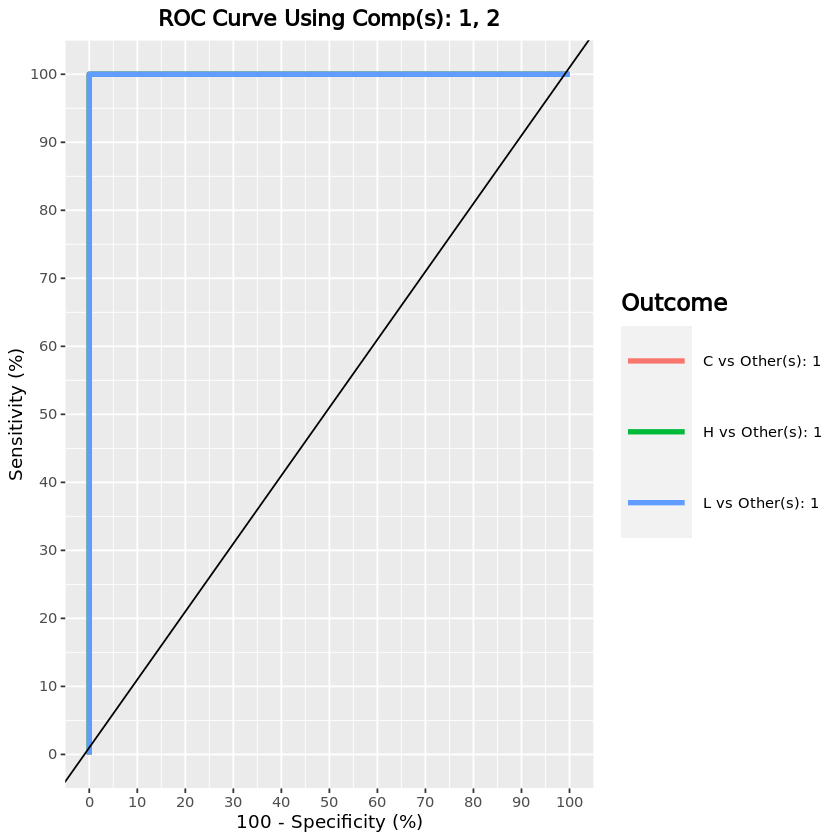

In [31]:
F1.pfam.auc.splsda = auroc(final.splsda.pfam.F1, roc.comp = 2, print = T) # AUROC for the first component

#### pfams - F1 generation (C+L vs H)

In [32]:
pfam.F1_2 <- list()
F1_info_3 <- info[rownames(pfam.F1$cov),]
F1_info_3$treatment <- gsub(x = F1_info_3$Treatment, pattern = "[CL]", replacement = "C+L")
pfam.F1_2$cov <- pfam.F1$cov[rownames(F1_info_3),]
pfam.F1_2$filtered <- pfam.F1$filtered[rownames(F1_info_3),]

pfam.F1_2$clr <- pfam.F1$clr[rownames(F1_info_3), ]
X.pfam.F1_2 <- pfam.F1_2$clr

pfam.F1_2$treatment <- factor(F1_info_3[rownames(pfam.F1_2$clr), "treatment"])

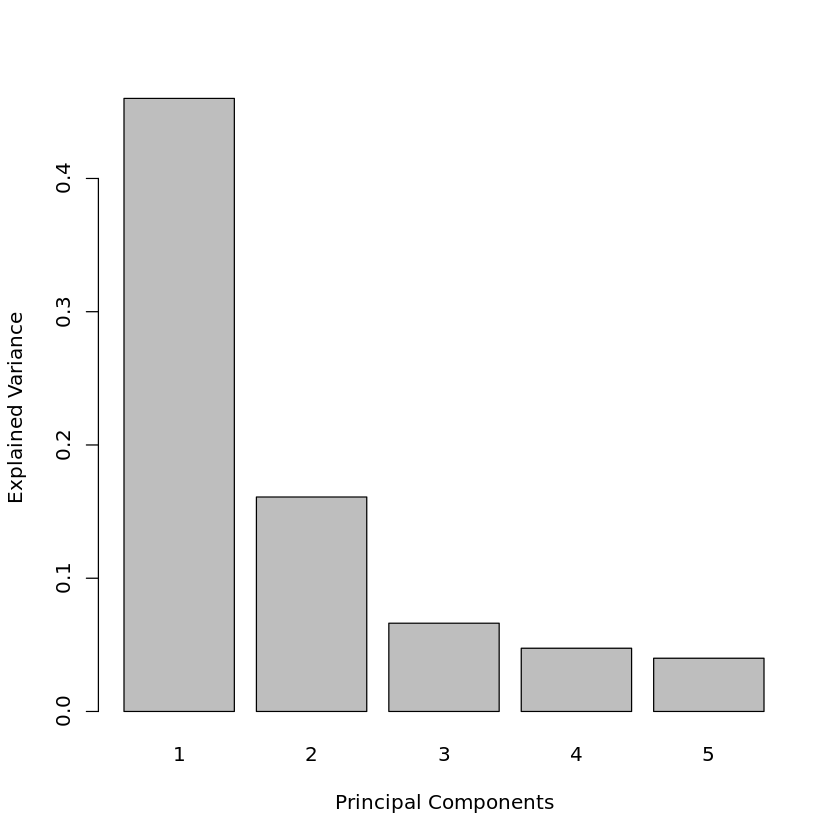

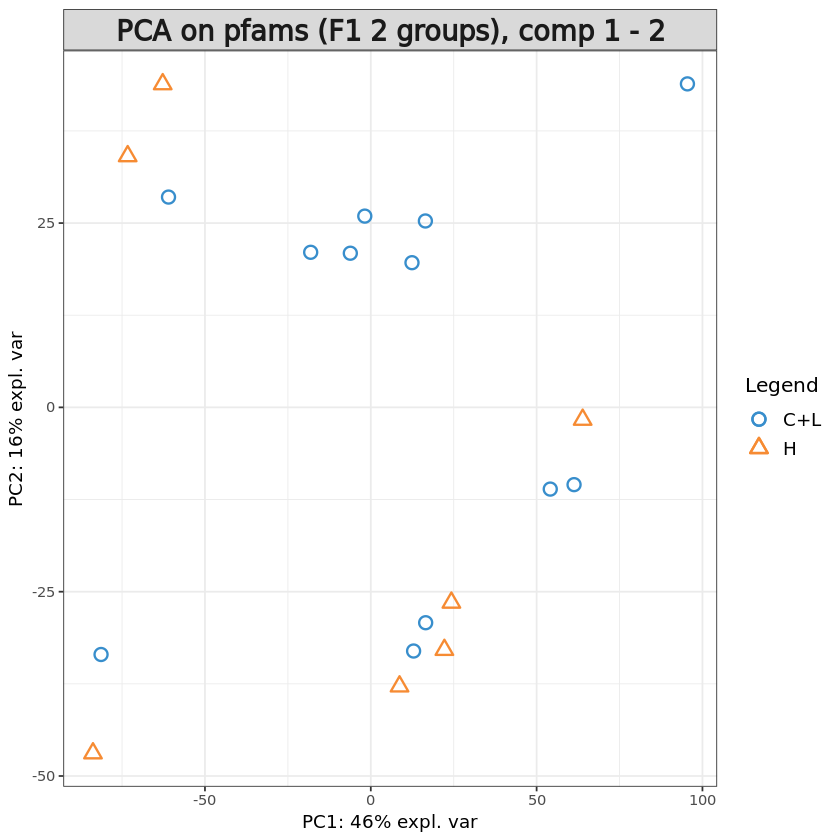

In [33]:
pca.pfam.F1_2 = pca(X.pfam.F1_2, ncomp = 5, center = TRUE, scale = TRUE) 

plot(pca.pfam.F1_2)
plotIndiv(pca.pfam.F1_2, group = pfam.F1_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on pfams (F1 2 groups), comp 1 - 2')

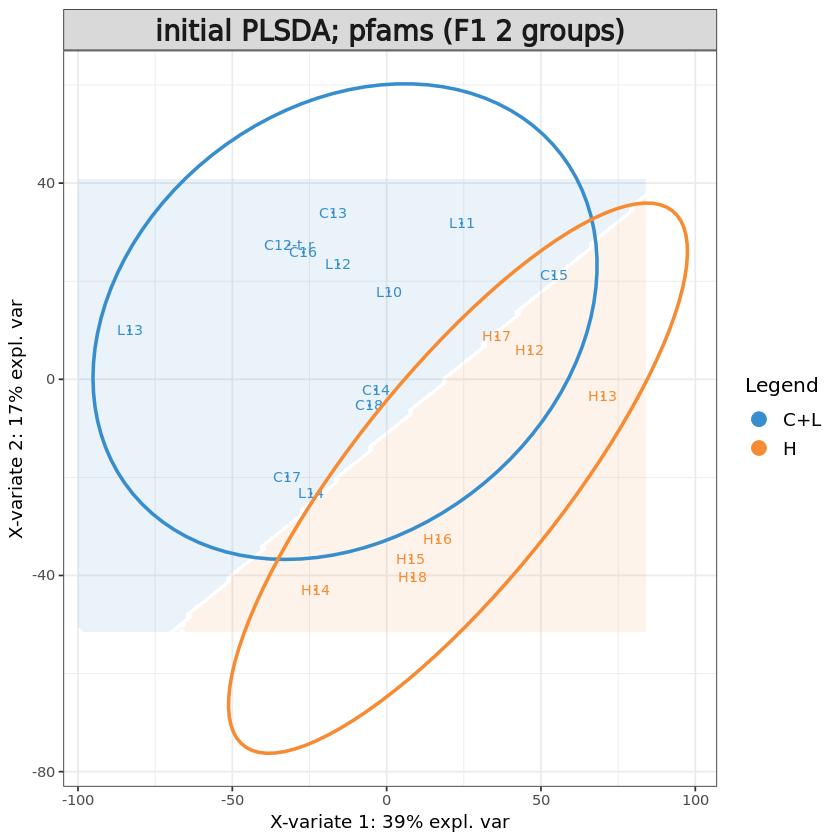

In [34]:
# Initial sPLS-DA model
pfam.F1_2.splsda <- splsda(X.pfam.F1_2, pfam.F1_2$treatment, ncomp = 5)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(pfam.F1_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(pfam.F1_2.splsda, comp = 1:2, ellipse = TRUE,
          group = pfam.F1_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; pfams (F1 2 groups)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,1,1,1
BER,1,1,1


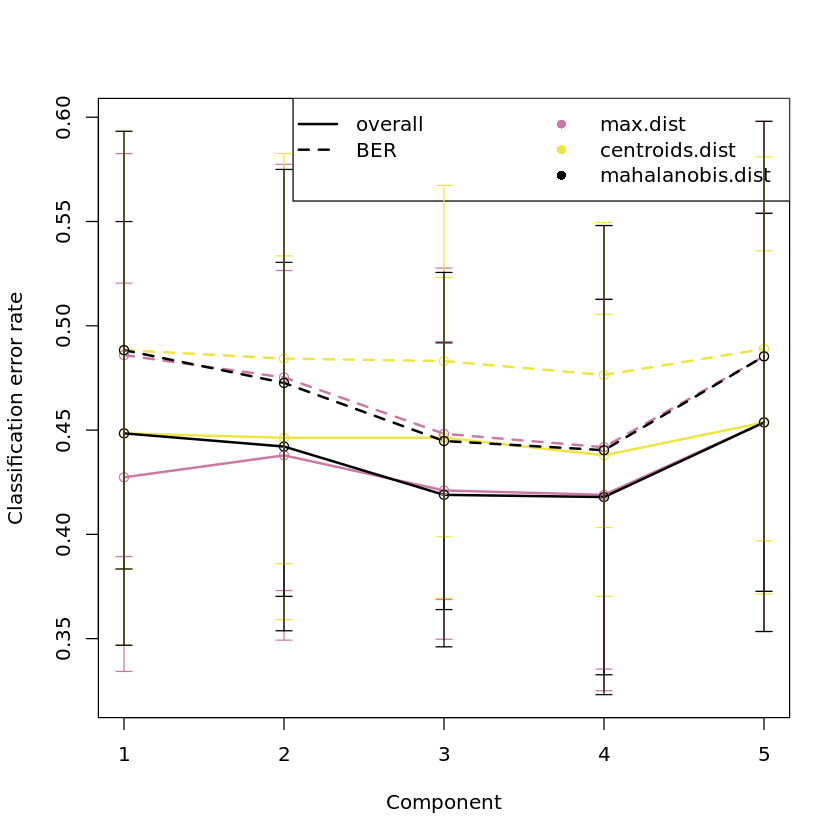

In [35]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.pfam.F1_2 <- perf(pfam.F1_2.splsda, validation = "Mfold", 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.pfam.F1_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.pfam.F1_2$choice.ncomp # what is the optimal value of components according to perf()

This shows a lower error rate, however still not great.

In [37]:
# Define parameters for tuning keepX
pfam.F1_2.step <- 0.05
pfam.F1_2.ncomp.tune <- 2
# grid of possible keepX values that will be tested for each component
pfam.F1_2.keepx <- c(seq(10, 250, 10), seq(ceiling(dim(pfam.F1_2$filtered)[2] * pfam.F1_2.step), 
                      round(dim(pfam.F1_2$filtered)[2], digits = -1), 
                      ceiling(dim(pfam.F1_2$filtered)[2] * pfam.F1_2.step)
                     )
                 )
pfam.F1_2.keepx

[1]   10   20   30   40   50   60   70   80   90  100  110  120  130  140  150
[16]  160  170  180  190  200  210  220  230  240  250  296  592  888 1184 1480
[31] 1776 2072 2368 2664 2960 3256 3552 3848 4144 4440 4736 5032 5328 5624

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


[1] 1

comp1 comp2 
   10   888

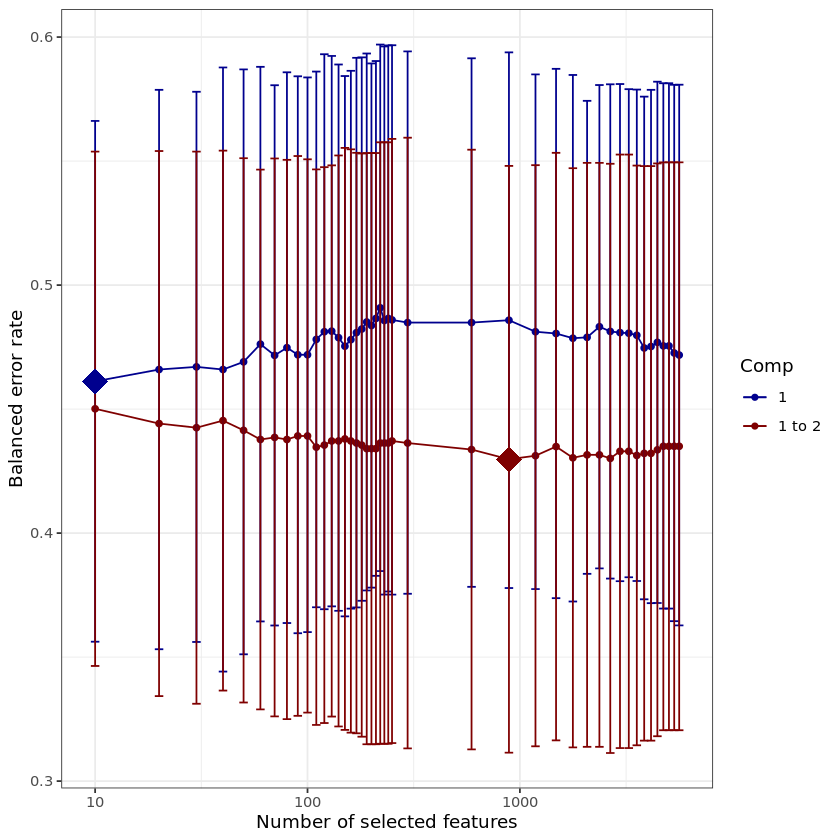

In [38]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.pfam.F1_2 <- tune.splsda(X.pfam.F1_2, pfam.F1_2$treatment, ncomp = pfam.F1_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = pfam.F1_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.pfam.F1_2, col = color.jet(pfam.F1_2.ncomp.tune))

tune.splsda.pfam.F1_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.pfam.F1_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

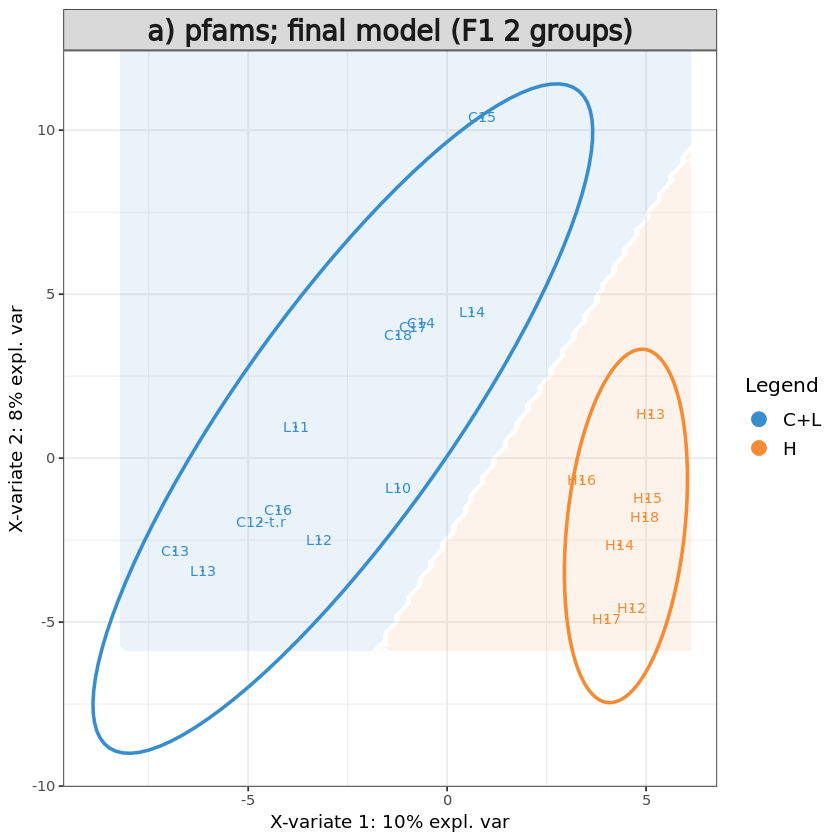

In [39]:
# Define final model
pfam.F1_2$optimal.ncomp <- 2
#pfam.F1_2$optimal.keepX <- tune.splsda.pfam.F1_2$choice.keepX[1:pfam.F1_2$optimal.ncomp]
pfam.F1_2$optimal.keepX <- rep(50, pfam.F1_2$optimal.ncomp)
#pfam.F1_2$optimal.keepX <- c(10, 50)

# form final model with optimised values for component, using all features
final.splsda.pfam.F1_2 <- splsda(X.pfam.F1_2, pfam.F1_2$treatment, 
                       ncomp = pfam.F1_2$optimal.ncomp, 
                       keepX = pfam.F1_2$optimal.keepX)

background = background.predict(final.splsda.pfam.F1_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.pfam.F1_2, comp = 1:2, 
          group = pfam.F1_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) pfams; final model (F1 2 groups)')

# save sample variates
data <- as.data.frame(final.splsda.pfam.F1$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F1_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

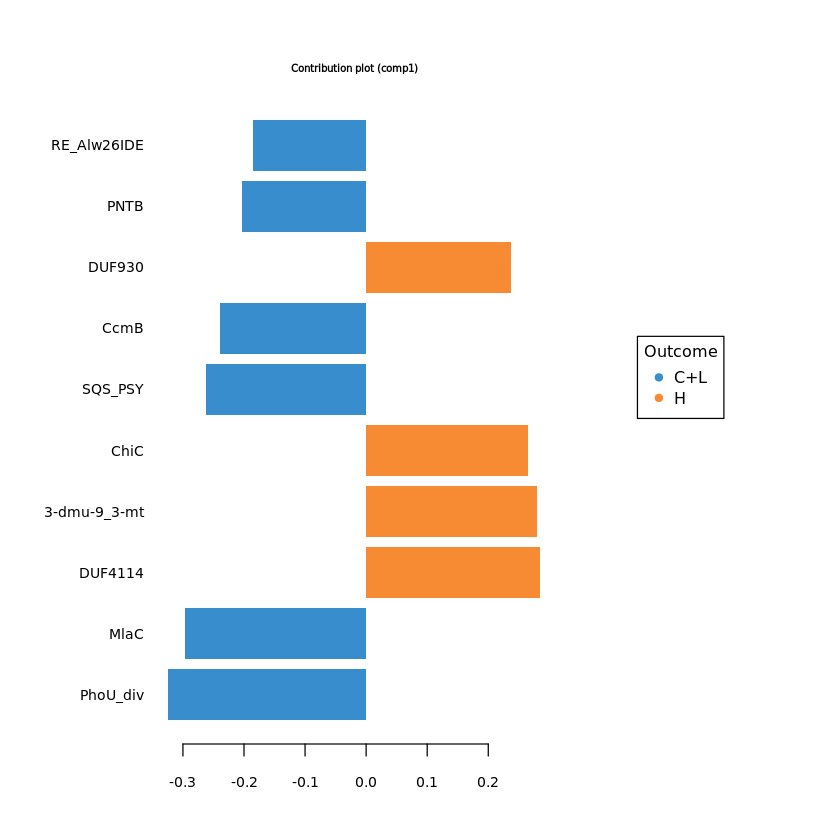

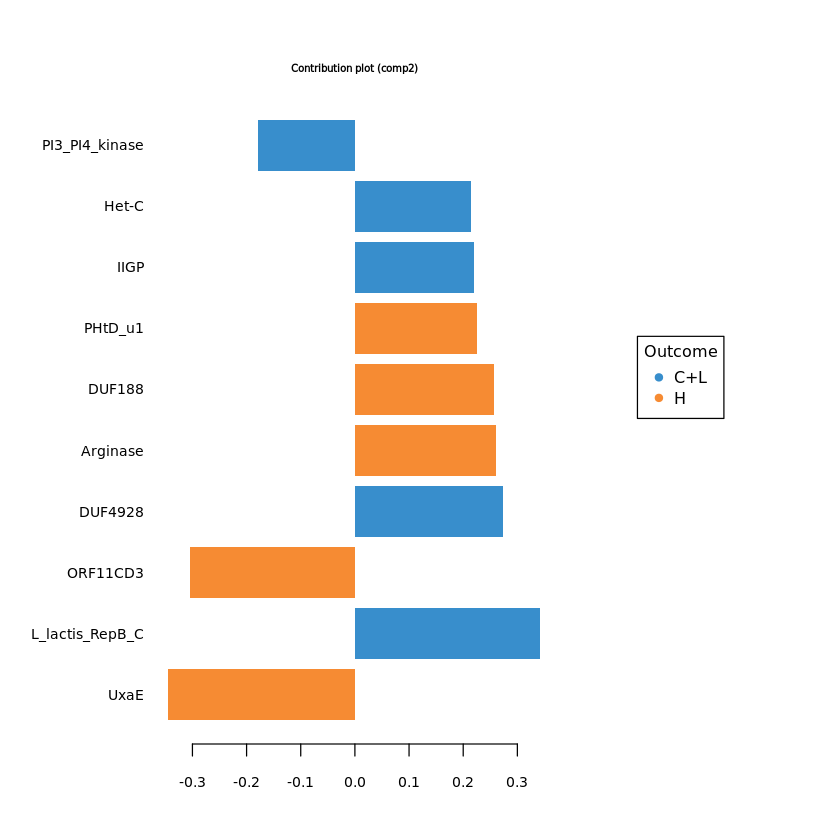

In [40]:
#plotVar(final.splsda.pfam.F1_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.pfam.F1_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.pfam.F1_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.pfam.F1_2, comp=1)$value
load_comp2 = selectVar(final.splsda.pfam.F1_2, comp=2)$value
F1_2.pfam.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F1_2.pfam.load) <- F1_2.pfam.load[,"Row.names"]
colnames(F1_2.pfam.load) <- c("ft","loading_comp1","loading_comp2")
F1_2.pfam.load = F1_2.pfam.load[,c("loading_comp1","loading_comp2")]

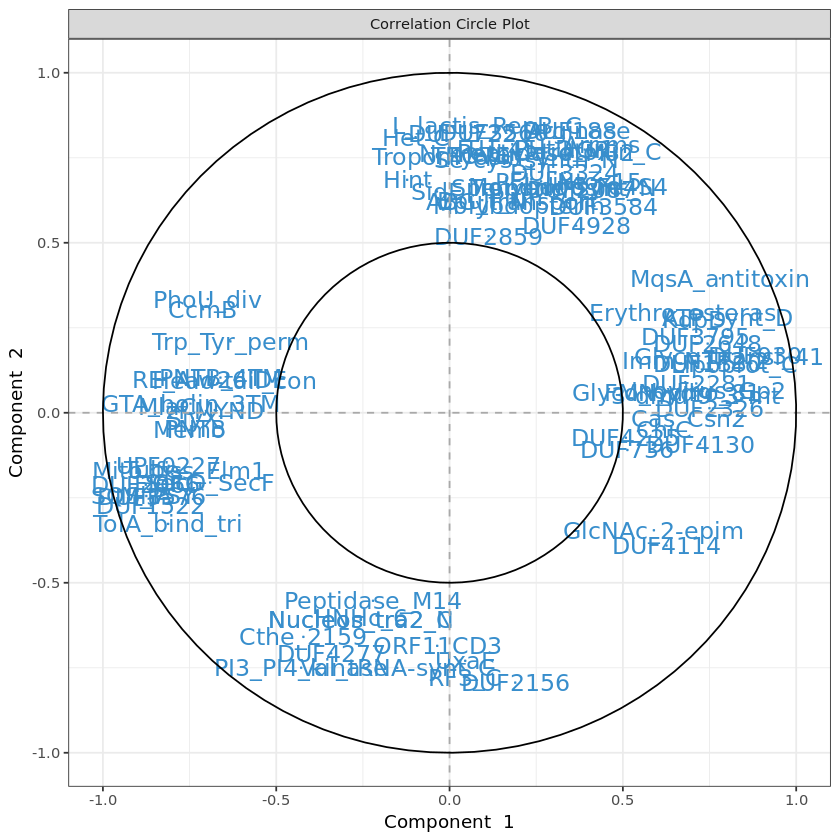

In [41]:
# plot feature correlation
plotVar(final.splsda.pfam.F1_2, cutoff=0.5)
pfam.F1_2.corr <- as.data.frame(plotVar(final.splsda.pfam.F1_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
pfam.F1_2.corr <- pfam.F1_2.corr[, c("x","y")]
colnames(pfam.F1_2.corr) <- c("corr_comp1","corr_comp2")

In [42]:
# Calculate feature stability
perf.splsda.pfam.F1_2 <- perf(final.splsda.pfam.F1_2, 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F1_2.pfam.stab <- merge(data.frame(perf.splsda.pfam.F1_2$features$stable$comp1), 
                  data.frame(perf.splsda.pfam.F1_2$features$stable$comp2), by="Var1", all=T)
rownames(F1_2.pfam.stab) <- F1_2.pfam.stab$Var1
F1_2.pfam.stab <- F1_2.pfam.stab[, c("Freq.x","Freq.y")]
colnames(F1_2.pfam.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [43]:
# merge feature output
F1_2.pfam.out <- merge(F1_2.pfam.load, F1_2.pfam.stab, by="row.names")
rownames(F1_2.pfam.out) <- F1_2.pfam.out[,"Row.names"]
F1_2.pfam.out <- merge(F1_2.pfam.out[, 2:ncol(F1_2.pfam.out)], pfam.F1_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F1_2.features.tsv", F1_2.pfam.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [44]:
train <- sample(1:nrow(X.pfam.F1_2), ceiling(nrow(X.pfam.F1_2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.pfam.F1_2), train) # rest is part of the test set

# store matrices into training and test set:
X.pfam.F1_2.train <- X.pfam.F1_2[train, ]
X.pfam.F1_2.test <- X.pfam.F1_2[test,]
Y.pfam.F1_2.train <- F1_info_3[train,"treatment"]
Y.pfam.F1_2.test <- F1_info_3[test, "treatment"]
train.splsda.pfam.F1_2 <- splsda(X.pfam.F1_2.train, Y.pfam.F1_2.train, ncomp = pfam.F1_2$optimal.ncomp, keepX = pfam.F1_2$optimal.keepX)
predict.splsda.pfam.F1_2 <- predict(train.splsda.pfam.F1_2, X.pfam.F1_2.test, 
                                dist = "max.dist")
predict.comp2.pfam.F1_2 <- predict.splsda.pfam.F1_2$class$max.dist[,2]
table(factor(predict.comp2.pfam.F1_2, levels = levels(pfam.F1_2$treatment)), Y.pfam.F1_2.test)

     Y.pfam.F1_2.test
      C+L H
  C+L   7 3
  H     2 2

$Comp1
         AUC   p-value
C+L vs H   1 0.0003857

$Comp2
         AUC   p-value
C+L vs H   1 0.0003857



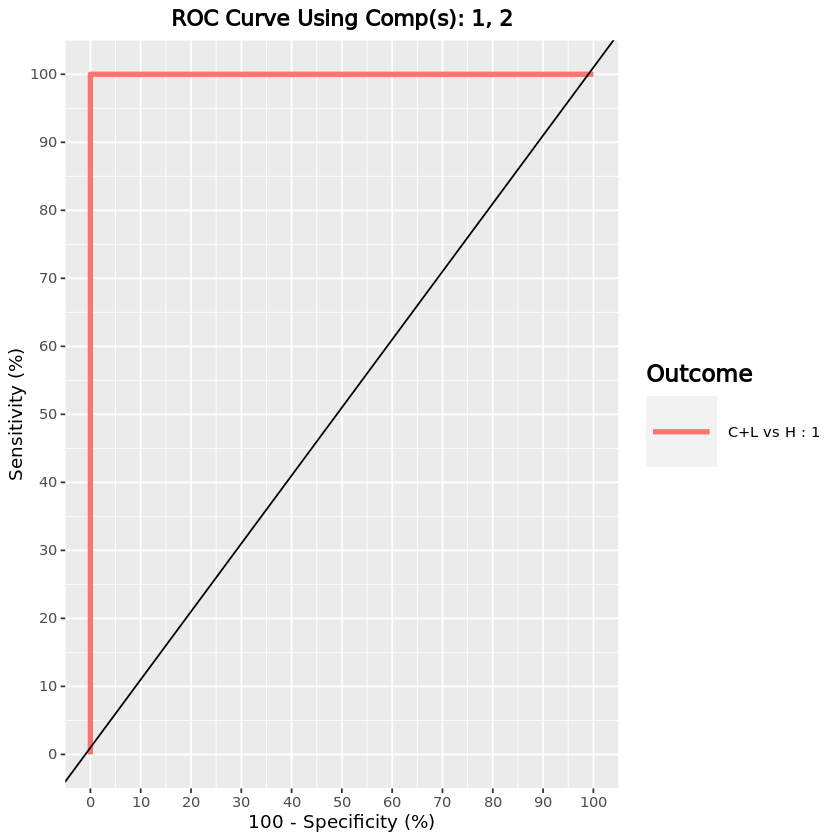

In [45]:
F1_2.pfam.auc.splsda = auroc(final.splsda.pfam.F1_2, roc.comp = 2, print = T) # AUROC for the first component

#### PFAMs - F2 generation

[1] "934"           "pfams removed" "6429"          "remaining"

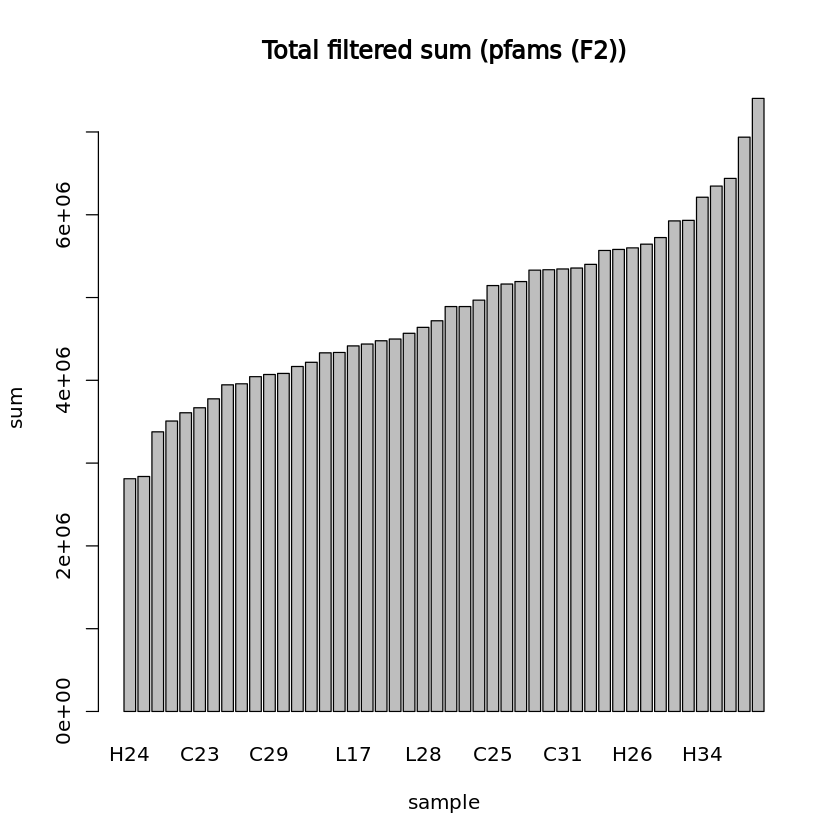

In [46]:
## PARAMS ##
# Initial components
pfam.F2.ncomp <- 10
# Percentage of samples in which features must have >0 sum
pfam.F2.percent_occ <- 10
# Quantile used for removing low abundance features
pfam.F2.quantile_thresh <- 0.1
generation <- "F2"

pfam.F2 <- list()
pfam.F2$cov <- pfam$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(pfam.F2$cov[, colSums(pfam.F2$cov) > 0])
pfam.F2$nz <- pfam.F2$cov[, colnames(pfam.F2$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(pfam.F2$nz) / sum(colSums(pfam.F2$nz)) * 100, probs = pfam.F2.quantile_thresh)
pfam.F2$filtered <- low.count.removal(pfam.F2$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
pfam.F2$occ <- colSums(pfam.F2$filtered>0) / nrow(pfam.F2$filtered) * 100
# Keep features occurring in defined percentage of samples
pfam.F2$filtered <- pfam.F2$filtered[, which(pfam.F2$occ >= pfam.F2.percent_occ)]

#pfam.F2$filtered <- pfam.F2$filtered[,-nearZeroVar(pfam.F2$filtered)$Position]
paste0(c(dim(pfam.F2$cov)[2] - dim(pfam.F2$filtered)[2], "pfams removed", dim(pfam.F2$filtered)[2], "remaining"))

# Add offset
pfam.F2$offset <- pfam.F2$filtered + 1
pfam.F2$clr <- logratio.transfo(pfam.F2$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.pfam.F2 <- pfam.F2$clr

pfam.F2$treatment <- factor(info[rownames(pfam.F2$clr), "Treatment"])

pfam.F2.lib.size <- apply(pfam.F2$filtered, 1, sum) # determine total count for each sample
barplot(sort(pfam.F2.lib.size), main="Total filtered sum (pfams (F2))", ylab="sum", xlab="sample")

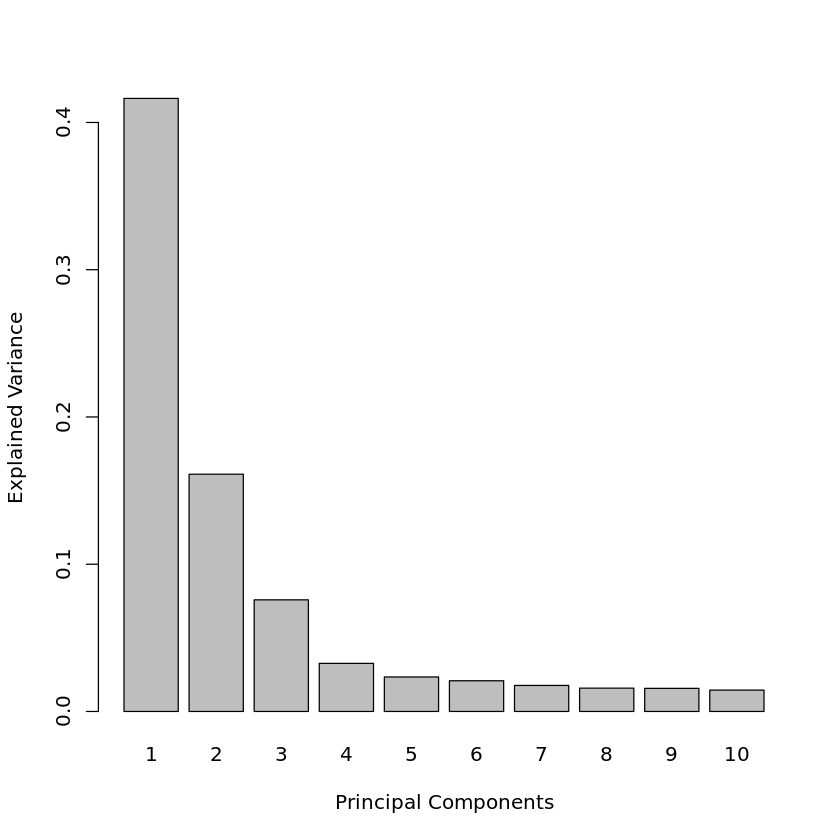

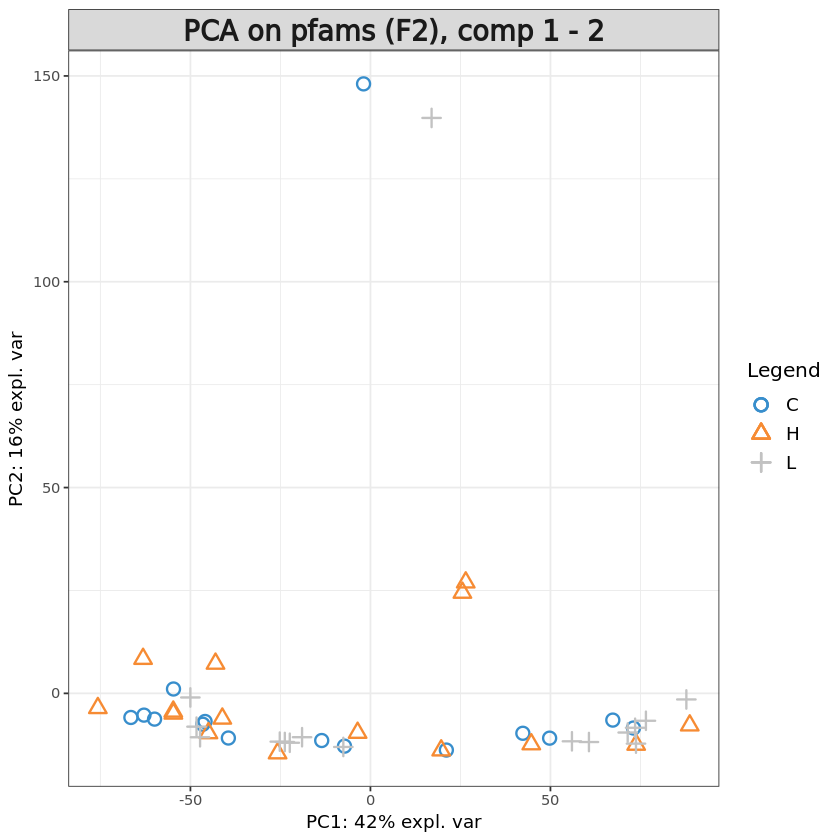

In [47]:
pca.pfam.F2 = pca(X.pfam.F2, ncomp = pfam.F2.ncomp, center = TRUE, scale = TRUE) 

plot(pca.pfam.F2)
plotIndiv(pca.pfam.F2, group = pfam.F2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on pfams (F2), comp 1 - 2')

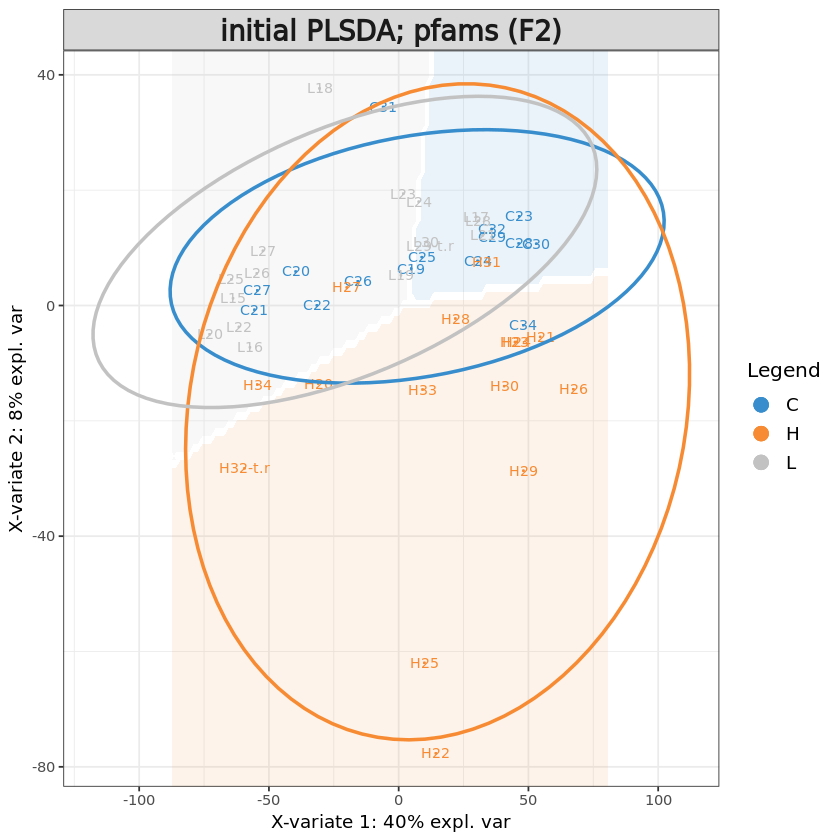

In [48]:
# Initial sPLS-DA model
pfam.F2.splsda <- splsda(X.pfam.F2, pfam.F2$treatment, ncomp = pfam.F2.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(pfam.F2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(pfam.F2.splsda, comp = 1:2, ellipse = TRUE,
          group = pfam.F2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; pfams (F2)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,7,6,5
BER,7,6,5


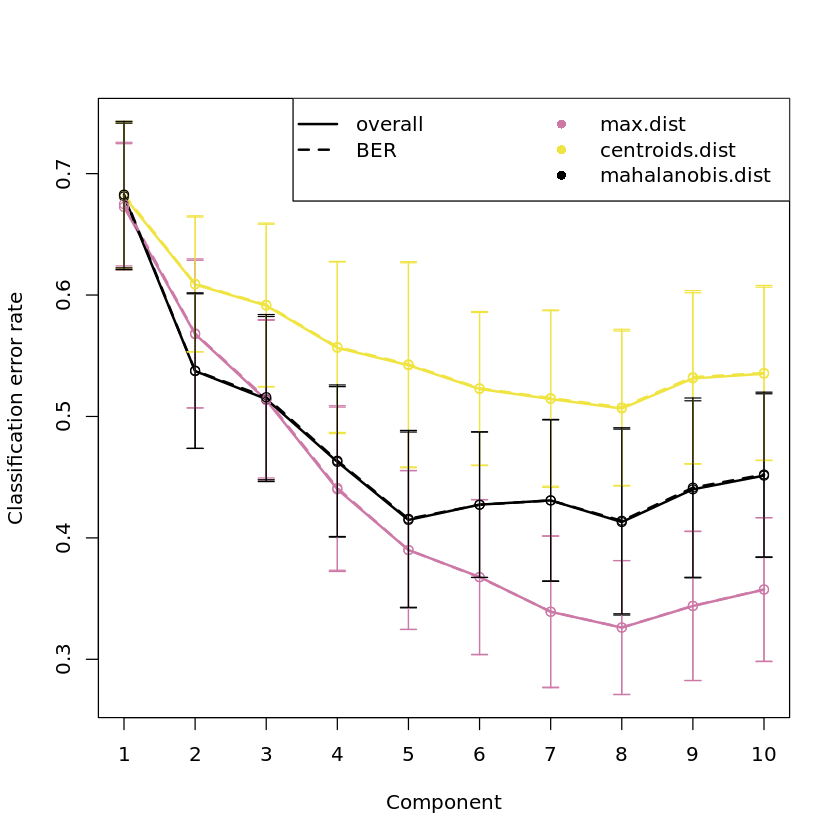

In [49]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.pfam.F2 <- perf(pfam.F2.splsda, validation = "Mfold", 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.pfam.F2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.pfam.F2$choice.ncomp # what is the optimal value of components according to perf()

In [50]:
# Define parameters for tuning keepX
pfam.F2.step <- 0.05
pfam.F2.ncomp.tune <- 7
# grid of possible keepX values that will be tested for each component
pfam.F2.keepx <- c(seq(10, 200, 20), seq(ceiling(dim(pfam.F2$filtered)[2] * pfam.F2.step), 
                      round(dim(pfam.F2$filtered)[2], digits = -1), 
                      ceiling(dim(pfam.F2$filtered)[2] * pfam.F2.step)
                     )
                 )
pfam.F2.keepx

[1]   10   30   50   70   90  110  130  150  170  190  322  644  966 1288 1610
[16] 1932 2254 2576 2898 3220 3542 3864 4186 4508 4830 5152 5474 5796 6118

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%


[1] 3

comp1 comp2 comp3 comp4 comp5 comp6 comp7 
   10   322   322    50   190    50    50

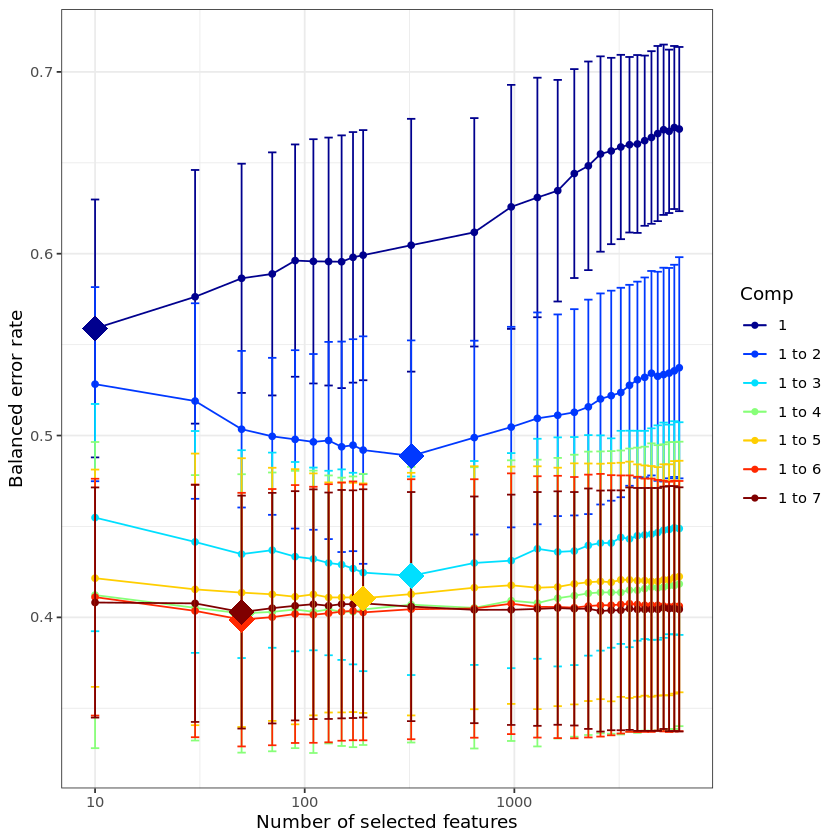

In [51]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.pfam.F2 <- tune.splsda(X.pfam.F2, pfam.F2$treatment, ncomp = pfam.F2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = pfam.F2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.pfam.F2, col = color.jet(pfam.F2.ncomp.tune))

tune.splsda.pfam.F2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.pfam.F2$choice.keepX # what are the optimal values of variables according to tune.splsda()

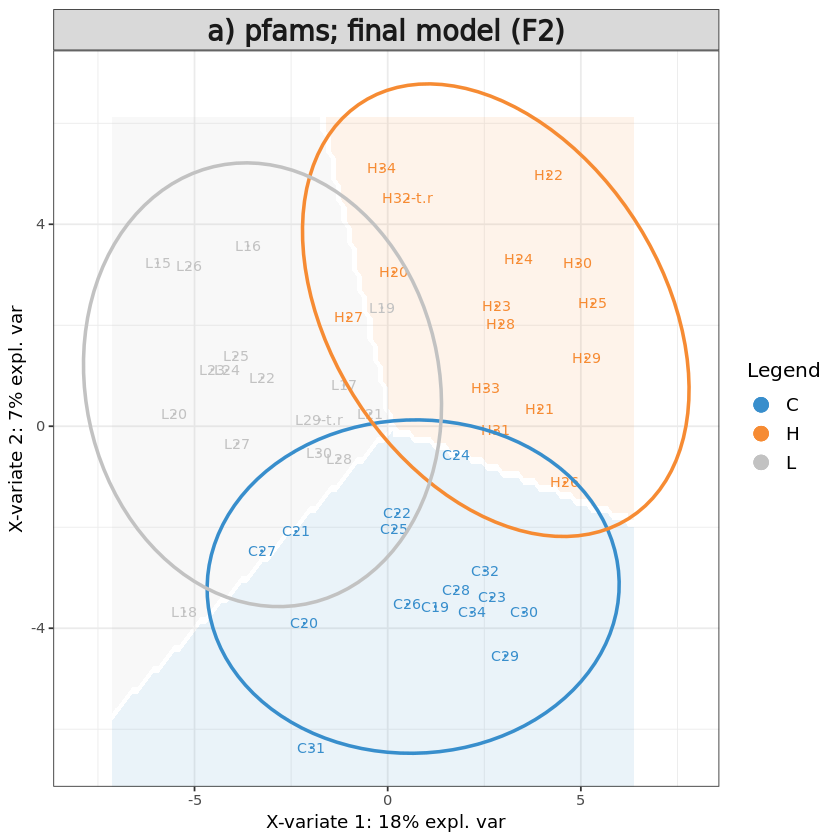

In [53]:
# Define final model
pfam.F2$optimal.ncomp <- 3
pfam.F2$optimal.keepX <- tune.splsda.pfam.F2$choice.keepX[1:pfam.F2$optimal.ncomp]
pfam.F2$optimal.keepX <- rep(50, pfam.F2$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.pfam.F2 <- splsda(X.pfam.F2, pfam.F2$treatment, 
                       ncomp = pfam.F2$optimal.ncomp, 
                       keepX = pfam.F2$optimal.keepX)

background = background.predict(final.splsda.pfam.F2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.pfam.F2, comp = 1:2, 
          group = pfam.F2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) pfams; final model (F2)')

# save sample variates
data <- as.data.frame(final.splsda.pfam.F2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

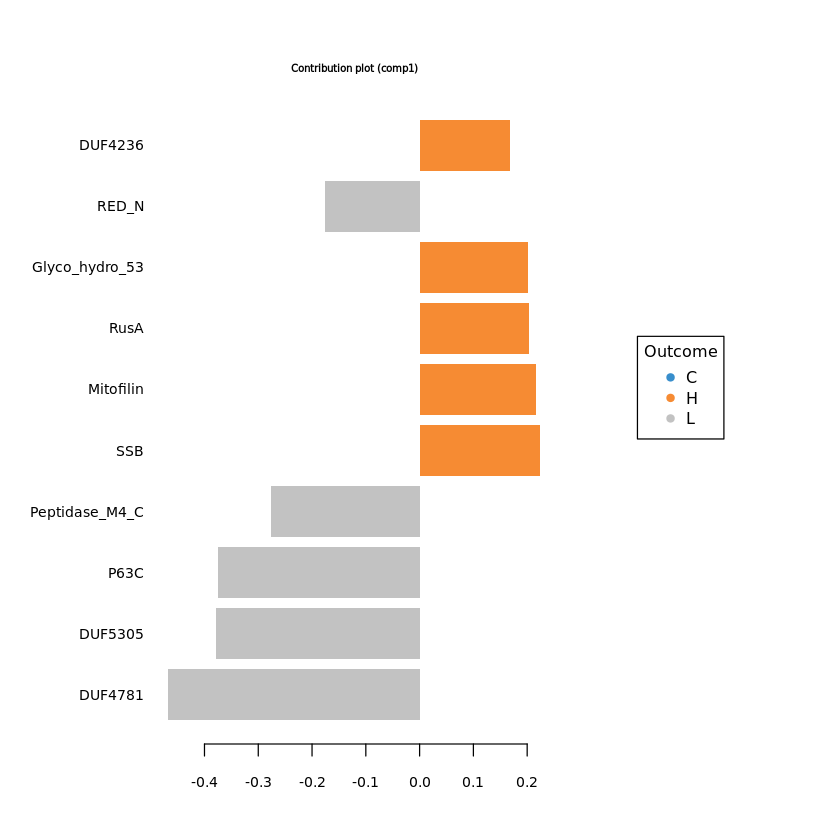

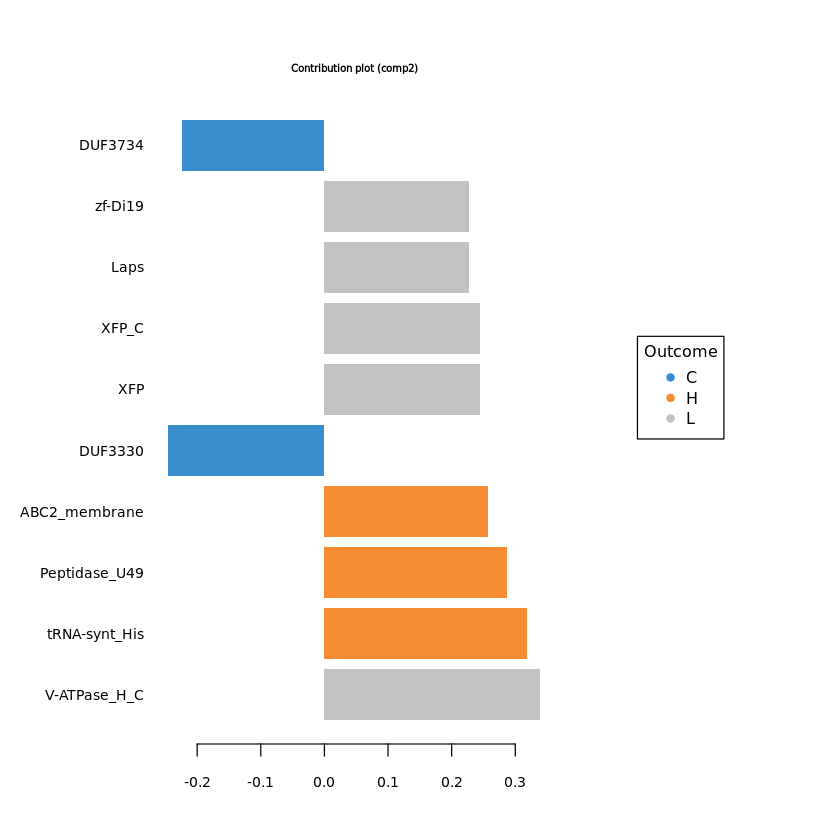

In [54]:
#plotVar(final.splsda.pfam.F2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.pfam.F2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10)
plotLoadings(final.splsda.pfam.F2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.pfam.F2, comp=1)$value
load_comp2 = selectVar(final.splsda.pfam.F2, comp=2)$value
F2.pfam.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F2.pfam.load) <- F2.pfam.load[,"Row.names"]
colnames(F2.pfam.load) <- c("ft","loading_comp1","loading_comp2")
F2.pfam.load = F2.pfam.load[,c("loading_comp1","loading_comp2")]

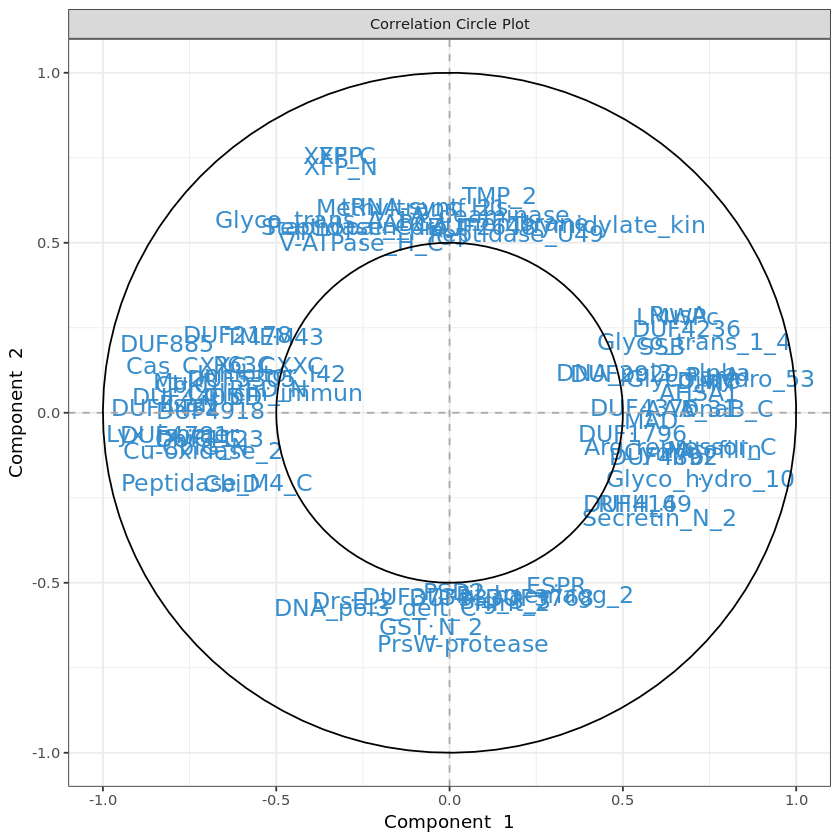

In [55]:
# plot feature correlation
plotVar(final.splsda.pfam.F2, cutoff=0.5)
pfam.F2.corr <- as.data.frame(plotVar(final.splsda.pfam.F2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
pfam.F2.corr <- pfam.F2.corr[, c("x","y")]
colnames(pfam.F2.corr) <- c("corr_comp1","corr_comp2")

In [56]:
# Calculate feature stability
perf.splsda.pfam.F2 <- perf(final.splsda.pfam.F2, 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F2.pfam.stab <- merge(data.frame(perf.splsda.pfam.F2$features$stable$comp1), 
                  data.frame(perf.splsda.pfam.F2$features$stable$comp2), by="Var1", all=T)
rownames(F2.pfam.stab) <- F2.pfam.stab$Var1
F2.pfam.stab <- F2.pfam.stab[, c("Freq.x","Freq.y")]
colnames(F2.pfam.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


In [57]:
# merge feature output
F2.pfam.out <- merge(F2.pfam.load, F2.pfam.stab, by="row.names")
rownames(F2.pfam.out) <- F2.pfam.out[,"Row.names"]
F2.pfam.out <- merge(F2.pfam.out[, 2:ncol(F2.pfam.out)], pfam.F2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F2.features.tsv", F2.pfam.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [58]:
train <- sample(1:nrow(X.pfam.F2), ceiling(nrow(X.pfam.F2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.pfam.F2), train) # rest is part of the test set

# store matrices into training and test set:
X.pfam.F2.train <- X.pfam.F2[train, ]
X.pfam.F2.test <- X.pfam.F2[test,]
Y.pfam.F2.train <- info[train,"treatment"]
Y.pfam.F2.test <- info[test, "treatment"]
train.splsda.pfam.F2 <- splsda(X.pfam.F2.train, Y.pfam.F2.train, ncomp = pfam.F2$optimal.ncomp, keepX = pfam.F2$optimal.keepX)
predict.splsda.pfam.F2 <- predict(train.splsda.pfam.F2, X.pfam.F2.test, 
                                dist = "max.dist")
predict.comp2.pfam.F2 <- predict.splsda.pfam.F2$class$max.dist[,2]
table(factor(predict.comp2.pfam.F2, levels = levels(pfam.F2$treatment)), Y.pfam.F2.test)

   Y.pfam.F2.test
    C H L
  C 9 8 9
  H 3 2 3
  L 0 0 0

$Comp1
                 AUC   p-value
C vs Other(s) 0.5720 4.325e-01
H vs Other(s) 0.8839 2.881e-05
L vs Other(s) 0.9417 1.011e-06

$Comp2
                 AUC   p-value
C vs Other(s) 0.9828 1.436e-07
H vs Other(s) 0.9978 5.809e-08
L vs Other(s) 0.9458 7.992e-07

$Comp3
                 AUC   p-value
C vs Other(s) 1.0000 5.093e-08
H vs Other(s) 0.9978 5.809e-08
L vs Other(s) 1.0000 3.109e-08



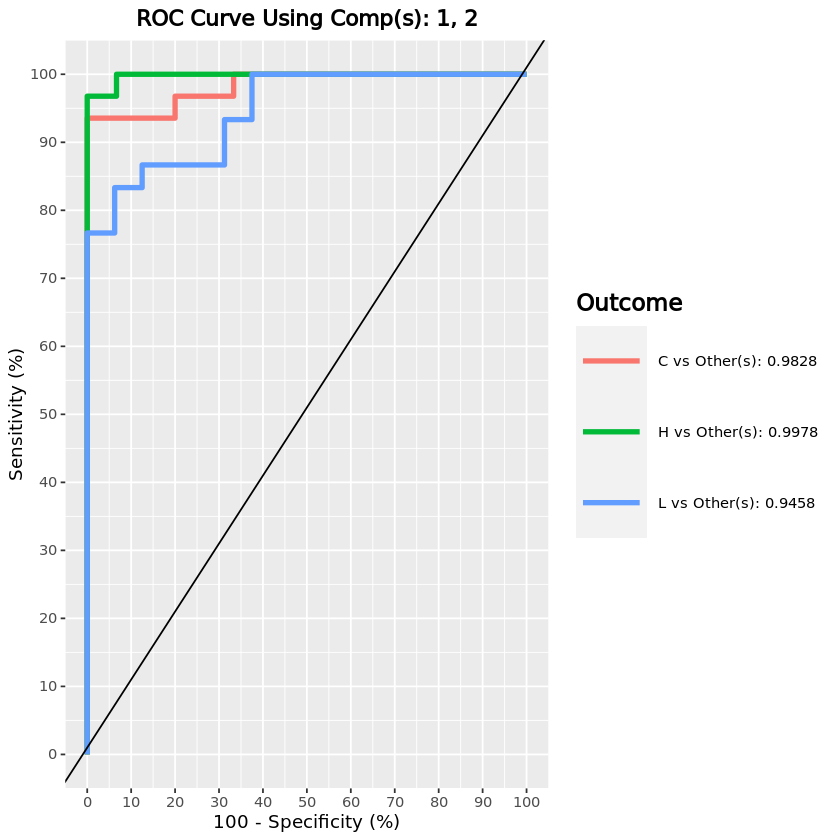

In [59]:
F2.pfam.auc.splsda = auroc(final.splsda.pfam.F2, roc.comp = 2, print = T) # AUROC for the first component

#### pfams - F2 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [60]:
pfam.F2_2 <- list()
F2_info_2 <- info[rownames(pfam.F2$cov),]
F2_info_2$treatment <- gsub(x = F2_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
pfam.F2_2$cov <- pfam.F2$cov[rownames(F2_info_2),]
pfam.F2_2$filtered <- pfam.F2$filtered[rownames(F2_info_2),]

pfam.F2_2$clr <- pfam.F2$clr[rownames(F2_info_2), ]
X.pfam.F2_2 <- pfam.F2_2$clr

pfam.F2_2$treatment <- factor(F2_info_2[rownames(pfam.F2_2$clr), "treatment"])

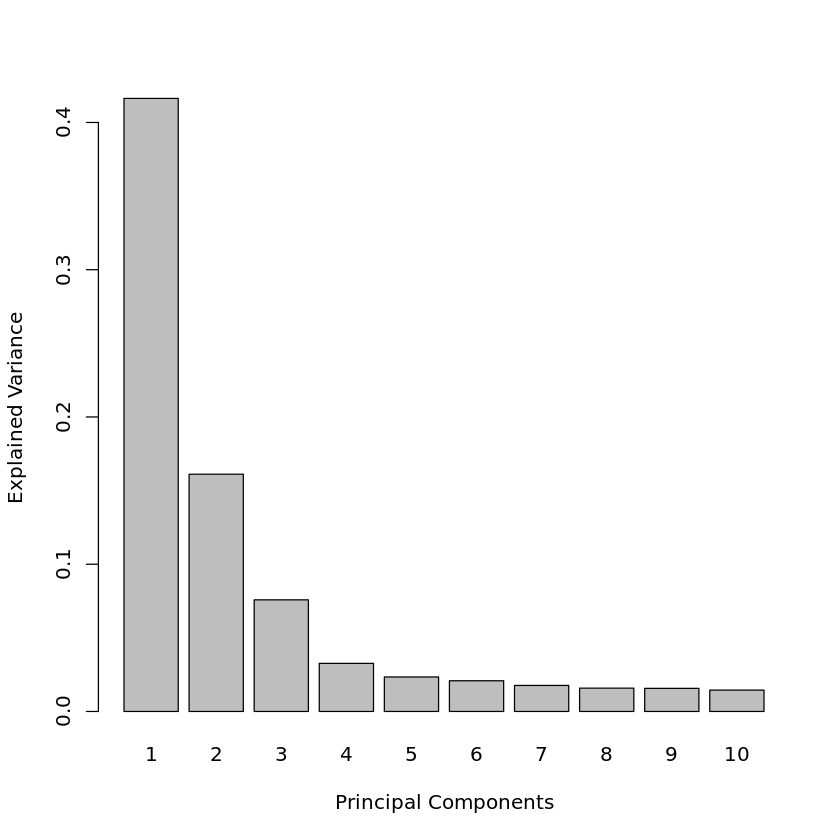

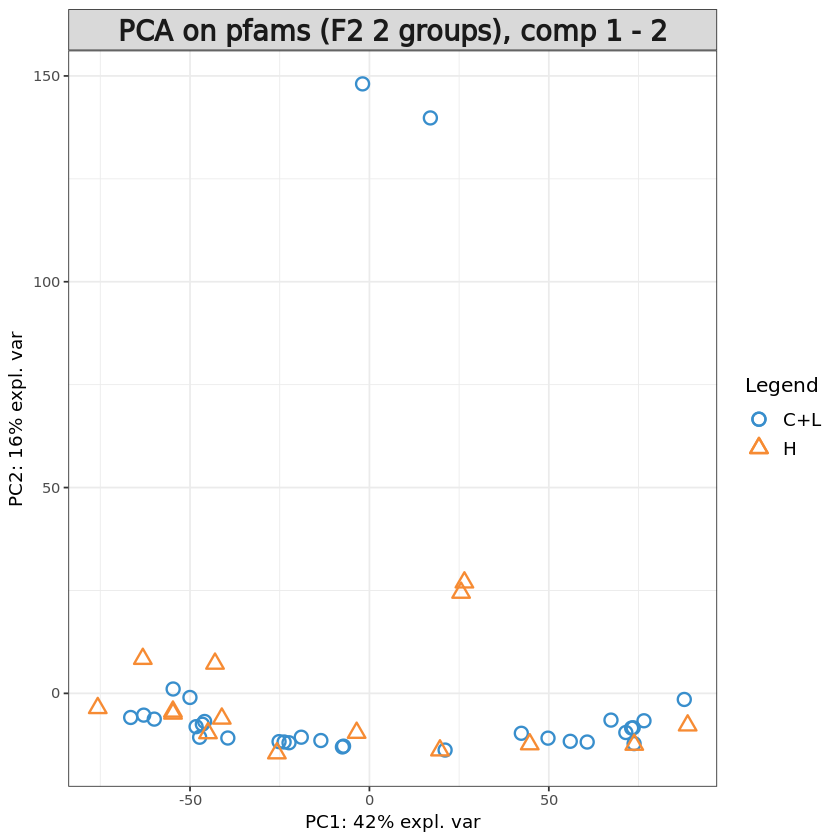

In [61]:
pca.pfam.F2_2 = pca(X.pfam.F2_2, ncomp = 10, center = TRUE, scale = TRUE) 

plot(pca.pfam.F2_2)
plotIndiv(pca.pfam.F2_2, group = pfam.F2_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on pfams (F2 2 groups), comp 1 - 2')

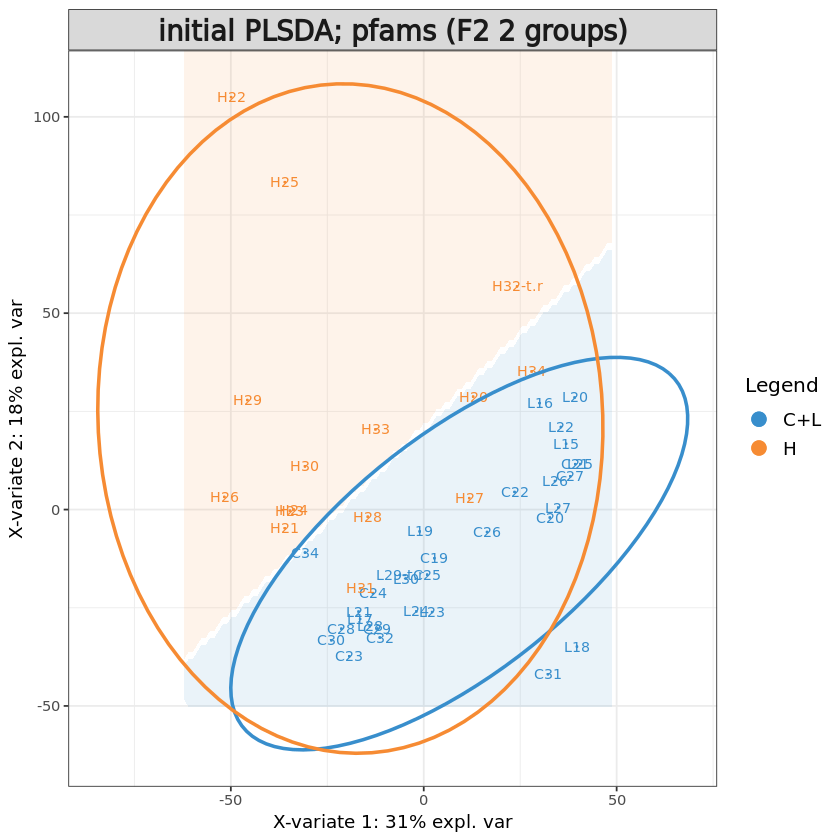

In [62]:
# Initial sPLS-DA model
pfam.F2_2.splsda <- splsda(X.pfam.F2_2, pfam.F2_2$treatment, ncomp = 10)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(pfam.F2_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(pfam.F2_2.splsda, comp = 1:2, ellipse = TRUE,
          group = pfam.F2_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; pfams (F2 2 groups)")

The initial model separates the two treatment groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,5,4,7
BER,5,4,7


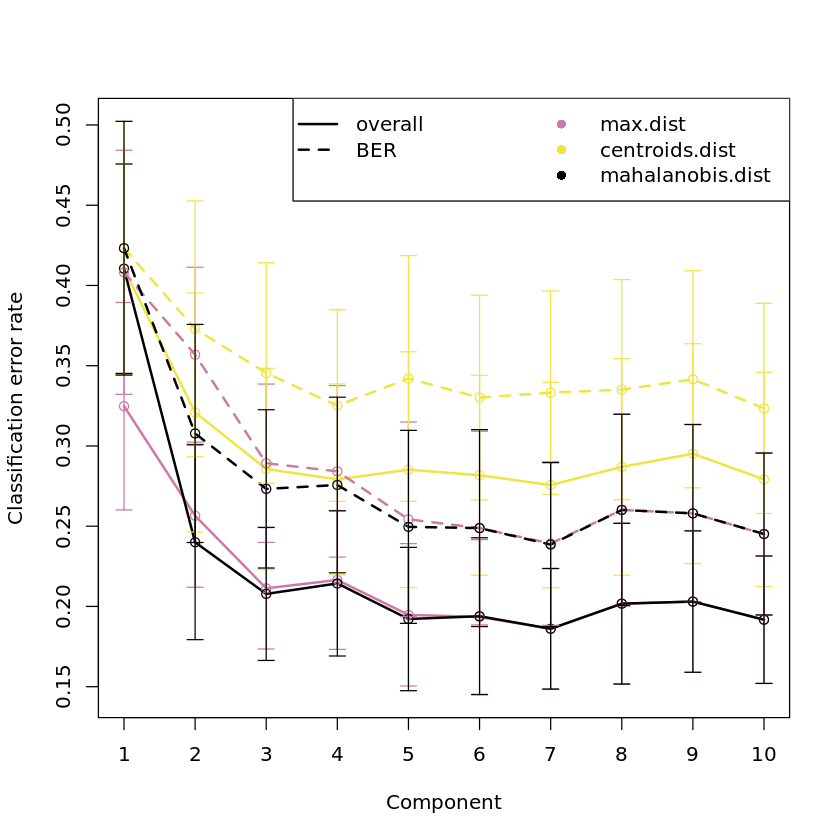

In [63]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.pfam.F2_2 <- perf(pfam.F2_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.pfam.F2_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.pfam.F2_2$choice.ncomp # what is the optimal value of components according to perf()

We set number of components to 3 and tune number of features used.

In [64]:
# Define parameters for tuning keepX
pfam.F2_2.step <- 0.05
pfam.F2_2.ncomp.tune <- 5
# grid of possible keepX values that will be tested for each component
pfam.F2_2.keepx <- c(seq(10, 200, 20), seq(ceiling(dim(pfam.F2$filtered)[2] * pfam.F2.step), 
                      round(dim(pfam.F2$filtered)[2], digits = -1), 
                      ceiling(dim(pfam.F2$filtered)[2] * pfam.F2.step)
                     )
                 )
pfam.F2_2.keepx

[1]   10   30   50   70   90  110  130  150  170  190  322  644  966 1288 1610
[16] 1932 2254 2576 2898 3220 3542 3864 4186 4508 4830 5152 5474 5796 6118

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


[1] 5

comp1 comp2 comp3 comp4 comp5 
  190    90    10   130  3542

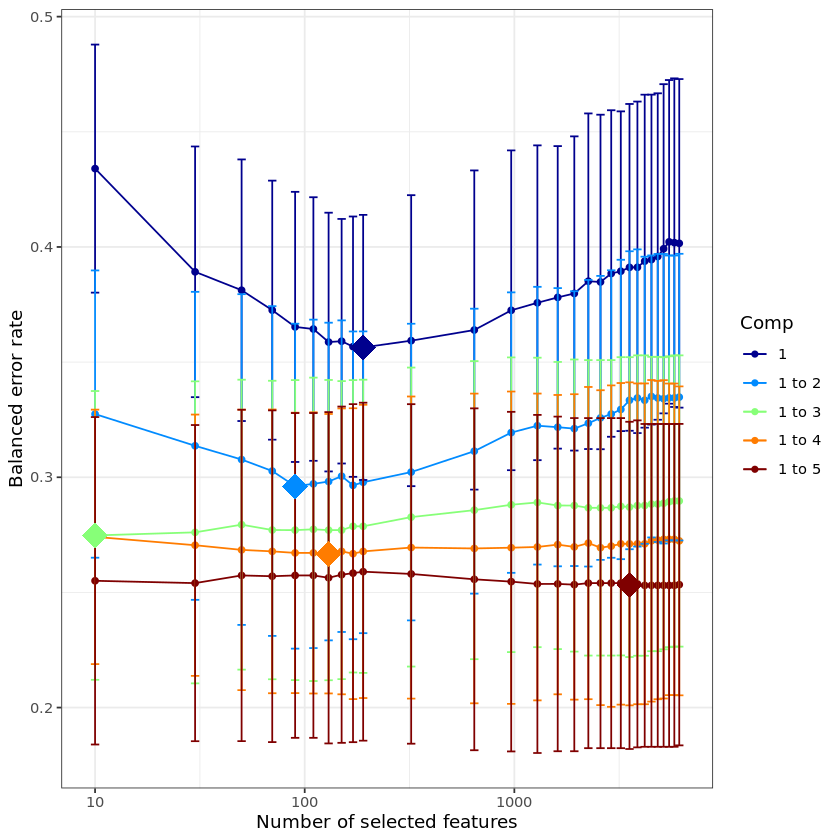

In [65]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.pfam.F2_2 <- tune.splsda(X.pfam.F2_2, pfam.F2_2$treatment, ncomp = pfam.F2_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = pfam.F2_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.pfam.F2_2, col = color.jet(pfam.F2_2.ncomp.tune))

tune.splsda.pfam.F2_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.pfam.F2_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

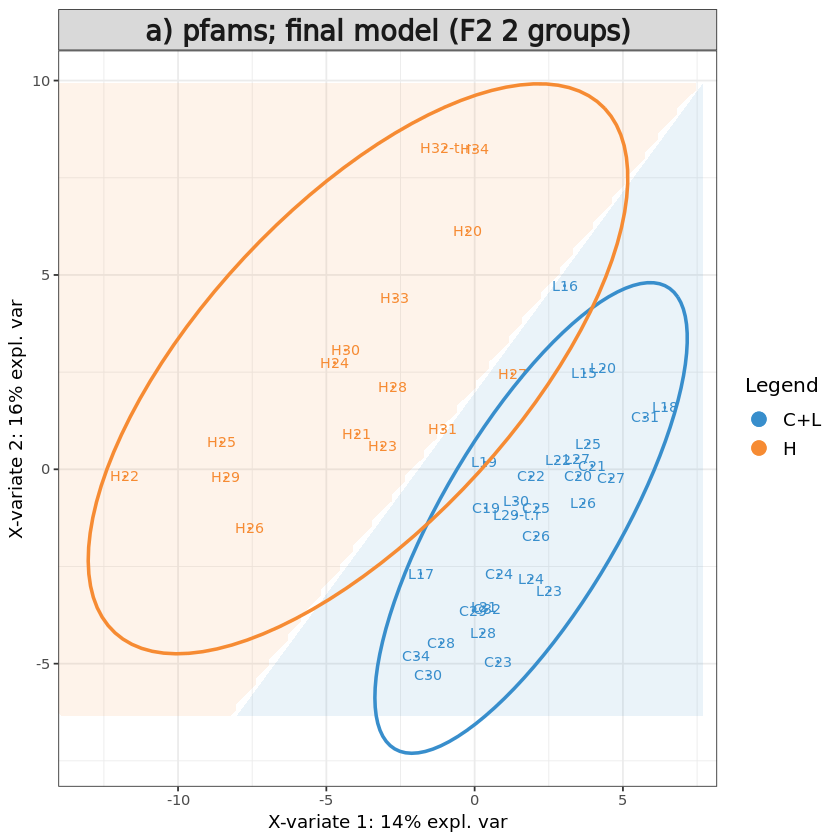

In [72]:
# Define final model
pfam.F2_2$optimal.ncomp <- 5
pfam.F2_2$optimal.keepX <- tune.splsda.pfam.F2_2$choice.keepX[1:pfam.F2_2$optimal.ncomp]
pfam.F2_2$optimal.keepX <- rep(50, pfam.F2_2$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.pfam.F2_2 <- splsda(X.pfam.F2_2, pfam.F2_2$treatment, 
                       ncomp = pfam.F2_2$optimal.ncomp, 
                       keepX = pfam.F2_2$optimal.keepX)

background = background.predict(final.splsda.pfam.F2_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.pfam.F2_2, comp = 1:2, 
          group = pfam.F2_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) pfams; final model (F2 2 groups)')

# save sample variates
data <- as.data.frame(final.splsda.pfam.F2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F2_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

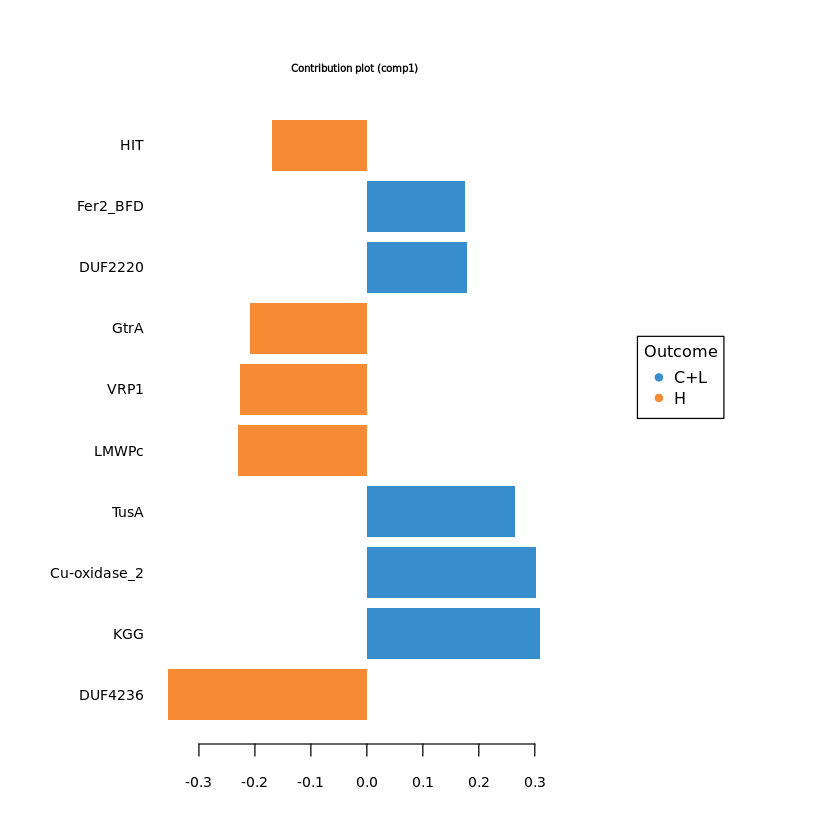

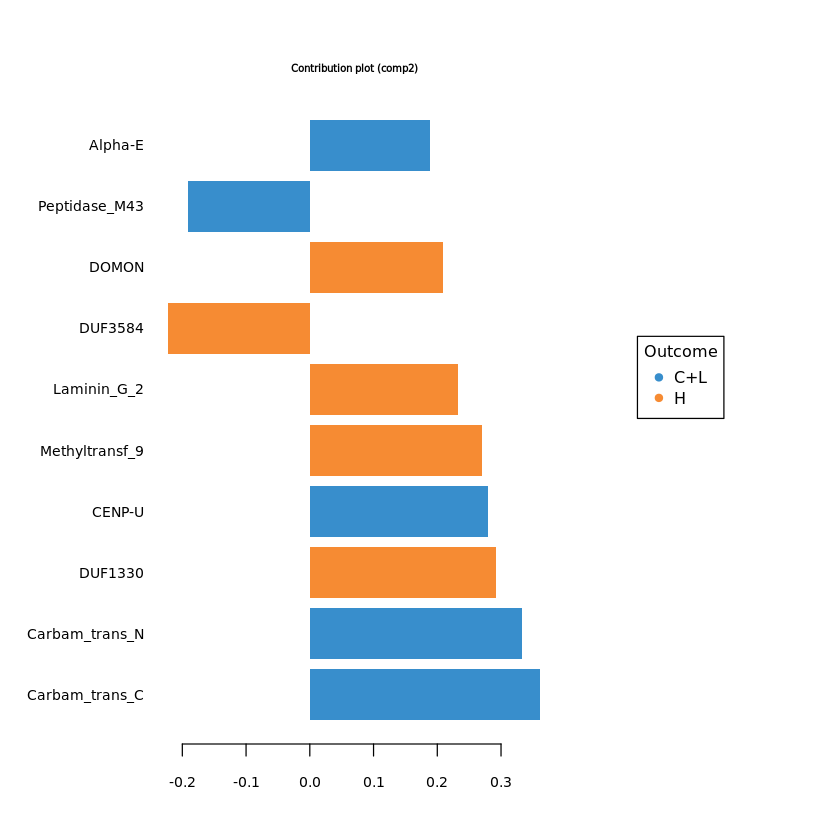

In [68]:
#plotVar(final.splsda.pfam.F2_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.pfam.F2_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.pfam.F2_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)
# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.pfam.F2_2, comp=1)$value
load_comp2 = selectVar(final.splsda.pfam.F2_2, comp=2)$value
F2_2.pfam.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F2_2.pfam.load) <- F2_2.pfam.load[,"Row.names"]
colnames(F2_2.pfam.load) <- c("ft","loading_comp1","loading_comp2")
F2_2.pfam.load = F2_2.pfam.load[,c("loading_comp1","loading_comp2")]

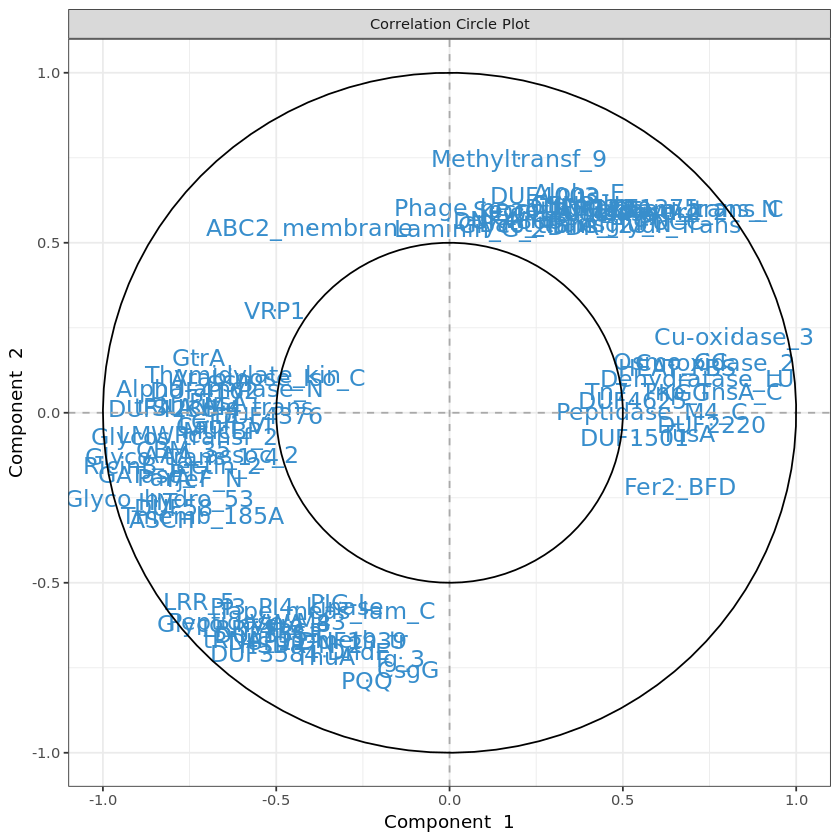

In [69]:
# plot feature correlation
plotVar(final.splsda.pfam.F2_2, cutoff=0.5)
pfam.F2_2.corr <- as.data.frame(plotVar(final.splsda.pfam.F2_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
pfam.F2_2.corr <- pfam.F2_2.corr[, c("x","y")]
colnames(pfam.F2_2.corr) <- c("corr_comp1","corr_comp2")

In [70]:
# Calculate feature stability
perf.splsda.pfam.F2_2 <- perf(final.splsda.pfam.F2_2, 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F2_2.pfam.stab <- merge(data.frame(perf.splsda.pfam.F2_2$features$stable$comp1), 
                  data.frame(perf.splsda.pfam.F2_2$features$stable$comp2), by="Var1", all=T)
rownames(F2_2.pfam.stab) <- F2_2.pfam.stab$Var1
F2_2.pfam.stab <- F2_2.pfam.stab[, c("Freq.x","Freq.y")]
colnames(F2_2.pfam.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


In [73]:
# merge feature output
F2_2.pfam.out <- merge(F2_2.pfam.load, F2_2.pfam.stab, by="row.names")
rownames(F2_2.pfam.out) <- F2_2.pfam.out[,"Row.names"]
F2_2.pfam.out <- merge(F2_2.pfam.out[, 2:ncol(F2_2.pfam.out)], pfam.F2_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.pfam.F2_2.features.tsv", F2_2.pfam.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [74]:
train <- sample(1:nrow(X.pfam.F2_2), ceiling(nrow(X.pfam.F2_2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.pfam.F2_2), train) # rest is part of the test set

# store matrices into training and test set:
X.pfam.F2_2.train <- X.pfam.F2_2[train, ]
X.pfam.F2_2.test <- X.pfam.F2_2[test,]
Y.pfam.F2_2.train <- F2_info_2[train,"treatment"]
Y.pfam.F2_2.test <- F2_info_2[test, "treatment"]
train.splsda.pfam.F2_2 <- splsda(X.pfam.F2_2.train, Y.pfam.F2_2.train, ncomp = pfam.F2_2$optimal.ncomp, keepX = pfam.F2_2$optimal.keepX)
predict.splsda.pfam.F2_2 <- predict(train.splsda.pfam.F2_2, X.pfam.F2_2.test, 
                                dist = "max.dist")
predict.comp2.pfam.F2_2 <- predict.splsda.pfam.F2_2$class$max.dist[,2]
table(factor(predict.comp2.pfam.F2_2, levels = levels(pfam.F2_2$treatment)), Y.pfam.F2_2.test)

     Y.pfam.F2_2.test
      C+L  H
  C+L  23  6
  H     1  4

$Comp1
            AUC   p-value
C+L vs H 0.9376 1.856e-06

$Comp2
            AUC   p-value
C+L vs H 0.9978 5.809e-08

$Comp3
         AUC   p-value
C+L vs H   1 5.093e-08

$Comp4
         AUC   p-value
C+L vs H   1 5.093e-08

$Comp5
         AUC   p-value
C+L vs H   1 5.093e-08



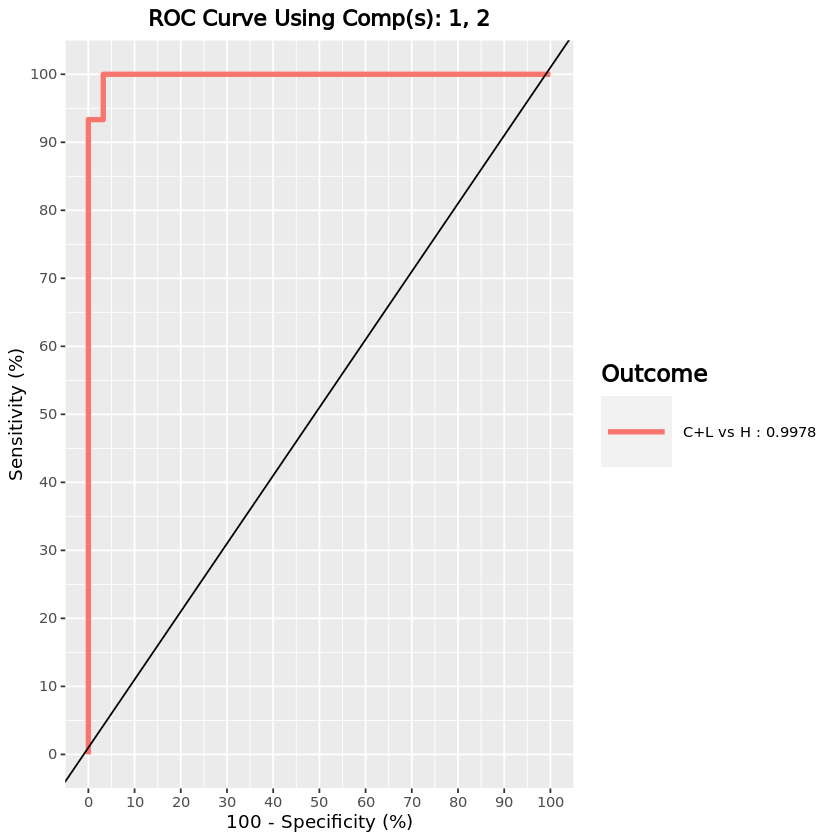

In [75]:
F2_2.pfam.auc.splsda = auroc(final.splsda.pfam.F2_2, roc.comp = 2, print = T) # AUROC for the first component

#### kos - F0 generation

[1] "1634"        "kos removed" "4292"        "remaining"

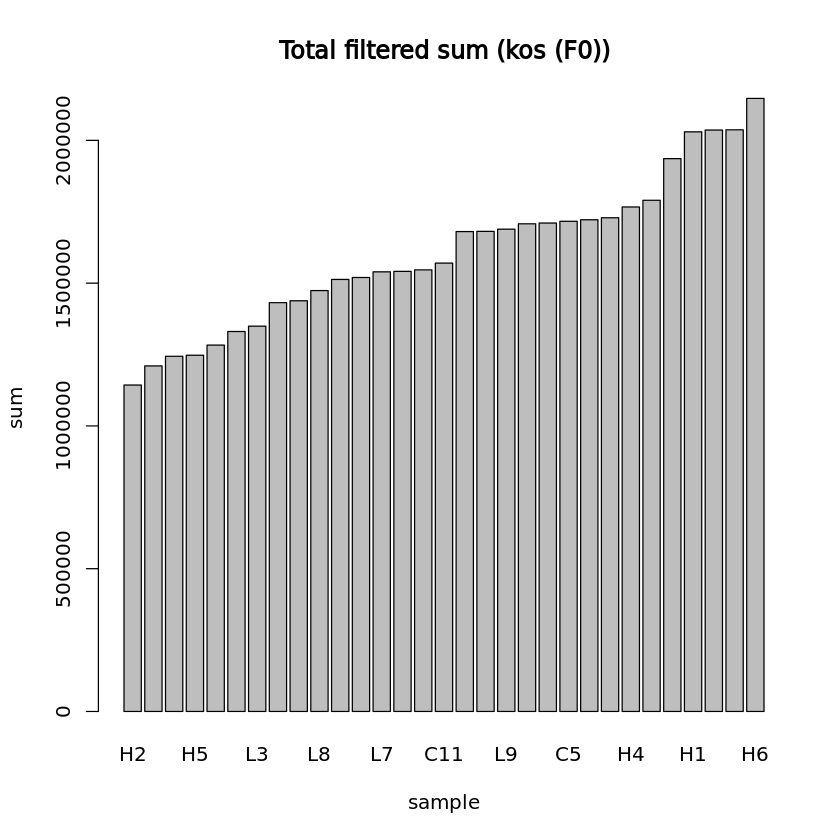

In [76]:
## PARAMS ##
# Initial components
ko.F0.ncomp <- 10
# Percentage of samples in which features must have >0 sum
ko.F0.percent_occ <- 10
# Quantile used for removing low abundance features
ko.F0.quantile_thresh <- 0.1
generation <- "F0"

ko.F0 <- list()
ko.F0$cov <- ko$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(ko.F0$cov[, colSums(ko.F0$cov) > 0])
ko.F0$nz <- ko.F0$cov[, colnames(ko.F0$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(ko.F0$nz) / sum(colSums(ko.F0$nz)) * 100, probs = ko.F0.quantile_thresh)
ko.F0$filtered <- low.count.removal(ko.F0$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
ko.F0$occ <- colSums(ko.F0$filtered>0) / nrow(ko.F0$filtered) * 100
# Keep features occurring in defined percentage of samples
ko.F0$filtered <- ko.F0$filtered[, which(ko.F0$occ >= ko.F0.percent_occ)]

#ko.F0$filtered <- ko.F0$filtered[,-nearZeroVar(ko.F0$filtered)$Position]
paste0(c(dim(ko.F0$cov)[2] - dim(ko.F0$filtered)[2], "kos removed", dim(ko.F0$filtered)[2], "remaining"))

# Add offset
ko.F0$offset <- ko.F0$filtered + 1
ko.F0$clr <- logratio.transfo(ko.F0$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.ko.F0 <- ko.F0$clr

ko.F0$treatment <- factor(info[rownames(ko.F0$clr), "Treatment"])

ko.F0.lib.size <- apply(ko.F0$filtered, 1, sum) # determine total count for each sample
barplot(sort(ko.F0.lib.size), main="Total filtered sum (kos (F0))", ylab="sum", xlab="sample")

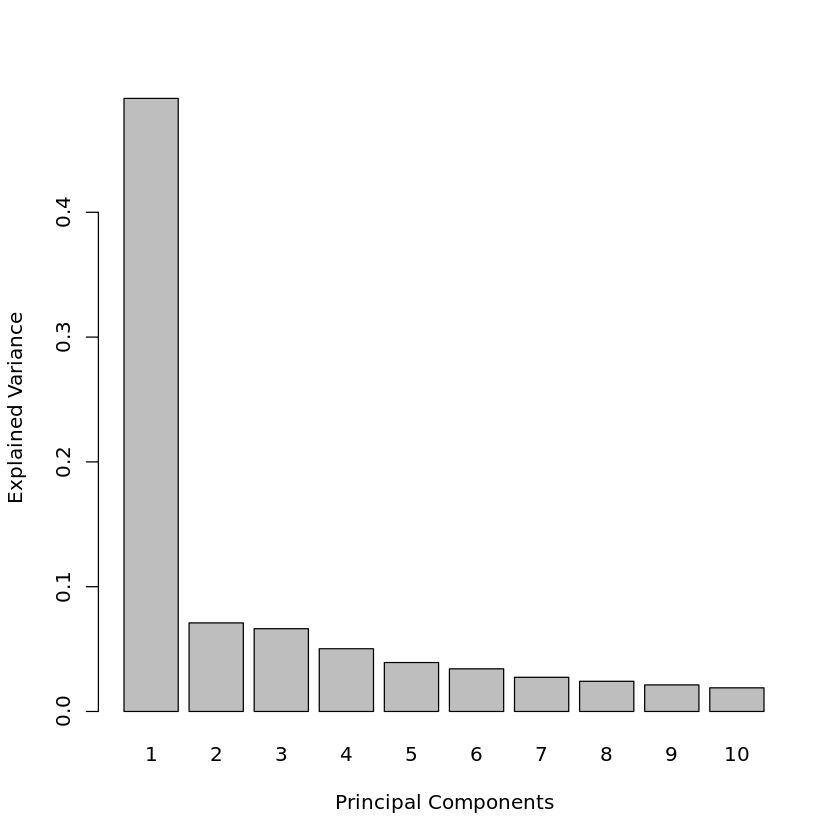

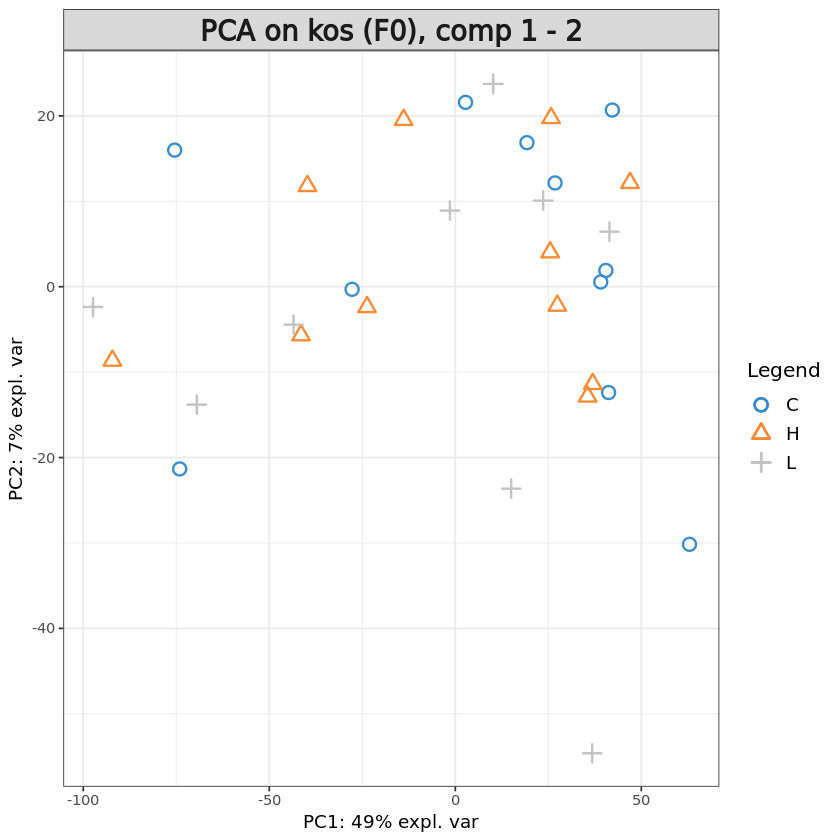

In [77]:
pca.ko.F0 = pca(X.ko.F0, ncomp = ko.F0.ncomp, center = TRUE, scale = TRUE) 

plot(pca.ko.F0)
plotIndiv(pca.ko.F0, group = ko.F0$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on kos (F0), comp 1 - 2')

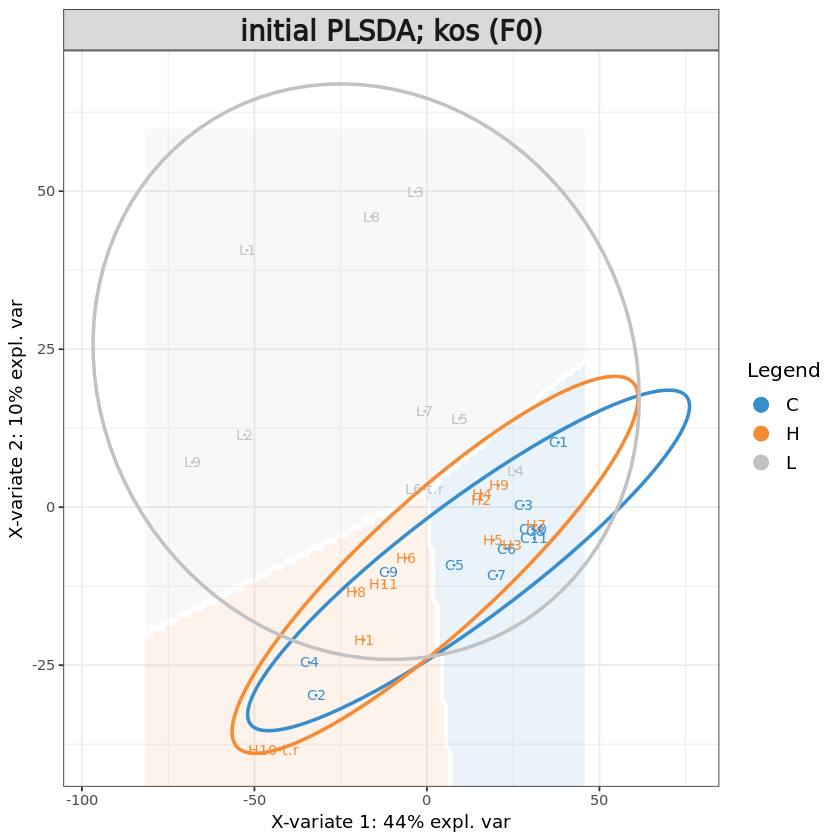

In [78]:
# Initial sPLS-DA model
ko.F0.splsda <- splsda(X.ko.F0, ko.F0$treatment, ncomp = ko.F0.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(ko.F0.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(ko.F0.splsda, comp = 1:2, ellipse = TRUE,
          group = ko.F0$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; kos (F0)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,6,7,4
BER,6,7,4


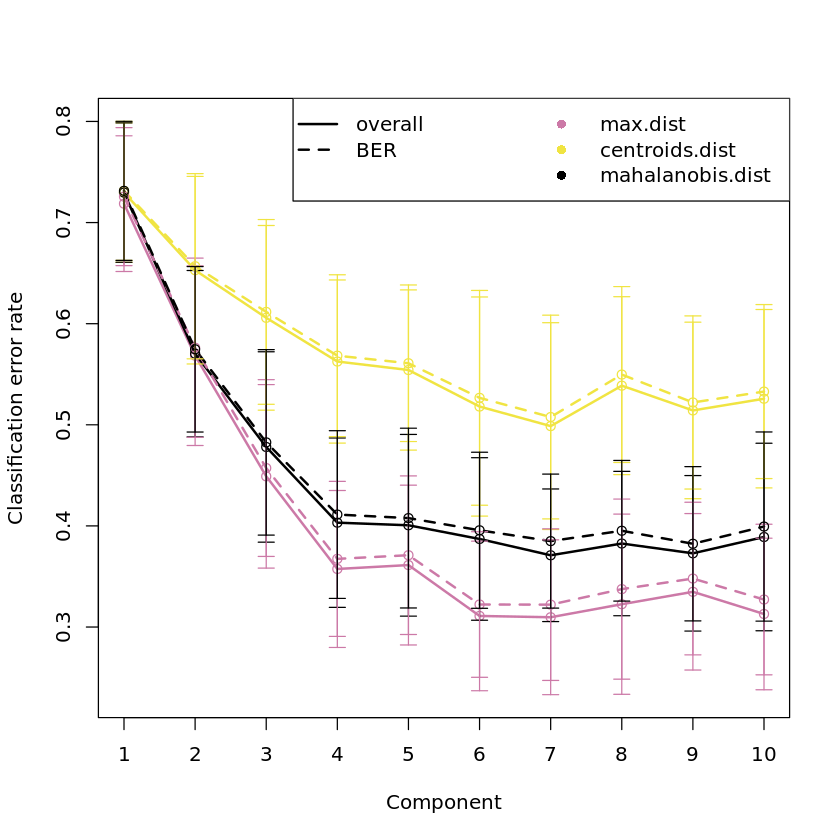

In [79]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.ko.F0 <- perf(ko.F0.splsda, validation = "Mfold", 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.ko.F0, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.ko.F0$choice.ncomp # what is the optimal value of components according to perf()

In [80]:
# Define parameters for tuning keepX
ko.F0.step <- 0.05
ko.F0.ncomp.tune <- 6
# grid of possible keepX values that will be tested for each component
ko.F0.keepx <- c(seq(10, 200, 20), seq(ceiling(dim(ko.F0$filtered)[2] * ko.F0.step), 
                      round(dim(ko.F0$filtered)[2], digits = -1), 
                      ceiling(dim(ko.F0$filtered)[2] * ko.F0.step)
                     )
                 )
ko.F0.keepx

[1]   10   30   50   70   90  110  130  150  170  190  215  430  645  860 1075
[16] 1290 1505 1720 1935 2150 2365 2580 2795 3010 3225 3440 3655 3870 4085

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%


[1] 6

comp1 comp2 comp3 comp4 comp5 comp6 
   30    50   215    30   430    30

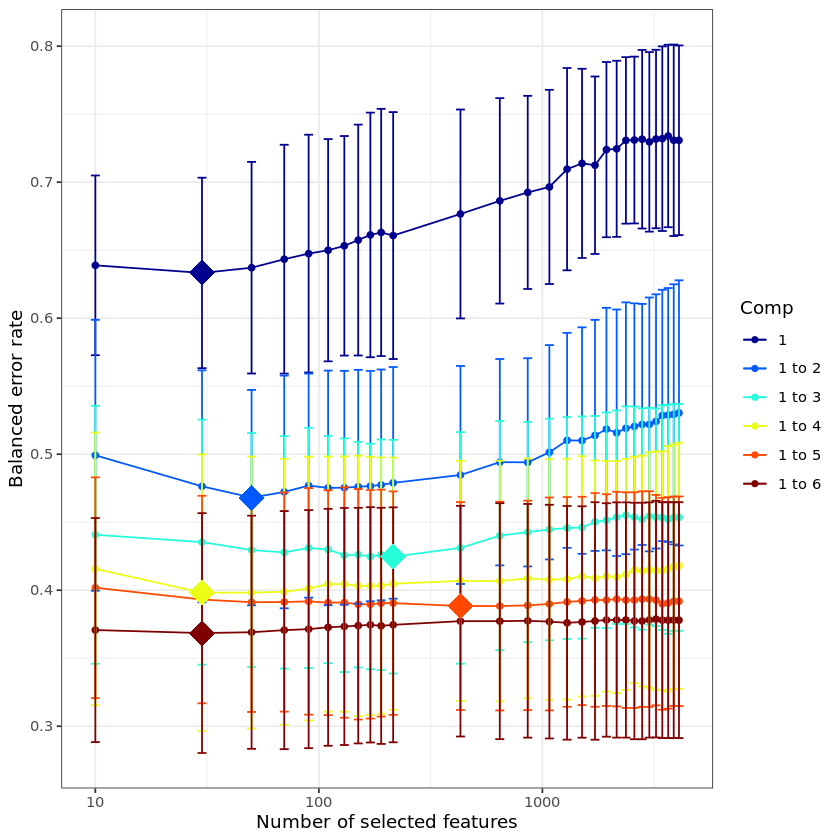

In [81]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.ko.F0 <- tune.splsda(X.ko.F0, ko.F0$treatment, ncomp = ko.F0.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = ko.F0.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.ko.F0, col = color.jet(ko.F0.ncomp.tune))

tune.splsda.ko.F0$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.ko.F0$choice.keepX # what are the optimal values of variables according to tune.splsda()

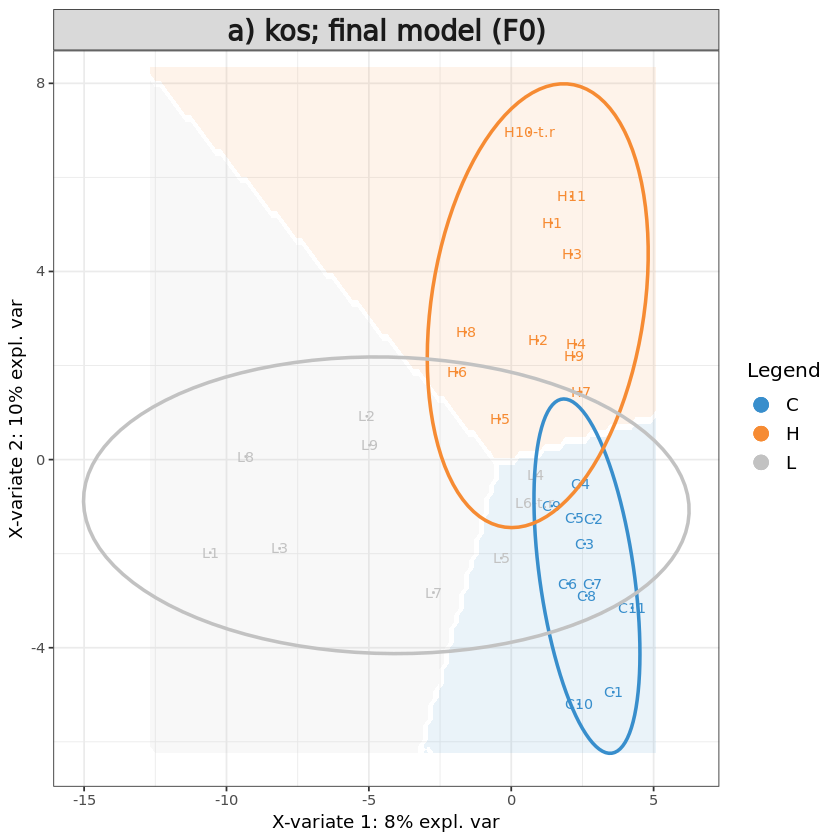

In [85]:
# Define final model
ko.F0$optimal.ncomp <- 6
#ko.F0$optimal.keepX <- tune.splsda.ko.F0$choice.keepX[1:ko.F0$optimal.ncomp]
ko.F0$optimal.keepX <- rep(50, ko.F0$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.ko.F0 <- splsda(X.ko.F0, ko.F0$treatment, 
                       ncomp = ko.F0$optimal.ncomp, 
                       keepX = ko.F0$optimal.keepX)

background = background.predict(final.splsda.ko.F0, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.ko.F0, comp = 1:2, 
          group = ko.F0$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) kos; final model (F0)')

# save sample variates
data <- as.data.frame(final.splsda.ko.F0$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F0.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

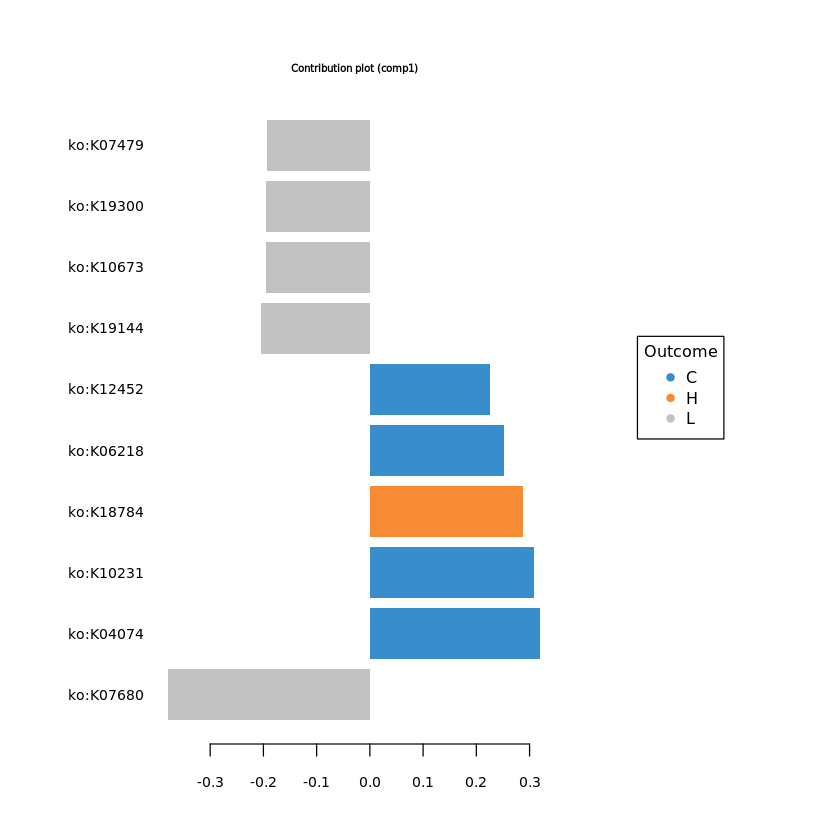

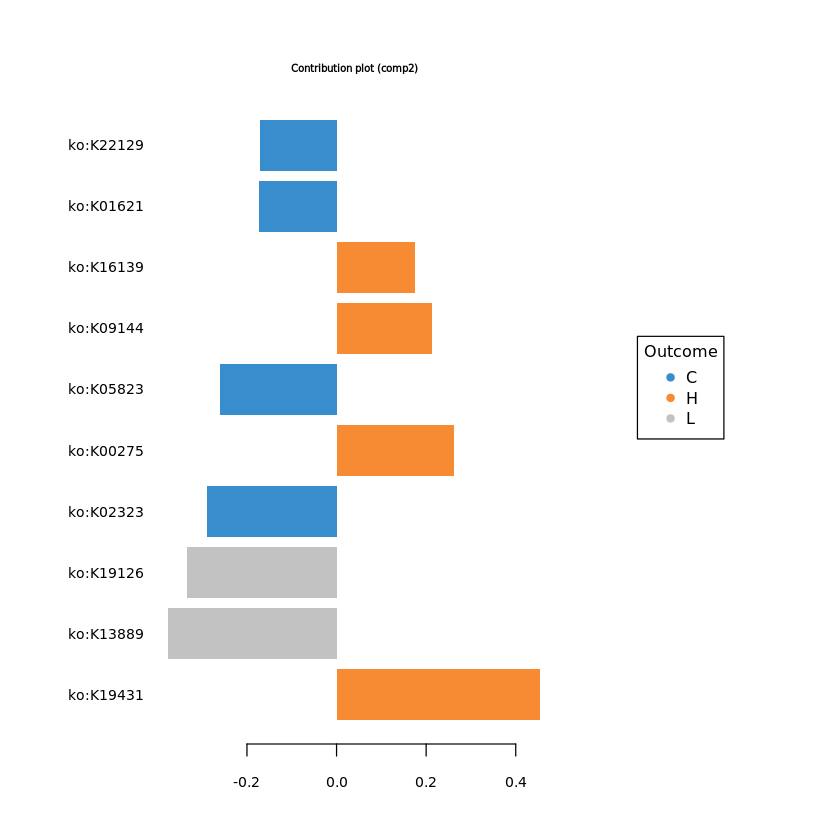

In [86]:
#plotVar(final.splsda.ko.F0, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.ko.F0, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10)
plotLoadings(final.splsda.ko.F0, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.ko.F0, comp=1)$value
load_comp2 = selectVar(final.splsda.ko.F0, comp=2)$value
F0.ko.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F0.ko.load) <- F0.ko.load[,"Row.names"]
colnames(F0.ko.load) <- c("ft","loading_comp1","loading_comp2")
F0.ko.load = F0.ko.load[,c("loading_comp1","loading_comp2")]

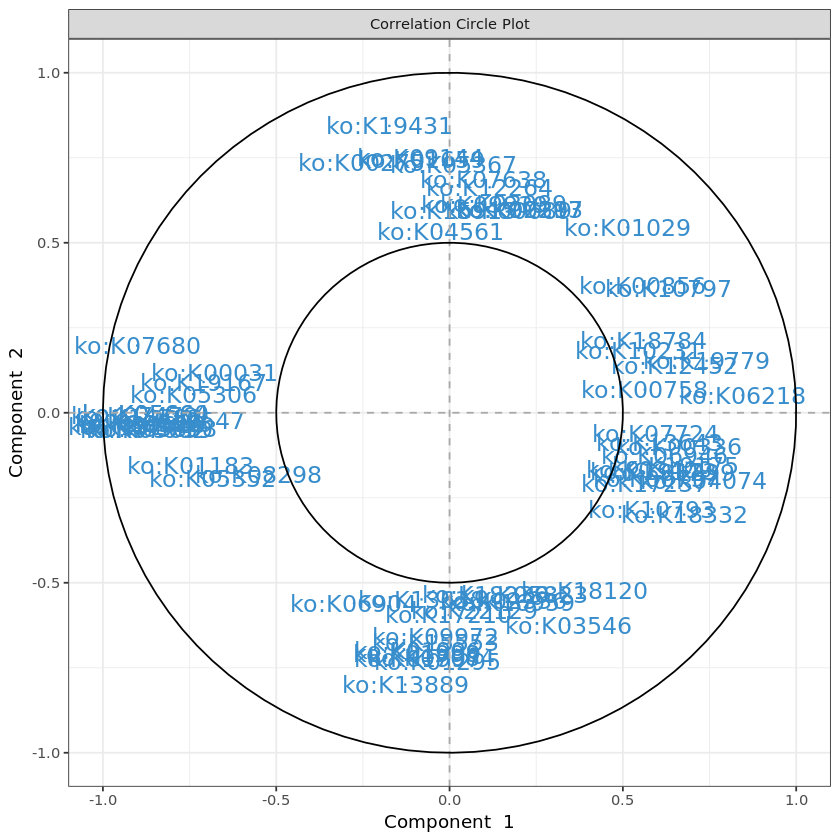

In [87]:
# plot feature correlation
plotVar(final.splsda.ko.F0, cutoff=0.5)
ko.F0.corr <- as.data.frame(plotVar(final.splsda.ko.F0, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
ko.F0.corr <- ko.F0.corr[, c("x","y")]
colnames(ko.F0.corr) <- c("corr_comp1","corr_comp2")

In [88]:
# Calculate feature stability
perf.splsda.ko.F0 <- perf(final.splsda.ko.F0, 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F0.ko.stab <- merge(data.frame(perf.splsda.ko.F0$features$stable$comp1), 
                  data.frame(perf.splsda.ko.F0$features$stable$comp2), by="Var1", all=T)
rownames(F0.ko.stab) <- F0.ko.stab$Var1
F0.ko.stab <- F0.ko.stab[, c("Freq.x","Freq.y")]
colnames(F0.ko.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%


In [89]:
# merge feature output
F0.ko.out <- merge(F0.ko.load, F0.ko.stab, by="row.names")
rownames(F0.ko.out) <- F0.ko.out[,"Row.names"]
F0.ko.out <- merge(F0.ko.out[, 2:ncol(F0.ko.out)], ko.F0.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F0.features.tsv", F0.ko.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [90]:
train <- sample(1:nrow(X.ko.F0), ceiling(nrow(X.ko.F0)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.ko.F0), train) # rest is part of the test set

# store matrices into training and test set:
X.ko.F0.train <- X.ko.F0[train, ]
X.ko.F0.test <- X.ko.F0[test,]
Y.ko.F0.train <- info[train,"treatment"]
Y.ko.F0.test <- info[test, "treatment"]
train.splsda.ko.F0 <- splsda(X.ko.F0.train, Y.ko.F0.train, ncomp = ko.F0$optimal.ncomp, keepX = ko.F0$optimal.keepX)
predict.splsda.ko.F0 <- predict(train.splsda.ko.F0, X.ko.F0.test, 
                                dist = "max.dist")
predict.comp2.ko.F0 <- predict.splsda.ko.F0$class$max.dist[,2]
table(factor(predict.comp2.ko.F0, levels = levels(ko.F0$treatment)), Y.ko.F0.test)

   Y.ko.F0.test
    C H L
  C 4 3 2
  H 0 3 4
  L 4 2 1

$Comp1
                 AUC   p-value
C vs Other(s) 0.9364 7.387e-05
H vs Other(s) 0.4636 7.412e-01
L vs Other(s) 0.9444 1.283e-04

$Comp2
                 AUC   p-value
C vs Other(s) 1.0000 5.586e-06
H vs Other(s) 1.0000 5.586e-06
L vs Other(s) 0.9596 7.486e-05

$Comp3
                 AUC   p-value
C vs Other(s) 1.0000 5.586e-06
H vs Other(s) 1.0000 5.586e-06
L vs Other(s) 0.9596 7.486e-05

$Comp4
              AUC   p-value
C vs Other(s)   1 5.586e-06
H vs Other(s)   1 5.586e-06
L vs Other(s)   1 1.644e-05

$Comp5
              AUC   p-value
C vs Other(s)   1 5.586e-06
H vs Other(s)   1 5.586e-06
L vs Other(s)   1 1.644e-05

$Comp6
              AUC   p-value
C vs Other(s)   1 5.586e-06
H vs Other(s)   1 5.586e-06
L vs Other(s)   1 1.644e-05



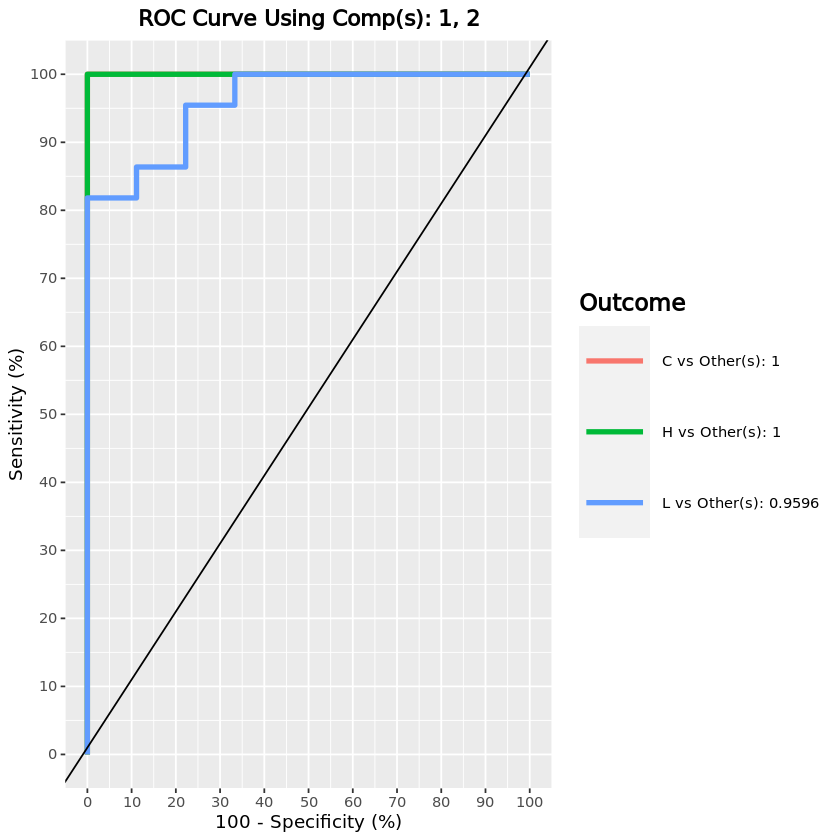

In [91]:
F0.ko.auc.splsda = auroc(final.splsda.ko.F0, roc.comp = 2, print = T) # AUROC for the first component

#### kos - F0 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [92]:
ko.F0_2 <- list()
F0_info_2 <- info[rownames(ko.F0$cov),]
F0_info_2$treatment <- gsub(x = F0_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
ko.F0_2$cov <- ko.F0$cov[rownames(F0_info_2),]
ko.F0_2$filtered <- ko.F0$filtered[rownames(F0_info_2),]

ko.F0_2$clr <- ko.F0$clr[rownames(F0_info_2), ]
X.ko.F0_2 <- ko.F0_2$clr

ko.F0_2$treatment <- factor(F0_info_2[rownames(ko.F0_2$clr), "treatment"])

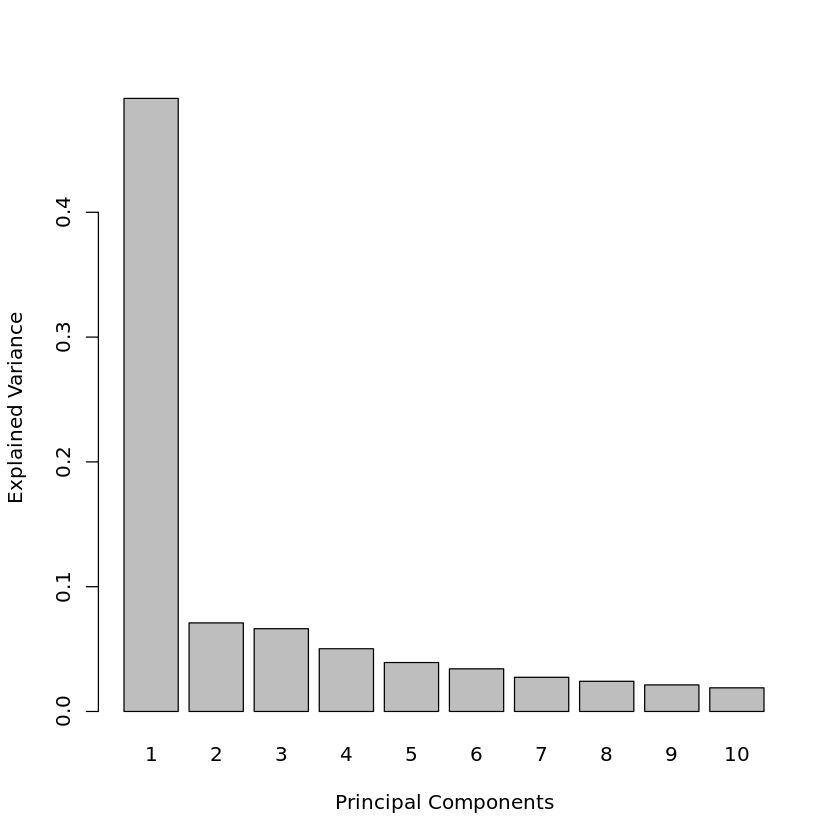

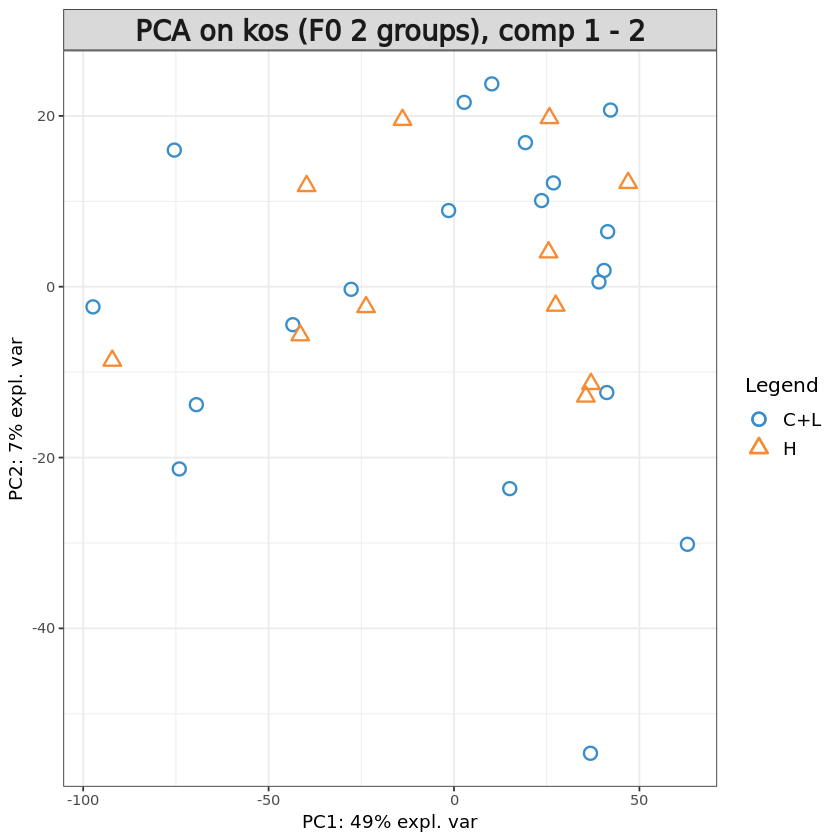

In [93]:
pca.ko.F0_2 = pca(X.ko.F0_2, ncomp = 10, center = TRUE, scale = TRUE) 

plot(pca.ko.F0_2)
plotIndiv(pca.ko.F0_2, group = ko.F0_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on kos (F0 2 groups), comp 1 - 2')

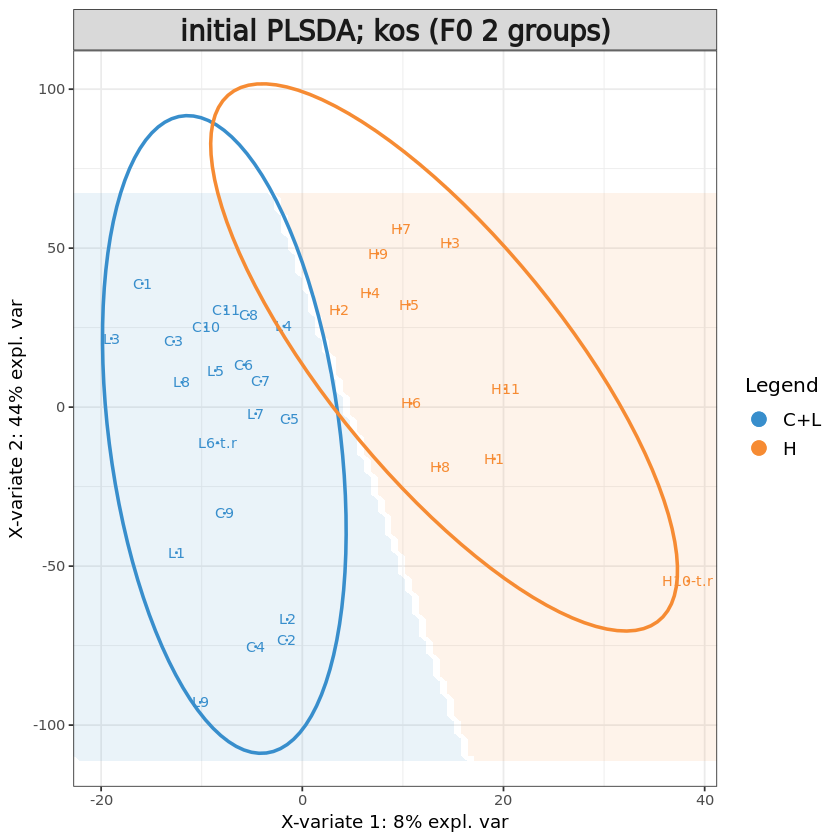

In [94]:
# Initial sPLS-DA model
ko.F0_2.splsda <- splsda(X.ko.F0_2, ko.F0_2$treatment, ncomp = 10)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(ko.F0_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(ko.F0_2.splsda, comp = 1:2, ellipse = TRUE,
          group = ko.F0_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; kos (F0 2 groups)")

The initial model separates the two treatment groups.

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,6,9,6
BER,6,9,6


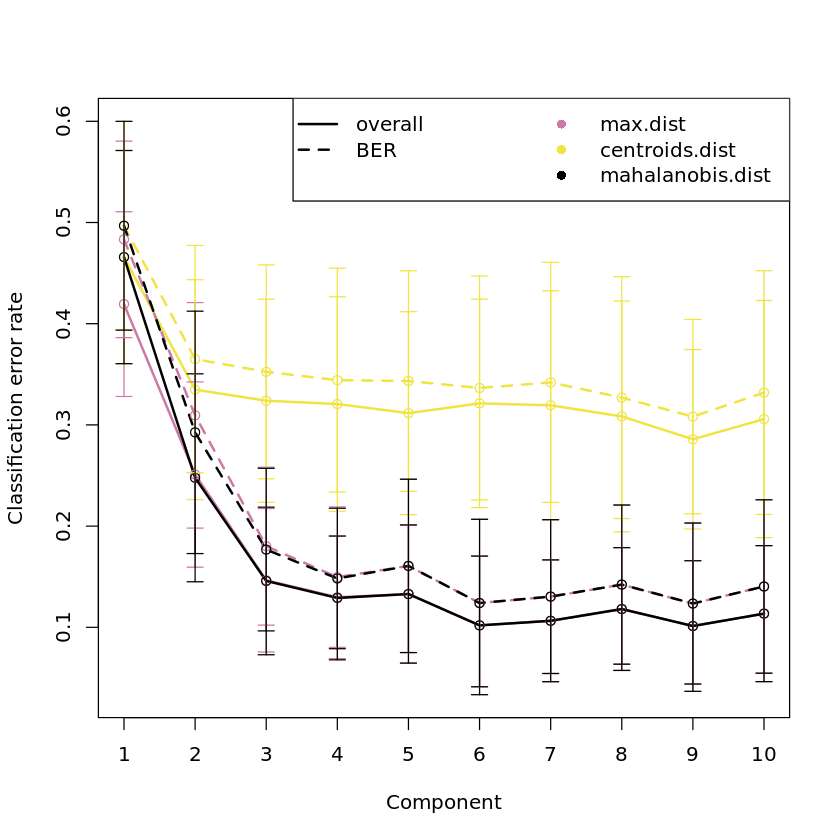

In [95]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.ko.F0_2 <- perf(ko.F0_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.ko.F0_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.ko.F0_2$choice.ncomp # what is the optimal value of components according to perf()

We set number of components to 3 and tune number of features used.

In [96]:
# Define parameters for tuning keepX
ko.F0_2.step <- 0.05
ko.F0_2.ncomp.tune <- 6
# grid of possible keepX values that will be tested for each component
ko.F0_2.keepx <- c(seq(10, 200, 20), seq(ceiling(dim(ko.F0$filtered)[2] * ko.F0.step), 
                      round(dim(ko.F0$filtered)[2], digits = -1), 
                      ceiling(dim(ko.F0$filtered)[2] * ko.F0.step)
                     )
                 )
ko.F0_2.keepx

[1]   10   30   50   70   90  110  130  150  170  190  215  430  645  860 1075
[16] 1290 1505 1720 1935 2150 2365 2580 2795 3010 3225 3440 3655 3870 4085

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%


[1] 4

comp1 comp2 comp3 comp4 comp5 comp6 
  645   130   430  1935    90    10

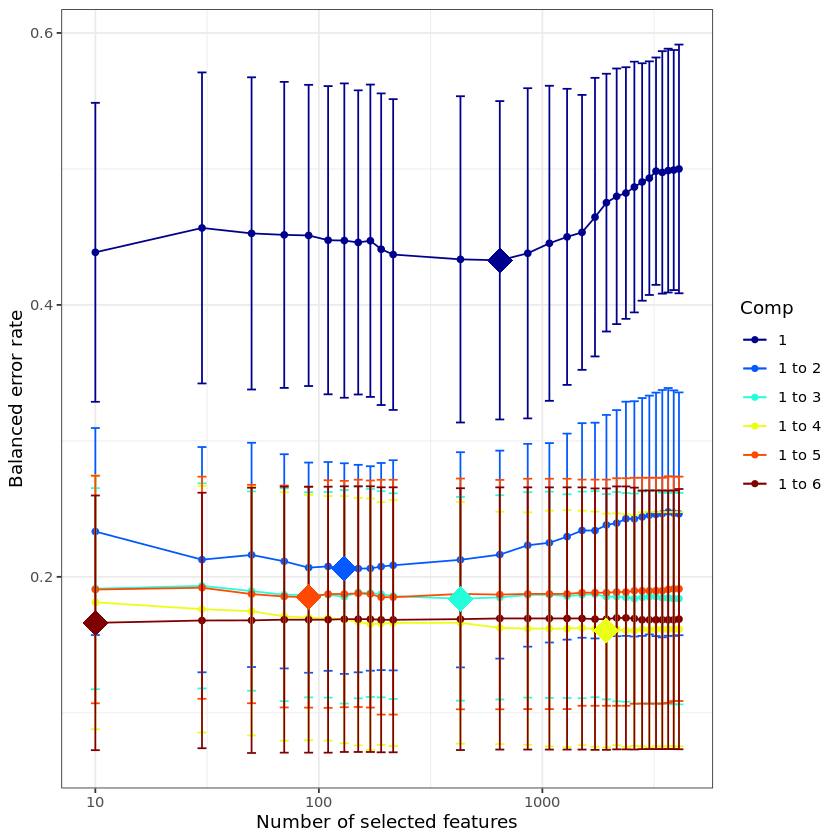

In [97]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.ko.F0_2 <- tune.splsda(X.ko.F0_2, ko.F0_2$treatment, ncomp = ko.F0_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = ko.F0_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.ko.F0_2, col = color.jet(ko.F0_2.ncomp.tune))

tune.splsda.ko.F0_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.ko.F0_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

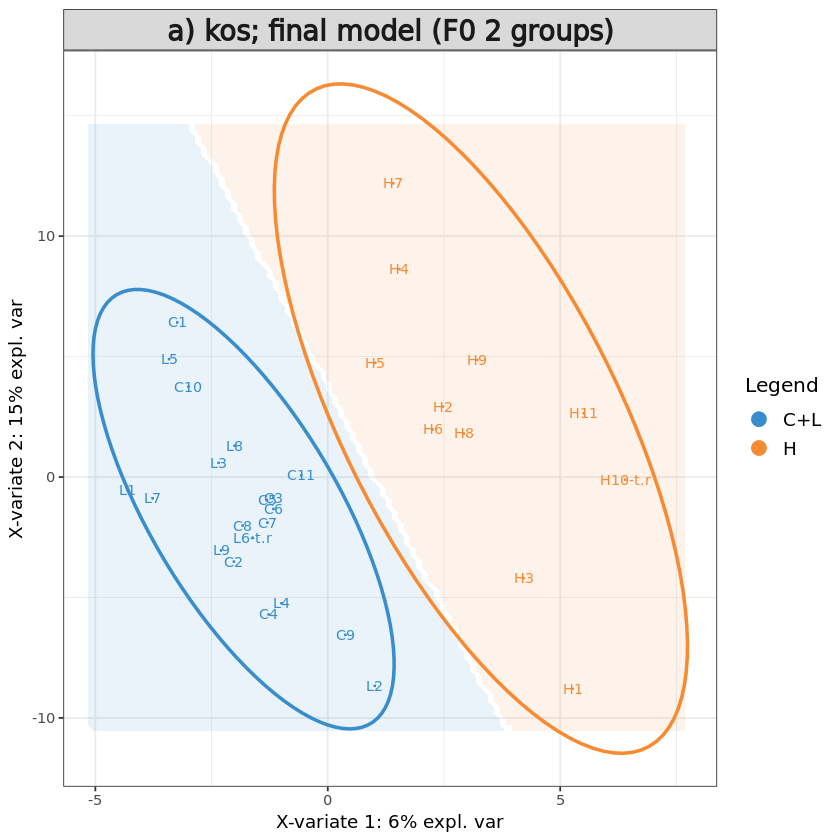

In [100]:
# Define final model
ko.F0_2$optimal.ncomp <- 4
#ko.F0_2$optimal.keepX <- tune.splsda.ko.F0_2$choice.keepX[1:ko.F0_2$optimal.ncomp]
ko.F0_2$optimal.keepX <- rep(50, ko.F0_2$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.ko.F0_2 <- splsda(X.ko.F0_2, ko.F0_2$treatment, 
                       ncomp = ko.F0_2$optimal.ncomp, 
                       keepX = ko.F0_2$optimal.keepX)

background = background.predict(final.splsda.ko.F0_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.ko.F0_2, comp = 1:2, 
          group = ko.F0_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) kos; final model (F0 2 groups)')

# save sample variates
data <- as.data.frame(final.splsda.ko.F0$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F0_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

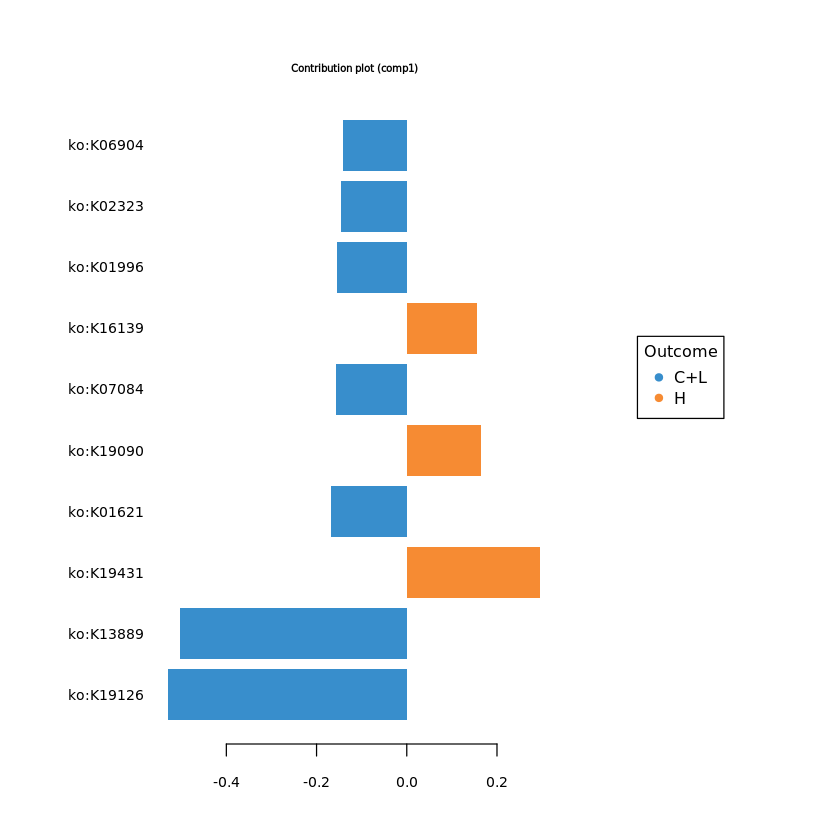

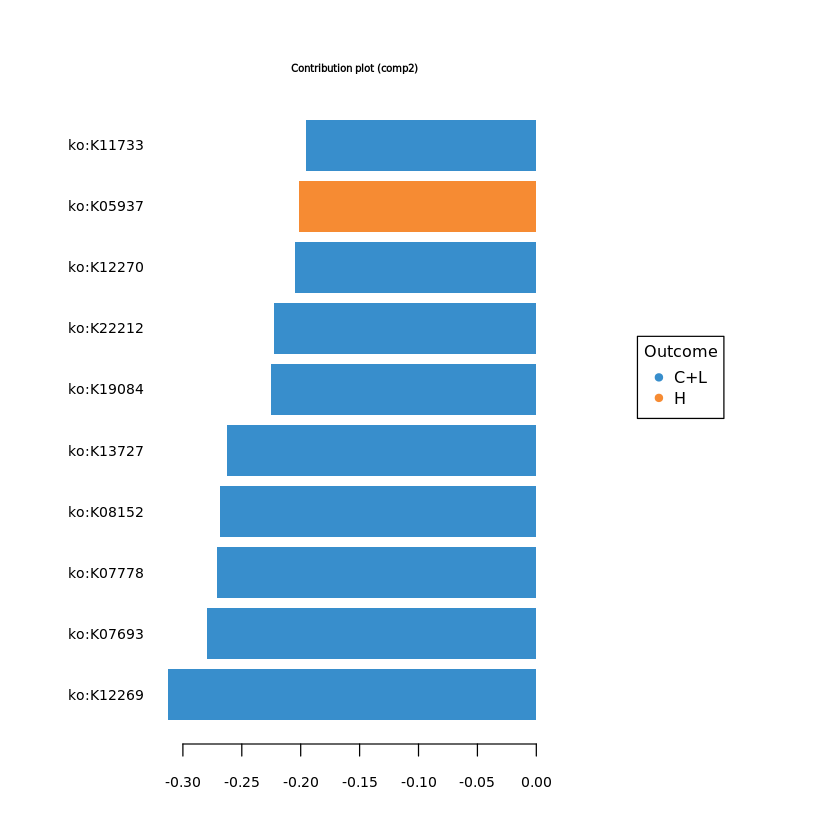

In [101]:
#plotVar(final.splsda.ko.F0_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.ko.F0_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.ko.F0_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)
# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.ko.F0_2, comp=1)$value
load_comp2 = selectVar(final.splsda.ko.F0_2, comp=2)$value
F0_2.ko.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F0_2.ko.load) <- F0_2.ko.load[,"Row.names"]
colnames(F0_2.ko.load) <- c("ft","loading_comp1","loading_comp2")
F0_2.ko.load = F0_2.ko.load[,c("loading_comp1","loading_comp2")]

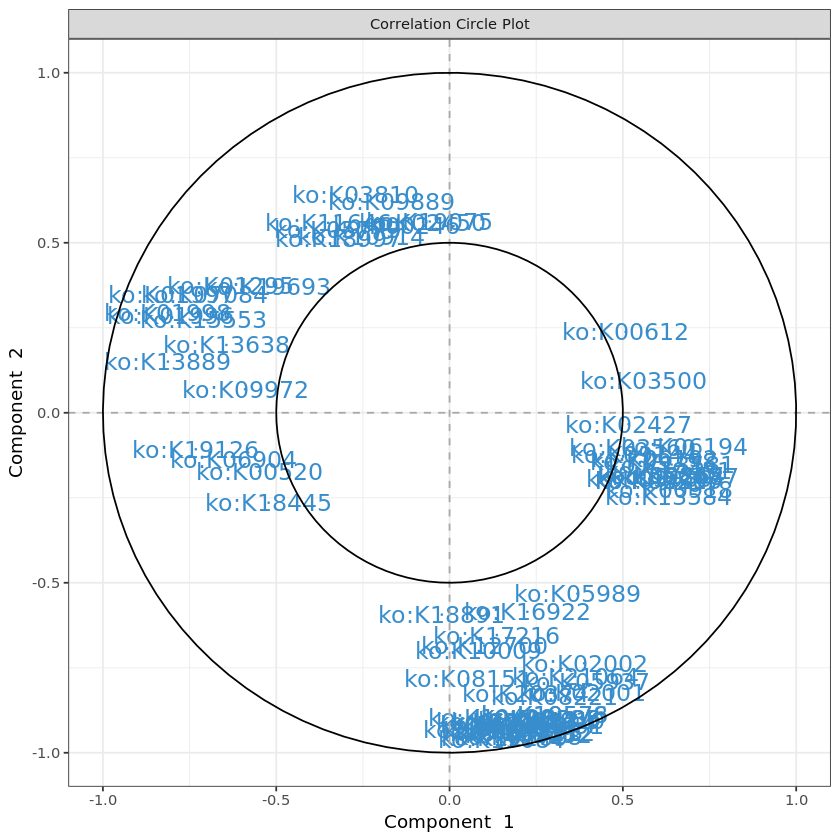

In [102]:
# plot feature correlation
plotVar(final.splsda.ko.F0_2, cutoff=0.5)
ko.F0_2.corr <- as.data.frame(plotVar(final.splsda.ko.F0_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
ko.F0_2.corr <- ko.F0_2.corr[, c("x","y")]
colnames(ko.F0_2.corr) <- c("corr_comp1","corr_comp2")

In [103]:
# Calculate feature stability
perf.splsda.ko.F0_2 <- perf(final.splsda.ko.F0_2, 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F0_2.ko.stab <- merge(data.frame(perf.splsda.ko.F0_2$features$stable$comp1), 
                  data.frame(perf.splsda.ko.F0_2$features$stable$comp2), by="Var1", all=T)
rownames(F0_2.ko.stab) <- F0_2.ko.stab$Var1
F0_2.ko.stab <- F0_2.ko.stab[, c("Freq.x","Freq.y")]
colnames(F0_2.ko.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%


In [104]:
# merge feature output
F0_2.ko.out <- merge(F0_2.ko.load, F0_2.ko.stab, by="row.names")
rownames(F0_2.ko.out) <- F0_2.ko.out[,"Row.names"]
F0_2.ko.out <- merge(F0_2.ko.out[, 2:ncol(F0_2.ko.out)], ko.F0_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F0_2.features.tsv", F0_2.ko.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [105]:
train <- sample(1:nrow(X.ko.F0_2), ceiling(nrow(X.ko.F0_2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.ko.F0_2), train) # rest is part of the test set

# store matrices into training and test set:
X.ko.F0_2.train <- X.ko.F0_2[train, ]
X.ko.F0_2.test <- X.ko.F0_2[test,]
Y.ko.F0_2.train <- F0_info_2[train,"treatment"]
Y.ko.F0_2.test <- F0_info_2[test, "treatment"]
train.splsda.ko.F0_2 <- splsda(X.ko.F0_2.train, Y.ko.F0_2.train, ncomp = ko.F0_2$optimal.ncomp, keepX = ko.F0_2$optimal.keepX)
predict.splsda.ko.F0_2 <- predict(train.splsda.ko.F0_2, X.ko.F0_2.test, 
                                dist = "max.dist")
predict.comp2.ko.F0_2 <- predict.splsda.ko.F0_2$class$max.dist[,2]
table(factor(predict.comp2.ko.F0_2, levels = levels(ko.F0_2$treatment)), Y.ko.F0_2.test)

     Y.ko.F0_2.test
      C+L  H
  C+L  13  9
  H     0  1

$Comp1
         AUC   p-value
C+L vs H   1 5.586e-06

$Comp2
         AUC   p-value
C+L vs H   1 5.586e-06

$Comp3
         AUC   p-value
C+L vs H   1 5.586e-06

$Comp4
         AUC   p-value
C+L vs H   1 5.586e-06



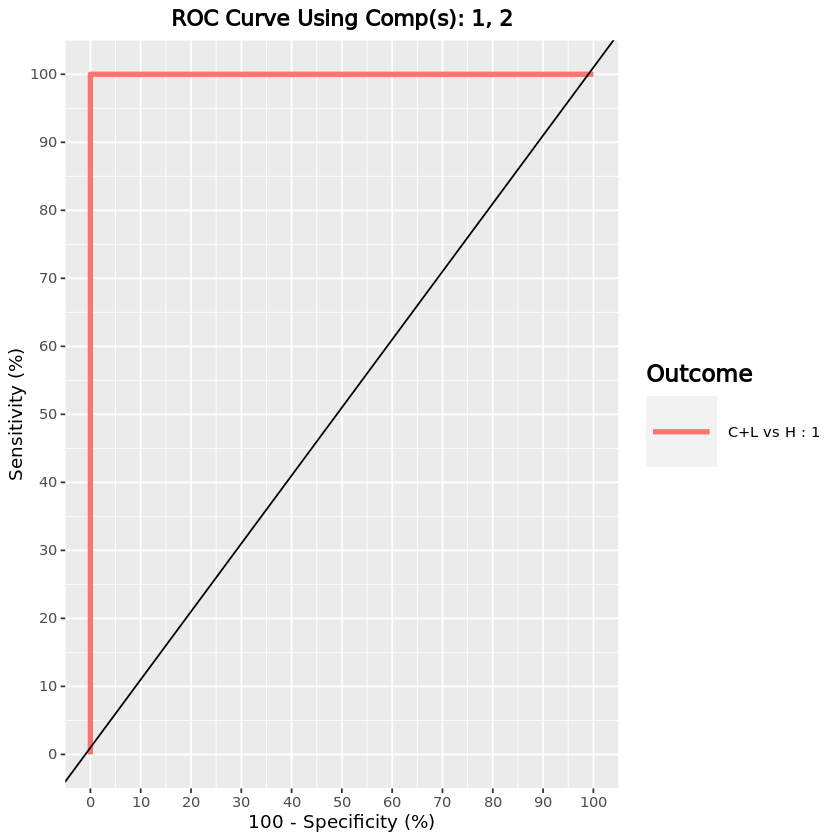

In [106]:
F0_2.ko.auc.splsda = auroc(final.splsda.ko.F0_2, roc.comp = 2, print = T) # AUROC for the first component

#### kos - F1 generation

[1] "1713"        "kos removed" "4213"        "remaining"

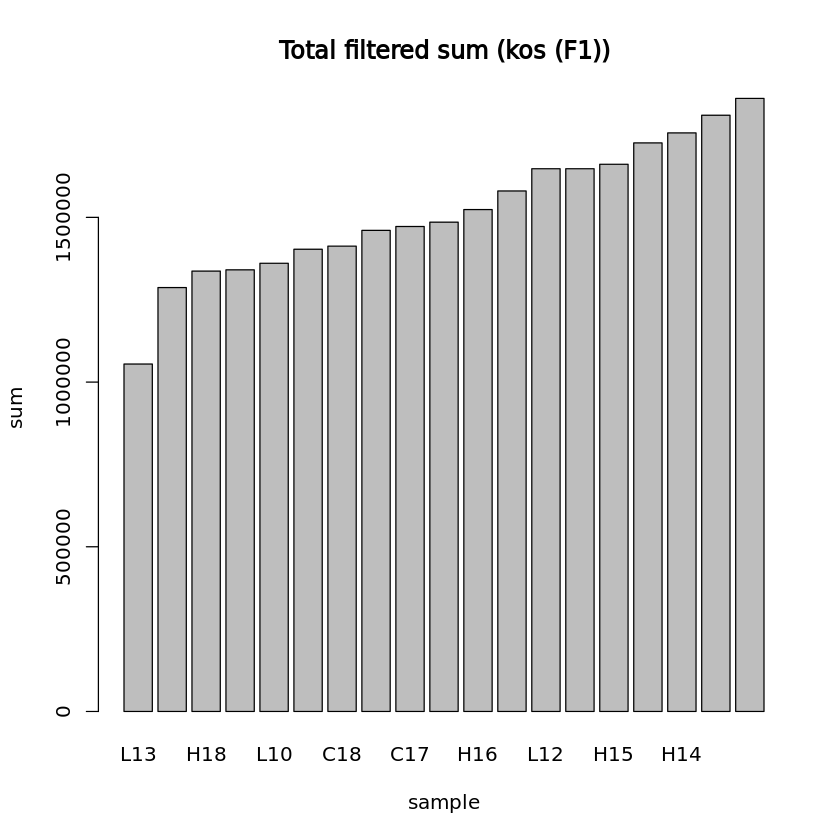

In [107]:
## PARAMS ##
# Initial components
ko.F1.ncomp <- 5
# Percentage of samples in which features must have >0 sum
ko.F1.percent_occ <- 10
# Quantile used for removing low abundance features
ko.F1.quantile_thresh <- 0.1
generation <- "F1"

ko.F1 <- list()
ko.F1$cov <- ko$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(ko.F1$cov[, colSums(ko.F1$cov) > 0])
ko.F1$nz <- ko.F1$cov[, colnames(ko.F1$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(ko.F1$nz) / sum(colSums(ko.F1$nz)) * 100, probs = ko.F1.quantile_thresh)
ko.F1$filtered <- low.count.removal(ko.F1$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
ko.F1$occ <- colSums(ko.F1$filtered>0) / nrow(ko.F1$filtered) * 100
# Keep features occurring in defined percentage of samples
ko.F1$filtered <- ko.F1$filtered[, which(ko.F1$occ >= ko.F1.percent_occ)]

#ko.F1$filtered <- ko.F1$filtered[,-nearZeroVar(ko.F1$filtered)$Position]
paste0(c(dim(ko.F1$cov)[2] - dim(ko.F1$filtered)[2], "kos removed", dim(ko.F1$filtered)[2], "remaining"))

# Add offset
ko.F1$offset <- ko.F1$filtered + 1
ko.F1$clr <- logratio.transfo(ko.F1$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.ko.F1 <- ko.F1$clr

ko.F1$treatment <- factor(info[rownames(ko.F1$clr), "Treatment"])
ko.F1.lib.size <- apply(ko.F1$filtered, 1, sum) # determine total count for each sample
barplot(sort(ko.F1.lib.size), main="Total filtered sum (kos (F1))", ylab="sum", xlab="sample")

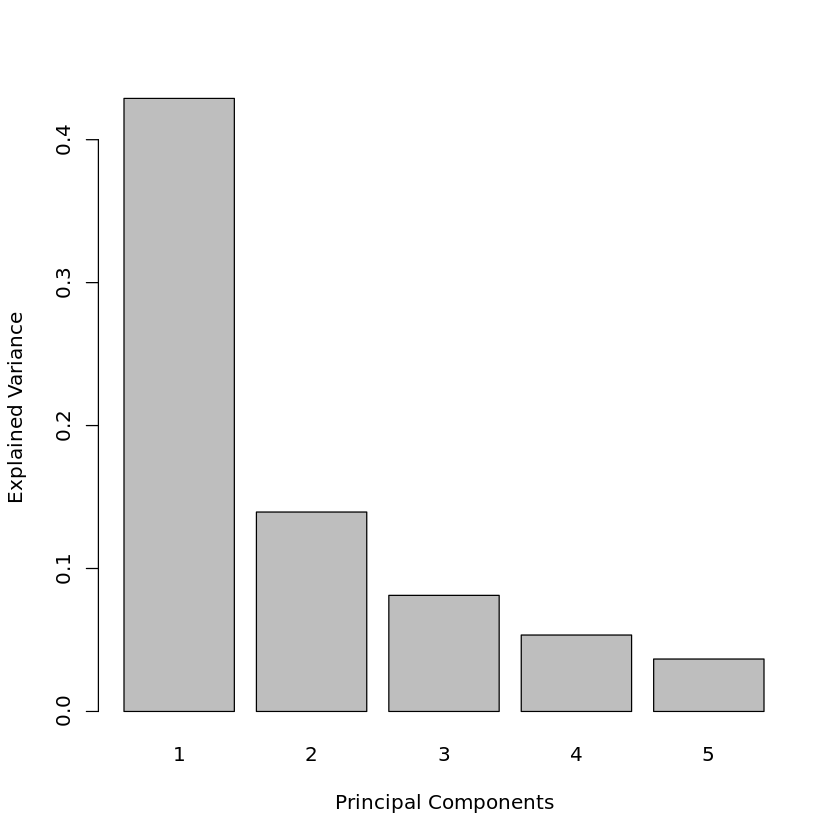

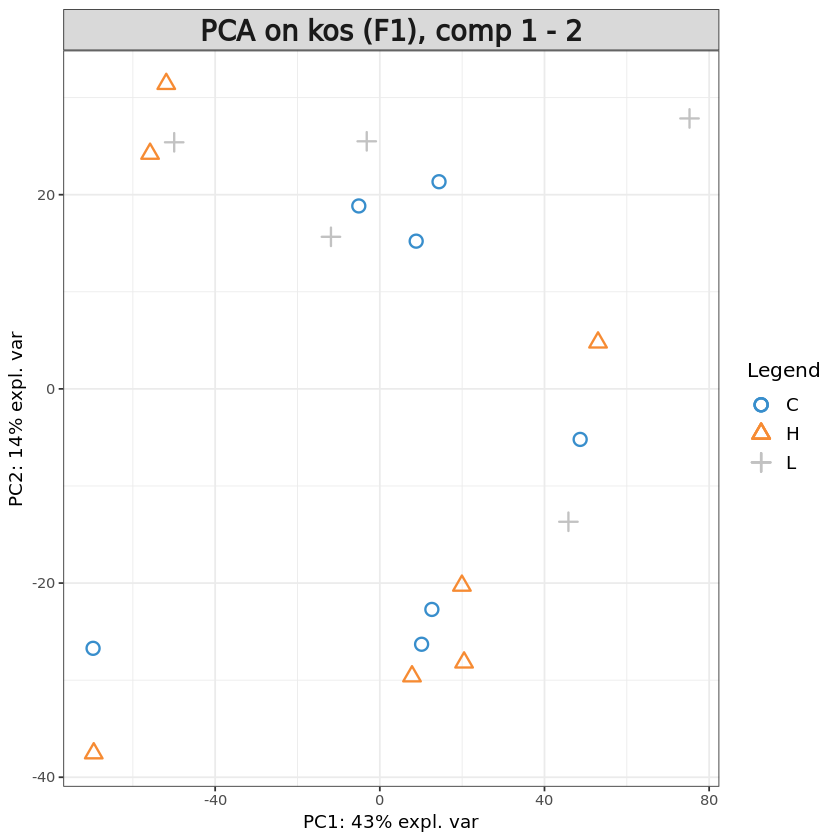

In [108]:
pca.ko.F1 = pca(X.ko.F1, ncomp = ko.F1.ncomp, center = TRUE, scale = TRUE) 

plot(pca.ko.F1)
plotIndiv(pca.ko.F1, group = ko.F1$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on kos (F1), comp 1 - 2')

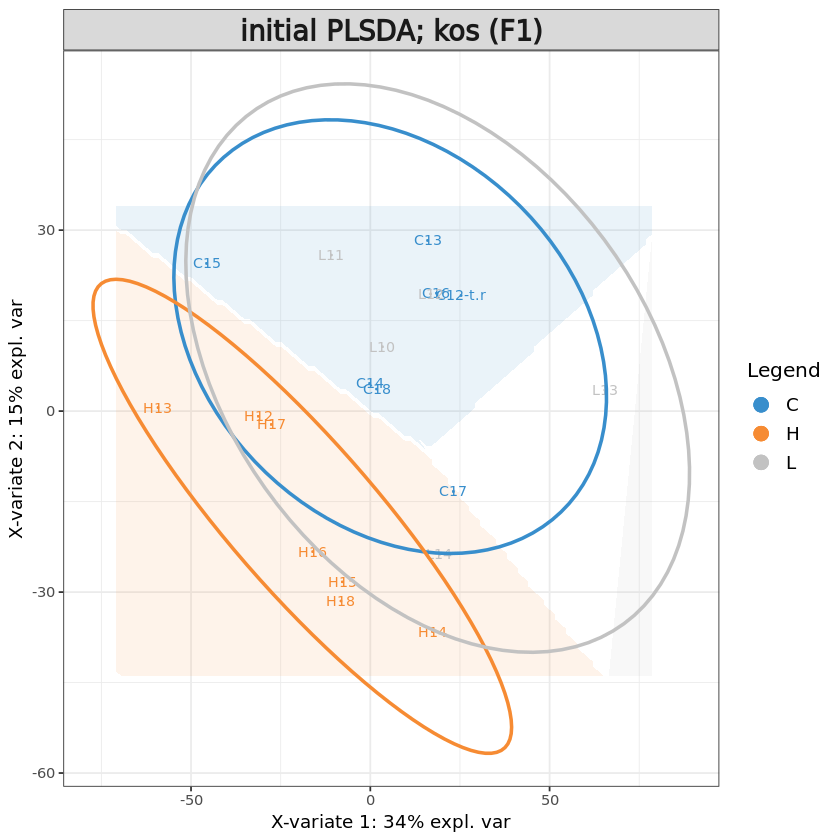

In [109]:
# Initial sPLS-DA model
ko.F1.splsda <- splsda(X.ko.F1, ko.F1$treatment, ncomp = ko.F1.ncomp)  # set ncomp to 10 for performance assessment later

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(ko.F1.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(ko.F1.splsda, comp = 1:2, ellipse = TRUE,
          group = ko.F1$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; kos (F1)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,5,1,3
BER,5,1,3


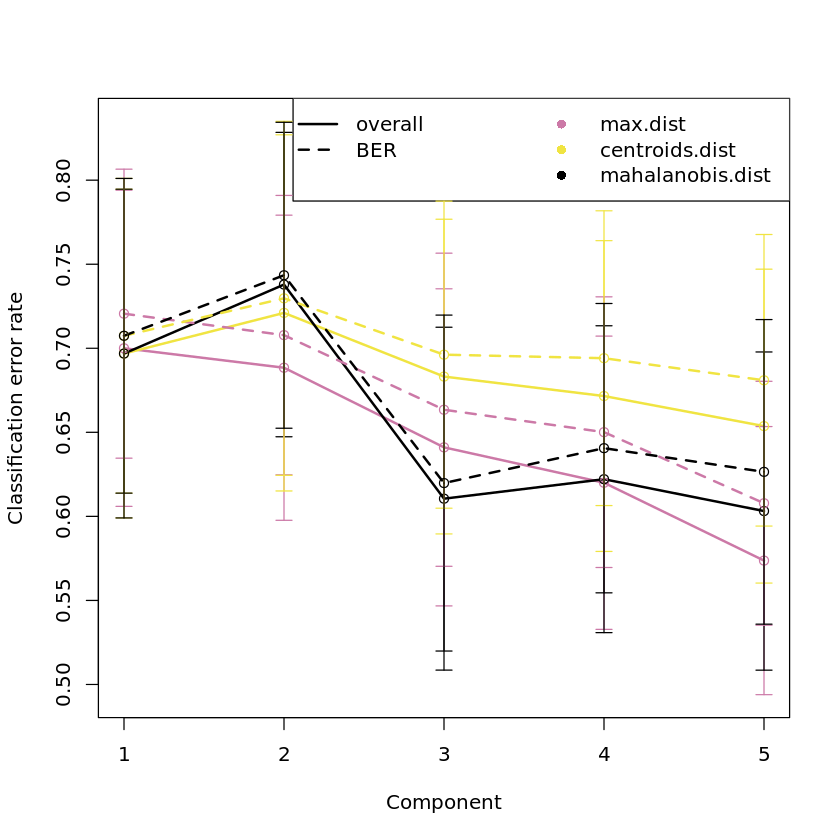

In [110]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.ko.F1 <- perf(ko.F1.splsda, validation = "Mfold", 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.ko.F1, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.ko.F1$choice.ncomp # what is the optimal value of components according to perf()

In [111]:
# Define parameters for tuning keepX
ko.F1.step <- 0.05
ko.F1.ncomp.tune <- 5
# grid of possible keepX values that will be tested for each component
ko.F1.keepx <- c(seq(10, 250, 10), seq(ceiling(dim(ko.F1$filtered)[2] * ko.F1.step), 
                      round(dim(ko.F1$filtered)[2], digits = -1), 
                      ceiling(dim(ko.F1$filtered)[2] * ko.F1.step)
                     )
                 )
ko.F1.keepx

[1]   10   20   30   40   50   60   70   80   90  100  110  120  130  140  150
[16]  160  170  180  190  200  210  220  230  240  250  211  422  633  844 1055
[31] 1266 1477 1688 1899 2110 2321 2532 2743 2954 3165 3376 3587 3798 4009

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


[1] 1

comp1 comp2 comp3 comp4 comp5 
   20   220  3587    10    10

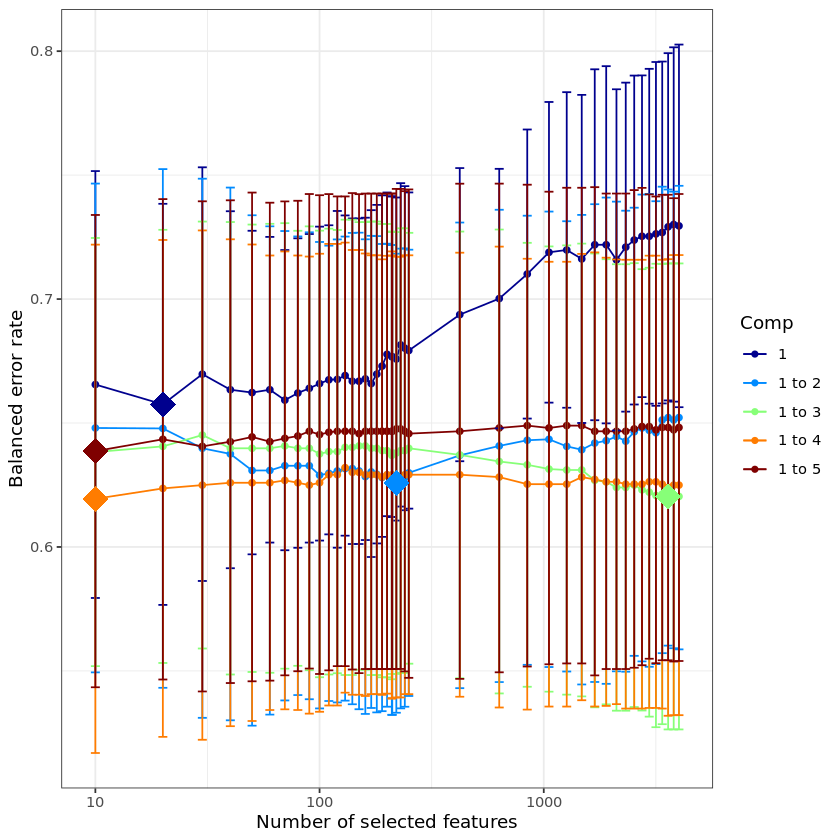

In [112]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.ko.F1 <- tune.splsda(X.ko.F1, ko.F1$treatment, ncomp = ko.F1.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = ko.F1.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.ko.F1, col = color.jet(ko.F1.ncomp.tune))

tune.splsda.ko.F1$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.ko.F1$choice.keepX # what are the optimal values of variables according to tune.splsda()

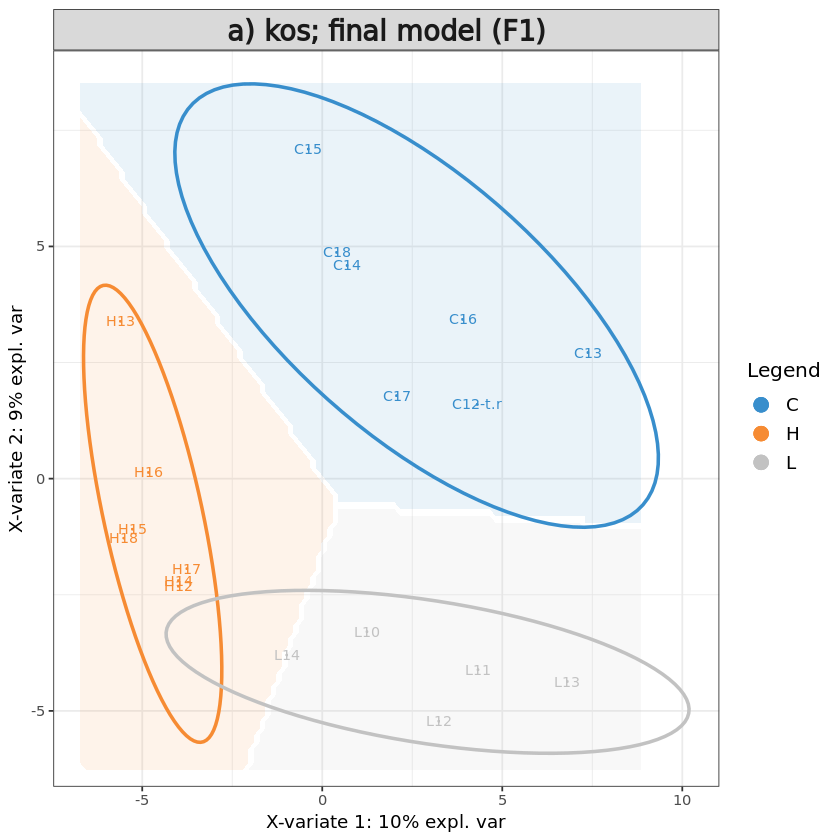

In [113]:
# Define final model
ko.F1$optimal.ncomp <- 2
#ko.F1$optimal.keepX <- tune.splsda.ko.F1$choice.keepX[1:ko.F1$optimal.ncomp]
ko.F1$optimal.keepX <- rep(50, ko.F1$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.ko.F1 <- splsda(X.ko.F1, ko.F1$treatment, 
                       ncomp = ko.F1$optimal.ncomp, 
                       keepX = ko.F1$optimal.keepX)

background = background.predict(final.splsda.ko.F1, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.ko.F1, comp = 1:2, 
          group = ko.F1$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) kos; final model (F1)')

# save sample variates
data <- as.data.frame(final.splsda.ko.F1$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F1.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

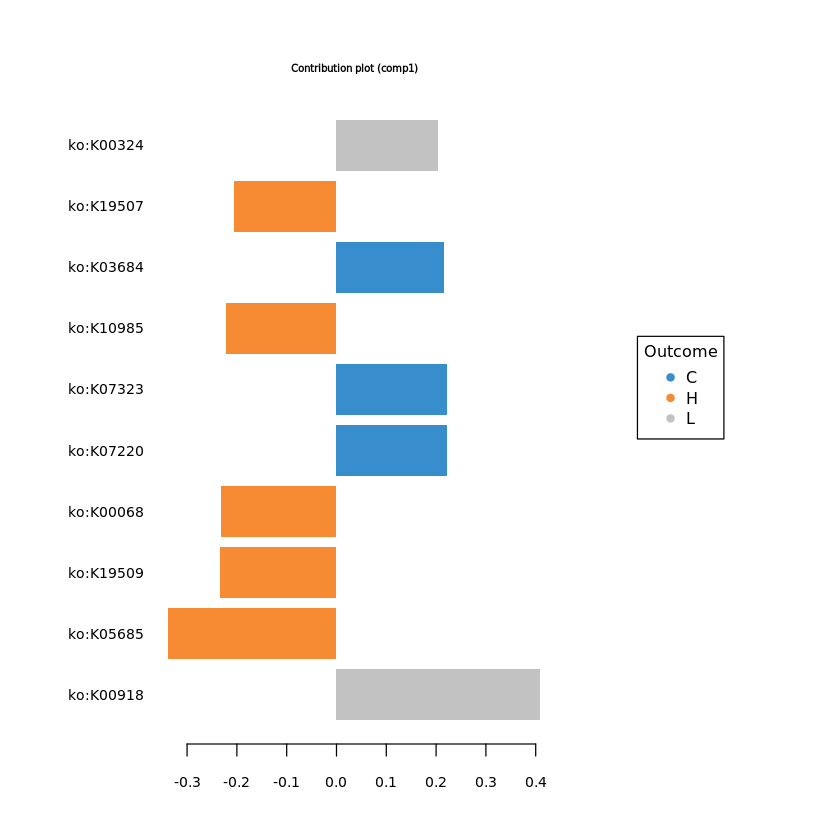

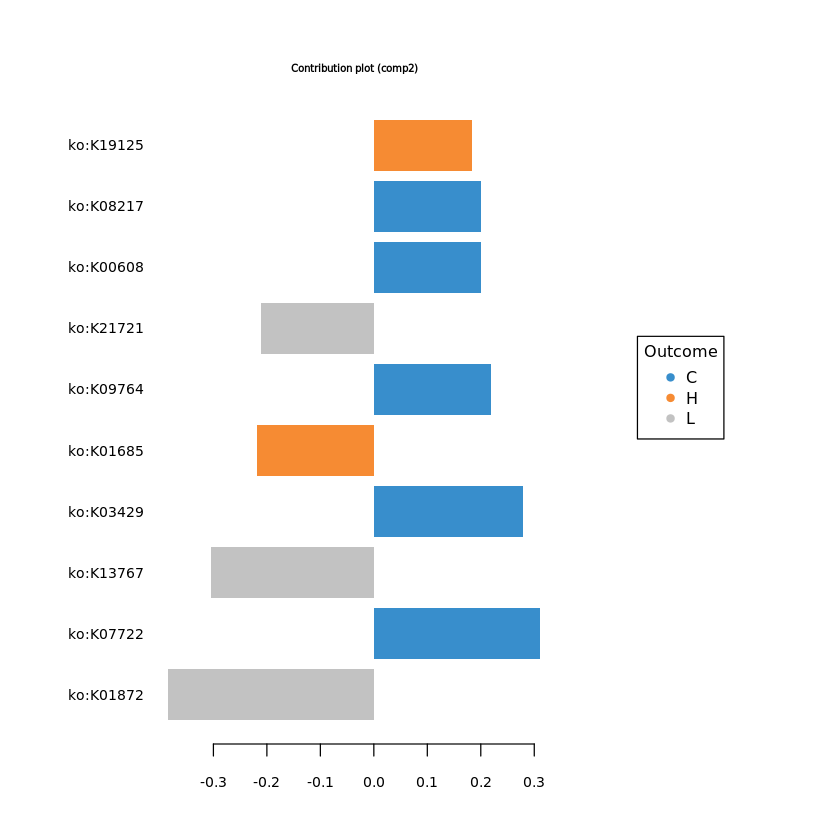

In [114]:
#plotVar(final.splsda.ko.F1, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.ko.F1, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.ko.F1, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.ko.F1, comp=1)$value
load_comp2 = selectVar(final.splsda.ko.F1, comp=2)$value
F1.ko.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F1.ko.load) <- F1.ko.load[,"Row.names"]
colnames(F1.ko.load) <- c("ft","loading_comp1","loading_comp2")
F1.ko.load = F1.ko.load[,c("loading_comp1","loading_comp2")]

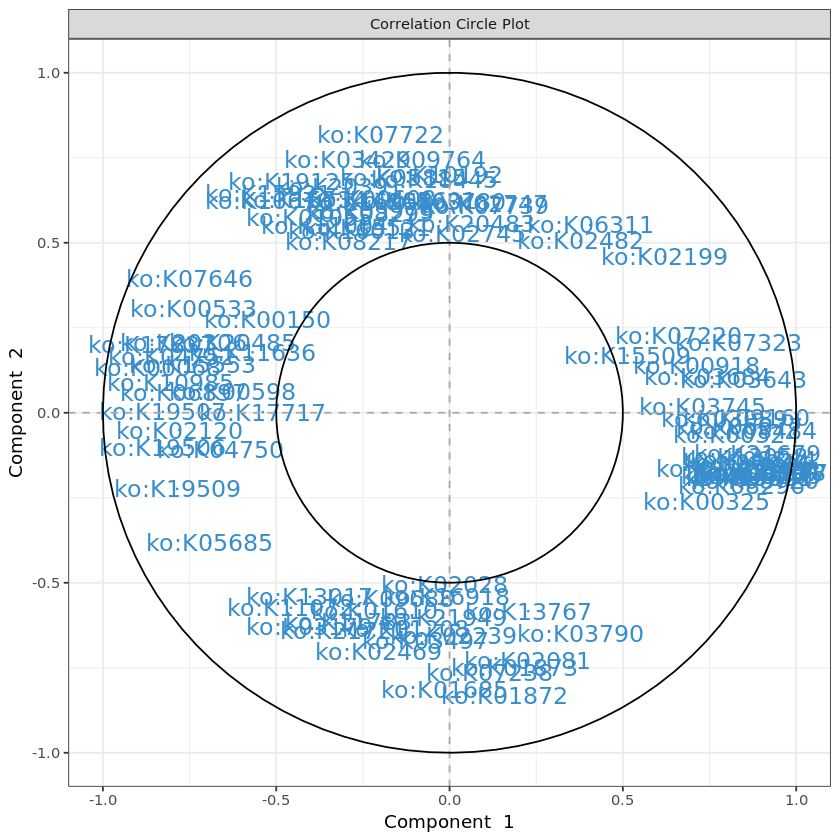

In [115]:
# plot feature correlation
plotVar(final.splsda.ko.F1, cutoff=0.5)
ko.F1.corr <- as.data.frame(plotVar(final.splsda.ko.F1, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
ko.F1.corr <- ko.F1.corr[, c("x","y")]
colnames(ko.F1.corr) <- c("corr_comp1","corr_comp2")

In [116]:
# Calculate feature stability
perf.splsda.ko.F1 <- perf(final.splsda.ko.F1, 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F1.ko.stab <- merge(data.frame(perf.splsda.ko.F1$features$stable$comp1), 
                  data.frame(perf.splsda.ko.F1$features$stable$comp2), by="Var1", all=T)
rownames(F1.ko.stab) <- F1.ko.stab$Var1
F1.ko.stab <- F1.ko.stab[, c("Freq.x","Freq.y")]
colnames(F1.ko.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [117]:
# merge feature output
F1.ko.out <- merge(F1.ko.load, F1.ko.stab, by="row.names")
rownames(F1.ko.out) <- F1.ko.out[,"Row.names"]
F1.ko.out <- merge(F1.ko.out[, 2:ncol(F1.ko.out)], ko.F1.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F1.features.tsv", F1.ko.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [118]:
train <- sample(1:nrow(X.ko.F1), ceiling(nrow(X.ko.F1)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.ko.F1), train) # rest is part of the test set

# store matrices into training and test set:
X.ko.F1.train <- X.ko.F1[train, ]
X.ko.F1.test <- X.ko.F1[test,]
Y.ko.F1.train <- info[train,"treatment"]
Y.ko.F1.test <- info[test, "treatment"]
train.splsda.ko.F1 <- splsda(X.ko.F1.train, Y.ko.F1.train, ncomp = ko.F1$optimal.ncomp, keepX = ko.F1$optimal.keepX)
predict.splsda.ko.F1 <- predict(train.splsda.ko.F1, X.ko.F1.test, 
                                dist = "max.dist")
predict.comp2.ko.F1 <- predict.splsda.ko.F1$class$max.dist[,2]
table(factor(predict.comp2.ko.F1, levels = levels(ko.F1$treatment)), Y.ko.F1.test)

   Y.ko.F1.test
    C H L
  C 0 2 0
  H 2 3 2
  L 1 2 2

$Comp1
                 AUC   p-value
C vs Other(s) 0.7738 0.0519100
H vs Other(s) 1.0000 0.0003857
L vs Other(s) 0.7714 0.0785700

$Comp2
              AUC   p-value
C vs Other(s)   1 0.0003857
H vs Other(s)   1 0.0003857
L vs Other(s)   1 0.0011940



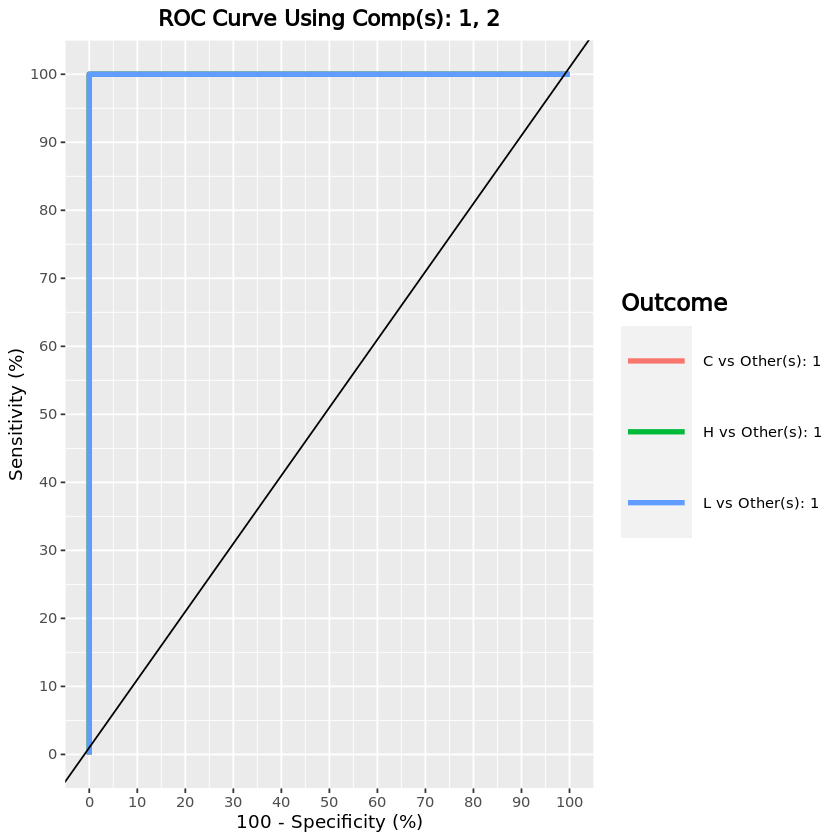

In [119]:
F1.ko.auc.splsda = auroc(final.splsda.ko.F1, roc.comp = 2, print = T) # AUROC for the first component

#### kos - F1 generation (C+L vs H)

In [120]:
ko.F1_2 <- list()
F1_info_3 <- info[rownames(ko.F1$cov),]
F1_info_3$treatment <- gsub(x = F1_info_3$Treatment, pattern = "[CL]", replacement = "C+L")
ko.F1_2$cov <- ko.F1$cov[rownames(F1_info_3),]
ko.F1_2$filtered <- ko.F1$filtered[rownames(F1_info_3),]

ko.F1_2$clr <- ko.F1$clr[rownames(F1_info_3), ]
X.ko.F1_2 <- ko.F1_2$clr

ko.F1_2$treatment <- factor(F1_info_3[rownames(ko.F1_2$clr), "treatment"])

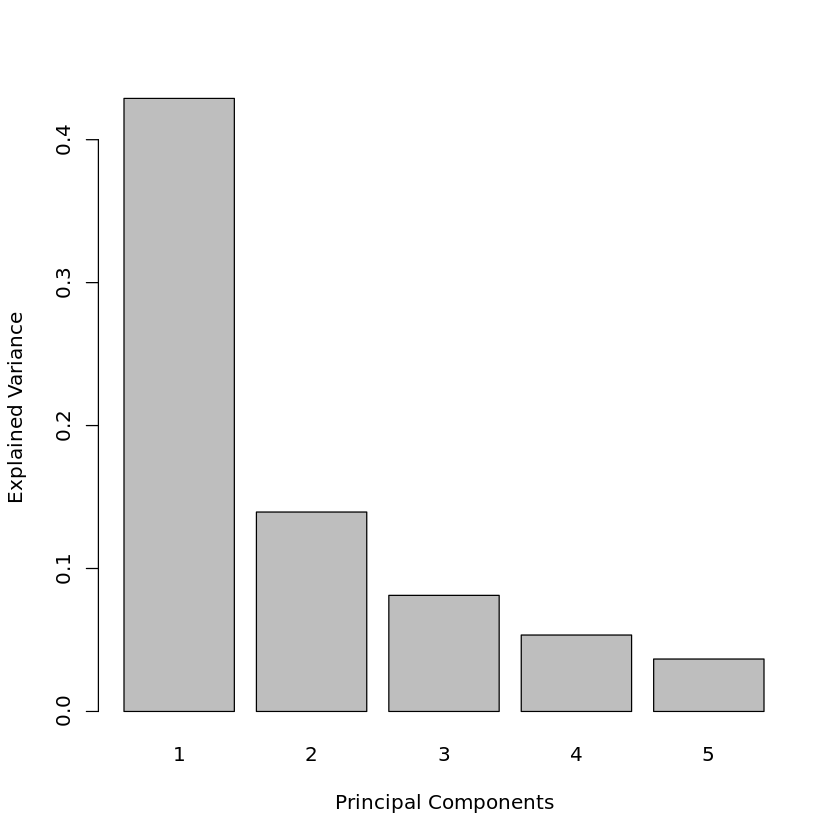

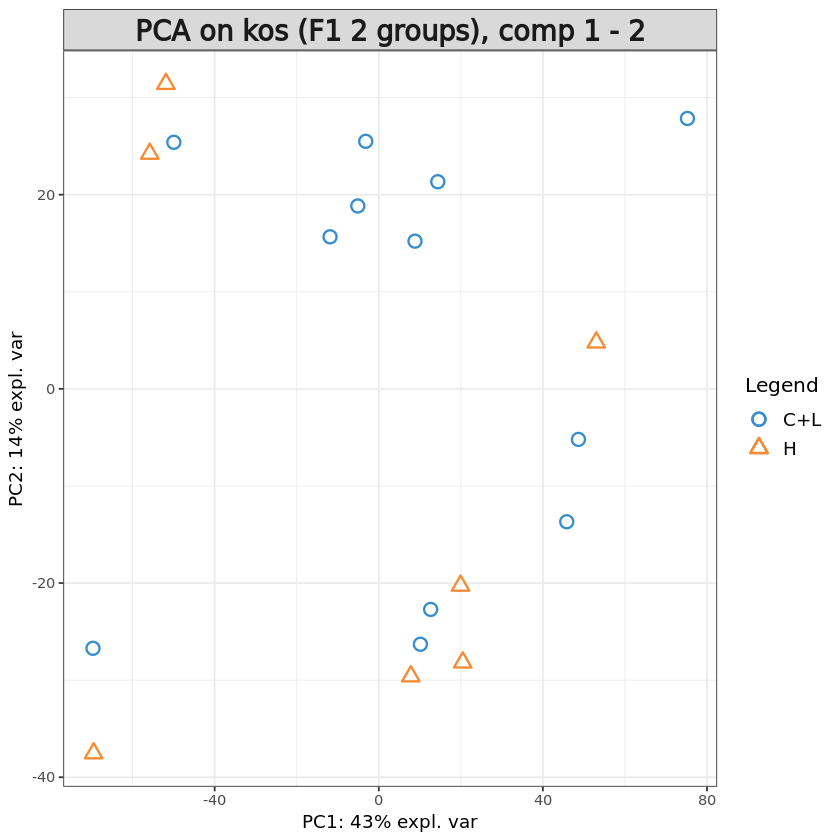

In [121]:
pca.ko.F1_2 = pca(X.ko.F1_2, ncomp = 5, center = TRUE, scale = TRUE) 

plot(pca.ko.F1_2)
plotIndiv(pca.ko.F1_2, group = ko.F1_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on kos (F1 2 groups), comp 1 - 2')

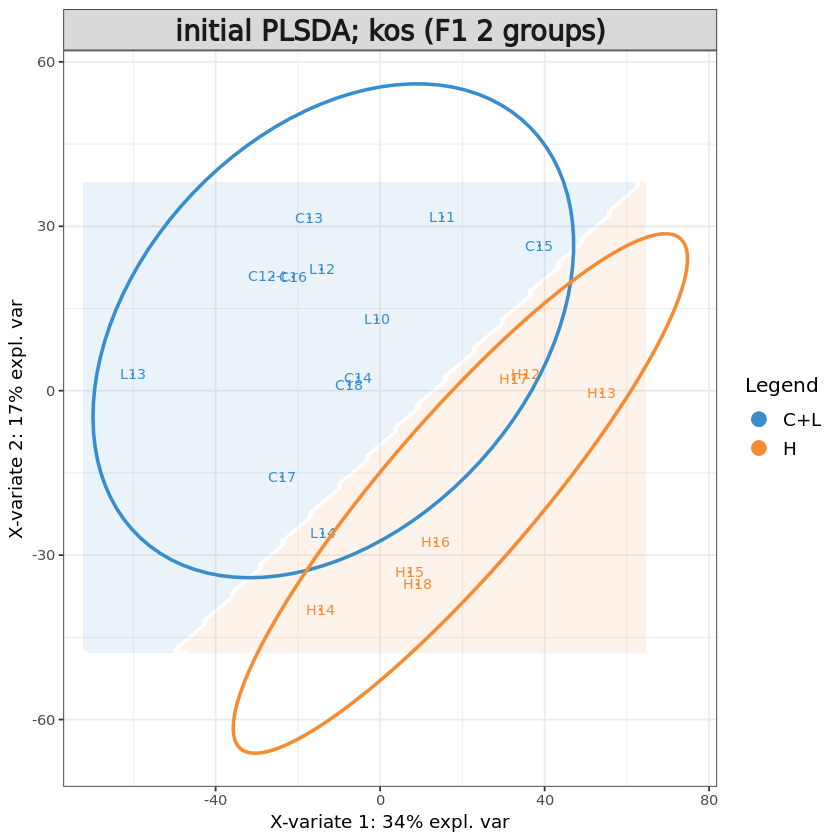

In [122]:
# Initial sPLS-DA model
ko.F1_2.splsda <- splsda(X.ko.F1_2, ko.F1_2$treatment, ncomp = 5)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(ko.F1_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(ko.F1_2.splsda, comp = 1:2, ellipse = TRUE,
          group = ko.F1_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; kos (F1 2 groups)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,3,1,3
BER,3,1,3


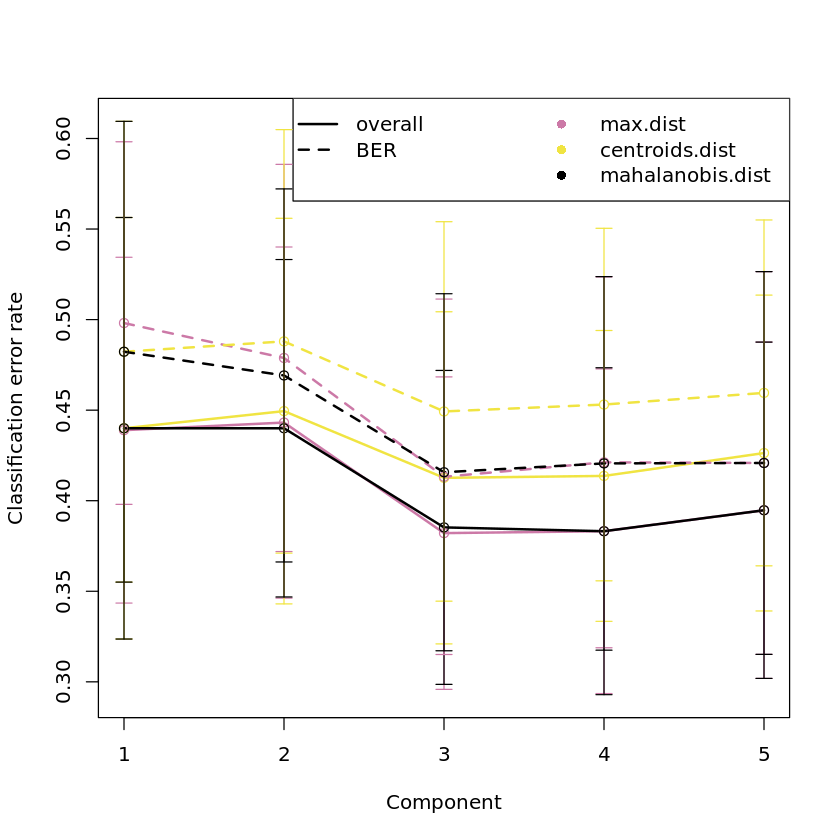

In [21]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.ko.F1_2 <- perf(ko.F1_2.splsda, validation = "Mfold", 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.ko.F1_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.ko.F1_2$choice.ncomp # what is the optimal value of components according to perf()

In [22]:
# Define parameters for tuning keepX
ko.F1_2.step <- 0.05
ko.F1_2.ncomp.tune <- 3
# grid of possible keepX values that will be tested for each component
ko.F1_2.keepx <- c(seq(10, 250, 10), seq(ceiling(dim(ko.F1_2$filtered)[2] * ko.F1_2.step), 
                      round(dim(ko.F1_2$filtered)[2], digits = -1), 
                      ceiling(dim(ko.F1_2$filtered)[2] * ko.F1_2.step)
                     )
                 )
ko.F1_2.keepx

[1]   10   20   30   40   50   60   70   80   90  100  110  120  130  140  150
[16]  160  170  180  190  200  210  220  230  240  250  211  422  633  844 1055
[31] 1266 1477 1688 1899 2110 2321 2532 2743 2954 3165 3376 3587 3798 4009

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%


[1] 1

comp1 comp2 comp3 
  110    80  2321

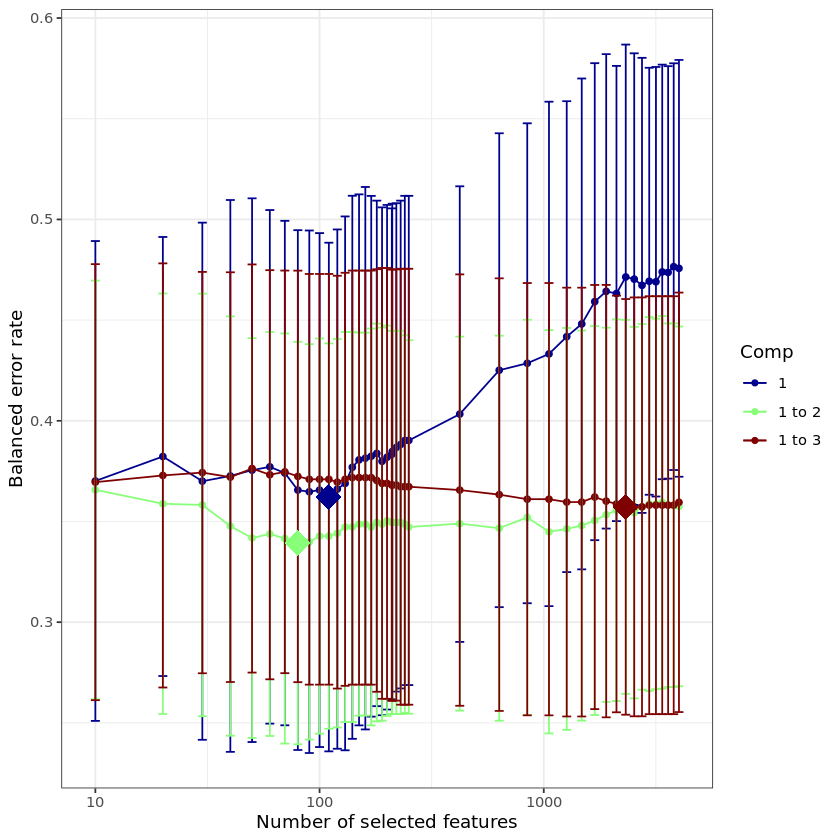

In [23]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.ko.F1_2 <- tune.splsda(X.ko.F1_2, ko.F1_2$treatment, ncomp = ko.F1_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = ko.F1_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.ko.F1_2, col = color.jet(ko.F1_2.ncomp.tune))

tune.splsda.ko.F1_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.ko.F1_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

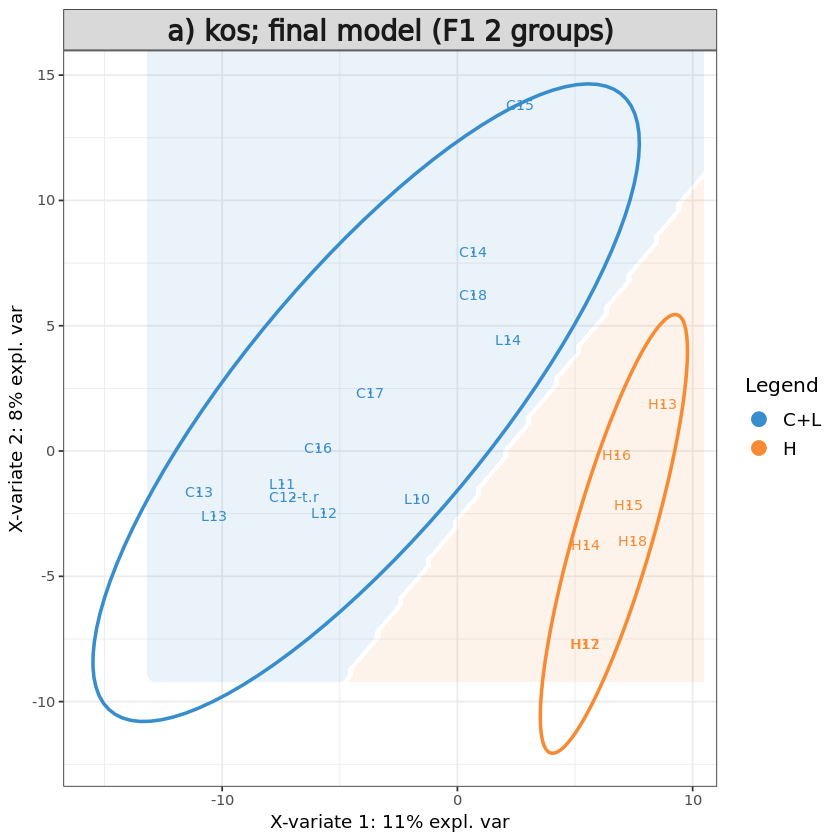

In [24]:
# Define final model
ko.F1_2$optimal.ncomp <- 2
#ko.F1_2$optimal.keepX <- tune.splsda.ko.F1_2$choice.keepX[1:ko.F1_2$optimal.ncomp]
ko.F1_2$optimal.keepX <- rep(100, ko.F1_2$optimal.ncomp)
#ko.F1_2$optimal.keepX <- c(10, 50)

# form final model with optimised values for component, using all features
final.splsda.ko.F1_2 <- splsda(X.ko.F1_2, ko.F1_2$treatment, 
                       ncomp = ko.F1_2$optimal.ncomp, 
                       keepX = ko.F1_2$optimal.keepX)

background = background.predict(final.splsda.ko.F1_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.ko.F1_2, comp = 1:2, 
          group = ko.F1_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) kos; final model (F1 2 groups)')

# save sample variates
data <- as.data.frame(final.splsda.ko.F1$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F1_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

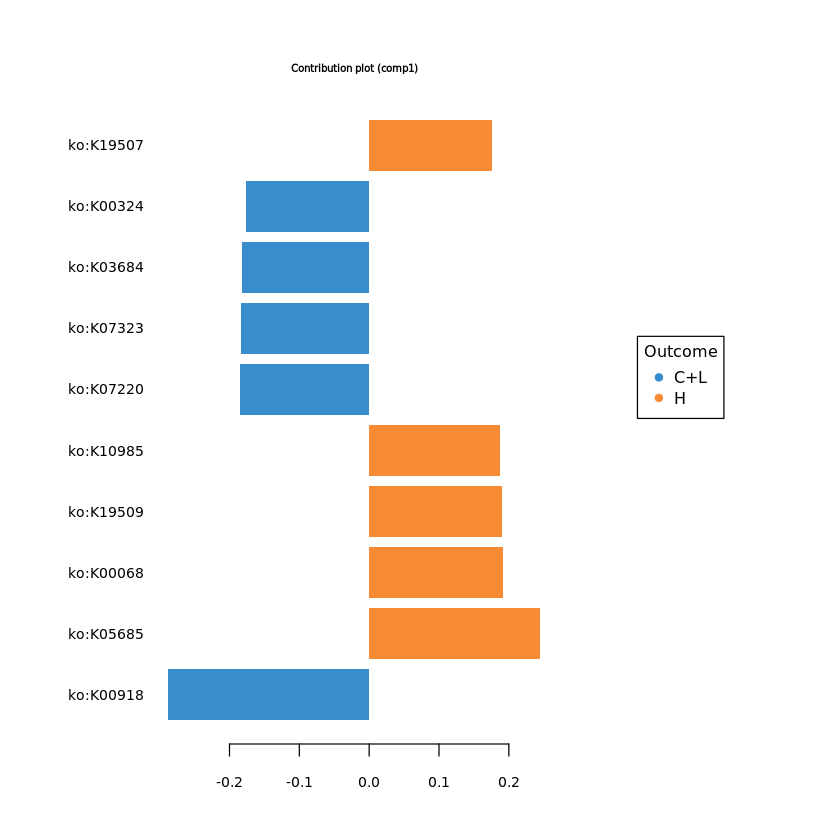

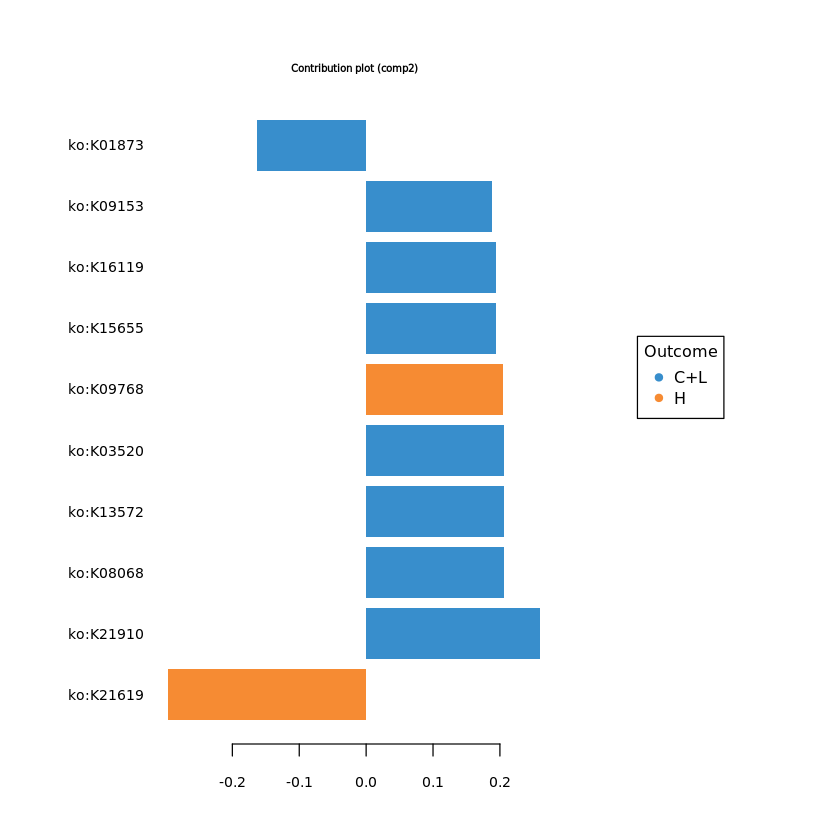

In [25]:
#plotVar(final.splsda.ko.F1_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.ko.F1_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.ko.F1_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.ko.F1_2, comp=1)$value
load_comp2 = selectVar(final.splsda.ko.F1_2, comp=2)$value
F1_2.ko.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F1_2.ko.load) <- F1_2.ko.load[,"Row.names"]
colnames(F1_2.ko.load) <- c("ft","loading_comp1","loading_comp2")
F1_2.ko.load = F1_2.ko.load[,c("loading_comp1","loading_comp2")]

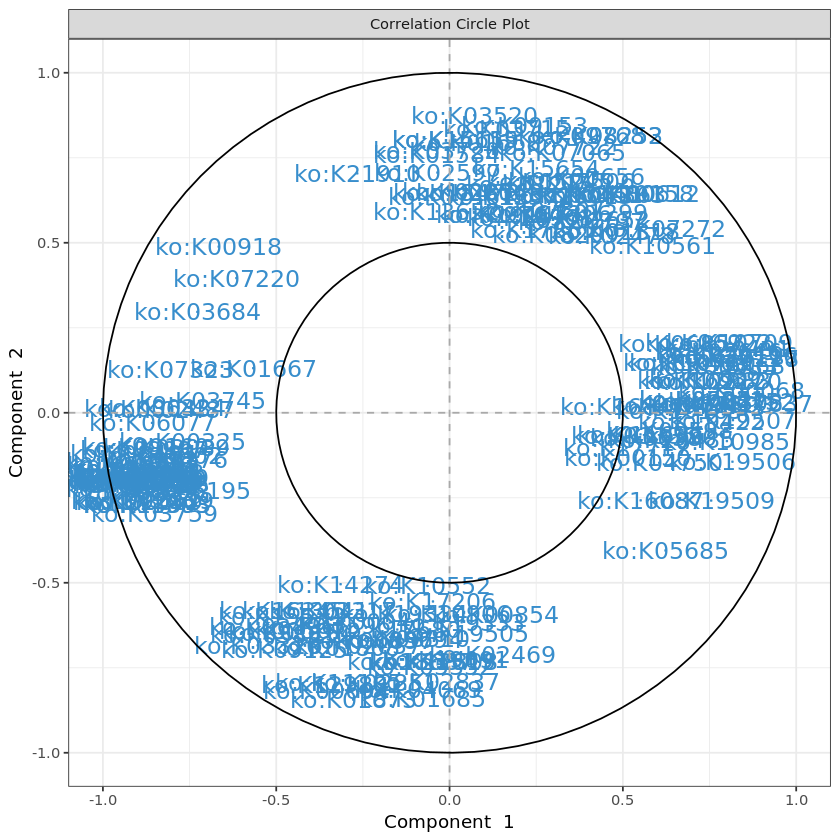

In [26]:
# plot feature correlation
plotVar(final.splsda.ko.F1_2, cutoff=0.5)
ko.F1_2.corr <- as.data.frame(plotVar(final.splsda.ko.F1_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
ko.F1_2.corr <- ko.F1_2.corr[, c("x","y")]
colnames(ko.F1_2.corr) <- c("corr_comp1","corr_comp2")

In [27]:
# Calculate feature stability
perf.splsda.ko.F1_2 <- perf(final.splsda.ko.F1_2, 
                          folds = F1.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F1_2.ko.stab <- merge(data.frame(perf.splsda.ko.F1_2$features$stable$comp1), 
                  data.frame(perf.splsda.ko.F1_2$features$stable$comp2), by="Var1", all=T)
rownames(F1_2.ko.stab) <- F1_2.ko.stab$Var1
F1_2.ko.stab <- F1_2.ko.stab[, c("Freq.x","Freq.y")]
colnames(F1_2.ko.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%


In [28]:
# merge feature output
F1_2.ko.out <- merge(F1_2.ko.load, F1_2.ko.stab, by="row.names")
rownames(F1_2.ko.out) <- F1_2.ko.out[,"Row.names"]
F1_2.ko.out <- merge(F1_2.ko.out[, 2:ncol(F1_2.ko.out)], ko.F1_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F1_2.features.tsv", F1_2.ko.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [29]:
train <- sample(1:nrow(X.ko.F1_2), ceiling(nrow(X.ko.F1_2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.ko.F1_2), train) # rest is part of the test set

# store matrices into training and test set:
X.ko.F1_2.train <- X.ko.F1_2[train, ]
X.ko.F1_2.test <- X.ko.F1_2[test,]
Y.ko.F1_2.train <- F1_info_3[train,"treatment"]
Y.ko.F1_2.test <- F1_info_3[test, "treatment"]
train.splsda.ko.F1_2 <- splsda(X.ko.F1_2.train, Y.ko.F1_2.train, ncomp = ko.F1_2$optimal.ncomp, keepX = ko.F1_2$optimal.keepX)
predict.splsda.ko.F1_2 <- predict(train.splsda.ko.F1_2, X.ko.F1_2.test, 
                                dist = "max.dist")
predict.comp2.ko.F1_2 <- predict.splsda.ko.F1_2$class$max.dist[,2]
table(factor(predict.comp2.ko.F1_2, levels = levels(ko.F1_2$treatment)), Y.ko.F1_2.test)

     Y.ko.F1_2.test
      C+L H
  C+L   5 4
  H     3 2

$Comp1
         AUC   p-value
C+L vs H   1 0.0003857

$Comp2
         AUC   p-value
C+L vs H   1 0.0003857



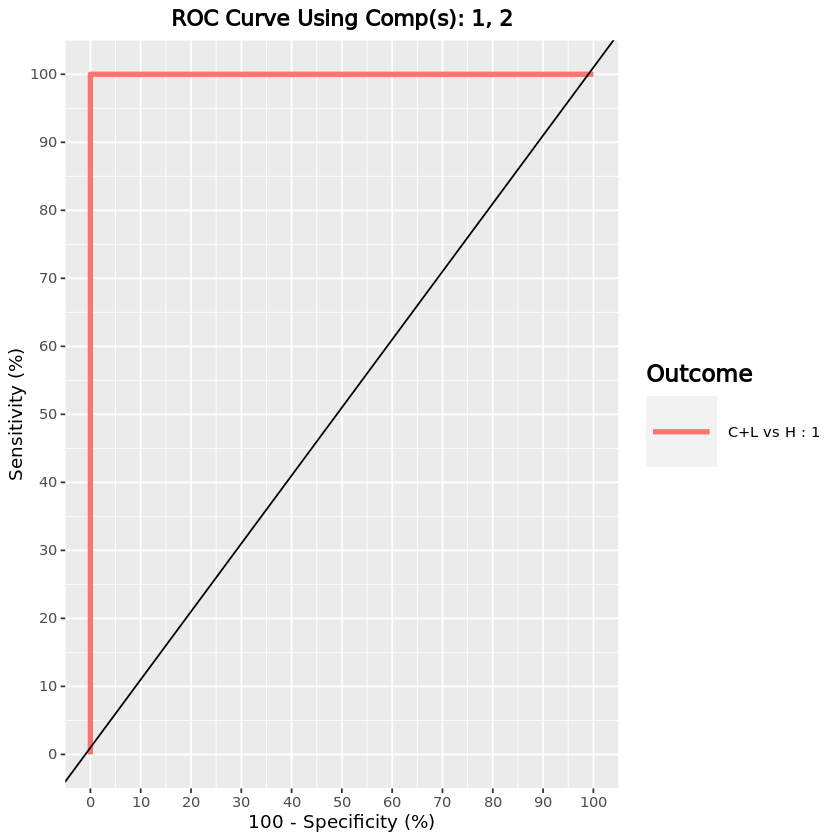

In [30]:
F1_2.ko.auc.splsda = auroc(final.splsda.ko.F1_2, roc.comp = 2, print = T) # AUROC for the first component

#### kos - F2 generation

[1] "1165"        "kos removed" "4761"        "remaining"

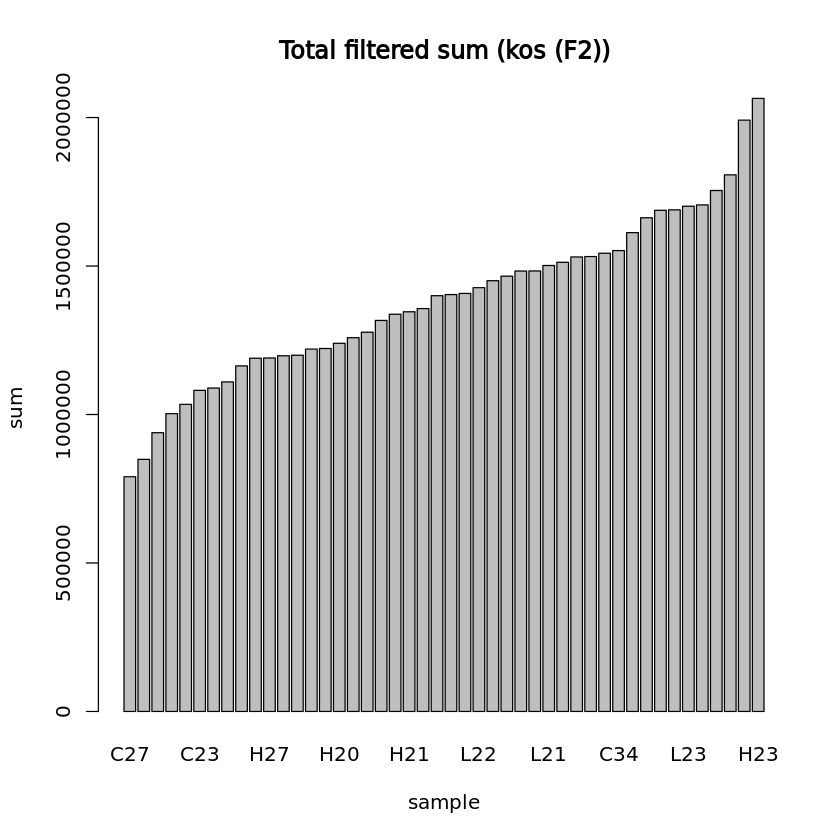

In [31]:
## PARAMS ##
# Initial components
ko.F2.ncomp <- 10
# Percentage of samples in which features must have >0 sum
ko.F2.percent_occ <- 10
# Quantile used for removing low abundance features
ko.F2.quantile_thresh <- 0.1
generation <- "F2"

ko.F2 <- list()
ko.F2$cov <- ko$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(ko.F2$cov[, colSums(ko.F2$cov) > 0])
ko.F2$nz <- ko.F2$cov[, colnames(ko.F2$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(ko.F2$nz) / sum(colSums(ko.F2$nz)) * 100, probs = ko.F2.quantile_thresh)
ko.F2$filtered <- low.count.removal(ko.F2$nz, percent = low_threshold)$data.filter

# Calculate feature occurrence
ko.F2$occ <- colSums(ko.F2$filtered>0) / nrow(ko.F2$filtered) * 100
# Keep features occurring in defined percentage of samples
ko.F2$filtered <- ko.F2$filtered[, which(ko.F2$occ >= ko.F2.percent_occ)]

#ko.F2$filtered <- ko.F2$filtered[,-nearZeroVar(ko.F2$filtered)$Position]
paste0(c(dim(ko.F2$cov)[2] - dim(ko.F2$filtered)[2], "kos removed", dim(ko.F2$filtered)[2], "remaining"))

# Add offset
ko.F2$offset <- ko.F2$filtered + 1
ko.F2$clr <- logratio.transfo(ko.F2$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.ko.F2 <- ko.F2$clr

ko.F2$treatment <- factor(info[rownames(ko.F2$clr), "Treatment"])

ko.F2.lib.size <- apply(ko.F2$filtered, 1, sum) # determine total count for each sample
barplot(sort(ko.F2.lib.size), main="Total filtered sum (kos (F2))", ylab="sum", xlab="sample")

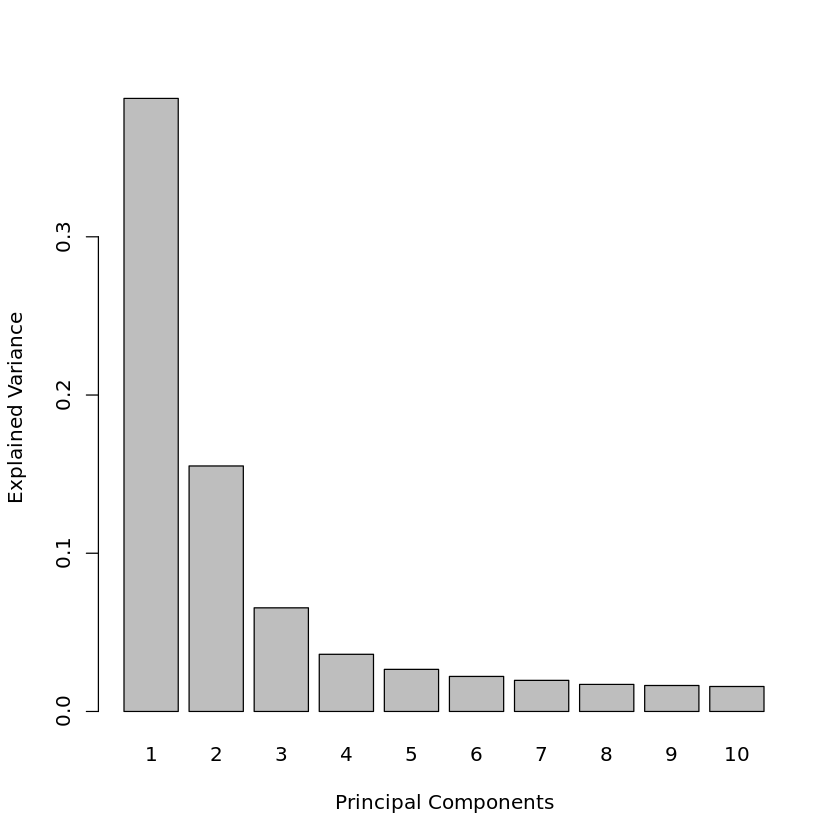

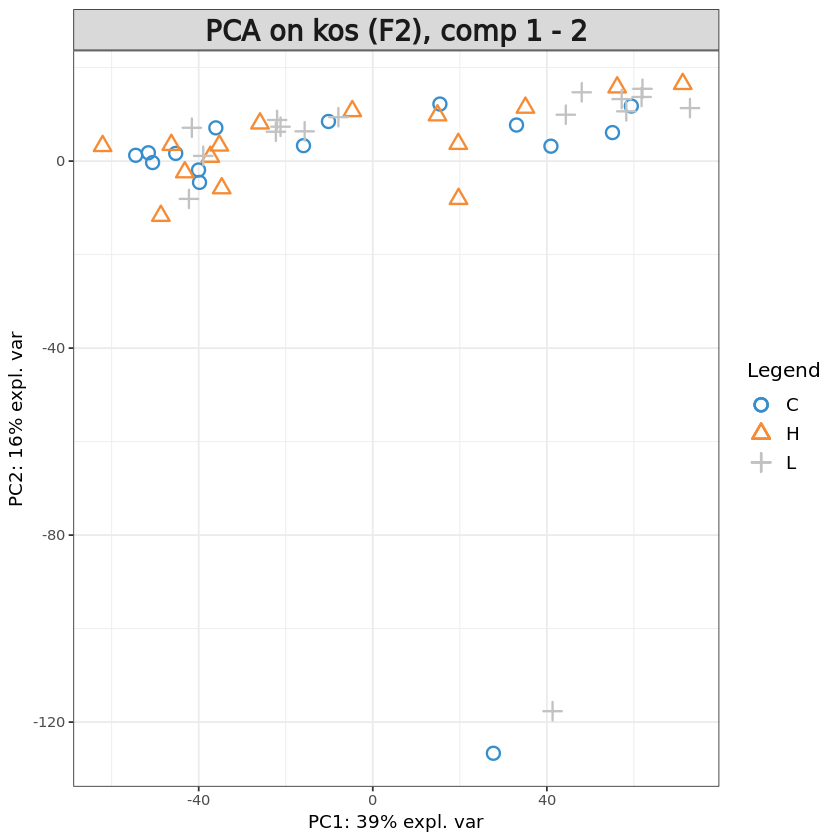

In [32]:
pca.ko.F2 = pca(X.ko.F2, ncomp = ko.F2.ncomp, center = TRUE, scale = TRUE) 

plot(pca.ko.F2)
plotIndiv(pca.ko.F2, group = ko.F2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on kos (F2), comp 1 - 2')

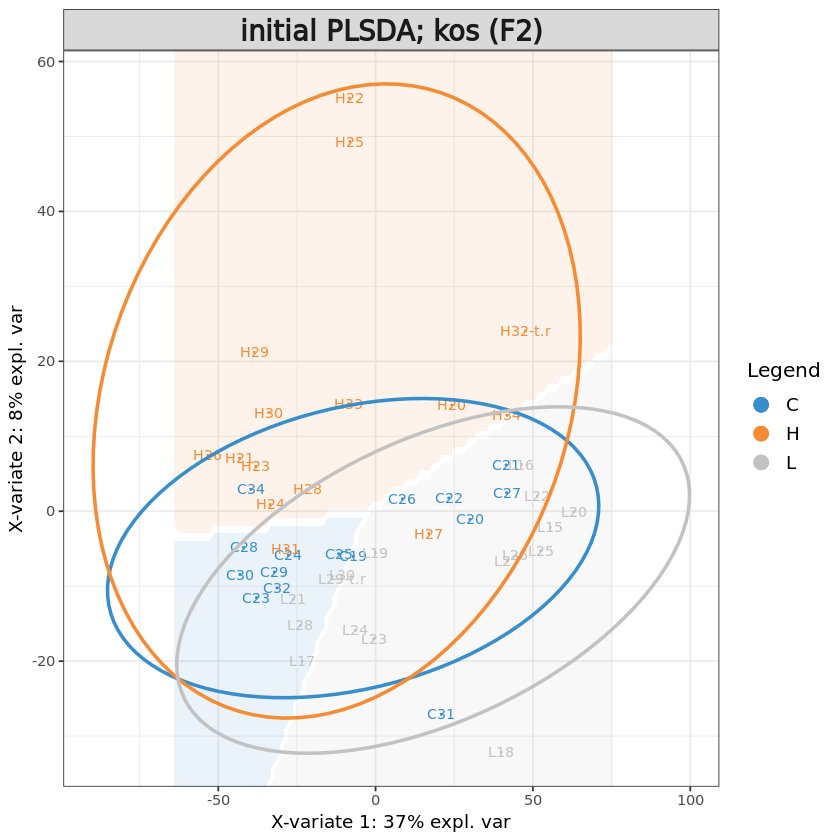

In [33]:
# Initial sPLS-DA model
ko.F2.splsda <- splsda(X.ko.F2, ko.F2$treatment, ncomp = ko.F2.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(ko.F2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(ko.F2.splsda, comp = 1:2, ellipse = TRUE,
          group = ko.F2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; kos (F2)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,6,5,5
BER,6,5,5


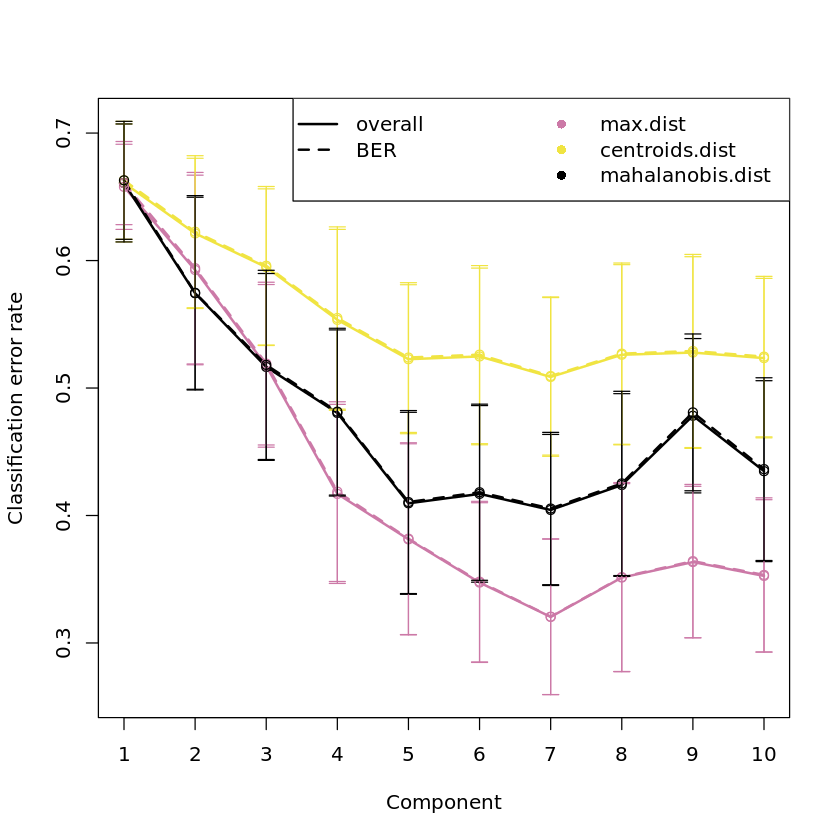

In [34]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.ko.F2 <- perf(ko.F2.splsda, validation = "Mfold", 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.ko.F2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.ko.F2$choice.ncomp # what is the optimal value of components according to perf()

In [35]:
# Define parameters for tuning keepX
ko.F2.step <- 0.05
ko.F2.ncomp.tune <- 6
# grid of possible keepX values that will be tested for each component
ko.F2.keepx <- c(seq(10, 200, 20), seq(ceiling(dim(ko.F2$filtered)[2] * ko.F2.step), 
                      round(dim(ko.F2$filtered)[2], digits = -1), 
                      ceiling(dim(ko.F2$filtered)[2] * ko.F2.step)
                     )
                 )
ko.F2.keepx

[1]   10   30   50   70   90  110  130  150  170  190  239  478  717  956 1195
[16] 1434 1673 1912 2151 2390 2629 2868 3107 3346 3585 3824 4063 4302 4541

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%


[1] 6

comp1 comp2 comp3 comp4 comp5 comp6 
   30    10   110   239   478  4541

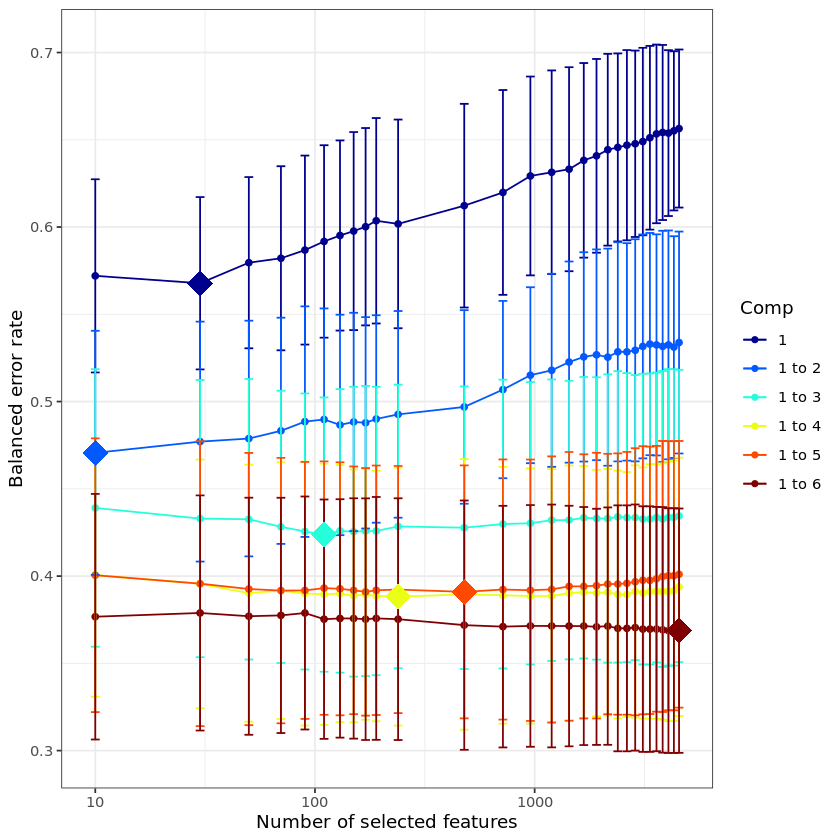

In [36]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.ko.F2 <- tune.splsda(X.ko.F2, ko.F2$treatment, ncomp = ko.F2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = ko.F2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.ko.F2, col = color.jet(ko.F2.ncomp.tune))

tune.splsda.ko.F2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.ko.F2$choice.keepX # what are the optimal values of variables according to tune.splsda()

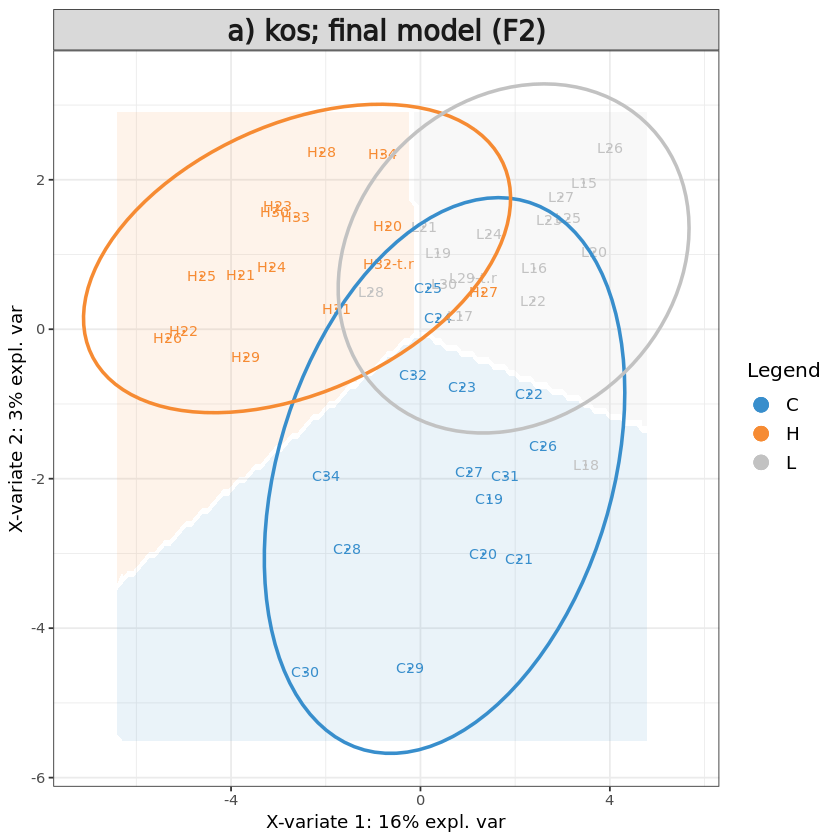

In [39]:
# Define final model
ko.F2$optimal.ncomp <- 6
ko.F2$optimal.keepX <- tune.splsda.ko.F2$choice.keepX[1:ko.F2$optimal.ncomp]
#ko.F2$optimal.keepX <- rep(50, ko.F2$optimal.ncomp)
ko.F2$optimal.keepX <- c(30, 10, 100, 100, 100, 100)

# form final model with optimised values for component, using all features
final.splsda.ko.F2 <- splsda(X.ko.F2, ko.F2$treatment, 
                       ncomp = ko.F2$optimal.ncomp, 
                       keepX = ko.F2$optimal.keepX)

background = background.predict(final.splsda.ko.F2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.ko.F2, comp = 1:2, 
          group = ko.F2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) kos; final model (F2)')

# save sample variates
data <- as.data.frame(final.splsda.ko.F2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

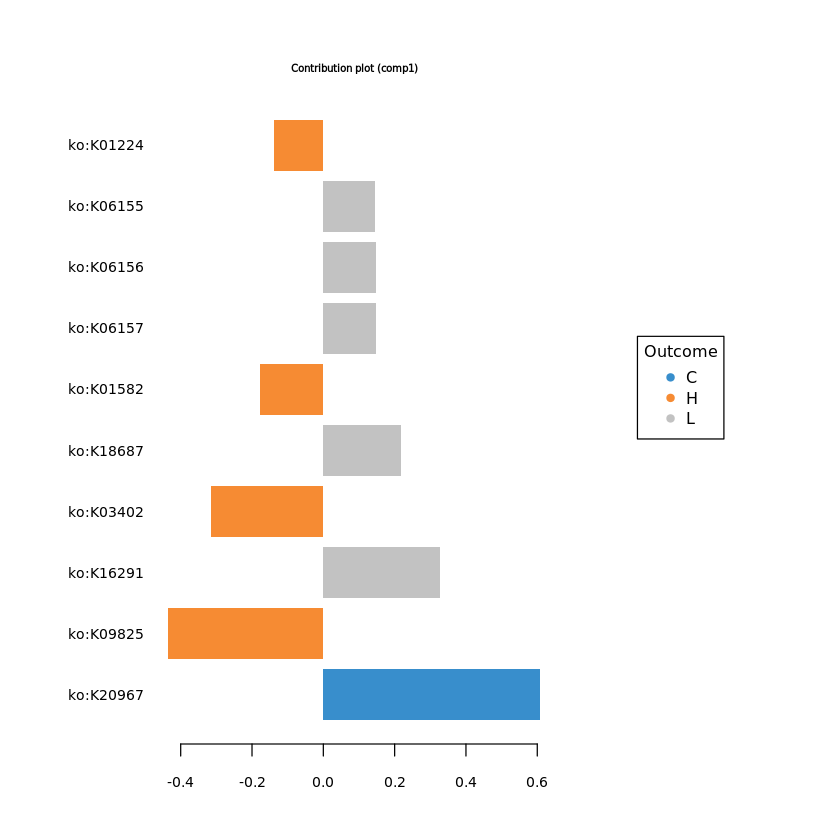

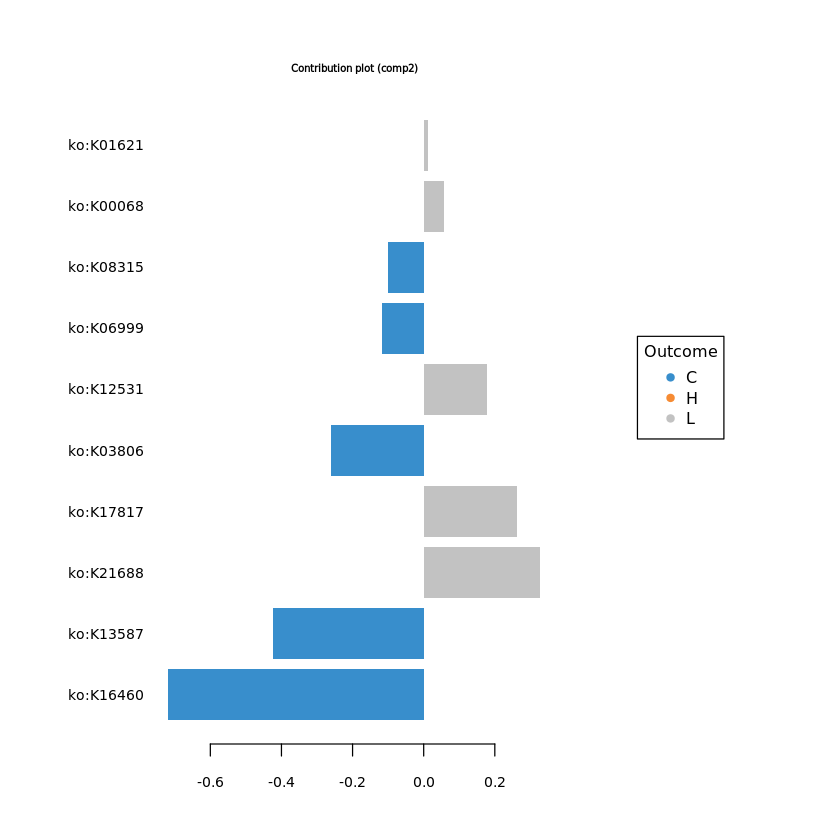

In [40]:
#plotVar(final.splsda.ko.F2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.ko.F2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10)
plotLoadings(final.splsda.ko.F2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10)

# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.ko.F2, comp=1)$value
load_comp2 = selectVar(final.splsda.ko.F2, comp=2)$value
F2.ko.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F2.ko.load) <- F2.ko.load[,"Row.names"]
colnames(F2.ko.load) <- c("ft","loading_comp1","loading_comp2")
F2.ko.load = F2.ko.load[,c("loading_comp1","loading_comp2")]

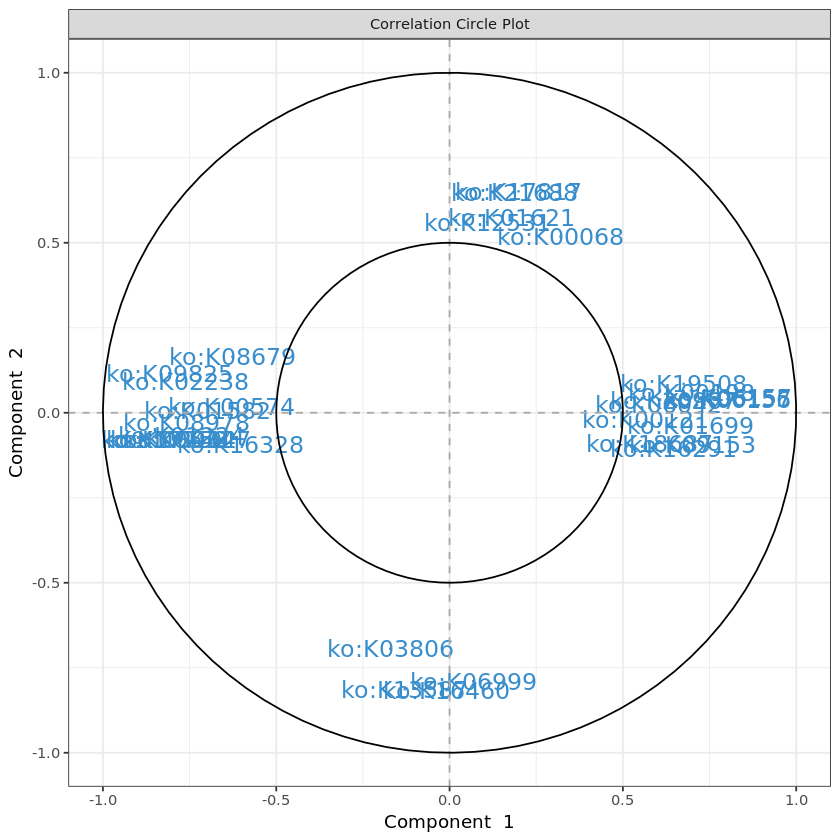

In [41]:
# plot feature correlation
plotVar(final.splsda.ko.F2, cutoff=0.5)
ko.F2.corr <- as.data.frame(plotVar(final.splsda.ko.F2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
ko.F2.corr <- ko.F2.corr[, c("x","y")]
colnames(ko.F2.corr) <- c("corr_comp1","corr_comp2")

In [42]:
# Calculate feature stability
perf.splsda.ko.F2 <- perf(final.splsda.ko.F2, 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F2.ko.stab <- merge(data.frame(perf.splsda.ko.F2$features$stable$comp1), 
                  data.frame(perf.splsda.ko.F2$features$stable$comp2), by="Var1", all=T)
rownames(F2.ko.stab) <- F2.ko.stab$Var1
F2.ko.stab <- F2.ko.stab[, c("Freq.x","Freq.y")]
colnames(F2.ko.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%


In [43]:
# merge feature output
F2.ko.out <- merge(F2.ko.load, F2.ko.stab, by="row.names")
rownames(F2.ko.out) <- F2.ko.out[,"Row.names"]
F2.ko.out <- merge(F2.ko.out[, 2:ncol(F2.ko.out)], ko.F2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F2.features.tsv", F2.ko.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [44]:
train <- sample(1:nrow(X.ko.F2), ceiling(nrow(X.ko.F2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.ko.F2), train) # rest is part of the test set

# store matrices into training and test set:
X.ko.F2.train <- X.ko.F2[train, ]
X.ko.F2.test <- X.ko.F2[test,]
Y.ko.F2.train <- info[train,"treatment"]
Y.ko.F2.test <- info[test, "treatment"]
train.splsda.ko.F2 <- splsda(X.ko.F2.train, Y.ko.F2.train, ncomp = ko.F2$optimal.ncomp, keepX = ko.F2$optimal.keepX)
predict.splsda.ko.F2 <- predict(train.splsda.ko.F2, X.ko.F2.test, 
                                dist = "max.dist")
predict.comp2.ko.F2 <- predict.splsda.ko.F2$class$max.dist[,2]
table(factor(predict.comp2.ko.F2, levels = levels(ko.F2$treatment)), Y.ko.F2.test)

   Y.ko.F2.test
    C H L
  C 8 7 4
  H 0 0 0
  L 7 5 3

$Comp1
                 AUC   p-value
C vs Other(s) 0.5677 4.604e-01
H vs Other(s) 0.9355 2.085e-06
L vs Other(s) 0.8562 8.019e-05

$Comp2
                 AUC   p-value
C vs Other(s) 0.9634 4.426e-07
H vs Other(s) 0.9699 3.056e-07
L vs Other(s) 0.9458 7.992e-07

$Comp3
                 AUC   p-value
C vs Other(s) 0.9634 4.426e-07
H vs Other(s) 0.9935 7.543e-08
L vs Other(s) 0.9812 9.950e-08

$Comp4
                 AUC   p-value
C vs Other(s) 1.0000 5.093e-08
H vs Other(s) 0.9935 7.543e-08
L vs Other(s) 1.0000 3.109e-08

$Comp5
                 AUC   p-value
C vs Other(s) 1.0000 5.093e-08
H vs Other(s) 0.9935 7.543e-08
L vs Other(s) 1.0000 3.109e-08

$Comp6
                 AUC   p-value
C vs Other(s) 1.0000 5.093e-08
H vs Other(s) 0.9978 5.809e-08
L vs Other(s) 1.0000 3.109e-08



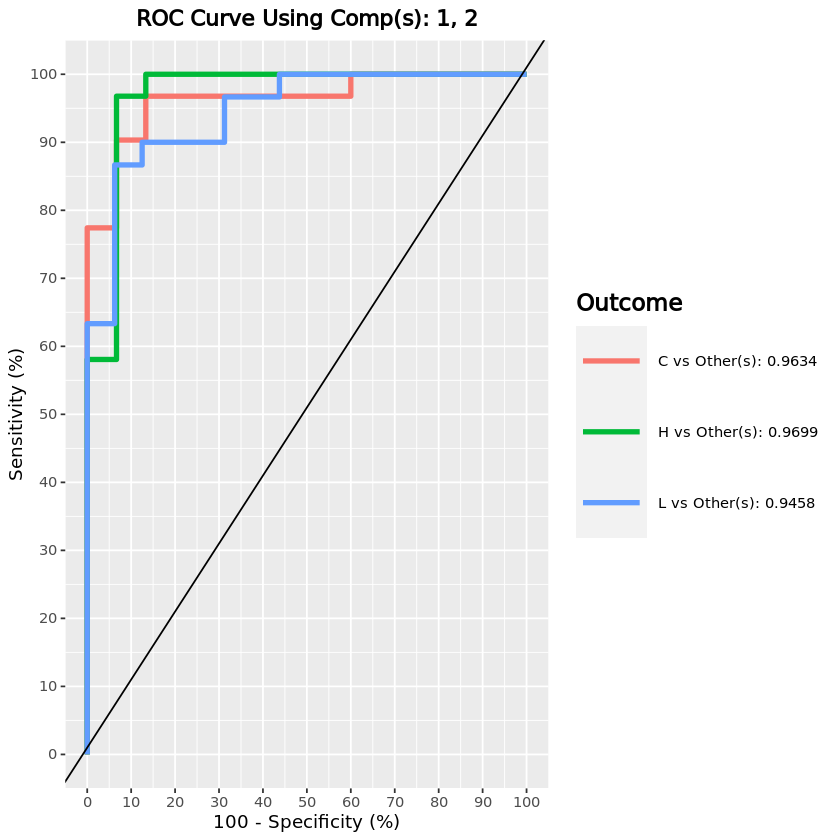

In [45]:
F2.ko.auc.splsda = auroc(final.splsda.ko.F2, roc.comp = 2, print = T) # AUROC for the first component

#### kos - F2 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [46]:
ko.F2_2 <- list()
F2_info_2 <- info[rownames(ko.F2$cov),]
F2_info_2$treatment <- gsub(x = F2_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
ko.F2_2$cov <- ko.F2$cov[rownames(F2_info_2),]
ko.F2_2$filtered <- ko.F2$filtered[rownames(F2_info_2),]

ko.F2_2$clr <- ko.F2$clr[rownames(F2_info_2), ]
X.ko.F2_2 <- ko.F2_2$clr

ko.F2_2$treatment <- factor(F2_info_2[rownames(ko.F2_2$clr), "treatment"])

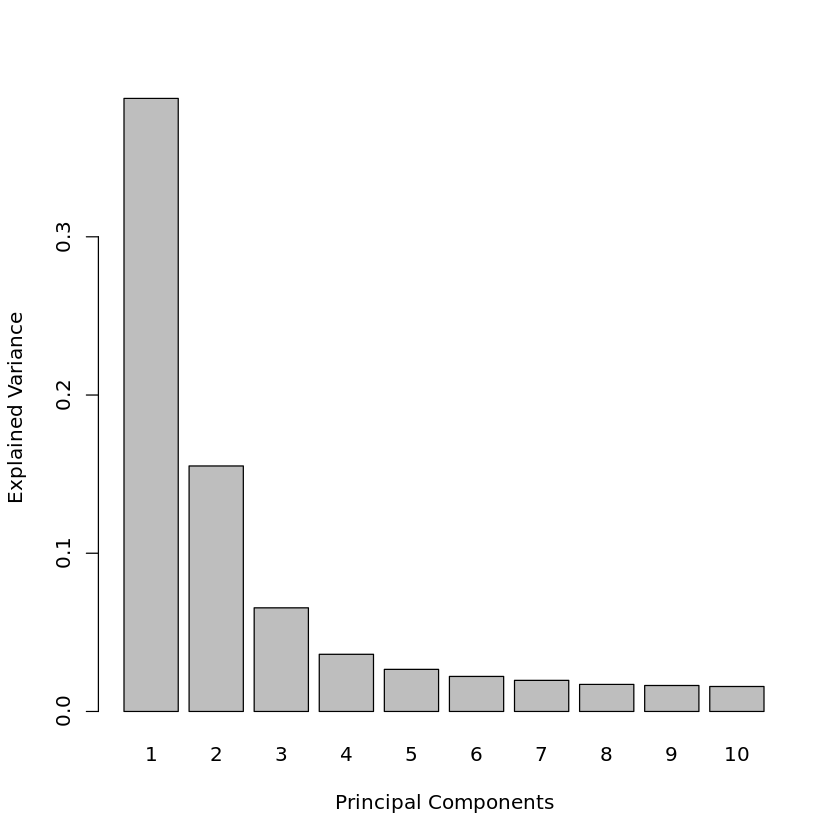

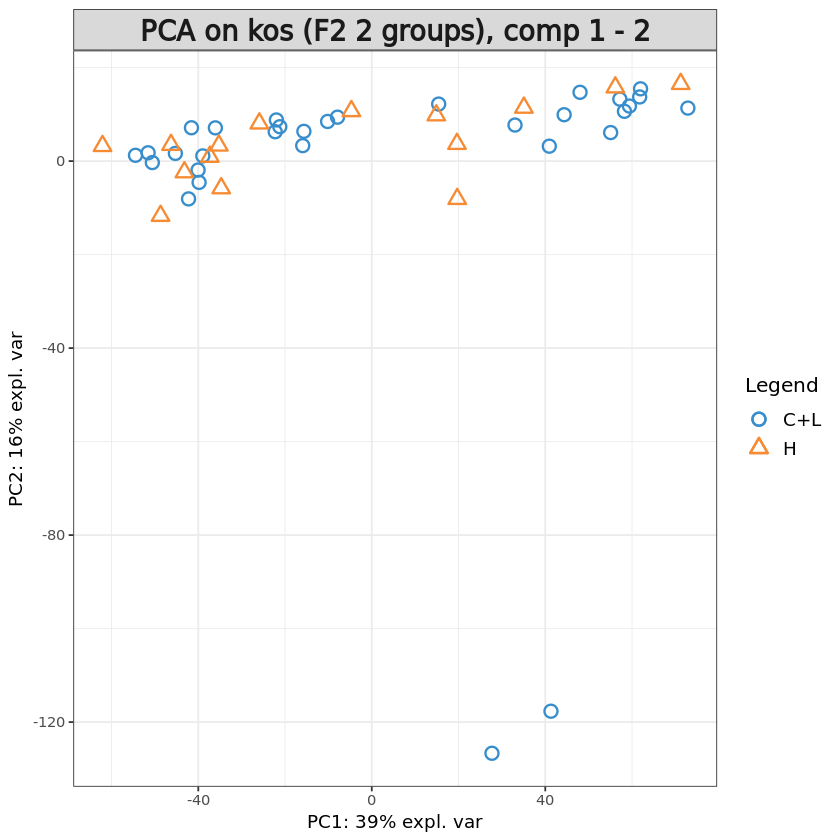

In [47]:
pca.ko.F2_2 = pca(X.ko.F2_2, ncomp = 10, center = TRUE, scale = TRUE) 

plot(pca.ko.F2_2)
plotIndiv(pca.ko.F2_2, group = ko.F2_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on kos (F2 2 groups), comp 1 - 2')

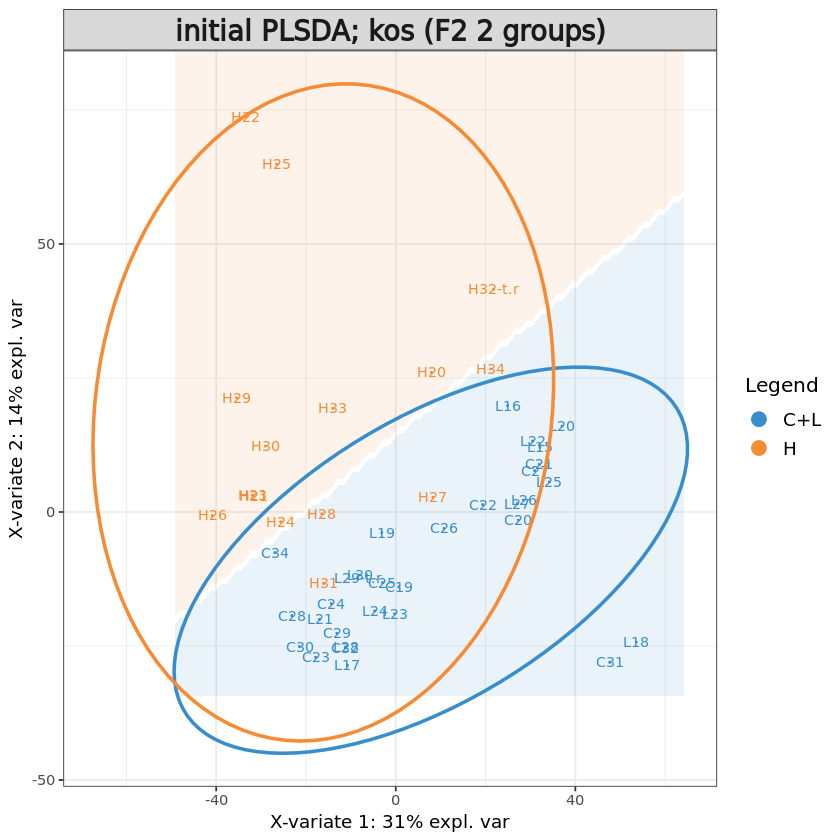

In [48]:
# Initial sPLS-DA model
ko.F2_2.splsda <- splsda(X.ko.F2_2, ko.F2_2$treatment, ncomp = 10)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(ko.F2_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(ko.F2_2.splsda, comp = 1:2, ellipse = TRUE,
          group = ko.F2_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; kos (F2 2 groups)")

[1] "Tuning ncomp..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%
comp 6 
  |======================================================================| 100%
comp 7 
  |======================================================================| 100%
comp 8 
  |======================================================================| 100%
comp 9 
  |======================================================================| 100%
comp 10 
  |======================================================================| 100%


,max.dist,centroids.dist,mahalanobis.dist
overall,5,6,5
BER,5,6,5


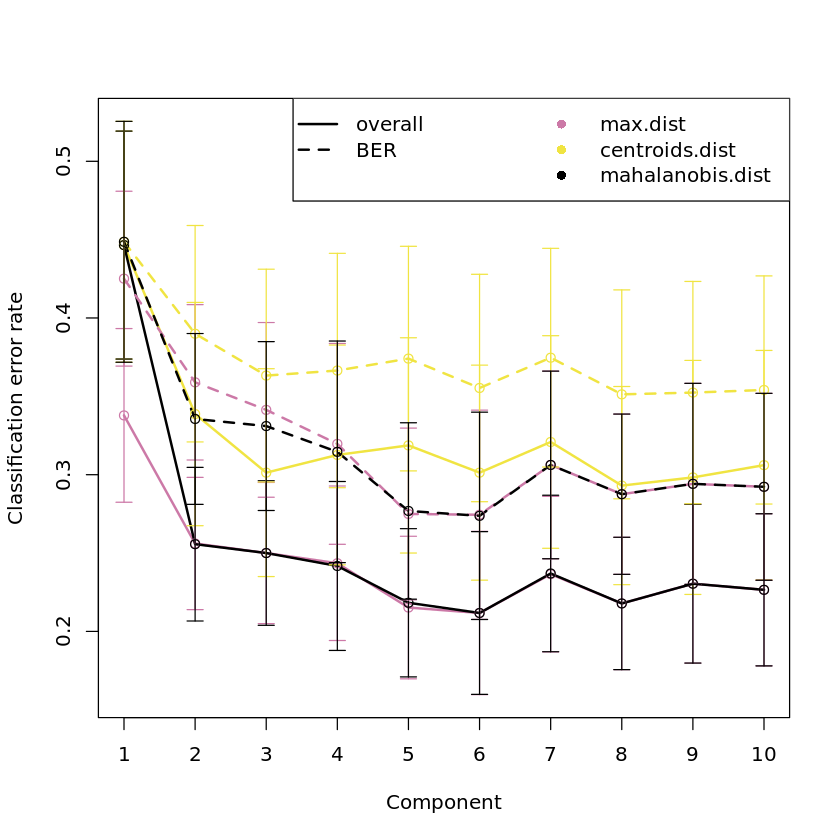

In [49]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.ko.F2_2 <- perf(ko.F2_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.ko.F2_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.ko.F2_2$choice.ncomp # what is the optimal value of components according to perf()

We set number of components to 3 and tune number of features used.

In [50]:
# Define parameters for tuning keepX
ko.F2_2.step <- 0.05
ko.F2_2.ncomp.tune <- 5
# grid of possible keepX values that will be tested for each component
ko.F2_2.keepx <- c(seq(10, 200, 20), seq(ceiling(dim(ko.F2$filtered)[2] * ko.F2.step), 
                      round(dim(ko.F2$filtered)[2], digits = -1), 
                      ceiling(dim(ko.F2$filtered)[2] * ko.F2.step)
                     )
                 )
ko.F2_2.keepx

[1]   10   30   50   70   90  110  130  150  170  190  239  478  717  956 1195
[16] 1434 1673 1912 2151 2390 2629 2868 3107 3346 3585 3824 4063 4302 4541

[1] "Tuning keepX..."

comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%
comp 5 
  |======================================================================| 100%


[1] 4

comp1 comp2 comp3 comp4 comp5 
   10   239    10    50  3346

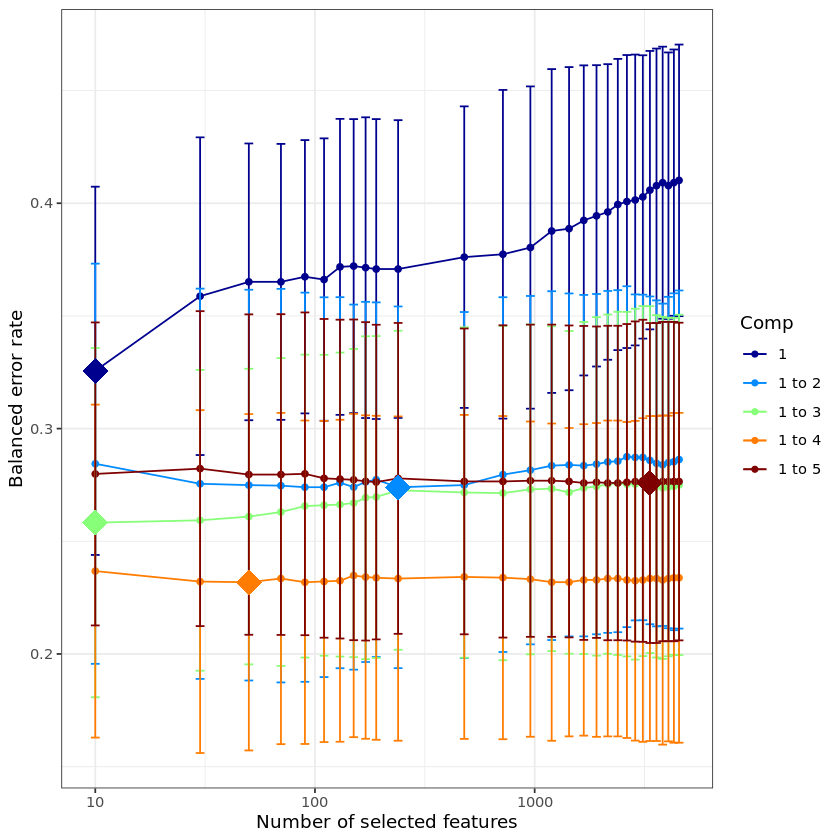

In [51]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.ko.F2_2 <- tune.splsda(X.ko.F2_2, ko.F2_2$treatment, ncomp = ko.F2_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = ko.F2_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.ko.F2_2, col = color.jet(ko.F2_2.ncomp.tune))

tune.splsda.ko.F2_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.ko.F2_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

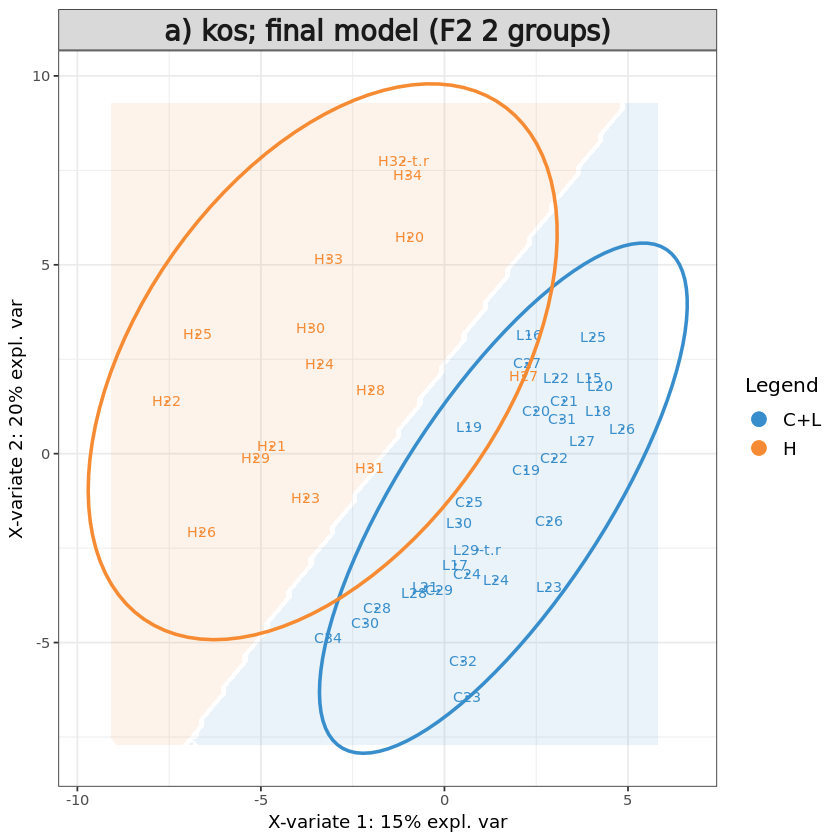

In [52]:
# Define final model
ko.F2_2$optimal.ncomp <- 4
#ko.F2_2$optimal.keepX <- tune.splsda.ko.F2_2$choice.keepX[1:ko.F2_2$optimal.ncomp]
ko.F2_2$optimal.keepX <- rep(50, ko.F2_2$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.ko.F2_2 <- splsda(X.ko.F2_2, ko.F2_2$treatment, 
                       ncomp = ko.F2_2$optimal.ncomp, 
                       keepX = ko.F2_2$optimal.keepX)

background = background.predict(final.splsda.ko.F2_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.ko.F2_2, comp = 1:2, 
          group = ko.F2_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) kos; final model (F2 2 groups)')

# save sample variates
data <- as.data.frame(final.splsda.ko.F2$variates$X)
data$Sample <- rownames(data)
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F2_2.samples.tsv", 
            data[, c("Sample", colnames(data)[colnames(data)!="Sample"])], sep="\t",
                quote = FALSE, row.names = FALSE)

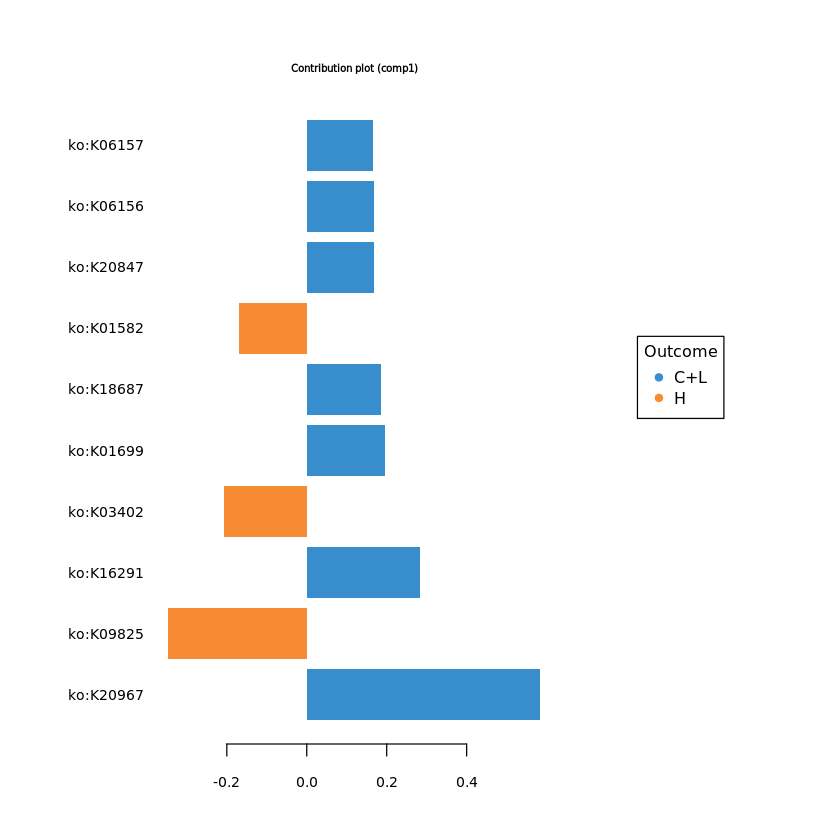

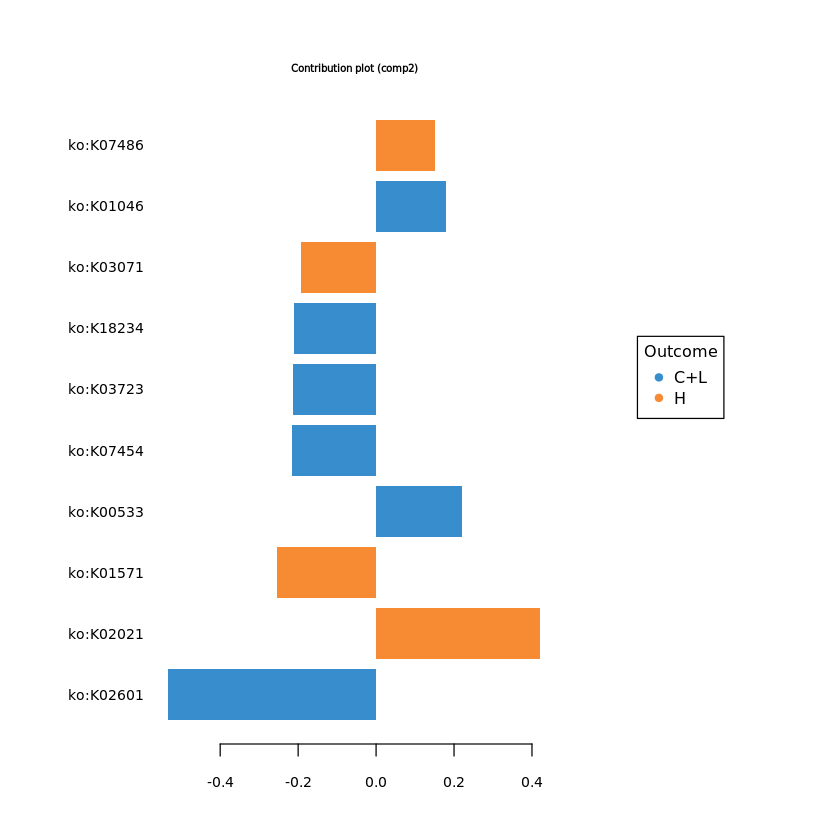

In [53]:
#plotVar(final.splsda.ko.F2_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.ko.F2_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10,)
plotLoadings(final.splsda.ko.F2_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10,)
# Store loadings for comp1 and comp2
load_comp1 = selectVar(final.splsda.ko.F2_2, comp=1)$value
load_comp2 = selectVar(final.splsda.ko.F2_2, comp=2)$value
F2_2.ko.load = merge(load_comp1, load_comp2, by="row.names", all=TRUE)
rownames(F2_2.ko.load) <- F2_2.ko.load[,"Row.names"]
colnames(F2_2.ko.load) <- c("ft","loading_comp1","loading_comp2")
F2_2.ko.load = F2_2.ko.load[,c("loading_comp1","loading_comp2")]

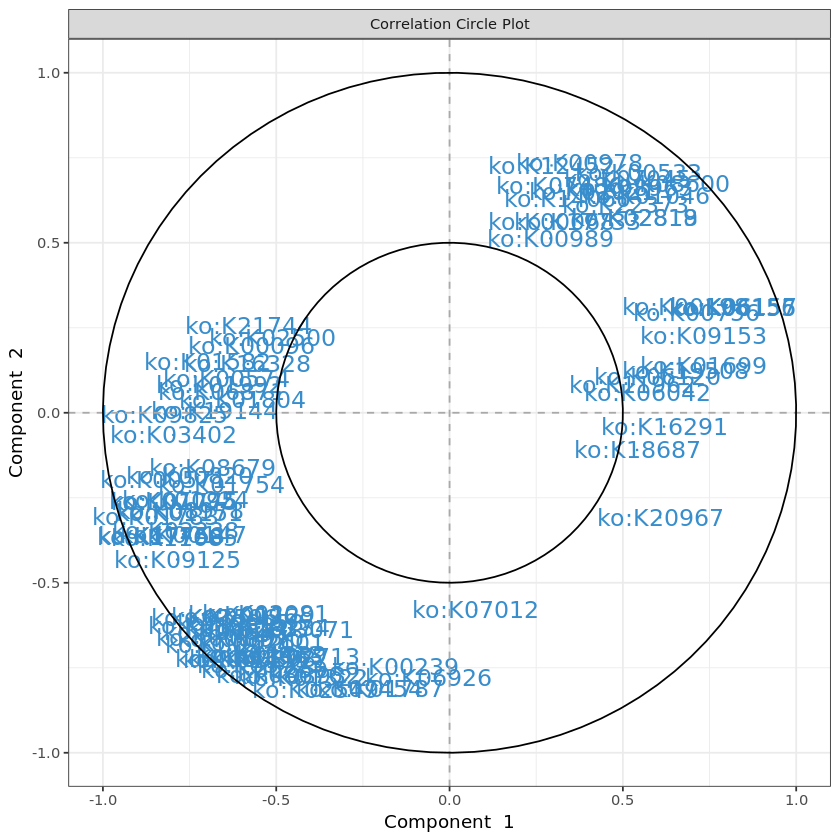

In [54]:
# plot feature correlation
plotVar(final.splsda.ko.F2_2, cutoff=0.5)
ko.F2_2.corr <- as.data.frame(plotVar(final.splsda.ko.F2_2, plot = FALSE, comp = c(1, 2)))[, c("names", "x", "y")]
ko.F2_2.corr <- ko.F2_2.corr[, c("x","y")]
colnames(ko.F2_2.corr) <- c("corr_comp1","corr_comp2")

In [55]:
# Calculate feature stability
perf.splsda.ko.F2_2 <- perf(final.splsda.ko.F2_2, 
                          folds = F2.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
F2_2.ko.stab <- merge(data.frame(perf.splsda.ko.F2_2$features$stable$comp1), 
                  data.frame(perf.splsda.ko.F2_2$features$stable$comp2), by="Var1", all=T)
rownames(F2_2.ko.stab) <- F2_2.ko.stab$Var1
F2_2.ko.stab <- F2_2.ko.stab[, c("Freq.x","Freq.y")]
colnames(F2_2.ko.stab) <- c("stability_comp1","stability_comp2")


comp 1 
  |======================================================================| 100%
comp 2 
  |======================================================================| 100%
comp 3 
  |======================================================================| 100%
comp 4 
  |======================================================================| 100%


In [56]:
# merge feature output
F2_2.ko.out <- merge(F2_2.ko.load, F2_2.ko.stab, by="row.names")
rownames(F2_2.ko.out) <- F2_2.ko.out[,"Row.names"]
F2_2.ko.out <- merge(F2_2.ko.out[, 2:ncol(F2_2.ko.out)], ko.F2_2.corr, by="row.names")
write.table(file = "../atlas/stats/mixOmics/final.splsda.ko.F2_2.features.tsv", F2_2.ko.out, sep="\t", 
            quote = FALSE, row.names = FALSE)

**Prediction**

In [57]:
train <- sample(1:nrow(X.ko.F2_2), ceiling(nrow(X.ko.F2_2)/4)) # randomly select 1/4 of samples in training
test <- setdiff(1:nrow(X.ko.F2_2), train) # rest is part of the test set

# store matrices into training and test set:
X.ko.F2_2.train <- X.ko.F2_2[train, ]
X.ko.F2_2.test <- X.ko.F2_2[test,]
Y.ko.F2_2.train <- F2_info_2[train,"treatment"]
Y.ko.F2_2.test <- F2_info_2[test, "treatment"]
train.splsda.ko.F2_2 <- splsda(X.ko.F2_2.train, Y.ko.F2_2.train, ncomp = ko.F2_2$optimal.ncomp, keepX = ko.F2_2$optimal.keepX)
predict.splsda.ko.F2_2 <- predict(train.splsda.ko.F2_2, X.ko.F2_2.test, 
                                dist = "max.dist")
predict.comp2.ko.F2_2 <- predict.splsda.ko.F2_2$class$max.dist[,2]
table(factor(predict.comp2.ko.F2_2, levels = levels(ko.F2_2$treatment)), Y.ko.F2_2.test)

In [58]:
F2_2.ko.auc.splsda = auroc(final.splsda.ko.F2_2, roc.comp = 2, print = T) # AUROC for the first component

### rgis

#### rgis - Generational differences

In [ ]:
## PARAMS ##
# Initial components
rgi.ncomp <- 10
# Percentage of samples in which features must have >0 sum
rgi.percent_occ <- 10
# Quantile used for removing low abundance features
rgi.quantile_thresh <- 0.1

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(rgi$cov[, colSums(rgi$cov) > 0])
rgi$nz <- rgi$cov[, colnames(rgi$cov)%in%nz]

# Filter low abundance features
#low_threshold = quantile(colSums(rgi$nz) / sum(colSums(rgi$nz)) * 100, probs = rgi.quantile_thresh)
#rgi$filtered <- low.count.removal(rgi$nz, percent = low_threshold)$data.filter
rgi$filtered <- rgi$nz

# Calculate feature occurrence
#rgi$occ <- colSums(rgi$filtered>0) / nrow(rgi$filtered) * 100
# Keep features occurring in defined percentage of samples
#rgi$filtered <- rgi$filtered[, which(rgi$occ >= rgi.percent_occ)]

#rgi$filtered <- rgi$filtered[,-nearZeroVar(rgi$filtered, uniqueCut = 5, freqCut = 5)$Position]
paste0(c(dim(rgi$cov)[2] - dim(rgi$filtered)[2], "rgis removed", dim(rgi$filtered)[2], "remaining"))

# Add offset
rgi$offset <- rgi$filtered + 1
rgi$clr <- logratio.transfo(rgi$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.rgi <- rgi$clr

rgi$generation <- factor(info[rownames(rgi$clr), "Generation"])

rgi.lib.size <- apply(rgi$filtered, 1, sum) # determine total count for each sample
barplot(sort(rgi.lib.size), main="Total filtered sum (rgis)", ylab="sum", xlab="sample")

In [ ]:
pca.rgi = pca(X.rgi, ncomp = rgi.ncomp, center = TRUE, scale = TRUE) 

plot(pca.rgi)
plotIndiv(pca.rgi, group = rgi$generation, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on rgis, comp 1 - 2')

In [ ]:
# Initial sPLS-DA model
rgi.splsda <- splsda(X.rgi, rgi$generation, ncomp = rgi.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(rgi.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(rgi.splsda, comp = 1:2, ellipse = TRUE,
          group = rgi$generation, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; rgis")

The initial model clearly separates samples based on generation.

In [ ]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.rgi <- perf(rgi.splsda, validation = "Mfold", 
                          folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.rgi, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.rgi$choice.ncomp # what is the optimal value of components according to perf()

The tuning step indicates that only two components are needed to characterize the samples.

In [ ]:
# Define parameters for tuning keepX
rgi.step <- 0.1
rgi.ncomp.tune <- 2
# grid of possible keepX values that will be tested for each component
rgi.keepx <- c(10, 20, seq(ceiling(dim(rgi$filtered)[2] * rgi.step), 
                      round(dim(rgi$filtered)[2], digits = -1), 
                      ceiling(dim(rgi$filtered)[2] * rgi.step)
                     )
                 )
rgi.keepx

In [ ]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.rgi <- tune.splsda(X.rgi, rgi$generation, ncomp = rgi.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = rgi.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.rgi, col = color.jet(rgi.ncomp.tune))

tune.splsda.rgi$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.rgi$choice.keepX # what are the optimal values of variables according to tune.splsda()

In [ ]:
# Define final model
rgi$optimal.ncomp <- 2
rgi$optimal.keepX <- tune.splsda.rgi$choice.keepX

# form final model with optimised values for component, using all features
final.splsda.rgi <- splsda(X.rgi, rgi$generation, 
                       ncomp = rgi$optimal.ncomp, 
                       keepX = rgi$optimal.keepX)

background = background.predict(final.splsda.rgi, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.rgi, comp = 1:2, 
          group = rgi$generation, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'rgis; final model')

In [ ]:
rgi_names <- rgi_tax[colnames(final.splsda.rgi$X),c("phylum", "family", "species")]
rgi_names$names <- paste0(rownames(rgi_names)," (", rgi_names$family, "; ", rgi_names$species, ")")

In [ ]:
plotVar(final.splsda.rgi, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.rgi, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = rgi_names$names)
plotLoadings(final.splsda.rgi, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = rgi_names$names)

In [ ]:
save_model_data(final.splsda.rgi, "final.splsda.rgi")

In [ ]:
# Calculate feature stability
perf.splsda.rgi <- perf(final.splsda.rgi, 
                          folds = folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
save_model_stability(perf.splsda.rgi, "final.splsda.rgi")

#### rgis - F0 generation

In [ ]:
## PARAMS ##
# Initial components
rgi.F0.ncomp <- 10
# Percentage of samples in which features must have >0 sum
rgi.F0.percent_occ <- 10
# Quantile used for removing low abundance features
rgi.F0.quantile_thresh <- 0.1
generation <- "F0"

rgi.F0 <- list()
rgi.F0$cov <- rgi$cov[info$Generation==generation, ]

## PREFILTERING ##
# Remove zero sum features
nz <- colnames(rgi.F0$cov[, colSums(rgi.F0$cov) > 0])
rgi.F0$nz <- rgi.F0$cov[, colnames(rgi.F0$cov)%in%nz]

# Filter low abundance features
low_threshold = quantile(colSums(rgi.F0$nz) / sum(colSums(rgi.F0$nz)) * 100, probs = rgi.F0.quantile_thresh)
#rgi.F0$filtered <- low.count.removal(rgi.F0$nz, percent = low_threshold)$data.filter
rgi.F0$filtered <- rgi.F0$nz

# Calculate feature occurrence
#rgi.F0$occ <- colSums(rgi.F0$filtered>0) / nrow(rgi.F0$filtered) * 100
# Keep features occurring in defined percentage of samples
#rgi.F0$filtered <- rgi.F0$filtered[, which(rgi.F0$occ >= rgi.F0.percent_occ)]

#rgi.F0$filtered <- rgi.F0$filtered[,-nearZeroVar(rgi.F0$filtered)$Position]
paste0(c(dim(rgi.F0$cov)[2] - dim(rgi.F0$filtered)[2], "rgis removed", dim(rgi.F0$filtered)[2], "remaining"))

# Add offset
rgi.F0$offset <- rgi.F0$filtered + 1
rgi.F0$clr <- logratio.transfo(rgi.F0$offset, logratio = 'CLR', offset = 0)

# CLR transform
X.rgi.F0 <- rgi.F0$clr

rgi.F0$treatment <- factor(info[rownames(rgi.F0$clr), "Treatment"])

rgi.F0.lib.size <- apply(rgi.F0$filtered, 1, sum) # determine total count for each sample
barplot(sort(rgi.F0.lib.size), main="Total filtered sum (rgis (F0))", ylab="sum", xlab="sample")

In [ ]:
pca.rgi.F0 = pca(X.rgi.F0, ncomp = rgi.F0.ncomp, center = TRUE, scale = TRUE) 

plot(pca.rgi.F0)
plotIndiv(pca.rgi.F0, group = rgi.F0$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on rgis (F0), comp 1 - 2')

In [ ]:
# Initial sPLS-DA model
rgi.F0.splsda <- splsda(X.rgi.F0, rgi.F0$treatment, ncomp = rgi.F0.ncomp)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(rgi.F0.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(rgi.F0.splsda, comp = 1:2, ellipse = TRUE,
          group = rgi.F0$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; rgis (F0)")

The initial model separates Control + Low treatment groups from High.

In [ ]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.rgi.F0 <- perf(rgi.F0.splsda, validation = "Mfold", 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.rgi.F0, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.rgi.F0$choice.ncomp # what is the optimal value of components according to perf()

At 4 components the classification error rate of the model has dropped from 0.6 to ~0.3. Note that this is still a lot higher than when we looked at the generational differences.

In [ ]:
# Define parameters for tuning keepX
rgi.F0.step <- 0.05
rgi.F0.ncomp.tune <- 8
# grid of possible keepX values that will be tested for each component
rgi.F0.keepx <- c(seq(ceiling(dim(rgi.F0$filtered)[2] * rgi.F0.step), 
                      round(dim(rgi.F0$filtered)[2], digits = -1), 
                      ceiling(dim(rgi.F0$filtered)[2] * rgi.F0.step)
                     )
                 )
rgi.F0.keepx

In [ ]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.rgi.F0 <- tune.splsda(X.rgi.F0, rgi.F0$treatment, ncomp = rgi.F0.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = rgi.F0.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.rgi.F0, col = color.jet(rgi.F0.ncomp.tune))

tune.splsda.rgi.F0$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.rgi.F0$choice.keepX # what are the optimal values of variables according to tune.splsda()

Tuning suggests to use all 7 components, with between 30 and 190 features. However, the standard deviation of the estimated error rates indicates no clear gain/loss in performance depending on number of features selected. 

In [ ]:
# Define final model
rgi.F0$optimal.ncomp <- 7
rgi.F0$optimal.keepX <- tune.splsda.rgi.F0$choice.keepX[1:rgi.F0$optimal.ncomp]
#rgi.F0$optimal.keepX <- rep(50, rgi.F0$optimal.ncomp)

# form final model with optimised values for component, using all features
final.splsda.rgi.F0 <- splsda(X.rgi.F0, rgi.F0$treatment, 
                       ncomp = rgi.F0$optimal.ncomp, 
                       keepX = rgi.F0$optimal.keepX)

background = background.predict(final.splsda.rgi.F0, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.rgi.F0, comp = 1:2, 
          group = rgi.F0$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) rgis; final model (F0)')

In [ ]:
rgi.F0_names <- rgi_tax[colnames(final.splsda.rgi.F0$X),c("phylum", "family", "species")]
rgi.F0_names$names <- paste0(rownames(rgi.F0_names)," (", rgi.F0_names$family, "; ", rgi.F0_names$species, ")")

In [ ]:
#plotVar(final.splsda.rgi.F0, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.rgi.F0, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = rgi.F0_names$names)
plotLoadings(final.splsda.rgi.F0, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = rgi.F0_names$names)

In [ ]:
save_model_data(final.splsda.rgi.F0, "final.splsda.rgi.F0")

In [ ]:
# Calculate feature stability
perf.splsda.rgi.F0 <- perf(final.splsda.rgi.F0, 
                          folds = F0.folds, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
save_model_stability(perf.splsda.rgi.F0, "final.splsda.rgi.F0")

In [ ]:
# Output loadings
ncomp.loadings <- 2

for (i in 1:ncomp.loadings) {
    df <- selectVar(final.splsda.rgi.F0, comp = i)$value
    colnames(df) <- paste("comp", i, sep="")
    df$feature <- rownames(df)
    df <- df[c("feature", paste("comp", i, sep=""))]
    f <- paste("../atlas/stats/mixOmics/final.splsda.rgi.F0.comp", i, ".loadings.tsv", sep="")
    write.table(file = f, df, sep="\t", quote = FALSE, row.names = FALSE)
}


#### rgis - F0 generation (C+L vs H)

Below we test the C + L groups vs the H group.

In [ ]:
rgi.F0_2 <- list()
F0_info_2 <- info[rownames(rgi.F0$cov),]
F0_info_2$treatment <- gsub(x = F0_info_2$Treatment, pattern = "[CL]", replacement = "C+L")
rgi.F0_2$cov <- rgi.F0$cov[rownames(F0_info_2),]
rgi.F0_2$filtered <- rgi.F0$filtered[rownames(F0_info_2),]

rgi.F0_2$clr <- rgi.F0$clr[rownames(F0_info_2), ]
X.rgi.F0_2 <- rgi.F0_2$clr

rgi.F0_2$treatment <- factor(F0_info_2[rownames(rgi.F0_2$clr), "treatment"])

In [ ]:
pca.rgi.F0_2 = pca(X.rgi.F0_2, ncomp = 10, center = TRUE, scale = TRUE) 

plot(pca.rgi.F0_2)
plotIndiv(pca.rgi.F0_2, group = rgi.F0_2$treatment, ind.names = FALSE, # plot the samples projected
          legend = TRUE, title = 'PCA on rgis (F0 2 groups), comp 1 - 2')

In [ ]:
# Initial sPLS-DA model
rgi.F0_2.splsda <- splsda(X.rgi.F0_2, rgi.F0_2$treatment, ncomp = 10)

# use the max.dist measure to form decision boundaries between classes based on PLS-DA data
background = background.predict(rgi.F0_2.splsda, comp.predicted=2, dist = "max.dist")

# plot the samples projected onto the first two components of the PLS-DA subspace
plotIndiv(rgi.F0_2.splsda, comp = 1:2, ellipse = TRUE,
          group = rgi.F0_2$treatment, ind.names = TRUE, # colour points by class
          background = background, # include prediction background for each class
          legend = TRUE, title = "initial PLSDA; rgis (F0 2 groups)")

The initial model separates the two treatment groups.

In [ ]:
print("Tuning ncomp...")
# undergo performance evaluation in order to tune the number of components to use
perf.splsda.rgi.F0_2 <- perf(rgi.F0_2.splsda, validation = "Mfold", 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          progressBar = TRUE, auc = TRUE)

# plot the outcome of performance evaluation across all ten components
plot(perf.splsda.rgi.F0_2, col = color.mixo(5:7), sd = TRUE,
     legend.position = "horizontal")

perf.splsda.rgi.F0_2$choice.ncomp # what is the optimal value of components according to perf()

We set number of components to 8 and tune number of features used.

In [ ]:
# Define parameters for tuning keepX
rgi.F0_2.step <- 0.05
rgi.F0_2.ncomp.tune <- 8
# grid of possible keepX values that will be tested for each component
rgi.F0_2.keepx <- c(seq(ceiling(dim(rgi.F0_2$filtered)[2] * rgi.F0_2.step), 
                      round(dim(rgi.F0_2$filtered)[2], digits = -1), 
                      ceiling(dim(rgi.F0_2$filtered)[2] * rgi.F0_2.step)
                     )
                 )
rgi.F0_2.keepx

In [ ]:
print("Tuning keepX...")
# undergo the tuning process to determine the optimal number of variables
tune.splsda.rgi.F0_2 <- tune.splsda(X.rgi.F0_2, rgi.F0_2$treatment, ncomp = rgi.F0_2.ncomp.tune, 
                                 validation = 'Mfold',
                                 folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                                 dist = 'max.dist', # use max.dist measure
                                 measure = "BER", # use balanced error rate of dist measure
                                 test.keepX = rgi.F0_2.keepx,
                                 progressBar = TRUE) 

plot(tune.splsda.rgi.F0_2, col = color.jet(rgi.F0_2.ncomp.tune))

tune.splsda.rgi.F0_2$choice.ncomp$ncomp # what is the optimal value of components according to tune.splsda()
tune.splsda.rgi.F0_2$choice.keepX # what are the optimal values of variables according to tune.splsda()

In [ ]:
# Define final model
rgi.F0_2$optimal.ncomp <- 8
rgi.F0_2$optimal.keepX <- tune.splsda.rgi.F0_2$choice.keepX[1:rgi.F0_2$optimal.ncomp]

# form final model with optimised values for component, using all features
final.splsda.rgi.F0_2 <- splsda(X.rgi.F0_2, rgi.F0_2$treatment, 
                       ncomp = rgi.F0_2$optimal.ncomp, 
                       keepX = rgi.F0_2$optimal.keepX)

background = background.predict(final.splsda.rgi.F0_2, comp.predicted=2, dist = "max.dist")

plotIndiv(final.splsda.rgi.F0_2, comp = 1:2, 
          group = rgi.F0_2$treatment, ind.names = TRUE,
          ellipse = TRUE, background = background,
          legend = TRUE, title = 'a) rgis; final model (F0 2 groups)')

In [ ]:
rgi.F0_2_names <- rgi_tax[colnames(final.splsda.rgi.F0_2$X),c("phylum", "family", "species")]
rgi.F0_2_names$names <- paste0(rownames(rgi.F0_2_names)," (", rgi.F0_2_names$family, "; ", rgi.F0_2_names$species, ")")

In [ ]:
#plotVar(final.splsda.rgi.F0_2, cutoff = 0.5)
par(mar=c(2,20,2,2))
plotLoadings(final.splsda.rgi.F0_2, comp = 1, size.title = .5,
             title="Contribution plot (comp1)", method="median", contrib="max", ndisplay=10, name.var = rgi.F0_2_names$names)
plotLoadings(final.splsda.rgi.F0_2, comp = 2, size.title = .5,
             title="Contribution plot (comp2)", method="median", contrib="max", ndisplay=10, name.var = rgi.F0_2_names$names)

In [ ]:
save_model_data(final.splsda.rgi.F0_2, "final.splsda.rgi.F0_2")

In [ ]:
# Calculate feature stability
perf.splsda.rgi.F0_2 <- perf(final.splsda.rgi.F0_2, 
                          folds = 3, nrepeat = nrepeat, # use repeated cross-validation
                          validation = "Mfold", dist = "max.dist",  # use max.dist measure
                          progressBar = TRUE)
save_model_stability(perf.splsda.rgi.F0_2, "final.splsda.rgi.F0_2")

In [ ]:
# Output loadings
ncomp.loadings <- 2

for (i in 1:ncomp.loadings) {
    df <- selectVar(final.splsda.rgi.F0_2, comp = i)$value
    colnames(df) <- paste("comp", i, sep="")
    df$feature <- rownames(df)
    df <- df[c("feature", paste("comp", i, sep=""))]
    f <- paste("../atlas/stats/mixOmics/final.splsda.rgi.F0_2.comp", i, ".loadings.tsv", sep="")
    write.table(file = f, df, sep="\t", quote = FALSE, row.names = FALSE)
}
